### Import Libraries

In [2]:
import torch
import tqdm
import numpy as np
import networkx as nx
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.nn.parameter import Parameter
from torch.nn.modules.module import Module
from torch.utils.data.dataset import random_split
from torch.utils.data import Dataset, TensorDataset, DataLoader

In [ ]:
%pylab inline
%config InlineBackend.figure_format = 'retina'

### Set seeds and GPU

In [3]:
nxseed = 10
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
np.random.seed(5)
torch.manual_seed(5)
if device is not "cpu":
    torch.cuda.manual_seed(5)

### Import functions for Configurational model

### Make Graph Database

In [6]:
class GraphData():
    '''
    This is a class for the Genrated Graph Dataset
    
    Attributes:
        num (int)= The number of graphs required for each type
        nodes (int)= The number of nodes required in each graph
    '''
    def __init__(self, num, nodes):
        '''
        The constructor for GraphData Class
        
        Parameters:
            num = The number of graphs required for each type
            nodes = The number of nodes required in each graph       
        '''
        self.num = num
        self.nodes = nodes
        self.m_list = [1.0, nodes/8.0, nodes/4.0, 3.0*nodes/8.0, nodes/2.0]
        self.p_list = np.linspace(1.0/num, num/2.0, 4)
        
        self.graphs = []
        self.graphadjs = []
        self.graphlabels = []        
        self.tokenisedgraphlabels = []

    def generate_BAGraphs(self):
        '''
        Generates n=num number of graphs of type BA. Also add labels "BA".
        '''
        num_each_group = int(self.num/len(self.m_list))
        for m in self.m_list:
            for i in range(num_each_group):
                graph = nx.barabasi_albert_graph(self.nodes, int(m))
                self.graphs.append(graph)
                self.graphlabels.append("BA")
                  
    def generate_ERGraphs(self):
        '''
        Generates n=num number of graphs of type ER. Also add labels "ER"
        '''
        num_each_group = int(self.num/len(self.p_list))
        
        for p in self.p_list:
            for i in range(num_each_group):
                graph = nx.erdos_renyi_graph(self.nodes, p, directed=False)
                self.graphs.append(graph)
                self.graphlabels.append("ER")
                
    def generate_configurational_graphs(self):
        '''
        Generate n=num of graphs of type configurational from the graphs already built. Also add labels "CG"
        '''
        temp_graphs = self.graphs.copy()
        for graph in temp_graphs:
            graph_con = configuration_model_1(np.array(nx.adjacency_matrix(graph).todense()))
            graph_con = nx.Graph(graph_con)
            self.graphs.append(graph_con)
            self.graphlabels.append("CG")            
                
    def generate_adjs(self):
        '''
        Generate adjacent matrix from the generated graphs.
        '''
        for graph in self.graphs:
            self.graphadjs.append(np.array(nx.adjacency_matrix(graph).todense()))
     
    def tokenise(self, map_dict):
        '''
        Generate tokenised graph labels from the labels for training purposes.
        '''
        self.tokenisedgraphlabels = list(map(map_dict.get, self.graphlabels))

In [ ]:
def shuffle_graphadjs(graphadjs):
    graphadjsshuffled = []
    for adj in graphadjs:
        idx = np.arange(adj.shape[0])
        np.random.shuffle(idx)
        graphadjsshuffled.append(adj[idx][:,idx])
    return graphadjsshuffled

### Define the Functions to train the model

In [7]:
def make_train_step(model, loss_fn, optimizer):
    '''
    Function to make a training step function.
    
    Parameters:
        model(Object): The model which is to be trained.
        loss_fn(Object) : The loss function which is to be used.
        optimizer(Object) : The optimiser to be used.
    Returns:
        Function : This can be called to train the model.
    '''
    def train_step(adj, h, y):
        model.train()
        yhat = model(adj, h)
        loss = loss_fn(yhat, y.long().squeeze())
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        return loss.item()
    return train_step

In [8]:
def make_loader(adj_h, y, batch_size, valratio):
    '''
    Makes a train and validation data loader
    
    Parameters:
    adj_h (list) : list with two elements. The first element is the adjoint and the second element is the h
    y (list) : The label of the data
    
    Returns:
    (Dataloader object), (Dataloader object) : Dataloader for train and Dataloader for validation
    '''
    adj_tensor = torch.from_numpy(adj_h[0]).float()
    h_tensor = torch.from_numpy(adj_h[1]).float()
    y_tensor = torch.from_numpy(y).float()

    dataset = TensorDataset(adj_tensor, h_tensor, y_tensor)
    vallength = int(valratio*adj_h[0].shape[0])
    trainlength = adj_h[0].shape[0] - vallength
    
    train_dataset, val_dataset = random_split(dataset, [trainlength, vallength])
    if batch_size == None:
        train_loader = DataLoader(dataset=train_dataset, batch_size = trainlength, shuffle=True)
    else:
        train_loader = DataLoader(dataset=train_dataset, batch_size = batch_size, shuffle=True)
    val_loader = DataLoader(dataset=val_dataset, batch_size = vallength)
    return train_loader, val_loader

In [118]:
type(train_step)


function

In [122]:
type(train_loader)

torch.utils.data.dataloader.DataLoader

In [9]:
def train_model(model, device, train_step, n_epochs, train_loader, val_loader):
    '''
    Function to run the validation and training.
    
    Parameters :
    model(nn.Module object) : The model which has to be trained
    device(torch.device object) : The device where it has to be trained
    train_step (function) : The training step function
    n_epoch (int) : The number of epochs to train the model
    train_loader (Dataloader object) : The Dataloader object for train
    val_loader (Dataloader object) : The Dataloader object for validation
    
    Returns :
    (list), (list), (list), (list) : training_losses, validation_losses, training_accuracy, validation_accuracy
    
    '''
    training_losses = []
    training_accuracy = []
    validation_losses = []
    validation_accuracy = []

    for epoch in range(n_epochs):
        batch_losses = []
        batch_acc = []
        for adj_batch, h_batch, y_batch in train_loader:
            #Put the batches on the gpu
            adj_batch = adj_batch.to(device)
            h_batch = h_batch.to(device)
            y_batch = y_batch.to(device)
            
            #Run the training by calling the train step and append the loss to the list. model.train is run in the model itself
            loss = train_step(adj_batch, h_batch, y_batch)
            batch_losses.append(loss)
            
            #Calculate the train accuracy with torh.nograd() and append in to the list
            with torch.no_grad():
                model.eval()
                yhat = model(adj_batch, h_batch)
                train_acc = (torch.tensor(y_batch).view(-1).float() == torch.argmax(yhat, axis = 1).float()).float().sum()/(y_batch.shape[0])
                batch_acc.append(train_acc.item())
                 
        training_losses.append(np.mean(batch_losses))
        training_accuracy.append(np.mean(batch_acc))

        #After one epoch check the validation score
        with torch.no_grad():
            val_losses = []
            val_acc = []
            for adj_val, h_val, y_val in val_loader:
                
                #Put the batches on the gpu
                adj_val = adj_val.to(device)
                h_val = h_val.to(device)
                y_val = y_val.to(device)
                
                #Calculate the model evaluation accuracy
                model.eval()
                yhat = model(adj_val, h_val)        
                v_acc = (torch.tensor(y_val).view(-1).float() == torch.argmax(yhat, axis = 1).float()).float().sum()/(y_val.shape[0])
                val_loss = loss_fn(yhat, y_val.long().squeeze())
                val_losses.append(val_loss.item())
                val_acc.append(v_acc.item())
            validation_losses.append(np.mean(val_losses))
            validation_accuracy.append(np.mean(val_acc))

        print(f"[{epoch+1}] Training loss: {training_losses[-1]:.6f}\t Validation loss: {validation_losses[-1]:.6f}")
        print(f"[{epoch+1}] Training Accuracy: {training_accuracy[-1]:.3f}\t Validation Accuracy: {validation_accuracy[-1]:.3f}")
    return training_losses, validation_losses, training_accuracy, validation_accuracy

In [100]:
net = ModularGCN(params["outputnodefeat"], params["units"], params["activation"]).to(device)

In [101]:
temp = net(torch.from_numpy(ADJ[0][np.newaxis]).type(torch.float32).to(device),torch.from_numpy(h[0][np.newaxis, :, :]).type(torch.float32).to(device))

tensor([[[-0.2056, -0.4322],
         [-0.2056, -0.4322],
         [-0.2056, -0.4322],
         [-0.2051, -0.4309],
         [-0.2065, -0.5334],
         [-0.1945, -0.4060],
         [-0.1867, -0.4084],
         [-0.1975, -0.4124],
         [-0.2051, -0.4309],
         [-0.2078, -0.4239],
         [-0.2278, -0.4489],
         [-0.2215, -0.4456],
         [-0.2030, -0.4404],
         [-0.2232, -0.4609],
         [-0.2429, -0.4544],
         [-0.1893, -0.4083],
         [-0.1950, -0.4062],
         [-0.1928, -0.4353],
         [-0.2030, -0.4404],
         [-0.2085, -0.4271],
         [-0.2215, -0.4456],
         [-0.2030, -0.4404],
         [-0.2237, -0.4396],
         [-0.1928, -0.4353],
         [-0.2067, -0.5002],
         [-0.1938, -0.4197],
         [-0.2056, -0.4322],
         [-0.2365, -0.4501],
         [-0.2125, -0.4268],
         [-0.2022, -0.4149],
         [-0.1891, -0.4082],
         [-0.2078, -0.4239],
         [-0.2288, -0.4568],
         [-0.1973, -0.4112],
         [-0.1

In [102]:
#Generate the map dataset for BA vs ER
def generate_BAvsER(params):
    map_dict = {"BA" : 1, "ER": 0}
    n_classes = len(map_dict)

    graphdatabase = GraphData(params["n_samples"], params["nodes"])
    graphdatabase.generate_BAGraphs()
    graphdatabase.generate_ERGraphs()
    graphdatabase.generate_adjs()
    graphdatabase.tokenise(map_dict)
    return graphdatabase

c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


In [89]:
Y[0]

array([1])

In [91]:
F.softmax(temp)

c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  """Entry point for launching an IPython kernel.


tensor([[0.5000, 0.5000]], device='cuda:0', grad_fn=<SoftmaxBackward>)

In [103]:
results = {}
for node in [10, 20, 30, 50]:
    results[node] = {}
    print("Current node is :", node)
    for layer in tqdm.tqdm([1,2,3,4]):
        results[node][layer] = {}
        for unit in tqdm.tqdm([1, 3, 5]):
            print("Working for Layers :", layer, " and Units", unit)
            results[node][layer][unit] = {}
            params = {"n_samples" : 2500,
                  "nodes" : node,
                  "units" : [unit]*layer,
                  "activation" : F.relu,
                  "outputnodefeat" : 10}
            graphdatabase = generate_BAvsER(params)
            ADJ = np.array(shuffle_graphadjs(graphdatabase.graphadjs))
            Y = np.expand_dims(np.array(graphdatabase.tokenisedgraphlabels), axis = 1)
            h = np.ones(ADJ.shape[:2]+(1,))
            net = ModularGCN(params["outputnodefeat"], params["units"], params["activation"]).to(device)
            loss_fn = nn.CrossEntropyLoss()
            optimizer = optim.Adam(net.parameters(), lr=.001)
            train_step = make_train_step(net, loss_fn, optimizer)

            train_loader, val_loader = make_loader([ADJ, h], Y, None, .2)
            training_losses, validation_losses, training_accuracy, validation_accuracy = \
            train_model(net, device, train_step, 200, train_loader, val_loader)

            results[node][layer][unit] = {"loss": training_losses, "val_loss" :validation_losses, \
                                  "train_accuracy": training_accuracy, "val_accuracy": validation_accuracy}

Current node is : 10


























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]
























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
tensor([[[-0.3122,  0.0663],
         [-0.3122,  0.0663],
         [-0.3122,  0.0663],
         ...,
         [-0.3122,  0.0663],
         [-0.2483,  0.2594],
         [-0.3122,  0.0663]],

        [[-0.3227,  0.1014],
         [-0.3097,  0.0613],
         [-0.3362,  0.0755],
         ...,
         [-0.3332,  0.0788],
         [-0.3097,  0.0613],
         [-0.3097,  0.0613]],

        [[-0.3209,  0.0765],
         [-0.3205,  0.1356],
         [-0.3206,  0.0759],
         ...,
         [-0.3110,  0.0640],
         [-0.3206,  0.0759],
         [-0.3209,  0.0765]],

        ...,

        [[-0.3110,  0.0640],
         [-0.3105,  0.0629],
         [-0.3110,  0.0640],
         ...,
         [-0.3105,  0.0629],
         [-0.3223,  0.0681],
         [-0.3203,  0.1015]],

        [[-0.3521,  0.2948],
         [-0.3521,  0.2948],
         [-0.3521,  0.2948],
         ...,
         [-0.3521,  0.2948],
         [-0.3521,  0.2948],
         [-0.3521,  0.2948]],



c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


tensor([[[-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         ...,
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845]],

        [[-0.2954,  0.0280],
         [-0.2954,  0.0280],
         [-0.2954,  0.0280],
         ...,
         [-0.2954,  0.0280],
         [-0.2954,  0.0280],
         [-0.2954,  0.0280]],

        [[-0.3435,  0.1047],
         [-0.3435,  0.1047],
         [-0.3277,  0.0865],
         ...,
         [-0.3344,  0.1343],
         [-0.3095,  0.2753],
         [-0.3382,  0.1354]],

        ...,

        [[-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         ...,
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845]],

        [[-0.3085,  0.0617],
         [-0.3299,  0.0961],
         [-0.3299,  0.0961],
         ...,
         [-0.2936,  0.1964],
         [-0.3156,  0.0690],
         [-0.3174,  0.0727]],

        [[-0.3416,  0.2845],
       

c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[1] Training loss: 0.717680	 Validation loss: 0.713554
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.511
tensor([[[-0.2954,  0.0280],
         [-0.2954,  0.0280],
         [-0.2954,  0.0280],
         ...,
         [-0.2954,  0.0280],
         [-0.2954,  0.0280],
         [-0.2954,  0.0280]],

        [[-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         ...,
         [-0.3416,  0.2845],
         [-0.3416,  0.2845],
         [-0.3416,  0.2845]],

        [[-0.3281,  0.0873],
         [-0.3089,  0.0627],
         [-0.3339,  0.1711],
         ...,
         [-0.3212,  0.2415],
         [-0.3279,  0.0869],
         [-0.3430,  0.1368]],

        ...,

        [[-0.3433,  0.1369],
         [-0.3330,  0.1709],
         [-0.3085,  0.0617],
         ...,
         [-0.3284,  0.2065],
         [-0.3424,  0.1033],
         [-0.3278,  0.0868]],

        [[-0.3313,  0.0964],
         [-0.3095,  0.1641],
         [-0.3156,  0.0690],
         ...,
         [-0.

         [-0.3313,  0.2742]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         ...,
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469]],

        [[0.4209, 0.5791],
         [0.4209, 0.5791],
         [0.4209, 0.5791],
         ...,
         [0.4209, 0.5791],
         [0.4209, 0.5791],
         [0.4209, 0.5791]],

        [[0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         ...,
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469]],

        ...,

        [[0.3907, 0.6093],
         [0.3926, 0.6074],
         [0.4005, 0.5995],
         ...,
         [0.3966, 0.6034],
         [0.4005, 0.5995],
         [0.3888, 0.6112]],

        [[0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         ...,
         [0.3531, 0.6469],
         [0.3531, 0.6469],
         [0.3531, 0.6469]],

        [[0.3531, 0.6469

         [-0.2990,  0.0509]]], device='cuda:0')
tensor([[[0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         ...,
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377]],

        [[0.4048, 0.5952],
         [0.4143, 0.5857],
         [0.4143, 0.5857],
         ...,
         [0.4104, 0.5896],
         [0.4037, 0.5963],
         [0.4143, 0.5857]],

        [[0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         ...,
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377]],

        ...,

        [[0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         ...,
         [0.3623, 0.6377],
         [0.3623, 0.6377],
         [0.3623, 0.6377]],

        [[0.4231, 0.5769],
         [0.4231, 0.5769],
         [0.4231, 0.5769],
         ...,
         [0.4231, 0.5769],
         [0.4231, 0.5769],
         [0.4231, 0.5769]],

        [[0.4003, 0.5997],
         [0.4104, 0.5

         [-0.3013,  0.2442]]], device='cuda:0')
tensor([[[0.3669, 0.6331],
         [0.3669, 0.6331],
         [0.3669, 0.6331],
         ...,
         [0.3669, 0.6331],
         [0.3669, 0.6331],
         [0.3669, 0.6331]],

        [[0.4241, 0.5759],
         [0.4241, 0.5759],
         [0.4241, 0.5759],
         ...,
         [0.4241, 0.5759],
         [0.4241, 0.5759],
         [0.4241, 0.5759]],

        [[0.4015, 0.5985],
         [0.4015, 0.5985],
         [0.4062, 0.5938],
         ...,
         [0.3984, 0.6016],
         [0.3767, 0.6233],
         [0.3973, 0.6027]],

        ...,

        [[0.3669, 0.6331],
         [0.3669, 0.6331],
         [0.3669, 0.6331],
         ...,
         [0.3669, 0.6331],
         [0.3669, 0.6331],
         [0.3669, 0.6331]],

        [[0.4150, 0.5850],
         [0.4043, 0.5957],
         [0.4043, 0.5957],
         ...,
         [0.3953, 0.6047],
         [0.4121, 0.5879],
         [0.4111, 0.5889]],

        [[0.3669, 0.6331],
         [0.3669, 0.6

         [-0.2819,  0.2248]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4262, 0.5738],
         [0.4262, 0.5738],
         [0.4262, 0.5738],
         ...,
         [0.4262, 0.5738],
         [0.4262, 0.5738],
         [0.4262, 0.5738]],

        [[0.4117, 0.5883],
         [0.4114, 0.5886],
         [0.4114, 0.5886],
         ...,
         [0.4192, 0.5808],
         [0.4192, 0.5808],
         [0.4153, 0.5847]],

        [[0.3760, 0.6240],
         [0.3760, 0.6240],
         [0.3760, 0.6240],
         ...,
         [0.3760, 0.6240],
         [0.3760, 0.6240],
         [0.3760, 0.6240]],

        ...,

        [[0.4114, 0.5886],
         [0.4109, 0.5891],
         [0.3925, 0.6075],
         ...,
         [0.4116, 0.5884],
         [0.4109, 0.5891],
         [0.4109, 0.5891]],

        [[0.3760, 0.6240],
         [0.3760, 0.6240],
         [0.3760, 0.6240],
         ...,
         [0.3760, 0.6240],
         [0.3760, 0.6240],
         [0.3760, 0.6240]],

        [[0.3760, 0.6240

         [-0.2631,  0.2060]]], device='cuda:0')
tensor([[[0.4101, 0.5899],
         [0.4140, 0.5860],
         [0.4088, 0.5912],
         ...,
         [0.4059, 0.5941],
         [0.4106, 0.5894],
         [0.4174, 0.5826]],

        [[0.4126, 0.5874],
         [0.4149, 0.5851],
         [0.4117, 0.5883],
         ...,
         [0.4150, 0.5850],
         [0.4150, 0.5850],
         [0.4184, 0.5816]],

        [[0.3848, 0.6152],
         [0.3848, 0.6152],
         [0.3848, 0.6152],
         ...,
         [0.3848, 0.6152],
         [0.3848, 0.6152],
         [0.3848, 0.6152]],

        ...,

        [[0.4042, 0.5958],
         [0.4103, 0.5897],
         [0.4086, 0.5914],
         ...,
         [0.3999, 0.6001],
         [0.4176, 0.5824],
         [0.4005, 0.5995]],

        [[0.4130, 0.5870],
         [0.4184, 0.5816],
         [0.4185, 0.5815],
         ...,
         [0.4185, 0.5815],
         [0.4150, 0.5850],
         [0.4082, 0.5918]],

        [[0.3848, 0.6152],
         [0.3848, 0.6

         [-0.2538,  0.1968]]], device='cuda:0')
tensor([[[0.3892, 0.6108],
         [0.3892, 0.6108],
         [0.3892, 0.6108],
         ...,
         [0.3892, 0.6108],
         [0.3892, 0.6108],
         [0.3892, 0.6108]],

        [[0.4290, 0.5710],
         [0.4290, 0.5710],
         [0.4290, 0.5710],
         ...,
         [0.4290, 0.5710],
         [0.4290, 0.5710],
         [0.4290, 0.5710]],

        [[0.4122, 0.5878],
         [0.4122, 0.5878],
         [0.4159, 0.5841],
         ...,
         [0.4128, 0.5872],
         [0.3994, 0.6006],
         [0.4121, 0.5879]],

        ...,

        [[0.3892, 0.6108],
         [0.3892, 0.6108],
         [0.3892, 0.6108],
         ...,
         [0.3892, 0.6108],
         [0.3892, 0.6108],
         [0.3892, 0.6108]],

        [[0.4227, 0.5773],
         [0.4142, 0.5858],
         [0.4142, 0.5858],
         ...,
         [0.4135, 0.5865],
         [0.4199, 0.5801],
         [0.4198, 0.5802]],

        [[0.3892, 0.6108],
         [0.3892, 0.6

         [-0.2770,  0.0018]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4139, 0.5861],
         [0.4107, 0.5893],
         [0.4087, 0.5913],
         ...,
         [0.4161, 0.5839],
         [0.4158, 0.5842],
         [0.4148, 0.5852]],

        [[0.4199, 0.5801],
         [0.4198, 0.5802],
         [0.4176, 0.5824],
         ...,
         [0.4175, 0.5825],
         [0.4174, 0.5826],
         [0.4176, 0.5824]],

        [[0.4172, 0.5828],
         [0.4228, 0.5772],
         [0.4198, 0.5802],
         ...,
         [0.4176, 0.5824],
         [0.4199, 0.5801],
         [0.4180, 0.5820]],

        ...,

        [[0.4228, 0.5772],
         [0.4180, 0.5820],
         [0.4257, 0.5743],
         ...,
         [0.4179, 0.5821],
         [0.4227, 0.5773],
         [0.4227, 0.5773]],

        [[0.3977, 0.6023],
         [0.3977, 0.6023],
         [0.3977, 0.6023],
         ...,
         [0.3977, 0.6023],
         [0.3977, 0.6023],
         [0.3977, 0.6023]],

        [[0.4308, 0.5692

         [-0.2186,  0.1617]]], device='cuda:0')
tensor([[[0.4277, 0.5723],
         [0.4279, 0.5721],
         [0.4238, 0.5762],
         ...,
         [0.4279, 0.5721],
         [0.4222, 0.5778],
         [0.4278, 0.5722]],

        [[0.4323, 0.5677],
         [0.4323, 0.5677],
         [0.4323, 0.5677],
         ...,
         [0.4323, 0.5677],
         [0.4323, 0.5677],
         [0.4323, 0.5677]],

        [[0.4061, 0.5939],
         [0.4061, 0.5939],
         [0.4061, 0.5939],
         ...,
         [0.4061, 0.5939],
         [0.4061, 0.5939],
         [0.4061, 0.5939]],

        ...,

        [[0.4253, 0.5747],
         [0.4223, 0.5777],
         [0.4223, 0.5777],
         ...,
         [0.4253, 0.5747],
         [0.4211, 0.5789],
         [0.4251, 0.5749]],

        [[0.4061, 0.5939],
         [0.4061, 0.5939],
         [0.4061, 0.5939],
         ...,
         [0.4061, 0.5939],
         [0.4061, 0.5939],
         [0.4061, 0.5939]],

        [[0.4061, 0.5939],
         [0.4061, 0.5

         [-0.2102,  0.1533]]], device='cuda:0')
tensor([[[0.4101, 0.5899],
         [0.4101, 0.5899],
         [0.4101, 0.5899],
         ...,
         [0.4101, 0.5899],
         [0.4101, 0.5899],
         [0.4101, 0.5899]],

        [[0.4331, 0.5669],
         [0.4331, 0.5669],
         [0.4331, 0.5669],
         ...,
         [0.4331, 0.5669],
         [0.4331, 0.5669],
         [0.4331, 0.5669]],

        [[0.4218, 0.5782],
         [0.4218, 0.5782],
         [0.4242, 0.5758],
         ...,
         [0.4226, 0.5774],
         [0.4202, 0.5798],
         [0.4224, 0.5776]],

        ...,

        [[0.4101, 0.5899],
         [0.4101, 0.5899],
         [0.4101, 0.5899],
         ...,
         [0.4101, 0.5899],
         [0.4101, 0.5899],
         [0.4101, 0.5899]],

        [[0.4291, 0.5709],
         [0.4225, 0.5775],
         [0.4225, 0.5775],
         ...,
         [0.4259, 0.5741],
         [0.4263, 0.5737],
         [0.4265, 0.5735]],

        [[0.4101, 0.5899],
         [0.4101, 0.5

         [-0.2777,  0.0185]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4181, 0.5819],
         [0.4181, 0.5819],
         [0.4181, 0.5819],
         ...,
         [0.4181, 0.5819],
         [0.4181, 0.5819],
         [0.4181, 0.5819]],

        [[0.4261, 0.5739],
         [0.4286, 0.5714],
         [0.4263, 0.5737],
         ...,
         [0.4286, 0.5714],
         [0.4298, 0.5702],
         [0.4254, 0.5746]],

        [[0.4311, 0.5689],
         [0.4311, 0.5689],
         [0.4311, 0.5689],
         ...,
         [0.4311, 0.5689],
         [0.4311, 0.5689],
         [0.4311, 0.5689]],

        ...,

        [[0.4309, 0.5691],
         [0.4309, 0.5691],
         [0.4309, 0.5691],
         ...,
         [0.4309, 0.5691],
         [0.4309, 0.5691],
         [0.4269, 0.5731]],

        [[0.4309, 0.5691],
         [0.4310, 0.5690],
         [0.4310, 0.5690],
         ...,
         [0.4310, 0.5690],
         [0.4309, 0.5691],
         [0.4309, 0.5691]],

        [[0.4288, 0.5712

         [-0.2726,  0.0193]]], device='cuda:0')
tensor([[[0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         ...,
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741]],

        [[0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         ...,
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741]],

        [[0.4327, 0.5673],
         [0.4326, 0.5674],
         [0.4326, 0.5674],
         ...,
         [0.4327, 0.5673],
         [0.4327, 0.5673],
         [0.4318, 0.5682]],

        ...,

        [[0.4299, 0.5701],
         [0.4323, 0.5677],
         [0.4282, 0.5718],
         ...,
         [0.4298, 0.5702],
         [0.4299, 0.5701],
         [0.4323, 0.5677]],

        [[0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         ...,
         [0.4259, 0.5741],
         [0.4259, 0.5741],
         [0.4259, 0.5741]],

        [[0.4306, 0.5694],
         [0.4289, 0.5

         [-0.1703,  0.1129]]], device='cuda:0')
tensor([[[0.4297, 0.5703],
         [0.4297, 0.5703],
         [0.4297, 0.5703],
         ...,
         [0.4297, 0.5703],
         [0.4297, 0.5703],
         [0.4297, 0.5703]],

        [[0.4363, 0.5637],
         [0.4363, 0.5637],
         [0.4363, 0.5637],
         ...,
         [0.4363, 0.5637],
         [0.4363, 0.5637],
         [0.4363, 0.5637]],

        [[0.4285, 0.5715],
         [0.4285, 0.5715],
         [0.4302, 0.5698],
         ...,
         [0.4303, 0.5697],
         [0.4369, 0.5631],
         [0.4302, 0.5698]],

        ...,

        [[0.4297, 0.5703],
         [0.4297, 0.5703],
         [0.4297, 0.5703],
         ...,
         [0.4297, 0.5703],
         [0.4297, 0.5703],
         [0.4297, 0.5703]],

        [[0.4337, 0.5663],
         [0.4293, 0.5707],
         [0.4293, 0.5707],
         ...,
         [0.4356, 0.5644],
         [0.4315, 0.5685],
         [0.4318, 0.5682]],

        [[0.4297, 0.5703],
         [0.4297, 0.5

         [0.4334, 0.5666]]], device='cuda:0')
[21] Training loss: 0.696119	 Validation loss: 0.693252
[21] Training Accuracy: 0.497	 Validation Accuracy: 0.511
tensor([[[-0.2699, -0.0161],
         [-0.2699, -0.0161],
         [-0.2699, -0.0161],
         ...,
         [-0.2699, -0.0161],
         [-0.2699, -0.0161],
         [-0.2699, -0.0161]],

        [[-0.1627,  0.1051],
         [-0.1627,  0.1051],
         [-0.1627,  0.1051],
         ...,
         [-0.1627,  0.1051],
         [-0.1627,  0.1051],
         [-0.1627,  0.1051]],

        [[-0.1448,  0.0965],
         [-0.2470,  0.0291],
         [-0.2458,  0.0292],
         ...,
         [-0.2204,  0.0459],
         [-0.2705,  0.0123],
         [-0.2467,  0.0291]],

        ...,

        [[-0.2715, -0.0058],
         [-0.2659, -0.0017],
         [-0.2844, -0.0027],
         ...,
         [-0.2608,  0.0130],
         [-0.2680, -0.0032],
         [-0.2847, -0.0038]],

        [[-0.2715, -0.0058],
         [-0.2680, -0.0032],
        

         [-0.2640,  0.0019]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4375, 0.5625],
         [0.4375, 0.5625],
         [0.4375, 0.5625],
         ...,
         [0.4375, 0.5625],
         [0.4375, 0.5625],
         [0.4375, 0.5625]],

        [[0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         ...,
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630]],

        [[0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         ...,
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630]],

        ...,

        [[0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         ...,
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630]],

        [[0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         ...,
         [0.4370, 0.5630],
         [0.4370, 0.5630],
         [0.4370, 0.5630]],

        [[0.4331, 0.5669

         [-0.2706, -0.0094]]], device='cuda:0')
tensor([[[0.4354, 0.5646],
         [0.4369, 0.5631],
         [0.4351, 0.5649],
         ...,
         [0.4343, 0.5657],
         [0.4356, 0.5644],
         [0.4337, 0.5663]],

        [[0.4371, 0.5629],
         [0.4339, 0.5661],
         [0.4339, 0.5661],
         ...,
         [0.4388, 0.5612],
         [0.4388, 0.5612],
         [0.4449, 0.5551]],

        [[0.4346, 0.5654],
         [0.4414, 0.5586],
         [0.4358, 0.5642],
         ...,
         [0.4335, 0.5665],
         [0.4470, 0.5530],
         [0.4335, 0.5665]],

        ...,

        [[0.4361, 0.5639],
         [0.4355, 0.5645],
         [0.4417, 0.5583],
         ...,
         [0.4388, 0.5612],
         [0.4340, 0.5660],
         [0.4342, 0.5658]],

        [[0.4351, 0.5649],
         [0.4370, 0.5630],
         [0.4364, 0.5636],
         ...,
         [0.4370, 0.5630],
         [0.4347, 0.5653],
         [0.4364, 0.5636]],

        [[0.4339, 0.5661],
         [0.4355, 0.5

         [-0.1397,  0.0755]]], device='cuda:0')
tensor([[[0.4464, 0.5536],
         [0.4464, 0.5536],
         [0.4464, 0.5536],
         ...,
         [0.4464, 0.5536],
         [0.4464, 0.5536],
         [0.4464, 0.5536]],

        [[0.4392, 0.5608],
         [0.4392, 0.5608],
         [0.4392, 0.5608],
         ...,
         [0.4392, 0.5608],
         [0.4392, 0.5608],
         [0.4392, 0.5608]],

        [[0.4347, 0.5653],
         [0.4347, 0.5653],
         [0.4356, 0.5644],
         ...,
         [0.4375, 0.5625],
         [0.4493, 0.5507],
         [0.4373, 0.5627]],

        ...,

        [[0.4464, 0.5536],
         [0.4464, 0.5536],
         [0.4464, 0.5536],
         ...,
         [0.4464, 0.5536],
         [0.4464, 0.5536],
         [0.4464, 0.5536]],

        [[0.4379, 0.5621],
         [0.4355, 0.5645],
         [0.4355, 0.5645],
         ...,
         [0.4446, 0.5554],
         [0.4362, 0.5638],
         [0.4366, 0.5634]],

        [[0.4464, 0.5536],
         [0.4464, 0.5

         [-0.2668, -0.0268]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4374, 0.5626],
         [0.4538, 0.5462],
         [0.4388, 0.5612],
         ...,
         [0.4401, 0.5599],
         [0.4379, 0.5621],
         [0.4438, 0.5562]],

        [[0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         ...,
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597]],

        [[0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         ...,
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597]],

        ...,

        [[0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         ...,
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597]],

        [[0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         ...,
         [0.4403, 0.5597],
         [0.4403, 0.5597],
         [0.4403, 0.5597]],

        [[0.4403, 0.5597

         [-0.2626, -0.0198]]], device='cuda:0')
tensor([[[0.4432, 0.5568],
         [0.4547, 0.5453],
         [0.4471, 0.5529],
         ...,
         [0.4507, 0.5493],
         [0.4434, 0.5566],
         [0.4510, 0.5490]],

        [[0.4414, 0.5586],
         [0.4414, 0.5586],
         [0.4414, 0.5586],
         ...,
         [0.4414, 0.5586],
         [0.4414, 0.5586],
         [0.4414, 0.5586]],

        [[0.4410, 0.5590],
         [0.4404, 0.5596],
         [0.4411, 0.5589],
         ...,
         [0.4411, 0.5589],
         [0.4390, 0.5610],
         [0.4418, 0.5582]],

        ...,

        [[0.4405, 0.5595],
         [0.4404, 0.5596],
         [0.4394, 0.5606],
         ...,
         [0.4397, 0.5603],
         [0.4404, 0.5596],
         [0.4397, 0.5603]],

        [[0.4434, 0.5566],
         [0.4432, 0.5568],
         [0.4400, 0.5600],
         ...,
         [0.4507, 0.5493],
         [0.4400, 0.5600],
         [0.4401, 0.5599]],

        [[0.4437, 0.5563],
         [0.4510, 0.5

         [-0.1158,  0.0465]]], device='cuda:0')
tensor([[[0.4595, 0.5405],
         [0.4595, 0.5405],
         [0.4595, 0.5405],
         ...,
         [0.4595, 0.5405],
         [0.4595, 0.5405],
         [0.4595, 0.5405]],

        [[0.4419, 0.5581],
         [0.4419, 0.5581],
         [0.4419, 0.5581],
         ...,
         [0.4419, 0.5581],
         [0.4419, 0.5581],
         [0.4419, 0.5581]],

        [[0.4414, 0.5586],
         [0.4414, 0.5586],
         [0.4412, 0.5588],
         ...,
         [0.4451, 0.5549],
         [0.4606, 0.5394],
         [0.4450, 0.5550]],

        ...,

        [[0.4595, 0.5405],
         [0.4595, 0.5405],
         [0.4595, 0.5405],
         ...,
         [0.4595, 0.5405],
         [0.4595, 0.5405],
         [0.4595, 0.5405]],

        [[0.4421, 0.5579],
         [0.4420, 0.5580],
         [0.4420, 0.5580],
         ...,
         [0.4539, 0.5461],
         [0.4408, 0.5592],
         [0.4414, 0.5586]],

        [[0.4595, 0.5405],
         [0.4595, 0.5

         [-0.1057,  0.0370]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4434, 0.5566],
         [0.4569, 0.5431],
         [0.4434, 0.5566],
         ...,
         [0.4527, 0.5473],
         [0.4481, 0.5519],
         [0.4435, 0.5565]],

        [[0.4439, 0.5561],
         [0.4446, 0.5554],
         [0.4443, 0.5557],
         ...,
         [0.4429, 0.5571],
         [0.4444, 0.5556],
         [0.4616, 0.5384]],

        [[0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         ...,
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356]],

        ...,

        [[0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         ...,
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356]],

        [[0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         ...,
         [0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4644, 0.5356]],

        [[0.4644, 0.5356

         [-0.1497,  0.0061]]], device='cuda:0')
tensor([[[0.4455, 0.5545],
         [0.4609, 0.5391],
         [0.4518, 0.5482],
         ...,
         [0.4454, 0.5546],
         [0.4610, 0.5390],
         [0.4470, 0.5530]],

        [[0.4694, 0.5306],
         [0.4694, 0.5306],
         [0.4694, 0.5306],
         ...,
         [0.4694, 0.5306],
         [0.4694, 0.5306],
         [0.4694, 0.5306]],

        [[0.4441, 0.5559],
         [0.4441, 0.5559],
         [0.4441, 0.5559],
         ...,
         [0.4441, 0.5559],
         [0.4441, 0.5559],
         [0.4441, 0.5559]],

        ...,

        [[0.4443, 0.5557],
         [0.4441, 0.5559],
         [0.4429, 0.5571],
         ...,
         [0.4447, 0.5553],
         [0.4440, 0.5560],
         [0.4447, 0.5553]],

        [[0.4694, 0.5306],
         [0.4694, 0.5306],
         [0.4694, 0.5306],
         ...,
         [0.4694, 0.5306],
         [0.4694, 0.5306],
         [0.4694, 0.5306]],

        [[0.4472, 0.5528],
         [0.4661, 0.5

         [-0.0891,  0.0233]]], device='cuda:0')
tensor([[[0.4719, 0.5281],
         [0.4719, 0.5281],
         [0.4719, 0.5281],
         ...,
         [0.4719, 0.5281],
         [0.4719, 0.5281],
         [0.4719, 0.5281]],

        [[0.4446, 0.5554],
         [0.4446, 0.5554],
         [0.4446, 0.5554],
         ...,
         [0.4446, 0.5554],
         [0.4446, 0.5554],
         [0.4446, 0.5554]],

        [[0.4484, 0.5516],
         [0.4484, 0.5516],
         [0.4467, 0.5533],
         ...,
         [0.4535, 0.5465],
         [0.4729, 0.5271],
         [0.4534, 0.5466]],

        ...,

        [[0.4719, 0.5281],
         [0.4719, 0.5281],
         [0.4719, 0.5281],
         ...,
         [0.4719, 0.5281],
         [0.4719, 0.5281],
         [0.4719, 0.5281]],

        [[0.4463, 0.5537],
         [0.4489, 0.5511],
         [0.4489, 0.5511],
         ...,
         [0.4640, 0.5360],
         [0.4455, 0.5545],
         [0.4462, 0.5538]],

        [[0.4719, 0.5281],
         [0.4719, 0.5

         [0.4745, 0.5255]]], device='cuda:0')
[36] Training loss: 0.686638	 Validation loss: 0.684933
[36] Training Accuracy: 0.497	 Validation Accuracy: 0.511
tensor([[[-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         ...,
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188]],

        [[-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         ...,
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188]],

        [[-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         ...,
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188]],

        ...,

        [[-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         ...,
         [-0.0832,  0.0188],
         [-0.0832,  0.0188],
         [-0.0832,  0.0188]],

        [[-0.0832,  0.0188],
         [-0.0832,  0.0188],
        

         [-0.2497, -0.0407]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4466, 0.5534],
         [0.4479, 0.5521],
         [0.4479, 0.5521],
         ...,
         [0.4479, 0.5521],
         [0.4479, 0.5521],
         [0.4459, 0.5541]],

        [[0.4456, 0.5544],
         [0.4456, 0.5544],
         [0.4456, 0.5544],
         ...,
         [0.4456, 0.5544],
         [0.4456, 0.5544],
         [0.4456, 0.5544]],

        [[0.4515, 0.5485],
         [0.4569, 0.5431],
         [0.4781, 0.5219],
         ...,
         [0.4482, 0.5518],
         [0.4516, 0.5484],
         [0.4569, 0.5431]],

        ...,

        [[0.4456, 0.5544],
         [0.4456, 0.5544],
         [0.4456, 0.5544],
         ...,
         [0.4456, 0.5544],
         [0.4456, 0.5544],
         [0.4456, 0.5544]],

        [[0.4471, 0.5529],
         [0.4471, 0.5529],
         [0.4471, 0.5529],
         ...,
         [0.4480, 0.5520],
         [0.4477, 0.5523],
         [0.4477, 0.5523]],

        [[0.4479, 0.5521

         [-0.2490, -0.0490]]], device='cuda:0')
tensor([[[0.4778, 0.5222],
         [0.4508, 0.5492],
         [0.4607, 0.5393],
         ...,
         [0.4606, 0.5394],
         [0.4500, 0.5500],
         [0.4502, 0.5498]],

        [[0.4825, 0.5175],
         [0.4825, 0.5175],
         [0.4825, 0.5175],
         ...,
         [0.4825, 0.5175],
         [0.4825, 0.5175],
         [0.4825, 0.5175]],

        [[0.4562, 0.5438],
         [0.4491, 0.5509],
         [0.4491, 0.5509],
         ...,
         [0.4489, 0.5511],
         [0.4482, 0.5518],
         [0.4491, 0.5509]],

        ...,

        [[0.4553, 0.5447],
         [0.4496, 0.5504],
         [0.4549, 0.5451],
         ...,
         [0.4496, 0.5504],
         [0.4496, 0.5504],
         [0.4495, 0.5505]],

        [[0.4467, 0.5533],
         [0.4467, 0.5533],
         [0.4467, 0.5533],
         ...,
         [0.4467, 0.5533],
         [0.4467, 0.5533],
         [0.4467, 0.5533]],

        [[0.4497, 0.5503],
         [0.4501, 0.5

         [-0.0577,  0.0014]]], device='cuda:0')
tensor([[[0.4852, 0.5148],
         [0.4852, 0.5148],
         [0.4852, 0.5148],
         ...,
         [0.4852, 0.5148],
         [0.4852, 0.5148],
         [0.4852, 0.5148]],

        [[0.4472, 0.5528],
         [0.4472, 0.5528],
         [0.4472, 0.5528],
         ...,
         [0.4472, 0.5528],
         [0.4472, 0.5528],
         [0.4472, 0.5528]],

        [[0.4562, 0.5438],
         [0.4562, 0.5438],
         [0.4524, 0.5476],
         ...,
         [0.4623, 0.5377],
         [0.4860, 0.5140],
         [0.4622, 0.5378]],

        ...,

        [[0.4852, 0.5148],
         [0.4852, 0.5148],
         [0.4852, 0.5148],
         ...,
         [0.4852, 0.5148],
         [0.4852, 0.5148],
         [0.4852, 0.5148]],

        [[0.4505, 0.5495],
         [0.4567, 0.5433],
         [0.4567, 0.5433],
         ...,
         [0.4749, 0.5251],
         [0.4503, 0.5497],
         [0.4511, 0.5489]],

        [[0.4852, 0.5148],
         [0.4852, 0.5

         [-0.2559, -0.0482]]], device='cuda:0', grad_fn=<AddBackward0>)
tensor([[[0.4505, 0.5495],
         [0.4542, 0.5458],
         [0.4507, 0.5493],
         ...,
         [0.4505, 0.5495],
         [0.4507, 0.5493],
         [0.4512, 0.5488]],

        [[0.4483, 0.5517],
         [0.4483, 0.5517],
         [0.4483, 0.5517],
         ...,
         [0.4483, 0.5517],
         [0.4483, 0.5517],
         [0.4483, 0.5517]],

        [[0.4537, 0.5463],
         [0.4661, 0.5339],
         [0.4661, 0.5339],
         ...,
         [0.4724, 0.5276],
         [0.4540, 0.5460],
         [0.4725, 0.5275]],

        ...,

        [[0.4908, 0.5092],
         [0.4908, 0.5092],
         [0.4908, 0.5092],
         ...,
         [0.4908, 0.5092],
         [0.4908, 0.5092],
         [0.4908, 0.5092]],

        [[0.4516, 0.5484],
         [0.4520, 0.5480],
         [0.4608, 0.5392],
         ...,
         [0.4739, 0.5261],
         [0.4516, 0.5484],
         [0.4520, 0.5480]],

        [[0.4483, 0.5517

         [-0.0299, -0.0157]]], device='cuda:0')
tensor([[[0.4493, 0.5507],
         [0.4493, 0.5507],
         [0.4493, 0.5507],
         ...,
         [0.4493, 0.5507],
         [0.4493, 0.5507],
         [0.4493, 0.5507]],

        [[0.4538, 0.5462],
         [0.4543, 0.5457],
         [0.4550, 0.5450],
         ...,
         [0.4562, 0.5438],
         [0.4550, 0.5450],
         [0.4564, 0.5436]],

        [[0.4964, 0.5036],
         [0.4964, 0.5036],
         [0.4964, 0.5036],
         ...,
         [0.4964, 0.5036],
         [0.4964, 0.5036],
         [0.4964, 0.5036]],

        ...,

        [[0.4493, 0.5507],
         [0.4493, 0.5507],
         [0.4493, 0.5507],
         ...,
         [0.4493, 0.5507],
         [0.4493, 0.5507],
         [0.4493, 0.5507]],

        [[0.4964, 0.5036],
         [0.4964, 0.5036],
         [0.4964, 0.5036],
         ...,
         [0.4964, 0.5036],
         [0.4964, 0.5036],
         [0.4964, 0.5036]],

        [[0.4964, 0.5036],
         [0.4964, 0.5

         [-0.0226, -0.0200]]], device='cuda:0')
tensor([[[0.4993, 0.5007],
         [0.4993, 0.5007],
         [0.4993, 0.5007],
         ...,
         [0.4993, 0.5007],
         [0.4993, 0.5007],
         [0.4993, 0.5007]],

        [[0.4498, 0.5502],
         [0.4498, 0.5502],
         [0.4498, 0.5502],
         ...,
         [0.4498, 0.5502],
         [0.4498, 0.5502],
         [0.4498, 0.5502]],

        [[0.4644, 0.5356],
         [0.4644, 0.5356],
         [0.4582, 0.5418],
         ...,
         [0.4716, 0.5284],
         [0.5000, 0.5000],
         [0.4715, 0.5285]],

        ...,

        [[0.4993, 0.5007],
         [0.4993, 0.5007],
         [0.4993, 0.5007],
         ...,
         [0.4993, 0.5007],
         [0.4993, 0.5007],
         [0.4993, 0.5007]],

        [[0.4547, 0.5453],
         [0.4647, 0.5353],
         [0.4647, 0.5353],
         ...,
         [0.4864, 0.5136],
         [0.4551, 0.5449],
         [0.4560, 0.5440]],

        [[0.4993, 0.5007],
         [0.4993, 0.5

KeyboardInterrupt: 

In [51]:
temporesults = results.copy()

In [105]:
#Generate the map dataset for BA vs ER
def generate_BAvsCG(params):
    map_dict = {"BA" : 1, "CG": 0}
    n_classes = len(map_dict)

    graphdatabase = GraphData(params["n_samples"], params["nodes"])
    graphdatabase.generate_BAGraphs()
    graphdatabase.generate_configurational_graphs()
    graphdatabase.generate_adjs()
    for i, adjs_a, adjs_b in zip(range(2500), graphdatabase.graphadjs[:2500], graphdatabase.graphadjs[2500:]):
        graphdatabase.graphadjs[i] = trim_mat(adjs_a, adjs_b)
    graphdatabase.tokenise(map_dict)
    return graphdatabase

In [106]:
results = {}
for node in [10, 20, 30, 50]:
    results[node] = {}
    print("Current node is :", node)
    for layer in tqdm.tqdm([1,2,3,4]):
        results[node][layer] = {}
        for unit in tqdm.tqdm([1, 3, 5]):
            print("Working for Layers :", layer, " and Units", unit)
            results[node][layer][unit] = {}
            params = {"n_samples" : 2500,
                  "nodes" : node,
                  "units" : [unit]*layer,
                  "activation" : F.relu,
                  "outputnodefeat" : 10}
            graphdatabase = generate_BAvsCG(params)
            ADJ = np.array(shuffle_graphadjs(graphdatabase.graphadjs))
            Y = np.expand_dims(np.array(graphdatabase.tokenisedgraphlabels), axis = 1)
            h = np.ones(ADJ.shape[:2]+(1,))
            net = ModularGCN(params["outputnodefeat"], params["units"], params["activation"]).to(device)
            loss_fn = nn.CrossEntropyLoss()
            optimizer = optim.Adam(net.parameters(), lr=.001)
            train_step = make_train_step(net, loss_fn, optimizer)

            train_loader, val_loader = make_loader([ADJ, h], Y, None, .2)
            training_losses, validation_losses, training_accuracy, validation_accuracy = \
            train_model(net, device, train_step, 1000, train_loader, val_loader)

            results[node][layer][unit] = {"loss": training_losses, "val_loss" :validation_losses, \
                                  "train_accuracy": training_accuracy, "val_accuracy": validation_accuracy}

Current node is : 10




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1


c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[1] Training loss: 0.693202	 Validation loss: 0.692869
[1] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[2] Training loss: 0.693172	 Validation loss: 0.692861
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[3] Training loss: 0.693143	 Validation loss: 0.692855
[3] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[4] Training loss: 0.693116	 Validation loss: 0.692850
[4] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[5] Training loss: 0.693091	 Validation loss: 0.692846
[5] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[6] Training loss: 0.693067	 Validation loss: 0.692842
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.507
[7] Training loss: 0.693044	 Validation loss: 0.692839
[7] Training Accuracy: 0.513	 Validation Accuracy: 0.525
[8] Training loss: 0.693022	 Validation loss: 0.692837
[8] Training Accuracy: 0.537	 Validation Accuracy: 0.540
[9] Training loss: 0.693001	 Validation loss: 0.692835
[9] Training Accuracy: 0.502	 Validation Accuracy

[144] Training loss: 0.690807	 Validation loss: 0.690582
[144] Training Accuracy: 0.548	 Validation Accuracy: 0.542
[145] Training loss: 0.690794	 Validation loss: 0.690574
[145] Training Accuracy: 0.547	 Validation Accuracy: 0.539
[146] Training loss: 0.690780	 Validation loss: 0.690567
[146] Training Accuracy: 0.543	 Validation Accuracy: 0.532
[147] Training loss: 0.690767	 Validation loss: 0.690562
[147] Training Accuracy: 0.536	 Validation Accuracy: 0.528
[148] Training loss: 0.690753	 Validation loss: 0.690558
[148] Training Accuracy: 0.532	 Validation Accuracy: 0.521
[149] Training loss: 0.690740	 Validation loss: 0.690555
[149] Training Accuracy: 0.527	 Validation Accuracy: 0.512
[150] Training loss: 0.690727	 Validation loss: 0.690551
[150] Training Accuracy: 0.527	 Validation Accuracy: 0.510
[151] Training loss: 0.690714	 Validation loss: 0.690546
[151] Training Accuracy: 0.525	 Validation Accuracy: 0.506
[152] Training loss: 0.690701	 Validation loss: 0.690539
[152] Training 

[285] Training loss: 0.686886	 Validation loss: 0.686682
[285] Training Accuracy: 0.543	 Validation Accuracy: 0.537
[286] Training loss: 0.686817	 Validation loss: 0.686627
[286] Training Accuracy: 0.543	 Validation Accuracy: 0.537
[287] Training loss: 0.686747	 Validation loss: 0.686564
[287] Training Accuracy: 0.544	 Validation Accuracy: 0.536
[288] Training loss: 0.686678	 Validation loss: 0.686498
[288] Training Accuracy: 0.544	 Validation Accuracy: 0.536
[289] Training loss: 0.686607	 Validation loss: 0.686433
[289] Training Accuracy: 0.543	 Validation Accuracy: 0.533
[290] Training loss: 0.686536	 Validation loss: 0.686370
[290] Training Accuracy: 0.541	 Validation Accuracy: 0.533
[291] Training loss: 0.686464	 Validation loss: 0.686309
[291] Training Accuracy: 0.544	 Validation Accuracy: 0.538
[292] Training loss: 0.686391	 Validation loss: 0.686247
[292] Training Accuracy: 0.543	 Validation Accuracy: 0.535
[293] Training loss: 0.686319	 Validation loss: 0.686185
[293] Training 

[426] Training loss: 0.677953	 Validation loss: 0.679239
[426] Training Accuracy: 0.568	 Validation Accuracy: 0.564
[427] Training loss: 0.677913	 Validation loss: 0.679201
[427] Training Accuracy: 0.568	 Validation Accuracy: 0.564
[428] Training loss: 0.677873	 Validation loss: 0.679176
[428] Training Accuracy: 0.567	 Validation Accuracy: 0.564
[429] Training loss: 0.677834	 Validation loss: 0.679149
[429] Training Accuracy: 0.567	 Validation Accuracy: 0.563
[430] Training loss: 0.677796	 Validation loss: 0.679119
[430] Training Accuracy: 0.567	 Validation Accuracy: 0.563
[431] Training loss: 0.677758	 Validation loss: 0.679092
[431] Training Accuracy: 0.567	 Validation Accuracy: 0.563
[432] Training loss: 0.677721	 Validation loss: 0.679064
[432] Training Accuracy: 0.567	 Validation Accuracy: 0.563
[433] Training loss: 0.677684	 Validation loss: 0.679040
[433] Training Accuracy: 0.567	 Validation Accuracy: 0.563
[434] Training loss: 0.677648	 Validation loss: 0.679041
[434] Training 

[567] Training loss: 0.674363	 Validation loss: 0.677480
[567] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[568] Training loss: 0.674346	 Validation loss: 0.677481
[568] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[569] Training loss: 0.674330	 Validation loss: 0.677480
[569] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[570] Training loss: 0.674314	 Validation loss: 0.677453
[570] Training Accuracy: 0.564	 Validation Accuracy: 0.566
[571] Training loss: 0.674298	 Validation loss: 0.677437
[571] Training Accuracy: 0.564	 Validation Accuracy: 0.566
[572] Training loss: 0.674282	 Validation loss: 0.677445
[572] Training Accuracy: 0.564	 Validation Accuracy: 0.564
[573] Training loss: 0.674266	 Validation loss: 0.677450
[573] Training Accuracy: 0.565	 Validation Accuracy: 0.567
[574] Training loss: 0.674251	 Validation loss: 0.677423
[574] Training Accuracy: 0.564	 Validation Accuracy: 0.565
[575] Training loss: 0.674235	 Validation loss: 0.677397
[575] Training 

[708] Training loss: 0.673087	 Validation loss: 0.676341
[708] Training Accuracy: 0.567	 Validation Accuracy: 0.568
[709] Training loss: 0.673083	 Validation loss: 0.676339
[709] Training Accuracy: 0.568	 Validation Accuracy: 0.569
[710] Training loss: 0.673078	 Validation loss: 0.676345
[710] Training Accuracy: 0.568	 Validation Accuracy: 0.567
[711] Training loss: 0.673073	 Validation loss: 0.676340
[711] Training Accuracy: 0.568	 Validation Accuracy: 0.567
[712] Training loss: 0.673069	 Validation loss: 0.676305
[712] Training Accuracy: 0.567	 Validation Accuracy: 0.568
[713] Training loss: 0.673065	 Validation loss: 0.676310
[713] Training Accuracy: 0.568	 Validation Accuracy: 0.569
[714] Training loss: 0.673060	 Validation loss: 0.676331
[714] Training Accuracy: 0.568	 Validation Accuracy: 0.568
[715] Training loss: 0.673056	 Validation loss: 0.676315
[715] Training Accuracy: 0.568	 Validation Accuracy: 0.568
[716] Training loss: 0.673052	 Validation loss: 0.676300
[716] Training 

[849] Training loss: 0.672630	 Validation loss: 0.675878
[849] Training Accuracy: 0.569	 Validation Accuracy: 0.569
[850] Training loss: 0.672628	 Validation loss: 0.675839
[850] Training Accuracy: 0.568	 Validation Accuracy: 0.568
[851] Training loss: 0.672627	 Validation loss: 0.675864
[851] Training Accuracy: 0.569	 Validation Accuracy: 0.568
[852] Training loss: 0.672624	 Validation loss: 0.675877
[852] Training Accuracy: 0.573	 Validation Accuracy: 0.568
[853] Training loss: 0.672622	 Validation loss: 0.675846
[853] Training Accuracy: 0.568	 Validation Accuracy: 0.567
[854] Training loss: 0.672620	 Validation loss: 0.675842
[854] Training Accuracy: 0.568	 Validation Accuracy: 0.567
[855] Training loss: 0.672619	 Validation loss: 0.675858
[855] Training Accuracy: 0.569	 Validation Accuracy: 0.569
[856] Training loss: 0.672617	 Validation loss: 0.675854
[856] Training Accuracy: 0.568	 Validation Accuracy: 0.569
[857] Training loss: 0.672614	 Validation loss: 0.675837
[857] Training 

[990] Training loss: 0.672425	 Validation loss: 0.675463
[990] Training Accuracy: 0.570	 Validation Accuracy: 0.570
[991] Training loss: 0.672424	 Validation loss: 0.675480
[991] Training Accuracy: 0.569	 Validation Accuracy: 0.571
[992] Training loss: 0.672423	 Validation loss: 0.675471
[992] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[993] Training loss: 0.672422	 Validation loss: 0.675454
[993] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[994] Training loss: 0.672420	 Validation loss: 0.675466
[994] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[995] Training loss: 0.672419	 Validation loss: 0.675464
[995] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[996] Training loss: 0.672419	 Validation loss: 0.675458
[996] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[997] Training loss: 0.672417	 Validation loss: 0.675452
[997] Training Accuracy: 0.570	 Validation Accuracy: 0.570
[998] Training loss: 0.672416	 Validation loss: 0.675465
[998] Training 




























 33%|███████████████████████████▋                                                       | 1/3 [01:49<03:39, 109.56s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.696731	 Validation loss: 0.696654
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[2] Training loss: 0.696437	 Validation loss: 0.696337
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[3] Training loss: 0.696155	 Validation loss: 0.696033
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[4] Training loss: 0.695884	 Validation loss: 0.695745
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[5] Training loss: 0.695627	 Validation loss: 0.695474
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[6] Training loss: 0.695388	 Validation loss: 0.695223
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[7] Training loss: 0.695169	 Validation loss: 0.694994
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[8] Training loss: 0.694968	 Validation loss: 0.694784
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[9] Training loss: 0.694783	 Validation loss: 0.694592
[9] Training 

[143] Training Accuracy: 0.548	 Validation Accuracy: 0.528
[144] Training loss: 0.690381	 Validation loss: 0.693731
[144] Training Accuracy: 0.548	 Validation Accuracy: 0.528
[145] Training loss: 0.690370	 Validation loss: 0.693735
[145] Training Accuracy: 0.548	 Validation Accuracy: 0.528
[146] Training loss: 0.690358	 Validation loss: 0.693738
[146] Training Accuracy: 0.547	 Validation Accuracy: 0.529
[147] Training loss: 0.690347	 Validation loss: 0.693741
[147] Training Accuracy: 0.547	 Validation Accuracy: 0.529
[148] Training loss: 0.690336	 Validation loss: 0.693743
[148] Training Accuracy: 0.546	 Validation Accuracy: 0.528
[149] Training loss: 0.690324	 Validation loss: 0.693745
[149] Training Accuracy: 0.546	 Validation Accuracy: 0.526
[150] Training loss: 0.690313	 Validation loss: 0.693747
[150] Training Accuracy: 0.545	 Validation Accuracy: 0.525
[151] Training loss: 0.690301	 Validation loss: 0.693747
[151] Training Accuracy: 0.544	 Validation Accuracy: 0.524
[152] Trainin

[284] Training Accuracy: 0.524	 Validation Accuracy: 0.501
[285] Training loss: 0.688488	 Validation loss: 0.693140
[285] Training Accuracy: 0.524	 Validation Accuracy: 0.500
[286] Training loss: 0.688472	 Validation loss: 0.693131
[286] Training Accuracy: 0.524	 Validation Accuracy: 0.500
[287] Training loss: 0.688455	 Validation loss: 0.693121
[287] Training Accuracy: 0.523	 Validation Accuracy: 0.500
[288] Training loss: 0.688437	 Validation loss: 0.693111
[288] Training Accuracy: 0.523	 Validation Accuracy: 0.500
[289] Training loss: 0.688420	 Validation loss: 0.693100
[289] Training Accuracy: 0.522	 Validation Accuracy: 0.501
[290] Training loss: 0.688402	 Validation loss: 0.693091
[290] Training Accuracy: 0.523	 Validation Accuracy: 0.501
[291] Training loss: 0.688384	 Validation loss: 0.693082
[291] Training Accuracy: 0.523	 Validation Accuracy: 0.501
[292] Training loss: 0.688366	 Validation loss: 0.693074
[292] Training Accuracy: 0.523	 Validation Accuracy: 0.501
[293] Trainin

[425] Training Accuracy: 0.559	 Validation Accuracy: 0.522
[426] Training loss: 0.681900	 Validation loss: 0.690450
[426] Training Accuracy: 0.559	 Validation Accuracy: 0.519
[427] Training loss: 0.681836	 Validation loss: 0.690437
[427] Training Accuracy: 0.560	 Validation Accuracy: 0.518
[428] Training loss: 0.681773	 Validation loss: 0.690424
[428] Training Accuracy: 0.560	 Validation Accuracy: 0.518
[429] Training loss: 0.681709	 Validation loss: 0.690409
[429] Training Accuracy: 0.560	 Validation Accuracy: 0.519
[430] Training loss: 0.681646	 Validation loss: 0.690392
[430] Training Accuracy: 0.560	 Validation Accuracy: 0.526
[431] Training loss: 0.681583	 Validation loss: 0.690373
[431] Training Accuracy: 0.566	 Validation Accuracy: 0.528
[432] Training loss: 0.681521	 Validation loss: 0.690351
[432] Training Accuracy: 0.566	 Validation Accuracy: 0.526
[433] Training loss: 0.681459	 Validation loss: 0.690334
[433] Training Accuracy: 0.566	 Validation Accuracy: 0.525
[434] Trainin

[566] Training Accuracy: 0.569	 Validation Accuracy: 0.540
[567] Training loss: 0.676936	 Validation loss: 0.689031
[567] Training Accuracy: 0.568	 Validation Accuracy: 0.540
[568] Training loss: 0.676916	 Validation loss: 0.689027
[568] Training Accuracy: 0.569	 Validation Accuracy: 0.540
[569] Training loss: 0.676896	 Validation loss: 0.689035
[569] Training Accuracy: 0.568	 Validation Accuracy: 0.540
[570] Training loss: 0.676875	 Validation loss: 0.689043
[570] Training Accuracy: 0.568	 Validation Accuracy: 0.540
[571] Training loss: 0.676855	 Validation loss: 0.689044
[571] Training Accuracy: 0.568	 Validation Accuracy: 0.540
[572] Training loss: 0.676835	 Validation loss: 0.689040
[572] Training Accuracy: 0.569	 Validation Accuracy: 0.540
[573] Training loss: 0.676815	 Validation loss: 0.689035
[573] Training Accuracy: 0.569	 Validation Accuracy: 0.540
[574] Training loss: 0.676795	 Validation loss: 0.689026
[574] Training Accuracy: 0.568	 Validation Accuracy: 0.537
[575] Trainin

[707] Training Accuracy: 0.564	 Validation Accuracy: 0.541
[708] Training loss: 0.674973	 Validation loss: 0.687727
[708] Training Accuracy: 0.564	 Validation Accuracy: 0.541
[709] Training loss: 0.674967	 Validation loss: 0.687734
[709] Training Accuracy: 0.564	 Validation Accuracy: 0.541
[710] Training loss: 0.674961	 Validation loss: 0.687738
[710] Training Accuracy: 0.564	 Validation Accuracy: 0.540
[711] Training loss: 0.674955	 Validation loss: 0.687739
[711] Training Accuracy: 0.564	 Validation Accuracy: 0.539
[712] Training loss: 0.674950	 Validation loss: 0.687736
[712] Training Accuracy: 0.564	 Validation Accuracy: 0.540
[713] Training loss: 0.674944	 Validation loss: 0.687732
[713] Training Accuracy: 0.564	 Validation Accuracy: 0.542
[714] Training loss: 0.674939	 Validation loss: 0.687728
[714] Training Accuracy: 0.564	 Validation Accuracy: 0.542
[715] Training loss: 0.674934	 Validation loss: 0.687725
[715] Training Accuracy: 0.564	 Validation Accuracy: 0.541
[716] Trainin

[848] Training Accuracy: 0.561	 Validation Accuracy: 0.545
[849] Training loss: 0.674494	 Validation loss: 0.687232
[849] Training Accuracy: 0.561	 Validation Accuracy: 0.545
[850] Training loss: 0.674492	 Validation loss: 0.687230
[850] Training Accuracy: 0.561	 Validation Accuracy: 0.544
[851] Training loss: 0.674489	 Validation loss: 0.687228
[851] Training Accuracy: 0.561	 Validation Accuracy: 0.544
[852] Training loss: 0.674488	 Validation loss: 0.687226
[852] Training Accuracy: 0.561	 Validation Accuracy: 0.544
[853] Training loss: 0.674486	 Validation loss: 0.687223
[853] Training Accuracy: 0.561	 Validation Accuracy: 0.544
[854] Training loss: 0.674484	 Validation loss: 0.687222
[854] Training Accuracy: 0.561	 Validation Accuracy: 0.545
[855] Training loss: 0.674482	 Validation loss: 0.687221
[855] Training Accuracy: 0.561	 Validation Accuracy: 0.545
[856] Training loss: 0.674480	 Validation loss: 0.687220
[856] Training Accuracy: 0.561	 Validation Accuracy: 0.545
[857] Trainin

[989] Training Accuracy: 0.562	 Validation Accuracy: 0.549
[990] Training loss: 0.674133	 Validation loss: 0.686913
[990] Training Accuracy: 0.562	 Validation Accuracy: 0.547
[991] Training loss: 0.674128	 Validation loss: 0.686916
[991] Training Accuracy: 0.561	 Validation Accuracy: 0.547
[992] Training loss: 0.674123	 Validation loss: 0.686910
[992] Training Accuracy: 0.562	 Validation Accuracy: 0.547
[993] Training loss: 0.674118	 Validation loss: 0.686903
[993] Training Accuracy: 0.562	 Validation Accuracy: 0.546
[994] Training loss: 0.674112	 Validation loss: 0.686900
[994] Training Accuracy: 0.562	 Validation Accuracy: 0.547
[995] Training loss: 0.674107	 Validation loss: 0.686890
[995] Training Accuracy: 0.562	 Validation Accuracy: 0.548
[996] Training loss: 0.674101	 Validation loss: 0.686878
[996] Training Accuracy: 0.562	 Validation Accuracy: 0.546
[997] Training loss: 0.674096	 Validation loss: 0.686873
[997] Training Accuracy: 0.562	 Validation Accuracy: 0.547
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [03:36<01:48, 108.86s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.694606	 Validation loss: 0.696065
[1] Training Accuracy: 0.508	 Validation Accuracy: 0.468
[2] Training loss: 0.694456	 Validation loss: 0.695802
[2] Training Accuracy: 0.508	 Validation Accuracy: 0.468
[3] Training loss: 0.694337	 Validation loss: 0.695573
[3] Training Accuracy: 0.508	 Validation Accuracy: 0.466
[4] Training loss: 0.694246	 Validation loss: 0.695374
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.460
[5] Training loss: 0.694178	 Validation loss: 0.695207
[5] Training Accuracy: 0.461	 Validation Accuracy: 0.425
[6] Training loss: 0.694127	 Validation loss: 0.695066
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.485
[7] Training loss: 0.694087	 Validation loss: 0.694944
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.482
[8] Training loss: 0.694049	 Validation loss: 0.694837
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.481
[9] Training loss: 0.694014	 Validation loss: 0.694746
[9] Training 

[143] Training Accuracy: 0.523	 Validation Accuracy: 0.549
[144] Training loss: 0.691194	 Validation loss: 0.688062
[144] Training Accuracy: 0.518	 Validation Accuracy: 0.543
[145] Training loss: 0.691185	 Validation loss: 0.688034
[145] Training Accuracy: 0.515	 Validation Accuracy: 0.540
[146] Training loss: 0.691175	 Validation loss: 0.687994
[146] Training Accuracy: 0.517	 Validation Accuracy: 0.543
[147] Training loss: 0.691164	 Validation loss: 0.687944
[147] Training Accuracy: 0.520	 Validation Accuracy: 0.546
[148] Training loss: 0.691152	 Validation loss: 0.687891
[148] Training Accuracy: 0.527	 Validation Accuracy: 0.550
[149] Training loss: 0.691141	 Validation loss: 0.687838
[149] Training Accuracy: 0.533	 Validation Accuracy: 0.557
[150] Training loss: 0.691129	 Validation loss: 0.687791
[150] Training Accuracy: 0.537	 Validation Accuracy: 0.562
[151] Training loss: 0.691118	 Validation loss: 0.687752
[151] Training Accuracy: 0.538	 Validation Accuracy: 0.562
[152] Trainin

[284] Training Accuracy: 0.537	 Validation Accuracy: 0.562
[285] Training loss: 0.687263	 Validation loss: 0.683436
[285] Training Accuracy: 0.537	 Validation Accuracy: 0.564
[286] Training loss: 0.687204	 Validation loss: 0.683375
[286] Training Accuracy: 0.537	 Validation Accuracy: 0.565
[287] Training loss: 0.687144	 Validation loss: 0.683333
[287] Training Accuracy: 0.539	 Validation Accuracy: 0.564
[288] Training loss: 0.687087	 Validation loss: 0.683229
[288] Training Accuracy: 0.537	 Validation Accuracy: 0.565
[289] Training loss: 0.687030	 Validation loss: 0.683120
[289] Training Accuracy: 0.538	 Validation Accuracy: 0.565
[290] Training loss: 0.686976	 Validation loss: 0.683061
[290] Training Accuracy: 0.538	 Validation Accuracy: 0.565
[291] Training loss: 0.686919	 Validation loss: 0.683020
[291] Training Accuracy: 0.538	 Validation Accuracy: 0.567
[292] Training loss: 0.686863	 Validation loss: 0.682958
[292] Training Accuracy: 0.539	 Validation Accuracy: 0.564
[293] Trainin

[425] Training Accuracy: 0.558	 Validation Accuracy: 0.586
[426] Training loss: 0.680152	 Validation loss: 0.676793
[426] Training Accuracy: 0.556	 Validation Accuracy: 0.586
[427] Training loss: 0.680123	 Validation loss: 0.676773
[427] Training Accuracy: 0.557	 Validation Accuracy: 0.585
[428] Training loss: 0.680094	 Validation loss: 0.676729
[428] Training Accuracy: 0.557	 Validation Accuracy: 0.585
[429] Training loss: 0.680066	 Validation loss: 0.676752
[429] Training Accuracy: 0.556	 Validation Accuracy: 0.584
[430] Training loss: 0.680039	 Validation loss: 0.676762
[430] Training Accuracy: 0.563	 Validation Accuracy: 0.587
[431] Training loss: 0.680012	 Validation loss: 0.676712
[431] Training Accuracy: 0.561	 Validation Accuracy: 0.587
[432] Training loss: 0.679986	 Validation loss: 0.676738
[432] Training Accuracy: 0.562	 Validation Accuracy: 0.587
[433] Training loss: 0.679961	 Validation loss: 0.676736
[433] Training Accuracy: 0.562	 Validation Accuracy: 0.587
[434] Trainin

[566] Training Accuracy: 0.558	 Validation Accuracy: 0.577
[567] Training loss: 0.678221	 Validation loss: 0.674752
[567] Training Accuracy: 0.557	 Validation Accuracy: 0.579
[568] Training loss: 0.678212	 Validation loss: 0.674741
[568] Training Accuracy: 0.557	 Validation Accuracy: 0.579
[569] Training loss: 0.678204	 Validation loss: 0.674779
[569] Training Accuracy: 0.557	 Validation Accuracy: 0.578
[570] Training loss: 0.678196	 Validation loss: 0.674663
[570] Training Accuracy: 0.556	 Validation Accuracy: 0.580
[571] Training loss: 0.678189	 Validation loss: 0.674745
[571] Training Accuracy: 0.558	 Validation Accuracy: 0.578
[572] Training loss: 0.678179	 Validation loss: 0.674709
[572] Training Accuracy: 0.557	 Validation Accuracy: 0.579
[573] Training loss: 0.678171	 Validation loss: 0.674691
[573] Training Accuracy: 0.557	 Validation Accuracy: 0.579
[574] Training loss: 0.678163	 Validation loss: 0.674723
[574] Training Accuracy: 0.558	 Validation Accuracy: 0.579
[575] Trainin

[707] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[708] Training loss: 0.677412	 Validation loss: 0.673429
[708] Training Accuracy: 0.557	 Validation Accuracy: 0.580
[709] Training loss: 0.677408	 Validation loss: 0.673383
[709] Training Accuracy: 0.557	 Validation Accuracy: 0.582
[710] Training loss: 0.677404	 Validation loss: 0.673390
[710] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[711] Training loss: 0.677400	 Validation loss: 0.673383
[711] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[712] Training loss: 0.677396	 Validation loss: 0.673351
[712] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[713] Training loss: 0.677392	 Validation loss: 0.673335
[713] Training Accuracy: 0.556	 Validation Accuracy: 0.579
[714] Training loss: 0.677388	 Validation loss: 0.673376
[714] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[715] Training loss: 0.677384	 Validation loss: 0.673378
[715] Training Accuracy: 0.557	 Validation Accuracy: 0.581
[716] Trainin

[848] Training Accuracy: 0.568	 Validation Accuracy: 0.587
[849] Training loss: 0.676887	 Validation loss: 0.672534
[849] Training Accuracy: 0.568	 Validation Accuracy: 0.587
[850] Training loss: 0.676884	 Validation loss: 0.672522
[850] Training Accuracy: 0.568	 Validation Accuracy: 0.587
[851] Training loss: 0.676883	 Validation loss: 0.672443
[851] Training Accuracy: 0.568	 Validation Accuracy: 0.589
[852] Training loss: 0.676881	 Validation loss: 0.672459
[852] Training Accuracy: 0.568	 Validation Accuracy: 0.588
[853] Training loss: 0.676878	 Validation loss: 0.672485
[853] Training Accuracy: 0.568	 Validation Accuracy: 0.587
[854] Training loss: 0.676876	 Validation loss: 0.672416
[854] Training Accuracy: 0.569	 Validation Accuracy: 0.589
[855] Training loss: 0.676873	 Validation loss: 0.672473
[855] Training Accuracy: 0.569	 Validation Accuracy: 0.587
[856] Training loss: 0.676870	 Validation loss: 0.672465
[856] Training Accuracy: 0.569	 Validation Accuracy: 0.589
[857] Trainin

[989] Training Accuracy: 0.568	 Validation Accuracy: 0.590
[990] Training loss: 0.676716	 Validation loss: 0.671887
[990] Training Accuracy: 0.568	 Validation Accuracy: 0.592
[991] Training loss: 0.676719	 Validation loss: 0.671748
[991] Training Accuracy: 0.569	 Validation Accuracy: 0.589
[992] Training loss: 0.676717	 Validation loss: 0.671702
[992] Training Accuracy: 0.569	 Validation Accuracy: 0.589
[993] Training loss: 0.676717	 Validation loss: 0.671848
[993] Training Accuracy: 0.568	 Validation Accuracy: 0.591
[994] Training loss: 0.676714	 Validation loss: 0.671893
[994] Training Accuracy: 0.570	 Validation Accuracy: 0.593
[995] Training loss: 0.676714	 Validation loss: 0.671790
[995] Training Accuracy: 0.569	 Validation Accuracy: 0.591
[996] Training loss: 0.676717	 Validation loss: 0.671848
[996] Training Accuracy: 0.569	 Validation Accuracy: 0.591
[997] Training loss: 0.676715	 Validation loss: 0.671924
[997] Training Accuracy: 0.570	 Validation Accuracy: 0.592
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [05:28<00:00, 109.77s/it]

























 25%|████████████████████▊                                                              | 1/4 [05:28<16:26, 328.70s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.691606	 Validation loss: 0.691764
[1] Training Accuracy: 0.546	 Validation Accuracy: 0.543
[2] Training loss: 0.691509	 Validation loss: 0.691672
[2] Training Accuracy: 0.544	 Validation Accuracy: 0.548
[3] Training loss: 0.691417	 Validation loss: 0.691585
[3] Training Accuracy: 0.544	 Validation Accuracy: 0.545
[4] Training loss: 0.691328	 Validation loss: 0.691504
[4] Training Accuracy: 0.544	 Validation Accuracy: 0.542
[5] Training loss: 0.691243	 Validation loss: 0.691429
[5] Training Accuracy: 0.537	 Validation Accuracy: 0.535
[6] Training loss: 0.691160	 Validation loss: 0.691359
[6] Training Accuracy: 0.533	 Validation Accuracy: 0.530
[7] Training loss: 0.691079	 Validation loss: 0.691293
[7] Training Accuracy: 0.531	 Validation Accuracy: 0.527
[8] Training loss: 0.690999	 Validation loss: 0.691231
[8] Training Accuracy: 0.530	 Validation Accuracy: 0.527
[9] Training loss: 0.690919	 Validation loss: 0.691171
[9] Training 

[143] Training Accuracy: 0.569	 Validation Accuracy: 0.569
[144] Training loss: 0.679402	 Validation loss: 0.681047
[144] Training Accuracy: 0.573	 Validation Accuracy: 0.571
[145] Training loss: 0.679327	 Validation loss: 0.680964
[145] Training Accuracy: 0.571	 Validation Accuracy: 0.572
[146] Training loss: 0.679251	 Validation loss: 0.680880
[146] Training Accuracy: 0.569	 Validation Accuracy: 0.571
[147] Training loss: 0.679175	 Validation loss: 0.680796
[147] Training Accuracy: 0.570	 Validation Accuracy: 0.571
[148] Training loss: 0.679099	 Validation loss: 0.680712
[148] Training Accuracy: 0.569	 Validation Accuracy: 0.572
[149] Training loss: 0.679023	 Validation loss: 0.680627
[149] Training Accuracy: 0.569	 Validation Accuracy: 0.572
[150] Training loss: 0.678946	 Validation loss: 0.680543
[150] Training Accuracy: 0.570	 Validation Accuracy: 0.574
[151] Training loss: 0.678871	 Validation loss: 0.680459
[151] Training Accuracy: 0.570	 Validation Accuracy: 0.574
[152] Trainin

[284] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[285] Training loss: 0.674091	 Validation loss: 0.675084
[285] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[286] Training loss: 0.674077	 Validation loss: 0.675069
[286] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[287] Training loss: 0.674063	 Validation loss: 0.675055
[287] Training Accuracy: 0.589	 Validation Accuracy: 0.586
[288] Training loss: 0.674049	 Validation loss: 0.675041
[288] Training Accuracy: 0.589	 Validation Accuracy: 0.585
[289] Training loss: 0.674036	 Validation loss: 0.675027
[289] Training Accuracy: 0.589	 Validation Accuracy: 0.585
[290] Training loss: 0.674022	 Validation loss: 0.675013
[290] Training Accuracy: 0.589	 Validation Accuracy: 0.585
[291] Training loss: 0.674009	 Validation loss: 0.674999
[291] Training Accuracy: 0.589	 Validation Accuracy: 0.585
[292] Training loss: 0.673995	 Validation loss: 0.674985
[292] Training Accuracy: 0.589	 Validation Accuracy: 0.585
[293] Trainin

[425] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[426] Training loss: 0.672972	 Validation loss: 0.674005
[426] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[427] Training loss: 0.672968	 Validation loss: 0.674001
[427] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[428] Training loss: 0.672964	 Validation loss: 0.673996
[428] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[429] Training loss: 0.672959	 Validation loss: 0.673992
[429] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[430] Training loss: 0.672955	 Validation loss: 0.673989
[430] Training Accuracy: 0.596	 Validation Accuracy: 0.588
[431] Training loss: 0.672951	 Validation loss: 0.673986
[431] Training Accuracy: 0.596	 Validation Accuracy: 0.588
[432] Training loss: 0.672946	 Validation loss: 0.673983
[432] Training Accuracy: 0.596	 Validation Accuracy: 0.588
[433] Training loss: 0.672942	 Validation loss: 0.673980
[433] Training Accuracy: 0.596	 Validation Accuracy: 0.588
[434] Trainin

[566] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[567] Training loss: 0.672511	 Validation loss: 0.673655
[567] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[568] Training loss: 0.672508	 Validation loss: 0.673653
[568] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[569] Training loss: 0.672505	 Validation loss: 0.673652
[569] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[570] Training loss: 0.672503	 Validation loss: 0.673651
[570] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[571] Training loss: 0.672500	 Validation loss: 0.673650
[571] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[572] Training loss: 0.672497	 Validation loss: 0.673648
[572] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[573] Training loss: 0.672495	 Validation loss: 0.673645
[573] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[574] Training loss: 0.672492	 Validation loss: 0.673643
[574] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[575] Trainin

[707] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[708] Training loss: 0.672158	 Validation loss: 0.673418
[708] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[709] Training loss: 0.672156	 Validation loss: 0.673420
[709] Training Accuracy: 0.600	 Validation Accuracy: 0.596
[710] Training loss: 0.672153	 Validation loss: 0.673416
[710] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[711] Training loss: 0.672151	 Validation loss: 0.673413
[711] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[712] Training loss: 0.672148	 Validation loss: 0.673410
[712] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[713] Training loss: 0.672146	 Validation loss: 0.673407
[713] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[714] Training loss: 0.672143	 Validation loss: 0.673409
[714] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[715] Training loss: 0.672141	 Validation loss: 0.673409
[715] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[716] Trainin

[848] Training Accuracy: 0.599	 Validation Accuracy: 0.597
[849] Training loss: 0.671758	 Validation loss: 0.673127
[849] Training Accuracy: 0.600	 Validation Accuracy: 0.597
[850] Training loss: 0.671756	 Validation loss: 0.673137
[850] Training Accuracy: 0.599	 Validation Accuracy: 0.598
[851] Training loss: 0.671752	 Validation loss: 0.673159
[851] Training Accuracy: 0.600	 Validation Accuracy: 0.596
[852] Training loss: 0.671748	 Validation loss: 0.673161
[852] Training Accuracy: 0.600	 Validation Accuracy: 0.595
[853] Training loss: 0.671746	 Validation loss: 0.673131
[853] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[854] Training loss: 0.671742	 Validation loss: 0.673109
[854] Training Accuracy: 0.601	 Validation Accuracy: 0.597
[855] Training loss: 0.671739	 Validation loss: 0.673123
[855] Training Accuracy: 0.599	 Validation Accuracy: 0.597
[856] Training loss: 0.671734	 Validation loss: 0.673145
[856] Training Accuracy: 0.600	 Validation Accuracy: 0.596
[857] Trainin

[989] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[990] Training loss: 0.671052	 Validation loss: 0.672678
[990] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[991] Training loss: 0.671043	 Validation loss: 0.672679
[991] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[992] Training loss: 0.671036	 Validation loss: 0.672673
[992] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[993] Training loss: 0.671027	 Validation loss: 0.672662
[993] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[994] Training loss: 0.671018	 Validation loss: 0.672648
[994] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[995] Training loss: 0.671012	 Validation loss: 0.672651
[995] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[996] Training loss: 0.671002	 Validation loss: 0.672657
[996] Training Accuracy: 0.602	 Validation Accuracy: 0.598
[997] Training loss: 0.670995	 Validation loss: 0.672651
[997] Training Accuracy: 0.602	 Validation Accuracy: 0.598
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:11<04:22, 131.31s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.695827	 Validation loss: 0.693712
[1] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[2] Training loss: 0.695464	 Validation loss: 0.693471
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[3] Training loss: 0.695133	 Validation loss: 0.693256
[3] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[4] Training loss: 0.694831	 Validation loss: 0.693068
[4] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[5] Training loss: 0.694561	 Validation loss: 0.692904
[5] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[6] Training loss: 0.694317	 Validation loss: 0.692758
[6] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[7] Training loss: 0.694095	 Validation loss: 0.692632
[7] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[8] Training loss: 0.693895	 Validation loss: 0.692527
[8] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[9] Training loss: 0.693718	 Validation loss: 0.692437
[9] Training 

[143] Training Accuracy: 0.561	 Validation Accuracy: 0.565
[144] Training loss: 0.682193	 Validation loss: 0.681159
[144] Training Accuracy: 0.561	 Validation Accuracy: 0.563
[145] Training loss: 0.682030	 Validation loss: 0.680991
[145] Training Accuracy: 0.562	 Validation Accuracy: 0.563
[146] Training loss: 0.681864	 Validation loss: 0.680826
[146] Training Accuracy: 0.561	 Validation Accuracy: 0.559
[147] Training loss: 0.681700	 Validation loss: 0.680658
[147] Training Accuracy: 0.560	 Validation Accuracy: 0.559
[148] Training loss: 0.681537	 Validation loss: 0.680495
[148] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[149] Training loss: 0.681377	 Validation loss: 0.680325
[149] Training Accuracy: 0.566	 Validation Accuracy: 0.566
[150] Training loss: 0.681210	 Validation loss: 0.680143
[150] Training Accuracy: 0.566	 Validation Accuracy: 0.567
[151] Training loss: 0.681033	 Validation loss: 0.679957
[151] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[152] Trainin

[284] Training Accuracy: 0.597	 Validation Accuracy: 0.589
[285] Training loss: 0.673619	 Validation loss: 0.672011
[285] Training Accuracy: 0.597	 Validation Accuracy: 0.590
[286] Training loss: 0.673610	 Validation loss: 0.672002
[286] Training Accuracy: 0.597	 Validation Accuracy: 0.591
[287] Training loss: 0.673602	 Validation loss: 0.671990
[287] Training Accuracy: 0.597	 Validation Accuracy: 0.591
[288] Training loss: 0.673593	 Validation loss: 0.671980
[288] Training Accuracy: 0.598	 Validation Accuracy: 0.591
[289] Training loss: 0.673584	 Validation loss: 0.671975
[289] Training Accuracy: 0.598	 Validation Accuracy: 0.591
[290] Training loss: 0.673576	 Validation loss: 0.671971
[290] Training Accuracy: 0.598	 Validation Accuracy: 0.591
[291] Training loss: 0.673568	 Validation loss: 0.671965
[291] Training Accuracy: 0.598	 Validation Accuracy: 0.592
[292] Training loss: 0.673560	 Validation loss: 0.671956
[292] Training Accuracy: 0.598	 Validation Accuracy: 0.592
[293] Trainin

[425] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[426] Training loss: 0.672930	 Validation loss: 0.671472
[426] Training Accuracy: 0.599	 Validation Accuracy: 0.601
[427] Training loss: 0.672926	 Validation loss: 0.671472
[427] Training Accuracy: 0.599	 Validation Accuracy: 0.601
[428] Training loss: 0.672923	 Validation loss: 0.671467
[428] Training Accuracy: 0.599	 Validation Accuracy: 0.601
[429] Training loss: 0.672919	 Validation loss: 0.671463
[429] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[430] Training loss: 0.672915	 Validation loss: 0.671460
[430] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[431] Training loss: 0.672911	 Validation loss: 0.671459
[431] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[432] Training loss: 0.672908	 Validation loss: 0.671456
[432] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[433] Training loss: 0.672904	 Validation loss: 0.671450
[433] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[434] Trainin

[566] Training Accuracy: 0.595	 Validation Accuracy: 0.605
[567] Training loss: 0.672213	 Validation loss: 0.670570
[567] Training Accuracy: 0.596	 Validation Accuracy: 0.605
[568] Training loss: 0.672205	 Validation loss: 0.670559
[568] Training Accuracy: 0.595	 Validation Accuracy: 0.604
[569] Training loss: 0.672197	 Validation loss: 0.670539
[569] Training Accuracy: 0.593	 Validation Accuracy: 0.604
[570] Training loss: 0.672190	 Validation loss: 0.670529
[570] Training Accuracy: 0.594	 Validation Accuracy: 0.604
[571] Training loss: 0.672181	 Validation loss: 0.670522
[571] Training Accuracy: 0.594	 Validation Accuracy: 0.604
[572] Training loss: 0.672173	 Validation loss: 0.670504
[572] Training Accuracy: 0.593	 Validation Accuracy: 0.604
[573] Training loss: 0.672165	 Validation loss: 0.670484
[573] Training Accuracy: 0.593	 Validation Accuracy: 0.604
[574] Training loss: 0.672156	 Validation loss: 0.670478
[574] Training Accuracy: 0.593	 Validation Accuracy: 0.604
[575] Trainin

[707] Training Accuracy: 0.599	 Validation Accuracy: 0.615
[708] Training loss: 0.666829	 Validation loss: 0.662315
[708] Training Accuracy: 0.607	 Validation Accuracy: 0.626
[709] Training loss: 0.666689	 Validation loss: 0.662203
[709] Training Accuracy: 0.608	 Validation Accuracy: 0.624
[710] Training loss: 0.666557	 Validation loss: 0.661860
[710] Training Accuracy: 0.606	 Validation Accuracy: 0.624
[711] Training loss: 0.666422	 Validation loss: 0.661817
[711] Training Accuracy: 0.607	 Validation Accuracy: 0.626
[712] Training loss: 0.666280	 Validation loss: 0.661526
[712] Training Accuracy: 0.611	 Validation Accuracy: 0.627
[713] Training loss: 0.666137	 Validation loss: 0.661392
[713] Training Accuracy: 0.612	 Validation Accuracy: 0.625
[714] Training loss: 0.665996	 Validation loss: 0.661269
[714] Training Accuracy: 0.610	 Validation Accuracy: 0.626
[715] Training loss: 0.665858	 Validation loss: 0.661020
[715] Training Accuracy: 0.616	 Validation Accuracy: 0.630
[716] Trainin

[848] Training Accuracy: 0.617	 Validation Accuracy: 0.615
[849] Training loss: 0.653266	 Validation loss: 0.652893
[849] Training Accuracy: 0.620	 Validation Accuracy: 0.619
[850] Training loss: 0.653203	 Validation loss: 0.652778
[850] Training Accuracy: 0.622	 Validation Accuracy: 0.618
[851] Training loss: 0.653155	 Validation loss: 0.652856
[851] Training Accuracy: 0.620	 Validation Accuracy: 0.619
[852] Training loss: 0.653103	 Validation loss: 0.652678
[852] Training Accuracy: 0.622	 Validation Accuracy: 0.619
[853] Training loss: 0.653045	 Validation loss: 0.652735
[853] Training Accuracy: 0.622	 Validation Accuracy: 0.620
[854] Training loss: 0.652966	 Validation loss: 0.652645
[854] Training Accuracy: 0.622	 Validation Accuracy: 0.620
[855] Training loss: 0.652898	 Validation loss: 0.652590
[855] Training Accuracy: 0.622	 Validation Accuracy: 0.620
[856] Training loss: 0.652842	 Validation loss: 0.652598
[856] Training Accuracy: 0.624	 Validation Accuracy: 0.623
[857] Trainin

[989] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[990] Training loss: 0.648758	 Validation loss: 0.648561
[990] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[991] Training loss: 0.648746	 Validation loss: 0.648602
[991] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[992] Training loss: 0.648735	 Validation loss: 0.648521
[992] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[993] Training loss: 0.648721	 Validation loss: 0.648555
[993] Training Accuracy: 0.621	 Validation Accuracy: 0.617
[994] Training loss: 0.648707	 Validation loss: 0.648510
[994] Training Accuracy: 0.621	 Validation Accuracy: 0.617
[995] Training loss: 0.648693	 Validation loss: 0.648488
[995] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[996] Training loss: 0.648680	 Validation loss: 0.648497
[996] Training Accuracy: 0.621	 Validation Accuracy: 0.617
[997] Training loss: 0.648669	 Validation loss: 0.648437
[997] Training Accuracy: 0.621	 Validation Accuracy: 0.616
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [04:20<02:10, 130.59s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.693407	 Validation loss: 0.693165
[1] Training Accuracy: 0.477	 Validation Accuracy: 0.491
[2] Training loss: 0.693308	 Validation loss: 0.693126
[2] Training Accuracy: 0.442	 Validation Accuracy: 0.447
[3] Training loss: 0.693216	 Validation loss: 0.693086
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.496
[4] Training loss: 0.693131	 Validation loss: 0.693044
[4] Training Accuracy: 0.529	 Validation Accuracy: 0.520
[5] Training loss: 0.693049	 Validation loss: 0.692999
[5] Training Accuracy: 0.518	 Validation Accuracy: 0.525
[6] Training loss: 0.692970	 Validation loss: 0.692949
[6] Training Accuracy: 0.523	 Validation Accuracy: 0.519
[7] Training loss: 0.692893	 Validation loss: 0.692894
[7] Training Accuracy: 0.508	 Validation Accuracy: 0.485
[8] Training loss: 0.692817	 Validation loss: 0.692833
[8] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[9] Training loss: 0.692742	 Validation loss: 0.692765
[9] Training 

[143] Training Accuracy: 0.573	 Validation Accuracy: 0.625
[144] Training loss: 0.677810	 Validation loss: 0.666737
[144] Training Accuracy: 0.572	 Validation Accuracy: 0.620
[145] Training loss: 0.677762	 Validation loss: 0.666649
[145] Training Accuracy: 0.574	 Validation Accuracy: 0.618
[146] Training loss: 0.677716	 Validation loss: 0.666543
[146] Training Accuracy: 0.574	 Validation Accuracy: 0.619
[147] Training loss: 0.677671	 Validation loss: 0.666452
[147] Training Accuracy: 0.575	 Validation Accuracy: 0.622
[148] Training loss: 0.677629	 Validation loss: 0.666390
[148] Training Accuracy: 0.575	 Validation Accuracy: 0.623
[149] Training loss: 0.677589	 Validation loss: 0.666339
[149] Training Accuracy: 0.576	 Validation Accuracy: 0.623
[150] Training loss: 0.677551	 Validation loss: 0.666270
[150] Training Accuracy: 0.577	 Validation Accuracy: 0.623
[151] Training loss: 0.677515	 Validation loss: 0.666186
[151] Training Accuracy: 0.578	 Validation Accuracy: 0.623
[152] Trainin

[284] Training Accuracy: 0.589	 Validation Accuracy: 0.626
[285] Training loss: 0.675501	 Validation loss: 0.663553
[285] Training Accuracy: 0.588	 Validation Accuracy: 0.627
[286] Training loss: 0.675486	 Validation loss: 0.663410
[286] Training Accuracy: 0.591	 Validation Accuracy: 0.628
[287] Training loss: 0.675471	 Validation loss: 0.663391
[287] Training Accuracy: 0.591	 Validation Accuracy: 0.628
[288] Training loss: 0.675455	 Validation loss: 0.663474
[288] Training Accuracy: 0.588	 Validation Accuracy: 0.628
[289] Training loss: 0.675439	 Validation loss: 0.663400
[289] Training Accuracy: 0.589	 Validation Accuracy: 0.627
[290] Training loss: 0.675423	 Validation loss: 0.663368
[290] Training Accuracy: 0.589	 Validation Accuracy: 0.627
[291] Training loss: 0.675408	 Validation loss: 0.663367
[291] Training Accuracy: 0.589	 Validation Accuracy: 0.626
[292] Training loss: 0.675391	 Validation loss: 0.663384
[292] Training Accuracy: 0.589	 Validation Accuracy: 0.627
[293] Trainin

[425] Training Accuracy: 0.611	 Validation Accuracy: 0.654
[426] Training loss: 0.669568	 Validation loss: 0.658165
[426] Training Accuracy: 0.607	 Validation Accuracy: 0.654
[427] Training loss: 0.669433	 Validation loss: 0.658220
[427] Training Accuracy: 0.610	 Validation Accuracy: 0.657
[428] Training loss: 0.669298	 Validation loss: 0.657919
[428] Training Accuracy: 0.611	 Validation Accuracy: 0.657
[429] Training loss: 0.669158	 Validation loss: 0.658248
[429] Training Accuracy: 0.607	 Validation Accuracy: 0.651
[430] Training loss: 0.669016	 Validation loss: 0.657909
[430] Training Accuracy: 0.610	 Validation Accuracy: 0.650
[431] Training loss: 0.668871	 Validation loss: 0.658337
[431] Training Accuracy: 0.606	 Validation Accuracy: 0.651
[432] Training loss: 0.668728	 Validation loss: 0.657883
[432] Training Accuracy: 0.610	 Validation Accuracy: 0.649
[433] Training loss: 0.668589	 Validation loss: 0.658318
[433] Training Accuracy: 0.611	 Validation Accuracy: 0.648
[434] Trainin

[566] Training Accuracy: 0.631	 Validation Accuracy: 0.663
[567] Training loss: 0.657650	 Validation loss: 0.649218
[567] Training Accuracy: 0.633	 Validation Accuracy: 0.663
[568] Training loss: 0.657592	 Validation loss: 0.649442
[568] Training Accuracy: 0.631	 Validation Accuracy: 0.666
[569] Training loss: 0.657548	 Validation loss: 0.649594
[569] Training Accuracy: 0.632	 Validation Accuracy: 0.665
[570] Training loss: 0.657521	 Validation loss: 0.649032
[570] Training Accuracy: 0.631	 Validation Accuracy: 0.666
[571] Training loss: 0.657503	 Validation loss: 0.649729
[571] Training Accuracy: 0.630	 Validation Accuracy: 0.665
[572] Training loss: 0.657474	 Validation loss: 0.649061
[572] Training Accuracy: 0.632	 Validation Accuracy: 0.667
[573] Training loss: 0.657423	 Validation loss: 0.649377
[573] Training Accuracy: 0.631	 Validation Accuracy: 0.666
[574] Training loss: 0.657373	 Validation loss: 0.649481
[574] Training Accuracy: 0.631	 Validation Accuracy: 0.665
[575] Trainin

[707] Training Accuracy: 0.629	 Validation Accuracy: 0.657
[708] Training loss: 0.651617	 Validation loss: 0.642805
[708] Training Accuracy: 0.629	 Validation Accuracy: 0.657
[709] Training loss: 0.651615	 Validation loss: 0.644272
[709] Training Accuracy: 0.627	 Validation Accuracy: 0.659
[710] Training loss: 0.651617	 Validation loss: 0.642627
[710] Training Accuracy: 0.629	 Validation Accuracy: 0.657
[711] Training loss: 0.651588	 Validation loss: 0.643979
[711] Training Accuracy: 0.627	 Validation Accuracy: 0.657
[712] Training loss: 0.651518	 Validation loss: 0.642912
[712] Training Accuracy: 0.629	 Validation Accuracy: 0.653
[713] Training loss: 0.651431	 Validation loss: 0.643044
[713] Training Accuracy: 0.630	 Validation Accuracy: 0.659
[714] Training loss: 0.651388	 Validation loss: 0.643600
[714] Training Accuracy: 0.630	 Validation Accuracy: 0.656
[715] Training loss: 0.651393	 Validation loss: 0.642558
[715] Training Accuracy: 0.631	 Validation Accuracy: 0.657
[716] Trainin

[848] Training Accuracy: 0.627	 Validation Accuracy: 0.657
[849] Training loss: 0.649154	 Validation loss: 0.639901
[849] Training Accuracy: 0.627	 Validation Accuracy: 0.657
[850] Training loss: 0.649145	 Validation loss: 0.639946
[850] Training Accuracy: 0.628	 Validation Accuracy: 0.658
[851] Training loss: 0.649136	 Validation loss: 0.639844
[851] Training Accuracy: 0.626	 Validation Accuracy: 0.656
[852] Training loss: 0.649127	 Validation loss: 0.639953
[852] Training Accuracy: 0.628	 Validation Accuracy: 0.657
[853] Training loss: 0.649118	 Validation loss: 0.639797
[853] Training Accuracy: 0.626	 Validation Accuracy: 0.656
[854] Training loss: 0.649109	 Validation loss: 0.639929
[854] Training Accuracy: 0.628	 Validation Accuracy: 0.658
[855] Training loss: 0.649099	 Validation loss: 0.639792
[855] Training Accuracy: 0.626	 Validation Accuracy: 0.653
[856] Training loss: 0.649090	 Validation loss: 0.639895
[856] Training Accuracy: 0.627	 Validation Accuracy: 0.656
[857] Trainin

[989] Training Accuracy: 0.624	 Validation Accuracy: 0.650
[990] Training loss: 0.648157	 Validation loss: 0.638457
[990] Training Accuracy: 0.629	 Validation Accuracy: 0.647
[991] Training loss: 0.648147	 Validation loss: 0.639136
[991] Training Accuracy: 0.625	 Validation Accuracy: 0.650
[992] Training loss: 0.648129	 Validation loss: 0.638634
[992] Training Accuracy: 0.628	 Validation Accuracy: 0.644
[993] Training loss: 0.648109	 Validation loss: 0.638785
[993] Training Accuracy: 0.626	 Validation Accuracy: 0.647
[994] Training loss: 0.648096	 Validation loss: 0.638879
[994] Training Accuracy: 0.626	 Validation Accuracy: 0.650
[995] Training loss: 0.648091	 Validation loss: 0.638549
[995] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[996] Training loss: 0.648088	 Validation loss: 0.639048
[996] Training Accuracy: 0.625	 Validation Accuracy: 0.651
[997] Training loss: 0.648084	 Validation loss: 0.638496
[997] Training Accuracy: 0.629	 Validation Accuracy: 0.645
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [06:33<00:00, 131.44s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [12:02<11:36, 348.18s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.699783	 Validation loss: 0.698269
[1] Training Accuracy: 0.463	 Validation Accuracy: 0.489
[2] Training loss: 0.699199	 Validation loss: 0.697864
[2] Training Accuracy: 0.466	 Validation Accuracy: 0.482
[3] Training loss: 0.698667	 Validation loss: 0.697503
[3] Training Accuracy: 0.478	 Validation Accuracy: 0.488
[4] Training loss: 0.698180	 Validation loss: 0.697180
[4] Training Accuracy: 0.486	 Validation Accuracy: 0.497
[5] Training loss: 0.697731	 Validation loss: 0.696889
[5] Training Accuracy: 0.487	 Validation Accuracy: 0.498
[6] Training loss: 0.697319	 Validation loss: 0.696630
[6] Training Accuracy: 0.477	 Validation Accuracy: 0.492
[7] Training loss: 0.696939	 Validation loss: 0.696382
[7] Training Accuracy: 0.468	 Validation Accuracy: 0.478
[8] Training loss: 0.696586	 Validation loss: 0.696153
[8] Training Accuracy: 0.467	 Validation Accuracy: 0.479
[9] Training loss: 0.696264	 Validation loss: 0.695946
[9] Training 

[143] Training Accuracy: 0.539	 Validation Accuracy: 0.529
[144] Training loss: 0.690198	 Validation loss: 0.692742
[144] Training Accuracy: 0.539	 Validation Accuracy: 0.530
[145] Training loss: 0.690188	 Validation loss: 0.692738
[145] Training Accuracy: 0.538	 Validation Accuracy: 0.530
[146] Training loss: 0.690179	 Validation loss: 0.692735
[146] Training Accuracy: 0.538	 Validation Accuracy: 0.527
[147] Training loss: 0.690170	 Validation loss: 0.692730
[147] Training Accuracy: 0.535	 Validation Accuracy: 0.527
[148] Training loss: 0.690161	 Validation loss: 0.692726
[148] Training Accuracy: 0.534	 Validation Accuracy: 0.526
[149] Training loss: 0.690151	 Validation loss: 0.692722
[149] Training Accuracy: 0.533	 Validation Accuracy: 0.527
[150] Training loss: 0.690142	 Validation loss: 0.692717
[150] Training Accuracy: 0.533	 Validation Accuracy: 0.527
[151] Training loss: 0.690133	 Validation loss: 0.692712
[151] Training Accuracy: 0.533	 Validation Accuracy: 0.527
[152] Trainin

[284] Training Accuracy: 0.544	 Validation Accuracy: 0.533
[285] Training loss: 0.684401	 Validation loss: 0.687044
[285] Training Accuracy: 0.548	 Validation Accuracy: 0.538
[286] Training loss: 0.684245	 Validation loss: 0.686877
[286] Training Accuracy: 0.548	 Validation Accuracy: 0.538
[287] Training loss: 0.684086	 Validation loss: 0.686705
[287] Training Accuracy: 0.548	 Validation Accuracy: 0.537
[288] Training loss: 0.683923	 Validation loss: 0.686529
[288] Training Accuracy: 0.548	 Validation Accuracy: 0.538
[289] Training loss: 0.683755	 Validation loss: 0.686349
[289] Training Accuracy: 0.551	 Validation Accuracy: 0.537
[290] Training loss: 0.683583	 Validation loss: 0.686163
[290] Training Accuracy: 0.551	 Validation Accuracy: 0.537
[291] Training loss: 0.683406	 Validation loss: 0.685973
[291] Training Accuracy: 0.551	 Validation Accuracy: 0.537
[292] Training loss: 0.683223	 Validation loss: 0.685779
[292] Training Accuracy: 0.551	 Validation Accuracy: 0.537
[293] Trainin

[425] Training Accuracy: 0.602	 Validation Accuracy: 0.588
[426] Training loss: 0.663877	 Validation loss: 0.667701
[426] Training Accuracy: 0.601	 Validation Accuracy: 0.590
[427] Training loss: 0.663625	 Validation loss: 0.667505
[427] Training Accuracy: 0.600	 Validation Accuracy: 0.590
[428] Training loss: 0.663368	 Validation loss: 0.667314
[428] Training Accuracy: 0.601	 Validation Accuracy: 0.589
[429] Training loss: 0.663107	 Validation loss: 0.667094
[429] Training Accuracy: 0.602	 Validation Accuracy: 0.591
[430] Training loss: 0.662843	 Validation loss: 0.666918
[430] Training Accuracy: 0.602	 Validation Accuracy: 0.589
[431] Training loss: 0.662575	 Validation loss: 0.666679
[431] Training Accuracy: 0.604	 Validation Accuracy: 0.591
[432] Training loss: 0.662307	 Validation loss: 0.666512
[432] Training Accuracy: 0.603	 Validation Accuracy: 0.588
[433] Training loss: 0.662034	 Validation loss: 0.666290
[433] Training Accuracy: 0.603	 Validation Accuracy: 0.587
[434] Trainin

[566] Training Accuracy: 0.647	 Validation Accuracy: 0.636
[567] Training loss: 0.641165	 Validation loss: 0.646295
[567] Training Accuracy: 0.645	 Validation Accuracy: 0.638
[568] Training loss: 0.641106	 Validation loss: 0.646124
[568] Training Accuracy: 0.647	 Validation Accuracy: 0.638
[569] Training loss: 0.641046	 Validation loss: 0.646070
[569] Training Accuracy: 0.647	 Validation Accuracy: 0.637
[570] Training loss: 0.640992	 Validation loss: 0.646111
[570] Training Accuracy: 0.646	 Validation Accuracy: 0.637
[571] Training loss: 0.640945	 Validation loss: 0.645907
[571] Training Accuracy: 0.646	 Validation Accuracy: 0.635
[572] Training loss: 0.640895	 Validation loss: 0.645982
[572] Training Accuracy: 0.645	 Validation Accuracy: 0.638
[573] Training loss: 0.640841	 Validation loss: 0.645861
[573] Training Accuracy: 0.646	 Validation Accuracy: 0.637
[574] Training loss: 0.640787	 Validation loss: 0.645771
[574] Training Accuracy: 0.645	 Validation Accuracy: 0.636
[575] Trainin

[707] Training Accuracy: 0.648	 Validation Accuracy: 0.641
[708] Training loss: 0.636807	 Validation loss: 0.641534
[708] Training Accuracy: 0.649	 Validation Accuracy: 0.643
[709] Training loss: 0.636787	 Validation loss: 0.641559
[709] Training Accuracy: 0.648	 Validation Accuracy: 0.641
[710] Training loss: 0.636764	 Validation loss: 0.641506
[710] Training Accuracy: 0.651	 Validation Accuracy: 0.644
[711] Training loss: 0.636740	 Validation loss: 0.641482
[711] Training Accuracy: 0.651	 Validation Accuracy: 0.644
[712] Training loss: 0.636719	 Validation loss: 0.641501
[712] Training Accuracy: 0.649	 Validation Accuracy: 0.641
[713] Training loss: 0.636699	 Validation loss: 0.641441
[713] Training Accuracy: 0.649	 Validation Accuracy: 0.643
[714] Training loss: 0.636677	 Validation loss: 0.641465
[714] Training Accuracy: 0.650	 Validation Accuracy: 0.644
[715] Training loss: 0.636655	 Validation loss: 0.641430
[715] Training Accuracy: 0.649	 Validation Accuracy: 0.643
[716] Trainin

[848] Training Accuracy: 0.651	 Validation Accuracy: 0.638
[849] Training loss: 0.633807	 Validation loss: 0.638689
[849] Training Accuracy: 0.652	 Validation Accuracy: 0.639
[850] Training loss: 0.633785	 Validation loss: 0.638649
[850] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[851] Training loss: 0.633764	 Validation loss: 0.638652
[851] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[852] Training loss: 0.633742	 Validation loss: 0.638594
[852] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[853] Training loss: 0.633718	 Validation loss: 0.638590
[853] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[854] Training loss: 0.633695	 Validation loss: 0.638550
[854] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[855] Training loss: 0.633671	 Validation loss: 0.638546
[855] Training Accuracy: 0.651	 Validation Accuracy: 0.640
[856] Training loss: 0.633647	 Validation loss: 0.638530
[856] Training Accuracy: 0.650	 Validation Accuracy: 0.639
[857] Trainin

[989] Training Accuracy: 0.658	 Validation Accuracy: 0.647
[990] Training loss: 0.629496	 Validation loss: 0.635276
[990] Training Accuracy: 0.661	 Validation Accuracy: 0.651
[991] Training loss: 0.629467	 Validation loss: 0.635463
[991] Training Accuracy: 0.658	 Validation Accuracy: 0.646
[992] Training loss: 0.629421	 Validation loss: 0.635251
[992] Training Accuracy: 0.660	 Validation Accuracy: 0.653
[993] Training loss: 0.629359	 Validation loss: 0.635301
[993] Training Accuracy: 0.659	 Validation Accuracy: 0.650
[994] Training loss: 0.629299	 Validation loss: 0.635322
[994] Training Accuracy: 0.659	 Validation Accuracy: 0.649
[995] Training loss: 0.629253	 Validation loss: 0.635182
[995] Training Accuracy: 0.661	 Validation Accuracy: 0.652
[996] Training loss: 0.629212	 Validation loss: 0.635319
[996] Training Accuracy: 0.660	 Validation Accuracy: 0.650
[997] Training loss: 0.629161	 Validation loss: 0.635160
[997] Training Accuracy: 0.661	 Validation Accuracy: 0.651
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:38<05:17, 158.63s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.696297	 Validation loss: 0.703348
[1] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[2] Training loss: 0.696013	 Validation loss: 0.702747
[2] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[3] Training loss: 0.695736	 Validation loss: 0.702148
[3] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[4] Training loss: 0.695466	 Validation loss: 0.701559
[4] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[5] Training loss: 0.695208	 Validation loss: 0.701003
[5] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[6] Training loss: 0.694970	 Validation loss: 0.700469
[6] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[7] Training loss: 0.694748	 Validation loss: 0.699956
[7] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[8] Training loss: 0.694543	 Validation loss: 0.699466
[8] Training Accuracy: 0.508	 Validation Accuracy: 0.469
[9] Training loss: 0.694354	 Validation loss: 0.698996
[9] Training 

[143] Training Accuracy: 0.588	 Validation Accuracy: 0.566
[144] Training loss: 0.673931	 Validation loss: 0.680057
[144] Training Accuracy: 0.587	 Validation Accuracy: 0.570
[145] Training loss: 0.673604	 Validation loss: 0.679744
[145] Training Accuracy: 0.591	 Validation Accuracy: 0.571
[146] Training loss: 0.673281	 Validation loss: 0.679434
[146] Training Accuracy: 0.597	 Validation Accuracy: 0.574
[147] Training loss: 0.672960	 Validation loss: 0.679125
[147] Training Accuracy: 0.598	 Validation Accuracy: 0.574
[148] Training loss: 0.672643	 Validation loss: 0.678809
[148] Training Accuracy: 0.599	 Validation Accuracy: 0.575
[149] Training loss: 0.672332	 Validation loss: 0.678491
[149] Training Accuracy: 0.601	 Validation Accuracy: 0.578
[150] Training loss: 0.672028	 Validation loss: 0.678183
[150] Training Accuracy: 0.602	 Validation Accuracy: 0.577
[151] Training loss: 0.671731	 Validation loss: 0.677878
[151] Training Accuracy: 0.602	 Validation Accuracy: 0.578
[152] Trainin

[284] Training Accuracy: 0.637	 Validation Accuracy: 0.604
[285] Training loss: 0.649325	 Validation loss: 0.665557
[285] Training Accuracy: 0.638	 Validation Accuracy: 0.603
[286] Training loss: 0.649295	 Validation loss: 0.665543
[286] Training Accuracy: 0.638	 Validation Accuracy: 0.603
[287] Training loss: 0.649267	 Validation loss: 0.665499
[287] Training Accuracy: 0.637	 Validation Accuracy: 0.602
[288] Training loss: 0.649239	 Validation loss: 0.665443
[288] Training Accuracy: 0.637	 Validation Accuracy: 0.602
[289] Training loss: 0.649211	 Validation loss: 0.665432
[289] Training Accuracy: 0.637	 Validation Accuracy: 0.602
[290] Training loss: 0.649184	 Validation loss: 0.665363
[290] Training Accuracy: 0.636	 Validation Accuracy: 0.602
[291] Training loss: 0.649158	 Validation loss: 0.665345
[291] Training Accuracy: 0.636	 Validation Accuracy: 0.602
[292] Training loss: 0.649132	 Validation loss: 0.665303
[292] Training Accuracy: 0.636	 Validation Accuracy: 0.602
[293] Trainin

[425] Training Accuracy: 0.640	 Validation Accuracy: 0.601
[426] Training loss: 0.646528	 Validation loss: 0.662282
[426] Training Accuracy: 0.640	 Validation Accuracy: 0.601
[427] Training loss: 0.646509	 Validation loss: 0.662236
[427] Training Accuracy: 0.640	 Validation Accuracy: 0.601
[428] Training loss: 0.646491	 Validation loss: 0.662257
[428] Training Accuracy: 0.640	 Validation Accuracy: 0.602
[429] Training loss: 0.646472	 Validation loss: 0.662157
[429] Training Accuracy: 0.640	 Validation Accuracy: 0.601
[430] Training loss: 0.646454	 Validation loss: 0.662246
[430] Training Accuracy: 0.640	 Validation Accuracy: 0.603
[431] Training loss: 0.646436	 Validation loss: 0.662056
[431] Training Accuracy: 0.639	 Validation Accuracy: 0.604
[432] Training loss: 0.646419	 Validation loss: 0.662294
[432] Training Accuracy: 0.639	 Validation Accuracy: 0.604
[433] Training loss: 0.646404	 Validation loss: 0.661916
[433] Training Accuracy: 0.640	 Validation Accuracy: 0.607
[434] Trainin

[566] Training Accuracy: 0.645	 Validation Accuracy: 0.613
[567] Training loss: 0.644383	 Validation loss: 0.659626
[567] Training Accuracy: 0.648	 Validation Accuracy: 0.612
[568] Training loss: 0.644369	 Validation loss: 0.659500
[568] Training Accuracy: 0.645	 Validation Accuracy: 0.613
[569] Training loss: 0.644355	 Validation loss: 0.659579
[569] Training Accuracy: 0.645	 Validation Accuracy: 0.613
[570] Training loss: 0.644341	 Validation loss: 0.659472
[570] Training Accuracy: 0.645	 Validation Accuracy: 0.614
[571] Training loss: 0.644327	 Validation loss: 0.659521
[571] Training Accuracy: 0.645	 Validation Accuracy: 0.614
[572] Training loss: 0.644313	 Validation loss: 0.659448
[572] Training Accuracy: 0.646	 Validation Accuracy: 0.614
[573] Training loss: 0.644299	 Validation loss: 0.659505
[573] Training Accuracy: 0.645	 Validation Accuracy: 0.613
[574] Training loss: 0.644284	 Validation loss: 0.659434
[574] Training Accuracy: 0.646	 Validation Accuracy: 0.615
[575] Trainin

[707] Training Accuracy: 0.654	 Validation Accuracy: 0.625
[708] Training loss: 0.641799	 Validation loss: 0.656001
[708] Training Accuracy: 0.651	 Validation Accuracy: 0.625
[709] Training loss: 0.641781	 Validation loss: 0.656349
[709] Training Accuracy: 0.654	 Validation Accuracy: 0.625
[710] Training loss: 0.641748	 Validation loss: 0.656018
[710] Training Accuracy: 0.652	 Validation Accuracy: 0.626
[711] Training loss: 0.641709	 Validation loss: 0.656067
[711] Training Accuracy: 0.652	 Validation Accuracy: 0.625
[712] Training loss: 0.641678	 Validation loss: 0.656204
[712] Training Accuracy: 0.655	 Validation Accuracy: 0.625
[713] Training loss: 0.641658	 Validation loss: 0.655923
[713] Training Accuracy: 0.652	 Validation Accuracy: 0.623
[714] Training loss: 0.641639	 Validation loss: 0.656249
[714] Training Accuracy: 0.655	 Validation Accuracy: 0.624
[715] Training loss: 0.641612	 Validation loss: 0.655901
[715] Training Accuracy: 0.652	 Validation Accuracy: 0.626
[716] Trainin

[848] Training Accuracy: 0.665	 Validation Accuracy: 0.636
[849] Training loss: 0.636654	 Validation loss: 0.651436
[849] Training Accuracy: 0.666	 Validation Accuracy: 0.637
[850] Training loss: 0.636616	 Validation loss: 0.651897
[850] Training Accuracy: 0.665	 Validation Accuracy: 0.636
[851] Training loss: 0.636557	 Validation loss: 0.651392
[851] Training Accuracy: 0.666	 Validation Accuracy: 0.638
[852] Training loss: 0.636481	 Validation loss: 0.651537
[852] Training Accuracy: 0.665	 Validation Accuracy: 0.636
[853] Training loss: 0.636410	 Validation loss: 0.651464
[853] Training Accuracy: 0.665	 Validation Accuracy: 0.636
[854] Training loss: 0.636352	 Validation loss: 0.651228
[854] Training Accuracy: 0.665	 Validation Accuracy: 0.637
[855] Training loss: 0.636305	 Validation loss: 0.651556
[855] Training Accuracy: 0.666	 Validation Accuracy: 0.636
[856] Training loss: 0.636258	 Validation loss: 0.651047
[856] Training Accuracy: 0.667	 Validation Accuracy: 0.639
[857] Trainin

[989] Training Accuracy: 0.668	 Validation Accuracy: 0.635
[990] Training loss: 0.626228	 Validation loss: 0.637239
[990] Training Accuracy: 0.690	 Validation Accuracy: 0.670
[991] Training loss: 0.625599	 Validation loss: 0.638509
[991] Training Accuracy: 0.682	 Validation Accuracy: 0.654
[992] Training loss: 0.625004	 Validation loss: 0.639767
[992] Training Accuracy: 0.677	 Validation Accuracy: 0.651
[993] Training loss: 0.625253	 Validation loss: 0.637172
[993] Training Accuracy: 0.690	 Validation Accuracy: 0.669
[994] Training loss: 0.625456	 Validation loss: 0.639664
[994] Training Accuracy: 0.677	 Validation Accuracy: 0.651
[995] Training loss: 0.625181	 Validation loss: 0.638198
[995] Training Accuracy: 0.683	 Validation Accuracy: 0.655
[996] Training loss: 0.624868	 Validation loss: 0.637184
[996] Training Accuracy: 0.687	 Validation Accuracy: 0.670
[997] Training loss: 0.625136	 Validation loss: 0.640170
[997] Training Accuracy: 0.674	 Validation Accuracy: 0.649
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [05:19<02:39, 159.35s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.695636	 Validation loss: 0.695428
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[2] Training loss: 0.695060	 Validation loss: 0.694905
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[3] Training loss: 0.694597	 Validation loss: 0.694476
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[4] Training loss: 0.694219	 Validation loss: 0.694102
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[5] Training loss: 0.693883	 Validation loss: 0.693795
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[6] Training loss: 0.693606	 Validation loss: 0.693560
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[7] Training loss: 0.693387	 Validation loss: 0.693370
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[8] Training loss: 0.693207	 Validation loss: 0.693207
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[9] Training loss: 0.693050	 Validation loss: 0.693066
[9] Training 

[143] Training Accuracy: 0.591	 Validation Accuracy: 0.573
[144] Training loss: 0.674814	 Validation loss: 0.679393
[144] Training Accuracy: 0.594	 Validation Accuracy: 0.581
[145] Training loss: 0.674546	 Validation loss: 0.679228
[145] Training Accuracy: 0.600	 Validation Accuracy: 0.587
[146] Training loss: 0.674304	 Validation loss: 0.679105
[146] Training Accuracy: 0.601	 Validation Accuracy: 0.593
[147] Training loss: 0.674096	 Validation loss: 0.678994
[147] Training Accuracy: 0.603	 Validation Accuracy: 0.593
[148] Training loss: 0.673911	 Validation loss: 0.678887
[148] Training Accuracy: 0.605	 Validation Accuracy: 0.596
[149] Training loss: 0.673735	 Validation loss: 0.678792
[149] Training Accuracy: 0.605	 Validation Accuracy: 0.595
[150] Training loss: 0.673567	 Validation loss: 0.678684
[150] Training Accuracy: 0.605	 Validation Accuracy: 0.594
[151] Training loss: 0.673403	 Validation loss: 0.678590
[151] Training Accuracy: 0.607	 Validation Accuracy: 0.594
[152] Trainin

[284] Training Accuracy: 0.611	 Validation Accuracy: 0.609
[285] Training loss: 0.665853	 Validation loss: 0.670883
[285] Training Accuracy: 0.608	 Validation Accuracy: 0.609
[286] Training loss: 0.665794	 Validation loss: 0.670845
[286] Training Accuracy: 0.609	 Validation Accuracy: 0.610
[287] Training loss: 0.665732	 Validation loss: 0.670769
[287] Training Accuracy: 0.608	 Validation Accuracy: 0.610
[288] Training loss: 0.665672	 Validation loss: 0.670707
[288] Training Accuracy: 0.609	 Validation Accuracy: 0.612
[289] Training loss: 0.665619	 Validation loss: 0.670668
[289] Training Accuracy: 0.609	 Validation Accuracy: 0.610
[290] Training loss: 0.665571	 Validation loss: 0.670581
[290] Training Accuracy: 0.610	 Validation Accuracy: 0.610
[291] Training loss: 0.665517	 Validation loss: 0.670540
[291] Training Accuracy: 0.610	 Validation Accuracy: 0.609
[292] Training loss: 0.665456	 Validation loss: 0.670456
[292] Training Accuracy: 0.610	 Validation Accuracy: 0.612
[293] Trainin

[425] Training Accuracy: 0.664	 Validation Accuracy: 0.637
[426] Training loss: 0.650607	 Validation loss: 0.657230
[426] Training Accuracy: 0.663	 Validation Accuracy: 0.638
[427] Training loss: 0.650506	 Validation loss: 0.657156
[427] Training Accuracy: 0.664	 Validation Accuracy: 0.638
[428] Training loss: 0.650405	 Validation loss: 0.657081
[428] Training Accuracy: 0.663	 Validation Accuracy: 0.638
[429] Training loss: 0.650303	 Validation loss: 0.657007
[429] Training Accuracy: 0.663	 Validation Accuracy: 0.641
[430] Training loss: 0.650199	 Validation loss: 0.656947
[430] Training Accuracy: 0.665	 Validation Accuracy: 0.640
[431] Training loss: 0.650093	 Validation loss: 0.656866
[431] Training Accuracy: 0.665	 Validation Accuracy: 0.644
[432] Training loss: 0.649986	 Validation loss: 0.656808
[432] Training Accuracy: 0.665	 Validation Accuracy: 0.637
[433] Training loss: 0.649879	 Validation loss: 0.656704
[433] Training Accuracy: 0.665	 Validation Accuracy: 0.645
[434] Trainin

[566] Training Accuracy: 0.698	 Validation Accuracy: 0.653
[567] Training loss: 0.634337	 Validation loss: 0.645675
[567] Training Accuracy: 0.706	 Validation Accuracy: 0.668
[568] Training loss: 0.634022	 Validation loss: 0.644940
[568] Training Accuracy: 0.714	 Validation Accuracy: 0.680
[569] Training loss: 0.634152	 Validation loss: 0.645510
[569] Training Accuracy: 0.707	 Validation Accuracy: 0.670
[570] Training loss: 0.633652	 Validation loss: 0.645476
[570] Training Accuracy: 0.705	 Validation Accuracy: 0.671
[571] Training loss: 0.633515	 Validation loss: 0.644631
[571] Training Accuracy: 0.720	 Validation Accuracy: 0.690
[572] Training loss: 0.633548	 Validation loss: 0.645051
[572] Training Accuracy: 0.710	 Validation Accuracy: 0.672
[573] Training loss: 0.633141	 Validation loss: 0.645085
[573] Training Accuracy: 0.708	 Validation Accuracy: 0.675
[574] Training loss: 0.633057	 Validation loss: 0.644290
[574] Training Accuracy: 0.722	 Validation Accuracy: 0.690
[575] Trainin

[707] Training Accuracy: 0.722	 Validation Accuracy: 0.691
[708] Training loss: 0.624223	 Validation loss: 0.639160
[708] Training Accuracy: 0.678	 Validation Accuracy: 0.646
[709] Training loss: 0.625346	 Validation loss: 0.635254
[709] Training Accuracy: 0.727	 Validation Accuracy: 0.694
[710] Training loss: 0.623652	 Validation loss: 0.636382
[710] Training Accuracy: 0.702	 Validation Accuracy: 0.670
[711] Training loss: 0.622871	 Validation loss: 0.634771
[711] Training Accuracy: 0.733	 Validation Accuracy: 0.688
[712] Training loss: 0.622226	 Validation loss: 0.634946
[712] Training Accuracy: 0.727	 Validation Accuracy: 0.678
[713] Training loss: 0.622015	 Validation loss: 0.635270
[713] Training Accuracy: 0.716	 Validation Accuracy: 0.676
[714] Training loss: 0.622083	 Validation loss: 0.634593
[714] Training Accuracy: 0.732	 Validation Accuracy: 0.695
[715] Training loss: 0.622370	 Validation loss: 0.636617
[715] Training Accuracy: 0.701	 Validation Accuracy: 0.673
[716] Trainin

[848] Training Accuracy: 0.729	 Validation Accuracy: 0.697
[849] Training loss: 0.618370	 Validation loss: 0.631291
[849] Training Accuracy: 0.716	 Validation Accuracy: 0.674
[850] Training loss: 0.617845	 Validation loss: 0.630147
[850] Training Accuracy: 0.731	 Validation Accuracy: 0.693
[851] Training loss: 0.617474	 Validation loss: 0.630205
[851] Training Accuracy: 0.728	 Validation Accuracy: 0.690
[852] Training loss: 0.617381	 Validation loss: 0.630707
[852] Training Accuracy: 0.723	 Validation Accuracy: 0.684
[853] Training loss: 0.617487	 Validation loss: 0.629930
[853] Training Accuracy: 0.731	 Validation Accuracy: 0.695
[854] Training loss: 0.617739	 Validation loss: 0.632030
[854] Training Accuracy: 0.707	 Validation Accuracy: 0.674
[855] Training loss: 0.618388	 Validation loss: 0.630298
[855] Training Accuracy: 0.730	 Validation Accuracy: 0.700
[856] Training loss: 0.618779	 Validation loss: 0.634523
[856] Training Accuracy: 0.683	 Validation Accuracy: 0.648
[857] Trainin

[989] Training Accuracy: 0.704	 Validation Accuracy: 0.690
[990] Training loss: 0.621356	 Validation loss: 0.632257
[990] Training Accuracy: 0.688	 Validation Accuracy: 0.671
[991] Training loss: 0.618096	 Validation loss: 0.633099
[991] Training Accuracy: 0.682	 Validation Accuracy: 0.659
[992] Training loss: 0.618648	 Validation loss: 0.630552
[992] Training Accuracy: 0.723	 Validation Accuracy: 0.706
[993] Training loss: 0.618664	 Validation loss: 0.629471
[993] Training Accuracy: 0.726	 Validation Accuracy: 0.697
[994] Training loss: 0.616492	 Validation loss: 0.633385
[994] Training Accuracy: 0.679	 Validation Accuracy: 0.653
[995] Training loss: 0.618642	 Validation loss: 0.629968
[995] Training Accuracy: 0.722	 Validation Accuracy: 0.678
[996] Training loss: 0.616201	 Validation loss: 0.630695
[996] Training Accuracy: 0.727	 Validation Accuracy: 0.699
[997] Training loss: 0.618830	 Validation loss: 0.630321
[997] Training Accuracy: 0.714	 Validation Accuracy: 0.672
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [08:01<00:00, 160.14s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [20:03<06:28, 388.22s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.697617	 Validation loss: 0.695694
[1] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[2] Training loss: 0.696549	 Validation loss: 0.695012
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[3] Training loss: 0.695639	 Validation loss: 0.694481
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.509
[4] Training loss: 0.694888	 Validation loss: 0.694095
[4] Training Accuracy: 0.455	 Validation Accuracy: 0.455
[5] Training loss: 0.694290	 Validation loss: 0.693843
[5] Training Accuracy: 0.466	 Validation Accuracy: 0.456
[6] Training loss: 0.693837	 Validation loss: 0.693708
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.693513	 Validation loss: 0.693672
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[8] Training loss: 0.693302	 Validation loss: 0.693713
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[9] Training loss: 0.693185	 Validation loss: 0.693804
[9] Training 

[143] Training Accuracy: 0.522	 Validation Accuracy: 0.519
[144] Training loss: 0.689588	 Validation loss: 0.688593
[144] Training Accuracy: 0.523	 Validation Accuracy: 0.521
[145] Training loss: 0.689548	 Validation loss: 0.688548
[145] Training Accuracy: 0.523	 Validation Accuracy: 0.520
[146] Training loss: 0.689506	 Validation loss: 0.688501
[146] Training Accuracy: 0.523	 Validation Accuracy: 0.520
[147] Training loss: 0.689463	 Validation loss: 0.688453
[147] Training Accuracy: 0.523	 Validation Accuracy: 0.520
[148] Training loss: 0.689420	 Validation loss: 0.688403
[148] Training Accuracy: 0.523	 Validation Accuracy: 0.521
[149] Training loss: 0.689375	 Validation loss: 0.688352
[149] Training Accuracy: 0.522	 Validation Accuracy: 0.521
[150] Training loss: 0.689328	 Validation loss: 0.688298
[150] Training Accuracy: 0.522	 Validation Accuracy: 0.520
[151] Training loss: 0.689281	 Validation loss: 0.688243
[151] Training Accuracy: 0.522	 Validation Accuracy: 0.520
[152] Trainin

[284] Training Accuracy: 0.590	 Validation Accuracy: 0.604
[285] Training loss: 0.676764	 Validation loss: 0.673094
[285] Training Accuracy: 0.590	 Validation Accuracy: 0.604
[286] Training loss: 0.676720	 Validation loss: 0.673027
[286] Training Accuracy: 0.591	 Validation Accuracy: 0.603
[287] Training loss: 0.676677	 Validation loss: 0.672996
[287] Training Accuracy: 0.590	 Validation Accuracy: 0.602
[288] Training loss: 0.676634	 Validation loss: 0.672964
[288] Training Accuracy: 0.590	 Validation Accuracy: 0.603
[289] Training loss: 0.676593	 Validation loss: 0.672906
[289] Training Accuracy: 0.590	 Validation Accuracy: 0.600
[290] Training loss: 0.676551	 Validation loss: 0.672836
[290] Training Accuracy: 0.592	 Validation Accuracy: 0.602
[291] Training loss: 0.676510	 Validation loss: 0.672778
[291] Training Accuracy: 0.593	 Validation Accuracy: 0.602
[292] Training loss: 0.676469	 Validation loss: 0.672742
[292] Training Accuracy: 0.592	 Validation Accuracy: 0.600
[293] Trainin

[425] Training Accuracy: 0.604	 Validation Accuracy: 0.615
[426] Training loss: 0.670946	 Validation loss: 0.666797
[426] Training Accuracy: 0.600	 Validation Accuracy: 0.617
[427] Training loss: 0.670824	 Validation loss: 0.666774
[427] Training Accuracy: 0.602	 Validation Accuracy: 0.618
[428] Training loss: 0.670723	 Validation loss: 0.666374
[428] Training Accuracy: 0.607	 Validation Accuracy: 0.619
[429] Training loss: 0.670636	 Validation loss: 0.666729
[429] Training Accuracy: 0.597	 Validation Accuracy: 0.614
[430] Training loss: 0.670553	 Validation loss: 0.666045
[430] Training Accuracy: 0.611	 Validation Accuracy: 0.627
[431] Training loss: 0.670475	 Validation loss: 0.666537
[431] Training Accuracy: 0.595	 Validation Accuracy: 0.613
[432] Training loss: 0.670354	 Validation loss: 0.665882
[432] Training Accuracy: 0.611	 Validation Accuracy: 0.623
[433] Training loss: 0.670203	 Validation loss: 0.665970
[433] Training Accuracy: 0.602	 Validation Accuracy: 0.621
[434] Trainin

[566] Training Accuracy: 0.618	 Validation Accuracy: 0.637
[567] Training loss: 0.658898	 Validation loss: 0.654373
[567] Training Accuracy: 0.660	 Validation Accuracy: 0.684
[568] Training loss: 0.658904	 Validation loss: 0.655689
[568] Training Accuracy: 0.619	 Validation Accuracy: 0.637
[569] Training loss: 0.658738	 Validation loss: 0.654118
[569] Training Accuracy: 0.655	 Validation Accuracy: 0.676
[570] Training loss: 0.658412	 Validation loss: 0.654663
[570] Training Accuracy: 0.634	 Validation Accuracy: 0.644
[571] Training loss: 0.658101	 Validation loss: 0.654127
[571] Training Accuracy: 0.645	 Validation Accuracy: 0.657
[572] Training loss: 0.657915	 Validation loss: 0.653976
[572] Training Accuracy: 0.649	 Validation Accuracy: 0.659
[573] Training loss: 0.657870	 Validation loss: 0.654629
[573] Training Accuracy: 0.633	 Validation Accuracy: 0.643
[574] Training loss: 0.657925	 Validation loss: 0.653818
[574] Training Accuracy: 0.655	 Validation Accuracy: 0.678
[575] Trainin

[707] Training Accuracy: 0.663	 Validation Accuracy: 0.685
[708] Training loss: 0.649604	 Validation loss: 0.646888
[708] Training Accuracy: 0.654	 Validation Accuracy: 0.667
[709] Training loss: 0.649507	 Validation loss: 0.646004
[709] Training Accuracy: 0.667	 Validation Accuracy: 0.683
[710] Training loss: 0.649368	 Validation loss: 0.646393
[710] Training Accuracy: 0.657	 Validation Accuracy: 0.671
[711] Training loss: 0.649256	 Validation loss: 0.646005
[711] Training Accuracy: 0.662	 Validation Accuracy: 0.679
[712] Training loss: 0.649166	 Validation loss: 0.646003
[712] Training Accuracy: 0.661	 Validation Accuracy: 0.676
[713] Training loss: 0.649104	 Validation loss: 0.646100
[713] Training Accuracy: 0.659	 Validation Accuracy: 0.675
[714] Training loss: 0.649065	 Validation loss: 0.645757
[714] Training Accuracy: 0.667	 Validation Accuracy: 0.681
[715] Training loss: 0.649038	 Validation loss: 0.646230
[715] Training Accuracy: 0.656	 Validation Accuracy: 0.670
[716] Trainin

[848] Training Accuracy: 0.683	 Validation Accuracy: 0.698
[849] Training loss: 0.642674	 Validation loss: 0.639793
[849] Training Accuracy: 0.666	 Validation Accuracy: 0.678
[850] Training loss: 0.642736	 Validation loss: 0.638072
[850] Training Accuracy: 0.684	 Validation Accuracy: 0.697
[851] Training loss: 0.642479	 Validation loss: 0.639080
[851] Training Accuracy: 0.674	 Validation Accuracy: 0.685
[852] Training loss: 0.642321	 Validation loss: 0.637903
[852] Training Accuracy: 0.685	 Validation Accuracy: 0.697
[853] Training loss: 0.642074	 Validation loss: 0.638214
[853] Training Accuracy: 0.679	 Validation Accuracy: 0.688
[854] Training loss: 0.641923	 Validation loss: 0.638048
[854] Training Accuracy: 0.682	 Validation Accuracy: 0.692
[855] Training loss: 0.641853	 Validation loss: 0.637776
[855] Training Accuracy: 0.684	 Validation Accuracy: 0.698
[856] Training loss: 0.641851	 Validation loss: 0.638421
[856] Training Accuracy: 0.676	 Validation Accuracy: 0.692
[857] Trainin

[989] Training Accuracy: 0.698	 Validation Accuracy: 0.714
[990] Training loss: 0.635713	 Validation loss: 0.631813
[990] Training Accuracy: 0.696	 Validation Accuracy: 0.708
[991] Training loss: 0.635678	 Validation loss: 0.632070
[991] Training Accuracy: 0.697	 Validation Accuracy: 0.713
[992] Training loss: 0.635648	 Validation loss: 0.631736
[992] Training Accuracy: 0.695	 Validation Accuracy: 0.708
[993] Training loss: 0.635620	 Validation loss: 0.632074
[993] Training Accuracy: 0.697	 Validation Accuracy: 0.714
[994] Training loss: 0.635606	 Validation loss: 0.631655
[994] Training Accuracy: 0.694	 Validation Accuracy: 0.708
[995] Training loss: 0.635589	 Validation loss: 0.632126
[995] Training Accuracy: 0.696	 Validation Accuracy: 0.713
[996] Training loss: 0.635591	 Validation loss: 0.631587
[996] Training Accuracy: 0.693	 Validation Accuracy: 0.710
[997] Training loss: 0.635579	 Validation loss: 0.632208
[997] Training Accuracy: 0.696	 Validation Accuracy: 0.714
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:59<05:59, 179.68s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.694854	 Validation loss: 0.693231
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[2] Training loss: 0.694624	 Validation loss: 0.693104
[2] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[3] Training loss: 0.694406	 Validation loss: 0.692987
[3] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[4] Training loss: 0.694201	 Validation loss: 0.692878
[4] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[5] Training loss: 0.694007	 Validation loss: 0.692778
[5] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[6] Training loss: 0.693825	 Validation loss: 0.692686
[6] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[7] Training loss: 0.693653	 Validation loss: 0.692602
[7] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[8] Training loss: 0.693492	 Validation loss: 0.692524
[8] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[9] Training loss: 0.693342	 Validation loss: 0.692453
[9] Training 

[143] Training Accuracy: 0.567	 Validation Accuracy: 0.580
[144] Training loss: 0.676817	 Validation loss: 0.672792
[144] Training Accuracy: 0.574	 Validation Accuracy: 0.587
[145] Training loss: 0.676465	 Validation loss: 0.672187
[145] Training Accuracy: 0.570	 Validation Accuracy: 0.583
[146] Training loss: 0.676118	 Validation loss: 0.671751
[146] Training Accuracy: 0.572	 Validation Accuracy: 0.587
[147] Training loss: 0.675773	 Validation loss: 0.671142
[147] Training Accuracy: 0.569	 Validation Accuracy: 0.587
[148] Training loss: 0.675431	 Validation loss: 0.670779
[148] Training Accuracy: 0.585	 Validation Accuracy: 0.601
[149] Training loss: 0.675094	 Validation loss: 0.669952
[149] Training Accuracy: 0.575	 Validation Accuracy: 0.591
[150] Training loss: 0.674789	 Validation loss: 0.670032
[150] Training Accuracy: 0.598	 Validation Accuracy: 0.616
[151] Training loss: 0.674479	 Validation loss: 0.668919
[151] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[152] Trainin

[284] Training Accuracy: 0.625	 Validation Accuracy: 0.638
[285] Training loss: 0.647217	 Validation loss: 0.637923
[285] Training Accuracy: 0.627	 Validation Accuracy: 0.641
[286] Training loss: 0.647142	 Validation loss: 0.638325
[286] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[287] Training loss: 0.647123	 Validation loss: 0.637632
[287] Training Accuracy: 0.626	 Validation Accuracy: 0.637
[288] Training loss: 0.647066	 Validation loss: 0.637923
[288] Training Accuracy: 0.627	 Validation Accuracy: 0.644
[289] Training loss: 0.646976	 Validation loss: 0.638016
[289] Training Accuracy: 0.629	 Validation Accuracy: 0.643
[290] Training loss: 0.646935	 Validation loss: 0.637491
[290] Training Accuracy: 0.625	 Validation Accuracy: 0.638
[291] Training loss: 0.646900	 Validation loss: 0.637882
[291] Training Accuracy: 0.629	 Validation Accuracy: 0.643
[292] Training loss: 0.646824	 Validation loss: 0.637723
[292] Training Accuracy: 0.629	 Validation Accuracy: 0.643
[293] Trainin

[425] Training Accuracy: 0.630	 Validation Accuracy: 0.645
[426] Training loss: 0.641793	 Validation loss: 0.633370
[426] Training Accuracy: 0.628	 Validation Accuracy: 0.646
[427] Training loss: 0.641761	 Validation loss: 0.633535
[427] Training Accuracy: 0.630	 Validation Accuracy: 0.645
[428] Training loss: 0.641726	 Validation loss: 0.633415
[428] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[429] Training loss: 0.641692	 Validation loss: 0.633392
[429] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[430] Training loss: 0.641659	 Validation loss: 0.633479
[430] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[431] Training loss: 0.641628	 Validation loss: 0.633303
[431] Training Accuracy: 0.629	 Validation Accuracy: 0.645
[432] Training loss: 0.641597	 Validation loss: 0.633473
[432] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[433] Training loss: 0.641564	 Validation loss: 0.633298
[433] Training Accuracy: 0.629	 Validation Accuracy: 0.644
[434] Trainin

[566] Training Accuracy: 0.632	 Validation Accuracy: 0.643
[567] Training loss: 0.638626	 Validation loss: 0.631445
[567] Training Accuracy: 0.633	 Validation Accuracy: 0.647
[568] Training loss: 0.638592	 Validation loss: 0.631266
[568] Training Accuracy: 0.633	 Validation Accuracy: 0.643
[569] Training loss: 0.638563	 Validation loss: 0.631266
[569] Training Accuracy: 0.633	 Validation Accuracy: 0.644
[570] Training loss: 0.638540	 Validation loss: 0.631366
[570] Training Accuracy: 0.634	 Validation Accuracy: 0.647
[571] Training loss: 0.638520	 Validation loss: 0.631094
[571] Training Accuracy: 0.632	 Validation Accuracy: 0.644
[572] Training loss: 0.638505	 Validation loss: 0.631484
[572] Training Accuracy: 0.633	 Validation Accuracy: 0.649
[573] Training loss: 0.638494	 Validation loss: 0.630945
[573] Training Accuracy: 0.638	 Validation Accuracy: 0.651
[574] Training loss: 0.638484	 Validation loss: 0.631553
[574] Training Accuracy: 0.633	 Validation Accuracy: 0.649
[575] Trainin

[707] Training Accuracy: 0.633	 Validation Accuracy: 0.652
[708] Training loss: 0.633029	 Validation loss: 0.626504
[708] Training Accuracy: 0.634	 Validation Accuracy: 0.654
[709] Training loss: 0.633060	 Validation loss: 0.625642
[709] Training Accuracy: 0.636	 Validation Accuracy: 0.651
[710] Training loss: 0.633200	 Validation loss: 0.626861
[710] Training Accuracy: 0.639	 Validation Accuracy: 0.653
[711] Training loss: 0.633174	 Validation loss: 0.625492
[711] Training Accuracy: 0.636	 Validation Accuracy: 0.652
[712] Training loss: 0.633057	 Validation loss: 0.626167
[712] Training Accuracy: 0.637	 Validation Accuracy: 0.654
[713] Training loss: 0.632803	 Validation loss: 0.625687
[713] Training Accuracy: 0.637	 Validation Accuracy: 0.651
[714] Training loss: 0.632662	 Validation loss: 0.625401
[714] Training Accuracy: 0.637	 Validation Accuracy: 0.653
[715] Training loss: 0.632651	 Validation loss: 0.626110
[715] Training Accuracy: 0.639	 Validation Accuracy: 0.655
[716] Trainin

[848] Training Accuracy: 0.671	 Validation Accuracy: 0.681
[849] Training loss: 0.612144	 Validation loss: 0.608255
[849] Training Accuracy: 0.671	 Validation Accuracy: 0.680
[850] Training loss: 0.612050	 Validation loss: 0.608329
[850] Training Accuracy: 0.671	 Validation Accuracy: 0.682
[851] Training loss: 0.611955	 Validation loss: 0.608222
[851] Training Accuracy: 0.672	 Validation Accuracy: 0.681
[852] Training loss: 0.611863	 Validation loss: 0.608118
[852] Training Accuracy: 0.672	 Validation Accuracy: 0.684
[853] Training loss: 0.611775	 Validation loss: 0.608157
[853] Training Accuracy: 0.673	 Validation Accuracy: 0.682
[854] Training loss: 0.611687	 Validation loss: 0.607942
[854] Training Accuracy: 0.672	 Validation Accuracy: 0.683
[855] Training loss: 0.611594	 Validation loss: 0.607990
[855] Training Accuracy: 0.673	 Validation Accuracy: 0.682
[856] Training loss: 0.611496	 Validation loss: 0.607773
[856] Training Accuracy: 0.672	 Validation Accuracy: 0.684
[857] Trainin

[989] Training Accuracy: 0.681	 Validation Accuracy: 0.691
[990] Training loss: 0.606185	 Validation loss: 0.602645
[990] Training Accuracy: 0.680	 Validation Accuracy: 0.694
[991] Training loss: 0.606134	 Validation loss: 0.603480
[991] Training Accuracy: 0.682	 Validation Accuracy: 0.691
[992] Training loss: 0.605988	 Validation loss: 0.602876
[992] Training Accuracy: 0.682	 Validation Accuracy: 0.693
[993] Training loss: 0.605888	 Validation loss: 0.602826
[993] Training Accuracy: 0.682	 Validation Accuracy: 0.692
[994] Training loss: 0.605860	 Validation loss: 0.603336
[994] Training Accuracy: 0.682	 Validation Accuracy: 0.692
[995] Training loss: 0.605892	 Validation loss: 0.602566
[995] Training Accuracy: 0.679	 Validation Accuracy: 0.695
[996] Training loss: 0.605932	 Validation loss: 0.603498
[996] Training Accuracy: 0.682	 Validation Accuracy: 0.690
[997] Training loss: 0.605917	 Validation loss: 0.602540
[997] Training Accuracy: 0.680	 Validation Accuracy: 0.696
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:02<03:00, 180.47s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.695655	 Validation loss: 0.694495
[1] Training Accuracy: 0.493	 Validation Accuracy: 0.508
[2] Training loss: 0.695157	 Validation loss: 0.694299
[2] Training Accuracy: 0.460	 Validation Accuracy: 0.468
[3] Training loss: 0.694744	 Validation loss: 0.694169
[3] Training Accuracy: 0.477	 Validation Accuracy: 0.468
[4] Training loss: 0.694411	 Validation loss: 0.694091
[4] Training Accuracy: 0.493	 Validation Accuracy: 0.479
[5] Training loss: 0.694146	 Validation loss: 0.694049
[5] Training Accuracy: 0.470	 Validation Accuracy: 0.465
[6] Training loss: 0.693931	 Validation loss: 0.694039
[6] Training Accuracy: 0.453	 Validation Accuracy: 0.451
[7] Training loss: 0.693757	 Validation loss: 0.694055
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.486
[8] Training loss: 0.693625	 Validation loss: 0.694080
[8] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[9] Training loss: 0.693520	 Validation loss: 0.694107
[9] Training 

[143] Training Accuracy: 0.610	 Validation Accuracy: 0.600
[144] Training loss: 0.672607	 Validation loss: 0.673766
[144] Training Accuracy: 0.609	 Validation Accuracy: 0.600
[145] Training loss: 0.672501	 Validation loss: 0.673728
[145] Training Accuracy: 0.610	 Validation Accuracy: 0.598
[146] Training loss: 0.672397	 Validation loss: 0.673678
[146] Training Accuracy: 0.609	 Validation Accuracy: 0.598
[147] Training loss: 0.672294	 Validation loss: 0.673614
[147] Training Accuracy: 0.609	 Validation Accuracy: 0.597
[148] Training loss: 0.672191	 Validation loss: 0.673540
[148] Training Accuracy: 0.609	 Validation Accuracy: 0.597
[149] Training loss: 0.672087	 Validation loss: 0.673460
[149] Training Accuracy: 0.610	 Validation Accuracy: 0.595
[150] Training loss: 0.671984	 Validation loss: 0.673366
[150] Training Accuracy: 0.610	 Validation Accuracy: 0.595
[151] Training loss: 0.671880	 Validation loss: 0.673253
[151] Training Accuracy: 0.611	 Validation Accuracy: 0.596
[152] Trainin

[284] Training Accuracy: 0.662	 Validation Accuracy: 0.660
[285] Training loss: 0.649813	 Validation loss: 0.653117
[285] Training Accuracy: 0.669	 Validation Accuracy: 0.660
[286] Training loss: 0.649864	 Validation loss: 0.653276
[286] Training Accuracy: 0.668	 Validation Accuracy: 0.661
[287] Training loss: 0.649851	 Validation loss: 0.653017
[287] Training Accuracy: 0.669	 Validation Accuracy: 0.659
[288] Training loss: 0.649841	 Validation loss: 0.653020
[288] Training Accuracy: 0.669	 Validation Accuracy: 0.661
[289] Training loss: 0.649668	 Validation loss: 0.652729
[289] Training Accuracy: 0.670	 Validation Accuracy: 0.662
[290] Training loss: 0.649549	 Validation loss: 0.652683
[290] Training Accuracy: 0.673	 Validation Accuracy: 0.666
[291] Training loss: 0.649495	 Validation loss: 0.652740
[291] Training Accuracy: 0.669	 Validation Accuracy: 0.657
[292] Training loss: 0.649507	 Validation loss: 0.652642
[292] Training Accuracy: 0.668	 Validation Accuracy: 0.664
[293] Trainin

[425] Training Accuracy: 0.672	 Validation Accuracy: 0.674
[426] Training loss: 0.645224	 Validation loss: 0.648160
[426] Training Accuracy: 0.674	 Validation Accuracy: 0.674
[427] Training loss: 0.645219	 Validation loss: 0.648211
[427] Training Accuracy: 0.672	 Validation Accuracy: 0.663
[428] Training loss: 0.645035	 Validation loss: 0.648484
[428] Training Accuracy: 0.672	 Validation Accuracy: 0.659
[429] Training loss: 0.645122	 Validation loss: 0.648174
[429] Training Accuracy: 0.670	 Validation Accuracy: 0.662
[430] Training loss: 0.644924	 Validation loss: 0.648043
[430] Training Accuracy: 0.674	 Validation Accuracy: 0.676
[431] Training loss: 0.644960	 Validation loss: 0.648012
[431] Training Accuracy: 0.673	 Validation Accuracy: 0.671
[432] Training loss: 0.644833	 Validation loss: 0.648247
[432] Training Accuracy: 0.669	 Validation Accuracy: 0.663
[433] Training loss: 0.644801	 Validation loss: 0.648187
[433] Training Accuracy: 0.670	 Validation Accuracy: 0.664
[434] Trainin

[566] Training Accuracy: 0.686	 Validation Accuracy: 0.678
[567] Training loss: 0.636948	 Validation loss: 0.641495
[567] Training Accuracy: 0.685	 Validation Accuracy: 0.671
[568] Training loss: 0.636772	 Validation loss: 0.641145
[568] Training Accuracy: 0.689	 Validation Accuracy: 0.679
[569] Training loss: 0.636612	 Validation loss: 0.641133
[569] Training Accuracy: 0.688	 Validation Accuracy: 0.677
[570] Training loss: 0.636554	 Validation loss: 0.641285
[570] Training Accuracy: 0.685	 Validation Accuracy: 0.672
[571] Training loss: 0.636576	 Validation loss: 0.641038
[571] Training Accuracy: 0.691	 Validation Accuracy: 0.687
[572] Training loss: 0.636630	 Validation loss: 0.641563
[572] Training Accuracy: 0.687	 Validation Accuracy: 0.672
[573] Training loss: 0.636780	 Validation loss: 0.641036
[573] Training Accuracy: 0.690	 Validation Accuracy: 0.687
[574] Training loss: 0.636761	 Validation loss: 0.641743
[574] Training Accuracy: 0.684	 Validation Accuracy: 0.673
[575] Trainin

[707] Training Accuracy: 0.696	 Validation Accuracy: 0.679
[708] Training loss: 0.632121	 Validation loss: 0.636504
[708] Training Accuracy: 0.698	 Validation Accuracy: 0.688
[709] Training loss: 0.632091	 Validation loss: 0.636560
[709] Training Accuracy: 0.697	 Validation Accuracy: 0.681
[710] Training loss: 0.632074	 Validation loss: 0.636415
[710] Training Accuracy: 0.698	 Validation Accuracy: 0.688
[711] Training loss: 0.632052	 Validation loss: 0.636509
[711] Training Accuracy: 0.696	 Validation Accuracy: 0.679
[712] Training loss: 0.632027	 Validation loss: 0.636407
[712] Training Accuracy: 0.698	 Validation Accuracy: 0.688
[713] Training loss: 0.632008	 Validation loss: 0.636501
[713] Training Accuracy: 0.696	 Validation Accuracy: 0.681
[714] Training loss: 0.631996	 Validation loss: 0.636362
[714] Training Accuracy: 0.699	 Validation Accuracy: 0.688
[715] Training loss: 0.631991	 Validation loss: 0.636515
[715] Training Accuracy: 0.695	 Validation Accuracy: 0.683
[716] Trainin

[848] Training Accuracy: 0.700	 Validation Accuracy: 0.692
[849] Training loss: 0.628989	 Validation loss: 0.633307
[849] Training Accuracy: 0.696	 Validation Accuracy: 0.688
[850] Training loss: 0.629139	 Validation loss: 0.632796
[850] Training Accuracy: 0.700	 Validation Accuracy: 0.698
[851] Training loss: 0.629309	 Validation loss: 0.634066
[851] Training Accuracy: 0.688	 Validation Accuracy: 0.678
[852] Training loss: 0.629967	 Validation loss: 0.632826
[852] Training Accuracy: 0.694	 Validation Accuracy: 0.696
[853] Training loss: 0.629731	 Validation loss: 0.634146
[853] Training Accuracy: 0.688	 Validation Accuracy: 0.680
[854] Training loss: 0.630140	 Validation loss: 0.632586
[854] Training Accuracy: 0.699	 Validation Accuracy: 0.695
[855] Training loss: 0.629233	 Validation loss: 0.632995
[855] Training Accuracy: 0.698	 Validation Accuracy: 0.691
[856] Training loss: 0.628881	 Validation loss: 0.632741
[856] Training Accuracy: 0.702	 Validation Accuracy: 0.687
[857] Trainin

[989] Training Accuracy: 0.699	 Validation Accuracy: 0.688
[990] Training loss: 0.626155	 Validation loss: 0.630020
[990] Training Accuracy: 0.701	 Validation Accuracy: 0.686
[991] Training loss: 0.626097	 Validation loss: 0.629999
[991] Training Accuracy: 0.701	 Validation Accuracy: 0.687
[992] Training loss: 0.626059	 Validation loss: 0.629932
[992] Training Accuracy: 0.701	 Validation Accuracy: 0.687
[993] Training loss: 0.626047	 Validation loss: 0.629885
[993] Training Accuracy: 0.702	 Validation Accuracy: 0.686
[994] Training loss: 0.626027	 Validation loss: 0.630010
[994] Training Accuracy: 0.700	 Validation Accuracy: 0.688
[995] Training loss: 0.626017	 Validation loss: 0.629921
[995] Training Accuracy: 0.700	 Validation Accuracy: 0.687
[996] Training loss: 0.626033	 Validation loss: 0.630099
[996] Training Accuracy: 0.699	 Validation Accuracy: 0.687
[997] Training loss: 0.626079	 Validation loss: 0.629745
[997] Training Accuracy: 0.699	 Validation Accuracy: 0.689
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:04<00:00, 181.01s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [29:08<00:00, 435.04s/it]

Current node is : 20




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.723259	 Validation loss: 0.741937
[1] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[2] Training loss: 0.722382	 Validation loss: 0.740693
[2] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[3] Training loss: 0.721507	 Validation loss: 0.739448
[3] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[4] Training loss: 0.720634	 Validation loss: 0.738203
[4] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[5] Training loss: 0.719764	 Validation loss: 0.736958
[5] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[6] Training loss: 0.718895	 Validation loss: 0.735712
[6] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[7] Training loss: 0.718030	 Validation loss: 0.734469
[7] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[8] Training loss: 0.717168	 Validation loss: 0.733228
[8] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[9] Training loss: 0.716312	 Validation loss: 0.731990
[9] Training 

[143] Training Accuracy: 0.513	 Validation Accuracy: 0.484
[144] Training loss: 0.693019	 Validation loss: 0.694029
[144] Training Accuracy: 0.512	 Validation Accuracy: 0.479
[145] Training loss: 0.693018	 Validation loss: 0.694036
[145] Training Accuracy: 0.511	 Validation Accuracy: 0.477
[146] Training loss: 0.693016	 Validation loss: 0.694044
[146] Training Accuracy: 0.510	 Validation Accuracy: 0.475
[147] Training loss: 0.693015	 Validation loss: 0.694052
[147] Training Accuracy: 0.509	 Validation Accuracy: 0.473
[148] Training loss: 0.693014	 Validation loss: 0.694060
[148] Training Accuracy: 0.509	 Validation Accuracy: 0.473
[149] Training loss: 0.693013	 Validation loss: 0.694068
[149] Training Accuracy: 0.509	 Validation Accuracy: 0.472
[150] Training loss: 0.693011	 Validation loss: 0.694076
[150] Training Accuracy: 0.509	 Validation Accuracy: 0.472
[151] Training loss: 0.693010	 Validation loss: 0.694085
[151] Training Accuracy: 0.508	 Validation Accuracy: 0.472
[152] Trainin

[284] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[285] Training loss: 0.692968	 Validation loss: 0.694550
[285] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[286] Training loss: 0.692968	 Validation loss: 0.694551
[286] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[287] Training loss: 0.692968	 Validation loss: 0.694551
[287] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[288] Training loss: 0.692968	 Validation loss: 0.694551
[288] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[289] Training loss: 0.692968	 Validation loss: 0.694552
[289] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[290] Training loss: 0.692968	 Validation loss: 0.694552
[290] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[291] Training loss: 0.692968	 Validation loss: 0.694553
[291] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[292] Training loss: 0.692968	 Validation loss: 0.694553
[292] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[293] Trainin

[425] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[426] Training loss: 0.692957	 Validation loss: 0.694554
[426] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[427] Training loss: 0.692957	 Validation loss: 0.694553
[427] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[428] Training loss: 0.692957	 Validation loss: 0.694553
[428] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[429] Training loss: 0.692957	 Validation loss: 0.694553
[429] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[430] Training loss: 0.692957	 Validation loss: 0.694553
[430] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[431] Training loss: 0.692957	 Validation loss: 0.694553
[431] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[432] Training loss: 0.692957	 Validation loss: 0.694553
[432] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[433] Training loss: 0.692957	 Validation loss: 0.694552
[433] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[434] Trainin

[566] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[567] Training loss: 0.692939	 Validation loss: 0.694527
[567] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[568] Training loss: 0.692939	 Validation loss: 0.694526
[568] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[569] Training loss: 0.692939	 Validation loss: 0.694526
[569] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[570] Training loss: 0.692939	 Validation loss: 0.694526
[570] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[571] Training loss: 0.692939	 Validation loss: 0.694526
[571] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[572] Training loss: 0.692939	 Validation loss: 0.694525
[572] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[573] Training loss: 0.692939	 Validation loss: 0.694525
[573] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[574] Training loss: 0.692939	 Validation loss: 0.694525
[574] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[575] Trainin

[707] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[708] Training loss: 0.692922	 Validation loss: 0.694489
[708] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[709] Training loss: 0.692922	 Validation loss: 0.694489
[709] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[710] Training loss: 0.692922	 Validation loss: 0.694488
[710] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[711] Training loss: 0.692922	 Validation loss: 0.694488
[711] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[712] Training loss: 0.692922	 Validation loss: 0.694488
[712] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[713] Training loss: 0.692921	 Validation loss: 0.694488
[713] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[714] Training loss: 0.692921	 Validation loss: 0.694488
[714] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[715] Training loss: 0.692921	 Validation loss: 0.694488
[715] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[716] Trainin

[848] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[849] Training loss: 0.692907	 Validation loss: 0.694466
[849] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[850] Training loss: 0.692907	 Validation loss: 0.694466
[850] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[851] Training loss: 0.692907	 Validation loss: 0.694466
[851] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[852] Training loss: 0.692906	 Validation loss: 0.694466
[852] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[853] Training loss: 0.692907	 Validation loss: 0.694465
[853] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[854] Training loss: 0.692906	 Validation loss: 0.694465
[854] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[855] Training loss: 0.692906	 Validation loss: 0.694465
[855] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[856] Training loss: 0.692906	 Validation loss: 0.694465
[856] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[857] Trainin

[989] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[990] Training loss: 0.692890	 Validation loss: 0.694454
[990] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[991] Training loss: 0.692890	 Validation loss: 0.694454
[991] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[992] Training loss: 0.692890	 Validation loss: 0.694454
[992] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[993] Training loss: 0.692890	 Validation loss: 0.694453
[993] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[994] Training loss: 0.692890	 Validation loss: 0.694453
[994] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[995] Training loss: 0.692890	 Validation loss: 0.694452
[995] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[996] Training loss: 0.692889	 Validation loss: 0.694453
[996] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[997] Training loss: 0.692889	 Validation loss: 0.694453
[997] Training Accuracy: 0.510	 Validation Accuracy: 0.462
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:08<04:16, 128.09s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.693323	 Validation loss: 0.693152
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[2] Training loss: 0.693265	 Validation loss: 0.693114
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[3] Training loss: 0.693227	 Validation loss: 0.693098
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[4] Training loss: 0.693204	 Validation loss: 0.693102
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[5] Training loss: 0.693192	 Validation loss: 0.693116
[5] Training Accuracy: 0.488	 Validation Accuracy: 0.519
[6] Training loss: 0.693183	 Validation loss: 0.693134
[6] Training Accuracy: 0.498	 Validation Accuracy: 0.506
[7] Training loss: 0.693173	 Validation loss: 0.693154
[7] Training Accuracy: 0.492	 Validation Accuracy: 0.498
[8] Training loss: 0.693161	 Validation loss: 0.693173
[8] Training Accuracy: 0.494	 Validation Accuracy: 0.482
[9] Training loss: 0.693146	 Validation loss: 0.693191
[9] Training 

[143] Training Accuracy: 0.508	 Validation Accuracy: 0.482
[144] Training loss: 0.692599	 Validation loss: 0.694506
[144] Training Accuracy: 0.507	 Validation Accuracy: 0.480
[145] Training loss: 0.692597	 Validation loss: 0.694505
[145] Training Accuracy: 0.507	 Validation Accuracy: 0.480
[146] Training loss: 0.692595	 Validation loss: 0.694503
[146] Training Accuracy: 0.507	 Validation Accuracy: 0.480
[147] Training loss: 0.692592	 Validation loss: 0.694500
[147] Training Accuracy: 0.508	 Validation Accuracy: 0.482
[148] Training loss: 0.692590	 Validation loss: 0.694497
[148] Training Accuracy: 0.508	 Validation Accuracy: 0.484
[149] Training loss: 0.692587	 Validation loss: 0.694494
[149] Training Accuracy: 0.509	 Validation Accuracy: 0.484
[150] Training loss: 0.692585	 Validation loss: 0.694494
[150] Training Accuracy: 0.509	 Validation Accuracy: 0.483
[151] Training loss: 0.692583	 Validation loss: 0.694496
[151] Training Accuracy: 0.509	 Validation Accuracy: 0.483
[152] Trainin

[284] Training Accuracy: 0.520	 Validation Accuracy: 0.479
[285] Training loss: 0.691498	 Validation loss: 0.693494
[285] Training Accuracy: 0.521	 Validation Accuracy: 0.481
[286] Training loss: 0.691486	 Validation loss: 0.693474
[286] Training Accuracy: 0.518	 Validation Accuracy: 0.480
[287] Training loss: 0.691474	 Validation loss: 0.693469
[287] Training Accuracy: 0.519	 Validation Accuracy: 0.479
[288] Training loss: 0.691462	 Validation loss: 0.693471
[288] Training Accuracy: 0.520	 Validation Accuracy: 0.480
[289] Training loss: 0.691450	 Validation loss: 0.693454
[289] Training Accuracy: 0.519	 Validation Accuracy: 0.478
[290] Training loss: 0.691438	 Validation loss: 0.693465
[290] Training Accuracy: 0.519	 Validation Accuracy: 0.484
[291] Training loss: 0.691426	 Validation loss: 0.693446
[291] Training Accuracy: 0.518	 Validation Accuracy: 0.481
[292] Training loss: 0.691413	 Validation loss: 0.693452
[292] Training Accuracy: 0.520	 Validation Accuracy: 0.484
[293] Trainin

[425] Training Accuracy: 0.537	 Validation Accuracy: 0.520
[426] Training loss: 0.689487	 Validation loss: 0.691808
[426] Training Accuracy: 0.537	 Validation Accuracy: 0.519
[427] Training loss: 0.689465	 Validation loss: 0.691780
[427] Training Accuracy: 0.537	 Validation Accuracy: 0.521
[428] Training loss: 0.689442	 Validation loss: 0.691769
[428] Training Accuracy: 0.538	 Validation Accuracy: 0.519
[429] Training loss: 0.689420	 Validation loss: 0.691740
[429] Training Accuracy: 0.538	 Validation Accuracy: 0.522
[430] Training loss: 0.689397	 Validation loss: 0.691732
[430] Training Accuracy: 0.539	 Validation Accuracy: 0.519
[431] Training loss: 0.689375	 Validation loss: 0.691700
[431] Training Accuracy: 0.538	 Validation Accuracy: 0.523
[432] Training loss: 0.689352	 Validation loss: 0.691685
[432] Training Accuracy: 0.539	 Validation Accuracy: 0.519
[433] Training loss: 0.689330	 Validation loss: 0.691650
[433] Training Accuracy: 0.539	 Validation Accuracy: 0.522
[434] Trainin

[566] Training Accuracy: 0.572	 Validation Accuracy: 0.559
[567] Training loss: 0.685125	 Validation loss: 0.687228
[567] Training Accuracy: 0.573	 Validation Accuracy: 0.556
[568] Training loss: 0.685071	 Validation loss: 0.687173
[568] Training Accuracy: 0.573	 Validation Accuracy: 0.559
[569] Training loss: 0.685017	 Validation loss: 0.687124
[569] Training Accuracy: 0.574	 Validation Accuracy: 0.562
[570] Training loss: 0.684962	 Validation loss: 0.687059
[570] Training Accuracy: 0.576	 Validation Accuracy: 0.564
[571] Training loss: 0.684907	 Validation loss: 0.687020
[571] Training Accuracy: 0.576	 Validation Accuracy: 0.563
[572] Training loss: 0.684852	 Validation loss: 0.686962
[572] Training Accuracy: 0.576	 Validation Accuracy: 0.563
[573] Training loss: 0.684796	 Validation loss: 0.686954
[573] Training Accuracy: 0.575	 Validation Accuracy: 0.566
[574] Training loss: 0.684739	 Validation loss: 0.686876
[574] Training Accuracy: 0.575	 Validation Accuracy: 0.562
[575] Trainin

[707] Training Accuracy: 0.615	 Validation Accuracy: 0.595
[708] Training loss: 0.676406	 Validation loss: 0.679404
[708] Training Accuracy: 0.613	 Validation Accuracy: 0.593
[709] Training loss: 0.676352	 Validation loss: 0.679360
[709] Training Accuracy: 0.614	 Validation Accuracy: 0.593
[710] Training loss: 0.676300	 Validation loss: 0.679301
[710] Training Accuracy: 0.616	 Validation Accuracy: 0.597
[711] Training loss: 0.676247	 Validation loss: 0.679279
[711] Training Accuracy: 0.614	 Validation Accuracy: 0.595
[712] Training loss: 0.676193	 Validation loss: 0.679196
[712] Training Accuracy: 0.616	 Validation Accuracy: 0.598
[713] Training loss: 0.676140	 Validation loss: 0.679147
[713] Training Accuracy: 0.615	 Validation Accuracy: 0.597
[714] Training loss: 0.676086	 Validation loss: 0.679090
[714] Training Accuracy: 0.616	 Validation Accuracy: 0.597
[715] Training loss: 0.676033	 Validation loss: 0.679077
[715] Training Accuracy: 0.615	 Validation Accuracy: 0.595
[716] Trainin

[848] Training Accuracy: 0.593	 Validation Accuracy: 0.572
[849] Training loss: 0.670561	 Validation loss: 0.673748
[849] Training Accuracy: 0.592	 Validation Accuracy: 0.573
[850] Training loss: 0.670535	 Validation loss: 0.673721
[850] Training Accuracy: 0.592	 Validation Accuracy: 0.574
[851] Training loss: 0.670509	 Validation loss: 0.673692
[851] Training Accuracy: 0.592	 Validation Accuracy: 0.574
[852] Training loss: 0.670484	 Validation loss: 0.673668
[852] Training Accuracy: 0.593	 Validation Accuracy: 0.575
[853] Training loss: 0.670458	 Validation loss: 0.673637
[853] Training Accuracy: 0.593	 Validation Accuracy: 0.576
[854] Training loss: 0.670432	 Validation loss: 0.673601
[854] Training Accuracy: 0.593	 Validation Accuracy: 0.577
[855] Training loss: 0.670407	 Validation loss: 0.673570
[855] Training Accuracy: 0.594	 Validation Accuracy: 0.577
[856] Training loss: 0.670381	 Validation loss: 0.673534
[856] Training Accuracy: 0.594	 Validation Accuracy: 0.578
[857] Trainin

[989] Training Accuracy: 0.588	 Validation Accuracy: 0.566
[990] Training loss: 0.668107	 Validation loss: 0.671444
[990] Training Accuracy: 0.586	 Validation Accuracy: 0.566
[991] Training loss: 0.668096	 Validation loss: 0.671421
[991] Training Accuracy: 0.588	 Validation Accuracy: 0.567
[992] Training loss: 0.668085	 Validation loss: 0.671434
[992] Training Accuracy: 0.587	 Validation Accuracy: 0.565
[993] Training loss: 0.668075	 Validation loss: 0.671411
[993] Training Accuracy: 0.587	 Validation Accuracy: 0.568
[994] Training loss: 0.668064	 Validation loss: 0.671425
[994] Training Accuracy: 0.586	 Validation Accuracy: 0.566
[995] Training loss: 0.668052	 Validation loss: 0.671424
[995] Training Accuracy: 0.587	 Validation Accuracy: 0.563
[996] Training loss: 0.668042	 Validation loss: 0.671395
[996] Training Accuracy: 0.586	 Validation Accuracy: 0.566
[997] Training loss: 0.668032	 Validation loss: 0.671383
[997] Training Accuracy: 0.587	 Validation Accuracy: 0.566
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [04:17<02:08, 128.53s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.705138	 Validation loss: 0.710255
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[2] Training loss: 0.704391	 Validation loss: 0.709375
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[3] Training loss: 0.703661	 Validation loss: 0.708513
[3] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[4] Training loss: 0.702950	 Validation loss: 0.707673
[4] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[5] Training loss: 0.702259	 Validation loss: 0.706854
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[6] Training loss: 0.701589	 Validation loss: 0.706055
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[7] Training loss: 0.700940	 Validation loss: 0.705276
[7] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[8] Training loss: 0.700311	 Validation loss: 0.704518
[8] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[9] Training loss: 0.699704	 Validation loss: 0.703781
[9] Training 

[143] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[144] Training loss: 0.693080	 Validation loss: 0.693609
[144] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[145] Training loss: 0.693079	 Validation loss: 0.693599
[145] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[146] Training loss: 0.693078	 Validation loss: 0.693589
[146] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[147] Training loss: 0.693077	 Validation loss: 0.693579
[147] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[148] Training loss: 0.693076	 Validation loss: 0.693570
[148] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[149] Training loss: 0.693075	 Validation loss: 0.693561
[149] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[150] Training loss: 0.693074	 Validation loss: 0.693554
[150] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[151] Training loss: 0.693074	 Validation loss: 0.693547
[151] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[152] Trainin

[284] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[285] Training loss: 0.692890	 Validation loss: 0.693121
[285] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[286] Training loss: 0.692888	 Validation loss: 0.693118
[286] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[287] Training loss: 0.692886	 Validation loss: 0.693114
[287] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[288] Training loss: 0.692884	 Validation loss: 0.693110
[288] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[289] Training loss: 0.692882	 Validation loss: 0.693106
[289] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[290] Training loss: 0.692880	 Validation loss: 0.693102
[290] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[291] Training loss: 0.692878	 Validation loss: 0.693098
[291] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[292] Training loss: 0.692876	 Validation loss: 0.693094
[292] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[293] Trainin

[425] Training Accuracy: 0.511	 Validation Accuracy: 0.538
[426] Training loss: 0.692452	 Validation loss: 0.692273
[426] Training Accuracy: 0.510	 Validation Accuracy: 0.537
[427] Training loss: 0.692449	 Validation loss: 0.692264
[427] Training Accuracy: 0.510	 Validation Accuracy: 0.537
[428] Training loss: 0.692445	 Validation loss: 0.692255
[428] Training Accuracy: 0.512	 Validation Accuracy: 0.537
[429] Training loss: 0.692442	 Validation loss: 0.692246
[429] Training Accuracy: 0.511	 Validation Accuracy: 0.539
[430] Training loss: 0.692438	 Validation loss: 0.692238
[430] Training Accuracy: 0.511	 Validation Accuracy: 0.539
[431] Training loss: 0.692435	 Validation loss: 0.692230
[431] Training Accuracy: 0.511	 Validation Accuracy: 0.540
[432] Training loss: 0.692432	 Validation loss: 0.692223
[432] Training Accuracy: 0.511	 Validation Accuracy: 0.542
[433] Training loss: 0.692428	 Validation loss: 0.692216
[433] Training Accuracy: 0.511	 Validation Accuracy: 0.541
[434] Trainin

[566] Training Accuracy: 0.525	 Validation Accuracy: 0.543
[567] Training loss: 0.691817	 Validation loss: 0.691562
[567] Training Accuracy: 0.525	 Validation Accuracy: 0.544
[568] Training loss: 0.691809	 Validation loss: 0.691562
[568] Training Accuracy: 0.525	 Validation Accuracy: 0.542
[569] Training loss: 0.691801	 Validation loss: 0.691563
[569] Training Accuracy: 0.525	 Validation Accuracy: 0.539
[570] Training loss: 0.691794	 Validation loss: 0.691563
[570] Training Accuracy: 0.526	 Validation Accuracy: 0.539
[571] Training loss: 0.691786	 Validation loss: 0.691562
[571] Training Accuracy: 0.527	 Validation Accuracy: 0.536
[572] Training loss: 0.691779	 Validation loss: 0.691562
[572] Training Accuracy: 0.527	 Validation Accuracy: 0.537
[573] Training loss: 0.691772	 Validation loss: 0.691563
[573] Training Accuracy: 0.528	 Validation Accuracy: 0.535
[574] Training loss: 0.691764	 Validation loss: 0.691564
[574] Training Accuracy: 0.528	 Validation Accuracy: 0.538
[575] Trainin

[707] Training Accuracy: 0.547	 Validation Accuracy: 0.549
[708] Training loss: 0.690570	 Validation loss: 0.691008
[708] Training Accuracy: 0.547	 Validation Accuracy: 0.552
[709] Training loss: 0.690561	 Validation loss: 0.691007
[709] Training Accuracy: 0.547	 Validation Accuracy: 0.554
[710] Training loss: 0.690552	 Validation loss: 0.691020
[710] Training Accuracy: 0.549	 Validation Accuracy: 0.552
[711] Training loss: 0.690543	 Validation loss: 0.691038
[711] Training Accuracy: 0.548	 Validation Accuracy: 0.552
[712] Training loss: 0.690535	 Validation loss: 0.691031
[712] Training Accuracy: 0.550	 Validation Accuracy: 0.552
[713] Training loss: 0.690526	 Validation loss: 0.691034
[713] Training Accuracy: 0.551	 Validation Accuracy: 0.553
[714] Training loss: 0.690518	 Validation loss: 0.691051
[714] Training Accuracy: 0.549	 Validation Accuracy: 0.551
[715] Training loss: 0.690510	 Validation loss: 0.691043
[715] Training Accuracy: 0.551	 Validation Accuracy: 0.552
[716] Trainin

[848] Training Accuracy: 0.558	 Validation Accuracy: 0.547
[849] Training loss: 0.688334	 Validation loss: 0.689036
[849] Training Accuracy: 0.559	 Validation Accuracy: 0.551
[850] Training loss: 0.688311	 Validation loss: 0.688959
[850] Training Accuracy: 0.558	 Validation Accuracy: 0.547
[851] Training loss: 0.688289	 Validation loss: 0.688924
[851] Training Accuracy: 0.561	 Validation Accuracy: 0.550
[852] Training loss: 0.688266	 Validation loss: 0.688840
[852] Training Accuracy: 0.559	 Validation Accuracy: 0.549
[853] Training loss: 0.688242	 Validation loss: 0.688829
[853] Training Accuracy: 0.562	 Validation Accuracy: 0.551
[854] Training loss: 0.688218	 Validation loss: 0.688781
[854] Training Accuracy: 0.560	 Validation Accuracy: 0.549
[855] Training loss: 0.688195	 Validation loss: 0.688806
[855] Training Accuracy: 0.561	 Validation Accuracy: 0.549
[856] Training loss: 0.688173	 Validation loss: 0.688786
[856] Training Accuracy: 0.558	 Validation Accuracy: 0.552
[857] Trainin

[989] Training Accuracy: 0.574	 Validation Accuracy: 0.575
[990] Training loss: 0.683183	 Validation loss: 0.683477
[990] Training Accuracy: 0.575	 Validation Accuracy: 0.574
[991] Training loss: 0.683132	 Validation loss: 0.683399
[991] Training Accuracy: 0.573	 Validation Accuracy: 0.573
[992] Training loss: 0.683081	 Validation loss: 0.683336
[992] Training Accuracy: 0.573	 Validation Accuracy: 0.575
[993] Training loss: 0.683031	 Validation loss: 0.683291
[993] Training Accuracy: 0.574	 Validation Accuracy: 0.573
[994] Training loss: 0.682980	 Validation loss: 0.683246
[994] Training Accuracy: 0.574	 Validation Accuracy: 0.573
[995] Training loss: 0.682930	 Validation loss: 0.683183
[995] Training Accuracy: 0.574	 Validation Accuracy: 0.573
[996] Training loss: 0.682879	 Validation loss: 0.683122
[996] Training Accuracy: 0.575	 Validation Accuracy: 0.573
[997] Training loss: 0.682828	 Validation loss: 0.683076
[997] Training Accuracy: 0.575	 Validation Accuracy: 0.573
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [06:26<00:00, 128.67s/it]

























 25%|████████████████████▊                                                              | 1/4 [06:26<19:20, 386.67s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.711127	 Validation loss: 0.710389
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.496
[2] Training loss: 0.709947	 Validation loss: 0.709355
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[3] Training loss: 0.708794	 Validation loss: 0.708349
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[4] Training loss: 0.707673	 Validation loss: 0.707376
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[5] Training loss: 0.706586	 Validation loss: 0.706439
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[6] Training loss: 0.705537	 Validation loss: 0.705541
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[7] Training loss: 0.704528	 Validation loss: 0.704684
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[8] Training loss: 0.703563	 Validation loss: 0.703873
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[9] Training loss: 0.702645	 Validation loss: 0.703109
[9] Training 

[143] Training Accuracy: 0.506	 Validation Accuracy: 0.489
[144] Training loss: 0.692974	 Validation loss: 0.694437
[144] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[145] Training loss: 0.692967	 Validation loss: 0.694419
[145] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[146] Training loss: 0.692960	 Validation loss: 0.694402
[146] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[147] Training loss: 0.692953	 Validation loss: 0.694385
[147] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[148] Training loss: 0.692946	 Validation loss: 0.694369
[148] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[149] Training loss: 0.692940	 Validation loss: 0.694353
[149] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[150] Training loss: 0.692933	 Validation loss: 0.694337
[150] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[151] Training loss: 0.692927	 Validation loss: 0.694321
[151] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[152] Trainin

[284] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[285] Training loss: 0.692701	 Validation loss: 0.693484
[285] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[286] Training loss: 0.692700	 Validation loss: 0.693482
[286] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[287] Training loss: 0.692700	 Validation loss: 0.693481
[287] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[288] Training loss: 0.692700	 Validation loss: 0.693480
[288] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[289] Training loss: 0.692699	 Validation loss: 0.693479
[289] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[290] Training loss: 0.692699	 Validation loss: 0.693477
[290] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[291] Training loss: 0.692699	 Validation loss: 0.693476
[291] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[292] Training loss: 0.692698	 Validation loss: 0.693475
[292] Training Accuracy: 0.511	 Validation Accuracy: 0.502
[293] Trainin

[425] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[426] Training loss: 0.692642	 Validation loss: 0.693398
[426] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[427] Training loss: 0.692641	 Validation loss: 0.693398
[427] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[428] Training loss: 0.692640	 Validation loss: 0.693397
[428] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[429] Training loss: 0.692640	 Validation loss: 0.693397
[429] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[430] Training loss: 0.692639	 Validation loss: 0.693396
[430] Training Accuracy: 0.509	 Validation Accuracy: 0.496
[431] Training loss: 0.692639	 Validation loss: 0.693396
[431] Training Accuracy: 0.509	 Validation Accuracy: 0.496
[432] Training loss: 0.692638	 Validation loss: 0.693395
[432] Training Accuracy: 0.509	 Validation Accuracy: 0.496
[433] Training loss: 0.692637	 Validation loss: 0.693395
[433] Training Accuracy: 0.509	 Validation Accuracy: 0.496
[434] Trainin

[566] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[567] Training loss: 0.692520	 Validation loss: 0.693281
[567] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[568] Training loss: 0.692519	 Validation loss: 0.693279
[568] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[569] Training loss: 0.692517	 Validation loss: 0.693278
[569] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[570] Training loss: 0.692516	 Validation loss: 0.693276
[570] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[571] Training loss: 0.692514	 Validation loss: 0.693275
[571] Training Accuracy: 0.507	 Validation Accuracy: 0.492
[572] Training loss: 0.692513	 Validation loss: 0.693274
[572] Training Accuracy: 0.507	 Validation Accuracy: 0.493
[573] Training loss: 0.692512	 Validation loss: 0.693272
[573] Training Accuracy: 0.507	 Validation Accuracy: 0.493
[574] Training loss: 0.692510	 Validation loss: 0.693271
[574] Training Accuracy: 0.507	 Validation Accuracy: 0.493
[575] Trainin

[707] Training Accuracy: 0.513	 Validation Accuracy: 0.495
[708] Training loss: 0.692110	 Validation loss: 0.692875
[708] Training Accuracy: 0.514	 Validation Accuracy: 0.495
[709] Training loss: 0.692104	 Validation loss: 0.692869
[709] Training Accuracy: 0.514	 Validation Accuracy: 0.496
[710] Training loss: 0.692098	 Validation loss: 0.692862
[710] Training Accuracy: 0.515	 Validation Accuracy: 0.496
[711] Training loss: 0.692091	 Validation loss: 0.692856
[711] Training Accuracy: 0.515	 Validation Accuracy: 0.497
[712] Training loss: 0.692085	 Validation loss: 0.692849
[712] Training Accuracy: 0.515	 Validation Accuracy: 0.497
[713] Training loss: 0.692079	 Validation loss: 0.692843
[713] Training Accuracy: 0.515	 Validation Accuracy: 0.497
[714] Training loss: 0.692072	 Validation loss: 0.692836
[714] Training Accuracy: 0.515	 Validation Accuracy: 0.497
[715] Training loss: 0.692065	 Validation loss: 0.692829
[715] Training Accuracy: 0.515	 Validation Accuracy: 0.497
[716] Trainin

[848] Training Accuracy: 0.541	 Validation Accuracy: 0.538
[849] Training loss: 0.687619	 Validation loss: 0.688286
[849] Training Accuracy: 0.540	 Validation Accuracy: 0.538
[850] Training loss: 0.687533	 Validation loss: 0.688205
[850] Training Accuracy: 0.540	 Validation Accuracy: 0.539
[851] Training loss: 0.687447	 Validation loss: 0.688123
[851] Training Accuracy: 0.542	 Validation Accuracy: 0.540
[852] Training loss: 0.687362	 Validation loss: 0.688038
[852] Training Accuracy: 0.544	 Validation Accuracy: 0.541
[853] Training loss: 0.687276	 Validation loss: 0.687951
[853] Training Accuracy: 0.545	 Validation Accuracy: 0.540
[854] Training loss: 0.687190	 Validation loss: 0.687862
[854] Training Accuracy: 0.547	 Validation Accuracy: 0.539
[855] Training loss: 0.687104	 Validation loss: 0.687772
[855] Training Accuracy: 0.547	 Validation Accuracy: 0.538
[856] Training loss: 0.687018	 Validation loss: 0.687686
[856] Training Accuracy: 0.549	 Validation Accuracy: 0.538
[857] Trainin

[989] Training Accuracy: 0.573	 Validation Accuracy: 0.575
[990] Training loss: 0.681905	 Validation loss: 0.682948
[990] Training Accuracy: 0.572	 Validation Accuracy: 0.575
[991] Training loss: 0.681895	 Validation loss: 0.682940
[991] Training Accuracy: 0.573	 Validation Accuracy: 0.577
[992] Training loss: 0.681886	 Validation loss: 0.682930
[992] Training Accuracy: 0.573	 Validation Accuracy: 0.577
[993] Training loss: 0.681877	 Validation loss: 0.682920
[993] Training Accuracy: 0.573	 Validation Accuracy: 0.575
[994] Training loss: 0.681867	 Validation loss: 0.682909
[994] Training Accuracy: 0.573	 Validation Accuracy: 0.575
[995] Training loss: 0.681858	 Validation loss: 0.682902
[995] Training Accuracy: 0.572	 Validation Accuracy: 0.575
[996] Training loss: 0.681850	 Validation loss: 0.682897
[996] Training Accuracy: 0.572	 Validation Accuracy: 0.575
[997] Training loss: 0.681841	 Validation loss: 0.682893
[997] Training Accuracy: 0.572	 Validation Accuracy: 0.574
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:37<05:15, 157.96s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.718165	 Validation loss: 0.715798
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[2] Training loss: 0.715613	 Validation loss: 0.713343
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[3] Training loss: 0.713117	 Validation loss: 0.710971
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[4] Training loss: 0.710688	 Validation loss: 0.708692
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[5] Training loss: 0.708342	 Validation loss: 0.706528
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[6] Training loss: 0.706105	 Validation loss: 0.704502
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.703997	 Validation loss: 0.702630
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[8] Training loss: 0.702034	 Validation loss: 0.700924
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[9] Training loss: 0.700233	 Validation loss: 0.699396
[9] Training 

[143] Training Accuracy: 0.532	 Validation Accuracy: 0.491
[144] Training loss: 0.690244	 Validation loss: 0.693109
[144] Training Accuracy: 0.532	 Validation Accuracy: 0.490
[145] Training loss: 0.690213	 Validation loss: 0.693090
[145] Training Accuracy: 0.531	 Validation Accuracy: 0.491
[146] Training loss: 0.690181	 Validation loss: 0.693070
[146] Training Accuracy: 0.531	 Validation Accuracy: 0.491
[147] Training loss: 0.690149	 Validation loss: 0.693051
[147] Training Accuracy: 0.531	 Validation Accuracy: 0.493
[148] Training loss: 0.690117	 Validation loss: 0.693030
[148] Training Accuracy: 0.531	 Validation Accuracy: 0.494
[149] Training loss: 0.690085	 Validation loss: 0.693009
[149] Training Accuracy: 0.531	 Validation Accuracy: 0.495
[150] Training loss: 0.690052	 Validation loss: 0.692988
[150] Training Accuracy: 0.531	 Validation Accuracy: 0.496
[151] Training loss: 0.690018	 Validation loss: 0.692966
[151] Training Accuracy: 0.531	 Validation Accuracy: 0.495
[152] Trainin

[284] Training Accuracy: 0.577	 Validation Accuracy: 0.549
[285] Training loss: 0.684041	 Validation loss: 0.688638
[285] Training Accuracy: 0.577	 Validation Accuracy: 0.548
[286] Training loss: 0.684028	 Validation loss: 0.688622
[286] Training Accuracy: 0.578	 Validation Accuracy: 0.547
[287] Training loss: 0.684015	 Validation loss: 0.688606
[287] Training Accuracy: 0.578	 Validation Accuracy: 0.547
[288] Training loss: 0.684003	 Validation loss: 0.688590
[288] Training Accuracy: 0.578	 Validation Accuracy: 0.549
[289] Training loss: 0.683990	 Validation loss: 0.688573
[289] Training Accuracy: 0.578	 Validation Accuracy: 0.550
[290] Training loss: 0.683978	 Validation loss: 0.688557
[290] Training Accuracy: 0.579	 Validation Accuracy: 0.550
[291] Training loss: 0.683966	 Validation loss: 0.688540
[291] Training Accuracy: 0.578	 Validation Accuracy: 0.550
[292] Training loss: 0.683955	 Validation loss: 0.688524
[292] Training Accuracy: 0.578	 Validation Accuracy: 0.550
[293] Trainin

[425] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[426] Training loss: 0.682795	 Validation loss: 0.687321
[426] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[427] Training loss: 0.682786	 Validation loss: 0.687312
[427] Training Accuracy: 0.570	 Validation Accuracy: 0.547
[428] Training loss: 0.682778	 Validation loss: 0.687303
[428] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[429] Training loss: 0.682769	 Validation loss: 0.687293
[429] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[430] Training loss: 0.682760	 Validation loss: 0.687284
[430] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[431] Training loss: 0.682751	 Validation loss: 0.687274
[431] Training Accuracy: 0.569	 Validation Accuracy: 0.546
[432] Training loss: 0.682742	 Validation loss: 0.687263
[432] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[433] Training loss: 0.682734	 Validation loss: 0.687253
[433] Training Accuracy: 0.570	 Validation Accuracy: 0.546
[434] Trainin

[566] Training Accuracy: 0.567	 Validation Accuracy: 0.541
[567] Training loss: 0.681270	 Validation loss: 0.685735
[567] Training Accuracy: 0.568	 Validation Accuracy: 0.541
[568] Training loss: 0.681257	 Validation loss: 0.685727
[568] Training Accuracy: 0.568	 Validation Accuracy: 0.541
[569] Training loss: 0.681244	 Validation loss: 0.685719
[569] Training Accuracy: 0.567	 Validation Accuracy: 0.541
[570] Training loss: 0.681231	 Validation loss: 0.685710
[570] Training Accuracy: 0.567	 Validation Accuracy: 0.542
[571] Training loss: 0.681218	 Validation loss: 0.685701
[571] Training Accuracy: 0.567	 Validation Accuracy: 0.542
[572] Training loss: 0.681205	 Validation loss: 0.685692
[572] Training Accuracy: 0.567	 Validation Accuracy: 0.542
[573] Training loss: 0.681192	 Validation loss: 0.685682
[573] Training Accuracy: 0.567	 Validation Accuracy: 0.541
[574] Training loss: 0.681179	 Validation loss: 0.685672
[574] Training Accuracy: 0.567	 Validation Accuracy: 0.540
[575] Trainin

[707] Training Accuracy: 0.565	 Validation Accuracy: 0.549
[708] Training loss: 0.679141	 Validation loss: 0.683499
[708] Training Accuracy: 0.565	 Validation Accuracy: 0.549
[709] Training loss: 0.679130	 Validation loss: 0.683497
[709] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[710] Training loss: 0.679119	 Validation loss: 0.683495
[710] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[711] Training loss: 0.679108	 Validation loss: 0.683493
[711] Training Accuracy: 0.566	 Validation Accuracy: 0.550
[712] Training loss: 0.679098	 Validation loss: 0.683489
[712] Training Accuracy: 0.566	 Validation Accuracy: 0.550
[713] Training loss: 0.679087	 Validation loss: 0.683482
[713] Training Accuracy: 0.565	 Validation Accuracy: 0.548
[714] Training loss: 0.679077	 Validation loss: 0.683474
[714] Training Accuracy: 0.565	 Validation Accuracy: 0.547
[715] Training loss: 0.679067	 Validation loss: 0.683463
[715] Training Accuracy: 0.565	 Validation Accuracy: 0.547
[716] Trainin

[848] Training Accuracy: 0.566	 Validation Accuracy: 0.546
[849] Training loss: 0.677674	 Validation loss: 0.681375
[849] Training Accuracy: 0.565	 Validation Accuracy: 0.547
[850] Training loss: 0.677660	 Validation loss: 0.681364
[850] Training Accuracy: 0.566	 Validation Accuracy: 0.547
[851] Training loss: 0.677646	 Validation loss: 0.681354
[851] Training Accuracy: 0.566	 Validation Accuracy: 0.547
[852] Training loss: 0.677633	 Validation loss: 0.681341
[852] Training Accuracy: 0.566	 Validation Accuracy: 0.547
[853] Training loss: 0.677619	 Validation loss: 0.681325
[853] Training Accuracy: 0.567	 Validation Accuracy: 0.547
[854] Training loss: 0.677605	 Validation loss: 0.681308
[854] Training Accuracy: 0.566	 Validation Accuracy: 0.547
[855] Training loss: 0.677590	 Validation loss: 0.681290
[855] Training Accuracy: 0.566	 Validation Accuracy: 0.546
[856] Training loss: 0.677576	 Validation loss: 0.681271
[856] Training Accuracy: 0.567	 Validation Accuracy: 0.545
[857] Trainin

[989] Training Accuracy: 0.576	 Validation Accuracy: 0.565
[990] Training loss: 0.673185	 Validation loss: 0.677401
[990] Training Accuracy: 0.576	 Validation Accuracy: 0.566
[991] Training loss: 0.673142	 Validation loss: 0.677384
[991] Training Accuracy: 0.577	 Validation Accuracy: 0.564
[992] Training loss: 0.673098	 Validation loss: 0.677351
[992] Training Accuracy: 0.577	 Validation Accuracy: 0.563
[993] Training loss: 0.673053	 Validation loss: 0.677309
[993] Training Accuracy: 0.576	 Validation Accuracy: 0.565
[994] Training loss: 0.673009	 Validation loss: 0.677273
[994] Training Accuracy: 0.577	 Validation Accuracy: 0.566
[995] Training loss: 0.672963	 Validation loss: 0.677245
[995] Training Accuracy: 0.578	 Validation Accuracy: 0.565
[996] Training loss: 0.672918	 Validation loss: 0.677208
[996] Training Accuracy: 0.578	 Validation Accuracy: 0.564
[997] Training loss: 0.672873	 Validation loss: 0.677164
[997] Training Accuracy: 0.578	 Validation Accuracy: 0.566
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [05:18<02:38, 158.84s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.694350	 Validation loss: 0.693566
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[2] Training loss: 0.693894	 Validation loss: 0.693315
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[3] Training loss: 0.693583	 Validation loss: 0.693183
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[4] Training loss: 0.693394	 Validation loss: 0.693136
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[5] Training loss: 0.693293	 Validation loss: 0.693140
[5] Training Accuracy: 0.508	 Validation Accuracy: 0.499
[6] Training loss: 0.693252	 Validation loss: 0.693169
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.521
[7] Training loss: 0.693244	 Validation loss: 0.693193
[7] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[8] Training loss: 0.693247	 Validation loss: 0.693204
[8] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[9] Training loss: 0.693244	 Validation loss: 0.693192
[9] Training 

[143] Training Accuracy: 0.576	 Validation Accuracy: 0.566
[144] Training loss: 0.683465	 Validation loss: 0.683985
[144] Training Accuracy: 0.575	 Validation Accuracy: 0.564
[145] Training loss: 0.683348	 Validation loss: 0.683874
[145] Training Accuracy: 0.575	 Validation Accuracy: 0.564
[146] Training loss: 0.683227	 Validation loss: 0.683760
[146] Training Accuracy: 0.575	 Validation Accuracy: 0.569
[147] Training loss: 0.683102	 Validation loss: 0.683644
[147] Training Accuracy: 0.576	 Validation Accuracy: 0.566
[148] Training loss: 0.682970	 Validation loss: 0.683525
[148] Training Accuracy: 0.577	 Validation Accuracy: 0.569
[149] Training loss: 0.682832	 Validation loss: 0.683402
[149] Training Accuracy: 0.576	 Validation Accuracy: 0.570
[150] Training loss: 0.682687	 Validation loss: 0.683272
[150] Training Accuracy: 0.580	 Validation Accuracy: 0.569
[151] Training loss: 0.682536	 Validation loss: 0.683135
[151] Training Accuracy: 0.584	 Validation Accuracy: 0.567
[152] Trainin

[284] Training Accuracy: 0.617	 Validation Accuracy: 0.600
[285] Training loss: 0.667911	 Validation loss: 0.669448
[285] Training Accuracy: 0.617	 Validation Accuracy: 0.602
[286] Training loss: 0.667863	 Validation loss: 0.669381
[286] Training Accuracy: 0.618	 Validation Accuracy: 0.604
[287] Training loss: 0.667815	 Validation loss: 0.669318
[287] Training Accuracy: 0.616	 Validation Accuracy: 0.604
[288] Training loss: 0.667769	 Validation loss: 0.669256
[288] Training Accuracy: 0.617	 Validation Accuracy: 0.603
[289] Training loss: 0.667722	 Validation loss: 0.669197
[289] Training Accuracy: 0.616	 Validation Accuracy: 0.601
[290] Training loss: 0.667676	 Validation loss: 0.669140
[290] Training Accuracy: 0.616	 Validation Accuracy: 0.605
[291] Training loss: 0.667631	 Validation loss: 0.669087
[291] Training Accuracy: 0.616	 Validation Accuracy: 0.606
[292] Training loss: 0.667586	 Validation loss: 0.669036
[292] Training Accuracy: 0.617	 Validation Accuracy: 0.608
[293] Trainin

[425] Training Accuracy: 0.627	 Validation Accuracy: 0.614
[426] Training loss: 0.663309	 Validation loss: 0.665628
[426] Training Accuracy: 0.627	 Validation Accuracy: 0.615
[427] Training loss: 0.663282	 Validation loss: 0.665615
[427] Training Accuracy: 0.627	 Validation Accuracy: 0.614
[428] Training loss: 0.663256	 Validation loss: 0.665625
[428] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[429] Training loss: 0.663232	 Validation loss: 0.665597
[429] Training Accuracy: 0.628	 Validation Accuracy: 0.618
[430] Training loss: 0.663209	 Validation loss: 0.665620
[430] Training Accuracy: 0.625	 Validation Accuracy: 0.618
[431] Training loss: 0.663188	 Validation loss: 0.665586
[431] Training Accuracy: 0.628	 Validation Accuracy: 0.617
[432] Training loss: 0.663171	 Validation loss: 0.665632
[432] Training Accuracy: 0.624	 Validation Accuracy: 0.620
[433] Training loss: 0.663154	 Validation loss: 0.665578
[433] Training Accuracy: 0.629	 Validation Accuracy: 0.619
[434] Trainin

[566] Training Accuracy: 0.634	 Validation Accuracy: 0.613
[567] Training loss: 0.660335	 Validation loss: 0.664738
[567] Training Accuracy: 0.641	 Validation Accuracy: 0.624
[568] Training loss: 0.660327	 Validation loss: 0.664783
[568] Training Accuracy: 0.630	 Validation Accuracy: 0.610
[569] Training loss: 0.660315	 Validation loss: 0.664724
[569] Training Accuracy: 0.638	 Validation Accuracy: 0.621
[570] Training loss: 0.660296	 Validation loss: 0.664752
[570] Training Accuracy: 0.628	 Validation Accuracy: 0.609
[571] Training loss: 0.660270	 Validation loss: 0.664688
[571] Training Accuracy: 0.637	 Validation Accuracy: 0.618
[572] Training loss: 0.660239	 Validation loss: 0.664673
[572] Training Accuracy: 0.631	 Validation Accuracy: 0.613
[573] Training loss: 0.660210	 Validation loss: 0.664635
[573] Training Accuracy: 0.634	 Validation Accuracy: 0.614
[574] Training loss: 0.660191	 Validation loss: 0.664613
[574] Training Accuracy: 0.638	 Validation Accuracy: 0.614
[575] Trainin

[707] Training Accuracy: 0.631	 Validation Accuracy: 0.612
[708] Training loss: 0.658760	 Validation loss: 0.663692
[708] Training Accuracy: 0.631	 Validation Accuracy: 0.613
[709] Training loss: 0.658753	 Validation loss: 0.663703
[709] Training Accuracy: 0.632	 Validation Accuracy: 0.614
[710] Training loss: 0.658743	 Validation loss: 0.663723
[710] Training Accuracy: 0.630	 Validation Accuracy: 0.609
[711] Training loss: 0.658735	 Validation loss: 0.663706
[711] Training Accuracy: 0.631	 Validation Accuracy: 0.609
[712] Training loss: 0.658726	 Validation loss: 0.663663
[712] Training Accuracy: 0.632	 Validation Accuracy: 0.615
[713] Training loss: 0.658718	 Validation loss: 0.663649
[713] Training Accuracy: 0.631	 Validation Accuracy: 0.616
[714] Training loss: 0.658709	 Validation loss: 0.663660
[714] Training Accuracy: 0.631	 Validation Accuracy: 0.609
[715] Training loss: 0.658702	 Validation loss: 0.663645
[715] Training Accuracy: 0.632	 Validation Accuracy: 0.609
[716] Trainin

[848] Training Accuracy: 0.646	 Validation Accuracy: 0.617
[849] Training loss: 0.657537	 Validation loss: 0.662831
[849] Training Accuracy: 0.633	 Validation Accuracy: 0.601
[850] Training loss: 0.657494	 Validation loss: 0.662822
[850] Training Accuracy: 0.641	 Validation Accuracy: 0.618
[851] Training loss: 0.657451	 Validation loss: 0.662877
[851] Training Accuracy: 0.643	 Validation Accuracy: 0.614
[852] Training loss: 0.657471	 Validation loss: 0.662877
[852] Training Accuracy: 0.632	 Validation Accuracy: 0.603
[853] Training loss: 0.657483	 Validation loss: 0.662836
[853] Training Accuracy: 0.643	 Validation Accuracy: 0.616
[854] Training loss: 0.657446	 Validation loss: 0.662800
[854] Training Accuracy: 0.641	 Validation Accuracy: 0.616
[855] Training loss: 0.657419	 Validation loss: 0.662803
[855] Training Accuracy: 0.634	 Validation Accuracy: 0.610
[856] Training loss: 0.657430	 Validation loss: 0.662796
[856] Training Accuracy: 0.644	 Validation Accuracy: 0.620
[857] Trainin

[989] Training Accuracy: 0.651	 Validation Accuracy: 0.619
[990] Training loss: 0.656055	 Validation loss: 0.660545
[990] Training Accuracy: 0.653	 Validation Accuracy: 0.624
[991] Training loss: 0.656023	 Validation loss: 0.660479
[991] Training Accuracy: 0.648	 Validation Accuracy: 0.620
[992] Training loss: 0.656001	 Validation loss: 0.660360
[992] Training Accuracy: 0.654	 Validation Accuracy: 0.628
[993] Training loss: 0.655974	 Validation loss: 0.660269
[993] Training Accuracy: 0.649	 Validation Accuracy: 0.620
[994] Training loss: 0.655959	 Validation loss: 0.660182
[994] Training Accuracy: 0.658	 Validation Accuracy: 0.627
[995] Training loss: 0.655943	 Validation loss: 0.660153
[995] Training Accuracy: 0.644	 Validation Accuracy: 0.616
[996] Training loss: 0.655940	 Validation loss: 0.660059
[996] Training Accuracy: 0.660	 Validation Accuracy: 0.631
[997] Training loss: 0.655935	 Validation loss: 0.660082
[997] Training Accuracy: 0.640	 Validation Accuracy: 0.610
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [08:03<00:00, 160.69s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [14:30<13:51, 415.83s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.695643	 Validation loss: 0.693428
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[2] Training loss: 0.695302	 Validation loss: 0.693286
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[3] Training loss: 0.694989	 Validation loss: 0.693171
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[4] Training loss: 0.694706	 Validation loss: 0.693082
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[5] Training loss: 0.694451	 Validation loss: 0.693018
[5] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[6] Training loss: 0.694224	 Validation loss: 0.692979
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[7] Training loss: 0.694024	 Validation loss: 0.692963
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[8] Training loss: 0.693851	 Validation loss: 0.692967
[8] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[9] Training loss: 0.693704	 Validation loss: 0.692992
[9] Training 

[143] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[144] Training loss: 0.692515	 Validation loss: 0.692796
[144] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[145] Training loss: 0.692504	 Validation loss: 0.692785
[145] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[146] Training loss: 0.692493	 Validation loss: 0.692777
[146] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[147] Training loss: 0.692481	 Validation loss: 0.692770
[147] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[148] Training loss: 0.692470	 Validation loss: 0.692766
[148] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[149] Training loss: 0.692460	 Validation loss: 0.692761
[149] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[150] Training loss: 0.692450	 Validation loss: 0.692755
[150] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[151] Training loss: 0.692440	 Validation loss: 0.692747
[151] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[152] Trainin

[284] Training Accuracy: 0.549	 Validation Accuracy: 0.552
[285] Training loss: 0.685758	 Validation loss: 0.686352
[285] Training Accuracy: 0.549	 Validation Accuracy: 0.548
[286] Training loss: 0.685658	 Validation loss: 0.686263
[286] Training Accuracy: 0.549	 Validation Accuracy: 0.548
[287] Training loss: 0.685557	 Validation loss: 0.686158
[287] Training Accuracy: 0.550	 Validation Accuracy: 0.551
[288] Training loss: 0.685456	 Validation loss: 0.686069
[288] Training Accuracy: 0.550	 Validation Accuracy: 0.551
[289] Training loss: 0.685354	 Validation loss: 0.685993
[289] Training Accuracy: 0.551	 Validation Accuracy: 0.547
[290] Training loss: 0.685252	 Validation loss: 0.685905
[290] Training Accuracy: 0.551	 Validation Accuracy: 0.547
[291] Training loss: 0.685149	 Validation loss: 0.685799
[291] Training Accuracy: 0.553	 Validation Accuracy: 0.552
[292] Training loss: 0.685045	 Validation loss: 0.685710
[292] Training Accuracy: 0.552	 Validation Accuracy: 0.551
[293] Trainin

[425] Training Accuracy: 0.705	 Validation Accuracy: 0.677
[426] Training loss: 0.646812	 Validation loss: 0.650464
[426] Training Accuracy: 0.709	 Validation Accuracy: 0.683
[427] Training loss: 0.646082	 Validation loss: 0.649928
[427] Training Accuracy: 0.710	 Validation Accuracy: 0.679
[428] Training loss: 0.645424	 Validation loss: 0.649151
[428] Training Accuracy: 0.713	 Validation Accuracy: 0.685
[429] Training loss: 0.644688	 Validation loss: 0.648545
[429] Training Accuracy: 0.715	 Validation Accuracy: 0.688
[430] Training loss: 0.643994	 Validation loss: 0.648022
[430] Training Accuracy: 0.714	 Validation Accuracy: 0.687
[431] Training loss: 0.643357	 Validation loss: 0.647385
[431] Training Accuracy: 0.714	 Validation Accuracy: 0.688
[432] Training loss: 0.642692	 Validation loss: 0.646833
[432] Training Accuracy: 0.716	 Validation Accuracy: 0.691
[433] Training loss: 0.642038	 Validation loss: 0.646245
[433] Training Accuracy: 0.716	 Validation Accuracy: 0.694
[434] Trainin

[566] Training Accuracy: 0.747	 Validation Accuracy: 0.735
[567] Training loss: 0.611202	 Validation loss: 0.618535
[567] Training Accuracy: 0.749	 Validation Accuracy: 0.732
[568] Training loss: 0.611085	 Validation loss: 0.618477
[568] Training Accuracy: 0.746	 Validation Accuracy: 0.736
[569] Training loss: 0.610968	 Validation loss: 0.618319
[569] Training Accuracy: 0.748	 Validation Accuracy: 0.733
[570] Training loss: 0.610852	 Validation loss: 0.618204
[570] Training Accuracy: 0.749	 Validation Accuracy: 0.733
[571] Training loss: 0.610745	 Validation loss: 0.618134
[571] Training Accuracy: 0.747	 Validation Accuracy: 0.735
[572] Training loss: 0.610647	 Validation loss: 0.617962
[572] Training Accuracy: 0.749	 Validation Accuracy: 0.735
[573] Training loss: 0.610555	 Validation loss: 0.617980
[573] Training Accuracy: 0.748	 Validation Accuracy: 0.737
[574] Training loss: 0.610477	 Validation loss: 0.617746
[574] Training Accuracy: 0.750	 Validation Accuracy: 0.737
[575] Trainin

[707] Training Accuracy: 0.756	 Validation Accuracy: 0.735
[708] Training loss: 0.600158	 Validation loss: 0.607186
[708] Training Accuracy: 0.757	 Validation Accuracy: 0.735
[709] Training loss: 0.600065	 Validation loss: 0.607107
[709] Training Accuracy: 0.757	 Validation Accuracy: 0.735
[710] Training loss: 0.599991	 Validation loss: 0.607091
[710] Training Accuracy: 0.757	 Validation Accuracy: 0.735
[711] Training loss: 0.599949	 Validation loss: 0.606959
[711] Training Accuracy: 0.756	 Validation Accuracy: 0.738
[712] Training loss: 0.599899	 Validation loss: 0.606929
[712] Training Accuracy: 0.757	 Validation Accuracy: 0.736
[713] Training loss: 0.599806	 Validation loss: 0.606796
[713] Training Accuracy: 0.757	 Validation Accuracy: 0.734
[714] Training loss: 0.599713	 Validation loss: 0.606710
[714] Training Accuracy: 0.756	 Validation Accuracy: 0.738
[715] Training loss: 0.599659	 Validation loss: 0.606707
[715] Training Accuracy: 0.757	 Validation Accuracy: 0.736
[716] Trainin

[848] Training Accuracy: 0.767	 Validation Accuracy: 0.750
[849] Training loss: 0.588676	 Validation loss: 0.593471
[849] Training Accuracy: 0.768	 Validation Accuracy: 0.750
[850] Training loss: 0.588596	 Validation loss: 0.593331
[850] Training Accuracy: 0.766	 Validation Accuracy: 0.751
[851] Training loss: 0.588516	 Validation loss: 0.593244
[851] Training Accuracy: 0.767	 Validation Accuracy: 0.752
[852] Training loss: 0.588436	 Validation loss: 0.593133
[852] Training Accuracy: 0.767	 Validation Accuracy: 0.752
[853] Training loss: 0.588356	 Validation loss: 0.592972
[853] Training Accuracy: 0.766	 Validation Accuracy: 0.751
[854] Training loss: 0.588275	 Validation loss: 0.592901
[854] Training Accuracy: 0.767	 Validation Accuracy: 0.754
[855] Training loss: 0.588194	 Validation loss: 0.592741
[855] Training Accuracy: 0.766	 Validation Accuracy: 0.756
[856] Training loss: 0.588111	 Validation loss: 0.592658
[856] Training Accuracy: 0.766	 Validation Accuracy: 0.756
[857] Trainin

[989] Training Accuracy: 0.782	 Validation Accuracy: 0.775
[990] Training loss: 0.580925	 Validation loss: 0.584773
[990] Training Accuracy: 0.782	 Validation Accuracy: 0.775
[991] Training loss: 0.580884	 Validation loss: 0.584732
[991] Training Accuracy: 0.782	 Validation Accuracy: 0.776
[992] Training loss: 0.580845	 Validation loss: 0.584709
[992] Training Accuracy: 0.783	 Validation Accuracy: 0.777
[993] Training loss: 0.580805	 Validation loss: 0.584665
[993] Training Accuracy: 0.783	 Validation Accuracy: 0.774
[994] Training loss: 0.580764	 Validation loss: 0.584631
[994] Training Accuracy: 0.783	 Validation Accuracy: 0.774
[995] Training loss: 0.580724	 Validation loss: 0.584604
[995] Training Accuracy: 0.783	 Validation Accuracy: 0.775
[996] Training loss: 0.580683	 Validation loss: 0.584564
[996] Training Accuracy: 0.783	 Validation Accuracy: 0.774
[997] Training loss: 0.580642	 Validation loss: 0.584526
[997] Training Accuracy: 0.783	 Validation Accuracy: 0.774
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [03:11<06:23, 191.81s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.706643	 Validation loss: 0.708904
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[2] Training loss: 0.704625	 Validation loss: 0.706970
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[3] Training loss: 0.702750	 Validation loss: 0.705191
[3] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[4] Training loss: 0.701043	 Validation loss: 0.703591
[4] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[5] Training loss: 0.699527	 Validation loss: 0.702191
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.480
[6] Training loss: 0.698220	 Validation loss: 0.701012
[6] Training Accuracy: 0.484	 Validation Accuracy: 0.460
[7] Training loss: 0.697143	 Validation loss: 0.700071
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.481
[8] Training loss: 0.696306	 Validation loss: 0.699364
[8] Training Accuracy: 0.503	 Validation Accuracy: 0.486
[9] Training loss: 0.695707	 Validation loss: 0.698889
[9] Training 

[143] Training Accuracy: 0.503	 Validation Accuracy: 0.513
[144] Training loss: 0.692626	 Validation loss: 0.692295
[144] Training Accuracy: 0.503	 Validation Accuracy: 0.513
[145] Training loss: 0.692612	 Validation loss: 0.692274
[145] Training Accuracy: 0.504	 Validation Accuracy: 0.514
[146] Training loss: 0.692597	 Validation loss: 0.692253
[146] Training Accuracy: 0.505	 Validation Accuracy: 0.515
[147] Training loss: 0.692582	 Validation loss: 0.692232
[147] Training Accuracy: 0.506	 Validation Accuracy: 0.517
[148] Training loss: 0.692567	 Validation loss: 0.692210
[148] Training Accuracy: 0.506	 Validation Accuracy: 0.517
[149] Training loss: 0.692551	 Validation loss: 0.692188
[149] Training Accuracy: 0.506	 Validation Accuracy: 0.519
[150] Training loss: 0.692535	 Validation loss: 0.692166
[150] Training Accuracy: 0.507	 Validation Accuracy: 0.516
[151] Training loss: 0.692518	 Validation loss: 0.692143
[151] Training Accuracy: 0.507	 Validation Accuracy: 0.516
[152] Trainin

[284] Training Accuracy: 0.641	 Validation Accuracy: 0.651
[285] Training loss: 0.675092	 Validation loss: 0.671705
[285] Training Accuracy: 0.638	 Validation Accuracy: 0.651
[286] Training loss: 0.674982	 Validation loss: 0.671563
[286] Training Accuracy: 0.649	 Validation Accuracy: 0.665
[287] Training loss: 0.674875	 Validation loss: 0.671452
[287] Training Accuracy: 0.638	 Validation Accuracy: 0.652
[288] Training loss: 0.674762	 Validation loss: 0.671306
[288] Training Accuracy: 0.645	 Validation Accuracy: 0.668
[289] Training loss: 0.674644	 Validation loss: 0.671181
[289] Training Accuracy: 0.643	 Validation Accuracy: 0.665
[290] Training loss: 0.674529	 Validation loss: 0.671063
[290] Training Accuracy: 0.642	 Validation Accuracy: 0.659
[291] Training loss: 0.674419	 Validation loss: 0.670926
[291] Training Accuracy: 0.650	 Validation Accuracy: 0.676
[292] Training loss: 0.674308	 Validation loss: 0.670816
[292] Training Accuracy: 0.641	 Validation Accuracy: 0.658
[293] Trainin

[425] Training Accuracy: 0.692	 Validation Accuracy: 0.724
[426] Training loss: 0.655407	 Validation loss: 0.651297
[426] Training Accuracy: 0.663	 Validation Accuracy: 0.688
[427] Training loss: 0.655328	 Validation loss: 0.651026
[427] Training Accuracy: 0.691	 Validation Accuracy: 0.716
[428] Training loss: 0.655112	 Validation loss: 0.650666
[428] Training Accuracy: 0.675	 Validation Accuracy: 0.694
[429] Training loss: 0.654732	 Validation loss: 0.650269
[429] Training Accuracy: 0.691	 Validation Accuracy: 0.720
[430] Training loss: 0.654374	 Validation loss: 0.650044
[430] Training Accuracy: 0.691	 Validation Accuracy: 0.721
[431] Training loss: 0.654160	 Validation loss: 0.649944
[431] Training Accuracy: 0.677	 Validation Accuracy: 0.694
[432] Training loss: 0.654046	 Validation loss: 0.649771
[432] Training Accuracy: 0.690	 Validation Accuracy: 0.717
[433] Training loss: 0.653914	 Validation loss: 0.649554
[433] Training Accuracy: 0.674	 Validation Accuracy: 0.693
[434] Trainin

[566] Training Accuracy: 0.691	 Validation Accuracy: 0.719
[567] Training loss: 0.626165	 Validation loss: 0.619699
[567] Training Accuracy: 0.696	 Validation Accuracy: 0.722
[568] Training loss: 0.625824	 Validation loss: 0.619539
[568] Training Accuracy: 0.696	 Validation Accuracy: 0.722
[569] Training loss: 0.625736	 Validation loss: 0.619801
[569] Training Accuracy: 0.690	 Validation Accuracy: 0.714
[570] Training loss: 0.625777	 Validation loss: 0.619521
[570] Training Accuracy: 0.698	 Validation Accuracy: 0.727
[571] Training loss: 0.625794	 Validation loss: 0.619721
[571] Training Accuracy: 0.685	 Validation Accuracy: 0.707
[572] Training loss: 0.625645	 Validation loss: 0.619036
[572] Training Accuracy: 0.699	 Validation Accuracy: 0.727
[573] Training loss: 0.625313	 Validation loss: 0.618852
[573] Training Accuracy: 0.691	 Validation Accuracy: 0.717
[574] Training loss: 0.624880	 Validation loss: 0.618301
[574] Training Accuracy: 0.697	 Validation Accuracy: 0.723
[575] Trainin

[707] Training Accuracy: 0.697	 Validation Accuracy: 0.713
[708] Training loss: 0.605452	 Validation loss: 0.598074
[708] Training Accuracy: 0.707	 Validation Accuracy: 0.717
[709] Training loss: 0.605360	 Validation loss: 0.598642
[709] Training Accuracy: 0.697	 Validation Accuracy: 0.711
[710] Training loss: 0.605207	 Validation loss: 0.597773
[710] Training Accuracy: 0.708	 Validation Accuracy: 0.718
[711] Training loss: 0.605011	 Validation loss: 0.598087
[711] Training Accuracy: 0.698	 Validation Accuracy: 0.712
[712] Training loss: 0.604790	 Validation loss: 0.597467
[712] Training Accuracy: 0.707	 Validation Accuracy: 0.716
[713] Training loss: 0.604590	 Validation loss: 0.597547
[713] Training Accuracy: 0.705	 Validation Accuracy: 0.710
[714] Training loss: 0.604432	 Validation loss: 0.597353
[714] Training Accuracy: 0.706	 Validation Accuracy: 0.712
[715] Training loss: 0.604327	 Validation loss: 0.597220
[715] Training Accuracy: 0.707	 Validation Accuracy: 0.712
[716] Trainin

[848] Training Accuracy: 0.714	 Validation Accuracy: 0.721
[849] Training loss: 0.596060	 Validation loss: 0.589088
[849] Training Accuracy: 0.714	 Validation Accuracy: 0.720
[850] Training loss: 0.596009	 Validation loss: 0.588920
[850] Training Accuracy: 0.714	 Validation Accuracy: 0.721
[851] Training loss: 0.595959	 Validation loss: 0.589001
[851] Training Accuracy: 0.713	 Validation Accuracy: 0.720
[852] Training loss: 0.595910	 Validation loss: 0.588814
[852] Training Accuracy: 0.714	 Validation Accuracy: 0.722
[853] Training loss: 0.595862	 Validation loss: 0.588928
[853] Training Accuracy: 0.714	 Validation Accuracy: 0.720
[854] Training loss: 0.595816	 Validation loss: 0.588705
[854] Training Accuracy: 0.714	 Validation Accuracy: 0.723
[855] Training loss: 0.595773	 Validation loss: 0.588879
[855] Training Accuracy: 0.713	 Validation Accuracy: 0.721
[856] Training loss: 0.595734	 Validation loss: 0.588600
[856] Training Accuracy: 0.715	 Validation Accuracy: 0.724
[857] Trainin

[989] Training Accuracy: 0.729	 Validation Accuracy: 0.734
[990] Training loss: 0.589126	 Validation loss: 0.581662
[990] Training Accuracy: 0.729	 Validation Accuracy: 0.736
[991] Training loss: 0.589073	 Validation loss: 0.581645
[991] Training Accuracy: 0.728	 Validation Accuracy: 0.736
[992] Training loss: 0.589025	 Validation loss: 0.581510
[992] Training Accuracy: 0.728	 Validation Accuracy: 0.738
[993] Training loss: 0.588978	 Validation loss: 0.581565
[993] Training Accuracy: 0.728	 Validation Accuracy: 0.735
[994] Training loss: 0.588930	 Validation loss: 0.581384
[994] Training Accuracy: 0.728	 Validation Accuracy: 0.738
[995] Training loss: 0.588879	 Validation loss: 0.581440
[995] Training Accuracy: 0.728	 Validation Accuracy: 0.735
[996] Training loss: 0.588824	 Validation loss: 0.581277
[996] Training Accuracy: 0.728	 Validation Accuracy: 0.738
[997] Training loss: 0.588767	 Validation loss: 0.581285
[997] Training Accuracy: 0.728	 Validation Accuracy: 0.736
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:24<03:11, 191.95s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.695310	 Validation loss: 0.697543
[1] Training Accuracy: 0.486	 Validation Accuracy: 0.467
[2] Training loss: 0.695127	 Validation loss: 0.697215
[2] Training Accuracy: 0.490	 Validation Accuracy: 0.471
[3] Training loss: 0.694976	 Validation loss: 0.697024
[3] Training Accuracy: 0.474	 Validation Accuracy: 0.456
[4] Training loss: 0.694815	 Validation loss: 0.696884
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[5] Training loss: 0.694657	 Validation loss: 0.696754
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[6] Training loss: 0.694509	 Validation loss: 0.696611
[6] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[7] Training loss: 0.694372	 Validation loss: 0.696449
[7] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[8] Training loss: 0.694246	 Validation loss: 0.696269
[8] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[9] Training loss: 0.694129	 Validation loss: 0.696074
[9] Training 

[143] Training Accuracy: 0.526	 Validation Accuracy: 0.569
[144] Training loss: 0.671078	 Validation loss: 0.661464
[144] Training Accuracy: 0.538	 Validation Accuracy: 0.581
[145] Training loss: 0.670853	 Validation loss: 0.660852
[145] Training Accuracy: 0.535	 Validation Accuracy: 0.574
[146] Training loss: 0.670633	 Validation loss: 0.660280
[146] Training Accuracy: 0.530	 Validation Accuracy: 0.573
[147] Training loss: 0.670491	 Validation loss: 0.660911
[147] Training Accuracy: 0.540	 Validation Accuracy: 0.580
[148] Training loss: 0.670347	 Validation loss: 0.659909
[148] Training Accuracy: 0.531	 Validation Accuracy: 0.575
[149] Training loss: 0.670143	 Validation loss: 0.659970
[149] Training Accuracy: 0.534	 Validation Accuracy: 0.576
[150] Training loss: 0.669959	 Validation loss: 0.660138
[150] Training Accuracy: 0.539	 Validation Accuracy: 0.583
[151] Training loss: 0.669830	 Validation loss: 0.659262
[151] Training Accuracy: 0.530	 Validation Accuracy: 0.574
[152] Trainin

[284] Training Accuracy: 0.555	 Validation Accuracy: 0.596
[285] Training loss: 0.661776	 Validation loss: 0.653832
[285] Training Accuracy: 0.553	 Validation Accuracy: 0.594
[286] Training loss: 0.661733	 Validation loss: 0.653954
[286] Training Accuracy: 0.554	 Validation Accuracy: 0.596
[287] Training loss: 0.661689	 Validation loss: 0.653759
[287] Training Accuracy: 0.552	 Validation Accuracy: 0.596
[288] Training loss: 0.661645	 Validation loss: 0.653889
[288] Training Accuracy: 0.553	 Validation Accuracy: 0.595
[289] Training loss: 0.661600	 Validation loss: 0.653700
[289] Training Accuracy: 0.553	 Validation Accuracy: 0.596
[290] Training loss: 0.661554	 Validation loss: 0.653782
[290] Training Accuracy: 0.553	 Validation Accuracy: 0.594
[291] Training loss: 0.661507	 Validation loss: 0.653685
[291] Training Accuracy: 0.553	 Validation Accuracy: 0.596
[292] Training loss: 0.661460	 Validation loss: 0.653641
[292] Training Accuracy: 0.554	 Validation Accuracy: 0.595
[293] Trainin

[425] Training Accuracy: 0.568	 Validation Accuracy: 0.600
[426] Training loss: 0.657110	 Validation loss: 0.649626
[426] Training Accuracy: 0.568	 Validation Accuracy: 0.599
[427] Training loss: 0.657084	 Validation loss: 0.649627
[427] Training Accuracy: 0.569	 Validation Accuracy: 0.599
[428] Training loss: 0.657059	 Validation loss: 0.649506
[428] Training Accuracy: 0.568	 Validation Accuracy: 0.601
[429] Training loss: 0.657035	 Validation loss: 0.649606
[429] Training Accuracy: 0.570	 Validation Accuracy: 0.600
[430] Training loss: 0.657010	 Validation loss: 0.649431
[430] Training Accuracy: 0.568	 Validation Accuracy: 0.600
[431] Training loss: 0.656984	 Validation loss: 0.649545
[431] Training Accuracy: 0.570	 Validation Accuracy: 0.600
[432] Training loss: 0.656958	 Validation loss: 0.649387
[432] Training Accuracy: 0.568	 Validation Accuracy: 0.601
[433] Training loss: 0.656931	 Validation loss: 0.649445
[433] Training Accuracy: 0.570	 Validation Accuracy: 0.599
[434] Trainin

[566] Training Accuracy: 0.584	 Validation Accuracy: 0.609
[567] Training loss: 0.652739	 Validation loss: 0.645399
[567] Training Accuracy: 0.583	 Validation Accuracy: 0.608
[568] Training loss: 0.652688	 Validation loss: 0.645459
[568] Training Accuracy: 0.585	 Validation Accuracy: 0.607
[569] Training loss: 0.652636	 Validation loss: 0.645288
[569] Training Accuracy: 0.584	 Validation Accuracy: 0.607
[570] Training loss: 0.652582	 Validation loss: 0.645375
[570] Training Accuracy: 0.586	 Validation Accuracy: 0.607
[571] Training loss: 0.652529	 Validation loss: 0.645165
[571] Training Accuracy: 0.584	 Validation Accuracy: 0.608
[572] Training loss: 0.652475	 Validation loss: 0.645293
[572] Training Accuracy: 0.588	 Validation Accuracy: 0.607
[573] Training loss: 0.652421	 Validation loss: 0.645025
[573] Training Accuracy: 0.583	 Validation Accuracy: 0.609
[574] Training loss: 0.652368	 Validation loss: 0.645249
[574] Training Accuracy: 0.588	 Validation Accuracy: 0.611
[575] Trainin

[707] Training Accuracy: 0.637	 Validation Accuracy: 0.632
[708] Training loss: 0.626222	 Validation loss: 0.629410
[708] Training Accuracy: 0.659	 Validation Accuracy: 0.679
[709] Training loss: 0.639329	 Validation loss: 0.619135
[709] Training Accuracy: 0.708	 Validation Accuracy: 0.716
[710] Training loss: 0.623591	 Validation loss: 0.638735
[710] Training Accuracy: 0.596	 Validation Accuracy: 0.575
[711] Training loss: 0.633932	 Validation loss: 0.633628
[711] Training Accuracy: 0.610	 Validation Accuracy: 0.604
[712] Training loss: 0.630044	 Validation loss: 0.619049
[712] Training Accuracy: 0.707	 Validation Accuracy: 0.715
[713] Training loss: 0.624727	 Validation loss: 0.621679
[713] Training Accuracy: 0.693	 Validation Accuracy: 0.702
[714] Training loss: 0.629405	 Validation loss: 0.621677
[714] Training Accuracy: 0.662	 Validation Accuracy: 0.663
[715] Training loss: 0.621954	 Validation loss: 0.630751
[715] Training Accuracy: 0.620	 Validation Accuracy: 0.621
[716] Trainin

[848] Training Accuracy: 0.708	 Validation Accuracy: 0.734
[849] Training loss: 0.600477	 Validation loss: 0.598328
[849] Training Accuracy: 0.700	 Validation Accuracy: 0.713
[850] Training loss: 0.599065	 Validation loss: 0.596741
[850] Training Accuracy: 0.709	 Validation Accuracy: 0.723
[851] Training loss: 0.598434	 Validation loss: 0.596035
[851] Training Accuracy: 0.709	 Validation Accuracy: 0.729
[852] Training loss: 0.598946	 Validation loss: 0.599750
[852] Training Accuracy: 0.696	 Validation Accuracy: 0.698
[853] Training loss: 0.599787	 Validation loss: 0.596019
[853] Training Accuracy: 0.709	 Validation Accuracy: 0.734
[854] Training loss: 0.599451	 Validation loss: 0.597883
[854] Training Accuracy: 0.701	 Validation Accuracy: 0.714
[855] Training loss: 0.598609	 Validation loss: 0.596225
[855] Training Accuracy: 0.708	 Validation Accuracy: 0.726
[856] Training loss: 0.598023	 Validation loss: 0.595700
[856] Training Accuracy: 0.709	 Validation Accuracy: 0.725
[857] Trainin

[989] Training Accuracy: 0.717	 Validation Accuracy: 0.724
[990] Training loss: 0.587699	 Validation loss: 0.588203
[990] Training Accuracy: 0.716	 Validation Accuracy: 0.726
[991] Training loss: 0.587607	 Validation loss: 0.588027
[991] Training Accuracy: 0.717	 Validation Accuracy: 0.723
[992] Training loss: 0.587516	 Validation loss: 0.588028
[992] Training Accuracy: 0.717	 Validation Accuracy: 0.723
[993] Training loss: 0.587426	 Validation loss: 0.587999
[993] Training Accuracy: 0.717	 Validation Accuracy: 0.723
[994] Training loss: 0.587337	 Validation loss: 0.587867
[994] Training Accuracy: 0.717	 Validation Accuracy: 0.723
[995] Training loss: 0.587247	 Validation loss: 0.587966
[995] Training Accuracy: 0.717	 Validation Accuracy: 0.725
[996] Training loss: 0.587157	 Validation loss: 0.587730
[996] Training Accuracy: 0.717	 Validation Accuracy: 0.724
[997] Training loss: 0.587067	 Validation loss: 0.587941
[997] Training Accuracy: 0.717	 Validation Accuracy: 0.727
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:35<00:00, 191.84s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [24:06<07:43, 463.79s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.695261	 Validation loss: 0.696538
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[2] Training loss: 0.694855	 Validation loss: 0.696010
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[3] Training loss: 0.694497	 Validation loss: 0.695530
[3] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[4] Training loss: 0.694181	 Validation loss: 0.695096
[4] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[5] Training loss: 0.693913	 Validation loss: 0.694707
[5] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[6] Training loss: 0.693687	 Validation loss: 0.694364
[6] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[7] Training loss: 0.693504	 Validation loss: 0.694064
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[8] Training loss: 0.693360	 Validation loss: 0.693808
[8] Training Accuracy: 0.529	 Validation Accuracy: 0.519
[9] Training loss: 0.693252	 Validation loss: 0.693589
[9] Training 

[143] Training Accuracy: 0.502	 Validation Accuracy: 0.508
[144] Training loss: 0.692088	 Validation loss: 0.691849
[144] Training Accuracy: 0.502	 Validation Accuracy: 0.508
[145] Training loss: 0.692061	 Validation loss: 0.691816
[145] Training Accuracy: 0.502	 Validation Accuracy: 0.510
[146] Training loss: 0.692033	 Validation loss: 0.691785
[146] Training Accuracy: 0.502	 Validation Accuracy: 0.510
[147] Training loss: 0.692005	 Validation loss: 0.691752
[147] Training Accuracy: 0.502	 Validation Accuracy: 0.512
[148] Training loss: 0.691977	 Validation loss: 0.691720
[148] Training Accuracy: 0.502	 Validation Accuracy: 0.514
[149] Training loss: 0.691948	 Validation loss: 0.691687
[149] Training Accuracy: 0.503	 Validation Accuracy: 0.512
[150] Training loss: 0.691919	 Validation loss: 0.691654
[150] Training Accuracy: 0.503	 Validation Accuracy: 0.511
[151] Training loss: 0.691889	 Validation loss: 0.691620
[151] Training Accuracy: 0.503	 Validation Accuracy: 0.511
[152] Trainin

[284] Training Accuracy: 0.650	 Validation Accuracy: 0.658
[285] Training loss: 0.669952	 Validation loss: 0.669015
[285] Training Accuracy: 0.645	 Validation Accuracy: 0.660
[286] Training loss: 0.669696	 Validation loss: 0.668562
[286] Training Accuracy: 0.653	 Validation Accuracy: 0.659
[287] Training loss: 0.669449	 Validation loss: 0.668326
[287] Training Accuracy: 0.652	 Validation Accuracy: 0.661
[288] Training loss: 0.669251	 Validation loss: 0.668475
[288] Training Accuracy: 0.643	 Validation Accuracy: 0.664
[289] Training loss: 0.669089	 Validation loss: 0.667781
[289] Training Accuracy: 0.653	 Validation Accuracy: 0.667
[290] Training loss: 0.668946	 Validation loss: 0.668337
[290] Training Accuracy: 0.637	 Validation Accuracy: 0.663
[291] Training loss: 0.668814	 Validation loss: 0.667346
[291] Training Accuracy: 0.656	 Validation Accuracy: 0.665
[292] Training loss: 0.668550	 Validation loss: 0.667564
[292] Training Accuracy: 0.650	 Validation Accuracy: 0.663
[293] Trainin

[425] Training Accuracy: 0.650	 Validation Accuracy: 0.689
[426] Training loss: 0.644178	 Validation loss: 0.640215
[426] Training Accuracy: 0.667	 Validation Accuracy: 0.698
[427] Training loss: 0.644173	 Validation loss: 0.641442
[427] Training Accuracy: 0.640	 Validation Accuracy: 0.675
[428] Training loss: 0.644635	 Validation loss: 0.639863
[428] Training Accuracy: 0.673	 Validation Accuracy: 0.693
[429] Training loss: 0.644014	 Validation loss: 0.640007
[429] Training Accuracy: 0.647	 Validation Accuracy: 0.680
[430] Training loss: 0.643425	 Validation loss: 0.638649
[430] Training Accuracy: 0.665	 Validation Accuracy: 0.699
[431] Training loss: 0.642515	 Validation loss: 0.638398
[431] Training Accuracy: 0.674	 Validation Accuracy: 0.698
[432] Training loss: 0.642428	 Validation loss: 0.639361
[432] Training Accuracy: 0.643	 Validation Accuracy: 0.677
[433] Training loss: 0.642754	 Validation loss: 0.637819
[433] Training Accuracy: 0.670	 Validation Accuracy: 0.701
[434] Trainin

[566] Training Accuracy: 0.703	 Validation Accuracy: 0.726
[567] Training loss: 0.618533	 Validation loss: 0.615114
[567] Training Accuracy: 0.703	 Validation Accuracy: 0.724
[568] Training loss: 0.618328	 Validation loss: 0.614836
[568] Training Accuracy: 0.704	 Validation Accuracy: 0.724
[569] Training loss: 0.618125	 Validation loss: 0.614548
[569] Training Accuracy: 0.704	 Validation Accuracy: 0.724
[570] Training loss: 0.617924	 Validation loss: 0.614278
[570] Training Accuracy: 0.704	 Validation Accuracy: 0.723
[571] Training loss: 0.617727	 Validation loss: 0.614009
[571] Training Accuracy: 0.702	 Validation Accuracy: 0.726
[572] Training loss: 0.617533	 Validation loss: 0.613766
[572] Training Accuracy: 0.703	 Validation Accuracy: 0.723
[573] Training loss: 0.617339	 Validation loss: 0.613520
[573] Training Accuracy: 0.705	 Validation Accuracy: 0.721
[574] Training loss: 0.617148	 Validation loss: 0.613302
[574] Training Accuracy: 0.705	 Validation Accuracy: 0.720
[575] Trainin

[707] Training Accuracy: 0.708	 Validation Accuracy: 0.714
[708] Training loss: 0.605395	 Validation loss: 0.601463
[708] Training Accuracy: 0.713	 Validation Accuracy: 0.722
[709] Training loss: 0.605403	 Validation loss: 0.601858
[709] Training Accuracy: 0.704	 Validation Accuracy: 0.711
[710] Training loss: 0.605435	 Validation loss: 0.601438
[710] Training Accuracy: 0.713	 Validation Accuracy: 0.720
[711] Training loss: 0.605431	 Validation loss: 0.601936
[711] Training Accuracy: 0.704	 Validation Accuracy: 0.708
[712] Training loss: 0.605447	 Validation loss: 0.601381
[712] Training Accuracy: 0.714	 Validation Accuracy: 0.721
[713] Training loss: 0.605370	 Validation loss: 0.601792
[713] Training Accuracy: 0.705	 Validation Accuracy: 0.709
[714] Training loss: 0.605312	 Validation loss: 0.601269
[714] Training Accuracy: 0.714	 Validation Accuracy: 0.722
[715] Training loss: 0.605195	 Validation loss: 0.601465
[715] Training Accuracy: 0.708	 Validation Accuracy: 0.711
[716] Trainin

[848] Training Accuracy: 0.715	 Validation Accuracy: 0.720
[849] Training loss: 0.600700	 Validation loss: 0.597096
[849] Training Accuracy: 0.710	 Validation Accuracy: 0.718
[850] Training loss: 0.600685	 Validation loss: 0.596899
[850] Training Accuracy: 0.718	 Validation Accuracy: 0.723
[851] Training loss: 0.600674	 Validation loss: 0.597122
[851] Training Accuracy: 0.709	 Validation Accuracy: 0.714
[852] Training loss: 0.600681	 Validation loss: 0.596841
[852] Training Accuracy: 0.721	 Validation Accuracy: 0.724
[853] Training loss: 0.600695	 Validation loss: 0.597261
[853] Training Accuracy: 0.706	 Validation Accuracy: 0.711
[854] Training loss: 0.600757	 Validation loss: 0.596845
[854] Training Accuracy: 0.723	 Validation Accuracy: 0.730
[855] Training loss: 0.600802	 Validation loss: 0.597513
[855] Training Accuracy: 0.703	 Validation Accuracy: 0.708
[856] Training loss: 0.600949	 Validation loss: 0.596864
[856] Training Accuracy: 0.725	 Validation Accuracy: 0.731
[857] Trainin

[989] Training Accuracy: 0.720	 Validation Accuracy: 0.725
[990] Training loss: 0.596048	 Validation loss: 0.592129
[990] Training Accuracy: 0.714	 Validation Accuracy: 0.722
[991] Training loss: 0.596119	 Validation loss: 0.592006
[991] Training Accuracy: 0.717	 Validation Accuracy: 0.724
[992] Training loss: 0.595980	 Validation loss: 0.591949
[992] Training Accuracy: 0.724	 Validation Accuracy: 0.730
[993] Training loss: 0.596030	 Validation loss: 0.592062
[993] Training Accuracy: 0.714	 Validation Accuracy: 0.723
[994] Training loss: 0.595950	 Validation loss: 0.591862
[994] Training Accuracy: 0.720	 Validation Accuracy: 0.726
[995] Training loss: 0.595989	 Validation loss: 0.591827
[995] Training Accuracy: 0.719	 Validation Accuracy: 0.725
[996] Training loss: 0.595872	 Validation loss: 0.592270
[996] Training Accuracy: 0.715	 Validation Accuracy: 0.720
[997] Training loss: 0.595981	 Validation loss: 0.591839
[997] Training Accuracy: 0.727	 Validation Accuracy: 0.733
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [03:38<07:17, 218.74s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.694672	 Validation loss: 0.693688
[1] Training Accuracy: 0.492	 Validation Accuracy: 0.499
[2] Training loss: 0.693795	 Validation loss: 0.693462
[2] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[3] Training loss: 0.694233	 Validation loss: 0.693404
[3] Training Accuracy: 0.493	 Validation Accuracy: 0.514
[4] Training loss: 0.694137	 Validation loss: 0.693395
[4] Training Accuracy: 0.496	 Validation Accuracy: 0.511
[5] Training loss: 0.693785	 Validation loss: 0.693639
[5] Training Accuracy: 0.493	 Validation Accuracy: 0.493
[6] Training loss: 0.693604	 Validation loss: 0.694039
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.492
[7] Training loss: 0.693654	 Validation loss: 0.694289
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[8] Training loss: 0.693733	 Validation loss: 0.694225
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[9] Training loss: 0.693687	 Validation loss: 0.693933
[9] Training 

[143] Training Accuracy: 0.575	 Validation Accuracy: 0.568
[144] Training loss: 0.688857	 Validation loss: 0.688655
[144] Training Accuracy: 0.575	 Validation Accuracy: 0.567
[145] Training loss: 0.688738	 Validation loss: 0.688542
[145] Training Accuracy: 0.577	 Validation Accuracy: 0.571
[146] Training loss: 0.688620	 Validation loss: 0.688429
[146] Training Accuracy: 0.578	 Validation Accuracy: 0.571
[147] Training loss: 0.688503	 Validation loss: 0.688316
[147] Training Accuracy: 0.580	 Validation Accuracy: 0.573
[148] Training loss: 0.688387	 Validation loss: 0.688199
[148] Training Accuracy: 0.581	 Validation Accuracy: 0.572
[149] Training loss: 0.688273	 Validation loss: 0.688083
[149] Training Accuracy: 0.583	 Validation Accuracy: 0.572
[150] Training loss: 0.688160	 Validation loss: 0.687967
[150] Training Accuracy: 0.584	 Validation Accuracy: 0.576
[151] Training loss: 0.688050	 Validation loss: 0.687848
[151] Training Accuracy: 0.586	 Validation Accuracy: 0.575
[152] Trainin

[284] Training Accuracy: 0.568	 Validation Accuracy: 0.566
[285] Training loss: 0.665516	 Validation loss: 0.665718
[285] Training Accuracy: 0.567	 Validation Accuracy: 0.566
[286] Training loss: 0.665404	 Validation loss: 0.665545
[286] Training Accuracy: 0.568	 Validation Accuracy: 0.567
[287] Training loss: 0.665289	 Validation loss: 0.665382
[287] Training Accuracy: 0.568	 Validation Accuracy: 0.566
[288] Training loss: 0.665178	 Validation loss: 0.665326
[288] Training Accuracy: 0.568	 Validation Accuracy: 0.566
[289] Training loss: 0.665065	 Validation loss: 0.665197
[289] Training Accuracy: 0.568	 Validation Accuracy: 0.566
[290] Training loss: 0.664954	 Validation loss: 0.665012
[290] Training Accuracy: 0.569	 Validation Accuracy: 0.566
[291] Training loss: 0.664845	 Validation loss: 0.664925
[291] Training Accuracy: 0.569	 Validation Accuracy: 0.566
[292] Training loss: 0.664733	 Validation loss: 0.664838
[292] Training Accuracy: 0.567	 Validation Accuracy: 0.565
[293] Trainin

[425] Training Accuracy: 0.591	 Validation Accuracy: 0.579
[426] Training loss: 0.652011	 Validation loss: 0.649825
[426] Training Accuracy: 0.592	 Validation Accuracy: 0.582
[427] Training loss: 0.651849	 Validation loss: 0.649648
[427] Training Accuracy: 0.594	 Validation Accuracy: 0.584
[428] Training loss: 0.651682	 Validation loss: 0.649454
[428] Training Accuracy: 0.594	 Validation Accuracy: 0.580
[429] Training loss: 0.651510	 Validation loss: 0.649274
[429] Training Accuracy: 0.593	 Validation Accuracy: 0.583
[430] Training loss: 0.651332	 Validation loss: 0.649068
[430] Training Accuracy: 0.595	 Validation Accuracy: 0.585
[431] Training loss: 0.651146	 Validation loss: 0.648869
[431] Training Accuracy: 0.596	 Validation Accuracy: 0.586
[432] Training loss: 0.650954	 Validation loss: 0.648657
[432] Training Accuracy: 0.598	 Validation Accuracy: 0.587
[433] Training loss: 0.650754	 Validation loss: 0.648430
[433] Training Accuracy: 0.599	 Validation Accuracy: 0.588
[434] Trainin

[566] Training Accuracy: 0.760	 Validation Accuracy: 0.753
[567] Training loss: 0.618885	 Validation loss: 0.620893
[567] Training Accuracy: 0.756	 Validation Accuracy: 0.751
[568] Training loss: 0.618695	 Validation loss: 0.620651
[568] Training Accuracy: 0.759	 Validation Accuracy: 0.751
[569] Training loss: 0.618525	 Validation loss: 0.620554
[569] Training Accuracy: 0.755	 Validation Accuracy: 0.754
[570] Training loss: 0.618370	 Validation loss: 0.620435
[570] Training Accuracy: 0.755	 Validation Accuracy: 0.755
[571] Training loss: 0.618238	 Validation loss: 0.620318
[571] Training Accuracy: 0.760	 Validation Accuracy: 0.752
[572] Training loss: 0.618124	 Validation loss: 0.620272
[572] Training Accuracy: 0.755	 Validation Accuracy: 0.753
[573] Training loss: 0.618023	 Validation loss: 0.620159
[573] Training Accuracy: 0.761	 Validation Accuracy: 0.754
[574] Training loss: 0.617950	 Validation loss: 0.620171
[574] Training Accuracy: 0.752	 Validation Accuracy: 0.754
[575] Trainin

[707] Training Accuracy: 0.767	 Validation Accuracy: 0.761
[708] Training loss: 0.607979	 Validation loss: 0.614898
[708] Training Accuracy: 0.740	 Validation Accuracy: 0.737
[709] Training loss: 0.611686	 Validation loss: 0.609700
[709] Training Accuracy: 0.797	 Validation Accuracy: 0.798
[710] Training loss: 0.605327	 Validation loss: 0.619150
[710] Training Accuracy: 0.744	 Validation Accuracy: 0.746
[711] Training loss: 0.613220	 Validation loss: 0.609905
[711] Training Accuracy: 0.797	 Validation Accuracy: 0.795
[712] Training loss: 0.605776	 Validation loss: 0.613858
[712] Training Accuracy: 0.751	 Validation Accuracy: 0.745
[713] Training loss: 0.610609	 Validation loss: 0.611189
[713] Training Accuracy: 0.782	 Validation Accuracy: 0.772
[714] Training loss: 0.607598	 Validation loss: 0.611161
[714] Training Accuracy: 0.791	 Validation Accuracy: 0.785
[715] Training loss: 0.605752	 Validation loss: 0.615270
[715] Training Accuracy: 0.760	 Validation Accuracy: 0.764
[716] Trainin

[848] Training Accuracy: 0.807	 Validation Accuracy: 0.781
[849] Training loss: 0.595213	 Validation loss: 0.601270
[849] Training Accuracy: 0.807	 Validation Accuracy: 0.781
[850] Training loss: 0.595159	 Validation loss: 0.601227
[850] Training Accuracy: 0.807	 Validation Accuracy: 0.781
[851] Training loss: 0.595105	 Validation loss: 0.601181
[851] Training Accuracy: 0.807	 Validation Accuracy: 0.781
[852] Training loss: 0.595052	 Validation loss: 0.601133
[852] Training Accuracy: 0.807	 Validation Accuracy: 0.780
[853] Training loss: 0.594999	 Validation loss: 0.601085
[853] Training Accuracy: 0.806	 Validation Accuracy: 0.780
[854] Training loss: 0.594947	 Validation loss: 0.601035
[854] Training Accuracy: 0.806	 Validation Accuracy: 0.780
[855] Training loss: 0.594895	 Validation loss: 0.600982
[855] Training Accuracy: 0.806	 Validation Accuracy: 0.780
[856] Training loss: 0.594843	 Validation loss: 0.600932
[856] Training Accuracy: 0.806	 Validation Accuracy: 0.781
[857] Trainin

[989] Training Accuracy: 0.780	 Validation Accuracy: 0.762
[990] Training loss: 0.590741	 Validation loss: 0.598125
[990] Training Accuracy: 0.802	 Validation Accuracy: 0.791
[991] Training loss: 0.590609	 Validation loss: 0.597158
[991] Training Accuracy: 0.780	 Validation Accuracy: 0.763
[992] Training loss: 0.590670	 Validation loss: 0.597731
[992] Training Accuracy: 0.802	 Validation Accuracy: 0.785
[993] Training loss: 0.590342	 Validation loss: 0.596744
[993] Training Accuracy: 0.787	 Validation Accuracy: 0.769
[994] Training loss: 0.590206	 Validation loss: 0.597151
[994] Training Accuracy: 0.800	 Validation Accuracy: 0.785
[995] Training loss: 0.589977	 Validation loss: 0.596465
[995] Training Accuracy: 0.792	 Validation Accuracy: 0.775
[996] Training loss: 0.589845	 Validation loss: 0.596758
[996] Training Accuracy: 0.798	 Validation Accuracy: 0.780
[997] Training loss: 0.589732	 Validation loss: 0.596366
[997] Training Accuracy: 0.793	 Validation Accuracy: 0.775
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:22<03:40, 220.21s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.694480	 Validation loss: 0.697409
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[2] Training loss: 0.693750	 Validation loss: 0.696945
[2] Training Accuracy: 0.506	 Validation Accuracy: 0.501
[3] Training loss: 0.693209	 Validation loss: 0.696818
[3] Training Accuracy: 0.508	 Validation Accuracy: 0.459
[4] Training loss: 0.692948	 Validation loss: 0.696961
[4] Training Accuracy: 0.512	 Validation Accuracy: 0.449
[5] Training loss: 0.692925	 Validation loss: 0.697081
[5] Training Accuracy: 0.518	 Validation Accuracy: 0.485
[6] Training loss: 0.693031	 Validation loss: 0.697017
[6] Training Accuracy: 0.510	 Validation Accuracy: 0.476
[7] Training loss: 0.693082	 Validation loss: 0.696837
[7] Training Accuracy: 0.509	 Validation Accuracy: 0.477
[8] Training loss: 0.693023	 Validation loss: 0.696615
[8] Training Accuracy: 0.510	 Validation Accuracy: 0.473
[9] Training loss: 0.692913	 Validation loss: 0.696397
[9] Training 

[143] Training Accuracy: 0.580	 Validation Accuracy: 0.571
[144] Training loss: 0.659618	 Validation loss: 0.666175
[144] Training Accuracy: 0.617	 Validation Accuracy: 0.586
[145] Training loss: 0.658585	 Validation loss: 0.663427
[145] Training Accuracy: 0.605	 Validation Accuracy: 0.584
[146] Training loss: 0.657250	 Validation loss: 0.662578
[146] Training Accuracy: 0.592	 Validation Accuracy: 0.579
[147] Training loss: 0.657141	 Validation loss: 0.665205
[147] Training Accuracy: 0.625	 Validation Accuracy: 0.590
[148] Training loss: 0.657706	 Validation loss: 0.661486
[148] Training Accuracy: 0.584	 Validation Accuracy: 0.572
[149] Training loss: 0.656776	 Validation loss: 0.661934
[149] Training Accuracy: 0.621	 Validation Accuracy: 0.589
[150] Training loss: 0.655618	 Validation loss: 0.660245
[150] Training Accuracy: 0.611	 Validation Accuracy: 0.583
[151] Training loss: 0.654800	 Validation loss: 0.659237
[151] Training Accuracy: 0.593	 Validation Accuracy: 0.578
[152] Trainin

[284] Training Accuracy: 0.663	 Validation Accuracy: 0.649
[285] Training loss: 0.633207	 Validation loss: 0.635360
[285] Training Accuracy: 0.646	 Validation Accuracy: 0.630
[286] Training loss: 0.631701	 Validation loss: 0.632199
[286] Training Accuracy: 0.674	 Validation Accuracy: 0.664
[287] Training loss: 0.630152	 Validation loss: 0.632115
[287] Training Accuracy: 0.672	 Validation Accuracy: 0.664
[288] Training loss: 0.629365	 Validation loss: 0.632347
[288] Training Accuracy: 0.670	 Validation Accuracy: 0.658
[289] Training loss: 0.629368	 Validation loss: 0.631844
[289] Training Accuracy: 0.677	 Validation Accuracy: 0.665
[290] Training loss: 0.629982	 Validation loss: 0.634739
[290] Training Accuracy: 0.645	 Validation Accuracy: 0.631
[291] Training loss: 0.631066	 Validation loss: 0.633117
[291] Training Accuracy: 0.667	 Validation Accuracy: 0.655
[292] Training loss: 0.631994	 Validation loss: 0.636497
[292] Training Accuracy: 0.639	 Validation Accuracy: 0.618
[293] Trainin

[425] Training Accuracy: 0.680	 Validation Accuracy: 0.684
[426] Training loss: 0.607082	 Validation loss: 0.608535
[426] Training Accuracy: 0.694	 Validation Accuracy: 0.692
[427] Training loss: 0.607608	 Validation loss: 0.611037
[427] Training Accuracy: 0.672	 Validation Accuracy: 0.667
[428] Training loss: 0.608726	 Validation loss: 0.610568
[428] Training Accuracy: 0.691	 Validation Accuracy: 0.689
[429] Training loss: 0.609471	 Validation loss: 0.614498
[429] Training Accuracy: 0.659	 Validation Accuracy: 0.657
[430] Training loss: 0.611296	 Validation loss: 0.611713
[430] Training Accuracy: 0.688	 Validation Accuracy: 0.684
[431] Training loss: 0.610492	 Validation loss: 0.613685
[431] Training Accuracy: 0.661	 Validation Accuracy: 0.660
[432] Training loss: 0.610627	 Validation loss: 0.609420
[432] Training Accuracy: 0.692	 Validation Accuracy: 0.689
[433] Training loss: 0.608391	 Validation loss: 0.609090
[433] Training Accuracy: 0.675	 Validation Accuracy: 0.674
[434] Trainin

[566] Training Accuracy: 0.692	 Validation Accuracy: 0.697
[567] Training loss: 0.595562	 Validation loss: 0.595765
[567] Training Accuracy: 0.700	 Validation Accuracy: 0.699
[568] Training loss: 0.595228	 Validation loss: 0.595613
[568] Training Accuracy: 0.698	 Validation Accuracy: 0.701
[569] Training loss: 0.595077	 Validation loss: 0.595575
[569] Training Accuracy: 0.696	 Validation Accuracy: 0.700
[570] Training loss: 0.595041	 Validation loss: 0.595598
[570] Training Accuracy: 0.700	 Validation Accuracy: 0.699
[571] Training loss: 0.595094	 Validation loss: 0.595845
[571] Training Accuracy: 0.693	 Validation Accuracy: 0.696
[572] Training loss: 0.595259	 Validation loss: 0.596030
[572] Training Accuracy: 0.701	 Validation Accuracy: 0.699
[573] Training loss: 0.595499	 Validation loss: 0.596830
[573] Training Accuracy: 0.688	 Validation Accuracy: 0.694
[574] Training loss: 0.596069	 Validation loss: 0.597199
[574] Training Accuracy: 0.702	 Validation Accuracy: 0.699
[575] Trainin

[707] Training Accuracy: 0.702	 Validation Accuracy: 0.700
[708] Training loss: 0.586919	 Validation loss: 0.587161
[708] Training Accuracy: 0.707	 Validation Accuracy: 0.700
[709] Training loss: 0.587063	 Validation loss: 0.587357
[709] Training Accuracy: 0.697	 Validation Accuracy: 0.694
[710] Training loss: 0.587425	 Validation loss: 0.588077
[710] Training Accuracy: 0.705	 Validation Accuracy: 0.696
[711] Training loss: 0.587814	 Validation loss: 0.589055
[711] Training Accuracy: 0.693	 Validation Accuracy: 0.697
[712] Training loss: 0.588925	 Validation loss: 0.589952
[712] Training Accuracy: 0.705	 Validation Accuracy: 0.695
[713] Training loss: 0.589378	 Validation loss: 0.592071
[713] Training Accuracy: 0.688	 Validation Accuracy: 0.682
[714] Training loss: 0.591456	 Validation loss: 0.591257
[714] Training Accuracy: 0.702	 Validation Accuracy: 0.694
[715] Training loss: 0.590468	 Validation loss: 0.592160
[715] Training Accuracy: 0.688	 Validation Accuracy: 0.683
[716] Trainin

[848] Training Accuracy: 0.708	 Validation Accuracy: 0.701
[849] Training loss: 0.582246	 Validation loss: 0.583318
[849] Training Accuracy: 0.694	 Validation Accuracy: 0.689
[850] Training loss: 0.583435	 Validation loss: 0.579331
[850] Training Accuracy: 0.714	 Validation Accuracy: 0.706
[851] Training loss: 0.579220	 Validation loss: 0.576942
[851] Training Accuracy: 0.704	 Validation Accuracy: 0.702
[852] Training loss: 0.577788	 Validation loss: 0.575879
[852] Training Accuracy: 0.715	 Validation Accuracy: 0.703
[853] Training loss: 0.576391	 Validation loss: 0.574931
[853] Training Accuracy: 0.714	 Validation Accuracy: 0.707
[854] Training loss: 0.575823	 Validation loss: 0.574776
[854] Training Accuracy: 0.715	 Validation Accuracy: 0.705
[855] Training loss: 0.575645	 Validation loss: 0.575018
[855] Training Accuracy: 0.715	 Validation Accuracy: 0.708
[856] Training loss: 0.575750	 Validation loss: 0.575098
[856] Training Accuracy: 0.710	 Validation Accuracy: 0.711
[857] Trainin

[989] Training Accuracy: 0.717	 Validation Accuracy: 0.741
[990] Training loss: 0.570448	 Validation loss: 0.569540
[990] Training Accuracy: 0.704	 Validation Accuracy: 0.733
[991] Training loss: 0.572338	 Validation loss: 0.567213
[991] Training Accuracy: 0.718	 Validation Accuracy: 0.741
[992] Training loss: 0.569149	 Validation loss: 0.565480
[992] Training Accuracy: 0.710	 Validation Accuracy: 0.742
[993] Training loss: 0.568742	 Validation loss: 0.564400
[993] Training Accuracy: 0.723	 Validation Accuracy: 0.744
[994] Training loss: 0.566854	 Validation loss: 0.562782
[994] Training Accuracy: 0.717	 Validation Accuracy: 0.749
[995] Training loss: 0.566209	 Validation loss: 0.562651
[995] Training Accuracy: 0.725	 Validation Accuracy: 0.749
[996] Training loss: 0.565510	 Validation loss: 0.561782
[996] Training Accuracy: 0.721	 Validation Accuracy: 0.746
[997] Training loss: 0.565175	 Validation loss: 0.561803
[997] Training Accuracy: 0.723	 Validation Accuracy: 0.749
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:07<00:00, 221.78s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [35:14<00:00, 525.00s/it]

Current node is : 30




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.699215	 Validation loss: 0.705221
[1] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[2] Training loss: 0.698664	 Validation loss: 0.704413
[2] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[3] Training loss: 0.698141	 Validation loss: 0.703634
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[4] Training loss: 0.697646	 Validation loss: 0.702885
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[5] Training loss: 0.697179	 Validation loss: 0.702167
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[6] Training loss: 0.696742	 Validation loss: 0.701481
[6] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[7] Training loss: 0.696333	 Validation loss: 0.700826
[7] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[8] Training loss: 0.695953	 Validation loss: 0.700203
[8] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[9] Training loss: 0.695602	 Validation loss: 0.699613
[9] Training 

[143] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[144] Training loss: 0.693100	 Validation loss: 0.693697
[144] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[145] Training loss: 0.693100	 Validation loss: 0.693696
[145] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[146] Training loss: 0.693100	 Validation loss: 0.693695
[146] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[147] Training loss: 0.693100	 Validation loss: 0.693695
[147] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[148] Training loss: 0.693099	 Validation loss: 0.693694
[148] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[149] Training loss: 0.693099	 Validation loss: 0.693693
[149] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[150] Training loss: 0.693099	 Validation loss: 0.693692
[150] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[151] Training loss: 0.693099	 Validation loss: 0.693692
[151] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[152] Trainin

[284] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[285] Training loss: 0.693093	 Validation loss: 0.693657
[285] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[286] Training loss: 0.693093	 Validation loss: 0.693657
[286] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[287] Training loss: 0.693093	 Validation loss: 0.693657
[287] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[288] Training loss: 0.693093	 Validation loss: 0.693657
[288] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[289] Training loss: 0.693093	 Validation loss: 0.693656
[289] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[290] Training loss: 0.693093	 Validation loss: 0.693656
[290] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[291] Training loss: 0.693093	 Validation loss: 0.693656
[291] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[292] Training loss: 0.693093	 Validation loss: 0.693656
[292] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[293] Trainin

[425] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[426] Training loss: 0.693091	 Validation loss: 0.693648
[426] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[427] Training loss: 0.693091	 Validation loss: 0.693648
[427] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[428] Training loss: 0.693091	 Validation loss: 0.693648
[428] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[429] Training loss: 0.693091	 Validation loss: 0.693648
[429] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[430] Training loss: 0.693091	 Validation loss: 0.693648
[430] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[431] Training loss: 0.693091	 Validation loss: 0.693648
[431] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[432] Training loss: 0.693091	 Validation loss: 0.693648
[432] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[433] Training loss: 0.693091	 Validation loss: 0.693648
[433] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[434] Trainin

[566] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[567] Training loss: 0.693090	 Validation loss: 0.693644
[567] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[568] Training loss: 0.693090	 Validation loss: 0.693644
[568] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[569] Training loss: 0.693090	 Validation loss: 0.693644
[569] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[570] Training loss: 0.693090	 Validation loss: 0.693643
[570] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[571] Training loss: 0.693090	 Validation loss: 0.693643
[571] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[572] Training loss: 0.693090	 Validation loss: 0.693643
[572] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[573] Training loss: 0.693090	 Validation loss: 0.693643
[573] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[574] Training loss: 0.693090	 Validation loss: 0.693643
[574] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[575] Trainin

[707] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[708] Training loss: 0.693089	 Validation loss: 0.693639
[708] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[709] Training loss: 0.693088	 Validation loss: 0.693639
[709] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[710] Training loss: 0.693088	 Validation loss: 0.693639
[710] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[711] Training loss: 0.693088	 Validation loss: 0.693639
[711] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[712] Training loss: 0.693088	 Validation loss: 0.693639
[712] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[713] Training loss: 0.693088	 Validation loss: 0.693639
[713] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[714] Training loss: 0.693088	 Validation loss: 0.693639
[714] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[715] Training loss: 0.693088	 Validation loss: 0.693639
[715] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[716] Trainin

[848] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[849] Training loss: 0.693087	 Validation loss: 0.693634
[849] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[850] Training loss: 0.693087	 Validation loss: 0.693634
[850] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[851] Training loss: 0.693087	 Validation loss: 0.693634
[851] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[852] Training loss: 0.693087	 Validation loss: 0.693634
[852] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[853] Training loss: 0.693087	 Validation loss: 0.693634
[853] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[854] Training loss: 0.693087	 Validation loss: 0.693634
[854] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[855] Training loss: 0.693087	 Validation loss: 0.693634
[855] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[856] Training loss: 0.693087	 Validation loss: 0.693634
[856] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[857] Trainin

[989] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[990] Training loss: 0.693085	 Validation loss: 0.693629
[990] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[991] Training loss: 0.693085	 Validation loss: 0.693629
[991] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[992] Training loss: 0.693085	 Validation loss: 0.693629
[992] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[993] Training loss: 0.693085	 Validation loss: 0.693629
[993] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[994] Training loss: 0.693085	 Validation loss: 0.693629
[994] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[995] Training loss: 0.693085	 Validation loss: 0.693629
[995] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[996] Training loss: 0.693085	 Validation loss: 0.693629
[996] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[997] Training loss: 0.693085	 Validation loss: 0.693628
[997] Training Accuracy: 0.506	 Validation Accuracy: 0.478
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [02:24<04:49, 144.58s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.702607	 Validation loss: 0.699799
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[2] Training loss: 0.701127	 Validation loss: 0.698592
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[3] Training loss: 0.699771	 Validation loss: 0.697522
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[4] Training loss: 0.698546	 Validation loss: 0.696593
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[5] Training loss: 0.697459	 Validation loss: 0.695809
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[6] Training loss: 0.696511	 Validation loss: 0.695167
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[7] Training loss: 0.695705	 Validation loss: 0.694668
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[8] Training loss: 0.695041	 Validation loss: 0.694308
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[9] Training loss: 0.694517	 Validation loss: 0.694078
[9] Training 

[143] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[144] Training loss: 0.693221	 Validation loss: 0.693189
[144] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[145] Training loss: 0.693220	 Validation loss: 0.693187
[145] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[146] Training loss: 0.693220	 Validation loss: 0.693186
[146] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[147] Training loss: 0.693220	 Validation loss: 0.693184
[147] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[148] Training loss: 0.693219	 Validation loss: 0.693182
[148] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[149] Training loss: 0.693219	 Validation loss: 0.693181
[149] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[150] Training loss: 0.693219	 Validation loss: 0.693179
[150] Training Accuracy: 0.499	 Validation Accuracy: 0.501
[151] Training loss: 0.693219	 Validation loss: 0.693177
[151] Training Accuracy: 0.499	 Validation Accuracy: 0.502
[152] Trainin

[284] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[285] Training loss: 0.693204	 Validation loss: 0.693120
[285] Training Accuracy: 0.495	 Validation Accuracy: 0.515
[286] Training loss: 0.693204	 Validation loss: 0.693120
[286] Training Accuracy: 0.495	 Validation Accuracy: 0.515
[287] Training loss: 0.693204	 Validation loss: 0.693120
[287] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[288] Training loss: 0.693204	 Validation loss: 0.693120
[288] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[289] Training loss: 0.693204	 Validation loss: 0.693120
[289] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[290] Training loss: 0.693204	 Validation loss: 0.693120
[290] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[291] Training loss: 0.693204	 Validation loss: 0.693120
[291] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[292] Training loss: 0.693204	 Validation loss: 0.693120
[292] Training Accuracy: 0.494	 Validation Accuracy: 0.515
[293] Trainin

[425] Training Accuracy: 0.496	 Validation Accuracy: 0.512
[426] Training loss: 0.693190	 Validation loss: 0.693123
[426] Training Accuracy: 0.495	 Validation Accuracy: 0.512
[427] Training loss: 0.693190	 Validation loss: 0.693123
[427] Training Accuracy: 0.495	 Validation Accuracy: 0.512
[428] Training loss: 0.693189	 Validation loss: 0.693123
[428] Training Accuracy: 0.495	 Validation Accuracy: 0.512
[429] Training loss: 0.693189	 Validation loss: 0.693123
[429] Training Accuracy: 0.495	 Validation Accuracy: 0.512
[430] Training loss: 0.693189	 Validation loss: 0.693123
[430] Training Accuracy: 0.495	 Validation Accuracy: 0.513
[431] Training loss: 0.693189	 Validation loss: 0.693123
[431] Training Accuracy: 0.495	 Validation Accuracy: 0.513
[432] Training loss: 0.693189	 Validation loss: 0.693123
[432] Training Accuracy: 0.495	 Validation Accuracy: 0.513
[433] Training loss: 0.693189	 Validation loss: 0.693123
[433] Training Accuracy: 0.495	 Validation Accuracy: 0.513
[434] Trainin

[566] Training Accuracy: 0.496	 Validation Accuracy: 0.514
[567] Training loss: 0.693173	 Validation loss: 0.693134
[567] Training Accuracy: 0.496	 Validation Accuracy: 0.514
[568] Training loss: 0.693173	 Validation loss: 0.693134
[568] Training Accuracy: 0.496	 Validation Accuracy: 0.514
[569] Training loss: 0.693173	 Validation loss: 0.693134
[569] Training Accuracy: 0.497	 Validation Accuracy: 0.515
[570] Training loss: 0.693173	 Validation loss: 0.693134
[570] Training Accuracy: 0.497	 Validation Accuracy: 0.515
[571] Training loss: 0.693173	 Validation loss: 0.693134
[571] Training Accuracy: 0.497	 Validation Accuracy: 0.515
[572] Training loss: 0.693173	 Validation loss: 0.693135
[572] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[573] Training loss: 0.693172	 Validation loss: 0.693135
[573] Training Accuracy: 0.496	 Validation Accuracy: 0.514
[574] Training loss: 0.693172	 Validation loss: 0.693135
[574] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[575] Trainin

[707] Training Accuracy: 0.497	 Validation Accuracy: 0.501
[708] Training loss: 0.693150	 Validation loss: 0.693147
[708] Training Accuracy: 0.497	 Validation Accuracy: 0.500
[709] Training loss: 0.693150	 Validation loss: 0.693147
[709] Training Accuracy: 0.496	 Validation Accuracy: 0.501
[710] Training loss: 0.693150	 Validation loss: 0.693147
[710] Training Accuracy: 0.496	 Validation Accuracy: 0.501
[711] Training loss: 0.693149	 Validation loss: 0.693147
[711] Training Accuracy: 0.496	 Validation Accuracy: 0.501
[712] Training loss: 0.693149	 Validation loss: 0.693147
[712] Training Accuracy: 0.497	 Validation Accuracy: 0.501
[713] Training loss: 0.693149	 Validation loss: 0.693148
[713] Training Accuracy: 0.497	 Validation Accuracy: 0.501
[714] Training loss: 0.693149	 Validation loss: 0.693148
[714] Training Accuracy: 0.498	 Validation Accuracy: 0.501
[715] Training loss: 0.693149	 Validation loss: 0.693148
[715] Training Accuracy: 0.497	 Validation Accuracy: 0.502
[716] Trainin

[848] Training Accuracy: 0.512	 Validation Accuracy: 0.520
[849] Training loss: 0.693123	 Validation loss: 0.693168
[849] Training Accuracy: 0.512	 Validation Accuracy: 0.520
[850] Training loss: 0.693123	 Validation loss: 0.693168
[850] Training Accuracy: 0.514	 Validation Accuracy: 0.522
[851] Training loss: 0.693123	 Validation loss: 0.693168
[851] Training Accuracy: 0.514	 Validation Accuracy: 0.523
[852] Training loss: 0.693122	 Validation loss: 0.693168
[852] Training Accuracy: 0.514	 Validation Accuracy: 0.523
[853] Training loss: 0.693122	 Validation loss: 0.693168
[853] Training Accuracy: 0.514	 Validation Accuracy: 0.522
[854] Training loss: 0.693122	 Validation loss: 0.693168
[854] Training Accuracy: 0.514	 Validation Accuracy: 0.521
[855] Training loss: 0.693122	 Validation loss: 0.693169
[855] Training Accuracy: 0.513	 Validation Accuracy: 0.520
[856] Training loss: 0.693122	 Validation loss: 0.693169
[856] Training Accuracy: 0.512	 Validation Accuracy: 0.519
[857] Trainin

[989] Training Accuracy: 0.539	 Validation Accuracy: 0.539
[990] Training loss: 0.693073	 Validation loss: 0.693202
[990] Training Accuracy: 0.533	 Validation Accuracy: 0.534
[991] Training loss: 0.693072	 Validation loss: 0.693201
[991] Training Accuracy: 0.530	 Validation Accuracy: 0.532
[992] Training loss: 0.693072	 Validation loss: 0.693199
[992] Training Accuracy: 0.526	 Validation Accuracy: 0.521
[993] Training loss: 0.693071	 Validation loss: 0.693199
[993] Training Accuracy: 0.521	 Validation Accuracy: 0.518
[994] Training loss: 0.693071	 Validation loss: 0.693198
[994] Training Accuracy: 0.519	 Validation Accuracy: 0.517
[995] Training loss: 0.693070	 Validation loss: 0.693197
[995] Training Accuracy: 0.518	 Validation Accuracy: 0.516
[996] Training loss: 0.693070	 Validation loss: 0.693198
[996] Training Accuracy: 0.521	 Validation Accuracy: 0.522
[997] Training loss: 0.693069	 Validation loss: 0.693198
[997] Training Accuracy: 0.523	 Validation Accuracy: 0.521
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [04:50<02:24, 144.83s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.693212	 Validation loss: 0.692975
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.505
[2] Training loss: 0.693177	 Validation loss: 0.692925
[2] Training Accuracy: 0.520	 Validation Accuracy: 0.531
[3] Training loss: 0.693180	 Validation loss: 0.692927
[3] Training Accuracy: 0.508	 Validation Accuracy: 0.526
[4] Training loss: 0.693166	 Validation loss: 0.692950
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.507
[5] Training loss: 0.693149	 Validation loss: 0.692990
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.505
[6] Training loss: 0.693141	 Validation loss: 0.693032
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[7] Training loss: 0.693135	 Validation loss: 0.693067
[7] Training Accuracy: 0.514	 Validation Accuracy: 0.522
[8] Training loss: 0.693128	 Validation loss: 0.693094
[8] Training Accuracy: 0.508	 Validation Accuracy: 0.515
[9] Training loss: 0.693121	 Validation loss: 0.693112
[9] Training 

[143] Training Accuracy: 0.520	 Validation Accuracy: 0.515
[144] Training loss: 0.692604	 Validation loss: 0.692698
[144] Training Accuracy: 0.515	 Validation Accuracy: 0.512
[145] Training loss: 0.692595	 Validation loss: 0.692693
[145] Training Accuracy: 0.515	 Validation Accuracy: 0.510
[146] Training loss: 0.692585	 Validation loss: 0.692675
[146] Training Accuracy: 0.517	 Validation Accuracy: 0.509
[147] Training loss: 0.692575	 Validation loss: 0.692660
[147] Training Accuracy: 0.522	 Validation Accuracy: 0.509
[148] Training loss: 0.692566	 Validation loss: 0.692657
[148] Training Accuracy: 0.519	 Validation Accuracy: 0.509
[149] Training loss: 0.692555	 Validation loss: 0.692654
[149] Training Accuracy: 0.516	 Validation Accuracy: 0.512
[150] Training loss: 0.692545	 Validation loss: 0.692639
[150] Training Accuracy: 0.521	 Validation Accuracy: 0.516
[151] Training loss: 0.692534	 Validation loss: 0.692629
[151] Training Accuracy: 0.521	 Validation Accuracy: 0.513
[152] Trainin

[284] Training Accuracy: 0.561	 Validation Accuracy: 0.555
[285] Training loss: 0.690268	 Validation loss: 0.690210
[285] Training Accuracy: 0.555	 Validation Accuracy: 0.547
[286] Training loss: 0.690243	 Validation loss: 0.690166
[286] Training Accuracy: 0.560	 Validation Accuracy: 0.550
[287] Training loss: 0.690218	 Validation loss: 0.690144
[287] Training Accuracy: 0.558	 Validation Accuracy: 0.549
[288] Training loss: 0.690194	 Validation loss: 0.690132
[288] Training Accuracy: 0.555	 Validation Accuracy: 0.548
[289] Training loss: 0.690169	 Validation loss: 0.690096
[289] Training Accuracy: 0.559	 Validation Accuracy: 0.549
[290] Training loss: 0.690144	 Validation loss: 0.690092
[290] Training Accuracy: 0.553	 Validation Accuracy: 0.545
[291] Training loss: 0.690120	 Validation loss: 0.690040
[291] Training Accuracy: 0.559	 Validation Accuracy: 0.550
[292] Training loss: 0.690094	 Validation loss: 0.690021
[292] Training Accuracy: 0.555	 Validation Accuracy: 0.546
[293] Trainin

[425] Training Accuracy: 0.600	 Validation Accuracy: 0.604
[426] Training loss: 0.684084	 Validation loss: 0.682995
[426] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[427] Training loss: 0.684003	 Validation loss: 0.682890
[427] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[428] Training loss: 0.683921	 Validation loss: 0.682782
[428] Training Accuracy: 0.600	 Validation Accuracy: 0.606
[429] Training loss: 0.683839	 Validation loss: 0.682662
[429] Training Accuracy: 0.601	 Validation Accuracy: 0.606
[430] Training loss: 0.683755	 Validation loss: 0.682552
[430] Training Accuracy: 0.602	 Validation Accuracy: 0.608
[431] Training loss: 0.683672	 Validation loss: 0.682438
[431] Training Accuracy: 0.599	 Validation Accuracy: 0.610
[432] Training loss: 0.683588	 Validation loss: 0.682342
[432] Training Accuracy: 0.602	 Validation Accuracy: 0.608
[433] Training loss: 0.683503	 Validation loss: 0.682220
[433] Training Accuracy: 0.602	 Validation Accuracy: 0.612
[434] Trainin

[566] Training Accuracy: 0.605	 Validation Accuracy: 0.640
[567] Training loss: 0.674267	 Validation loss: 0.671304
[567] Training Accuracy: 0.606	 Validation Accuracy: 0.641
[568] Training loss: 0.674223	 Validation loss: 0.671261
[568] Training Accuracy: 0.607	 Validation Accuracy: 0.641
[569] Training loss: 0.674179	 Validation loss: 0.671220
[569] Training Accuracy: 0.608	 Validation Accuracy: 0.641
[570] Training loss: 0.674136	 Validation loss: 0.671182
[570] Training Accuracy: 0.611	 Validation Accuracy: 0.643
[571] Training loss: 0.674095	 Validation loss: 0.671155
[571] Training Accuracy: 0.614	 Validation Accuracy: 0.643
[572] Training loss: 0.674059	 Validation loss: 0.671127
[572] Training Accuracy: 0.614	 Validation Accuracy: 0.644
[573] Training loss: 0.674025	 Validation loss: 0.671097
[573] Training Accuracy: 0.616	 Validation Accuracy: 0.644
[574] Training loss: 0.673993	 Validation loss: 0.671064
[574] Training Accuracy: 0.616	 Validation Accuracy: 0.648
[575] Trainin

[707] Training Accuracy: 0.664	 Validation Accuracy: 0.675
[708] Training loss: 0.670902	 Validation loss: 0.667819
[708] Training Accuracy: 0.663	 Validation Accuracy: 0.673
[709] Training loss: 0.670891	 Validation loss: 0.667820
[709] Training Accuracy: 0.663	 Validation Accuracy: 0.676
[710] Training loss: 0.670879	 Validation loss: 0.667795
[710] Training Accuracy: 0.663	 Validation Accuracy: 0.673
[711] Training loss: 0.670867	 Validation loss: 0.667789
[711] Training Accuracy: 0.662	 Validation Accuracy: 0.674
[712] Training loss: 0.670855	 Validation loss: 0.667783
[712] Training Accuracy: 0.663	 Validation Accuracy: 0.678
[713] Training loss: 0.670844	 Validation loss: 0.667754
[713] Training Accuracy: 0.663	 Validation Accuracy: 0.673
[714] Training loss: 0.670832	 Validation loss: 0.667755
[714] Training Accuracy: 0.663	 Validation Accuracy: 0.678
[715] Training loss: 0.670821	 Validation loss: 0.667732
[715] Training Accuracy: 0.663	 Validation Accuracy: 0.675
[716] Trainin

[848] Training Accuracy: 0.668	 Validation Accuracy: 0.685
[849] Training loss: 0.669464	 Validation loss: 0.666041
[849] Training Accuracy: 0.661	 Validation Accuracy: 0.684
[850] Training loss: 0.669457	 Validation loss: 0.666061
[850] Training Accuracy: 0.668	 Validation Accuracy: 0.686
[851] Training loss: 0.669450	 Validation loss: 0.666018
[851] Training Accuracy: 0.661	 Validation Accuracy: 0.683
[852] Training loss: 0.669443	 Validation loss: 0.666042
[852] Training Accuracy: 0.667	 Validation Accuracy: 0.685
[853] Training loss: 0.669435	 Validation loss: 0.665999
[853] Training Accuracy: 0.661	 Validation Accuracy: 0.683
[854] Training loss: 0.669428	 Validation loss: 0.666029
[854] Training Accuracy: 0.668	 Validation Accuracy: 0.685
[855] Training loss: 0.669422	 Validation loss: 0.665980
[855] Training Accuracy: 0.661	 Validation Accuracy: 0.682
[856] Training loss: 0.669415	 Validation loss: 0.666012
[856] Training Accuracy: 0.667	 Validation Accuracy: 0.685
[857] Trainin

[989] Training Accuracy: 0.663	 Validation Accuracy: 0.674
[990] Training loss: 0.668801	 Validation loss: 0.665231
[990] Training Accuracy: 0.663	 Validation Accuracy: 0.674
[991] Training loss: 0.668798	 Validation loss: 0.665228
[991] Training Accuracy: 0.663	 Validation Accuracy: 0.675
[992] Training loss: 0.668794	 Validation loss: 0.665226
[992] Training Accuracy: 0.663	 Validation Accuracy: 0.675
[993] Training loss: 0.668791	 Validation loss: 0.665218
[993] Training Accuracy: 0.662	 Validation Accuracy: 0.674
[994] Training loss: 0.668787	 Validation loss: 0.665220
[994] Training Accuracy: 0.663	 Validation Accuracy: 0.674
[995] Training loss: 0.668784	 Validation loss: 0.665208
[995] Training Accuracy: 0.662	 Validation Accuracy: 0.674
[996] Training loss: 0.668781	 Validation loss: 0.665215
[996] Training Accuracy: 0.663	 Validation Accuracy: 0.674
[997] Training loss: 0.668778	 Validation loss: 0.665195
[997] Training Accuracy: 0.662	 Validation Accuracy: 0.674
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [07:16<00:00, 145.21s/it]

























 25%|████████████████████▊                                                              | 1/4 [07:16<21:48, 436.10s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.696914	 Validation loss: 0.695253
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[2] Training loss: 0.696619	 Validation loss: 0.695030
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[3] Training loss: 0.696336	 Validation loss: 0.694820
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[4] Training loss: 0.696066	 Validation loss: 0.694624
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[5] Training loss: 0.695810	 Validation loss: 0.694442
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[6] Training loss: 0.695568	 Validation loss: 0.694272
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[7] Training loss: 0.695338	 Validation loss: 0.694115
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[8] Training loss: 0.695121	 Validation loss: 0.693972
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[9] Training loss: 0.694919	 Validation loss: 0.693840
[9] Training 

[143] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[144] Training loss: 0.692812	 Validation loss: 0.693436
[144] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[145] Training loss: 0.692806	 Validation loss: 0.693432
[145] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[146] Training loss: 0.692800	 Validation loss: 0.693427
[146] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[147] Training loss: 0.692793	 Validation loss: 0.693422
[147] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[148] Training loss: 0.692786	 Validation loss: 0.693418
[148] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[149] Training loss: 0.692780	 Validation loss: 0.693413
[149] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[150] Training loss: 0.692773	 Validation loss: 0.693408
[150] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[151] Training loss: 0.692766	 Validation loss: 0.693403
[151] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[152] Trainin

[284] Training Accuracy: 0.577	 Validation Accuracy: 0.557
[285] Training loss: 0.688194	 Validation loss: 0.691511
[285] Training Accuracy: 0.577	 Validation Accuracy: 0.557
[286] Training loss: 0.688181	 Validation loss: 0.691495
[286] Training Accuracy: 0.576	 Validation Accuracy: 0.556
[287] Training loss: 0.688168	 Validation loss: 0.691473
[287] Training Accuracy: 0.576	 Validation Accuracy: 0.553
[288] Training loss: 0.688154	 Validation loss: 0.691450
[288] Training Accuracy: 0.577	 Validation Accuracy: 0.551
[289] Training loss: 0.688141	 Validation loss: 0.691427
[289] Training Accuracy: 0.576	 Validation Accuracy: 0.551
[290] Training loss: 0.688128	 Validation loss: 0.691406
[290] Training Accuracy: 0.575	 Validation Accuracy: 0.551
[291] Training loss: 0.688115	 Validation loss: 0.691389
[291] Training Accuracy: 0.576	 Validation Accuracy: 0.551
[292] Training loss: 0.688102	 Validation loss: 0.691367
[292] Training Accuracy: 0.576	 Validation Accuracy: 0.551
[293] Trainin

[425] Training Accuracy: 0.567	 Validation Accuracy: 0.553
[426] Training loss: 0.685754	 Validation loss: 0.688419
[426] Training Accuracy: 0.567	 Validation Accuracy: 0.553
[427] Training loss: 0.685731	 Validation loss: 0.688402
[427] Training Accuracy: 0.566	 Validation Accuracy: 0.551
[428] Training loss: 0.685709	 Validation loss: 0.688380
[428] Training Accuracy: 0.566	 Validation Accuracy: 0.548
[429] Training loss: 0.685687	 Validation loss: 0.688347
[429] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[430] Training loss: 0.685664	 Validation loss: 0.688313
[430] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[431] Training loss: 0.685642	 Validation loss: 0.688292
[431] Training Accuracy: 0.566	 Validation Accuracy: 0.548
[432] Training loss: 0.685619	 Validation loss: 0.688266
[432] Training Accuracy: 0.565	 Validation Accuracy: 0.546
[433] Training loss: 0.685596	 Validation loss: 0.688223
[433] Training Accuracy: 0.566	 Validation Accuracy: 0.547
[434] Trainin

[566] Training Accuracy: 0.559	 Validation Accuracy: 0.547
[567] Training loss: 0.680730	 Validation loss: 0.682387
[567] Training Accuracy: 0.560	 Validation Accuracy: 0.548
[568] Training loss: 0.680690	 Validation loss: 0.682349
[568] Training Accuracy: 0.558	 Validation Accuracy: 0.549
[569] Training loss: 0.680650	 Validation loss: 0.682329
[569] Training Accuracy: 0.558	 Validation Accuracy: 0.549
[570] Training loss: 0.680612	 Validation loss: 0.682261
[570] Training Accuracy: 0.559	 Validation Accuracy: 0.552
[571] Training loss: 0.680573	 Validation loss: 0.682248
[571] Training Accuracy: 0.558	 Validation Accuracy: 0.549
[572] Training loss: 0.680535	 Validation loss: 0.682242
[572] Training Accuracy: 0.559	 Validation Accuracy: 0.549
[573] Training loss: 0.680498	 Validation loss: 0.682208
[573] Training Accuracy: 0.559	 Validation Accuracy: 0.549
[574] Training loss: 0.680461	 Validation loss: 0.682207
[574] Training Accuracy: 0.559	 Validation Accuracy: 0.549
[575] Trainin

[707] Training Accuracy: 0.567	 Validation Accuracy: 0.570
[708] Training loss: 0.677342	 Validation loss: 0.678560
[708] Training Accuracy: 0.567	 Validation Accuracy: 0.568
[709] Training loss: 0.677326	 Validation loss: 0.678541
[709] Training Accuracy: 0.567	 Validation Accuracy: 0.570
[710] Training loss: 0.677310	 Validation loss: 0.678514
[710] Training Accuracy: 0.567	 Validation Accuracy: 0.570
[711] Training loss: 0.677293	 Validation loss: 0.678486
[711] Training Accuracy: 0.568	 Validation Accuracy: 0.570
[712] Training loss: 0.677277	 Validation loss: 0.678462
[712] Training Accuracy: 0.566	 Validation Accuracy: 0.575
[713] Training loss: 0.677261	 Validation loss: 0.678443
[713] Training Accuracy: 0.567	 Validation Accuracy: 0.570
[714] Training loss: 0.677244	 Validation loss: 0.678433
[714] Training Accuracy: 0.567	 Validation Accuracy: 0.572
[715] Training loss: 0.677228	 Validation loss: 0.678418
[715] Training Accuracy: 0.567	 Validation Accuracy: 0.572
[716] Trainin

[848] Training Accuracy: 0.565	 Validation Accuracy: 0.571
[849] Training loss: 0.675849	 Validation loss: 0.676922
[849] Training Accuracy: 0.565	 Validation Accuracy: 0.575
[850] Training loss: 0.675843	 Validation loss: 0.676925
[850] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[851] Training loss: 0.675836	 Validation loss: 0.676916
[851] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[852] Training loss: 0.675830	 Validation loss: 0.676906
[852] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[853] Training loss: 0.675823	 Validation loss: 0.676898
[853] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[854] Training loss: 0.675817	 Validation loss: 0.676887
[854] Training Accuracy: 0.566	 Validation Accuracy: 0.573
[855] Training loss: 0.675811	 Validation loss: 0.676887
[855] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[856] Training loss: 0.675805	 Validation loss: 0.676883
[856] Training Accuracy: 0.566	 Validation Accuracy: 0.572
[857] Trainin

[989] Training Accuracy: 0.570	 Validation Accuracy: 0.579
[990] Training loss: 0.675143	 Validation loss: 0.676242
[990] Training Accuracy: 0.570	 Validation Accuracy: 0.578
[991] Training loss: 0.675139	 Validation loss: 0.676241
[991] Training Accuracy: 0.570	 Validation Accuracy: 0.579
[992] Training loss: 0.675134	 Validation loss: 0.676237
[992] Training Accuracy: 0.571	 Validation Accuracy: 0.578
[993] Training loss: 0.675129	 Validation loss: 0.676236
[993] Training Accuracy: 0.571	 Validation Accuracy: 0.579
[994] Training loss: 0.675124	 Validation loss: 0.676231
[994] Training Accuracy: 0.571	 Validation Accuracy: 0.579
[995] Training loss: 0.675119	 Validation loss: 0.676228
[995] Training Accuracy: 0.572	 Validation Accuracy: 0.579
[996] Training loss: 0.675114	 Validation loss: 0.676226
[996] Training Accuracy: 0.572	 Validation Accuracy: 0.579
[997] Training loss: 0.675109	 Validation loss: 0.676221
[997] Training Accuracy: 0.572	 Validation Accuracy: 0.581
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [03:03<06:07, 183.59s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.693428	 Validation loss: 0.693262
[1] Training Accuracy: 0.452	 Validation Accuracy: 0.462
[2] Training loss: 0.693318	 Validation loss: 0.693435
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[3] Training loss: 0.693277	 Validation loss: 0.693600
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.483
[4] Training loss: 0.693289	 Validation loss: 0.693689
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.481
[5] Training loss: 0.693306	 Validation loss: 0.693696
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.481
[6] Training loss: 0.693309	 Validation loss: 0.693639
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.483
[7] Training loss: 0.693294	 Validation loss: 0.693549
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[8] Training loss: 0.693273	 Validation loss: 0.693450
[8] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[9] Training loss: 0.693255	 Validation loss: 0.693361
[9] Training 

[143] Training Accuracy: 0.534	 Validation Accuracy: 0.546
[144] Training loss: 0.688522	 Validation loss: 0.688216
[144] Training Accuracy: 0.535	 Validation Accuracy: 0.543
[145] Training loss: 0.688485	 Validation loss: 0.688189
[145] Training Accuracy: 0.535	 Validation Accuracy: 0.542
[146] Training loss: 0.688451	 Validation loss: 0.688082
[146] Training Accuracy: 0.536	 Validation Accuracy: 0.550
[147] Training loss: 0.688419	 Validation loss: 0.688150
[147] Training Accuracy: 0.538	 Validation Accuracy: 0.544
[148] Training loss: 0.688392	 Validation loss: 0.687930
[148] Training Accuracy: 0.542	 Validation Accuracy: 0.550
[149] Training loss: 0.688368	 Validation loss: 0.688090
[149] Training Accuracy: 0.535	 Validation Accuracy: 0.545
[150] Training loss: 0.688339	 Validation loss: 0.687912
[150] Training Accuracy: 0.534	 Validation Accuracy: 0.548
[151] Training loss: 0.688304	 Validation loss: 0.687844
[151] Training Accuracy: 0.537	 Validation Accuracy: 0.549
[152] Trainin

[284] Training Accuracy: 0.524	 Validation Accuracy: 0.554
[285] Training loss: 0.680204	 Validation loss: 0.676961
[285] Training Accuracy: 0.526	 Validation Accuracy: 0.554
[286] Training loss: 0.680092	 Validation loss: 0.676871
[286] Training Accuracy: 0.531	 Validation Accuracy: 0.552
[287] Training loss: 0.679982	 Validation loss: 0.676643
[287] Training Accuracy: 0.525	 Validation Accuracy: 0.550
[288] Training loss: 0.679874	 Validation loss: 0.676673
[288] Training Accuracy: 0.531	 Validation Accuracy: 0.552
[289] Training loss: 0.679766	 Validation loss: 0.676352
[289] Training Accuracy: 0.524	 Validation Accuracy: 0.548
[290] Training loss: 0.679661	 Validation loss: 0.676529
[290] Training Accuracy: 0.537	 Validation Accuracy: 0.561
[291] Training loss: 0.679560	 Validation loss: 0.676046
[291] Training Accuracy: 0.525	 Validation Accuracy: 0.549
[292] Training loss: 0.679462	 Validation loss: 0.676378
[292] Training Accuracy: 0.544	 Validation Accuracy: 0.560
[293] Trainin

[425] Training Accuracy: 0.561	 Validation Accuracy: 0.582
[426] Training loss: 0.672812	 Validation loss: 0.669445
[426] Training Accuracy: 0.568	 Validation Accuracy: 0.594
[427] Training loss: 0.672852	 Validation loss: 0.668761
[427] Training Accuracy: 0.551	 Validation Accuracy: 0.574
[428] Training loss: 0.672878	 Validation loss: 0.669507
[428] Training Accuracy: 0.567	 Validation Accuracy: 0.592
[429] Training loss: 0.672824	 Validation loss: 0.669097
[429] Training Accuracy: 0.562	 Validation Accuracy: 0.583
[430] Training loss: 0.672740	 Validation loss: 0.668712
[430] Training Accuracy: 0.552	 Validation Accuracy: 0.575
[431] Training loss: 0.672793	 Validation loss: 0.669536
[431] Training Accuracy: 0.573	 Validation Accuracy: 0.590
[432] Training loss: 0.672820	 Validation loss: 0.668889
[432] Training Accuracy: 0.558	 Validation Accuracy: 0.581
[433] Training loss: 0.672695	 Validation loss: 0.668765
[433] Training Accuracy: 0.553	 Validation Accuracy: 0.573
[434] Trainin

[566] Training Accuracy: 0.578	 Validation Accuracy: 0.600
[567] Training loss: 0.670878	 Validation loss: 0.667011
[567] Training Accuracy: 0.573	 Validation Accuracy: 0.590
[568] Training loss: 0.670856	 Validation loss: 0.667139
[568] Training Accuracy: 0.575	 Validation Accuracy: 0.594
[569] Training loss: 0.670838	 Validation loss: 0.667129
[569] Training Accuracy: 0.575	 Validation Accuracy: 0.595
[570] Training loss: 0.670827	 Validation loss: 0.666998
[570] Training Accuracy: 0.573	 Validation Accuracy: 0.593
[571] Training loss: 0.670819	 Validation loss: 0.667224
[571] Training Accuracy: 0.576	 Validation Accuracy: 0.596
[572] Training loss: 0.670814	 Validation loss: 0.666901
[572] Training Accuracy: 0.574	 Validation Accuracy: 0.591
[573] Training loss: 0.670807	 Validation loss: 0.667278
[573] Training Accuracy: 0.581	 Validation Accuracy: 0.599
[574] Training loss: 0.670803	 Validation loss: 0.666862
[574] Training Accuracy: 0.573	 Validation Accuracy: 0.594
[575] Trainin

[707] Training Accuracy: 0.584	 Validation Accuracy: 0.594
[708] Training loss: 0.669411	 Validation loss: 0.665779
[708] Training Accuracy: 0.584	 Validation Accuracy: 0.598
[709] Training loss: 0.669400	 Validation loss: 0.665733
[709] Training Accuracy: 0.583	 Validation Accuracy: 0.598
[710] Training loss: 0.669390	 Validation loss: 0.665701
[710] Training Accuracy: 0.585	 Validation Accuracy: 0.599
[711] Training loss: 0.669381	 Validation loss: 0.665774
[711] Training Accuracy: 0.585	 Validation Accuracy: 0.598
[712] Training loss: 0.669373	 Validation loss: 0.665653
[712] Training Accuracy: 0.584	 Validation Accuracy: 0.595
[713] Training loss: 0.669364	 Validation loss: 0.665773
[713] Training Accuracy: 0.586	 Validation Accuracy: 0.597
[714] Training loss: 0.669354	 Validation loss: 0.665634
[714] Training Accuracy: 0.585	 Validation Accuracy: 0.595
[715] Training loss: 0.669345	 Validation loss: 0.665741
[715] Training Accuracy: 0.586	 Validation Accuracy: 0.598
[716] Trainin

[848] Training Accuracy: 0.600	 Validation Accuracy: 0.605
[849] Training loss: 0.668053	 Validation loss: 0.664102
[849] Training Accuracy: 0.591	 Validation Accuracy: 0.609
[850] Training loss: 0.668035	 Validation loss: 0.664495
[850] Training Accuracy: 0.602	 Validation Accuracy: 0.603
[851] Training loss: 0.668026	 Validation loss: 0.664088
[851] Training Accuracy: 0.591	 Validation Accuracy: 0.609
[852] Training loss: 0.668010	 Validation loss: 0.664456
[852] Training Accuracy: 0.600	 Validation Accuracy: 0.603
[853] Training loss: 0.668002	 Validation loss: 0.664074
[853] Training Accuracy: 0.592	 Validation Accuracy: 0.609
[854] Training loss: 0.667987	 Validation loss: 0.664409
[854] Training Accuracy: 0.599	 Validation Accuracy: 0.604
[855] Training loss: 0.667977	 Validation loss: 0.664068
[855] Training Accuracy: 0.593	 Validation Accuracy: 0.609
[856] Training loss: 0.667960	 Validation loss: 0.664340
[856] Training Accuracy: 0.600	 Validation Accuracy: 0.603
[857] Trainin

[989] Training Accuracy: 0.608	 Validation Accuracy: 0.619
[990] Training loss: 0.666515	 Validation loss: 0.663012
[990] Training Accuracy: 0.615	 Validation Accuracy: 0.619
[991] Training loss: 0.666518	 Validation loss: 0.662554
[991] Training Accuracy: 0.606	 Validation Accuracy: 0.616
[992] Training loss: 0.666523	 Validation loss: 0.663188
[992] Training Accuracy: 0.618	 Validation Accuracy: 0.622
[993] Training loss: 0.666558	 Validation loss: 0.662477
[993] Training Accuracy: 0.602	 Validation Accuracy: 0.608
[994] Training loss: 0.666573	 Validation loss: 0.663490
[994] Training Accuracy: 0.622	 Validation Accuracy: 0.620
[995] Training loss: 0.666668	 Validation loss: 0.662441
[995] Training Accuracy: 0.598	 Validation Accuracy: 0.607
[996] Training loss: 0.666623	 Validation loss: 0.663529
[996] Training Accuracy: 0.620	 Validation Accuracy: 0.623
[997] Training loss: 0.666671	 Validation loss: 0.662452
[997] Training Accuracy: 0.601	 Validation Accuracy: 0.606
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:12<03:05, 185.17s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.702367	 Validation loss: 0.702199
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[2] Training loss: 0.700569	 Validation loss: 0.700461
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[3] Training loss: 0.698999	 Validation loss: 0.698951
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[4] Training loss: 0.697652	 Validation loss: 0.697655
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[5] Training loss: 0.696510	 Validation loss: 0.696560
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[6] Training loss: 0.695559	 Validation loss: 0.695657
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.496
[7] Training loss: 0.694791	 Validation loss: 0.694939
[7] Training Accuracy: 0.505	 Validation Accuracy: 0.495
[8] Training loss: 0.694201	 Validation loss: 0.694378
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.500
[9] Training loss: 0.693764	 Validation loss: 0.693954
[9] Training 

[143] Training Accuracy: 0.519	 Validation Accuracy: 0.506
[144] Training loss: 0.691480	 Validation loss: 0.692092
[144] Training Accuracy: 0.521	 Validation Accuracy: 0.507
[145] Training loss: 0.691446	 Validation loss: 0.692068
[145] Training Accuracy: 0.523	 Validation Accuracy: 0.504
[146] Training loss: 0.691412	 Validation loss: 0.692044
[146] Training Accuracy: 0.524	 Validation Accuracy: 0.506
[147] Training loss: 0.691377	 Validation loss: 0.692019
[147] Training Accuracy: 0.525	 Validation Accuracy: 0.507
[148] Training loss: 0.691341	 Validation loss: 0.691995
[148] Training Accuracy: 0.528	 Validation Accuracy: 0.507
[149] Training loss: 0.691304	 Validation loss: 0.691970
[149] Training Accuracy: 0.530	 Validation Accuracy: 0.508
[150] Training loss: 0.691266	 Validation loss: 0.691944
[150] Training Accuracy: 0.530	 Validation Accuracy: 0.509
[151] Training loss: 0.691226	 Validation loss: 0.691918
[151] Training Accuracy: 0.528	 Validation Accuracy: 0.509
[152] Trainin

[284] Training Accuracy: 0.558	 Validation Accuracy: 0.539
[285] Training loss: 0.685895	 Validation loss: 0.688060
[285] Training Accuracy: 0.558	 Validation Accuracy: 0.540
[286] Training loss: 0.685882	 Validation loss: 0.688041
[286] Training Accuracy: 0.558	 Validation Accuracy: 0.540
[287] Training loss: 0.685868	 Validation loss: 0.688023
[287] Training Accuracy: 0.558	 Validation Accuracy: 0.540
[288] Training loss: 0.685855	 Validation loss: 0.688006
[288] Training Accuracy: 0.558	 Validation Accuracy: 0.540
[289] Training loss: 0.685842	 Validation loss: 0.687989
[289] Training Accuracy: 0.557	 Validation Accuracy: 0.538
[290] Training loss: 0.685828	 Validation loss: 0.687973
[290] Training Accuracy: 0.558	 Validation Accuracy: 0.539
[291] Training loss: 0.685815	 Validation loss: 0.687957
[291] Training Accuracy: 0.558	 Validation Accuracy: 0.539
[292] Training loss: 0.685802	 Validation loss: 0.687940
[292] Training Accuracy: 0.558	 Validation Accuracy: 0.540
[293] Trainin

[425] Training Accuracy: 0.574	 Validation Accuracy: 0.582
[426] Training loss: 0.672033	 Validation loss: 0.672816
[426] Training Accuracy: 0.574	 Validation Accuracy: 0.584
[427] Training loss: 0.671947	 Validation loss: 0.672708
[427] Training Accuracy: 0.574	 Validation Accuracy: 0.583
[428] Training loss: 0.671863	 Validation loss: 0.672621
[428] Training Accuracy: 0.575	 Validation Accuracy: 0.585
[429] Training loss: 0.671782	 Validation loss: 0.672522
[429] Training Accuracy: 0.575	 Validation Accuracy: 0.585
[430] Training loss: 0.671701	 Validation loss: 0.672432
[430] Training Accuracy: 0.575	 Validation Accuracy: 0.586
[431] Training loss: 0.671623	 Validation loss: 0.672351
[431] Training Accuracy: 0.575	 Validation Accuracy: 0.587
[432] Training loss: 0.671547	 Validation loss: 0.672262
[432] Training Accuracy: 0.575	 Validation Accuracy: 0.585
[433] Training loss: 0.671473	 Validation loss: 0.672187
[433] Training Accuracy: 0.575	 Validation Accuracy: 0.586
[434] Trainin

[566] Training Accuracy: 0.589	 Validation Accuracy: 0.612
[567] Training loss: 0.666704	 Validation loss: 0.666133
[567] Training Accuracy: 0.592	 Validation Accuracy: 0.609
[568] Training loss: 0.666690	 Validation loss: 0.665933
[568] Training Accuracy: 0.590	 Validation Accuracy: 0.610
[569] Training loss: 0.666672	 Validation loss: 0.666088
[569] Training Accuracy: 0.591	 Validation Accuracy: 0.607
[570] Training loss: 0.666650	 Validation loss: 0.665928
[570] Training Accuracy: 0.590	 Validation Accuracy: 0.614
[571] Training loss: 0.666624	 Validation loss: 0.665990
[571] Training Accuracy: 0.590	 Validation Accuracy: 0.611
[572] Training loss: 0.666599	 Validation loss: 0.665971
[572] Training Accuracy: 0.591	 Validation Accuracy: 0.611
[573] Training loss: 0.666579	 Validation loss: 0.665904
[573] Training Accuracy: 0.589	 Validation Accuracy: 0.612
[574] Training loss: 0.666564	 Validation loss: 0.666011
[574] Training Accuracy: 0.591	 Validation Accuracy: 0.606
[575] Trainin

[707] Training Accuracy: 0.593	 Validation Accuracy: 0.607
[708] Training loss: 0.663144	 Validation loss: 0.663326
[708] Training Accuracy: 0.594	 Validation Accuracy: 0.604
[709] Training loss: 0.663120	 Validation loss: 0.663388
[709] Training Accuracy: 0.594	 Validation Accuracy: 0.603
[710] Training loss: 0.663096	 Validation loss: 0.663280
[710] Training Accuracy: 0.593	 Validation Accuracy: 0.604
[711] Training loss: 0.663073	 Validation loss: 0.663375
[711] Training Accuracy: 0.593	 Validation Accuracy: 0.600
[712] Training loss: 0.663050	 Validation loss: 0.663235
[712] Training Accuracy: 0.595	 Validation Accuracy: 0.604
[713] Training loss: 0.663028	 Validation loss: 0.663370
[713] Training Accuracy: 0.593	 Validation Accuracy: 0.602
[714] Training loss: 0.663008	 Validation loss: 0.663171
[714] Training Accuracy: 0.594	 Validation Accuracy: 0.602
[715] Training loss: 0.662989	 Validation loss: 0.663397
[715] Training Accuracy: 0.593	 Validation Accuracy: 0.602
[716] Trainin

[848] Training Accuracy: 0.603	 Validation Accuracy: 0.603
[849] Training loss: 0.659738	 Validation loss: 0.660887
[849] Training Accuracy: 0.604	 Validation Accuracy: 0.604
[850] Training loss: 0.659716	 Validation loss: 0.660864
[850] Training Accuracy: 0.604	 Validation Accuracy: 0.603
[851] Training loss: 0.659694	 Validation loss: 0.660819
[851] Training Accuracy: 0.603	 Validation Accuracy: 0.603
[852] Training loss: 0.659674	 Validation loss: 0.660858
[852] Training Accuracy: 0.605	 Validation Accuracy: 0.604
[853] Training loss: 0.659654	 Validation loss: 0.660791
[853] Training Accuracy: 0.603	 Validation Accuracy: 0.603
[854] Training loss: 0.659632	 Validation loss: 0.660799
[854] Training Accuracy: 0.604	 Validation Accuracy: 0.604
[855] Training loss: 0.659610	 Validation loss: 0.660787
[855] Training Accuracy: 0.604	 Validation Accuracy: 0.604
[856] Training loss: 0.659589	 Validation loss: 0.660737
[856] Training Accuracy: 0.603	 Validation Accuracy: 0.605
[857] Trainin

[989] Training Accuracy: 0.616	 Validation Accuracy: 0.614
[990] Training loss: 0.656809	 Validation loss: 0.659058
[990] Training Accuracy: 0.618	 Validation Accuracy: 0.614
[991] Training loss: 0.656791	 Validation loss: 0.658991
[991] Training Accuracy: 0.614	 Validation Accuracy: 0.612
[992] Training loss: 0.656777	 Validation loss: 0.659066
[992] Training Accuracy: 0.619	 Validation Accuracy: 0.616
[993] Training loss: 0.656758	 Validation loss: 0.658961
[993] Training Accuracy: 0.613	 Validation Accuracy: 0.612
[994] Training loss: 0.656734	 Validation loss: 0.659018
[994] Training Accuracy: 0.619	 Validation Accuracy: 0.616
[995] Training loss: 0.656699	 Validation loss: 0.658945
[995] Training Accuracy: 0.615	 Validation Accuracy: 0.614
[996] Training loss: 0.656666	 Validation loss: 0.658952
[996] Training Accuracy: 0.616	 Validation Accuracy: 0.615
[997] Training loss: 0.656639	 Validation loss: 0.658961
[997] Training Accuracy: 0.618	 Validation Accuracy: 0.615
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:20<00:00, 186.16s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [16:37<15:47, 473.55s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.697381	 Validation loss: 0.695480
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[2] Training loss: 0.696699	 Validation loss: 0.694917
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[3] Training loss: 0.696093	 Validation loss: 0.694425
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[4] Training loss: 0.695562	 Validation loss: 0.694009
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[5] Training loss: 0.695109	 Validation loss: 0.693668
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[6] Training loss: 0.694731	 Validation loss: 0.693394
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[7] Training loss: 0.694419	 Validation loss: 0.693184
[7] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[8] Training loss: 0.694168	 Validation loss: 0.693030
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[9] Training loss: 0.693977	 Validation loss: 0.692932
[9] Training 

[143] Training Accuracy: 0.513	 Validation Accuracy: 0.511
[144] Training loss: 0.692824	 Validation loss: 0.692903
[144] Training Accuracy: 0.514	 Validation Accuracy: 0.512
[145] Training loss: 0.692819	 Validation loss: 0.692902
[145] Training Accuracy: 0.513	 Validation Accuracy: 0.513
[146] Training loss: 0.692814	 Validation loss: 0.692901
[146] Training Accuracy: 0.515	 Validation Accuracy: 0.517
[147] Training loss: 0.692809	 Validation loss: 0.692900
[147] Training Accuracy: 0.515	 Validation Accuracy: 0.518
[148] Training loss: 0.692805	 Validation loss: 0.692899
[148] Training Accuracy: 0.516	 Validation Accuracy: 0.519
[149] Training loss: 0.692800	 Validation loss: 0.692898
[149] Training Accuracy: 0.516	 Validation Accuracy: 0.521
[150] Training loss: 0.692795	 Validation loss: 0.692897
[150] Training Accuracy: 0.516	 Validation Accuracy: 0.522
[151] Training loss: 0.692790	 Validation loss: 0.692896
[151] Training Accuracy: 0.517	 Validation Accuracy: 0.523
[152] Trainin

[284] Training Accuracy: 0.564	 Validation Accuracy: 0.541
[285] Training loss: 0.689074	 Validation loss: 0.691026
[285] Training Accuracy: 0.564	 Validation Accuracy: 0.542
[286] Training loss: 0.689002	 Validation loss: 0.690966
[286] Training Accuracy: 0.564	 Validation Accuracy: 0.540
[287] Training loss: 0.688930	 Validation loss: 0.690904
[287] Training Accuracy: 0.562	 Validation Accuracy: 0.541
[288] Training loss: 0.688859	 Validation loss: 0.690840
[288] Training Accuracy: 0.562	 Validation Accuracy: 0.542
[289] Training loss: 0.688787	 Validation loss: 0.690774
[289] Training Accuracy: 0.563	 Validation Accuracy: 0.543
[290] Training loss: 0.688713	 Validation loss: 0.690706
[290] Training Accuracy: 0.565	 Validation Accuracy: 0.546
[291] Training loss: 0.688637	 Validation loss: 0.690634
[291] Training Accuracy: 0.566	 Validation Accuracy: 0.545
[292] Training loss: 0.688557	 Validation loss: 0.690560
[292] Training Accuracy: 0.568	 Validation Accuracy: 0.544
[293] Trainin

[425] Training Accuracy: 0.504	 Validation Accuracy: 0.510
[426] Training loss: 0.650036	 Validation loss: 0.655273
[426] Training Accuracy: 0.505	 Validation Accuracy: 0.512
[427] Training loss: 0.649915	 Validation loss: 0.655133
[427] Training Accuracy: 0.505	 Validation Accuracy: 0.511
[428] Training loss: 0.649797	 Validation loss: 0.655012
[428] Training Accuracy: 0.505	 Validation Accuracy: 0.511
[429] Training loss: 0.649686	 Validation loss: 0.654915
[429] Training Accuracy: 0.506	 Validation Accuracy: 0.512
[430] Training loss: 0.649578	 Validation loss: 0.654776
[430] Training Accuracy: 0.505	 Validation Accuracy: 0.511
[431] Training loss: 0.649472	 Validation loss: 0.654689
[431] Training Accuracy: 0.506	 Validation Accuracy: 0.512
[432] Training loss: 0.649366	 Validation loss: 0.654560
[432] Training Accuracy: 0.505	 Validation Accuracy: 0.511
[433] Training loss: 0.649262	 Validation loss: 0.654458
[433] Training Accuracy: 0.505	 Validation Accuracy: 0.512
[434] Trainin

[566] Training Accuracy: 0.514	 Validation Accuracy: 0.511
[567] Training loss: 0.642437	 Validation loss: 0.647346
[567] Training Accuracy: 0.514	 Validation Accuracy: 0.512
[568] Training loss: 0.642398	 Validation loss: 0.647313
[568] Training Accuracy: 0.514	 Validation Accuracy: 0.514
[569] Training loss: 0.642359	 Validation loss: 0.647266
[569] Training Accuracy: 0.514	 Validation Accuracy: 0.512
[570] Training loss: 0.642320	 Validation loss: 0.647239
[570] Training Accuracy: 0.514	 Validation Accuracy: 0.514
[571] Training loss: 0.642281	 Validation loss: 0.647185
[571] Training Accuracy: 0.513	 Validation Accuracy: 0.513
[572] Training loss: 0.642242	 Validation loss: 0.647167
[572] Training Accuracy: 0.514	 Validation Accuracy: 0.514
[573] Training loss: 0.642204	 Validation loss: 0.647103
[573] Training Accuracy: 0.514	 Validation Accuracy: 0.512
[574] Training loss: 0.642166	 Validation loss: 0.647100
[574] Training Accuracy: 0.514	 Validation Accuracy: 0.515
[575] Trainin

[707] Training Accuracy: 0.542	 Validation Accuracy: 0.537
[708] Training loss: 0.633832	 Validation loss: 0.639684
[708] Training Accuracy: 0.543	 Validation Accuracy: 0.539
[709] Training loss: 0.633744	 Validation loss: 0.639609
[709] Training Accuracy: 0.544	 Validation Accuracy: 0.540
[710] Training loss: 0.633658	 Validation loss: 0.639494
[710] Training Accuracy: 0.543	 Validation Accuracy: 0.542
[711] Training loss: 0.633575	 Validation loss: 0.639464
[711] Training Accuracy: 0.546	 Validation Accuracy: 0.541
[712] Training loss: 0.633493	 Validation loss: 0.639313
[712] Training Accuracy: 0.544	 Validation Accuracy: 0.540
[713] Training loss: 0.633413	 Validation loss: 0.639324
[713] Training Accuracy: 0.548	 Validation Accuracy: 0.542
[714] Training loss: 0.633336	 Validation loss: 0.639136
[714] Training Accuracy: 0.545	 Validation Accuracy: 0.541
[715] Training loss: 0.633261	 Validation loss: 0.639201
[715] Training Accuracy: 0.551	 Validation Accuracy: 0.546
[716] Trainin

[848] Training Accuracy: 0.596	 Validation Accuracy: 0.598
[849] Training loss: 0.622165	 Validation loss: 0.625798
[849] Training Accuracy: 0.606	 Validation Accuracy: 0.612
[850] Training loss: 0.622121	 Validation loss: 0.625576
[850] Training Accuracy: 0.596	 Validation Accuracy: 0.598
[851] Training loss: 0.622020	 Validation loss: 0.625506
[851] Training Accuracy: 0.605	 Validation Accuracy: 0.609
[852] Training loss: 0.621904	 Validation loss: 0.625345
[852] Training Accuracy: 0.601	 Validation Accuracy: 0.604
[853] Training loss: 0.621800	 Validation loss: 0.625224
[853] Training Accuracy: 0.598	 Validation Accuracy: 0.605
[854] Training loss: 0.621731	 Validation loss: 0.625194
[854] Training Accuracy: 0.607	 Validation Accuracy: 0.612
[855] Training loss: 0.621679	 Validation loss: 0.625017
[855] Training Accuracy: 0.596	 Validation Accuracy: 0.597
[856] Training loss: 0.621606	 Validation loss: 0.624970
[856] Training Accuracy: 0.607	 Validation Accuracy: 0.612
[857] Trainin

[989] Training Accuracy: 0.771	 Validation Accuracy: 0.778
[990] Training loss: 0.595617	 Validation loss: 0.596792
[990] Training Accuracy: 0.742	 Validation Accuracy: 0.737
[991] Training loss: 0.596238	 Validation loss: 0.596088
[991] Training Accuracy: 0.780	 Validation Accuracy: 0.790
[992] Training loss: 0.595732	 Validation loss: 0.595586
[992] Training Accuracy: 0.759	 Validation Accuracy: 0.758
[993] Training loss: 0.595060	 Validation loss: 0.595422
[993] Training Accuracy: 0.759	 Validation Accuracy: 0.760
[994] Training loss: 0.594917	 Validation loss: 0.595495
[994] Training Accuracy: 0.779	 Validation Accuracy: 0.788
[995] Training loss: 0.595171	 Validation loss: 0.595713
[995] Training Accuracy: 0.749	 Validation Accuracy: 0.743
[996] Training loss: 0.595240	 Validation loss: 0.594980
[996] Training Accuracy: 0.774	 Validation Accuracy: 0.783
[997] Training loss: 0.594634	 Validation loss: 0.594704
[997] Training Accuracy: 0.765	 Validation Accuracy: 0.771
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [03:43<07:27, 223.58s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.695390	 Validation loss: 0.693504
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.522
[2] Training loss: 0.694708	 Validation loss: 0.693770
[2] Training Accuracy: 0.495	 Validation Accuracy: 0.522
[3] Training loss: 0.694130	 Validation loss: 0.694193
[3] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[4] Training loss: 0.693808	 Validation loss: 0.694751
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[5] Training loss: 0.693626	 Validation loss: 0.695308
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[6] Training loss: 0.693519	 Validation loss: 0.695738
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.474
[7] Training loss: 0.693450	 Validation loss: 0.695962
[7] Training Accuracy: 0.489	 Validation Accuracy: 0.465
[8] Training loss: 0.693377	 Validation loss: 0.695957
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.468
[9] Training loss: 0.693280	 Validation loss: 0.695747
[9] Training 

[143] Training Accuracy: 0.568	 Validation Accuracy: 0.526
[144] Training loss: 0.678175	 Validation loss: 0.686299
[144] Training Accuracy: 0.559	 Validation Accuracy: 0.522
[145] Training loss: 0.677978	 Validation loss: 0.686499
[145] Training Accuracy: 0.567	 Validation Accuracy: 0.527
[146] Training loss: 0.677773	 Validation loss: 0.686154
[146] Training Accuracy: 0.564	 Validation Accuracy: 0.528
[147] Training loss: 0.677565	 Validation loss: 0.685971
[147] Training Accuracy: 0.563	 Validation Accuracy: 0.528
[148] Training loss: 0.677356	 Validation loss: 0.686068
[148] Training Accuracy: 0.568	 Validation Accuracy: 0.528
[149] Training loss: 0.677147	 Validation loss: 0.685530
[149] Training Accuracy: 0.561	 Validation Accuracy: 0.526
[150] Training loss: 0.676933	 Validation loss: 0.685853
[150] Training Accuracy: 0.571	 Validation Accuracy: 0.532
[151] Training loss: 0.676713	 Validation loss: 0.685228
[151] Training Accuracy: 0.562	 Validation Accuracy: 0.526
[152] Trainin

[284] Training Accuracy: 0.638	 Validation Accuracy: 0.603
[285] Training loss: 0.636912	 Validation loss: 0.646396
[285] Training Accuracy: 0.638	 Validation Accuracy: 0.609
[286] Training loss: 0.636792	 Validation loss: 0.648469
[286] Training Accuracy: 0.632	 Validation Accuracy: 0.597
[287] Training loss: 0.636628	 Validation loss: 0.645756
[287] Training Accuracy: 0.640	 Validation Accuracy: 0.611
[288] Training loss: 0.636091	 Validation loss: 0.646116
[288] Training Accuracy: 0.640	 Validation Accuracy: 0.609
[289] Training loss: 0.635591	 Validation loss: 0.646701
[289] Training Accuracy: 0.637	 Validation Accuracy: 0.603
[290] Training loss: 0.635405	 Validation loss: 0.644608
[290] Training Accuracy: 0.642	 Validation Accuracy: 0.613
[291] Training loss: 0.635189	 Validation loss: 0.645869
[291] Training Accuracy: 0.638	 Validation Accuracy: 0.604
[292] Training loss: 0.634714	 Validation loss: 0.644807
[292] Training Accuracy: 0.641	 Validation Accuracy: 0.610
[293] Trainin

[425] Training Accuracy: 0.703	 Validation Accuracy: 0.684
[426] Training loss: 0.595480	 Validation loss: 0.600920
[426] Training Accuracy: 0.703	 Validation Accuracy: 0.688
[427] Training loss: 0.595277	 Validation loss: 0.601095
[427] Training Accuracy: 0.702	 Validation Accuracy: 0.686
[428] Training loss: 0.595076	 Validation loss: 0.600384
[428] Training Accuracy: 0.703	 Validation Accuracy: 0.690
[429] Training loss: 0.594875	 Validation loss: 0.600760
[429] Training Accuracy: 0.703	 Validation Accuracy: 0.687
[430] Training loss: 0.594677	 Validation loss: 0.599865
[430] Training Accuracy: 0.703	 Validation Accuracy: 0.689
[431] Training loss: 0.594481	 Validation loss: 0.600451
[431] Training Accuracy: 0.703	 Validation Accuracy: 0.686
[432] Training loss: 0.594290	 Validation loss: 0.599337
[432] Training Accuracy: 0.703	 Validation Accuracy: 0.690
[433] Training loss: 0.594102	 Validation loss: 0.600190
[433] Training Accuracy: 0.702	 Validation Accuracy: 0.686
[434] Trainin

[566] Training Accuracy: 0.720	 Validation Accuracy: 0.718
[567] Training loss: 0.576555	 Validation loss: 0.580587
[567] Training Accuracy: 0.720	 Validation Accuracy: 0.706
[568] Training loss: 0.575906	 Validation loss: 0.580667
[568] Training Accuracy: 0.719	 Validation Accuracy: 0.704
[569] Training loss: 0.575872	 Validation loss: 0.579436
[569] Training Accuracy: 0.721	 Validation Accuracy: 0.716
[570] Training loss: 0.576152	 Validation loss: 0.580949
[570] Training Accuracy: 0.718	 Validation Accuracy: 0.703
[571] Training loss: 0.575881	 Validation loss: 0.579734
[571] Training Accuracy: 0.720	 Validation Accuracy: 0.712
[572] Training loss: 0.575481	 Validation loss: 0.579230
[572] Training Accuracy: 0.721	 Validation Accuracy: 0.715
[573] Training loss: 0.575636	 Validation loss: 0.580836
[573] Training Accuracy: 0.719	 Validation Accuracy: 0.703
[574] Training loss: 0.575693	 Validation loss: 0.579207
[574] Training Accuracy: 0.721	 Validation Accuracy: 0.716
[575] Trainin

[707] Training Accuracy: 0.747	 Validation Accuracy: 0.740
[708] Training loss: 0.563534	 Validation loss: 0.568132
[708] Training Accuracy: 0.747	 Validation Accuracy: 0.739
[709] Training loss: 0.563419	 Validation loss: 0.568016
[709] Training Accuracy: 0.745	 Validation Accuracy: 0.738
[710] Training loss: 0.563306	 Validation loss: 0.567919
[710] Training Accuracy: 0.746	 Validation Accuracy: 0.737
[711] Training loss: 0.563192	 Validation loss: 0.567815
[711] Training Accuracy: 0.747	 Validation Accuracy: 0.736
[712] Training loss: 0.563079	 Validation loss: 0.567716
[712] Training Accuracy: 0.747	 Validation Accuracy: 0.737
[713] Training loss: 0.562968	 Validation loss: 0.567620
[713] Training Accuracy: 0.749	 Validation Accuracy: 0.736
[714] Training loss: 0.562856	 Validation loss: 0.567516
[714] Training Accuracy: 0.749	 Validation Accuracy: 0.739
[715] Training loss: 0.562746	 Validation loss: 0.567429
[715] Training Accuracy: 0.750	 Validation Accuracy: 0.739
[716] Trainin

[848] Training Accuracy: 0.764	 Validation Accuracy: 0.750
[849] Training loss: 0.552980	 Validation loss: 0.559683
[849] Training Accuracy: 0.762	 Validation Accuracy: 0.740
[850] Training loss: 0.553102	 Validation loss: 0.557782
[850] Training Accuracy: 0.765	 Validation Accuracy: 0.749
[851] Training loss: 0.553188	 Validation loss: 0.560227
[851] Training Accuracy: 0.761	 Validation Accuracy: 0.739
[852] Training loss: 0.553338	 Validation loss: 0.557699
[852] Training Accuracy: 0.765	 Validation Accuracy: 0.752
[853] Training loss: 0.553208	 Validation loss: 0.559744
[853] Training Accuracy: 0.763	 Validation Accuracy: 0.740
[854] Training loss: 0.553013	 Validation loss: 0.557554
[854] Training Accuracy: 0.765	 Validation Accuracy: 0.752
[855] Training loss: 0.552598	 Validation loss: 0.558252
[855] Training Accuracy: 0.765	 Validation Accuracy: 0.746
[856] Training loss: 0.552302	 Validation loss: 0.558021
[856] Training Accuracy: 0.765	 Validation Accuracy: 0.745
[857] Trainin

[989] Training Accuracy: 0.775	 Validation Accuracy: 0.756
[990] Training loss: 0.545469	 Validation loss: 0.551717
[990] Training Accuracy: 0.776	 Validation Accuracy: 0.753
[991] Training loss: 0.545408	 Validation loss: 0.551584
[991] Training Accuracy: 0.775	 Validation Accuracy: 0.753
[992] Training loss: 0.545359	 Validation loss: 0.551415
[992] Training Accuracy: 0.775	 Validation Accuracy: 0.755
[993] Training loss: 0.545324	 Validation loss: 0.551694
[993] Training Accuracy: 0.776	 Validation Accuracy: 0.752
[994] Training loss: 0.545291	 Validation loss: 0.551269
[994] Training Accuracy: 0.776	 Validation Accuracy: 0.755
[995] Training loss: 0.545252	 Validation loss: 0.551603
[995] Training Accuracy: 0.777	 Validation Accuracy: 0.751
[996] Training loss: 0.545203	 Validation loss: 0.551268
[996] Training Accuracy: 0.776	 Validation Accuracy: 0.755
[997] Training loss: 0.545151	 Validation loss: 0.551363
[997] Training Accuracy: 0.776	 Validation Accuracy: 0.753
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:34<03:45, 225.69s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.738644	 Validation loss: 0.746550
[1] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[2] Training loss: 0.735230	 Validation loss: 0.742390
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[3] Training loss: 0.731651	 Validation loss: 0.738066
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[4] Training loss: 0.727952	 Validation loss: 0.733643
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[5] Training loss: 0.724194	 Validation loss: 0.729211
[5] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[6] Training loss: 0.720452	 Validation loss: 0.724869
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[7] Training loss: 0.716815	 Validation loss: 0.720729
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[8] Training loss: 0.713373	 Validation loss: 0.716884
[8] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[9] Training loss: 0.710203	 Validation loss: 0.713390
[9] Training 

[143] Training Accuracy: 0.545	 Validation Accuracy: 0.551
[144] Training loss: 0.691308	 Validation loss: 0.691155
[144] Training Accuracy: 0.545	 Validation Accuracy: 0.552
[145] Training loss: 0.691294	 Validation loss: 0.691139
[145] Training Accuracy: 0.545	 Validation Accuracy: 0.554
[146] Training loss: 0.691280	 Validation loss: 0.691123
[146] Training Accuracy: 0.545	 Validation Accuracy: 0.555
[147] Training loss: 0.691265	 Validation loss: 0.691107
[147] Training Accuracy: 0.545	 Validation Accuracy: 0.554
[148] Training loss: 0.691251	 Validation loss: 0.691091
[148] Training Accuracy: 0.545	 Validation Accuracy: 0.554
[149] Training loss: 0.691236	 Validation loss: 0.691075
[149] Training Accuracy: 0.546	 Validation Accuracy: 0.554
[150] Training loss: 0.691221	 Validation loss: 0.691058
[150] Training Accuracy: 0.546	 Validation Accuracy: 0.556
[151] Training loss: 0.691205	 Validation loss: 0.691041
[151] Training Accuracy: 0.546	 Validation Accuracy: 0.555
[152] Trainin

[284] Training Accuracy: 0.563	 Validation Accuracy: 0.560
[285] Training loss: 0.676178	 Validation loss: 0.675700
[285] Training Accuracy: 0.562	 Validation Accuracy: 0.559
[286] Training loss: 0.675802	 Validation loss: 0.675337
[286] Training Accuracy: 0.562	 Validation Accuracy: 0.558
[287] Training loss: 0.675421	 Validation loss: 0.674992
[287] Training Accuracy: 0.562	 Validation Accuracy: 0.558
[288] Training loss: 0.675036	 Validation loss: 0.674586
[288] Training Accuracy: 0.562	 Validation Accuracy: 0.561
[289] Training loss: 0.674646	 Validation loss: 0.674276
[289] Training Accuracy: 0.566	 Validation Accuracy: 0.561
[290] Training loss: 0.674250	 Validation loss: 0.673818
[290] Training Accuracy: 0.565	 Validation Accuracy: 0.565
[291] Training loss: 0.673846	 Validation loss: 0.673549
[291] Training Accuracy: 0.567	 Validation Accuracy: 0.566
[292] Training loss: 0.673438	 Validation loss: 0.672977
[292] Training Accuracy: 0.565	 Validation Accuracy: 0.565
[293] Trainin

[425] Training Accuracy: 0.723	 Validation Accuracy: 0.724
[426] Training loss: 0.618698	 Validation loss: 0.609997
[426] Training Accuracy: 0.721	 Validation Accuracy: 0.726
[427] Training loss: 0.618401	 Validation loss: 0.609010
[427] Training Accuracy: 0.724	 Validation Accuracy: 0.738
[428] Training loss: 0.618279	 Validation loss: 0.610761
[428] Training Accuracy: 0.710	 Validation Accuracy: 0.718
[429] Training loss: 0.618567	 Validation loss: 0.608220
[429] Training Accuracy: 0.724	 Validation Accuracy: 0.740
[430] Training loss: 0.617710	 Validation loss: 0.609023
[430] Training Accuracy: 0.720	 Validation Accuracy: 0.726
[431] Training loss: 0.617226	 Validation loss: 0.607188
[431] Training Accuracy: 0.729	 Validation Accuracy: 0.743
[432] Training loss: 0.616417	 Validation loss: 0.606951
[432] Training Accuracy: 0.729	 Validation Accuracy: 0.739
[433] Training loss: 0.615897	 Validation loss: 0.606774
[433] Training Accuracy: 0.728	 Validation Accuracy: 0.736
[434] Trainin

[566] Training Accuracy: 0.786	 Validation Accuracy: 0.797
[567] Training loss: 0.582767	 Validation loss: 0.571915
[567] Training Accuracy: 0.785	 Validation Accuracy: 0.790
[568] Training loss: 0.582861	 Validation loss: 0.570745
[568] Training Accuracy: 0.793	 Validation Accuracy: 0.811
[569] Training loss: 0.582749	 Validation loss: 0.570925
[569] Training Accuracy: 0.786	 Validation Accuracy: 0.800
[570] Training loss: 0.582217	 Validation loss: 0.570900
[570] Training Accuracy: 0.785	 Validation Accuracy: 0.797
[571] Training loss: 0.582083	 Validation loss: 0.570118
[571] Training Accuracy: 0.792	 Validation Accuracy: 0.809
[572] Training loss: 0.582079	 Validation loss: 0.570591
[572] Training Accuracy: 0.785	 Validation Accuracy: 0.794
[573] Training loss: 0.581719	 Validation loss: 0.569970
[573] Training Accuracy: 0.787	 Validation Accuracy: 0.800
[574] Training loss: 0.581385	 Validation loss: 0.569512
[574] Training Accuracy: 0.791	 Validation Accuracy: 0.811
[575] Trainin

[707] Training Accuracy: 0.789	 Validation Accuracy: 0.798
[708] Training loss: 0.563269	 Validation loss: 0.548643
[708] Training Accuracy: 0.819	 Validation Accuracy: 0.858
[709] Training loss: 0.563081	 Validation loss: 0.553441
[709] Training Accuracy: 0.787	 Validation Accuracy: 0.797
[710] Training loss: 0.563468	 Validation loss: 0.547560
[710] Training Accuracy: 0.819	 Validation Accuracy: 0.855
[711] Training loss: 0.561760	 Validation loss: 0.549665
[711] Training Accuracy: 0.798	 Validation Accuracy: 0.818
[712] Training loss: 0.560718	 Validation loss: 0.546001
[712] Training Accuracy: 0.818	 Validation Accuracy: 0.847
[713] Training loss: 0.559528	 Validation loss: 0.546669
[713] Training Accuracy: 0.808	 Validation Accuracy: 0.833
[714] Training loss: 0.558889	 Validation loss: 0.545837
[714] Training Accuracy: 0.815	 Validation Accuracy: 0.839
[715] Training loss: 0.558593	 Validation loss: 0.545492
[715] Training Accuracy: 0.817	 Validation Accuracy: 0.843
[716] Trainin

[848] Training Accuracy: 0.805	 Validation Accuracy: 0.829
[849] Training loss: 0.549531	 Validation loss: 0.534546
[849] Training Accuracy: 0.833	 Validation Accuracy: 0.863
[850] Training loss: 0.548833	 Validation loss: 0.538122
[850] Training Accuracy: 0.808	 Validation Accuracy: 0.834
[851] Training loss: 0.548608	 Validation loss: 0.533681
[851] Training Accuracy: 0.833	 Validation Accuracy: 0.860
[852] Training loss: 0.547652	 Validation loss: 0.535915
[852] Training Accuracy: 0.814	 Validation Accuracy: 0.845
[853] Training loss: 0.547097	 Validation loss: 0.532979
[853] Training Accuracy: 0.831	 Validation Accuracy: 0.857
[854] Training loss: 0.546453	 Validation loss: 0.534202
[854] Training Accuracy: 0.822	 Validation Accuracy: 0.852
[855] Training loss: 0.546056	 Validation loss: 0.532799
[855] Training Accuracy: 0.829	 Validation Accuracy: 0.854
[856] Training loss: 0.545765	 Validation loss: 0.533236
[856] Training Accuracy: 0.825	 Validation Accuracy: 0.852
[857] Trainin

[989] Training Accuracy: 0.841	 Validation Accuracy: 0.866
[990] Training loss: 0.538341	 Validation loss: 0.528178
[990] Training Accuracy: 0.828	 Validation Accuracy: 0.850
[991] Training loss: 0.538765	 Validation loss: 0.525258
[991] Training Accuracy: 0.842	 Validation Accuracy: 0.868
[992] Training loss: 0.539010	 Validation loss: 0.529503
[992] Training Accuracy: 0.826	 Validation Accuracy: 0.843
[993] Training loss: 0.539588	 Validation loss: 0.525588
[993] Training Accuracy: 0.841	 Validation Accuracy: 0.871
[994] Training loss: 0.539615	 Validation loss: 0.530285
[994] Training Accuracy: 0.823	 Validation Accuracy: 0.839
[995] Training loss: 0.540082	 Validation loss: 0.525599
[995] Training Accuracy: 0.839	 Validation Accuracy: 0.875
[996] Training loss: 0.539673	 Validation loss: 0.529801
[996] Training Accuracy: 0.826	 Validation Accuracy: 0.840
[997] Training loss: 0.539713	 Validation loss: 0.525133
[997] Training Accuracy: 0.839	 Validation Accuracy: 0.873
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:25<00:00, 227.32s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [28:02<08:57, 537.08s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.696849	 Validation loss: 0.696176
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[2] Training loss: 0.696383	 Validation loss: 0.695714
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[3] Training loss: 0.696036	 Validation loss: 0.695368
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[4] Training loss: 0.695764	 Validation loss: 0.695099
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[5] Training loss: 0.695526	 Validation loss: 0.694874
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.505
[6] Training loss: 0.695293	 Validation loss: 0.694672
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[7] Training loss: 0.695053	 Validation loss: 0.694485
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.505
[8] Training loss: 0.694803	 Validation loss: 0.694311
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[9] Training loss: 0.694546	 Validation loss: 0.694148
[9] Training 

[143] Training Accuracy: 0.525	 Validation Accuracy: 0.504
[144] Training loss: 0.681559	 Validation loss: 0.685772
[144] Training Accuracy: 0.525	 Validation Accuracy: 0.503
[145] Training loss: 0.681395	 Validation loss: 0.685620
[145] Training Accuracy: 0.525	 Validation Accuracy: 0.504
[146] Training loss: 0.681227	 Validation loss: 0.685465
[146] Training Accuracy: 0.526	 Validation Accuracy: 0.504
[147] Training loss: 0.681055	 Validation loss: 0.685302
[147] Training Accuracy: 0.526	 Validation Accuracy: 0.504
[148] Training loss: 0.680877	 Validation loss: 0.685133
[148] Training Accuracy: 0.527	 Validation Accuracy: 0.504
[149] Training loss: 0.680694	 Validation loss: 0.684953
[149] Training Accuracy: 0.528	 Validation Accuracy: 0.505
[150] Training loss: 0.680505	 Validation loss: 0.684760
[150] Training Accuracy: 0.529	 Validation Accuracy: 0.505
[151] Training loss: 0.680311	 Validation loss: 0.684555
[151] Training Accuracy: 0.529	 Validation Accuracy: 0.506
[152] Trainin

[284] Training Accuracy: 0.592	 Validation Accuracy: 0.570
[285] Training loss: 0.640164	 Validation loss: 0.645755
[285] Training Accuracy: 0.589	 Validation Accuracy: 0.568
[286] Training loss: 0.640042	 Validation loss: 0.645387
[286] Training Accuracy: 0.591	 Validation Accuracy: 0.569
[287] Training loss: 0.639901	 Validation loss: 0.645318
[287] Training Accuracy: 0.593	 Validation Accuracy: 0.569
[288] Training loss: 0.639754	 Validation loss: 0.645140
[288] Training Accuracy: 0.593	 Validation Accuracy: 0.571
[289] Training loss: 0.639617	 Validation loss: 0.644859
[289] Training Accuracy: 0.592	 Validation Accuracy: 0.571
[290] Training loss: 0.639486	 Validation loss: 0.644842
[290] Training Accuracy: 0.593	 Validation Accuracy: 0.570
[291] Training loss: 0.639347	 Validation loss: 0.644504
[291] Training Accuracy: 0.593	 Validation Accuracy: 0.568
[292] Training loss: 0.639197	 Validation loss: 0.644410
[292] Training Accuracy: 0.593	 Validation Accuracy: 0.570
[293] Trainin

[425] Training Accuracy: 0.614	 Validation Accuracy: 0.593
[426] Training loss: 0.628618	 Validation loss: 0.634237
[426] Training Accuracy: 0.615	 Validation Accuracy: 0.593
[427] Training loss: 0.628526	 Validation loss: 0.634081
[427] Training Accuracy: 0.616	 Validation Accuracy: 0.593
[428] Training loss: 0.628431	 Validation loss: 0.634075
[428] Training Accuracy: 0.614	 Validation Accuracy: 0.593
[429] Training loss: 0.628334	 Validation loss: 0.633958
[429] Training Accuracy: 0.617	 Validation Accuracy: 0.594
[430] Training loss: 0.628236	 Validation loss: 0.633910
[430] Training Accuracy: 0.617	 Validation Accuracy: 0.593
[431] Training loss: 0.628137	 Validation loss: 0.633832
[431] Training Accuracy: 0.618	 Validation Accuracy: 0.592
[432] Training loss: 0.628037	 Validation loss: 0.633745
[432] Training Accuracy: 0.619	 Validation Accuracy: 0.593
[433] Training loss: 0.627936	 Validation loss: 0.633697
[433] Training Accuracy: 0.619	 Validation Accuracy: 0.595
[434] Trainin

[566] Training Accuracy: 0.674	 Validation Accuracy: 0.649
[567] Training loss: 0.610162	 Validation loss: 0.619226
[567] Training Accuracy: 0.673	 Validation Accuracy: 0.649
[568] Training loss: 0.610065	 Validation loss: 0.618971
[568] Training Accuracy: 0.674	 Validation Accuracy: 0.648
[569] Training loss: 0.609947	 Validation loss: 0.618958
[569] Training Accuracy: 0.673	 Validation Accuracy: 0.648
[570] Training loss: 0.609824	 Validation loss: 0.618843
[570] Training Accuracy: 0.673	 Validation Accuracy: 0.649
[571] Training loss: 0.609713	 Validation loss: 0.618696
[571] Training Accuracy: 0.673	 Validation Accuracy: 0.650
[572] Training loss: 0.609615	 Validation loss: 0.618722
[572] Training Accuracy: 0.672	 Validation Accuracy: 0.649
[573] Training loss: 0.609516	 Validation loss: 0.618497
[573] Training Accuracy: 0.673	 Validation Accuracy: 0.649
[574] Training loss: 0.609405	 Validation loss: 0.618492
[574] Training Accuracy: 0.674	 Validation Accuracy: 0.649
[575] Trainin

[707] Training Accuracy: 0.692	 Validation Accuracy: 0.661
[708] Training loss: 0.596005	 Validation loss: 0.606145
[708] Training Accuracy: 0.691	 Validation Accuracy: 0.666
[709] Training loss: 0.595887	 Validation loss: 0.605804
[709] Training Accuracy: 0.692	 Validation Accuracy: 0.663
[710] Training loss: 0.595754	 Validation loss: 0.605786
[710] Training Accuracy: 0.691	 Validation Accuracy: 0.666
[711] Training loss: 0.595639	 Validation loss: 0.605765
[711] Training Accuracy: 0.692	 Validation Accuracy: 0.667
[712] Training loss: 0.595547	 Validation loss: 0.605525
[712] Training Accuracy: 0.693	 Validation Accuracy: 0.666
[713] Training loss: 0.595465	 Validation loss: 0.605698
[713] Training Accuracy: 0.692	 Validation Accuracy: 0.668
[714] Training loss: 0.595381	 Validation loss: 0.605322
[714] Training Accuracy: 0.694	 Validation Accuracy: 0.666
[715] Training loss: 0.595279	 Validation loss: 0.605484
[715] Training Accuracy: 0.692	 Validation Accuracy: 0.669
[716] Trainin

[848] Training Accuracy: 0.718	 Validation Accuracy: 0.701
[849] Training loss: 0.579477	 Validation loss: 0.589427
[849] Training Accuracy: 0.718	 Validation Accuracy: 0.700
[850] Training loss: 0.579385	 Validation loss: 0.589618
[850] Training Accuracy: 0.721	 Validation Accuracy: 0.703
[851] Training loss: 0.579390	 Validation loss: 0.589183
[851] Training Accuracy: 0.719	 Validation Accuracy: 0.698
[852] Training loss: 0.579390	 Validation loss: 0.589751
[852] Training Accuracy: 0.724	 Validation Accuracy: 0.706
[853] Training loss: 0.579517	 Validation loss: 0.589020
[853] Training Accuracy: 0.718	 Validation Accuracy: 0.696
[854] Training loss: 0.579362	 Validation loss: 0.589639
[854] Training Accuracy: 0.726	 Validation Accuracy: 0.711
[855] Training loss: 0.579381	 Validation loss: 0.588642
[855] Training Accuracy: 0.720	 Validation Accuracy: 0.700
[856] Training loss: 0.578929	 Validation loss: 0.588801
[856] Training Accuracy: 0.727	 Validation Accuracy: 0.714
[857] Trainin

[989] Training Accuracy: 0.805	 Validation Accuracy: 0.787
[990] Training loss: 0.551469	 Validation loss: 0.559634
[990] Training Accuracy: 0.798	 Validation Accuracy: 0.776
[991] Training loss: 0.551213	 Validation loss: 0.558816
[991] Training Accuracy: 0.805	 Validation Accuracy: 0.787
[992] Training loss: 0.550815	 Validation loss: 0.558896
[992] Training Accuracy: 0.800	 Validation Accuracy: 0.780
[993] Training loss: 0.550513	 Validation loss: 0.558447
[993] Training Accuracy: 0.803	 Validation Accuracy: 0.789
[994] Training loss: 0.550261	 Validation loss: 0.558396
[994] Training Accuracy: 0.801	 Validation Accuracy: 0.789
[995] Training loss: 0.550098	 Validation loss: 0.558342
[995] Training Accuracy: 0.802	 Validation Accuracy: 0.787
[996] Training loss: 0.550010	 Validation loss: 0.558174
[996] Training Accuracy: 0.803	 Validation Accuracy: 0.787
[997] Training loss: 0.549972	 Validation loss: 0.558411
[997] Training Accuracy: 0.800	 Validation Accuracy: 0.780
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [04:22<08:45, 262.92s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.709340	 Validation loss: 0.701690
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.525
[2] Training loss: 0.703580	 Validation loss: 0.696635
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.518
[3] Training loss: 0.698573	 Validation loss: 0.692900
[3] Training Accuracy: 0.496	 Validation Accuracy: 0.518
[4] Training loss: 0.694866	 Validation loss: 0.690821
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.523
[5] Training loss: 0.692802	 Validation loss: 0.690298
[5] Training Accuracy: 0.511	 Validation Accuracy: 0.525
[6] Training loss: 0.692282	 Validation loss: 0.690792
[6] Training Accuracy: 0.532	 Validation Accuracy: 0.550
[7] Training loss: 0.692764	 Validation loss: 0.691640
[7] Training Accuracy: 0.498	 Validation Accuracy: 0.511
[8] Training loss: 0.693584	 Validation loss: 0.692386
[8] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[9] Training loss: 0.694290	 Validation loss: 0.692837
[9] Training 

[143] Training Accuracy: 0.524	 Validation Accuracy: 0.514
[144] Training loss: 0.687260	 Validation loss: 0.686776
[144] Training Accuracy: 0.525	 Validation Accuracy: 0.514
[145] Training loss: 0.687183	 Validation loss: 0.686707
[145] Training Accuracy: 0.525	 Validation Accuracy: 0.513
[146] Training loss: 0.687104	 Validation loss: 0.686637
[146] Training Accuracy: 0.524	 Validation Accuracy: 0.513
[147] Training loss: 0.687024	 Validation loss: 0.686566
[147] Training Accuracy: 0.524	 Validation Accuracy: 0.513
[148] Training loss: 0.686942	 Validation loss: 0.686494
[148] Training Accuracy: 0.523	 Validation Accuracy: 0.514
[149] Training loss: 0.686857	 Validation loss: 0.686420
[149] Training Accuracy: 0.523	 Validation Accuracy: 0.514
[150] Training loss: 0.686770	 Validation loss: 0.686345
[150] Training Accuracy: 0.524	 Validation Accuracy: 0.515
[151] Training loss: 0.686681	 Validation loss: 0.686267
[151] Training Accuracy: 0.523	 Validation Accuracy: 0.514
[152] Trainin

[284] Training Accuracy: 0.593	 Validation Accuracy: 0.594
[285] Training loss: 0.637023	 Validation loss: 0.631783
[285] Training Accuracy: 0.594	 Validation Accuracy: 0.602
[286] Training loss: 0.636879	 Validation loss: 0.631343
[286] Training Accuracy: 0.592	 Validation Accuracy: 0.591
[287] Training loss: 0.636742	 Validation loss: 0.631666
[287] Training Accuracy: 0.594	 Validation Accuracy: 0.598
[288] Training loss: 0.636626	 Validation loss: 0.631031
[288] Training Accuracy: 0.590	 Validation Accuracy: 0.590
[289] Training loss: 0.636545	 Validation loss: 0.631853
[289] Training Accuracy: 0.597	 Validation Accuracy: 0.599
[290] Training loss: 0.636537	 Validation loss: 0.630827
[290] Training Accuracy: 0.588	 Validation Accuracy: 0.590
[291] Training loss: 0.636483	 Validation loss: 0.631781
[291] Training Accuracy: 0.598	 Validation Accuracy: 0.600
[292] Training loss: 0.636338	 Validation loss: 0.630521
[292] Training Accuracy: 0.591	 Validation Accuracy: 0.590
[293] Trainin

[425] Training Accuracy: 0.701	 Validation Accuracy: 0.705
[426] Training loss: 0.599652	 Validation loss: 0.596819
[426] Training Accuracy: 0.696	 Validation Accuracy: 0.699
[427] Training loss: 0.599514	 Validation loss: 0.597598
[427] Training Accuracy: 0.695	 Validation Accuracy: 0.700
[428] Training loss: 0.601749	 Validation loss: 0.607874
[428] Training Accuracy: 0.669	 Validation Accuracy: 0.671
[429] Training loss: 0.609394	 Validation loss: 0.595958
[429] Training Accuracy: 0.700	 Validation Accuracy: 0.704
[430] Training loss: 0.600001	 Validation loss: 0.593693
[430] Training Accuracy: 0.702	 Validation Accuracy: 0.711
[431] Training loss: 0.597333	 Validation loss: 0.600348
[431] Training Accuracy: 0.682	 Validation Accuracy: 0.680
[432] Training loss: 0.602349	 Validation loss: 0.592537
[432] Training Accuracy: 0.705	 Validation Accuracy: 0.707
[433] Training loss: 0.596323	 Validation loss: 0.593117
[433] Training Accuracy: 0.704	 Validation Accuracy: 0.706
[434] Trainin

[566] Training Accuracy: 0.747	 Validation Accuracy: 0.734
[567] Training loss: 0.550431	 Validation loss: 0.544255
[567] Training Accuracy: 0.746	 Validation Accuracy: 0.734
[568] Training loss: 0.550281	 Validation loss: 0.544150
[568] Training Accuracy: 0.745	 Validation Accuracy: 0.736
[569] Training loss: 0.550164	 Validation loss: 0.543923
[569] Training Accuracy: 0.747	 Validation Accuracy: 0.736
[570] Training loss: 0.550063	 Validation loss: 0.543949
[570] Training Accuracy: 0.745	 Validation Accuracy: 0.736
[571] Training loss: 0.549942	 Validation loss: 0.543695
[571] Training Accuracy: 0.746	 Validation Accuracy: 0.736
[572] Training loss: 0.549806	 Validation loss: 0.543587
[572] Training Accuracy: 0.746	 Validation Accuracy: 0.736
[573] Training loss: 0.549685	 Validation loss: 0.543551
[573] Training Accuracy: 0.745	 Validation Accuracy: 0.736
[574] Training loss: 0.549581	 Validation loss: 0.543312
[574] Training Accuracy: 0.747	 Validation Accuracy: 0.739
[575] Trainin

[707] Training Accuracy: 0.781	 Validation Accuracy: 0.777
[708] Training loss: 0.537794	 Validation loss: 0.531959
[708] Training Accuracy: 0.779	 Validation Accuracy: 0.776
[709] Training loss: 0.537503	 Validation loss: 0.532258
[709] Training Accuracy: 0.776	 Validation Accuracy: 0.773
[710] Training loss: 0.537619	 Validation loss: 0.531863
[710] Training Accuracy: 0.782	 Validation Accuracy: 0.777
[711] Training loss: 0.537663	 Validation loss: 0.532039
[711] Training Accuracy: 0.777	 Validation Accuracy: 0.773
[712] Training loss: 0.537424	 Validation loss: 0.531754
[712] Training Accuracy: 0.778	 Validation Accuracy: 0.776
[713] Training loss: 0.537249	 Validation loss: 0.531632
[713] Training Accuracy: 0.780	 Validation Accuracy: 0.778
[714] Training loss: 0.537333	 Validation loss: 0.532030
[714] Training Accuracy: 0.774	 Validation Accuracy: 0.773
[715] Training loss: 0.537333	 Validation loss: 0.531508
[715] Training Accuracy: 0.778	 Validation Accuracy: 0.776
[716] Trainin

[848] Training Accuracy: 0.797	 Validation Accuracy: 0.801
[849] Training loss: 0.528718	 Validation loss: 0.523476
[849] Training Accuracy: 0.796	 Validation Accuracy: 0.801
[850] Training loss: 0.528660	 Validation loss: 0.523419
[850] Training Accuracy: 0.796	 Validation Accuracy: 0.801
[851] Training loss: 0.528603	 Validation loss: 0.523357
[851] Training Accuracy: 0.796	 Validation Accuracy: 0.800
[852] Training loss: 0.528545	 Validation loss: 0.523304
[852] Training Accuracy: 0.796	 Validation Accuracy: 0.801
[853] Training loss: 0.528488	 Validation loss: 0.523241
[853] Training Accuracy: 0.797	 Validation Accuracy: 0.801
[854] Training loss: 0.528431	 Validation loss: 0.523188
[854] Training Accuracy: 0.797	 Validation Accuracy: 0.802
[855] Training loss: 0.528373	 Validation loss: 0.523127
[855] Training Accuracy: 0.797	 Validation Accuracy: 0.802
[856] Training loss: 0.528316	 Validation loss: 0.523070
[856] Training Accuracy: 0.797	 Validation Accuracy: 0.802
[857] Trainin

[989] Training Accuracy: 0.828	 Validation Accuracy: 0.832
[990] Training loss: 0.521684	 Validation loss: 0.516911
[990] Training Accuracy: 0.826	 Validation Accuracy: 0.832
[991] Training loss: 0.521648	 Validation loss: 0.516783
[991] Training Accuracy: 0.829	 Validation Accuracy: 0.833
[992] Training loss: 0.521618	 Validation loss: 0.516908
[992] Training Accuracy: 0.826	 Validation Accuracy: 0.833
[993] Training loss: 0.521608	 Validation loss: 0.516715
[993] Training Accuracy: 0.830	 Validation Accuracy: 0.834
[994] Training loss: 0.521622	 Validation loss: 0.517066
[994] Training Accuracy: 0.826	 Validation Accuracy: 0.831
[995] Training loss: 0.521725	 Validation loss: 0.516797
[995] Training Accuracy: 0.831	 Validation Accuracy: 0.833
[996] Training loss: 0.521888	 Validation loss: 0.517763
[996] Training Accuracy: 0.823	 Validation Accuracy: 0.833
[997] Training loss: 0.522370	 Validation loss: 0.517232
[997] Training Accuracy: 0.832	 Validation Accuracy: 0.835
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [08:51<04:24, 264.74s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.729524	 Validation loss: 0.725709
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[2] Training loss: 0.722533	 Validation loss: 0.718736
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[3] Training loss: 0.715916	 Validation loss: 0.712556
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[4] Training loss: 0.710070	 Validation loss: 0.707626
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[5] Training loss: 0.705409	 Validation loss: 0.703884
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[6] Training loss: 0.701878	 Validation loss: 0.701403
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[7] Training loss: 0.699640	 Validation loss: 0.699714
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[8] Training loss: 0.698215	 Validation loss: 0.698412
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[9] Training loss: 0.697110	 Validation loss: 0.697495
[9] Training 

[143] Training Accuracy: 0.522	 Validation Accuracy: 0.519
[144] Training loss: 0.689974	 Validation loss: 0.690264
[144] Training Accuracy: 0.523	 Validation Accuracy: 0.521
[145] Training loss: 0.689890	 Validation loss: 0.690179
[145] Training Accuracy: 0.524	 Validation Accuracy: 0.522
[146] Training loss: 0.689803	 Validation loss: 0.690083
[146] Training Accuracy: 0.524	 Validation Accuracy: 0.527
[147] Training loss: 0.689712	 Validation loss: 0.689981
[147] Training Accuracy: 0.527	 Validation Accuracy: 0.527
[148] Training loss: 0.689617	 Validation loss: 0.689879
[148] Training Accuracy: 0.528	 Validation Accuracy: 0.529
[149] Training loss: 0.689517	 Validation loss: 0.689778
[149] Training Accuracy: 0.528	 Validation Accuracy: 0.530
[150] Training loss: 0.689411	 Validation loss: 0.689671
[150] Training Accuracy: 0.529	 Validation Accuracy: 0.530
[151] Training loss: 0.689297	 Validation loss: 0.689566
[151] Training Accuracy: 0.532	 Validation Accuracy: 0.532
[152] Trainin

[284] Training Accuracy: 0.650	 Validation Accuracy: 0.661
[285] Training loss: 0.640958	 Validation loss: 0.641263
[285] Training Accuracy: 0.643	 Validation Accuracy: 0.650
[286] Training loss: 0.641216	 Validation loss: 0.639948
[286] Training Accuracy: 0.642	 Validation Accuracy: 0.653
[287] Training loss: 0.641175	 Validation loss: 0.640545
[287] Training Accuracy: 0.652	 Validation Accuracy: 0.663
[288] Training loss: 0.640663	 Validation loss: 0.640026
[288] Training Accuracy: 0.642	 Validation Accuracy: 0.650
[289] Training loss: 0.640463	 Validation loss: 0.639430
[289] Training Accuracy: 0.641	 Validation Accuracy: 0.650
[290] Training loss: 0.640543	 Validation loss: 0.640526
[290] Training Accuracy: 0.653	 Validation Accuracy: 0.659
[291] Training loss: 0.640423	 Validation loss: 0.639214
[291] Training Accuracy: 0.642	 Validation Accuracy: 0.652
[292] Training loss: 0.640094	 Validation loss: 0.639231
[292] Training Accuracy: 0.643	 Validation Accuracy: 0.648
[293] Trainin

[425] Training Accuracy: 0.692	 Validation Accuracy: 0.690
[426] Training loss: 0.619802	 Validation loss: 0.624605
[426] Training Accuracy: 0.666	 Validation Accuracy: 0.665
[427] Training loss: 0.623335	 Validation loss: 0.619019
[427] Training Accuracy: 0.695	 Validation Accuracy: 0.694
[428] Training loss: 0.617946	 Validation loss: 0.627107
[428] Training Accuracy: 0.689	 Validation Accuracy: 0.679
[429] Training loss: 0.624302	 Validation loss: 0.618428
[429] Training Accuracy: 0.689	 Validation Accuracy: 0.689
[430] Training loss: 0.617658	 Validation loss: 0.622038
[430] Training Accuracy: 0.660	 Validation Accuracy: 0.659
[431] Training loss: 0.621029	 Validation loss: 0.619820
[431] Training Accuracy: 0.692	 Validation Accuracy: 0.687
[432] Training loss: 0.618665	 Validation loss: 0.619222
[432] Training Accuracy: 0.736	 Validation Accuracy: 0.733
[433] Training loss: 0.617901	 Validation loss: 0.621139
[433] Training Accuracy: 0.737	 Validation Accuracy: 0.734
[434] Trainin

[566] Training Accuracy: 0.776	 Validation Accuracy: 0.754
[567] Training loss: 0.595526	 Validation loss: 0.598256
[567] Training Accuracy: 0.799	 Validation Accuracy: 0.784
[568] Training loss: 0.594683	 Validation loss: 0.597601
[568] Training Accuracy: 0.794	 Validation Accuracy: 0.776
[569] Training loss: 0.594266	 Validation loss: 0.597381
[569] Training Accuracy: 0.793	 Validation Accuracy: 0.775
[570] Training loss: 0.594043	 Validation loss: 0.597625
[570] Training Accuracy: 0.800	 Validation Accuracy: 0.789
[571] Training loss: 0.593964	 Validation loss: 0.597422
[571] Training Accuracy: 0.780	 Validation Accuracy: 0.763
[572] Training loss: 0.594216	 Validation loss: 0.598660
[572] Training Accuracy: 0.800	 Validation Accuracy: 0.791
[573] Training loss: 0.594481	 Validation loss: 0.599411
[573] Training Accuracy: 0.757	 Validation Accuracy: 0.737
[574] Training loss: 0.596361	 Validation loss: 0.598068
[574] Training Accuracy: 0.800	 Validation Accuracy: 0.793
[575] Trainin

[707] Training Accuracy: 0.813	 Validation Accuracy: 0.807
[708] Training loss: 0.575292	 Validation loss: 0.580865
[708] Training Accuracy: 0.812	 Validation Accuracy: 0.807
[709] Training loss: 0.575188	 Validation loss: 0.580794
[709] Training Accuracy: 0.814	 Validation Accuracy: 0.807
[710] Training loss: 0.575078	 Validation loss: 0.580698
[710] Training Accuracy: 0.814	 Validation Accuracy: 0.808
[711] Training loss: 0.574970	 Validation loss: 0.580599
[711] Training Accuracy: 0.813	 Validation Accuracy: 0.808
[712] Training loss: 0.574866	 Validation loss: 0.580529
[712] Training Accuracy: 0.813	 Validation Accuracy: 0.807
[713] Training loss: 0.574760	 Validation loss: 0.580425
[713] Training Accuracy: 0.813	 Validation Accuracy: 0.808
[714] Training loss: 0.574651	 Validation loss: 0.580334
[714] Training Accuracy: 0.813	 Validation Accuracy: 0.808
[715] Training loss: 0.574546	 Validation loss: 0.580259
[715] Training Accuracy: 0.813	 Validation Accuracy: 0.807
[716] Trainin

[848] Training Accuracy: 0.803	 Validation Accuracy: 0.777
[849] Training loss: 0.571111	 Validation loss: 0.596968
[849] Training Accuracy: 0.792	 Validation Accuracy: 0.772
[850] Training loss: 0.586450	 Validation loss: 0.592028
[850] Training Accuracy: 0.752	 Validation Accuracy: 0.727
[851] Training loss: 0.584967	 Validation loss: 0.604639
[851] Training Accuracy: 0.700	 Validation Accuracy: 0.677
[852] Training loss: 0.598108	 Validation loss: 0.597806
[852] Training Accuracy: 0.754	 Validation Accuracy: 0.732
[853] Training loss: 0.590938	 Validation loss: 0.585761
[853] Training Accuracy: 0.848	 Validation Accuracy: 0.840
[854] Training loss: 0.579832	 Validation loss: 0.605687
[854] Training Accuracy: 0.745	 Validation Accuracy: 0.721
[855] Training loss: 0.597867	 Validation loss: 0.582651
[855] Training Accuracy: 0.788	 Validation Accuracy: 0.762
[856] Training loss: 0.575748	 Validation loss: 0.589702
[856] Training Accuracy: 0.725	 Validation Accuracy: 0.702
[857] Trainin

[989] Training Accuracy: 0.829	 Validation Accuracy: 0.811
[990] Training loss: 0.557683	 Validation loss: 0.565950
[990] Training Accuracy: 0.829	 Validation Accuracy: 0.810
[991] Training loss: 0.557613	 Validation loss: 0.565884
[991] Training Accuracy: 0.829	 Validation Accuracy: 0.809
[992] Training loss: 0.557563	 Validation loss: 0.565822
[992] Training Accuracy: 0.829	 Validation Accuracy: 0.811
[993] Training loss: 0.557525	 Validation loss: 0.565853
[993] Training Accuracy: 0.830	 Validation Accuracy: 0.812
[994] Training loss: 0.557504	 Validation loss: 0.565780
[994] Training Accuracy: 0.828	 Validation Accuracy: 0.811
[995] Training loss: 0.557531	 Validation loss: 0.566045
[995] Training Accuracy: 0.833	 Validation Accuracy: 0.814
[996] Training loss: 0.557628	 Validation loss: 0.566281
[996] Training Accuracy: 0.824	 Validation Accuracy: 0.802
[997] Training loss: 0.558124	 Validation loss: 0.567099
[997] Training Accuracy: 0.834	 Validation Accuracy: 0.812
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [13:22<00:00, 266.54s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [41:24<00:00, 616.75s/it]

Current node is : 50




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.698662	 Validation loss: 0.697641
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[2] Training loss: 0.698268	 Validation loss: 0.697291
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[3] Training loss: 0.697892	 Validation loss: 0.696958
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[4] Training loss: 0.697534	 Validation loss: 0.696642
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[5] Training loss: 0.697194	 Validation loss: 0.696344
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[6] Training loss: 0.696872	 Validation loss: 0.696063
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[7] Training loss: 0.696568	 Validation loss: 0.695799
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[8] Training loss: 0.696281	 Validation loss: 0.695551
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[9] Training loss: 0.696011	 Validation loss: 0.695319
[9] Training 

[143] Training Accuracy: 0.483	 Validation Accuracy: 0.489
[144] Training loss: 0.693147	 Validation loss: 0.693150
[144] Training Accuracy: 0.483	 Validation Accuracy: 0.492
[145] Training loss: 0.693147	 Validation loss: 0.693150
[145] Training Accuracy: 0.491	 Validation Accuracy: 0.499
[146] Training loss: 0.693147	 Validation loss: 0.693151
[146] Training Accuracy: 0.489	 Validation Accuracy: 0.496
[147] Training loss: 0.693146	 Validation loss: 0.693151
[147] Training Accuracy: 0.493	 Validation Accuracy: 0.495
[148] Training loss: 0.693146	 Validation loss: 0.693152
[148] Training Accuracy: 0.495	 Validation Accuracy: 0.492
[149] Training loss: 0.693146	 Validation loss: 0.693152
[149] Training Accuracy: 0.497	 Validation Accuracy: 0.495
[150] Training loss: 0.693146	 Validation loss: 0.693153
[150] Training Accuracy: 0.498	 Validation Accuracy: 0.496
[151] Training loss: 0.693145	 Validation loss: 0.693153
[151] Training Accuracy: 0.498	 Validation Accuracy: 0.492
[152] Trainin

[284] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[285] Training loss: 0.693121	 Validation loss: 0.693226
[285] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[286] Training loss: 0.693121	 Validation loss: 0.693226
[286] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[287] Training loss: 0.693121	 Validation loss: 0.693227
[287] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[288] Training loss: 0.693121	 Validation loss: 0.693227
[288] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[289] Training loss: 0.693121	 Validation loss: 0.693228
[289] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[290] Training loss: 0.693121	 Validation loss: 0.693228
[290] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[291] Training loss: 0.693121	 Validation loss: 0.693229
[291] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[292] Training loss: 0.693120	 Validation loss: 0.693229
[292] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[293] Trainin

[425] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[426] Training loss: 0.693108	 Validation loss: 0.693286
[426] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[427] Training loss: 0.693108	 Validation loss: 0.693286
[427] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[428] Training loss: 0.693108	 Validation loss: 0.693287
[428] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[429] Training loss: 0.693108	 Validation loss: 0.693287
[429] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[430] Training loss: 0.693108	 Validation loss: 0.693287
[430] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[431] Training loss: 0.693108	 Validation loss: 0.693287
[431] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[432] Training loss: 0.693108	 Validation loss: 0.693288
[432] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[433] Training loss: 0.693108	 Validation loss: 0.693288
[433] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[434] Trainin

[566] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[567] Training loss: 0.693095	 Validation loss: 0.693304
[567] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[568] Training loss: 0.693095	 Validation loss: 0.693304
[568] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[569] Training loss: 0.693095	 Validation loss: 0.693304
[569] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[570] Training loss: 0.693095	 Validation loss: 0.693304
[570] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[571] Training loss: 0.693095	 Validation loss: 0.693304
[571] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[572] Training loss: 0.693094	 Validation loss: 0.693304
[572] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[573] Training loss: 0.693094	 Validation loss: 0.693304
[573] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[574] Training loss: 0.693094	 Validation loss: 0.693304
[574] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[575] Trainin

[707] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[708] Training loss: 0.693072	 Validation loss: 0.693293
[708] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[709] Training loss: 0.693072	 Validation loss: 0.693293
[709] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[710] Training loss: 0.693072	 Validation loss: 0.693293
[710] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[711] Training loss: 0.693072	 Validation loss: 0.693293
[711] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[712] Training loss: 0.693072	 Validation loss: 0.693293
[712] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[713] Training loss: 0.693071	 Validation loss: 0.693293
[713] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[714] Training loss: 0.693071	 Validation loss: 0.693293
[714] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[715] Training loss: 0.693071	 Validation loss: 0.693293
[715] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[716] Trainin

[848] Training Accuracy: 0.507	 Validation Accuracy: 0.494
[849] Training loss: 0.693017	 Validation loss: 0.693241
[849] Training Accuracy: 0.507	 Validation Accuracy: 0.494
[850] Training loss: 0.693015	 Validation loss: 0.693240
[850] Training Accuracy: 0.507	 Validation Accuracy: 0.494
[851] Training loss: 0.693013	 Validation loss: 0.693238
[851] Training Accuracy: 0.508	 Validation Accuracy: 0.494
[852] Training loss: 0.693010	 Validation loss: 0.693237
[852] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[853] Training loss: 0.693008	 Validation loss: 0.693236
[853] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[854] Training loss: 0.693005	 Validation loss: 0.693235
[854] Training Accuracy: 0.508	 Validation Accuracy: 0.497
[855] Training loss: 0.693002	 Validation loss: 0.693234
[855] Training Accuracy: 0.508	 Validation Accuracy: 0.498
[856] Training loss: 0.693000	 Validation loss: 0.693234
[856] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[857] Trainin

[989] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[990] Training loss: 0.692928	 Validation loss: 0.693271
[990] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[991] Training loss: 0.692927	 Validation loss: 0.693271
[991] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[992] Training loss: 0.692927	 Validation loss: 0.693270
[992] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[993] Training loss: 0.692926	 Validation loss: 0.693270
[993] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[994] Training loss: 0.692926	 Validation loss: 0.693270
[994] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[995] Training loss: 0.692926	 Validation loss: 0.693270
[995] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[996] Training loss: 0.692925	 Validation loss: 0.693269
[996] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[997] Training loss: 0.692925	 Validation loss: 0.693269
[997] Training Accuracy: 0.502	 Validation Accuracy: 0.489
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [03:25<06:50, 205.17s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.723093	 Validation loss: 0.721575
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[2] Training loss: 0.720979	 Validation loss: 0.719483
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[3] Training loss: 0.718881	 Validation loss: 0.717414
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[4] Training loss: 0.716807	 Validation loss: 0.715378
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[5] Training loss: 0.714767	 Validation loss: 0.713385
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[6] Training loss: 0.712771	 Validation loss: 0.711444
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[7] Training loss: 0.710829	 Validation loss: 0.709566
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[8] Training loss: 0.708953	 Validation loss: 0.707762
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[9] Training loss: 0.707153	 Validation loss: 0.706041
[9] Training 

[143] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[144] Training loss: 0.693165	 Validation loss: 0.693197
[144] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[145] Training loss: 0.693165	 Validation loss: 0.693197
[145] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[146] Training loss: 0.693165	 Validation loss: 0.693197
[146] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[147] Training loss: 0.693165	 Validation loss: 0.693196
[147] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[148] Training loss: 0.693165	 Validation loss: 0.693196
[148] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[149] Training loss: 0.693165	 Validation loss: 0.693196
[149] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[150] Training loss: 0.693165	 Validation loss: 0.693196
[150] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[151] Training loss: 0.693164	 Validation loss: 0.693196
[151] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[152] Trainin

[284] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[285] Training loss: 0.693152	 Validation loss: 0.693181
[285] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[286] Training loss: 0.693152	 Validation loss: 0.693181
[286] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[287] Training loss: 0.693152	 Validation loss: 0.693181
[287] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[288] Training loss: 0.693152	 Validation loss: 0.693181
[288] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[289] Training loss: 0.693152	 Validation loss: 0.693181
[289] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[290] Training loss: 0.693152	 Validation loss: 0.693180
[290] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[291] Training loss: 0.693152	 Validation loss: 0.693180
[291] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[292] Training loss: 0.693151	 Validation loss: 0.693180
[292] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[293] Trainin

[425] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[426] Training loss: 0.693141	 Validation loss: 0.693166
[426] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[427] Training loss: 0.693141	 Validation loss: 0.693166
[427] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[428] Training loss: 0.693141	 Validation loss: 0.693165
[428] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[429] Training loss: 0.693141	 Validation loss: 0.693165
[429] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[430] Training loss: 0.693141	 Validation loss: 0.693165
[430] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[431] Training loss: 0.693141	 Validation loss: 0.693165
[431] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[432] Training loss: 0.693141	 Validation loss: 0.693165
[432] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[433] Training loss: 0.693141	 Validation loss: 0.693165
[433] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[434] Trainin

[566] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[567] Training loss: 0.693135	 Validation loss: 0.693156
[567] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[568] Training loss: 0.693135	 Validation loss: 0.693156
[568] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[569] Training loss: 0.693135	 Validation loss: 0.693156
[569] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[570] Training loss: 0.693135	 Validation loss: 0.693156
[570] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[571] Training loss: 0.693135	 Validation loss: 0.693156
[571] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[572] Training loss: 0.693134	 Validation loss: 0.693156
[572] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[573] Training loss: 0.693134	 Validation loss: 0.693156
[573] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[574] Training loss: 0.693134	 Validation loss: 0.693155
[574] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[575] Trainin

[707] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[708] Training loss: 0.693126	 Validation loss: 0.693145
[708] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[709] Training loss: 0.693126	 Validation loss: 0.693145
[709] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[710] Training loss: 0.693126	 Validation loss: 0.693144
[710] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[711] Training loss: 0.693126	 Validation loss: 0.693144
[711] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[712] Training loss: 0.693126	 Validation loss: 0.693144
[712] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[713] Training loss: 0.693126	 Validation loss: 0.693144
[713] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[714] Training loss: 0.693126	 Validation loss: 0.693144
[714] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[715] Training loss: 0.693126	 Validation loss: 0.693144
[715] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[716] Trainin

[848] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[849] Training loss: 0.693119	 Validation loss: 0.693136
[849] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[850] Training loss: 0.693119	 Validation loss: 0.693135
[850] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[851] Training loss: 0.693119	 Validation loss: 0.693135
[851] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[852] Training loss: 0.693119	 Validation loss: 0.693136
[852] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[853] Training loss: 0.693119	 Validation loss: 0.693135
[853] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[854] Training loss: 0.693119	 Validation loss: 0.693135
[854] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[855] Training loss: 0.693118	 Validation loss: 0.693135
[855] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[856] Training loss: 0.693118	 Validation loss: 0.693135
[856] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[857] Trainin

[989] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[990] Training loss: 0.693113	 Validation loss: 0.693129
[990] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[991] Training loss: 0.693113	 Validation loss: 0.693129
[991] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[992] Training loss: 0.693113	 Validation loss: 0.693129
[992] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[993] Training loss: 0.693113	 Validation loss: 0.693129
[993] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[994] Training loss: 0.693113	 Validation loss: 0.693129
[994] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[995] Training loss: 0.693113	 Validation loss: 0.693129
[995] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[996] Training loss: 0.693113	 Validation loss: 0.693129
[996] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[997] Training loss: 0.693113	 Validation loss: 0.693129
[997] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:50<03:25, 205.13s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.721924	 Validation loss: 0.716145
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[2] Training loss: 0.720119	 Validation loss: 0.714515
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[3] Training loss: 0.718345	 Validation loss: 0.712920
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[4] Training loss: 0.716605	 Validation loss: 0.711365
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[5] Training loss: 0.714902	 Validation loss: 0.709855
[5] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[6] Training loss: 0.713243	 Validation loss: 0.708395
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[7] Training loss: 0.711632	 Validation loss: 0.706991
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[8] Training loss: 0.710077	 Validation loss: 0.705650
[8] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[9] Training loss: 0.708583	 Validation loss: 0.704378
[9] Training 

[143] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[144] Training loss: 0.693094	 Validation loss: 0.693426
[144] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[145] Training loss: 0.693094	 Validation loss: 0.693424
[145] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[146] Training loss: 0.693094	 Validation loss: 0.693422
[146] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[147] Training loss: 0.693094	 Validation loss: 0.693420
[147] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[148] Training loss: 0.693093	 Validation loss: 0.693418
[148] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[149] Training loss: 0.693093	 Validation loss: 0.693417
[149] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[150] Training loss: 0.693093	 Validation loss: 0.693415
[150] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[151] Training loss: 0.693093	 Validation loss: 0.693413
[151] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[152] Trainin

[284] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[285] Training loss: 0.693069	 Validation loss: 0.693420
[285] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[286] Training loss: 0.693069	 Validation loss: 0.693420
[286] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[287] Training loss: 0.693069	 Validation loss: 0.693420
[287] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[288] Training loss: 0.693069	 Validation loss: 0.693420
[288] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[289] Training loss: 0.693069	 Validation loss: 0.693420
[289] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[290] Training loss: 0.693069	 Validation loss: 0.693420
[290] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[291] Training loss: 0.693068	 Validation loss: 0.693420
[291] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[292] Training loss: 0.693068	 Validation loss: 0.693420
[292] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[293] Trainin

[425] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[426] Training loss: 0.693039	 Validation loss: 0.693399
[426] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[427] Training loss: 0.693039	 Validation loss: 0.693399
[427] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[428] Training loss: 0.693039	 Validation loss: 0.693399
[428] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[429] Training loss: 0.693038	 Validation loss: 0.693399
[429] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[430] Training loss: 0.693038	 Validation loss: 0.693399
[430] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[431] Training loss: 0.693038	 Validation loss: 0.693399
[431] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[432] Training loss: 0.693038	 Validation loss: 0.693398
[432] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[433] Training loss: 0.693037	 Validation loss: 0.693398
[433] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[434] Trainin

[566] Training Accuracy: 0.507	 Validation Accuracy: 0.500
[567] Training loss: 0.692991	 Validation loss: 0.693371
[567] Training Accuracy: 0.508	 Validation Accuracy: 0.501
[568] Training loss: 0.692991	 Validation loss: 0.693370
[568] Training Accuracy: 0.508	 Validation Accuracy: 0.502
[569] Training loss: 0.692990	 Validation loss: 0.693370
[569] Training Accuracy: 0.508	 Validation Accuracy: 0.502
[570] Training loss: 0.692990	 Validation loss: 0.693369
[570] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[571] Training loss: 0.692989	 Validation loss: 0.693368
[571] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[572] Training loss: 0.692989	 Validation loss: 0.693367
[572] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[573] Training loss: 0.692988	 Validation loss: 0.693366
[573] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[574] Training loss: 0.692987	 Validation loss: 0.693365
[574] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[575] Trainin

[707] Training Accuracy: 0.579	 Validation Accuracy: 0.568
[708] Training loss: 0.692870	 Validation loss: 0.693293
[708] Training Accuracy: 0.579	 Validation Accuracy: 0.568
[709] Training loss: 0.692869	 Validation loss: 0.693292
[709] Training Accuracy: 0.579	 Validation Accuracy: 0.568
[710] Training loss: 0.692868	 Validation loss: 0.693291
[710] Training Accuracy: 0.579	 Validation Accuracy: 0.568
[711] Training loss: 0.692867	 Validation loss: 0.693290
[711] Training Accuracy: 0.579	 Validation Accuracy: 0.569
[712] Training loss: 0.692866	 Validation loss: 0.693289
[712] Training Accuracy: 0.578	 Validation Accuracy: 0.569
[713] Training loss: 0.692865	 Validation loss: 0.693288
[713] Training Accuracy: 0.577	 Validation Accuracy: 0.566
[714] Training loss: 0.692864	 Validation loss: 0.693288
[714] Training Accuracy: 0.576	 Validation Accuracy: 0.564
[715] Training loss: 0.692862	 Validation loss: 0.693286
[715] Training Accuracy: 0.575	 Validation Accuracy: 0.560
[716] Trainin

[848] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[849] Training loss: 0.692617	 Validation loss: 0.693155
[849] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[850] Training loss: 0.692614	 Validation loss: 0.693154
[850] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[851] Training loss: 0.692612	 Validation loss: 0.693152
[851] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[852] Training loss: 0.692610	 Validation loss: 0.693151
[852] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[853] Training loss: 0.692607	 Validation loss: 0.693149
[853] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[854] Training loss: 0.692605	 Validation loss: 0.693147
[854] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[855] Training loss: 0.692603	 Validation loss: 0.693146
[855] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[856] Training loss: 0.692600	 Validation loss: 0.693144
[856] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[857] Trainin

[989] Training Accuracy: 0.516	 Validation Accuracy: 0.494
[990] Training loss: 0.692144	 Validation loss: 0.692820
[990] Training Accuracy: 0.517	 Validation Accuracy: 0.495
[991] Training loss: 0.692139	 Validation loss: 0.692817
[991] Training Accuracy: 0.518	 Validation Accuracy: 0.495
[992] Training loss: 0.692135	 Validation loss: 0.692815
[992] Training Accuracy: 0.519	 Validation Accuracy: 0.495
[993] Training loss: 0.692130	 Validation loss: 0.692812
[993] Training Accuracy: 0.520	 Validation Accuracy: 0.495
[994] Training loss: 0.692125	 Validation loss: 0.692809
[994] Training Accuracy: 0.521	 Validation Accuracy: 0.496
[995] Training loss: 0.692120	 Validation loss: 0.692806
[995] Training Accuracy: 0.522	 Validation Accuracy: 0.497
[996] Training loss: 0.692115	 Validation loss: 0.692803
[996] Training Accuracy: 0.521	 Validation Accuracy: 0.497
[997] Training loss: 0.692110	 Validation loss: 0.692799
[997] Training Accuracy: 0.523	 Validation Accuracy: 0.499
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [10:15<00:00, 205.09s/it]

























 25%|████████████████████▊                                                              | 1/4 [10:15<30:45, 615.22s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.697387	 Validation loss: 0.701001
[1] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[2] Training loss: 0.696065	 Validation loss: 0.699209
[2] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[3] Training loss: 0.694976	 Validation loss: 0.697668
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[4] Training loss: 0.694137	 Validation loss: 0.696392
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.477
[5] Training loss: 0.693549	 Validation loss: 0.695383
[5] Training Accuracy: 0.545	 Validation Accuracy: 0.526
[6] Training loss: 0.693199	 Validation loss: 0.694624
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[7] Training loss: 0.693055	 Validation loss: 0.694086
[7] Training Accuracy: 0.510	 Validation Accuracy: 0.497
[8] Training loss: 0.693067	 Validation loss: 0.693730
[8] Training Accuracy: 0.504	 Validation Accuracy: 0.492
[9] Training loss: 0.693177	 Validation loss: 0.693509
[9] Training 

[143] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[144] Training loss: 0.692647	 Validation loss: 0.693679
[144] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[145] Training loss: 0.692643	 Validation loss: 0.693673
[145] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[146] Training loss: 0.692638	 Validation loss: 0.693667
[146] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[147] Training loss: 0.692634	 Validation loss: 0.693661
[147] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[148] Training loss: 0.692629	 Validation loss: 0.693655
[148] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[149] Training loss: 0.692625	 Validation loss: 0.693650
[149] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[150] Training loss: 0.692620	 Validation loss: 0.693645
[150] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[151] Training loss: 0.692615	 Validation loss: 0.693639
[151] Training Accuracy: 0.507	 Validation Accuracy: 0.479
[152] Trainin

[284] Training Accuracy: 0.646	 Validation Accuracy: 0.626
[285] Training loss: 0.689195	 Validation loss: 0.689709
[285] Training Accuracy: 0.628	 Validation Accuracy: 0.610
[286] Training loss: 0.689160	 Validation loss: 0.689635
[286] Training Accuracy: 0.616	 Validation Accuracy: 0.601
[287] Training loss: 0.689122	 Validation loss: 0.689574
[287] Training Accuracy: 0.611	 Validation Accuracy: 0.592
[288] Training loss: 0.689082	 Validation loss: 0.689535
[288] Training Accuracy: 0.617	 Validation Accuracy: 0.602
[289] Training loss: 0.689040	 Validation loss: 0.689517
[289] Training Accuracy: 0.629	 Validation Accuracy: 0.609
[290] Training loss: 0.689000	 Validation loss: 0.689514
[290] Training Accuracy: 0.648	 Validation Accuracy: 0.633
[291] Training loss: 0.688961	 Validation loss: 0.689511
[291] Training Accuracy: 0.659	 Validation Accuracy: 0.648
[292] Training loss: 0.688925	 Validation loss: 0.689496
[292] Training Accuracy: 0.666	 Validation Accuracy: 0.652
[293] Trainin

[425] Training Accuracy: 0.573	 Validation Accuracy: 0.572
[426] Training loss: 0.685135	 Validation loss: 0.685495
[426] Training Accuracy: 0.573	 Validation Accuracy: 0.572
[427] Training loss: 0.685100	 Validation loss: 0.685462
[427] Training Accuracy: 0.572	 Validation Accuracy: 0.572
[428] Training loss: 0.685064	 Validation loss: 0.685430
[428] Training Accuracy: 0.572	 Validation Accuracy: 0.574
[429] Training loss: 0.685027	 Validation loss: 0.685387
[429] Training Accuracy: 0.573	 Validation Accuracy: 0.574
[430] Training loss: 0.684990	 Validation loss: 0.685338
[430] Training Accuracy: 0.572	 Validation Accuracy: 0.573
[431] Training loss: 0.684953	 Validation loss: 0.685295
[431] Training Accuracy: 0.572	 Validation Accuracy: 0.572
[432] Training loss: 0.684914	 Validation loss: 0.685251
[432] Training Accuracy: 0.572	 Validation Accuracy: 0.572
[433] Training loss: 0.684876	 Validation loss: 0.685203
[433] Training Accuracy: 0.571	 Validation Accuracy: 0.570
[434] Trainin

[566] Training Accuracy: 0.606	 Validation Accuracy: 0.596
[567] Training loss: 0.670716	 Validation loss: 0.670412
[567] Training Accuracy: 0.614	 Validation Accuracy: 0.605
[568] Training loss: 0.670639	 Validation loss: 0.670901
[568] Training Accuracy: 0.598	 Validation Accuracy: 0.588
[569] Training loss: 0.670568	 Validation loss: 0.670088
[569] Training Accuracy: 0.616	 Validation Accuracy: 0.611
[570] Training loss: 0.670511	 Validation loss: 0.671186
[570] Training Accuracy: 0.581	 Validation Accuracy: 0.566
[571] Training loss: 0.670478	 Validation loss: 0.669690
[571] Training Accuracy: 0.617	 Validation Accuracy: 0.614
[572] Training loss: 0.670469	 Validation loss: 0.671368
[572] Training Accuracy: 0.579	 Validation Accuracy: 0.566
[573] Training loss: 0.670405	 Validation loss: 0.669691
[573] Training Accuracy: 0.616	 Validation Accuracy: 0.609
[574] Training loss: 0.670234	 Validation loss: 0.670333
[574] Training Accuracy: 0.591	 Validation Accuracy: 0.582
[575] Trainin

[707] Training Accuracy: 0.538	 Validation Accuracy: 0.517
[708] Training loss: 0.664768	 Validation loss: 0.665077
[708] Training Accuracy: 0.536	 Validation Accuracy: 0.515
[709] Training loss: 0.664750	 Validation loss: 0.665154
[709] Training Accuracy: 0.537	 Validation Accuracy: 0.517
[710] Training loss: 0.664733	 Validation loss: 0.665025
[710] Training Accuracy: 0.535	 Validation Accuracy: 0.515
[711] Training loss: 0.664716	 Validation loss: 0.665135
[711] Training Accuracy: 0.537	 Validation Accuracy: 0.517
[712] Training loss: 0.664699	 Validation loss: 0.664972
[712] Training Accuracy: 0.535	 Validation Accuracy: 0.514
[713] Training loss: 0.664682	 Validation loss: 0.665125
[713] Training Accuracy: 0.538	 Validation Accuracy: 0.518
[714] Training loss: 0.664666	 Validation loss: 0.664896
[714] Training Accuracy: 0.532	 Validation Accuracy: 0.517
[715] Training loss: 0.664650	 Validation loss: 0.665142
[715] Training Accuracy: 0.538	 Validation Accuracy: 0.519
[716] Trainin

[848] Training Accuracy: 0.531	 Validation Accuracy: 0.522
[849] Training loss: 0.662913	 Validation loss: 0.663148
[849] Training Accuracy: 0.533	 Validation Accuracy: 0.521
[850] Training loss: 0.662901	 Validation loss: 0.663182
[850] Training Accuracy: 0.533	 Validation Accuracy: 0.521
[851] Training loss: 0.662889	 Validation loss: 0.663060
[851] Training Accuracy: 0.533	 Validation Accuracy: 0.520
[852] Training loss: 0.662877	 Validation loss: 0.663171
[852] Training Accuracy: 0.533	 Validation Accuracy: 0.521
[853] Training loss: 0.662865	 Validation loss: 0.663051
[853] Training Accuracy: 0.533	 Validation Accuracy: 0.520
[854] Training loss: 0.662853	 Validation loss: 0.663099
[854] Training Accuracy: 0.533	 Validation Accuracy: 0.522
[855] Training loss: 0.662840	 Validation loss: 0.663085
[855] Training Accuracy: 0.533	 Validation Accuracy: 0.521
[856] Training loss: 0.662828	 Validation loss: 0.663009
[856] Training Accuracy: 0.533	 Validation Accuracy: 0.520
[857] Trainin

[989] Training Accuracy: 0.537	 Validation Accuracy: 0.528
[990] Training loss: 0.661245	 Validation loss: 0.661527
[990] Training Accuracy: 0.539	 Validation Accuracy: 0.530
[991] Training loss: 0.661234	 Validation loss: 0.661556
[991] Training Accuracy: 0.539	 Validation Accuracy: 0.528
[992] Training loss: 0.661224	 Validation loss: 0.661522
[992] Training Accuracy: 0.540	 Validation Accuracy: 0.530
[993] Training loss: 0.661213	 Validation loss: 0.661528
[993] Training Accuracy: 0.539	 Validation Accuracy: 0.528
[994] Training loss: 0.661203	 Validation loss: 0.661527
[994] Training Accuracy: 0.539	 Validation Accuracy: 0.528
[995] Training loss: 0.661193	 Validation loss: 0.661501
[995] Training Accuracy: 0.540	 Validation Accuracy: 0.530
[996] Training loss: 0.661182	 Validation loss: 0.661515
[996] Training Accuracy: 0.539	 Validation Accuracy: 0.528
[997] Training loss: 0.661172	 Validation loss: 0.661472
[997] Training Accuracy: 0.541	 Validation Accuracy: 0.530
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [04:25<08:51, 265.68s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.762766	 Validation loss: 0.771638
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[2] Training loss: 0.761296	 Validation loss: 0.770171
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[3] Training loss: 0.759738	 Validation loss: 0.768599
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[4] Training loss: 0.758084	 Validation loss: 0.766910
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[5] Training loss: 0.756323	 Validation loss: 0.765092
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[6] Training loss: 0.754444	 Validation loss: 0.763129
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[7] Training loss: 0.752438	 Validation loss: 0.761011
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[8] Training loss: 0.750295	 Validation loss: 0.758727
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[9] Training loss: 0.748008	 Validation loss: 0.756263
[9] Training 

[143] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[144] Training loss: 0.693085	 Validation loss: 0.694108
[144] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[145] Training loss: 0.693082	 Validation loss: 0.694107
[145] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[146] Training loss: 0.693080	 Validation loss: 0.694105
[146] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[147] Training loss: 0.693077	 Validation loss: 0.694103
[147] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[148] Training loss: 0.693075	 Validation loss: 0.694100
[148] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[149] Training loss: 0.693072	 Validation loss: 0.694098
[149] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[150] Training loss: 0.693069	 Validation loss: 0.694095
[150] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[151] Training loss: 0.693066	 Validation loss: 0.694093
[151] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[152] Trainin

[284] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[285] Training loss: 0.692657	 Validation loss: 0.693654
[285] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[286] Training loss: 0.692653	 Validation loss: 0.693650
[286] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[287] Training loss: 0.692649	 Validation loss: 0.693646
[287] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[288] Training loss: 0.692645	 Validation loss: 0.693642
[288] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[289] Training loss: 0.692641	 Validation loss: 0.693638
[289] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[290] Training loss: 0.692637	 Validation loss: 0.693633
[290] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[291] Training loss: 0.692632	 Validation loss: 0.693629
[291] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[292] Training loss: 0.692628	 Validation loss: 0.693625
[292] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[293] Trainin

[425] Training Accuracy: 0.561	 Validation Accuracy: 0.535
[426] Training loss: 0.691196	 Validation loss: 0.692049
[426] Training Accuracy: 0.557	 Validation Accuracy: 0.530
[427] Training loss: 0.691176	 Validation loss: 0.692023
[427] Training Accuracy: 0.555	 Validation Accuracy: 0.527
[428] Training loss: 0.691156	 Validation loss: 0.692002
[428] Training Accuracy: 0.554	 Validation Accuracy: 0.526
[429] Training loss: 0.691134	 Validation loss: 0.691983
[429] Training Accuracy: 0.554	 Validation Accuracy: 0.527
[430] Training loss: 0.691113	 Validation loss: 0.691965
[430] Training Accuracy: 0.555	 Validation Accuracy: 0.527
[431] Training loss: 0.691092	 Validation loss: 0.691947
[431] Training Accuracy: 0.556	 Validation Accuracy: 0.527
[432] Training loss: 0.691070	 Validation loss: 0.691928
[432] Training Accuracy: 0.556	 Validation Accuracy: 0.529
[433] Training loss: 0.691048	 Validation loss: 0.691907
[433] Training Accuracy: 0.556	 Validation Accuracy: 0.529
[434] Trainin

[566] Training Accuracy: 0.566	 Validation Accuracy: 0.583
[567] Training loss: 0.686794	 Validation loss: 0.686445
[567] Training Accuracy: 0.567	 Validation Accuracy: 0.583
[568] Training loss: 0.686754	 Validation loss: 0.686397
[568] Training Accuracy: 0.569	 Validation Accuracy: 0.584
[569] Training loss: 0.686714	 Validation loss: 0.686362
[569] Training Accuracy: 0.567	 Validation Accuracy: 0.583
[570] Training loss: 0.686673	 Validation loss: 0.686326
[570] Training Accuracy: 0.567	 Validation Accuracy: 0.583
[571] Training loss: 0.686632	 Validation loss: 0.686277
[571] Training Accuracy: 0.568	 Validation Accuracy: 0.584
[572] Training loss: 0.686591	 Validation loss: 0.686220
[572] Training Accuracy: 0.571	 Validation Accuracy: 0.585
[573] Training loss: 0.686549	 Validation loss: 0.686158
[573] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[574] Training loss: 0.686507	 Validation loss: 0.686102
[574] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[575] Trainin

[707] Training Accuracy: 0.594	 Validation Accuracy: 0.627
[708] Training loss: 0.677706	 Validation loss: 0.676107
[708] Training Accuracy: 0.594	 Validation Accuracy: 0.628
[709] Training loss: 0.677617	 Validation loss: 0.676015
[709] Training Accuracy: 0.596	 Validation Accuracy: 0.629
[710] Training loss: 0.677528	 Validation loss: 0.675935
[710] Training Accuracy: 0.598	 Validation Accuracy: 0.626
[711] Training loss: 0.677438	 Validation loss: 0.675849
[711] Training Accuracy: 0.600	 Validation Accuracy: 0.629
[712] Training loss: 0.677347	 Validation loss: 0.675754
[712] Training Accuracy: 0.601	 Validation Accuracy: 0.630
[713] Training loss: 0.677255	 Validation loss: 0.675661
[713] Training Accuracy: 0.602	 Validation Accuracy: 0.630
[714] Training loss: 0.677162	 Validation loss: 0.675575
[714] Training Accuracy: 0.602	 Validation Accuracy: 0.631
[715] Training loss: 0.677068	 Validation loss: 0.675484
[715] Training Accuracy: 0.603	 Validation Accuracy: 0.634
[716] Trainin

[848] Training Accuracy: 0.678	 Validation Accuracy: 0.680
[849] Training loss: 0.659030	 Validation loss: 0.657167
[849] Training Accuracy: 0.689	 Validation Accuracy: 0.685
[850] Training loss: 0.658861	 Validation loss: 0.657141
[850] Training Accuracy: 0.687	 Validation Accuracy: 0.687
[851] Training loss: 0.658744	 Validation loss: 0.656834
[851] Training Accuracy: 0.677	 Validation Accuracy: 0.677
[852] Training loss: 0.658630	 Validation loss: 0.656900
[852] Training Accuracy: 0.689	 Validation Accuracy: 0.689
[853] Training loss: 0.658476	 Validation loss: 0.656671
[853] Training Accuracy: 0.690	 Validation Accuracy: 0.687
[854] Training loss: 0.658326	 Validation loss: 0.656486
[854] Training Accuracy: 0.686	 Validation Accuracy: 0.693
[855] Training loss: 0.658214	 Validation loss: 0.656582
[855] Training Accuracy: 0.687	 Validation Accuracy: 0.687
[856] Training loss: 0.658096	 Validation loss: 0.656315
[856] Training Accuracy: 0.690	 Validation Accuracy: 0.690
[857] Trainin

[989] Training Accuracy: 0.690	 Validation Accuracy: 0.675
[990] Training loss: 0.648797	 Validation loss: 0.648053
[990] Training Accuracy: 0.689	 Validation Accuracy: 0.672
[991] Training loss: 0.648760	 Validation loss: 0.647998
[991] Training Accuracy: 0.689	 Validation Accuracy: 0.675
[992] Training loss: 0.648724	 Validation loss: 0.647965
[992] Training Accuracy: 0.691	 Validation Accuracy: 0.675
[993] Training loss: 0.648689	 Validation loss: 0.647965
[993] Training Accuracy: 0.690	 Validation Accuracy: 0.671
[994] Training loss: 0.648655	 Validation loss: 0.647882
[994] Training Accuracy: 0.690	 Validation Accuracy: 0.675
[995] Training loss: 0.648620	 Validation loss: 0.647889
[995] Training Accuracy: 0.690	 Validation Accuracy: 0.671
[996] Training loss: 0.648585	 Validation loss: 0.647820
[996] Training Accuracy: 0.690	 Validation Accuracy: 0.677
[997] Training loss: 0.648550	 Validation loss: 0.647798
[997] Training Accuracy: 0.689	 Validation Accuracy: 0.675
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [08:58<04:27, 267.86s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.697431	 Validation loss: 0.692956
[1] Training Accuracy: 0.510	 Validation Accuracy: 0.532
[2] Training loss: 0.693715	 Validation loss: 0.694251
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.498
[3] Training loss: 0.694408	 Validation loss: 0.695361
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[4] Training loss: 0.695327	 Validation loss: 0.694688
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[5] Training loss: 0.694746	 Validation loss: 0.693530
[5] Training Accuracy: 0.494	 Validation Accuracy: 0.492
[6] Training loss: 0.693815	 Validation loss: 0.692903
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.499
[7] Training loss: 0.693449	 Validation loss: 0.692966
[7] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[8] Training loss: 0.693724	 Validation loss: 0.693239
[8] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[9] Training loss: 0.694111	 Validation loss: 0.693296
[9] Training 

[143] Training Accuracy: 0.506	 Validation Accuracy: 0.479
[144] Training loss: 0.688293	 Validation loss: 0.689793
[144] Training Accuracy: 0.506	 Validation Accuracy: 0.479
[145] Training loss: 0.688276	 Validation loss: 0.689790
[145] Training Accuracy: 0.507	 Validation Accuracy: 0.477
[146] Training loss: 0.688260	 Validation loss: 0.689786
[146] Training Accuracy: 0.509	 Validation Accuracy: 0.478
[147] Training loss: 0.688243	 Validation loss: 0.689784
[147] Training Accuracy: 0.508	 Validation Accuracy: 0.481
[148] Training loss: 0.688228	 Validation loss: 0.689781
[148] Training Accuracy: 0.508	 Validation Accuracy: 0.486
[149] Training loss: 0.688213	 Validation loss: 0.689779
[149] Training Accuracy: 0.508	 Validation Accuracy: 0.485
[150] Training loss: 0.688198	 Validation loss: 0.689777
[150] Training Accuracy: 0.509	 Validation Accuracy: 0.483
[151] Training loss: 0.688184	 Validation loss: 0.689775
[151] Training Accuracy: 0.507	 Validation Accuracy: 0.483
[152] Trainin

[284] Training Accuracy: 0.567	 Validation Accuracy: 0.534
[285] Training loss: 0.687200	 Validation loss: 0.688703
[285] Training Accuracy: 0.568	 Validation Accuracy: 0.535
[286] Training loss: 0.687195	 Validation loss: 0.688693
[286] Training Accuracy: 0.569	 Validation Accuracy: 0.536
[287] Training loss: 0.687190	 Validation loss: 0.688684
[287] Training Accuracy: 0.569	 Validation Accuracy: 0.536
[288] Training loss: 0.687185	 Validation loss: 0.688675
[288] Training Accuracy: 0.570	 Validation Accuracy: 0.538
[289] Training loss: 0.687180	 Validation loss: 0.688667
[289] Training Accuracy: 0.570	 Validation Accuracy: 0.539
[290] Training loss: 0.687175	 Validation loss: 0.688660
[290] Training Accuracy: 0.570	 Validation Accuracy: 0.538
[291] Training loss: 0.687170	 Validation loss: 0.688653
[291] Training Accuracy: 0.571	 Validation Accuracy: 0.538
[292] Training loss: 0.687165	 Validation loss: 0.688644
[292] Training Accuracy: 0.570	 Validation Accuracy: 0.538
[293] Trainin

[425] Training Accuracy: 0.604	 Validation Accuracy: 0.593
[426] Training loss: 0.686234	 Validation loss: 0.687103
[426] Training Accuracy: 0.604	 Validation Accuracy: 0.594
[427] Training loss: 0.686224	 Validation loss: 0.687090
[427] Training Accuracy: 0.604	 Validation Accuracy: 0.597
[428] Training loss: 0.686213	 Validation loss: 0.687077
[428] Training Accuracy: 0.605	 Validation Accuracy: 0.599
[429] Training loss: 0.686202	 Validation loss: 0.687063
[429] Training Accuracy: 0.607	 Validation Accuracy: 0.598
[430] Training loss: 0.686191	 Validation loss: 0.687049
[430] Training Accuracy: 0.607	 Validation Accuracy: 0.601
[431] Training loss: 0.686180	 Validation loss: 0.687036
[431] Training Accuracy: 0.608	 Validation Accuracy: 0.602
[432] Training loss: 0.686169	 Validation loss: 0.687023
[432] Training Accuracy: 0.607	 Validation Accuracy: 0.604
[433] Training loss: 0.686158	 Validation loss: 0.687011
[433] Training Accuracy: 0.609	 Validation Accuracy: 0.603
[434] Trainin

[566] Training Accuracy: 0.644	 Validation Accuracy: 0.629
[567] Training loss: 0.681592	 Validation loss: 0.683915
[567] Training Accuracy: 0.654	 Validation Accuracy: 0.635
[568] Training loss: 0.681509	 Validation loss: 0.683851
[568] Training Accuracy: 0.638	 Validation Accuracy: 0.622
[569] Training loss: 0.681431	 Validation loss: 0.683790
[569] Training Accuracy: 0.660	 Validation Accuracy: 0.632
[570] Training loss: 0.681354	 Validation loss: 0.683734
[570] Training Accuracy: 0.636	 Validation Accuracy: 0.619
[571] Training loss: 0.681276	 Validation loss: 0.683676
[571] Training Accuracy: 0.656	 Validation Accuracy: 0.633
[572] Training loss: 0.681195	 Validation loss: 0.683626
[572] Training Accuracy: 0.639	 Validation Accuracy: 0.620
[573] Training loss: 0.681112	 Validation loss: 0.683578
[573] Training Accuracy: 0.655	 Validation Accuracy: 0.630
[574] Training loss: 0.681026	 Validation loss: 0.683541
[574] Training Accuracy: 0.640	 Validation Accuracy: 0.621
[575] Trainin

[707] Training Accuracy: 0.684	 Validation Accuracy: 0.652
[708] Training loss: 0.670294	 Validation loss: 0.676139
[708] Training Accuracy: 0.691	 Validation Accuracy: 0.646
[709] Training loss: 0.670191	 Validation loss: 0.676238
[709] Training Accuracy: 0.677	 Validation Accuracy: 0.642
[710] Training loss: 0.670217	 Validation loss: 0.676135
[710] Training Accuracy: 0.680	 Validation Accuracy: 0.649
[711] Training loss: 0.670173	 Validation loss: 0.676112
[711] Training Accuracy: 0.686	 Validation Accuracy: 0.647
[712] Training loss: 0.670063	 Validation loss: 0.676028
[712] Training Accuracy: 0.689	 Validation Accuracy: 0.645
[713] Training loss: 0.669983	 Validation loss: 0.675998
[713] Training Accuracy: 0.684	 Validation Accuracy: 0.652
[714] Training loss: 0.669980	 Validation loss: 0.676056
[714] Training Accuracy: 0.680	 Validation Accuracy: 0.644
[715] Training loss: 0.669958	 Validation loss: 0.675900
[715] Training Accuracy: 0.688	 Validation Accuracy: 0.653
[716] Trainin

[848] Training Accuracy: 0.664	 Validation Accuracy: 0.630
[849] Training loss: 0.663539	 Validation loss: 0.671651
[849] Training Accuracy: 0.694	 Validation Accuracy: 0.654
[850] Training loss: 0.663526	 Validation loss: 0.671498
[850] Training Accuracy: 0.664	 Validation Accuracy: 0.628
[851] Training loss: 0.663460	 Validation loss: 0.671539
[851] Training Accuracy: 0.692	 Validation Accuracy: 0.654
[852] Training loss: 0.663398	 Validation loss: 0.671407
[852] Training Accuracy: 0.670	 Validation Accuracy: 0.637
[853] Training loss: 0.663318	 Validation loss: 0.671400
[853] Training Accuracy: 0.685	 Validation Accuracy: 0.650
[854] Training loss: 0.663252	 Validation loss: 0.671338
[854] Training Accuracy: 0.680	 Validation Accuracy: 0.645
[855] Training loss: 0.663198	 Validation loss: 0.671304
[855] Training Accuracy: 0.678	 Validation Accuracy: 0.643
[856] Training loss: 0.663157	 Validation loss: 0.671296
[856] Training Accuracy: 0.685	 Validation Accuracy: 0.650
[857] Trainin

[989] Training Accuracy: 0.689	 Validation Accuracy: 0.650
[990] Training loss: 0.658504	 Validation loss: 0.666922
[990] Training Accuracy: 0.659	 Validation Accuracy: 0.622
[991] Training loss: 0.658378	 Validation loss: 0.666874
[991] Training Accuracy: 0.672	 Validation Accuracy: 0.636
[992] Training loss: 0.658305	 Validation loss: 0.666859
[992] Training Accuracy: 0.674	 Validation Accuracy: 0.639
[993] Training loss: 0.658281	 Validation loss: 0.666860
[993] Training Accuracy: 0.658	 Validation Accuracy: 0.622
[994] Training loss: 0.658289	 Validation loss: 0.666888
[994] Training Accuracy: 0.686	 Validation Accuracy: 0.646
[995] Training loss: 0.658317	 Validation loss: 0.666865
[995] Training Accuracy: 0.652	 Validation Accuracy: 0.615
[996] Training loss: 0.658316	 Validation loss: 0.666880
[996] Training Accuracy: 0.689	 Validation Accuracy: 0.651
[997] Training loss: 0.658323	 Validation loss: 0.666810
[997] Training Accuracy: 0.651	 Validation Accuracy: 0.615
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [13:29<00:00, 268.85s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [23:45<22:27, 673.59s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.760324	 Validation loss: 0.778130
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[2] Training loss: 0.759717	 Validation loss: 0.776808
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[3] Training loss: 0.759413	 Validation loss: 0.775828
[3] Training Accuracy: 0.515	 Validation Accuracy: 0.491
[4] Training loss: 0.759303	 Validation loss: 0.775127
[4] Training Accuracy: 0.547	 Validation Accuracy: 0.546
[5] Training loss: 0.759270	 Validation loss: 0.774638
[5] Training Accuracy: 0.531	 Validation Accuracy: 0.535
[6] Training loss: 0.759242	 Validation loss: 0.774310
[6] Training Accuracy: 0.508	 Validation Accuracy: 0.513
[7] Training loss: 0.759184	 Validation loss: 0.774106
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.507
[8] Training loss: 0.759087	 Validation loss: 0.774000
[8] Training Accuracy: 0.506	 Validation Accuracy: 0.507
[9] Training loss: 0.758958	 Validation loss: 0.773972
[9] Training 

[143] Training Accuracy: 0.515	 Validation Accuracy: 0.500
[144] Training loss: 0.691699	 Validation loss: 0.693775
[144] Training Accuracy: 0.504	 Validation Accuracy: 0.495
[145] Training loss: 0.691645	 Validation loss: 0.693706
[145] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[146] Training loss: 0.691593	 Validation loss: 0.693639
[146] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[147] Training loss: 0.691540	 Validation loss: 0.693576
[147] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[148] Training loss: 0.691488	 Validation loss: 0.693518
[148] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[149] Training loss: 0.691437	 Validation loss: 0.693465
[149] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[150] Training loss: 0.691386	 Validation loss: 0.693414
[150] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[151] Training loss: 0.691335	 Validation loss: 0.693361
[151] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[152] Trainin

[284] Training Accuracy: 0.524	 Validation Accuracy: 0.517
[285] Training loss: 0.683500	 Validation loss: 0.684501
[285] Training Accuracy: 0.525	 Validation Accuracy: 0.517
[286] Training loss: 0.683414	 Validation loss: 0.684391
[286] Training Accuracy: 0.525	 Validation Accuracy: 0.517
[287] Training loss: 0.683328	 Validation loss: 0.684281
[287] Training Accuracy: 0.526	 Validation Accuracy: 0.517
[288] Training loss: 0.683240	 Validation loss: 0.684171
[288] Training Accuracy: 0.527	 Validation Accuracy: 0.519
[289] Training loss: 0.683152	 Validation loss: 0.684061
[289] Training Accuracy: 0.528	 Validation Accuracy: 0.520
[290] Training loss: 0.683062	 Validation loss: 0.683952
[290] Training Accuracy: 0.530	 Validation Accuracy: 0.520
[291] Training loss: 0.682971	 Validation loss: 0.683848
[291] Training Accuracy: 0.530	 Validation Accuracy: 0.520
[292] Training loss: 0.682878	 Validation loss: 0.683744
[292] Training Accuracy: 0.530	 Validation Accuracy: 0.521
[293] Trainin

[425] Training Accuracy: 0.499	 Validation Accuracy: 0.496
[426] Training loss: 0.643402	 Validation loss: 0.646787
[426] Training Accuracy: 0.499	 Validation Accuracy: 0.496
[427] Training loss: 0.643286	 Validation loss: 0.646760
[427] Training Accuracy: 0.499	 Validation Accuracy: 0.496
[428] Training loss: 0.643173	 Validation loss: 0.646893
[428] Training Accuracy: 0.499	 Validation Accuracy: 0.496
[429] Training loss: 0.643090	 Validation loss: 0.646624
[429] Training Accuracy: 0.499	 Validation Accuracy: 0.495
[430] Training loss: 0.642975	 Validation loss: 0.646531
[430] Training Accuracy: 0.499	 Validation Accuracy: 0.495
[431] Training loss: 0.642885	 Validation loss: 0.646667
[431] Training Accuracy: 0.499	 Validation Accuracy: 0.495
[432] Training loss: 0.642797	 Validation loss: 0.646477
[432] Training Accuracy: 0.498	 Validation Accuracy: 0.495
[433] Training loss: 0.642693	 Validation loss: 0.646341
[433] Training Accuracy: 0.498	 Validation Accuracy: 0.495
[434] Trainin

[566] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[567] Training loss: 0.637862	 Validation loss: 0.642286
[567] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[568] Training loss: 0.637844	 Validation loss: 0.642268
[568] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[569] Training loss: 0.637826	 Validation loss: 0.642249
[569] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[570] Training loss: 0.637809	 Validation loss: 0.642231
[570] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[571] Training loss: 0.637791	 Validation loss: 0.642212
[571] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[572] Training loss: 0.637773	 Validation loss: 0.642194
[572] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[573] Training loss: 0.637756	 Validation loss: 0.642175
[573] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[574] Training loss: 0.637738	 Validation loss: 0.642157
[574] Training Accuracy: 0.498	 Validation Accuracy: 0.497
[575] Trainin

[707] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[708] Training loss: 0.635588	 Validation loss: 0.639683
[708] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[709] Training loss: 0.635572	 Validation loss: 0.639663
[709] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[710] Training loss: 0.635555	 Validation loss: 0.639641
[710] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[711] Training loss: 0.635539	 Validation loss: 0.639623
[711] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[712] Training loss: 0.635522	 Validation loss: 0.639602
[712] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[713] Training loss: 0.635506	 Validation loss: 0.639581
[713] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[714] Training loss: 0.635489	 Validation loss: 0.639562
[714] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[715] Training loss: 0.635473	 Validation loss: 0.639540
[715] Training Accuracy: 0.503	 Validation Accuracy: 0.501
[716] Trainin

[848] Training Accuracy: 0.519	 Validation Accuracy: 0.513
[849] Training loss: 0.632066	 Validation loss: 0.635720
[849] Training Accuracy: 0.520	 Validation Accuracy: 0.513
[850] Training loss: 0.632020	 Validation loss: 0.635667
[850] Training Accuracy: 0.520	 Validation Accuracy: 0.513
[851] Training loss: 0.631973	 Validation loss: 0.635611
[851] Training Accuracy: 0.520	 Validation Accuracy: 0.514
[852] Training loss: 0.631925	 Validation loss: 0.635564
[852] Training Accuracy: 0.520	 Validation Accuracy: 0.514
[853] Training loss: 0.631875	 Validation loss: 0.635498
[853] Training Accuracy: 0.519	 Validation Accuracy: 0.514
[854] Training loss: 0.631824	 Validation loss: 0.635450
[854] Training Accuracy: 0.519	 Validation Accuracy: 0.514
[855] Training loss: 0.631771	 Validation loss: 0.635393
[855] Training Accuracy: 0.519	 Validation Accuracy: 0.514
[856] Training loss: 0.631717	 Validation loss: 0.635332
[856] Training Accuracy: 0.518	 Validation Accuracy: 0.514
[857] Trainin

[989] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[990] Training loss: 0.625492	 Validation loss: 0.630690
[990] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[991] Training loss: 0.625463	 Validation loss: 0.630665
[991] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[992] Training loss: 0.625434	 Validation loss: 0.630642
[992] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[993] Training loss: 0.625405	 Validation loss: 0.630619
[993] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[994] Training loss: 0.625377	 Validation loss: 0.630593
[994] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[995] Training loss: 0.625348	 Validation loss: 0.630566
[995] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[996] Training loss: 0.625319	 Validation loss: 0.630545
[996] Training Accuracy: 0.541	 Validation Accuracy: 0.522
[997] Training loss: 0.625290	 Validation loss: 0.630519
[997] Training Accuracy: 0.541	 Validation Accuracy: 0.521
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [05:26<10:53, 326.88s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.705829	 Validation loss: 0.702676
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[2] Training loss: 0.702964	 Validation loss: 0.700419
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[3] Training loss: 0.700651	 Validation loss: 0.698601
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[4] Training loss: 0.698820	 Validation loss: 0.697407
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[5] Training loss: 0.697641	 Validation loss: 0.696507
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[6] Training loss: 0.696775	 Validation loss: 0.695801
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[7] Training loss: 0.696116	 Validation loss: 0.695233
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[8] Training loss: 0.695601	 Validation loss: 0.694767
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[9] Training loss: 0.695189	 Validation loss: 0.694388
[9] Training 

[143] Training Accuracy: 0.510	 Validation Accuracy: 0.529
[144] Training loss: 0.680880	 Validation loss: 0.676116
[144] Training Accuracy: 0.549	 Validation Accuracy: 0.557
[145] Training loss: 0.680501	 Validation loss: 0.675763
[145] Training Accuracy: 0.560	 Validation Accuracy: 0.577
[146] Training loss: 0.680205	 Validation loss: 0.675373
[146] Training Accuracy: 0.504	 Validation Accuracy: 0.523
[147] Training loss: 0.679896	 Validation loss: 0.674935
[147] Training Accuracy: 0.535	 Validation Accuracy: 0.542
[148] Training loss: 0.679504	 Validation loss: 0.674540
[148] Training Accuracy: 0.536	 Validation Accuracy: 0.543
[149] Training loss: 0.679166	 Validation loss: 0.674158
[149] Training Accuracy: 0.500	 Validation Accuracy: 0.521
[150] Training loss: 0.678847	 Validation loss: 0.673727
[150] Training Accuracy: 0.529	 Validation Accuracy: 0.539
[151] Training loss: 0.678462	 Validation loss: 0.673267
[151] Training Accuracy: 0.503	 Validation Accuracy: 0.523
[152] Trainin

[284] Training Accuracy: 0.487	 Validation Accuracy: 0.500
[285] Training loss: 0.644230	 Validation loss: 0.636178
[285] Training Accuracy: 0.487	 Validation Accuracy: 0.500
[286] Training loss: 0.644186	 Validation loss: 0.636086
[286] Training Accuracy: 0.488	 Validation Accuracy: 0.502
[287] Training loss: 0.644152	 Validation loss: 0.636137
[287] Training Accuracy: 0.487	 Validation Accuracy: 0.498
[288] Training loss: 0.644126	 Validation loss: 0.635999
[288] Training Accuracy: 0.488	 Validation Accuracy: 0.501
[289] Training loss: 0.644099	 Validation loss: 0.636108
[289] Training Accuracy: 0.487	 Validation Accuracy: 0.499
[290] Training loss: 0.644083	 Validation loss: 0.635927
[290] Training Accuracy: 0.488	 Validation Accuracy: 0.501
[291] Training loss: 0.644054	 Validation loss: 0.636086
[291] Training Accuracy: 0.486	 Validation Accuracy: 0.500
[292] Training loss: 0.644048	 Validation loss: 0.635859
[292] Training Accuracy: 0.488	 Validation Accuracy: 0.502
[293] Trainin

[425] Training Accuracy: 0.516	 Validation Accuracy: 0.542
[426] Training loss: 0.637466	 Validation loss: 0.627216
[426] Training Accuracy: 0.515	 Validation Accuracy: 0.542
[427] Training loss: 0.637437	 Validation loss: 0.627151
[427] Training Accuracy: 0.515	 Validation Accuracy: 0.542
[428] Training loss: 0.637408	 Validation loss: 0.627139
[428] Training Accuracy: 0.515	 Validation Accuracy: 0.542
[429] Training loss: 0.637381	 Validation loss: 0.627093
[429] Training Accuracy: 0.515	 Validation Accuracy: 0.541
[430] Training loss: 0.637354	 Validation loss: 0.627065
[430] Training Accuracy: 0.515	 Validation Accuracy: 0.542
[431] Training loss: 0.637327	 Validation loss: 0.627037
[431] Training Accuracy: 0.515	 Validation Accuracy: 0.542
[432] Training loss: 0.637301	 Validation loss: 0.626996
[432] Training Accuracy: 0.516	 Validation Accuracy: 0.541
[433] Training loss: 0.637276	 Validation loss: 0.626980
[433] Training Accuracy: 0.516	 Validation Accuracy: 0.542
[434] Trainin

[566] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[567] Training loss: 0.634525	 Validation loss: 0.623633
[567] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[568] Training loss: 0.634514	 Validation loss: 0.623726
[568] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[569] Training loss: 0.634503	 Validation loss: 0.623584
[569] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[570] Training loss: 0.634490	 Validation loss: 0.623703
[570] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[571] Training loss: 0.634474	 Validation loss: 0.623542
[571] Training Accuracy: 0.522	 Validation Accuracy: 0.551
[572] Training loss: 0.634454	 Validation loss: 0.623644
[572] Training Accuracy: 0.522	 Validation Accuracy: 0.552
[573] Training loss: 0.634431	 Validation loss: 0.623505
[573] Training Accuracy: 0.522	 Validation Accuracy: 0.552
[574] Training loss: 0.634407	 Validation loss: 0.623564
[574] Training Accuracy: 0.521	 Validation Accuracy: 0.552
[575] Trainin

[707] Training Accuracy: 0.526	 Validation Accuracy: 0.553
[708] Training loss: 0.632343	 Validation loss: 0.621236
[708] Training Accuracy: 0.526	 Validation Accuracy: 0.553
[709] Training loss: 0.632329	 Validation loss: 0.621229
[709] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[710] Training loss: 0.632316	 Validation loss: 0.621209
[710] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[711] Training loss: 0.632302	 Validation loss: 0.621198
[711] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[712] Training loss: 0.632289	 Validation loss: 0.621181
[712] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[713] Training loss: 0.632275	 Validation loss: 0.621166
[713] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[714] Training loss: 0.632261	 Validation loss: 0.621152
[714] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[715] Training loss: 0.632248	 Validation loss: 0.621135
[715] Training Accuracy: 0.526	 Validation Accuracy: 0.552
[716] Trainin

[848] Training Accuracy: 0.540	 Validation Accuracy: 0.559
[849] Training loss: 0.629732	 Validation loss: 0.619034
[849] Training Accuracy: 0.539	 Validation Accuracy: 0.559
[850] Training loss: 0.629716	 Validation loss: 0.619027
[850] Training Accuracy: 0.539	 Validation Accuracy: 0.560
[851] Training loss: 0.629700	 Validation loss: 0.619027
[851] Training Accuracy: 0.539	 Validation Accuracy: 0.561
[852] Training loss: 0.629682	 Validation loss: 0.619012
[852] Training Accuracy: 0.538	 Validation Accuracy: 0.560
[853] Training loss: 0.629664	 Validation loss: 0.618997
[853] Training Accuracy: 0.538	 Validation Accuracy: 0.560
[854] Training loss: 0.629642	 Validation loss: 0.618978
[854] Training Accuracy: 0.538	 Validation Accuracy: 0.560
[855] Training loss: 0.629620	 Validation loss: 0.618950
[855] Training Accuracy: 0.538	 Validation Accuracy: 0.560
[856] Training loss: 0.629595	 Validation loss: 0.618927
[856] Training Accuracy: 0.539	 Validation Accuracy: 0.560
[857] Trainin

[989] Training Accuracy: 0.539	 Validation Accuracy: 0.558
[990] Training loss: 0.627568	 Validation loss: 0.617086
[990] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[991] Training loss: 0.627556	 Validation loss: 0.617026
[991] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[992] Training loss: 0.627544	 Validation loss: 0.617055
[992] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[993] Training loss: 0.627533	 Validation loss: 0.617002
[993] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[994] Training loss: 0.627521	 Validation loss: 0.617033
[994] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[995] Training loss: 0.627511	 Validation loss: 0.616972
[995] Training Accuracy: 0.540	 Validation Accuracy: 0.557
[996] Training loss: 0.627501	 Validation loss: 0.617020
[996] Training Accuracy: 0.539	 Validation Accuracy: 0.557
[997] Training loss: 0.627492	 Validation loss: 0.616940
[997] Training Accuracy: 0.540	 Validation Accuracy: 0.558
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [11:02<05:29, 329.60s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.763383	 Validation loss: 0.756608
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.487
[2] Training loss: 0.756028	 Validation loss: 0.745682
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.498
[3] Training loss: 0.745530	 Validation loss: 0.730842
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[4] Training loss: 0.731688	 Validation loss: 0.715851
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.498
[5] Training loss: 0.717758	 Validation loss: 0.708275
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[6] Training loss: 0.710419	 Validation loss: 0.709312
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[7] Training loss: 0.710801	 Validation loss: 0.712610
[7] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[8] Training loss: 0.713308	 Validation loss: 0.714789
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[9] Training loss: 0.714930	 Validation loss: 0.715359
[9] Training 

[143] Training Accuracy: 0.537	 Validation Accuracy: 0.531
[144] Training loss: 0.691988	 Validation loss: 0.692330
[144] Training Accuracy: 0.535	 Validation Accuracy: 0.530
[145] Training loss: 0.691974	 Validation loss: 0.692306
[145] Training Accuracy: 0.533	 Validation Accuracy: 0.529
[146] Training loss: 0.691960	 Validation loss: 0.692283
[146] Training Accuracy: 0.530	 Validation Accuracy: 0.528
[147] Training loss: 0.691945	 Validation loss: 0.692259
[147] Training Accuracy: 0.529	 Validation Accuracy: 0.525
[148] Training loss: 0.691931	 Validation loss: 0.692235
[148] Training Accuracy: 0.528	 Validation Accuracy: 0.524
[149] Training loss: 0.691916	 Validation loss: 0.692212
[149] Training Accuracy: 0.527	 Validation Accuracy: 0.523
[150] Training loss: 0.691902	 Validation loss: 0.692188
[150] Training Accuracy: 0.526	 Validation Accuracy: 0.522
[151] Training loss: 0.691887	 Validation loss: 0.692164
[151] Training Accuracy: 0.526	 Validation Accuracy: 0.519
[152] Trainin

[284] Training Accuracy: 0.525	 Validation Accuracy: 0.524
[285] Training loss: 0.688658	 Validation loss: 0.687909
[285] Training Accuracy: 0.527	 Validation Accuracy: 0.527
[286] Training loss: 0.688617	 Validation loss: 0.687864
[286] Training Accuracy: 0.529	 Validation Accuracy: 0.529
[287] Training loss: 0.688575	 Validation loss: 0.687817
[287] Training Accuracy: 0.530	 Validation Accuracy: 0.534
[288] Training loss: 0.688532	 Validation loss: 0.687770
[288] Training Accuracy: 0.534	 Validation Accuracy: 0.537
[289] Training loss: 0.688488	 Validation loss: 0.687722
[289] Training Accuracy: 0.537	 Validation Accuracy: 0.544
[290] Training loss: 0.688443	 Validation loss: 0.687674
[290] Training Accuracy: 0.543	 Validation Accuracy: 0.546
[291] Training loss: 0.688396	 Validation loss: 0.687624
[291] Training Accuracy: 0.546	 Validation Accuracy: 0.551
[292] Training loss: 0.688349	 Validation loss: 0.687573
[292] Training Accuracy: 0.551	 Validation Accuracy: 0.556
[293] Trainin

[425] Training Accuracy: 0.497	 Validation Accuracy: 0.493
[426] Training loss: 0.648463	 Validation loss: 0.645862
[426] Training Accuracy: 0.496	 Validation Accuracy: 0.493
[427] Training loss: 0.648284	 Validation loss: 0.645834
[427] Training Accuracy: 0.498	 Validation Accuracy: 0.493
[428] Training loss: 0.648241	 Validation loss: 0.645700
[428] Training Accuracy: 0.496	 Validation Accuracy: 0.494
[429] Training loss: 0.648078	 Validation loss: 0.645187
[429] Training Accuracy: 0.498	 Validation Accuracy: 0.494
[430] Training loss: 0.647612	 Validation loss: 0.644828
[430] Training Accuracy: 0.496	 Validation Accuracy: 0.493
[431] Training loss: 0.647263	 Validation loss: 0.644731
[431] Training Accuracy: 0.496	 Validation Accuracy: 0.494
[432] Training loss: 0.647146	 Validation loss: 0.644673
[432] Training Accuracy: 0.498	 Validation Accuracy: 0.493
[433] Training loss: 0.647081	 Validation loss: 0.644533
[433] Training Accuracy: 0.494	 Validation Accuracy: 0.492
[434] Trainin

[566] Training Accuracy: 0.499	 Validation Accuracy: 0.488
[567] Training loss: 0.640124	 Validation loss: 0.638433
[567] Training Accuracy: 0.496	 Validation Accuracy: 0.486
[568] Training loss: 0.640113	 Validation loss: 0.638357
[568] Training Accuracy: 0.499	 Validation Accuracy: 0.488
[569] Training loss: 0.640094	 Validation loss: 0.638396
[569] Training Accuracy: 0.496	 Validation Accuracy: 0.486
[570] Training loss: 0.640078	 Validation loss: 0.638320
[570] Training Accuracy: 0.499	 Validation Accuracy: 0.488
[571] Training loss: 0.640056	 Validation loss: 0.638343
[571] Training Accuracy: 0.496	 Validation Accuracy: 0.486
[572] Training loss: 0.640033	 Validation loss: 0.638276
[572] Training Accuracy: 0.498	 Validation Accuracy: 0.488
[573] Training loss: 0.640009	 Validation loss: 0.638285
[573] Training Accuracy: 0.496	 Validation Accuracy: 0.486
[574] Training loss: 0.639988	 Validation loss: 0.638241
[574] Training Accuracy: 0.498	 Validation Accuracy: 0.488
[575] Trainin

[707] Training Accuracy: 0.499	 Validation Accuracy: 0.489
[708] Training loss: 0.638604	 Validation loss: 0.636681
[708] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[709] Training loss: 0.638596	 Validation loss: 0.636670
[709] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[710] Training loss: 0.638589	 Validation loss: 0.636660
[710] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[711] Training loss: 0.638581	 Validation loss: 0.636652
[711] Training Accuracy: 0.497	 Validation Accuracy: 0.489
[712] Training loss: 0.638574	 Validation loss: 0.636641
[712] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[713] Training loss: 0.638566	 Validation loss: 0.636634
[713] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[714] Training loss: 0.638559	 Validation loss: 0.636624
[714] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[715] Training loss: 0.638551	 Validation loss: 0.636616
[715] Training Accuracy: 0.498	 Validation Accuracy: 0.489
[716] Trainin

[848] Training Accuracy: 0.498	 Validation Accuracy: 0.491
[849] Training loss: 0.637679	 Validation loss: 0.635551
[849] Training Accuracy: 0.498	 Validation Accuracy: 0.491
[850] Training loss: 0.637673	 Validation loss: 0.635543
[850] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[851] Training loss: 0.637667	 Validation loss: 0.635536
[851] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[852] Training loss: 0.637661	 Validation loss: 0.635528
[852] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[853] Training loss: 0.637655	 Validation loss: 0.635520
[853] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[854] Training loss: 0.637649	 Validation loss: 0.635513
[854] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[855] Training loss: 0.637643	 Validation loss: 0.635505
[855] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[856] Training loss: 0.637637	 Validation loss: 0.635498
[856] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[857] Trainin

[989] Training Accuracy: 0.500	 Validation Accuracy: 0.490
[990] Training loss: 0.636796	 Validation loss: 0.634489
[990] Training Accuracy: 0.501	 Validation Accuracy: 0.490
[991] Training loss: 0.636766	 Validation loss: 0.634444
[991] Training Accuracy: 0.500	 Validation Accuracy: 0.490
[992] Training loss: 0.636699	 Validation loss: 0.634475
[992] Training Accuracy: 0.500	 Validation Accuracy: 0.490
[993] Training loss: 0.636714	 Validation loss: 0.634469
[993] Training Accuracy: 0.501	 Validation Accuracy: 0.490
[994] Training loss: 0.636738	 Validation loss: 0.634463
[994] Training Accuracy: 0.501	 Validation Accuracy: 0.490
[995] Training loss: 0.636699	 Validation loss: 0.634406
[995] Training Accuracy: 0.501	 Validation Accuracy: 0.490
[996] Training loss: 0.636664	 Validation loss: 0.634410
[996] Training Accuracy: 0.500	 Validation Accuracy: 0.490
[997] Training loss: 0.636684	 Validation loss: 0.634445
[997] Training Accuracy: 0.500	 Validation Accuracy: 0.490
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [16:40<00:00, 332.07s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [40:25<12:51, 771.71s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.694086	 Validation loss: 0.700210
[1] Training Accuracy: 0.509	 Validation Accuracy: 0.465
[2] Training loss: 0.693739	 Validation loss: 0.699742
[2] Training Accuracy: 0.509	 Validation Accuracy: 0.465
[3] Training loss: 0.693521	 Validation loss: 0.699366
[3] Training Accuracy: 0.509	 Validation Accuracy: 0.465
[4] Training loss: 0.693401	 Validation loss: 0.699060
[4] Training Accuracy: 0.509	 Validation Accuracy: 0.465
[5] Training loss: 0.693345	 Validation loss: 0.698805
[5] Training Accuracy: 0.509	 Validation Accuracy: 0.465
[6] Training loss: 0.693318	 Validation loss: 0.698584
[6] Training Accuracy: 0.520	 Validation Accuracy: 0.476
[7] Training loss: 0.693299	 Validation loss: 0.698385
[7] Training Accuracy: 0.532	 Validation Accuracy: 0.498
[8] Training loss: 0.693277	 Validation loss: 0.698204
[8] Training Accuracy: 0.520	 Validation Accuracy: 0.485
[9] Training loss: 0.693247	 Validation loss: 0.698036
[9] Training 

[143] Training Accuracy: 0.500	 Validation Accuracy: 0.505
[144] Training loss: 0.688016	 Validation loss: 0.691147
[144] Training Accuracy: 0.500	 Validation Accuracy: 0.504
[145] Training loss: 0.687926	 Validation loss: 0.691061
[145] Training Accuracy: 0.500	 Validation Accuracy: 0.504
[146] Training loss: 0.687834	 Validation loss: 0.690969
[146] Training Accuracy: 0.500	 Validation Accuracy: 0.504
[147] Training loss: 0.687739	 Validation loss: 0.690869
[147] Training Accuracy: 0.501	 Validation Accuracy: 0.504
[148] Training loss: 0.687643	 Validation loss: 0.690765
[148] Training Accuracy: 0.501	 Validation Accuracy: 0.504
[149] Training loss: 0.687544	 Validation loss: 0.690650
[149] Training Accuracy: 0.500	 Validation Accuracy: 0.506
[150] Training loss: 0.687442	 Validation loss: 0.690538
[150] Training Accuracy: 0.501	 Validation Accuracy: 0.508
[151] Training loss: 0.687337	 Validation loss: 0.690404
[151] Training Accuracy: 0.501	 Validation Accuracy: 0.508
[152] Trainin

[284] Training Accuracy: 0.504	 Validation Accuracy: 0.464
[285] Training loss: 0.634710	 Validation loss: 0.650444
[285] Training Accuracy: 0.504	 Validation Accuracy: 0.465
[286] Training loss: 0.634645	 Validation loss: 0.650399
[286] Training Accuracy: 0.504	 Validation Accuracy: 0.464
[287] Training loss: 0.634582	 Validation loss: 0.650358
[287] Training Accuracy: 0.505	 Validation Accuracy: 0.465
[288] Training loss: 0.634518	 Validation loss: 0.650329
[288] Training Accuracy: 0.505	 Validation Accuracy: 0.465
[289] Training loss: 0.634457	 Validation loss: 0.650311
[289] Training Accuracy: 0.505	 Validation Accuracy: 0.465
[290] Training loss: 0.634399	 Validation loss: 0.650299
[290] Training Accuracy: 0.504	 Validation Accuracy: 0.466
[291] Training loss: 0.634342	 Validation loss: 0.650291
[291] Training Accuracy: 0.505	 Validation Accuracy: 0.465
[292] Training loss: 0.634285	 Validation loss: 0.650285
[292] Training Accuracy: 0.505	 Validation Accuracy: 0.466
[293] Trainin

[425] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[426] Training loss: 0.629848	 Validation loss: 0.645723
[426] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[427] Training loss: 0.629804	 Validation loss: 0.645665
[427] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[428] Training loss: 0.629759	 Validation loss: 0.645605
[428] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[429] Training loss: 0.629712	 Validation loss: 0.645542
[429] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[430] Training loss: 0.629665	 Validation loss: 0.645477
[430] Training Accuracy: 0.512	 Validation Accuracy: 0.469
[431] Training loss: 0.629617	 Validation loss: 0.645406
[431] Training Accuracy: 0.511	 Validation Accuracy: 0.469
[432] Training loss: 0.629568	 Validation loss: 0.645334
[432] Training Accuracy: 0.512	 Validation Accuracy: 0.469
[433] Training loss: 0.629519	 Validation loss: 0.645257
[433] Training Accuracy: 0.512	 Validation Accuracy: 0.469
[434] Trainin

[566] Training Accuracy: 0.668	 Validation Accuracy: 0.658
[567] Training loss: 0.611007	 Validation loss: 0.621433
[567] Training Accuracy: 0.668	 Validation Accuracy: 0.662
[568] Training loss: 0.610835	 Validation loss: 0.621276
[568] Training Accuracy: 0.668	 Validation Accuracy: 0.662
[569] Training loss: 0.610677	 Validation loss: 0.621081
[569] Training Accuracy: 0.666	 Validation Accuracy: 0.659
[570] Training loss: 0.610521	 Validation loss: 0.620905
[570] Training Accuracy: 0.667	 Validation Accuracy: 0.660
[571] Training loss: 0.610363	 Validation loss: 0.620741
[571] Training Accuracy: 0.667	 Validation Accuracy: 0.663
[572] Training loss: 0.610205	 Validation loss: 0.620516
[572] Training Accuracy: 0.669	 Validation Accuracy: 0.663
[573] Training loss: 0.610032	 Validation loss: 0.620286
[573] Training Accuracy: 0.669	 Validation Accuracy: 0.661
[574] Training loss: 0.609877	 Validation loss: 0.620088
[574] Training Accuracy: 0.671	 Validation Accuracy: 0.662
[575] Trainin

[707] Training Accuracy: 0.692	 Validation Accuracy: 0.682
[708] Training loss: 0.587213	 Validation loss: 0.595658
[708] Training Accuracy: 0.694	 Validation Accuracy: 0.676
[709] Training loss: 0.587718	 Validation loss: 0.596881
[709] Training Accuracy: 0.693	 Validation Accuracy: 0.685
[710] Training loss: 0.588319	 Validation loss: 0.597873
[710] Training Accuracy: 0.692	 Validation Accuracy: 0.680
[711] Training loss: 0.590187	 Validation loss: 0.597034
[711] Training Accuracy: 0.691	 Validation Accuracy: 0.682
[712] Training loss: 0.588524	 Validation loss: 0.595169
[712] Training Accuracy: 0.696	 Validation Accuracy: 0.683
[713] Training loss: 0.587290	 Validation loss: 0.594290
[713] Training Accuracy: 0.694	 Validation Accuracy: 0.686
[714] Training loss: 0.585985	 Validation loss: 0.594735
[714] Training Accuracy: 0.693	 Validation Accuracy: 0.686
[715] Training loss: 0.586236	 Validation loss: 0.595386
[715] Training Accuracy: 0.696	 Validation Accuracy: 0.683
[716] Trainin

[848] Training Accuracy: 0.682	 Validation Accuracy: 0.656
[849] Training loss: 0.573031	 Validation loss: 0.587244
[849] Training Accuracy: 0.663	 Validation Accuracy: 0.637
[850] Training loss: 0.577990	 Validation loss: 0.568250
[850] Training Accuracy: 0.737	 Validation Accuracy: 0.721
[851] Training loss: 0.557961	 Validation loss: 0.581472
[851] Training Accuracy: 0.735	 Validation Accuracy: 0.714
[852] Training loss: 0.573357	 Validation loss: 0.566471
[852] Training Accuracy: 0.719	 Validation Accuracy: 0.705
[853] Training loss: 0.558128	 Validation loss: 0.574071
[853] Training Accuracy: 0.699	 Validation Accuracy: 0.683
[854] Training loss: 0.566816	 Validation loss: 0.562162
[854] Training Accuracy: 0.736	 Validation Accuracy: 0.727
[855] Training loss: 0.554209	 Validation loss: 0.574572
[855] Training Accuracy: 0.770	 Validation Accuracy: 0.749
[856] Training loss: 0.566739	 Validation loss: 0.561353
[856] Training Accuracy: 0.772	 Validation Accuracy: 0.765
[857] Trainin

[989] Training Accuracy: 0.815	 Validation Accuracy: 0.796
[990] Training loss: 0.533017	 Validation loss: 0.540407
[990] Training Accuracy: 0.815	 Validation Accuracy: 0.796
[991] Training loss: 0.532941	 Validation loss: 0.540327
[991] Training Accuracy: 0.815	 Validation Accuracy: 0.796
[992] Training loss: 0.532864	 Validation loss: 0.540249
[992] Training Accuracy: 0.815	 Validation Accuracy: 0.796
[993] Training loss: 0.532788	 Validation loss: 0.540166
[993] Training Accuracy: 0.815	 Validation Accuracy: 0.796
[994] Training loss: 0.532712	 Validation loss: 0.540089
[994] Training Accuracy: 0.816	 Validation Accuracy: 0.796
[995] Training loss: 0.532636	 Validation loss: 0.540008
[995] Training Accuracy: 0.816	 Validation Accuracy: 0.797
[996] Training loss: 0.532560	 Validation loss: 0.539927
[996] Training Accuracy: 0.816	 Validation Accuracy: 0.798
[997] Training loss: 0.532483	 Validation loss: 0.539850
[997] Training Accuracy: 0.816	 Validation Accuracy: 0.799
[998] Trainin




























 33%|███████████████████████████▋                                                       | 1/3 [06:28<12:57, 388.82s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.786945	 Validation loss: 0.781880
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[2] Training loss: 0.785400	 Validation loss: 0.780338
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[3] Training loss: 0.783612	 Validation loss: 0.778589
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[4] Training loss: 0.781584	 Validation loss: 0.776667
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[5] Training loss: 0.779343	 Validation loss: 0.774678
[5] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[6] Training loss: 0.776989	 Validation loss: 0.772736
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[7] Training loss: 0.774645	 Validation loss: 0.770925
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[8] Training loss: 0.772398	 Validation loss: 0.769311
[8] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[9] Training loss: 0.770308	 Validation loss: 0.767904
[9] Training 

[143] Training Accuracy: 0.567	 Validation Accuracy: 0.538
[144] Training loss: 0.683242	 Validation loss: 0.685036
[144] Training Accuracy: 0.570	 Validation Accuracy: 0.536
[145] Training loss: 0.683077	 Validation loss: 0.684918
[145] Training Accuracy: 0.569	 Validation Accuracy: 0.533
[146] Training loss: 0.682910	 Validation loss: 0.684791
[146] Training Accuracy: 0.565	 Validation Accuracy: 0.531
[147] Training loss: 0.682742	 Validation loss: 0.684661
[147] Training Accuracy: 0.561	 Validation Accuracy: 0.529
[148] Training loss: 0.682571	 Validation loss: 0.684533
[148] Training Accuracy: 0.557	 Validation Accuracy: 0.526
[149] Training loss: 0.682399	 Validation loss: 0.684408
[149] Training Accuracy: 0.557	 Validation Accuracy: 0.524
[150] Training loss: 0.682224	 Validation loss: 0.684283
[150] Training Accuracy: 0.558	 Validation Accuracy: 0.524
[151] Training loss: 0.682048	 Validation loss: 0.684155
[151] Training Accuracy: 0.556	 Validation Accuracy: 0.522
[152] Trainin

[284] Training Accuracy: 0.602	 Validation Accuracy: 0.573
[285] Training loss: 0.627511	 Validation loss: 0.633968
[285] Training Accuracy: 0.610	 Validation Accuracy: 0.587
[286] Training loss: 0.627378	 Validation loss: 0.632302
[286] Training Accuracy: 0.601	 Validation Accuracy: 0.574
[287] Training loss: 0.626429	 Validation loss: 0.631708
[287] Training Accuracy: 0.604	 Validation Accuracy: 0.577
[288] Training loss: 0.625560	 Validation loss: 0.631496
[288] Training Accuracy: 0.605	 Validation Accuracy: 0.581
[289] Training loss: 0.625267	 Validation loss: 0.630955
[289] Training Accuracy: 0.602	 Validation Accuracy: 0.574
[290] Training loss: 0.625210	 Validation loss: 0.631227
[290] Training Accuracy: 0.609	 Validation Accuracy: 0.588
[291] Training loss: 0.624875	 Validation loss: 0.629841
[291] Training Accuracy: 0.602	 Validation Accuracy: 0.576
[292] Training loss: 0.624052	 Validation loss: 0.629381
[292] Training Accuracy: 0.602	 Validation Accuracy: 0.579
[293] Trainin

[425] Training Accuracy: 0.689	 Validation Accuracy: 0.687
[426] Training loss: 0.585340	 Validation loss: 0.592054
[426] Training Accuracy: 0.689	 Validation Accuracy: 0.689
[427] Training loss: 0.585123	 Validation loss: 0.592033
[427] Training Accuracy: 0.692	 Validation Accuracy: 0.690
[428] Training loss: 0.584923	 Validation loss: 0.591531
[428] Training Accuracy: 0.692	 Validation Accuracy: 0.689
[429] Training loss: 0.584724	 Validation loss: 0.591678
[429] Training Accuracy: 0.697	 Validation Accuracy: 0.691
[430] Training loss: 0.584524	 Validation loss: 0.591038
[430] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[431] Training loss: 0.584291	 Validation loss: 0.591179
[431] Training Accuracy: 0.699	 Validation Accuracy: 0.694
[432] Training loss: 0.584052	 Validation loss: 0.590528
[432] Training Accuracy: 0.694	 Validation Accuracy: 0.689
[433] Training loss: 0.583778	 Validation loss: 0.590538
[433] Training Accuracy: 0.701	 Validation Accuracy: 0.695
[434] Trainin

[566] Training Accuracy: 0.747	 Validation Accuracy: 0.762
[567] Training loss: 0.547794	 Validation loss: 0.547453
[567] Training Accuracy: 0.746	 Validation Accuracy: 0.762
[568] Training loss: 0.547662	 Validation loss: 0.547304
[568] Training Accuracy: 0.746	 Validation Accuracy: 0.762
[569] Training loss: 0.547530	 Validation loss: 0.547178
[569] Training Accuracy: 0.745	 Validation Accuracy: 0.762
[570] Training loss: 0.547398	 Validation loss: 0.547029
[570] Training Accuracy: 0.745	 Validation Accuracy: 0.761
[571] Training loss: 0.547267	 Validation loss: 0.546899
[571] Training Accuracy: 0.745	 Validation Accuracy: 0.761
[572] Training loss: 0.547136	 Validation loss: 0.546765
[572] Training Accuracy: 0.745	 Validation Accuracy: 0.763
[573] Training loss: 0.547008	 Validation loss: 0.546627
[573] Training Accuracy: 0.745	 Validation Accuracy: 0.761
[574] Training loss: 0.546881	 Validation loss: 0.546505
[574] Training Accuracy: 0.745	 Validation Accuracy: 0.761
[575] Trainin

[707] Training Accuracy: 0.752	 Validation Accuracy: 0.761
[708] Training loss: 0.534815	 Validation loss: 0.533643
[708] Training Accuracy: 0.751	 Validation Accuracy: 0.762
[709] Training loss: 0.534746	 Validation loss: 0.533542
[709] Training Accuracy: 0.752	 Validation Accuracy: 0.761
[710] Training loss: 0.534673	 Validation loss: 0.533468
[710] Training Accuracy: 0.751	 Validation Accuracy: 0.761
[711] Training loss: 0.534599	 Validation loss: 0.533373
[711] Training Accuracy: 0.752	 Validation Accuracy: 0.762
[712] Training loss: 0.534524	 Validation loss: 0.533291
[712] Training Accuracy: 0.752	 Validation Accuracy: 0.761
[713] Training loss: 0.534452	 Validation loss: 0.533214
[713] Training Accuracy: 0.752	 Validation Accuracy: 0.761
[714] Training loss: 0.534382	 Validation loss: 0.533125
[714] Training Accuracy: 0.752	 Validation Accuracy: 0.764
[715] Training loss: 0.534313	 Validation loss: 0.533056
[715] Training Accuracy: 0.752	 Validation Accuracy: 0.761
[716] Trainin

[848] Training Accuracy: 0.762	 Validation Accuracy: 0.776
[849] Training loss: 0.524995	 Validation loss: 0.522582
[849] Training Accuracy: 0.761	 Validation Accuracy: 0.772
[850] Training loss: 0.524936	 Validation loss: 0.522474
[850] Training Accuracy: 0.762	 Validation Accuracy: 0.777
[851] Training loss: 0.524842	 Validation loss: 0.522391
[851] Training Accuracy: 0.762	 Validation Accuracy: 0.774
[852] Training loss: 0.524759	 Validation loss: 0.522339
[852] Training Accuracy: 0.761	 Validation Accuracy: 0.773
[853] Training loss: 0.524704	 Validation loss: 0.522268
[853] Training Accuracy: 0.762	 Validation Accuracy: 0.777
[854] Training loss: 0.524646	 Validation loss: 0.522189
[854] Training Accuracy: 0.761	 Validation Accuracy: 0.773
[855] Training loss: 0.524566	 Validation loss: 0.522090
[855] Training Accuracy: 0.762	 Validation Accuracy: 0.774
[856] Training loss: 0.524482	 Validation loss: 0.522013
[856] Training Accuracy: 0.762	 Validation Accuracy: 0.775
[857] Trainin

[989] Training Accuracy: 0.746	 Validation Accuracy: 0.753
[990] Training loss: 0.528122	 Validation loss: 0.524516
[990] Training Accuracy: 0.760	 Validation Accuracy: 0.759
[991] Training loss: 0.526627	 Validation loss: 0.536037
[991] Training Accuracy: 0.734	 Validation Accuracy: 0.741
[992] Training loss: 0.536680	 Validation loss: 0.519397
[992] Training Accuracy: 0.764	 Validation Accuracy: 0.765
[993] Training loss: 0.522195	 Validation loss: 0.511630
[993] Training Accuracy: 0.770	 Validation Accuracy: 0.777
[994] Training loss: 0.515190	 Validation loss: 0.513023
[994] Training Accuracy: 0.765	 Validation Accuracy: 0.774
[995] Training loss: 0.516494	 Validation loss: 0.517035
[995] Training Accuracy: 0.769	 Validation Accuracy: 0.774
[996] Training loss: 0.520301	 Validation loss: 0.521397
[996] Training Accuracy: 0.751	 Validation Accuracy: 0.758
[997] Training loss: 0.523856	 Validation loss: 0.511024
[997] Training Accuracy: 0.772	 Validation Accuracy: 0.774
[998] Trainin




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [13:09<06:32, 392.47s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.782328	 Validation loss: 0.756424
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[2] Training loss: 0.780011	 Validation loss: 0.755071
[2] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[3] Training loss: 0.777689	 Validation loss: 0.753760
[3] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[4] Training loss: 0.775387	 Validation loss: 0.752407
[4] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[5] Training loss: 0.773053	 Validation loss: 0.750820
[5] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[6] Training loss: 0.770523	 Validation loss: 0.748692
[6] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[7] Training loss: 0.767504	 Validation loss: 0.745663
[7] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[8] Training loss: 0.763609	 Validation loss: 0.741428
[8] Training Accuracy: 0.494	 Validation Accuracy: 0.523
[9] Training loss: 0.758429	 Validation loss: 0.735775
[9] Training 

[143] Training Accuracy: 0.509	 Validation Accuracy: 0.470
[144] Training loss: 0.687267	 Validation loss: 0.690828
[144] Training Accuracy: 0.509	 Validation Accuracy: 0.470
[145] Training loss: 0.687174	 Validation loss: 0.690743
[145] Training Accuracy: 0.509	 Validation Accuracy: 0.470
[146] Training loss: 0.687081	 Validation loss: 0.690663
[146] Training Accuracy: 0.509	 Validation Accuracy: 0.470
[147] Training loss: 0.686986	 Validation loss: 0.690587
[147] Training Accuracy: 0.509	 Validation Accuracy: 0.468
[148] Training loss: 0.686891	 Validation loss: 0.690513
[148] Training Accuracy: 0.510	 Validation Accuracy: 0.473
[149] Training loss: 0.686794	 Validation loss: 0.690434
[149] Training Accuracy: 0.510	 Validation Accuracy: 0.482
[150] Training loss: 0.686697	 Validation loss: 0.690348
[150] Training Accuracy: 0.510	 Validation Accuracy: 0.474
[151] Training loss: 0.686598	 Validation loss: 0.690258
[151] Training Accuracy: 0.512	 Validation Accuracy: 0.469
[152] Trainin

[284] Training Accuracy: 0.551	 Validation Accuracy: 0.551
[285] Training loss: 0.627755	 Validation loss: 0.629415
[285] Training Accuracy: 0.567	 Validation Accuracy: 0.561
[286] Training loss: 0.628007	 Validation loss: 0.625329
[286] Training Accuracy: 0.559	 Validation Accuracy: 0.557
[287] Training loss: 0.625724	 Validation loss: 0.625131
[287] Training Accuracy: 0.557	 Validation Accuracy: 0.557
[288] Training loss: 0.625707	 Validation loss: 0.628345
[288] Training Accuracy: 0.567	 Validation Accuracy: 0.562
[289] Training loss: 0.626820	 Validation loss: 0.624680
[289] Training Accuracy: 0.554	 Validation Accuracy: 0.557
[290] Training loss: 0.625437	 Validation loss: 0.624436
[290] Training Accuracy: 0.561	 Validation Accuracy: 0.557
[291] Training loss: 0.624274	 Validation loss: 0.625850
[291] Training Accuracy: 0.565	 Validation Accuracy: 0.557
[292] Training loss: 0.624779	 Validation loss: 0.623947
[292] Training Accuracy: 0.555	 Validation Accuracy: 0.552
[293] Trainin

[425] Training Accuracy: 0.588	 Validation Accuracy: 0.553
[426] Training loss: 0.605035	 Validation loss: 0.609985
[426] Training Accuracy: 0.594	 Validation Accuracy: 0.563
[427] Training loss: 0.605454	 Validation loss: 0.613689
[427] Training Accuracy: 0.584	 Validation Accuracy: 0.551
[428] Training loss: 0.606419	 Validation loss: 0.610286
[428] Training Accuracy: 0.599	 Validation Accuracy: 0.569
[429] Training loss: 0.606490	 Validation loss: 0.615040
[429] Training Accuracy: 0.584	 Validation Accuracy: 0.554
[430] Training loss: 0.607387	 Validation loss: 0.610061
[430] Training Accuracy: 0.601	 Validation Accuracy: 0.569
[431] Training loss: 0.606078	 Validation loss: 0.612761
[431] Training Accuracy: 0.587	 Validation Accuracy: 0.554
[432] Training loss: 0.605566	 Validation loss: 0.609538
[432] Training Accuracy: 0.600	 Validation Accuracy: 0.566
[433] Training loss: 0.604602	 Validation loss: 0.610689
[433] Training Accuracy: 0.593	 Validation Accuracy: 0.556
[434] Trainin

[566] Training Accuracy: 0.660	 Validation Accuracy: 0.630
[567] Training loss: 0.595458	 Validation loss: 0.603881
[567] Training Accuracy: 0.642	 Validation Accuracy: 0.613
[568] Training loss: 0.595527	 Validation loss: 0.602556
[568] Training Accuracy: 0.660	 Validation Accuracy: 0.634
[569] Training loss: 0.595699	 Validation loss: 0.605189
[569] Training Accuracy: 0.633	 Validation Accuracy: 0.608
[570] Training loss: 0.596325	 Validation loss: 0.602793
[570] Training Accuracy: 0.668	 Validation Accuracy: 0.643
[571] Training loss: 0.596900	 Validation loss: 0.608273
[571] Training Accuracy: 0.623	 Validation Accuracy: 0.598
[572] Training loss: 0.598735	 Validation loss: 0.603010
[572] Training Accuracy: 0.670	 Validation Accuracy: 0.644
[573] Training loss: 0.597647	 Validation loss: 0.607258
[573] Training Accuracy: 0.627	 Validation Accuracy: 0.599
[574] Training loss: 0.597886	 Validation loss: 0.602428
[574] Training Accuracy: 0.665	 Validation Accuracy: 0.641
[575] Trainin

[707] Training Accuracy: 0.636	 Validation Accuracy: 0.616
[708] Training loss: 0.593466	 Validation loss: 0.597450
[708] Training Accuracy: 0.669	 Validation Accuracy: 0.648
[709] Training loss: 0.591288	 Validation loss: 0.600957
[709] Training Accuracy: 0.647	 Validation Accuracy: 0.627
[710] Training loss: 0.590937	 Validation loss: 0.596520
[710] Training Accuracy: 0.674	 Validation Accuracy: 0.647
[711] Training loss: 0.589283	 Validation loss: 0.598172
[711] Training Accuracy: 0.655	 Validation Accuracy: 0.631
[712] Training loss: 0.588610	 Validation loss: 0.596185
[712] Training Accuracy: 0.671	 Validation Accuracy: 0.649
[713] Training loss: 0.587997	 Validation loss: 0.596492
[713] Training Accuracy: 0.668	 Validation Accuracy: 0.645
[714] Training loss: 0.587742	 Validation loss: 0.596607
[714] Training Accuracy: 0.667	 Validation Accuracy: 0.646
[715] Training loss: 0.587737	 Validation loss: 0.596005
[715] Training Accuracy: 0.672	 Validation Accuracy: 0.648
[716] Trainin

[848] Training Accuracy: 0.672	 Validation Accuracy: 0.644
[849] Training loss: 0.580386	 Validation loss: 0.588712
[849] Training Accuracy: 0.676	 Validation Accuracy: 0.651
[850] Training loss: 0.580689	 Validation loss: 0.590705
[850] Training Accuracy: 0.661	 Validation Accuracy: 0.634
[851] Training loss: 0.581102	 Validation loss: 0.588954
[851] Training Accuracy: 0.677	 Validation Accuracy: 0.648
[852] Training loss: 0.581490	 Validation loss: 0.592198
[852] Training Accuracy: 0.658	 Validation Accuracy: 0.629
[853] Training loss: 0.582287	 Validation loss: 0.589473
[853] Training Accuracy: 0.673	 Validation Accuracy: 0.645
[854] Training loss: 0.582697	 Validation loss: 0.594539
[854] Training Accuracy: 0.650	 Validation Accuracy: 0.628
[855] Training loss: 0.584265	 Validation loss: 0.589963
[855] Training Accuracy: 0.671	 Validation Accuracy: 0.643
[856] Training loss: 0.583614	 Validation loss: 0.595124
[856] Training Accuracy: 0.647	 Validation Accuracy: 0.625
[857] Trainin

[989] Training Accuracy: 0.704	 Validation Accuracy: 0.679
[990] Training loss: 0.563578	 Validation loss: 0.571029
[990] Training Accuracy: 0.727	 Validation Accuracy: 0.702
[991] Training loss: 0.563763	 Validation loss: 0.573391
[991] Training Accuracy: 0.698	 Validation Accuracy: 0.667
[992] Training loss: 0.564137	 Validation loss: 0.570970
[992] Training Accuracy: 0.730	 Validation Accuracy: 0.701
[993] Training loss: 0.563792	 Validation loss: 0.572937
[993] Training Accuracy: 0.700	 Validation Accuracy: 0.673
[994] Training loss: 0.563738	 Validation loss: 0.570489
[994] Training Accuracy: 0.727	 Validation Accuracy: 0.701
[995] Training loss: 0.563126	 Validation loss: 0.571783
[995] Training Accuracy: 0.703	 Validation Accuracy: 0.681
[996] Training loss: 0.562746	 Validation loss: 0.569844
[996] Training Accuracy: 0.725	 Validation Accuracy: 0.702
[997] Training loss: 0.562111	 Validation loss: 0.570312
[997] Training Accuracy: 0.711	 Validation Accuracy: 0.685
[998] Trainin




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [19:52<00:00, 395.60s/it]

























100%|█████████████████████████████████████████████████████████████████████████████████| 4/4 [1:00:18<00:00, 898.02s/it]

In [107]:
temporesultsa = results.copy()

In [108]:
results = {}
for node in [10, 20, 30, 50]:
    results[node] = {}
    print("Current node is :", node)
    for layer in tqdm.tqdm([1,2,3,4]):
        results[node][layer] = {}
        for unit in tqdm.tqdm([1, 3, 5]):
            print("Working for Layers :", layer, " and Units", unit)
            results[node][layer][unit] = {}
            params = {"n_samples" : 2500,
                  "nodes" : node,
                  "units" : [unit]*layer,
                  "activation" : F.relu,
                  "outputnodefeat" : 10}
            graphdatabase = generate_BAvsCG(params)
            ADJ = np.array(shuffle_graphadjs(graphdatabase.graphadjs))
            Y = np.expand_dims(np.array(graphdatabase.tokenisedgraphlabels), axis = 1)
            h = np.ones(ADJ.shape[:2]+(1,))
            net = ModularGCN(params["outputnodefeat"], params["units"], params["activation"]).to(device)
            loss_fn = nn.CrossEntropyLoss()
            optimizer = optim.Adam(net.parameters(), lr=.01)
            train_step = make_train_step(net, loss_fn, optimizer)

            train_loader, val_loader = make_loader([ADJ, h], Y, None, .2)
            training_losses, validation_losses, training_accuracy, validation_accuracy = \
            train_model(net, device, train_step, 1500, train_loader, val_loader)

            results[node][layer][unit] = {"loss": training_losses, "val_loss" :validation_losses, \
                                  "train_accuracy": training_accuracy, "val_accuracy": validation_accuracy}

Current node is : 10




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1


c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[1] Training loss: 0.720501	 Validation loss: 0.710107
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[2] Training loss: 0.710901	 Validation loss: 0.702691
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[3] Training loss: 0.703315	 Validation loss: 0.697620
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[4] Training loss: 0.698165	 Validation loss: 0.695029
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[5] Training loss: 0.695590	 Validation loss: 0.694639
[5] Training Accuracy: 0.496	 Validation Accuracy: 0.514
[6] Training loss: 0.695288	 Validation loss: 0.695619
[6] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[7] Training loss: 0.696373	 Validation loss: 0.696859
[7] Training Accuracy: 0.482	 Validation Accuracy: 0.481
[8] Training loss: 0.697683	 Validation loss: 0.697606
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.497
[9] Training loss: 0.698452	 Validation loss: 0.697672
[9] Training Accuracy: 0.500	 Validation Accuracy

[144] Training loss: 0.689584	 Validation loss: 0.690986
[144] Training Accuracy: 0.556	 Validation Accuracy: 0.536
[145] Training loss: 0.689540	 Validation loss: 0.690929
[145] Training Accuracy: 0.556	 Validation Accuracy: 0.538
[146] Training loss: 0.689491	 Validation loss: 0.690872
[146] Training Accuracy: 0.557	 Validation Accuracy: 0.538
[147] Training loss: 0.689446	 Validation loss: 0.690831
[147] Training Accuracy: 0.556	 Validation Accuracy: 0.538
[148] Training loss: 0.689389	 Validation loss: 0.690793
[148] Training Accuracy: 0.556	 Validation Accuracy: 0.536
[149] Training loss: 0.689332	 Validation loss: 0.690738
[149] Training Accuracy: 0.555	 Validation Accuracy: 0.534
[150] Training loss: 0.689265	 Validation loss: 0.690665
[150] Training Accuracy: 0.555	 Validation Accuracy: 0.535
[151] Training loss: 0.689190	 Validation loss: 0.690589
[151] Training Accuracy: 0.557	 Validation Accuracy: 0.537
[152] Training loss: 0.689111	 Validation loss: 0.690511
[152] Training 

[285] Training loss: 0.678718	 Validation loss: 0.679803
[285] Training Accuracy: 0.566	 Validation Accuracy: 0.565
[286] Training loss: 0.678714	 Validation loss: 0.679801
[286] Training Accuracy: 0.567	 Validation Accuracy: 0.565
[287] Training loss: 0.678710	 Validation loss: 0.679794
[287] Training Accuracy: 0.566	 Validation Accuracy: 0.565
[288] Training loss: 0.678706	 Validation loss: 0.679791
[288] Training Accuracy: 0.567	 Validation Accuracy: 0.565
[289] Training loss: 0.678702	 Validation loss: 0.679786
[289] Training Accuracy: 0.567	 Validation Accuracy: 0.565
[290] Training loss: 0.678699	 Validation loss: 0.679778
[290] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[291] Training loss: 0.678696	 Validation loss: 0.679781
[291] Training Accuracy: 0.566	 Validation Accuracy: 0.565
[292] Training loss: 0.678694	 Validation loss: 0.679770
[292] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[293] Training loss: 0.678691	 Validation loss: 0.679769
[293] Training 

[426] Training loss: 0.677374	 Validation loss: 0.679522
[426] Training Accuracy: 0.571	 Validation Accuracy: 0.562
[427] Training loss: 0.677347	 Validation loss: 0.679532
[427] Training Accuracy: 0.573	 Validation Accuracy: 0.562
[428] Training loss: 0.677321	 Validation loss: 0.679566
[428] Training Accuracy: 0.573	 Validation Accuracy: 0.563
[429] Training loss: 0.677292	 Validation loss: 0.679591
[429] Training Accuracy: 0.573	 Validation Accuracy: 0.563
[430] Training loss: 0.677266	 Validation loss: 0.679591
[430] Training Accuracy: 0.576	 Validation Accuracy: 0.565
[431] Training loss: 0.677241	 Validation loss: 0.679626
[431] Training Accuracy: 0.574	 Validation Accuracy: 0.565
[432] Training loss: 0.677215	 Validation loss: 0.679632
[432] Training Accuracy: 0.576	 Validation Accuracy: 0.564
[433] Training loss: 0.677190	 Validation loss: 0.679636
[433] Training Accuracy: 0.576	 Validation Accuracy: 0.563
[434] Training loss: 0.677168	 Validation loss: 0.679662
[434] Training 

[567] Training loss: 0.676312	 Validation loss: 0.679550
[567] Training Accuracy: 0.587	 Validation Accuracy: 0.577
[568] Training loss: 0.676306	 Validation loss: 0.679618
[568] Training Accuracy: 0.585	 Validation Accuracy: 0.576
[569] Training loss: 0.676307	 Validation loss: 0.679503
[569] Training Accuracy: 0.588	 Validation Accuracy: 0.579
[570] Training loss: 0.676315	 Validation loss: 0.679636
[570] Training Accuracy: 0.589	 Validation Accuracy: 0.574
[571] Training loss: 0.676314	 Validation loss: 0.679487
[571] Training Accuracy: 0.588	 Validation Accuracy: 0.578
[572] Training loss: 0.676310	 Validation loss: 0.679645
[572] Training Accuracy: 0.588	 Validation Accuracy: 0.575
[573] Training loss: 0.676309	 Validation loss: 0.679478
[573] Training Accuracy: 0.589	 Validation Accuracy: 0.578
[574] Training loss: 0.676314	 Validation loss: 0.679678
[574] Training Accuracy: 0.589	 Validation Accuracy: 0.574
[575] Training loss: 0.676318	 Validation loss: 0.679463
[575] Training 

[708] Training loss: 0.675880	 Validation loss: 0.678919
[708] Training Accuracy: 0.588	 Validation Accuracy: 0.582
[709] Training loss: 0.675877	 Validation loss: 0.678854
[709] Training Accuracy: 0.589	 Validation Accuracy: 0.582
[710] Training loss: 0.675880	 Validation loss: 0.678961
[710] Training Accuracy: 0.588	 Validation Accuracy: 0.580
[711] Training loss: 0.675879	 Validation loss: 0.678866
[711] Training Accuracy: 0.588	 Validation Accuracy: 0.581
[712] Training loss: 0.675874	 Validation loss: 0.678938
[712] Training Accuracy: 0.588	 Validation Accuracy: 0.583
[713] Training loss: 0.675869	 Validation loss: 0.678895
[713] Training Accuracy: 0.589	 Validation Accuracy: 0.582
[714] Training loss: 0.675865	 Validation loss: 0.678889
[714] Training Accuracy: 0.588	 Validation Accuracy: 0.583
[715] Training loss: 0.675863	 Validation loss: 0.678986
[715] Training Accuracy: 0.589	 Validation Accuracy: 0.581
[716] Training loss: 0.675867	 Validation loss: 0.678875
[716] Training 

[849] Training loss: 0.675550	 Validation loss: 0.678418
[849] Training Accuracy: 0.589	 Validation Accuracy: 0.578
[850] Training loss: 0.675552	 Validation loss: 0.678539
[850] Training Accuracy: 0.584	 Validation Accuracy: 0.581
[851] Training loss: 0.675563	 Validation loss: 0.678378
[851] Training Accuracy: 0.586	 Validation Accuracy: 0.583
[852] Training loss: 0.675576	 Validation loss: 0.678707
[852] Training Accuracy: 0.585	 Validation Accuracy: 0.580
[853] Training loss: 0.675601	 Validation loss: 0.678406
[853] Training Accuracy: 0.589	 Validation Accuracy: 0.588
[854] Training loss: 0.675601	 Validation loss: 0.678667
[854] Training Accuracy: 0.584	 Validation Accuracy: 0.581
[855] Training loss: 0.675573	 Validation loss: 0.678471
[855] Training Accuracy: 0.591	 Validation Accuracy: 0.583
[856] Training loss: 0.675544	 Validation loss: 0.678453
[856] Training Accuracy: 0.592	 Validation Accuracy: 0.585
[857] Training loss: 0.675546	 Validation loss: 0.678643
[857] Training 

[990] Training loss: 0.675419	 Validation loss: 0.678551
[990] Training Accuracy: 0.587	 Validation Accuracy: 0.587
[991] Training loss: 0.675423	 Validation loss: 0.678654
[991] Training Accuracy: 0.590	 Validation Accuracy: 0.581
[992] Training loss: 0.675428	 Validation loss: 0.678496
[992] Training Accuracy: 0.592	 Validation Accuracy: 0.587
[993] Training loss: 0.675448	 Validation loss: 0.678712
[993] Training Accuracy: 0.588	 Validation Accuracy: 0.583
[994] Training loss: 0.675449	 Validation loss: 0.678439
[994] Training Accuracy: 0.590	 Validation Accuracy: 0.588
[995] Training loss: 0.675436	 Validation loss: 0.678638
[995] Training Accuracy: 0.589	 Validation Accuracy: 0.583
[996] Training loss: 0.675433	 Validation loss: 0.678423
[996] Training Accuracy: 0.591	 Validation Accuracy: 0.583
[997] Training loss: 0.675410	 Validation loss: 0.678398
[997] Training Accuracy: 0.591	 Validation Accuracy: 0.581
[998] Training loss: 0.675421	 Validation loss: 0.678670
[998] Training 

[1128] Training Accuracy: 0.591	 Validation Accuracy: 0.581
[1129] Training loss: 0.675367	 Validation loss: 0.678479
[1129] Training Accuracy: 0.594	 Validation Accuracy: 0.586
[1130] Training loss: 0.675372	 Validation loss: 0.678638
[1130] Training Accuracy: 0.591	 Validation Accuracy: 0.583
[1131] Training loss: 0.675376	 Validation loss: 0.678443
[1131] Training Accuracy: 0.590	 Validation Accuracy: 0.587
[1132] Training loss: 0.675380	 Validation loss: 0.678604
[1132] Training Accuracy: 0.591	 Validation Accuracy: 0.582
[1133] Training loss: 0.675369	 Validation loss: 0.678542
[1133] Training Accuracy: 0.594	 Validation Accuracy: 0.586
[1134] Training loss: 0.675348	 Validation loss: 0.678607
[1134] Training Accuracy: 0.597	 Validation Accuracy: 0.588
[1135] Training loss: 0.675358	 Validation loss: 0.678624
[1135] Training Accuracy: 0.593	 Validation Accuracy: 0.585
[1136] Training loss: 0.675356	 Validation loss: 0.678539
[1136] Training Accuracy: 0.596	 Validation Accuracy: 0.

[1266] Training Accuracy: 0.594	 Validation Accuracy: 0.585
[1267] Training loss: 0.675327	 Validation loss: 0.678472
[1267] Training Accuracy: 0.593	 Validation Accuracy: 0.587
[1268] Training loss: 0.675340	 Validation loss: 0.678680
[1268] Training Accuracy: 0.591	 Validation Accuracy: 0.578
[1269] Training loss: 0.675353	 Validation loss: 0.678470
[1269] Training Accuracy: 0.599	 Validation Accuracy: 0.586
[1270] Training loss: 0.675339	 Validation loss: 0.678609
[1270] Training Accuracy: 0.594	 Validation Accuracy: 0.586
[1271] Training loss: 0.675319	 Validation loss: 0.678612
[1271] Training Accuracy: 0.595	 Validation Accuracy: 0.586
[1272] Training loss: 0.675326	 Validation loss: 0.678538
[1272] Training Accuracy: 0.603	 Validation Accuracy: 0.594
[1273] Training loss: 0.675324	 Validation loss: 0.678706
[1273] Training Accuracy: 0.589	 Validation Accuracy: 0.580
[1274] Training loss: 0.675344	 Validation loss: 0.678472
[1274] Training Accuracy: 0.598	 Validation Accuracy: 0.

[1404] Training Accuracy: 0.590	 Validation Accuracy: 0.580
[1405] Training loss: 0.675324	 Validation loss: 0.678489
[1405] Training Accuracy: 0.598	 Validation Accuracy: 0.596
[1406] Training loss: 0.675312	 Validation loss: 0.678709
[1406] Training Accuracy: 0.593	 Validation Accuracy: 0.583
[1407] Training loss: 0.675303	 Validation loss: 0.678509
[1407] Training Accuracy: 0.600	 Validation Accuracy: 0.587
[1408] Training loss: 0.675279	 Validation loss: 0.678452
[1408] Training Accuracy: 0.604	 Validation Accuracy: 0.595
[1409] Training loss: 0.675307	 Validation loss: 0.678836
[1409] Training Accuracy: 0.589	 Validation Accuracy: 0.581
[1410] Training loss: 0.675358	 Validation loss: 0.678467
[1410] Training Accuracy: 0.602	 Validation Accuracy: 0.597
[1411] Training loss: 0.675358	 Validation loss: 0.678773
[1411] Training Accuracy: 0.591	 Validation Accuracy: 0.583
[1412] Training loss: 0.675328	 Validation loss: 0.678514
[1412] Training Accuracy: 0.598	 Validation Accuracy: 0.




























 33%|███████████████████████████▋                                                       | 1/3 [02:40<05:20, 160.04s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.693710	 Validation loss: 0.692851
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.518
[2] Training loss: 0.692921	 Validation loss: 0.693116
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[3] Training loss: 0.693012	 Validation loss: 0.693186
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[4] Training loss: 0.693073	 Validation loss: 0.692892
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[5] Training loss: 0.692878	 Validation loss: 0.692482
[5] Training Accuracy: 0.556	 Validation Accuracy: 0.545
[6] Training loss: 0.692628	 Validation loss: 0.692185
[6] Training Accuracy: 0.516	 Validation Accuracy: 0.537
[7] Training loss: 0.692506	 Validation loss: 0.692036
[7] Training Accuracy: 0.512	 Validation Accuracy: 0.512
[8] Training loss: 0.692519	 Validation loss: 0.691916
[8] Training Accuracy: 0.537	 Validation Accuracy: 0.543
[9] Training loss: 0.692514	 Validation loss: 0.691744
[9] Training 

[143] Training Accuracy: 0.566	 Validation Accuracy: 0.577
[144] Training loss: 0.679468	 Validation loss: 0.678281
[144] Training Accuracy: 0.590	 Validation Accuracy: 0.589
[145] Training loss: 0.679327	 Validation loss: 0.678084
[145] Training Accuracy: 0.581	 Validation Accuracy: 0.589
[146] Training loss: 0.679197	 Validation loss: 0.677659
[146] Training Accuracy: 0.566	 Validation Accuracy: 0.574
[147] Training loss: 0.679283	 Validation loss: 0.677479
[147] Training Accuracy: 0.567	 Validation Accuracy: 0.570
[148] Training loss: 0.679045	 Validation loss: 0.678023
[148] Training Accuracy: 0.584	 Validation Accuracy: 0.592
[149] Training loss: 0.679219	 Validation loss: 0.677590
[149] Training Accuracy: 0.567	 Validation Accuracy: 0.577
[150] Training loss: 0.678898	 Validation loss: 0.677478
[150] Training Accuracy: 0.566	 Validation Accuracy: 0.568
[151] Training loss: 0.679142	 Validation loss: 0.677332
[151] Training Accuracy: 0.565	 Validation Accuracy: 0.572
[152] Trainin

[284] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[285] Training loss: 0.677665	 Validation loss: 0.677509
[285] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[286] Training loss: 0.677663	 Validation loss: 0.677506
[286] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[287] Training loss: 0.677661	 Validation loss: 0.677506
[287] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[288] Training loss: 0.677659	 Validation loss: 0.677508
[288] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[289] Training loss: 0.677658	 Validation loss: 0.677508
[289] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[290] Training loss: 0.677656	 Validation loss: 0.677507
[290] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[291] Training loss: 0.677654	 Validation loss: 0.677507
[291] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[292] Training loss: 0.677652	 Validation loss: 0.677509
[292] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[293] Trainin

[425] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[426] Training loss: 0.677562	 Validation loss: 0.677458
[426] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[427] Training loss: 0.677562	 Validation loss: 0.677459
[427] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[428] Training loss: 0.677562	 Validation loss: 0.677460
[428] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[429] Training loss: 0.677562	 Validation loss: 0.677460
[429] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[430] Training loss: 0.677561	 Validation loss: 0.677460
[430] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[431] Training loss: 0.677561	 Validation loss: 0.677462
[431] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[432] Training loss: 0.677561	 Validation loss: 0.677460
[432] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[433] Training loss: 0.677561	 Validation loss: 0.677460
[433] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[434] Trainin

[566] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[567] Training loss: 0.677548	 Validation loss: 0.677460
[567] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[568] Training loss: 0.677548	 Validation loss: 0.677464
[568] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[569] Training loss: 0.677548	 Validation loss: 0.677455
[569] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[570] Training loss: 0.677548	 Validation loss: 0.677466
[570] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[571] Training loss: 0.677548	 Validation loss: 0.677457
[571] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[572] Training loss: 0.677548	 Validation loss: 0.677462
[572] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[573] Training loss: 0.677548	 Validation loss: 0.677463
[573] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[574] Training loss: 0.677548	 Validation loss: 0.677457
[574] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[575] Trainin

[707] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[708] Training loss: 0.677549	 Validation loss: 0.677384
[708] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[709] Training loss: 0.677552	 Validation loss: 0.677545
[709] Training Accuracy: 0.575	 Validation Accuracy: 0.590
[710] Training loss: 0.677550	 Validation loss: 0.677427
[710] Training Accuracy: 0.577	 Validation Accuracy: 0.597
[711] Training loss: 0.677547	 Validation loss: 0.677445
[711] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[712] Training loss: 0.677546	 Validation loss: 0.677519
[712] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[713] Training loss: 0.677548	 Validation loss: 0.677396
[713] Training Accuracy: 0.576	 Validation Accuracy: 0.594
[714] Training loss: 0.677549	 Validation loss: 0.677525
[714] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[715] Training loss: 0.677548	 Validation loss: 0.677448
[715] Training Accuracy: 0.576	 Validation Accuracy: 0.597
[716] Trainin

[848] Training Accuracy: 0.577	 Validation Accuracy: 0.592
[849] Training loss: 0.677556	 Validation loss: 0.677615
[849] Training Accuracy: 0.576	 Validation Accuracy: 0.591
[850] Training loss: 0.677557	 Validation loss: 0.677359
[850] Training Accuracy: 0.577	 Validation Accuracy: 0.593
[851] Training loss: 0.677553	 Validation loss: 0.677535
[851] Training Accuracy: 0.575	 Validation Accuracy: 0.592
[852] Training loss: 0.677547	 Validation loss: 0.677493
[852] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[853] Training loss: 0.677545	 Validation loss: 0.677405
[853] Training Accuracy: 0.576	 Validation Accuracy: 0.595
[854] Training loss: 0.677548	 Validation loss: 0.677578
[854] Training Accuracy: 0.575	 Validation Accuracy: 0.590
[855] Training loss: 0.677551	 Validation loss: 0.677354
[855] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[856] Training loss: 0.677552	 Validation loss: 0.677539
[856] Training Accuracy: 0.575	 Validation Accuracy: 0.590
[857] Trainin

[989] Training Accuracy: 0.575	 Validation Accuracy: 0.591
[990] Training loss: 0.677545	 Validation loss: 0.677388
[990] Training Accuracy: 0.576	 Validation Accuracy: 0.596
[991] Training loss: 0.677546	 Validation loss: 0.677525
[991] Training Accuracy: 0.575	 Validation Accuracy: 0.591
[992] Training loss: 0.677548	 Validation loss: 0.677369
[992] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[993] Training loss: 0.677549	 Validation loss: 0.677559
[993] Training Accuracy: 0.575	 Validation Accuracy: 0.590
[994] Training loss: 0.677549	 Validation loss: 0.677378
[994] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[995] Training loss: 0.677550	 Validation loss: 0.677570
[995] Training Accuracy: 0.575	 Validation Accuracy: 0.590
[996] Training loss: 0.677549	 Validation loss: 0.677392
[996] Training Accuracy: 0.576	 Validation Accuracy: 0.595
[997] Training loss: 0.677548	 Validation loss: 0.677546
[997] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[998] Trainin

[1128] Training loss: 0.677549	 Validation loss: 0.677518
[1128] Training Accuracy: 0.576	 Validation Accuracy: 0.594
[1129] Training loss: 0.677545	 Validation loss: 0.677523
[1129] Training Accuracy: 0.575	 Validation Accuracy: 0.592
[1130] Training loss: 0.677545	 Validation loss: 0.677372
[1130] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[1131] Training loss: 0.677549	 Validation loss: 0.677588
[1131] Training Accuracy: 0.576	 Validation Accuracy: 0.590
[1132] Training loss: 0.677554	 Validation loss: 0.677295
[1132] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1133] Training loss: 0.677558	 Validation loss: 0.677611
[1133] Training Accuracy: 0.577	 Validation Accuracy: 0.591
[1134] Training loss: 0.677559	 Validation loss: 0.677312
[1134] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1135] Training loss: 0.677557	 Validation loss: 0.677595
[1135] Training Accuracy: 0.577	 Validation Accuracy: 0.589
[1136] Training loss: 0.677553	 Validation loss: 0.67739

[1266] Training loss: 0.677592	 Validation loss: 0.677836
[1266] Training Accuracy: 0.577	 Validation Accuracy: 0.586
[1267] Training loss: 0.677601	 Validation loss: 0.677193
[1267] Training Accuracy: 0.577	 Validation Accuracy: 0.594
[1268] Training loss: 0.677612	 Validation loss: 0.677906
[1268] Training Accuracy: 0.578	 Validation Accuracy: 0.585
[1269] Training loss: 0.677619	 Validation loss: 0.677178
[1269] Training Accuracy: 0.579	 Validation Accuracy: 0.594
[1270] Training loss: 0.677627	 Validation loss: 0.677939
[1270] Training Accuracy: 0.579	 Validation Accuracy: 0.585
[1271] Training loss: 0.677627	 Validation loss: 0.677186
[1271] Training Accuracy: 0.579	 Validation Accuracy: 0.594
[1272] Training loss: 0.677626	 Validation loss: 0.677898
[1272] Training Accuracy: 0.578	 Validation Accuracy: 0.585
[1273] Training loss: 0.677614	 Validation loss: 0.677223
[1273] Training Accuracy: 0.576	 Validation Accuracy: 0.595
[1274] Training loss: 0.677601	 Validation loss: 0.67777

[1404] Training loss: 0.677545	 Validation loss: 0.677454
[1404] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1405] Training loss: 0.677544	 Validation loss: 0.677407
[1405] Training Accuracy: 0.576	 Validation Accuracy: 0.597
[1406] Training loss: 0.677545	 Validation loss: 0.677538
[1406] Training Accuracy: 0.575	 Validation Accuracy: 0.591
[1407] Training loss: 0.677548	 Validation loss: 0.677360
[1407] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[1408] Training loss: 0.677551	 Validation loss: 0.677604
[1408] Training Accuracy: 0.577	 Validation Accuracy: 0.589
[1409] Training loss: 0.677553	 Validation loss: 0.677344
[1409] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1410] Training loss: 0.677555	 Validation loss: 0.677627
[1410] Training Accuracy: 0.576	 Validation Accuracy: 0.589
[1411] Training loss: 0.677555	 Validation loss: 0.677344
[1411] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1412] Training loss: 0.677555	 Validation loss: 0.67760




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [05:19<02:40, 160.00s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.697733	 Validation loss: 0.695177
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[2] Training loss: 0.695710	 Validation loss: 0.694226
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[3] Training loss: 0.694585	 Validation loss: 0.693745
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[4] Training loss: 0.693943	 Validation loss: 0.693785
[4] Training Accuracy: 0.448	 Validation Accuracy: 0.461
[5] Training loss: 0.693821	 Validation loss: 0.694086
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[6] Training loss: 0.694002	 Validation loss: 0.694146
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[7] Training loss: 0.694017	 Validation loss: 0.693897
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[8] Training loss: 0.693781	 Validation loss: 0.693569
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[9] Training loss: 0.693492	 Validation loss: 0.693326
[9] Training 

[143] Training Accuracy: 0.571	 Validation Accuracy: 0.590
[144] Training loss: 0.678518	 Validation loss: 0.673536
[144] Training Accuracy: 0.570	 Validation Accuracy: 0.591
[145] Training loss: 0.678518	 Validation loss: 0.673516
[145] Training Accuracy: 0.569	 Validation Accuracy: 0.590
[146] Training loss: 0.678500	 Validation loss: 0.673464
[146] Training Accuracy: 0.570	 Validation Accuracy: 0.592
[147] Training loss: 0.678470	 Validation loss: 0.673437
[147] Training Accuracy: 0.570	 Validation Accuracy: 0.592
[148] Training loss: 0.678456	 Validation loss: 0.673431
[148] Training Accuracy: 0.569	 Validation Accuracy: 0.590
[149] Training loss: 0.678453	 Validation loss: 0.673395
[149] Training Accuracy: 0.571	 Validation Accuracy: 0.590
[150] Training loss: 0.678440	 Validation loss: 0.673370
[150] Training Accuracy: 0.570	 Validation Accuracy: 0.589
[151] Training loss: 0.678419	 Validation loss: 0.673345
[151] Training Accuracy: 0.570	 Validation Accuracy: 0.590
[152] Trainin

[284] Training Accuracy: 0.573	 Validation Accuracy: 0.589
[285] Training loss: 0.678182	 Validation loss: 0.672740
[285] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[286] Training loss: 0.678182	 Validation loss: 0.672756
[286] Training Accuracy: 0.574	 Validation Accuracy: 0.594
[287] Training loss: 0.678184	 Validation loss: 0.672735
[287] Training Accuracy: 0.579	 Validation Accuracy: 0.597
[288] Training loss: 0.678186	 Validation loss: 0.672761
[288] Training Accuracy: 0.570	 Validation Accuracy: 0.594
[289] Training loss: 0.678186	 Validation loss: 0.672735
[289] Training Accuracy: 0.579	 Validation Accuracy: 0.598
[290] Training loss: 0.678184	 Validation loss: 0.672747
[290] Training Accuracy: 0.575	 Validation Accuracy: 0.591
[291] Training loss: 0.678182	 Validation loss: 0.672742
[291] Training Accuracy: 0.573	 Validation Accuracy: 0.589
[292] Training loss: 0.678182	 Validation loss: 0.672736
[292] Training Accuracy: 0.572	 Validation Accuracy: 0.589
[293] Trainin

[425] Training Accuracy: 0.574	 Validation Accuracy: 0.590
[426] Training loss: 0.678180	 Validation loss: 0.672727
[426] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[427] Training loss: 0.678181	 Validation loss: 0.672733
[427] Training Accuracy: 0.574	 Validation Accuracy: 0.592
[428] Training loss: 0.678181	 Validation loss: 0.672725
[428] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[429] Training loss: 0.678181	 Validation loss: 0.672736
[429] Training Accuracy: 0.574	 Validation Accuracy: 0.593
[430] Training loss: 0.678181	 Validation loss: 0.672723
[430] Training Accuracy: 0.579	 Validation Accuracy: 0.597
[431] Training loss: 0.678182	 Validation loss: 0.672742
[431] Training Accuracy: 0.574	 Validation Accuracy: 0.594
[432] Training loss: 0.678183	 Validation loss: 0.672721
[432] Training Accuracy: 0.578	 Validation Accuracy: 0.599
[433] Training loss: 0.678185	 Validation loss: 0.672757
[433] Training Accuracy: 0.571	 Validation Accuracy: 0.594
[434] Trainin

[566] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[567] Training loss: 0.678180	 Validation loss: 0.672729
[567] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[568] Training loss: 0.678180	 Validation loss: 0.672730
[568] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[569] Training loss: 0.678180	 Validation loss: 0.672729
[569] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[570] Training loss: 0.678180	 Validation loss: 0.672729
[570] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[571] Training loss: 0.678180	 Validation loss: 0.672729
[571] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[572] Training loss: 0.678180	 Validation loss: 0.672730
[572] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[573] Training loss: 0.678180	 Validation loss: 0.672729
[573] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[574] Training loss: 0.678180	 Validation loss: 0.672730
[574] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[575] Trainin

[707] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[708] Training loss: 0.678180	 Validation loss: 0.672730
[708] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[709] Training loss: 0.678180	 Validation loss: 0.672729
[709] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[710] Training loss: 0.678180	 Validation loss: 0.672730
[710] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[711] Training loss: 0.678180	 Validation loss: 0.672729
[711] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[712] Training loss: 0.678180	 Validation loss: 0.672729
[712] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[713] Training loss: 0.678180	 Validation loss: 0.672730
[713] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[714] Training loss: 0.678180	 Validation loss: 0.672729
[714] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[715] Training loss: 0.678180	 Validation loss: 0.672730
[715] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[716] Trainin

[848] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[849] Training loss: 0.678180	 Validation loss: 0.672724
[849] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[850] Training loss: 0.678180	 Validation loss: 0.672732
[850] Training Accuracy: 0.575	 Validation Accuracy: 0.592
[851] Training loss: 0.678180	 Validation loss: 0.672724
[851] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[852] Training loss: 0.678180	 Validation loss: 0.672729
[852] Training Accuracy: 0.574	 Validation Accuracy: 0.590
[853] Training loss: 0.678180	 Validation loss: 0.672729
[853] Training Accuracy: 0.574	 Validation Accuracy: 0.588
[854] Training loss: 0.678180	 Validation loss: 0.672725
[854] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[855] Training loss: 0.678180	 Validation loss: 0.672732
[855] Training Accuracy: 0.574	 Validation Accuracy: 0.592
[856] Training loss: 0.678180	 Validation loss: 0.672726
[856] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[857] Trainin

[989] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[990] Training loss: 0.678179	 Validation loss: 0.672732
[990] Training Accuracy: 0.574	 Validation Accuracy: 0.589
[991] Training loss: 0.678179	 Validation loss: 0.672729
[991] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[992] Training loss: 0.678179	 Validation loss: 0.672733
[992] Training Accuracy: 0.574	 Validation Accuracy: 0.590
[993] Training loss: 0.678179	 Validation loss: 0.672728
[993] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[994] Training loss: 0.678179	 Validation loss: 0.672735
[994] Training Accuracy: 0.574	 Validation Accuracy: 0.591
[995] Training loss: 0.678180	 Validation loss: 0.672727
[995] Training Accuracy: 0.572	 Validation Accuracy: 0.588
[996] Training loss: 0.678180	 Validation loss: 0.672739
[996] Training Accuracy: 0.574	 Validation Accuracy: 0.593
[997] Training loss: 0.678180	 Validation loss: 0.672724
[997] Training Accuracy: 0.579	 Validation Accuracy: 0.597
[998] Trainin

[1128] Training loss: 0.678179	 Validation loss: 0.672731
[1128] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1129] Training loss: 0.678179	 Validation loss: 0.672732
[1129] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1130] Training loss: 0.678179	 Validation loss: 0.672732
[1130] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1131] Training loss: 0.678179	 Validation loss: 0.672732
[1131] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1132] Training loss: 0.678179	 Validation loss: 0.672732
[1132] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1133] Training loss: 0.678179	 Validation loss: 0.672731
[1133] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1134] Training loss: 0.678179	 Validation loss: 0.672732
[1134] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1135] Training loss: 0.678179	 Validation loss: 0.672732
[1135] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1136] Training loss: 0.678179	 Validation loss: 0.67273

[1266] Training loss: 0.678179	 Validation loss: 0.672760
[1266] Training Accuracy: 0.571	 Validation Accuracy: 0.595
[1267] Training loss: 0.678191	 Validation loss: 0.672724
[1267] Training Accuracy: 0.576	 Validation Accuracy: 0.592
[1268] Training loss: 0.678211	 Validation loss: 0.672799
[1268] Training Accuracy: 0.571	 Validation Accuracy: 0.590
[1269] Training loss: 0.678213	 Validation loss: 0.672716
[1269] Training Accuracy: 0.579	 Validation Accuracy: 0.593
[1270] Training loss: 0.678194	 Validation loss: 0.672730
[1270] Training Accuracy: 0.574	 Validation Accuracy: 0.590
[1271] Training loss: 0.678180	 Validation loss: 0.672744
[1271] Training Accuracy: 0.570	 Validation Accuracy: 0.594
[1272] Training loss: 0.678184	 Validation loss: 0.672717
[1272] Training Accuracy: 0.579	 Validation Accuracy: 0.594
[1273] Training loss: 0.678197	 Validation loss: 0.672777
[1273] Training Accuracy: 0.570	 Validation Accuracy: 0.589
[1274] Training loss: 0.678200	 Validation loss: 0.67271

[1404] Training loss: 0.678179	 Validation loss: 0.672731
[1404] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1405] Training loss: 0.678179	 Validation loss: 0.672731
[1405] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1406] Training loss: 0.678179	 Validation loss: 0.672731
[1406] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1407] Training loss: 0.678179	 Validation loss: 0.672731
[1407] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1408] Training loss: 0.678179	 Validation loss: 0.672731
[1408] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1409] Training loss: 0.678179	 Validation loss: 0.672731
[1409] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1410] Training loss: 0.678179	 Validation loss: 0.672731
[1410] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1411] Training loss: 0.678179	 Validation loss: 0.672731
[1411] Training Accuracy: 0.573	 Validation Accuracy: 0.588
[1412] Training loss: 0.678179	 Validation loss: 0.67273




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [07:59<00:00, 159.97s/it]

























 25%|████████████████████▊                                                              | 1/4 [07:59<23:59, 479.85s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.692701	 Validation loss: 0.692583
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.508
[2] Training loss: 0.692173	 Validation loss: 0.692130
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.503
[3] Training loss: 0.691984	 Validation loss: 0.691883
[3] Training Accuracy: 0.507	 Validation Accuracy: 0.508
[4] Training loss: 0.691678	 Validation loss: 0.691836
[4] Training Accuracy: 0.527	 Validation Accuracy: 0.528
[5] Training loss: 0.691355	 Validation loss: 0.691941
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.513
[6] Training loss: 0.691165	 Validation loss: 0.691823
[6] Training Accuracy: 0.507	 Validation Accuracy: 0.513
[7] Training loss: 0.690959	 Validation loss: 0.691381
[7] Training Accuracy: 0.535	 Validation Accuracy: 0.536
[8] Training loss: 0.690672	 Validation loss: 0.690975
[8] Training Accuracy: 0.520	 Validation Accuracy: 0.522
[9] Training loss: 0.690487	 Validation loss: 0.690761
[9] Training 

[143] Training Accuracy: 0.592	 Validation Accuracy: 0.585
[144] Training loss: 0.671740	 Validation loss: 0.670234
[144] Training Accuracy: 0.598	 Validation Accuracy: 0.596
[145] Training loss: 0.671511	 Validation loss: 0.670230
[145] Training Accuracy: 0.598	 Validation Accuracy: 0.597
[146] Training loss: 0.671421	 Validation loss: 0.670997
[146] Training Accuracy: 0.597	 Validation Accuracy: 0.587
[147] Training loss: 0.671483	 Validation loss: 0.669869
[147] Training Accuracy: 0.596	 Validation Accuracy: 0.598
[148] Training loss: 0.671401	 Validation loss: 0.670497
[148] Training Accuracy: 0.598	 Validation Accuracy: 0.591
[149] Training loss: 0.671303	 Validation loss: 0.670492
[149] Training Accuracy: 0.592	 Validation Accuracy: 0.588
[150] Training loss: 0.671292	 Validation loss: 0.670110
[150] Training Accuracy: 0.590	 Validation Accuracy: 0.590
[151] Training loss: 0.671343	 Validation loss: 0.671055
[151] Training Accuracy: 0.588	 Validation Accuracy: 0.581
[152] Trainin

[284] Training Accuracy: 0.605	 Validation Accuracy: 0.602
[285] Training loss: 0.667631	 Validation loss: 0.668278
[285] Training Accuracy: 0.605	 Validation Accuracy: 0.603
[286] Training loss: 0.667497	 Validation loss: 0.667680
[286] Training Accuracy: 0.608	 Validation Accuracy: 0.600
[287] Training loss: 0.667520	 Validation loss: 0.667675
[287] Training Accuracy: 0.607	 Validation Accuracy: 0.601
[288] Training loss: 0.667490	 Validation loss: 0.668158
[288] Training Accuracy: 0.606	 Validation Accuracy: 0.604
[289] Training loss: 0.667443	 Validation loss: 0.668260
[289] Training Accuracy: 0.605	 Validation Accuracy: 0.605
[290] Training loss: 0.667482	 Validation loss: 0.667665
[290] Training Accuracy: 0.607	 Validation Accuracy: 0.598
[291] Training loss: 0.667378	 Validation loss: 0.667507
[291] Training Accuracy: 0.603	 Validation Accuracy: 0.599
[292] Training loss: 0.667469	 Validation loss: 0.667849
[292] Training Accuracy: 0.605	 Validation Accuracy: 0.601
[293] Trainin

[425] Training Accuracy: 0.604	 Validation Accuracy: 0.592
[426] Training loss: 0.665734	 Validation loss: 0.667724
[426] Training Accuracy: 0.604	 Validation Accuracy: 0.592
[427] Training loss: 0.665725	 Validation loss: 0.667711
[427] Training Accuracy: 0.604	 Validation Accuracy: 0.592
[428] Training loss: 0.665717	 Validation loss: 0.667718
[428] Training Accuracy: 0.604	 Validation Accuracy: 0.592
[429] Training loss: 0.665708	 Validation loss: 0.667739
[429] Training Accuracy: 0.604	 Validation Accuracy: 0.592
[430] Training loss: 0.665700	 Validation loss: 0.667732
[430] Training Accuracy: 0.604	 Validation Accuracy: 0.594
[431] Training loss: 0.665692	 Validation loss: 0.667673
[431] Training Accuracy: 0.605	 Validation Accuracy: 0.595
[432] Training loss: 0.665689	 Validation loss: 0.667820
[432] Training Accuracy: 0.605	 Validation Accuracy: 0.588
[433] Training loss: 0.665689	 Validation loss: 0.667644
[433] Training Accuracy: 0.604	 Validation Accuracy: 0.596
[434] Trainin

[566] Training Accuracy: 0.609	 Validation Accuracy: 0.599
[567] Training loss: 0.665203	 Validation loss: 0.667760
[567] Training Accuracy: 0.609	 Validation Accuracy: 0.600
[568] Training loss: 0.665200	 Validation loss: 0.667769
[568] Training Accuracy: 0.609	 Validation Accuracy: 0.597
[569] Training loss: 0.665200	 Validation loss: 0.667668
[569] Training Accuracy: 0.609	 Validation Accuracy: 0.600
[570] Training loss: 0.665204	 Validation loss: 0.667783
[570] Training Accuracy: 0.611	 Validation Accuracy: 0.598
[571] Training loss: 0.665209	 Validation loss: 0.667649
[571] Training Accuracy: 0.609	 Validation Accuracy: 0.601
[572] Training loss: 0.665217	 Validation loss: 0.667901
[572] Training Accuracy: 0.612	 Validation Accuracy: 0.597
[573] Training loss: 0.665260	 Validation loss: 0.667640
[573] Training Accuracy: 0.609	 Validation Accuracy: 0.602
[574] Training loss: 0.665279	 Validation loss: 0.668004
[574] Training Accuracy: 0.611	 Validation Accuracy: 0.594
[575] Trainin

[707] Training Accuracy: 0.614	 Validation Accuracy: 0.603
[708] Training loss: 0.664973	 Validation loss: 0.667808
[708] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[709] Training loss: 0.664971	 Validation loss: 0.667858
[709] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[710] Training loss: 0.664969	 Validation loss: 0.667865
[710] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[711] Training loss: 0.664967	 Validation loss: 0.667848
[711] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[712] Training loss: 0.664966	 Validation loss: 0.667841
[712] Training Accuracy: 0.614	 Validation Accuracy: 0.603
[713] Training loss: 0.664964	 Validation loss: 0.667777
[713] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[714] Training loss: 0.664964	 Validation loss: 0.667807
[714] Training Accuracy: 0.614	 Validation Accuracy: 0.603
[715] Training loss: 0.664961	 Validation loss: 0.667811
[715] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[716] Trainin

[848] Training Accuracy: 0.607	 Validation Accuracy: 0.608
[849] Training loss: 0.664979	 Validation loss: 0.668146
[849] Training Accuracy: 0.611	 Validation Accuracy: 0.600
[850] Training loss: 0.664990	 Validation loss: 0.667822
[850] Training Accuracy: 0.614	 Validation Accuracy: 0.603
[851] Training loss: 0.664837	 Validation loss: 0.667509
[851] Training Accuracy: 0.611	 Validation Accuracy: 0.608
[852] Training loss: 0.664926	 Validation loss: 0.668149
[852] Training Accuracy: 0.614	 Validation Accuracy: 0.598
[853] Training loss: 0.665065	 Validation loss: 0.667791
[853] Training Accuracy: 0.614	 Validation Accuracy: 0.601
[854] Training loss: 0.664857	 Validation loss: 0.667509
[854] Training Accuracy: 0.609	 Validation Accuracy: 0.611
[855] Training loss: 0.665178	 Validation loss: 0.668543
[855] Training Accuracy: 0.614	 Validation Accuracy: 0.592
[856] Training loss: 0.665249	 Validation loss: 0.668646
[856] Training Accuracy: 0.614	 Validation Accuracy: 0.593
[857] Trainin

[989] Training Accuracy: 0.618	 Validation Accuracy: 0.597
[990] Training loss: 0.664463	 Validation loss: 0.668573
[990] Training Accuracy: 0.618	 Validation Accuracy: 0.596
[991] Training loss: 0.664458	 Validation loss: 0.668554
[991] Training Accuracy: 0.618	 Validation Accuracy: 0.596
[992] Training loss: 0.664453	 Validation loss: 0.668549
[992] Training Accuracy: 0.618	 Validation Accuracy: 0.596
[993] Training loss: 0.664448	 Validation loss: 0.668565
[993] Training Accuracy: 0.618	 Validation Accuracy: 0.595
[994] Training loss: 0.664442	 Validation loss: 0.668568
[994] Training Accuracy: 0.617	 Validation Accuracy: 0.595
[995] Training loss: 0.664437	 Validation loss: 0.668553
[995] Training Accuracy: 0.617	 Validation Accuracy: 0.595
[996] Training loss: 0.664432	 Validation loss: 0.668552
[996] Training Accuracy: 0.617	 Validation Accuracy: 0.595
[997] Training loss: 0.664427	 Validation loss: 0.668569
[997] Training Accuracy: 0.616	 Validation Accuracy: 0.594
[998] Trainin

[1128] Training loss: 0.663352	 Validation loss: 0.666989
[1128] Training Accuracy: 0.625	 Validation Accuracy: 0.594
[1129] Training loss: 0.663343	 Validation loss: 0.666907
[1129] Training Accuracy: 0.625	 Validation Accuracy: 0.594
[1130] Training loss: 0.663333	 Validation loss: 0.666902
[1130] Training Accuracy: 0.625	 Validation Accuracy: 0.594
[1131] Training loss: 0.663325	 Validation loss: 0.666864
[1131] Training Accuracy: 0.624	 Validation Accuracy: 0.594
[1132] Training loss: 0.663317	 Validation loss: 0.666841
[1132] Training Accuracy: 0.624	 Validation Accuracy: 0.594
[1133] Training loss: 0.663310	 Validation loss: 0.666831
[1133] Training Accuracy: 0.625	 Validation Accuracy: 0.594
[1134] Training loss: 0.663304	 Validation loss: 0.666837
[1134] Training Accuracy: 0.625	 Validation Accuracy: 0.595
[1135] Training loss: 0.663299	 Validation loss: 0.666814
[1135] Training Accuracy: 0.624	 Validation Accuracy: 0.595
[1136] Training loss: 0.663293	 Validation loss: 0.66682

[1266] Training loss: 0.663006	 Validation loss: 0.666759
[1266] Training Accuracy: 0.626	 Validation Accuracy: 0.593
[1267] Training loss: 0.663009	 Validation loss: 0.666562
[1267] Training Accuracy: 0.627	 Validation Accuracy: 0.593
[1268] Training loss: 0.663000	 Validation loss: 0.666730
[1268] Training Accuracy: 0.627	 Validation Accuracy: 0.595
[1269] Training loss: 0.662997	 Validation loss: 0.666566
[1269] Training Accuracy: 0.626	 Validation Accuracy: 0.594
[1270] Training loss: 0.662986	 Validation loss: 0.666696
[1270] Training Accuracy: 0.627	 Validation Accuracy: 0.595
[1271] Training loss: 0.662979	 Validation loss: 0.666588
[1271] Training Accuracy: 0.627	 Validation Accuracy: 0.594
[1272] Training loss: 0.662970	 Validation loss: 0.666662
[1272] Training Accuracy: 0.627	 Validation Accuracy: 0.593
[1273] Training loss: 0.662964	 Validation loss: 0.666609
[1273] Training Accuracy: 0.627	 Validation Accuracy: 0.594
[1274] Training loss: 0.662960	 Validation loss: 0.66663

[1404] Training loss: 0.662762	 Validation loss: 0.666549
[1404] Training Accuracy: 0.629	 Validation Accuracy: 0.595
[1405] Training loss: 0.662775	 Validation loss: 0.666434
[1405] Training Accuracy: 0.629	 Validation Accuracy: 0.598
[1406] Training loss: 0.662814	 Validation loss: 0.666704
[1406] Training Accuracy: 0.626	 Validation Accuracy: 0.598
[1407] Training loss: 0.662904	 Validation loss: 0.666466
[1407] Training Accuracy: 0.628	 Validation Accuracy: 0.598
[1408] Training loss: 0.662869	 Validation loss: 0.666745
[1408] Training Accuracy: 0.627	 Validation Accuracy: 0.597
[1409] Training loss: 0.662865	 Validation loss: 0.666530
[1409] Training Accuracy: 0.627	 Validation Accuracy: 0.596
[1410] Training loss: 0.662779	 Validation loss: 0.666523
[1410] Training Accuracy: 0.628	 Validation Accuracy: 0.595
[1411] Training loss: 0.662753	 Validation loss: 0.666539
[1411] Training Accuracy: 0.627	 Validation Accuracy: 0.596
[1412] Training loss: 0.662781	 Validation loss: 0.66637




























 33%|███████████████████████████▋                                                       | 1/3 [03:10<06:21, 190.59s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.693990	 Validation loss: 0.694207
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[2] Training loss: 0.693095	 Validation loss: 0.693442
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[3] Training loss: 0.692583	 Validation loss: 0.692945
[3] Training Accuracy: 0.512	 Validation Accuracy: 0.481
[4] Training loss: 0.692335	 Validation loss: 0.692881
[4] Training Accuracy: 0.513	 Validation Accuracy: 0.481
[5] Training loss: 0.691811	 Validation loss: 0.693302
[5] Training Accuracy: 0.524	 Validation Accuracy: 0.486
[6] Training loss: 0.691073	 Validation loss: 0.694348
[6] Training Accuracy: 0.521	 Validation Accuracy: 0.488
[7] Training loss: 0.690593	 Validation loss: 0.694984
[7] Training Accuracy: 0.522	 Validation Accuracy: 0.490
[8] Training loss: 0.690130	 Validation loss: 0.694354
[8] Training Accuracy: 0.517	 Validation Accuracy: 0.479
[9] Training loss: 0.689403	 Validation loss: 0.693417
[9] Training 

[143] Training Accuracy: 0.586	 Validation Accuracy: 0.578
[144] Training loss: 0.673283	 Validation loss: 0.669639
[144] Training Accuracy: 0.591	 Validation Accuracy: 0.598
[145] Training loss: 0.673449	 Validation loss: 0.671686
[145] Training Accuracy: 0.587	 Validation Accuracy: 0.571
[146] Training loss: 0.673412	 Validation loss: 0.670468
[146] Training Accuracy: 0.591	 Validation Accuracy: 0.585
[147] Training loss: 0.673174	 Validation loss: 0.669569
[147] Training Accuracy: 0.589	 Validation Accuracy: 0.596
[148] Training loss: 0.673289	 Validation loss: 0.671156
[148] Training Accuracy: 0.587	 Validation Accuracy: 0.573
[149] Training loss: 0.673209	 Validation loss: 0.670279
[149] Training Accuracy: 0.591	 Validation Accuracy: 0.583
[150] Training loss: 0.673054	 Validation loss: 0.669510
[150] Training Accuracy: 0.590	 Validation Accuracy: 0.591
[151] Training loss: 0.673103	 Validation loss: 0.670671
[151] Training Accuracy: 0.589	 Validation Accuracy: 0.573
[152] Trainin

[284] Training Accuracy: 0.644	 Validation Accuracy: 0.641
[285] Training loss: 0.651000	 Validation loss: 0.649035
[285] Training Accuracy: 0.639	 Validation Accuracy: 0.642
[286] Training loss: 0.650554	 Validation loss: 0.648334
[286] Training Accuracy: 0.645	 Validation Accuracy: 0.646
[287] Training loss: 0.650215	 Validation loss: 0.647116
[287] Training Accuracy: 0.644	 Validation Accuracy: 0.633
[288] Training loss: 0.650947	 Validation loss: 0.649366
[288] Training Accuracy: 0.641	 Validation Accuracy: 0.638
[289] Training loss: 0.650775	 Validation loss: 0.648132
[289] Training Accuracy: 0.642	 Validation Accuracy: 0.644
[290] Training loss: 0.650017	 Validation loss: 0.647505
[290] Training Accuracy: 0.644	 Validation Accuracy: 0.638
[291] Training loss: 0.650975	 Validation loss: 0.649894
[291] Training Accuracy: 0.642	 Validation Accuracy: 0.640
[292] Training loss: 0.651089	 Validation loss: 0.648013
[292] Training Accuracy: 0.645	 Validation Accuracy: 0.646
[293] Trainin

[425] Training Accuracy: 0.646	 Validation Accuracy: 0.647
[426] Training loss: 0.647746	 Validation loss: 0.647171
[426] Training Accuracy: 0.649	 Validation Accuracy: 0.645
[427] Training loss: 0.647631	 Validation loss: 0.646138
[427] Training Accuracy: 0.655	 Validation Accuracy: 0.651
[428] Training loss: 0.646864	 Validation loss: 0.646393
[428] Training Accuracy: 0.647	 Validation Accuracy: 0.645
[429] Training loss: 0.648168	 Validation loss: 0.647740
[429] Training Accuracy: 0.643	 Validation Accuracy: 0.635
[430] Training loss: 0.648126	 Validation loss: 0.646318
[430] Training Accuracy: 0.654	 Validation Accuracy: 0.650
[431] Training loss: 0.646962	 Validation loss: 0.647020
[431] Training Accuracy: 0.647	 Validation Accuracy: 0.644
[432] Training loss: 0.649200	 Validation loss: 0.648383
[432] Training Accuracy: 0.640	 Validation Accuracy: 0.639
[433] Training loss: 0.648772	 Validation loss: 0.646797
[433] Training Accuracy: 0.647	 Validation Accuracy: 0.645
[434] Trainin

[566] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[567] Training loss: 0.644745	 Validation loss: 0.644203
[567] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[568] Training loss: 0.644733	 Validation loss: 0.644219
[568] Training Accuracy: 0.656	 Validation Accuracy: 0.650
[569] Training loss: 0.644720	 Validation loss: 0.644197
[569] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[570] Training loss: 0.644706	 Validation loss: 0.644172
[570] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[571] Training loss: 0.644692	 Validation loss: 0.644143
[571] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[572] Training loss: 0.644680	 Validation loss: 0.644129
[572] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[573] Training loss: 0.644668	 Validation loss: 0.644140
[573] Training Accuracy: 0.657	 Validation Accuracy: 0.649
[574] Training loss: 0.644654	 Validation loss: 0.644143
[574] Training Accuracy: 0.656	 Validation Accuracy: 0.649
[575] Trainin

[707] Training Accuracy: 0.656	 Validation Accuracy: 0.648
[708] Training loss: 0.643886	 Validation loss: 0.643743
[708] Training Accuracy: 0.655	 Validation Accuracy: 0.651
[709] Training loss: 0.644243	 Validation loss: 0.643640
[709] Training Accuracy: 0.656	 Validation Accuracy: 0.655
[710] Training loss: 0.644491	 Validation loss: 0.644845
[710] Training Accuracy: 0.652	 Validation Accuracy: 0.638
[711] Training loss: 0.645031	 Validation loss: 0.643857
[711] Training Accuracy: 0.653	 Validation Accuracy: 0.656
[712] Training loss: 0.644837	 Validation loss: 0.644756
[712] Training Accuracy: 0.651	 Validation Accuracy: 0.639
[713] Training loss: 0.644970	 Validation loss: 0.643172
[713] Training Accuracy: 0.655	 Validation Accuracy: 0.656
[714] Training loss: 0.644205	 Validation loss: 0.643146
[714] Training Accuracy: 0.660	 Validation Accuracy: 0.657
[715] Training loss: 0.643802	 Validation loss: 0.643074
[715] Training Accuracy: 0.658	 Validation Accuracy: 0.654
[716] Trainin

[848] Training Accuracy: 0.654	 Validation Accuracy: 0.654
[849] Training loss: 0.644525	 Validation loss: 0.644315
[849] Training Accuracy: 0.653	 Validation Accuracy: 0.641
[850] Training loss: 0.644580	 Validation loss: 0.643026
[850] Training Accuracy: 0.656	 Validation Accuracy: 0.654
[851] Training loss: 0.643789	 Validation loss: 0.642810
[851] Training Accuracy: 0.659	 Validation Accuracy: 0.660
[852] Training loss: 0.643365	 Validation loss: 0.642849
[852] Training Accuracy: 0.659	 Validation Accuracy: 0.660
[853] Training loss: 0.643300	 Validation loss: 0.643213
[853] Training Accuracy: 0.657	 Validation Accuracy: 0.649
[854] Training loss: 0.643563	 Validation loss: 0.643606
[854] Training Accuracy: 0.654	 Validation Accuracy: 0.646
[855] Training loss: 0.644106	 Validation loss: 0.643214
[855] Training Accuracy: 0.657	 Validation Accuracy: 0.656
[856] Training loss: 0.644259	 Validation loss: 0.644054
[856] Training Accuracy: 0.652	 Validation Accuracy: 0.641
[857] Trainin

[989] Training Accuracy: 0.657	 Validation Accuracy: 0.657
[990] Training loss: 0.643086	 Validation loss: 0.643212
[990] Training Accuracy: 0.658	 Validation Accuracy: 0.654
[991] Training loss: 0.643351	 Validation loss: 0.643491
[991] Training Accuracy: 0.654	 Validation Accuracy: 0.646
[992] Training loss: 0.643862	 Validation loss: 0.643417
[992] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[993] Training loss: 0.643845	 Validation loss: 0.643383
[993] Training Accuracy: 0.653	 Validation Accuracy: 0.646
[994] Training loss: 0.643950	 Validation loss: 0.643013
[994] Training Accuracy: 0.658	 Validation Accuracy: 0.650
[995] Training loss: 0.643432	 Validation loss: 0.642707
[995] Training Accuracy: 0.655	 Validation Accuracy: 0.654
[996] Training loss: 0.643164	 Validation loss: 0.642882
[996] Training Accuracy: 0.658	 Validation Accuracy: 0.655
[997] Training loss: 0.643021	 Validation loss: 0.642731
[997] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[998] Trainin

[1128] Training loss: 0.643097	 Validation loss: 0.642474
[1128] Training Accuracy: 0.656	 Validation Accuracy: 0.653
[1129] Training loss: 0.642889	 Validation loss: 0.642621
[1129] Training Accuracy: 0.656	 Validation Accuracy: 0.655
[1130] Training loss: 0.642826	 Validation loss: 0.642790
[1130] Training Accuracy: 0.655	 Validation Accuracy: 0.650
[1131] Training loss: 0.642940	 Validation loss: 0.642660
[1131] Training Accuracy: 0.654	 Validation Accuracy: 0.651
[1132] Training loss: 0.643300	 Validation loss: 0.643440
[1132] Training Accuracy: 0.657	 Validation Accuracy: 0.657
[1133] Training loss: 0.643604	 Validation loss: 0.643985
[1133] Training Accuracy: 0.651	 Validation Accuracy: 0.650
[1134] Training loss: 0.644202	 Validation loss: 0.644238
[1134] Training Accuracy: 0.655	 Validation Accuracy: 0.652
[1135] Training loss: 0.644176	 Validation loss: 0.644428
[1135] Training Accuracy: 0.651	 Validation Accuracy: 0.641
[1136] Training loss: 0.644505	 Validation loss: 0.64318

[1266] Training loss: 0.644226	 Validation loss: 0.646552
[1266] Training Accuracy: 0.649	 Validation Accuracy: 0.638
[1267] Training loss: 0.646415	 Validation loss: 0.641693
[1267] Training Accuracy: 0.657	 Validation Accuracy: 0.659
[1268] Training loss: 0.643265	 Validation loss: 0.641447
[1268] Training Accuracy: 0.657	 Validation Accuracy: 0.658
[1269] Training loss: 0.643187	 Validation loss: 0.645144
[1269] Training Accuracy: 0.651	 Validation Accuracy: 0.644
[1270] Training loss: 0.645234	 Validation loss: 0.642540
[1270] Training Accuracy: 0.652	 Validation Accuracy: 0.653
[1271] Training loss: 0.644181	 Validation loss: 0.642053
[1271] Training Accuracy: 0.654	 Validation Accuracy: 0.653
[1272] Training loss: 0.643104	 Validation loss: 0.641603
[1272] Training Accuracy: 0.656	 Validation Accuracy: 0.656
[1273] Training loss: 0.642751	 Validation loss: 0.642148
[1273] Training Accuracy: 0.655	 Validation Accuracy: 0.655
[1274] Training loss: 0.643514	 Validation loss: 0.64459

[1404] Training loss: 0.642822	 Validation loss: 0.641209
[1404] Training Accuracy: 0.655	 Validation Accuracy: 0.660
[1405] Training loss: 0.642948	 Validation loss: 0.643616
[1405] Training Accuracy: 0.654	 Validation Accuracy: 0.648
[1406] Training loss: 0.643368	 Validation loss: 0.641436
[1406] Training Accuracy: 0.655	 Validation Accuracy: 0.658
[1407] Training loss: 0.643296	 Validation loss: 0.643961
[1407] Training Accuracy: 0.653	 Validation Accuracy: 0.646
[1408] Training loss: 0.643644	 Validation loss: 0.641217
[1408] Training Accuracy: 0.654	 Validation Accuracy: 0.658
[1409] Training loss: 0.643177	 Validation loss: 0.643119
[1409] Training Accuracy: 0.654	 Validation Accuracy: 0.655
[1410] Training loss: 0.643137	 Validation loss: 0.641048
[1410] Training Accuracy: 0.655	 Validation Accuracy: 0.655
[1411] Training loss: 0.642662	 Validation loss: 0.641892
[1411] Training Accuracy: 0.655	 Validation Accuracy: 0.661
[1412] Training loss: 0.642493	 Validation loss: 0.64084




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:23<03:11, 191.34s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.707030	 Validation loss: 0.695973
[1] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[2] Training loss: 0.697544	 Validation loss: 0.692286
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[3] Training loss: 0.693014	 Validation loss: 0.691957
[3] Training Accuracy: 0.561	 Validation Accuracy: 0.554
[4] Training loss: 0.692080	 Validation loss: 0.692868
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[5] Training loss: 0.692671	 Validation loss: 0.693089
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[6] Training loss: 0.692870	 Validation loss: 0.692622
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[7] Training loss: 0.692531	 Validation loss: 0.691837
[7] Training Accuracy: 0.559	 Validation Accuracy: 0.548
[8] Training loss: 0.691965	 Validation loss: 0.691148
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.504
[9] Training loss: 0.691544	 Validation loss: 0.690719
[9] Training 

[143] Training Accuracy: 0.611	 Validation Accuracy: 0.606
[144] Training loss: 0.664929	 Validation loss: 0.671793
[144] Training Accuracy: 0.601	 Validation Accuracy: 0.577
[145] Training loss: 0.665788	 Validation loss: 0.670274
[145] Training Accuracy: 0.610	 Validation Accuracy: 0.592
[146] Training loss: 0.663116	 Validation loss: 0.671055
[146] Training Accuracy: 0.610	 Validation Accuracy: 0.612
[147] Training loss: 0.663734	 Validation loss: 0.671659
[147] Training Accuracy: 0.597	 Validation Accuracy: 0.576
[148] Training loss: 0.664727	 Validation loss: 0.669811
[148] Training Accuracy: 0.615	 Validation Accuracy: 0.592
[149] Training loss: 0.662001	 Validation loss: 0.671688
[149] Training Accuracy: 0.602	 Validation Accuracy: 0.604
[150] Training loss: 0.664065	 Validation loss: 0.670759
[150] Training Accuracy: 0.605	 Validation Accuracy: 0.587
[151] Training loss: 0.662992	 Validation loss: 0.670103
[151] Training Accuracy: 0.615	 Validation Accuracy: 0.586
[152] Trainin

[284] Training Accuracy: 0.631	 Validation Accuracy: 0.621
[285] Training loss: 0.650987	 Validation loss: 0.664673
[285] Training Accuracy: 0.627	 Validation Accuracy: 0.619
[286] Training loss: 0.650973	 Validation loss: 0.664451
[286] Training Accuracy: 0.629	 Validation Accuracy: 0.612
[287] Training loss: 0.650956	 Validation loss: 0.664300
[287] Training Accuracy: 0.628	 Validation Accuracy: 0.611
[288] Training loss: 0.650936	 Validation loss: 0.664309
[288] Training Accuracy: 0.628	 Validation Accuracy: 0.616
[289] Training loss: 0.650912	 Validation loss: 0.664321
[289] Training Accuracy: 0.627	 Validation Accuracy: 0.617
[290] Training loss: 0.650891	 Validation loss: 0.664404
[290] Training Accuracy: 0.632	 Validation Accuracy: 0.616
[291] Training loss: 0.650873	 Validation loss: 0.664646
[291] Training Accuracy: 0.628	 Validation Accuracy: 0.617
[292] Training loss: 0.650845	 Validation loss: 0.664791
[292] Training Accuracy: 0.628	 Validation Accuracy: 0.619
[293] Trainin

[425] Training Accuracy: 0.627	 Validation Accuracy: 0.604
[426] Training loss: 0.651057	 Validation loss: 0.666941
[426] Training Accuracy: 0.618	 Validation Accuracy: 0.602
[427] Training loss: 0.653501	 Validation loss: 0.665070
[427] Training Accuracy: 0.624	 Validation Accuracy: 0.611
[428] Training loss: 0.649643	 Validation loss: 0.665229
[428] Training Accuracy: 0.618	 Validation Accuracy: 0.615
[429] Training loss: 0.655050	 Validation loss: 0.665079
[429] Training Accuracy: 0.622	 Validation Accuracy: 0.598
[430] Training loss: 0.651952	 Validation loss: 0.665934
[430] Training Accuracy: 0.616	 Validation Accuracy: 0.602
[431] Training loss: 0.653404	 Validation loss: 0.665577
[431] Training Accuracy: 0.624	 Validation Accuracy: 0.606
[432] Training loss: 0.650632	 Validation loss: 0.666795
[432] Training Accuracy: 0.618	 Validation Accuracy: 0.612
[433] Training loss: 0.654166	 Validation loss: 0.665528
[433] Training Accuracy: 0.625	 Validation Accuracy: 0.597
[434] Trainin

[566] Training Accuracy: 0.626	 Validation Accuracy: 0.613
[567] Training loss: 0.649053	 Validation loss: 0.666067
[567] Training Accuracy: 0.626	 Validation Accuracy: 0.613
[568] Training loss: 0.649049	 Validation loss: 0.666102
[568] Training Accuracy: 0.626	 Validation Accuracy: 0.613
[569] Training loss: 0.649046	 Validation loss: 0.666080
[569] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[570] Training loss: 0.649042	 Validation loss: 0.666102
[570] Training Accuracy: 0.626	 Validation Accuracy: 0.613
[571] Training loss: 0.649039	 Validation loss: 0.666138
[571] Training Accuracy: 0.626	 Validation Accuracy: 0.613
[572] Training loss: 0.649036	 Validation loss: 0.666139
[572] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[573] Training loss: 0.649033	 Validation loss: 0.666144
[573] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[574] Training loss: 0.649029	 Validation loss: 0.666143
[574] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[575] Trainin

[707] Training Accuracy: 0.624	 Validation Accuracy: 0.607
[708] Training loss: 0.648833	 Validation loss: 0.667411
[708] Training Accuracy: 0.627	 Validation Accuracy: 0.622
[709] Training loss: 0.648812	 Validation loss: 0.666706
[709] Training Accuracy: 0.624	 Validation Accuracy: 0.609
[710] Training loss: 0.648847	 Validation loss: 0.667400
[710] Training Accuracy: 0.627	 Validation Accuracy: 0.621
[711] Training loss: 0.648801	 Validation loss: 0.666731
[711] Training Accuracy: 0.624	 Validation Accuracy: 0.608
[712] Training loss: 0.648806	 Validation loss: 0.667389
[712] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[713] Training loss: 0.648765	 Validation loss: 0.666831
[713] Training Accuracy: 0.624	 Validation Accuracy: 0.612
[714] Training loss: 0.648755	 Validation loss: 0.667344
[714] Training Accuracy: 0.629	 Validation Accuracy: 0.620
[715] Training loss: 0.648727	 Validation loss: 0.666869
[715] Training Accuracy: 0.625	 Validation Accuracy: 0.612
[716] Trainin

[848] Training Accuracy: 0.625	 Validation Accuracy: 0.619
[849] Training loss: 0.648736	 Validation loss: 0.666899
[849] Training Accuracy: 0.624	 Validation Accuracy: 0.609
[850] Training loss: 0.648787	 Validation loss: 0.668156
[850] Training Accuracy: 0.625	 Validation Accuracy: 0.621
[851] Training loss: 0.648688	 Validation loss: 0.666984
[851] Training Accuracy: 0.624	 Validation Accuracy: 0.612
[852] Training loss: 0.648723	 Validation loss: 0.668161
[852] Training Accuracy: 0.624	 Validation Accuracy: 0.622
[853] Training loss: 0.648672	 Validation loss: 0.666952
[853] Training Accuracy: 0.624	 Validation Accuracy: 0.611
[854] Training loss: 0.648746	 Validation loss: 0.668175
[854] Training Accuracy: 0.625	 Validation Accuracy: 0.619
[855] Training loss: 0.648706	 Validation loss: 0.666925
[855] Training Accuracy: 0.623	 Validation Accuracy: 0.610
[856] Training loss: 0.648779	 Validation loss: 0.668182
[856] Training Accuracy: 0.625	 Validation Accuracy: 0.619
[857] Trainin

[989] Training Accuracy: 0.624	 Validation Accuracy: 0.611
[990] Training loss: 0.648462	 Validation loss: 0.668499
[990] Training Accuracy: 0.623	 Validation Accuracy: 0.619
[991] Training loss: 0.648441	 Validation loss: 0.667373
[991] Training Accuracy: 0.626	 Validation Accuracy: 0.611
[992] Training loss: 0.648513	 Validation loss: 0.668520
[992] Training Accuracy: 0.623	 Validation Accuracy: 0.619
[993] Training loss: 0.648473	 Validation loss: 0.667397
[993] Training Accuracy: 0.623	 Validation Accuracy: 0.611
[994] Training loss: 0.648506	 Validation loss: 0.668503
[994] Training Accuracy: 0.622	 Validation Accuracy: 0.619
[995] Training loss: 0.648425	 Validation loss: 0.667443
[995] Training Accuracy: 0.624	 Validation Accuracy: 0.610
[996] Training loss: 0.648440	 Validation loss: 0.668513
[996] Training Accuracy: 0.622	 Validation Accuracy: 0.620
[997] Training loss: 0.648403	 Validation loss: 0.667452
[997] Training Accuracy: 0.624	 Validation Accuracy: 0.610
[998] Trainin

[1128] Training loss: 0.649131	 Validation loss: 0.668110
[1128] Training Accuracy: 0.622	 Validation Accuracy: 0.609
[1129] Training loss: 0.649484	 Validation loss: 0.667450
[1129] Training Accuracy: 0.627	 Validation Accuracy: 0.621
[1130] Training loss: 0.648608	 Validation loss: 0.666214
[1130] Training Accuracy: 0.624	 Validation Accuracy: 0.599
[1131] Training loss: 0.650326	 Validation loss: 0.666405
[1131] Training Accuracy: 0.625	 Validation Accuracy: 0.602
[1132] Training loss: 0.649870	 Validation loss: 0.668280
[1132] Training Accuracy: 0.618	 Validation Accuracy: 0.616
[1133] Training loss: 0.649037	 Validation loss: 0.668368
[1133] Training Accuracy: 0.622	 Validation Accuracy: 0.609
[1134] Training loss: 0.648773	 Validation loss: 0.666122
[1134] Training Accuracy: 0.629	 Validation Accuracy: 0.606
[1135] Training loss: 0.648829	 Validation loss: 0.666403
[1135] Training Accuracy: 0.631	 Validation Accuracy: 0.607
[1136] Training loss: 0.649219	 Validation loss: 0.66710

[1266] Training loss: 0.647542	 Validation loss: 0.668093
[1266] Training Accuracy: 0.624	 Validation Accuracy: 0.606
[1267] Training loss: 0.647539	 Validation loss: 0.668101
[1267] Training Accuracy: 0.624	 Validation Accuracy: 0.607
[1268] Training loss: 0.647539	 Validation loss: 0.668045
[1268] Training Accuracy: 0.625	 Validation Accuracy: 0.608
[1269] Training loss: 0.647540	 Validation loss: 0.668181
[1269] Training Accuracy: 0.625	 Validation Accuracy: 0.608
[1270] Training loss: 0.647553	 Validation loss: 0.668000
[1270] Training Accuracy: 0.625	 Validation Accuracy: 0.609
[1271] Training loss: 0.647566	 Validation loss: 0.668271
[1271] Training Accuracy: 0.624	 Validation Accuracy: 0.609
[1272] Training loss: 0.647602	 Validation loss: 0.668079
[1272] Training Accuracy: 0.624	 Validation Accuracy: 0.610
[1273] Training loss: 0.647570	 Validation loss: 0.668200
[1273] Training Accuracy: 0.624	 Validation Accuracy: 0.607
[1274] Training loss: 0.647535	 Validation loss: 0.66810

[1404] Training loss: 0.648590	 Validation loss: 0.669181
[1404] Training Accuracy: 0.621	 Validation Accuracy: 0.606
[1405] Training loss: 0.648445	 Validation loss: 0.668886
[1405] Training Accuracy: 0.619	 Validation Accuracy: 0.606
[1406] Training loss: 0.648923	 Validation loss: 0.667647
[1406] Training Accuracy: 0.626	 Validation Accuracy: 0.608
[1407] Training loss: 0.648327	 Validation loss: 0.667561
[1407] Training Accuracy: 0.624	 Validation Accuracy: 0.608
[1408] Training loss: 0.647879	 Validation loss: 0.668001
[1408] Training Accuracy: 0.625	 Validation Accuracy: 0.601
[1409] Training loss: 0.648714	 Validation loss: 0.667812
[1409] Training Accuracy: 0.622	 Validation Accuracy: 0.603
[1410] Training loss: 0.647790	 Validation loss: 0.667201
[1410] Training Accuracy: 0.625	 Validation Accuracy: 0.607
[1411] Training loss: 0.648513	 Validation loss: 0.668068
[1411] Training Accuracy: 0.623	 Validation Accuracy: 0.614
[1412] Training loss: 0.648199	 Validation loss: 0.66827




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:37<00:00, 192.12s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [17:37<16:58, 509.18s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.694370	 Validation loss: 0.691758
[1] Training Accuracy: 0.508	 Validation Accuracy: 0.527
[2] Training loss: 0.692517	 Validation loss: 0.691833
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.496
[3] Training loss: 0.692384	 Validation loss: 0.692362
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[4] Training loss: 0.692881	 Validation loss: 0.692046
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[5] Training loss: 0.692645	 Validation loss: 0.691425
[5] Training Accuracy: 0.512	 Validation Accuracy: 0.508
[6] Training loss: 0.692155	 Validation loss: 0.691025
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.515
[7] Training loss: 0.691909	 Validation loss: 0.690875
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.537
[8] Training loss: 0.691917	 Validation loss: 0.690780
[8] Training Accuracy: 0.539	 Validation Accuracy: 0.572
[9] Training loss: 0.691971	 Validation loss: 0.690564
[9] Training 

[143] Training Accuracy: 0.672	 Validation Accuracy: 0.666
[144] Training loss: 0.647755	 Validation loss: 0.648601
[144] Training Accuracy: 0.668	 Validation Accuracy: 0.665
[145] Training loss: 0.648169	 Validation loss: 0.649226
[145] Training Accuracy: 0.651	 Validation Accuracy: 0.644
[146] Training loss: 0.651000	 Validation loss: 0.654169
[146] Training Accuracy: 0.618	 Validation Accuracy: 0.624
[147] Training loss: 0.654187	 Validation loss: 0.646900
[147] Training Accuracy: 0.676	 Validation Accuracy: 0.673
[148] Training loss: 0.646951	 Validation loss: 0.650376
[148] Training Accuracy: 0.637	 Validation Accuracy: 0.634
[149] Training loss: 0.652633	 Validation loss: 0.649866
[149] Training Accuracy: 0.655	 Validation Accuracy: 0.664
[150] Training loss: 0.649118	 Validation loss: 0.650221
[150] Training Accuracy: 0.651	 Validation Accuracy: 0.662
[151] Training loss: 0.649435	 Validation loss: 0.647814
[151] Training Accuracy: 0.664	 Validation Accuracy: 0.662
[152] Trainin

[284] Training Accuracy: 0.693	 Validation Accuracy: 0.683
[285] Training loss: 0.638128	 Validation loss: 0.636721
[285] Training Accuracy: 0.683	 Validation Accuracy: 0.680
[286] Training loss: 0.638457	 Validation loss: 0.638503
[286] Training Accuracy: 0.685	 Validation Accuracy: 0.687
[287] Training loss: 0.639381	 Validation loss: 0.638368
[287] Training Accuracy: 0.669	 Validation Accuracy: 0.657
[288] Training loss: 0.640563	 Validation loss: 0.641814
[288] Training Accuracy: 0.661	 Validation Accuracy: 0.663
[289] Training loss: 0.642493	 Validation loss: 0.638196
[289] Training Accuracy: 0.670	 Validation Accuracy: 0.659
[290] Training loss: 0.640430	 Validation loss: 0.637481
[290] Training Accuracy: 0.690	 Validation Accuracy: 0.692
[291] Training loss: 0.638549	 Validation loss: 0.636155
[291] Training Accuracy: 0.694	 Validation Accuracy: 0.677
[292] Training loss: 0.637612	 Validation loss: 0.636431
[292] Training Accuracy: 0.682	 Validation Accuracy: 0.679
[293] Trainin

[425] Training Accuracy: 0.678	 Validation Accuracy: 0.669
[426] Training loss: 0.633221	 Validation loss: 0.633206
[426] Training Accuracy: 0.688	 Validation Accuracy: 0.683
[427] Training loss: 0.634015	 Validation loss: 0.634107
[427] Training Accuracy: 0.673	 Validation Accuracy: 0.664
[428] Training loss: 0.634458	 Validation loss: 0.633897
[428] Training Accuracy: 0.684	 Validation Accuracy: 0.675
[429] Training loss: 0.634604	 Validation loss: 0.633402
[429] Training Accuracy: 0.678	 Validation Accuracy: 0.672
[430] Training loss: 0.633808	 Validation loss: 0.632220
[430] Training Accuracy: 0.689	 Validation Accuracy: 0.684
[431] Training loss: 0.633011	 Validation loss: 0.631906
[431] Training Accuracy: 0.686	 Validation Accuracy: 0.671
[432] Training loss: 0.632598	 Validation loss: 0.632167
[432] Training Accuracy: 0.683	 Validation Accuracy: 0.673
[433] Training loss: 0.632753	 Validation loss: 0.632404
[433] Training Accuracy: 0.689	 Validation Accuracy: 0.686
[434] Trainin

[566] Training Accuracy: 0.680	 Validation Accuracy: 0.672
[567] Training loss: 0.631165	 Validation loss: 0.629640
[567] Training Accuracy: 0.684	 Validation Accuracy: 0.674
[568] Training loss: 0.630868	 Validation loss: 0.629580
[568] Training Accuracy: 0.683	 Validation Accuracy: 0.672
[569] Training loss: 0.630737	 Validation loss: 0.629630
[569] Training Accuracy: 0.682	 Validation Accuracy: 0.672
[570] Training loss: 0.630753	 Validation loss: 0.629633
[570] Training Accuracy: 0.685	 Validation Accuracy: 0.674
[571] Training loss: 0.630856	 Validation loss: 0.630016
[571] Training Accuracy: 0.682	 Validation Accuracy: 0.676
[572] Training loss: 0.630969	 Validation loss: 0.629836
[572] Training Accuracy: 0.687	 Validation Accuracy: 0.676
[573] Training loss: 0.631032	 Validation loss: 0.630129
[573] Training Accuracy: 0.681	 Validation Accuracy: 0.673
[574] Training loss: 0.631024	 Validation loss: 0.629798
[574] Training Accuracy: 0.687	 Validation Accuracy: 0.677
[575] Trainin

[707] Training Accuracy: 0.682	 Validation Accuracy: 0.678
[708] Training loss: 0.629143	 Validation loss: 0.627735
[708] Training Accuracy: 0.682	 Validation Accuracy: 0.673
[709] Training loss: 0.629176	 Validation loss: 0.627954
[709] Training Accuracy: 0.682	 Validation Accuracy: 0.674
[710] Training loss: 0.629246	 Validation loss: 0.627956
[710] Training Accuracy: 0.686	 Validation Accuracy: 0.674
[711] Training loss: 0.629341	 Validation loss: 0.628283
[711] Training Accuracy: 0.682	 Validation Accuracy: 0.677
[712] Training loss: 0.629460	 Validation loss: 0.628307
[712] Training Accuracy: 0.685	 Validation Accuracy: 0.675
[713] Training loss: 0.629637	 Validation loss: 0.628772
[713] Training Accuracy: 0.681	 Validation Accuracy: 0.673
[714] Training loss: 0.629825	 Validation loss: 0.628669
[714] Training Accuracy: 0.683	 Validation Accuracy: 0.684
[715] Training loss: 0.629989	 Validation loss: 0.628949
[715] Training Accuracy: 0.674	 Validation Accuracy: 0.668
[716] Trainin

[848] Training Accuracy: 0.688	 Validation Accuracy: 0.681
[849] Training loss: 0.626392	 Validation loss: 0.626033
[849] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[850] Training loss: 0.626368	 Validation loss: 0.626238
[850] Training Accuracy: 0.690	 Validation Accuracy: 0.681
[851] Training loss: 0.626361	 Validation loss: 0.626027
[851] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[852] Training loss: 0.626350	 Validation loss: 0.626285
[852] Training Accuracy: 0.692	 Validation Accuracy: 0.682
[853] Training loss: 0.626354	 Validation loss: 0.626061
[853] Training Accuracy: 0.693	 Validation Accuracy: 0.692
[854] Training loss: 0.626363	 Validation loss: 0.626429
[854] Training Accuracy: 0.692	 Validation Accuracy: 0.680
[855] Training loss: 0.626405	 Validation loss: 0.626188
[855] Training Accuracy: 0.693	 Validation Accuracy: 0.693
[856] Training loss: 0.626464	 Validation loss: 0.626754
[856] Training Accuracy: 0.690	 Validation Accuracy: 0.677
[857] Trainin

[989] Training Accuracy: 0.690	 Validation Accuracy: 0.683
[990] Training loss: 0.627018	 Validation loss: 0.629616
[990] Training Accuracy: 0.685	 Validation Accuracy: 0.660
[991] Training loss: 0.626500	 Validation loss: 0.626939
[991] Training Accuracy: 0.688	 Validation Accuracy: 0.681
[992] Training loss: 0.625429	 Validation loss: 0.626691
[992] Training Accuracy: 0.696	 Validation Accuracy: 0.677
[993] Training loss: 0.624572	 Validation loss: 0.625385
[993] Training Accuracy: 0.696	 Validation Accuracy: 0.692
[994] Training loss: 0.624057	 Validation loss: 0.625381
[994] Training Accuracy: 0.696	 Validation Accuracy: 0.689
[995] Training loss: 0.624035	 Validation loss: 0.626380
[995] Training Accuracy: 0.692	 Validation Accuracy: 0.676
[996] Training loss: 0.624365	 Validation loss: 0.626257
[996] Training Accuracy: 0.692	 Validation Accuracy: 0.685
[997] Training loss: 0.624773	 Validation loss: 0.627975
[997] Training Accuracy: 0.689	 Validation Accuracy: 0.670
[998] Trainin

[1128] Training loss: 0.624108	 Validation loss: 0.629321
[1128] Training Accuracy: 0.689	 Validation Accuracy: 0.666
[1129] Training loss: 0.625374	 Validation loss: 0.628153
[1129] Training Accuracy: 0.688	 Validation Accuracy: 0.681
[1130] Training loss: 0.625823	 Validation loss: 0.628612
[1130] Training Accuracy: 0.686	 Validation Accuracy: 0.667
[1131] Training loss: 0.625035	 Validation loss: 0.625602
[1131] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[1132] Training loss: 0.623642	 Validation loss: 0.625312
[1132] Training Accuracy: 0.695	 Validation Accuracy: 0.682
[1133] Training loss: 0.623094	 Validation loss: 0.625838
[1133] Training Accuracy: 0.693	 Validation Accuracy: 0.676
[1134] Training loss: 0.623310	 Validation loss: 0.625953
[1134] Training Accuracy: 0.693	 Validation Accuracy: 0.688
[1135] Training loss: 0.623892	 Validation loss: 0.628131
[1135] Training Accuracy: 0.690	 Validation Accuracy: 0.675
[1136] Training loss: 0.624651	 Validation loss: 0.62688

[1266] Training loss: 0.625265	 Validation loss: 0.626692
[1266] Training Accuracy: 0.688	 Validation Accuracy: 0.683
[1267] Training loss: 0.623850	 Validation loss: 0.626497
[1267] Training Accuracy: 0.693	 Validation Accuracy: 0.676
[1268] Training loss: 0.622723	 Validation loss: 0.624996
[1268] Training Accuracy: 0.692	 Validation Accuracy: 0.687
[1269] Training loss: 0.622074	 Validation loss: 0.624801
[1269] Training Accuracy: 0.696	 Validation Accuracy: 0.683
[1270] Training loss: 0.621901	 Validation loss: 0.625105
[1270] Training Accuracy: 0.695	 Validation Accuracy: 0.678
[1271] Training loss: 0.622034	 Validation loss: 0.624825
[1271] Training Accuracy: 0.695	 Validation Accuracy: 0.684
[1272] Training loss: 0.622410	 Validation loss: 0.627078
[1272] Training Accuracy: 0.687	 Validation Accuracy: 0.667
[1273] Training loss: 0.623256	 Validation loss: 0.626373
[1273] Training Accuracy: 0.690	 Validation Accuracy: 0.686
[1274] Training loss: 0.624027	 Validation loss: 0.62980

[1404] Training loss: 0.623339	 Validation loss: 0.629535
[1404] Training Accuracy: 0.686	 Validation Accuracy: 0.668
[1405] Training loss: 0.624485	 Validation loss: 0.626186
[1405] Training Accuracy: 0.690	 Validation Accuracy: 0.686
[1406] Training loss: 0.623299	 Validation loss: 0.626089
[1406] Training Accuracy: 0.693	 Validation Accuracy: 0.674
[1407] Training loss: 0.622225	 Validation loss: 0.624434
[1407] Training Accuracy: 0.696	 Validation Accuracy: 0.679
[1408] Training loss: 0.621343	 Validation loss: 0.624885
[1408] Training Accuracy: 0.693	 Validation Accuracy: 0.690
[1409] Training loss: 0.622101	 Validation loss: 0.627758
[1409] Training Accuracy: 0.686	 Validation Accuracy: 0.667
[1410] Training loss: 0.623217	 Validation loss: 0.625658
[1410] Training Accuracy: 0.690	 Validation Accuracy: 0.688
[1411] Training loss: 0.622430	 Validation loss: 0.625975
[1411] Training Accuracy: 0.697	 Validation Accuracy: 0.674
[1412] Training loss: 0.621731	 Validation loss: 0.62458




























 33%|███████████████████████████▋                                                       | 1/3 [03:46<07:32, 226.05s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.693958	 Validation loss: 0.693155
[1] Training Accuracy: 0.476	 Validation Accuracy: 0.485
[2] Training loss: 0.693138	 Validation loss: 0.693191
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[3] Training loss: 0.692931	 Validation loss: 0.692868
[3] Training Accuracy: 0.515	 Validation Accuracy: 0.500
[4] Training loss: 0.692458	 Validation loss: 0.692475
[4] Training Accuracy: 0.551	 Validation Accuracy: 0.547
[5] Training loss: 0.691972	 Validation loss: 0.692329
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.500
[6] Training loss: 0.691730	 Validation loss: 0.692274
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.500
[7] Training loss: 0.691494	 Validation loss: 0.692135
[7] Training Accuracy: 0.508	 Validation Accuracy: 0.506
[8] Training loss: 0.691064	 Validation loss: 0.692058
[8] Training Accuracy: 0.551	 Validation Accuracy: 0.542
[9] Training loss: 0.690580	 Validation loss: 0.692266
[9] Training 

[143] Training Accuracy: 0.683	 Validation Accuracy: 0.674
[144] Training loss: 0.630100	 Validation loss: 0.632875
[144] Training Accuracy: 0.683	 Validation Accuracy: 0.675
[145] Training loss: 0.630515	 Validation loss: 0.635913
[145] Training Accuracy: 0.681	 Validation Accuracy: 0.673
[146] Training loss: 0.631295	 Validation loss: 0.632436
[146] Training Accuracy: 0.681	 Validation Accuracy: 0.676
[147] Training loss: 0.630498	 Validation loss: 0.632315
[147] Training Accuracy: 0.687	 Validation Accuracy: 0.687
[148] Training loss: 0.628828	 Validation loss: 0.631099
[148] Training Accuracy: 0.684	 Validation Accuracy: 0.684
[149] Training loss: 0.628159	 Validation loss: 0.630482
[149] Training Accuracy: 0.680	 Validation Accuracy: 0.682
[150] Training loss: 0.628401	 Validation loss: 0.632606
[150] Training Accuracy: 0.678	 Validation Accuracy: 0.681
[151] Training loss: 0.628577	 Validation loss: 0.630351
[151] Training Accuracy: 0.679	 Validation Accuracy: 0.672
[152] Trainin

[284] Training Accuracy: 0.670	 Validation Accuracy: 0.677
[285] Training loss: 0.609391	 Validation loss: 0.615133
[285] Training Accuracy: 0.681	 Validation Accuracy: 0.675
[286] Training loss: 0.609274	 Validation loss: 0.614446
[286] Training Accuracy: 0.672	 Validation Accuracy: 0.674
[287] Training loss: 0.609429	 Validation loss: 0.615064
[287] Training Accuracy: 0.683	 Validation Accuracy: 0.679
[288] Training loss: 0.609147	 Validation loss: 0.614507
[288] Training Accuracy: 0.666	 Validation Accuracy: 0.666
[289] Training loss: 0.609108	 Validation loss: 0.615159
[289] Training Accuracy: 0.688	 Validation Accuracy: 0.686
[290] Training loss: 0.609201	 Validation loss: 0.614375
[290] Training Accuracy: 0.671	 Validation Accuracy: 0.671
[291] Training loss: 0.609356	 Validation loss: 0.615737
[291] Training Accuracy: 0.683	 Validation Accuracy: 0.678
[292] Training loss: 0.609524	 Validation loss: 0.614978
[292] Training Accuracy: 0.663	 Validation Accuracy: 0.659
[293] Trainin

[425] Training Accuracy: 0.684	 Validation Accuracy: 0.682
[426] Training loss: 0.603925	 Validation loss: 0.607544
[426] Training Accuracy: 0.696	 Validation Accuracy: 0.704
[427] Training loss: 0.601374	 Validation loss: 0.607279
[427] Training Accuracy: 0.687	 Validation Accuracy: 0.693
[428] Training loss: 0.601327	 Validation loss: 0.610204
[428] Training Accuracy: 0.691	 Validation Accuracy: 0.689
[429] Training loss: 0.602275	 Validation loss: 0.607566
[429] Training Accuracy: 0.685	 Validation Accuracy: 0.693
[430] Training loss: 0.601810	 Validation loss: 0.607862
[430] Training Accuracy: 0.699	 Validation Accuracy: 0.694
[431] Training loss: 0.600906	 Validation loss: 0.607825
[431] Training Accuracy: 0.692	 Validation Accuracy: 0.697
[432] Training loss: 0.600802	 Validation loss: 0.607089
[432] Training Accuracy: 0.693	 Validation Accuracy: 0.701
[433] Training loss: 0.601306	 Validation loss: 0.608487
[433] Training Accuracy: 0.691	 Validation Accuracy: 0.686
[434] Trainin

[566] Training Accuracy: 0.708	 Validation Accuracy: 0.704
[567] Training loss: 0.596753	 Validation loss: 0.604014
[567] Training Accuracy: 0.698	 Validation Accuracy: 0.698
[568] Training loss: 0.596623	 Validation loss: 0.603528
[568] Training Accuracy: 0.706	 Validation Accuracy: 0.716
[569] Training loss: 0.596977	 Validation loss: 0.606808
[569] Training Accuracy: 0.696	 Validation Accuracy: 0.687
[570] Training loss: 0.598154	 Validation loss: 0.604194
[570] Training Accuracy: 0.707	 Validation Accuracy: 0.716
[571] Training loss: 0.597975	 Validation loss: 0.606500
[571] Training Accuracy: 0.690	 Validation Accuracy: 0.684
[572] Training loss: 0.598113	 Validation loss: 0.604118
[572] Training Accuracy: 0.708	 Validation Accuracy: 0.716
[573] Training loss: 0.596909	 Validation loss: 0.603546
[573] Training Accuracy: 0.695	 Validation Accuracy: 0.702
[574] Training loss: 0.596727	 Validation loss: 0.604986
[574] Training Accuracy: 0.708	 Validation Accuracy: 0.702
[575] Trainin

[707] Training Accuracy: 0.705	 Validation Accuracy: 0.703
[708] Training loss: 0.592513	 Validation loss: 0.600235
[708] Training Accuracy: 0.713	 Validation Accuracy: 0.712
[709] Training loss: 0.592169	 Validation loss: 0.600252
[709] Training Accuracy: 0.716	 Validation Accuracy: 0.714
[710] Training loss: 0.592318	 Validation loss: 0.600654
[710] Training Accuracy: 0.705	 Validation Accuracy: 0.704
[711] Training loss: 0.592455	 Validation loss: 0.600196
[711] Training Accuracy: 0.715	 Validation Accuracy: 0.712
[712] Training loss: 0.592069	 Validation loss: 0.600027
[712] Training Accuracy: 0.713	 Validation Accuracy: 0.713
[713] Training loss: 0.592086	 Validation loss: 0.600898
[713] Training Accuracy: 0.707	 Validation Accuracy: 0.703
[714] Training loss: 0.592313	 Validation loss: 0.599918
[714] Training Accuracy: 0.715	 Validation Accuracy: 0.713
[715] Training loss: 0.591978	 Validation loss: 0.599940
[715] Training Accuracy: 0.715	 Validation Accuracy: 0.712
[716] Trainin

[848] Training Accuracy: 0.703	 Validation Accuracy: 0.695
[849] Training loss: 0.593756	 Validation loss: 0.597337
[849] Training Accuracy: 0.708	 Validation Accuracy: 0.709
[850] Training loss: 0.589173	 Validation loss: 0.600762
[850] Training Accuracy: 0.715	 Validation Accuracy: 0.722
[851] Training loss: 0.594187	 Validation loss: 0.603490
[851] Training Accuracy: 0.704	 Validation Accuracy: 0.695
[852] Training loss: 0.593072	 Validation loss: 0.597842
[852] Training Accuracy: 0.711	 Validation Accuracy: 0.705
[853] Training loss: 0.589172	 Validation loss: 0.600997
[853] Training Accuracy: 0.714	 Validation Accuracy: 0.719
[854] Training loss: 0.595040	 Validation loss: 0.601457
[854] Training Accuracy: 0.705	 Validation Accuracy: 0.698
[855] Training loss: 0.591439	 Validation loss: 0.599899
[855] Training Accuracy: 0.707	 Validation Accuracy: 0.702
[856] Training loss: 0.590332	 Validation loss: 0.599949
[856] Training Accuracy: 0.715	 Validation Accuracy: 0.720
[857] Trainin

[989] Training Accuracy: 0.709	 Validation Accuracy: 0.701
[990] Training loss: 0.589448	 Validation loss: 0.593703
[990] Training Accuracy: 0.709	 Validation Accuracy: 0.716
[991] Training loss: 0.587379	 Validation loss: 0.597751
[991] Training Accuracy: 0.726	 Validation Accuracy: 0.720
[992] Training loss: 0.589988	 Validation loss: 0.598275
[992] Training Accuracy: 0.697	 Validation Accuracy: 0.697
[993] Training loss: 0.590983	 Validation loss: 0.599184
[993] Training Accuracy: 0.718	 Validation Accuracy: 0.708
[994] Training loss: 0.589474	 Validation loss: 0.597013
[994] Training Accuracy: 0.713	 Validation Accuracy: 0.723
[995] Training loss: 0.592180	 Validation loss: 0.600435
[995] Training Accuracy: 0.713	 Validation Accuracy: 0.696
[996] Training loss: 0.590233	 Validation loss: 0.594946
[996] Training Accuracy: 0.712	 Validation Accuracy: 0.712
[997] Training loss: 0.586841	 Validation loss: 0.596461
[997] Training Accuracy: 0.719	 Validation Accuracy: 0.728
[998] Trainin

[1128] Training loss: 0.585243	 Validation loss: 0.595131
[1128] Training Accuracy: 0.722	 Validation Accuracy: 0.711
[1129] Training loss: 0.586248	 Validation loss: 0.593257
[1129] Training Accuracy: 0.710	 Validation Accuracy: 0.719
[1130] Training loss: 0.587251	 Validation loss: 0.596678
[1130] Training Accuracy: 0.717	 Validation Accuracy: 0.706
[1131] Training loss: 0.586644	 Validation loss: 0.592585
[1131] Training Accuracy: 0.716	 Validation Accuracy: 0.712
[1132] Training loss: 0.585222	 Validation loss: 0.592811
[1132] Training Accuracy: 0.717	 Validation Accuracy: 0.712
[1133] Training loss: 0.584815	 Validation loss: 0.593785
[1133] Training Accuracy: 0.724	 Validation Accuracy: 0.714
[1134] Training loss: 0.585325	 Validation loss: 0.593641
[1134] Training Accuracy: 0.707	 Validation Accuracy: 0.715
[1135] Training loss: 0.586781	 Validation loss: 0.597205
[1135] Training Accuracy: 0.719	 Validation Accuracy: 0.705
[1136] Training loss: 0.587147	 Validation loss: 0.59253

[1266] Training loss: 0.594211	 Validation loss: 0.592154
[1266] Training Accuracy: 0.719	 Validation Accuracy: 0.711
[1267] Training loss: 0.584773	 Validation loss: 0.602261
[1267] Training Accuracy: 0.723	 Validation Accuracy: 0.707
[1268] Training loss: 0.594566	 Validation loss: 0.596958
[1268] Training Accuracy: 0.707	 Validation Accuracy: 0.697
[1269] Training loss: 0.587415	 Validation loss: 0.602674
[1269] Training Accuracy: 0.689	 Validation Accuracy: 0.685
[1270] Training loss: 0.593581	 Validation loss: 0.598046
[1270] Training Accuracy: 0.717	 Validation Accuracy: 0.702
[1271] Training loss: 0.587292	 Validation loss: 0.599657
[1271] Training Accuracy: 0.721	 Validation Accuracy: 0.714
[1272] Training loss: 0.592778	 Validation loss: 0.595360
[1272] Training Accuracy: 0.708	 Validation Accuracy: 0.703
[1273] Training loss: 0.587352	 Validation loss: 0.595411
[1273] Training Accuracy: 0.708	 Validation Accuracy: 0.703
[1274] Training loss: 0.587987	 Validation loss: 0.59626

[1404] Training loss: 0.585501	 Validation loss: 0.592582
[1404] Training Accuracy: 0.724	 Validation Accuracy: 0.713
[1405] Training loss: 0.583148	 Validation loss: 0.598693
[1405] Training Accuracy: 0.708	 Validation Accuracy: 0.701
[1406] Training loss: 0.587940	 Validation loss: 0.592993
[1406] Training Accuracy: 0.712	 Validation Accuracy: 0.718
[1407] Training loss: 0.589514	 Validation loss: 0.597178
[1407] Training Accuracy: 0.711	 Validation Accuracy: 0.703
[1408] Training loss: 0.586090	 Validation loss: 0.593810
[1408] Training Accuracy: 0.723	 Validation Accuracy: 0.710
[1409] Training loss: 0.583508	 Validation loss: 0.592777
[1409] Training Accuracy: 0.712	 Validation Accuracy: 0.718
[1410] Training loss: 0.585429	 Validation loss: 0.598619
[1410] Training Accuracy: 0.707	 Validation Accuracy: 0.703
[1411] Training loss: 0.588233	 Validation loss: 0.590432
[1411] Training Accuracy: 0.725	 Validation Accuracy: 0.723
[1412] Training loss: 0.583863	 Validation loss: 0.59059




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:35<03:46, 226.95s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.692003	 Validation loss: 0.693065
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[2] Training loss: 0.691719	 Validation loss: 0.690919
[2] Training Accuracy: 0.519	 Validation Accuracy: 0.502
[3] Training loss: 0.690068	 Validation loss: 0.689844
[3] Training Accuracy: 0.523	 Validation Accuracy: 0.515
[4] Training loss: 0.689661	 Validation loss: 0.689394
[4] Training Accuracy: 0.528	 Validation Accuracy: 0.525
[5] Training loss: 0.688815	 Validation loss: 0.690190
[5] Training Accuracy: 0.525	 Validation Accuracy: 0.511
[6] Training loss: 0.688645	 Validation loss: 0.689824
[6] Training Accuracy: 0.536	 Validation Accuracy: 0.522
[7] Training loss: 0.688290	 Validation loss: 0.688637
[7] Training Accuracy: 0.527	 Validation Accuracy: 0.526
[8] Training loss: 0.687845	 Validation loss: 0.688116
[8] Training Accuracy: 0.527	 Validation Accuracy: 0.524
[9] Training loss: 0.687597	 Validation loss: 0.687799
[9] Training 

[143] Training Accuracy: 0.639	 Validation Accuracy: 0.637
[144] Training loss: 0.648973	 Validation loss: 0.650488
[144] Training Accuracy: 0.644	 Validation Accuracy: 0.634
[145] Training loss: 0.648848	 Validation loss: 0.650248
[145] Training Accuracy: 0.641	 Validation Accuracy: 0.637
[146] Training loss: 0.648871	 Validation loss: 0.650031
[146] Training Accuracy: 0.645	 Validation Accuracy: 0.638
[147] Training loss: 0.648496	 Validation loss: 0.649695
[147] Training Accuracy: 0.646	 Validation Accuracy: 0.628
[148] Training loss: 0.648247	 Validation loss: 0.649535
[148] Training Accuracy: 0.649	 Validation Accuracy: 0.630
[149] Training loss: 0.648064	 Validation loss: 0.649536
[149] Training Accuracy: 0.649	 Validation Accuracy: 0.635
[150] Training loss: 0.648018	 Validation loss: 0.649592
[150] Training Accuracy: 0.644	 Validation Accuracy: 0.627
[151] Training loss: 0.648161	 Validation loss: 0.650357
[151] Training Accuracy: 0.642	 Validation Accuracy: 0.635
[152] Trainin

[284] Training Accuracy: 0.675	 Validation Accuracy: 0.663
[285] Training loss: 0.637102	 Validation loss: 0.640487
[285] Training Accuracy: 0.674	 Validation Accuracy: 0.667
[286] Training loss: 0.636716	 Validation loss: 0.642236
[286] Training Accuracy: 0.661	 Validation Accuracy: 0.649
[287] Training loss: 0.637390	 Validation loss: 0.643757
[287] Training Accuracy: 0.663	 Validation Accuracy: 0.661
[288] Training loss: 0.641545	 Validation loss: 0.668010
[288] Training Accuracy: 0.598	 Validation Accuracy: 0.583
[289] Training loss: 0.660731	 Validation loss: 0.652258
[289] Training Accuracy: 0.617	 Validation Accuracy: 0.611
[290] Training loss: 0.651228	 Validation loss: 0.648378
[290] Training Accuracy: 0.642	 Validation Accuracy: 0.628
[291] Training loss: 0.642804	 Validation loss: 0.640753
[291] Training Accuracy: 0.675	 Validation Accuracy: 0.660
[292] Training loss: 0.637346	 Validation loss: 0.644107
[292] Training Accuracy: 0.648	 Validation Accuracy: 0.661
[293] Trainin

[425] Training Accuracy: 0.676	 Validation Accuracy: 0.661
[426] Training loss: 0.626267	 Validation loss: 0.629591
[426] Training Accuracy: 0.676	 Validation Accuracy: 0.668
[427] Training loss: 0.626835	 Validation loss: 0.632393
[427] Training Accuracy: 0.654	 Validation Accuracy: 0.636
[428] Training loss: 0.628136	 Validation loss: 0.630552
[428] Training Accuracy: 0.677	 Validation Accuracy: 0.672
[429] Training loss: 0.628454	 Validation loss: 0.633374
[429] Training Accuracy: 0.655	 Validation Accuracy: 0.643
[430] Training loss: 0.628862	 Validation loss: 0.629358
[430] Training Accuracy: 0.678	 Validation Accuracy: 0.676
[431] Training loss: 0.627095	 Validation loss: 0.629843
[431] Training Accuracy: 0.677	 Validation Accuracy: 0.662
[432] Training loss: 0.626230	 Validation loss: 0.629781
[432] Training Accuracy: 0.679	 Validation Accuracy: 0.664
[433] Training loss: 0.626181	 Validation loss: 0.629662
[433] Training Accuracy: 0.675	 Validation Accuracy: 0.673
[434] Trainin

[566] Training Accuracy: 0.682	 Validation Accuracy: 0.662
[567] Training loss: 0.621902	 Validation loss: 0.624969
[567] Training Accuracy: 0.683	 Validation Accuracy: 0.687
[568] Training loss: 0.622563	 Validation loss: 0.626374
[568] Training Accuracy: 0.678	 Validation Accuracy: 0.655
[569] Training loss: 0.622223	 Validation loss: 0.625057
[569] Training Accuracy: 0.682	 Validation Accuracy: 0.673
[570] Training loss: 0.621549	 Validation loss: 0.624774
[570] Training Accuracy: 0.675	 Validation Accuracy: 0.674
[571] Training loss: 0.622065	 Validation loss: 0.625754
[571] Training Accuracy: 0.676	 Validation Accuracy: 0.655
[572] Training loss: 0.621750	 Validation loss: 0.624978
[572] Training Accuracy: 0.678	 Validation Accuracy: 0.670
[573] Training loss: 0.621238	 Validation loss: 0.625144
[573] Training Accuracy: 0.685	 Validation Accuracy: 0.678
[574] Training loss: 0.621790	 Validation loss: 0.626595
[574] Training Accuracy: 0.678	 Validation Accuracy: 0.663
[575] Trainin

[707] Training Accuracy: 0.666	 Validation Accuracy: 0.655
[708] Training loss: 0.618792	 Validation loss: 0.620334
[708] Training Accuracy: 0.683	 Validation Accuracy: 0.677
[709] Training loss: 0.617698	 Validation loss: 0.620807
[709] Training Accuracy: 0.677	 Validation Accuracy: 0.665
[710] Training loss: 0.616174	 Validation loss: 0.619719
[710] Training Accuracy: 0.686	 Validation Accuracy: 0.679
[711] Training loss: 0.615586	 Validation loss: 0.619441
[711] Training Accuracy: 0.693	 Validation Accuracy: 0.686
[712] Training loss: 0.615946	 Validation loss: 0.622528
[712] Training Accuracy: 0.676	 Validation Accuracy: 0.659
[713] Training loss: 0.617342	 Validation loss: 0.622303
[713] Training Accuracy: 0.682	 Validation Accuracy: 0.679
[714] Training loss: 0.620219	 Validation loss: 0.625920
[714] Training Accuracy: 0.660	 Validation Accuracy: 0.645
[715] Training loss: 0.620680	 Validation loss: 0.620580
[715] Training Accuracy: 0.682	 Validation Accuracy: 0.667
[716] Trainin

[848] Training Accuracy: 0.701	 Validation Accuracy: 0.680
[849] Training loss: 0.610574	 Validation loss: 0.620834
[849] Training Accuracy: 0.682	 Validation Accuracy: 0.663
[850] Training loss: 0.615206	 Validation loss: 0.619213
[850] Training Accuracy: 0.683	 Validation Accuracy: 0.672
[851] Training loss: 0.615713	 Validation loss: 0.615150
[851] Training Accuracy: 0.687	 Validation Accuracy: 0.680
[852] Training loss: 0.612215	 Validation loss: 0.618776
[852] Training Accuracy: 0.675	 Validation Accuracy: 0.668
[853] Training loss: 0.614483	 Validation loss: 0.615027
[853] Training Accuracy: 0.693	 Validation Accuracy: 0.692
[854] Training loss: 0.614029	 Validation loss: 0.614265
[854] Training Accuracy: 0.707	 Validation Accuracy: 0.707
[855] Training loss: 0.611130	 Validation loss: 0.615551
[855] Training Accuracy: 0.696	 Validation Accuracy: 0.684
[856] Training loss: 0.610582	 Validation loss: 0.615615
[856] Training Accuracy: 0.692	 Validation Accuracy: 0.677
[857] Trainin

[989] Training Accuracy: 0.691	 Validation Accuracy: 0.685
[990] Training loss: 0.609437	 Validation loss: 0.612202
[990] Training Accuracy: 0.694	 Validation Accuracy: 0.688
[991] Training loss: 0.608840	 Validation loss: 0.611275
[991] Training Accuracy: 0.699	 Validation Accuracy: 0.689
[992] Training loss: 0.607161	 Validation loss: 0.612305
[992] Training Accuracy: 0.694	 Validation Accuracy: 0.679
[993] Training loss: 0.607003	 Validation loss: 0.613682
[993] Training Accuracy: 0.700	 Validation Accuracy: 0.705
[994] Training loss: 0.611725	 Validation loss: 0.617513
[994] Training Accuracy: 0.671	 Validation Accuracy: 0.657
[995] Training loss: 0.612455	 Validation loss: 0.610179
[995] Training Accuracy: 0.695	 Validation Accuracy: 0.697
[996] Training loss: 0.608835	 Validation loss: 0.610811
[996] Training Accuracy: 0.699	 Validation Accuracy: 0.698
[997] Training loss: 0.608560	 Validation loss: 0.616255
[997] Training Accuracy: 0.688	 Validation Accuracy: 0.671
[998] Trainin

[1128] Training loss: 0.606026	 Validation loss: 0.609760
[1128] Training Accuracy: 0.698	 Validation Accuracy: 0.698
[1129] Training loss: 0.605082	 Validation loss: 0.610241
[1129] Training Accuracy: 0.706	 Validation Accuracy: 0.700
[1130] Training loss: 0.607072	 Validation loss: 0.610218
[1130] Training Accuracy: 0.695	 Validation Accuracy: 0.687
[1131] Training loss: 0.605039	 Validation loss: 0.607468
[1131] Training Accuracy: 0.702	 Validation Accuracy: 0.696
[1132] Training loss: 0.603820	 Validation loss: 0.607688
[1132] Training Accuracy: 0.703	 Validation Accuracy: 0.693
[1133] Training loss: 0.606213	 Validation loss: 0.613623
[1133] Training Accuracy: 0.690	 Validation Accuracy: 0.679
[1134] Training loss: 0.608436	 Validation loss: 0.608358
[1134] Training Accuracy: 0.706	 Validation Accuracy: 0.702
[1135] Training loss: 0.605990	 Validation loss: 0.609187
[1135] Training Accuracy: 0.703	 Validation Accuracy: 0.690
[1136] Training loss: 0.604362	 Validation loss: 0.60892

[1266] Training loss: 0.602562	 Validation loss: 0.610509
[1266] Training Accuracy: 0.692	 Validation Accuracy: 0.675
[1267] Training loss: 0.604692	 Validation loss: 0.608483
[1267] Training Accuracy: 0.700	 Validation Accuracy: 0.704
[1268] Training loss: 0.604681	 Validation loss: 0.607580
[1268] Training Accuracy: 0.705	 Validation Accuracy: 0.699
[1269] Training loss: 0.603277	 Validation loss: 0.612504
[1269] Training Accuracy: 0.703	 Validation Accuracy: 0.679
[1270] Training loss: 0.605246	 Validation loss: 0.607172
[1270] Training Accuracy: 0.705	 Validation Accuracy: 0.707
[1271] Training loss: 0.604077	 Validation loss: 0.607583
[1271] Training Accuracy: 0.699	 Validation Accuracy: 0.696
[1272] Training loss: 0.604033	 Validation loss: 0.609304
[1272] Training Accuracy: 0.688	 Validation Accuracy: 0.673
[1273] Training loss: 0.603839	 Validation loss: 0.607842
[1273] Training Accuracy: 0.710	 Validation Accuracy: 0.711
[1274] Training loss: 0.603907	 Validation loss: 0.60879

[1404] Training loss: 0.606314	 Validation loss: 0.610319
[1404] Training Accuracy: 0.696	 Validation Accuracy: 0.685
[1405] Training loss: 0.606959	 Validation loss: 0.611741
[1405] Training Accuracy: 0.685	 Validation Accuracy: 0.659
[1406] Training loss: 0.605403	 Validation loss: 0.607765
[1406] Training Accuracy: 0.713	 Validation Accuracy: 0.704
[1407] Training loss: 0.603027	 Validation loss: 0.606748
[1407] Training Accuracy: 0.707	 Validation Accuracy: 0.707
[1408] Training loss: 0.603835	 Validation loss: 0.615074
[1408] Training Accuracy: 0.677	 Validation Accuracy: 0.658
[1409] Training loss: 0.608648	 Validation loss: 0.609367
[1409] Training Accuracy: 0.693	 Validation Accuracy: 0.688
[1410] Training loss: 0.606923	 Validation loss: 0.612039
[1410] Training Accuracy: 0.687	 Validation Accuracy: 0.684
[1411] Training loss: 0.609626	 Validation loss: 0.610064
[1411] Training Accuracy: 0.697	 Validation Accuracy: 0.677
[1412] Training loss: 0.602475	 Validation loss: 0.61400




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:25<00:00, 228.12s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [29:03<09:22, 562.22s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.698080	 Validation loss: 0.693158
[1] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[2] Training loss: 0.694212	 Validation loss: 0.692678
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.511
[3] Training loss: 0.692627	 Validation loss: 0.693918
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[4] Training loss: 0.692871	 Validation loss: 0.695314
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[5] Training loss: 0.693675	 Validation loss: 0.695493
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[6] Training loss: 0.693751	 Validation loss: 0.694789
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.693247	 Validation loss: 0.693822
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[8] Training loss: 0.692649	 Validation loss: 0.693021
[8] Training Accuracy: 0.503	 Validation Accuracy: 0.490
[9] Training loss: 0.692278	 Validation loss: 0.692552
[9] Training 

[143] Training Accuracy: 0.642	 Validation Accuracy: 0.641
[144] Training loss: 0.623893	 Validation loss: 0.629316
[144] Training Accuracy: 0.643	 Validation Accuracy: 0.634
[145] Training loss: 0.624841	 Validation loss: 0.626619
[145] Training Accuracy: 0.653	 Validation Accuracy: 0.654
[146] Training loss: 0.622457	 Validation loss: 0.628401
[146] Training Accuracy: 0.659	 Validation Accuracy: 0.648
[147] Training loss: 0.624769	 Validation loss: 0.626408
[147] Training Accuracy: 0.660	 Validation Accuracy: 0.656
[148] Training loss: 0.622345	 Validation loss: 0.627474
[148] Training Accuracy: 0.648	 Validation Accuracy: 0.647
[149] Training loss: 0.623230	 Validation loss: 0.627274
[149] Training Accuracy: 0.645	 Validation Accuracy: 0.637
[150] Training loss: 0.622780	 Validation loss: 0.626317
[150] Training Accuracy: 0.652	 Validation Accuracy: 0.646
[151] Training loss: 0.622034	 Validation loss: 0.626527
[151] Training Accuracy: 0.649	 Validation Accuracy: 0.649
[152] Trainin

[284] Training Accuracy: 0.666	 Validation Accuracy: 0.657
[285] Training loss: 0.610348	 Validation loss: 0.612328
[285] Training Accuracy: 0.667	 Validation Accuracy: 0.665
[286] Training loss: 0.610135	 Validation loss: 0.612109
[286] Training Accuracy: 0.667	 Validation Accuracy: 0.660
[287] Training loss: 0.609980	 Validation loss: 0.611831
[287] Training Accuracy: 0.667	 Validation Accuracy: 0.660
[288] Training loss: 0.609955	 Validation loss: 0.611887
[288] Training Accuracy: 0.668	 Validation Accuracy: 0.669
[289] Training loss: 0.610016	 Validation loss: 0.611876
[289] Training Accuracy: 0.666	 Validation Accuracy: 0.661
[290] Training loss: 0.610061	 Validation loss: 0.611818
[290] Training Accuracy: 0.668	 Validation Accuracy: 0.668
[291] Training loss: 0.610059	 Validation loss: 0.611732
[291] Training Accuracy: 0.667	 Validation Accuracy: 0.660
[292] Training loss: 0.609925	 Validation loss: 0.611787
[292] Training Accuracy: 0.668	 Validation Accuracy: 0.669
[293] Trainin

[425] Training Accuracy: 0.671	 Validation Accuracy: 0.666
[426] Training loss: 0.605046	 Validation loss: 0.607462
[426] Training Accuracy: 0.671	 Validation Accuracy: 0.666
[427] Training loss: 0.605196	 Validation loss: 0.606209
[427] Training Accuracy: 0.673	 Validation Accuracy: 0.669
[428] Training loss: 0.604786	 Validation loss: 0.605945
[428] Training Accuracy: 0.672	 Validation Accuracy: 0.671
[429] Training loss: 0.605105	 Validation loss: 0.605931
[429] Training Accuracy: 0.673	 Validation Accuracy: 0.669
[430] Training loss: 0.604618	 Validation loss: 0.606708
[430] Training Accuracy: 0.667	 Validation Accuracy: 0.663
[431] Training loss: 0.604767	 Validation loss: 0.606358
[431] Training Accuracy: 0.672	 Validation Accuracy: 0.667
[432] Training loss: 0.604471	 Validation loss: 0.605908
[432] Training Accuracy: 0.672	 Validation Accuracy: 0.667
[433] Training loss: 0.604677	 Validation loss: 0.606163
[433] Training Accuracy: 0.675	 Validation Accuracy: 0.667
[434] Trainin

[566] Training Accuracy: 0.693	 Validation Accuracy: 0.683
[567] Training loss: 0.599041	 Validation loss: 0.610907
[567] Training Accuracy: 0.685	 Validation Accuracy: 0.661
[568] Training loss: 0.603177	 Validation loss: 0.592496
[568] Training Accuracy: 0.703	 Validation Accuracy: 0.707
[569] Training loss: 0.591059	 Validation loss: 0.586456
[569] Training Accuracy: 0.713	 Validation Accuracy: 0.722
[570] Training loss: 0.588877	 Validation loss: 0.591366
[570] Training Accuracy: 0.707	 Validation Accuracy: 0.704
[571] Training loss: 0.594555	 Validation loss: 0.590895
[571] Training Accuracy: 0.704	 Validation Accuracy: 0.713
[572] Training loss: 0.592581	 Validation loss: 0.589356
[572] Training Accuracy: 0.706	 Validation Accuracy: 0.707
[573] Training loss: 0.591080	 Validation loss: 0.592309
[573] Training Accuracy: 0.705	 Validation Accuracy: 0.696
[574] Training loss: 0.590026	 Validation loss: 0.613868
[574] Training Accuracy: 0.665	 Validation Accuracy: 0.658
[575] Trainin

[707] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[708] Training loss: 0.574306	 Validation loss: 0.573935
[708] Training Accuracy: 0.734	 Validation Accuracy: 0.750
[709] Training loss: 0.574278	 Validation loss: 0.573936
[709] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[710] Training loss: 0.574249	 Validation loss: 0.573880
[710] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[711] Training loss: 0.574221	 Validation loss: 0.573840
[711] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[712] Training loss: 0.574192	 Validation loss: 0.573821
[712] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[713] Training loss: 0.574165	 Validation loss: 0.573771
[713] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[714] Training loss: 0.574138	 Validation loss: 0.573774
[714] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[715] Training loss: 0.574110	 Validation loss: 0.573743
[715] Training Accuracy: 0.733	 Validation Accuracy: 0.750
[716] Trainin

[848] Training Accuracy: 0.734	 Validation Accuracy: 0.745
[849] Training loss: 0.571704	 Validation loss: 0.571262
[849] Training Accuracy: 0.732	 Validation Accuracy: 0.743
[850] Training loss: 0.572030	 Validation loss: 0.571115
[850] Training Accuracy: 0.737	 Validation Accuracy: 0.753
[851] Training loss: 0.572614	 Validation loss: 0.572897
[851] Training Accuracy: 0.729	 Validation Accuracy: 0.732
[852] Training loss: 0.573279	 Validation loss: 0.571840
[852] Training Accuracy: 0.736	 Validation Accuracy: 0.751
[853] Training loss: 0.572908	 Validation loss: 0.572236
[853] Training Accuracy: 0.730	 Validation Accuracy: 0.732
[854] Training loss: 0.571997	 Validation loss: 0.571121
[854] Training Accuracy: 0.735	 Validation Accuracy: 0.748
[855] Training loss: 0.571547	 Validation loss: 0.570777
[855] Training Accuracy: 0.738	 Validation Accuracy: 0.754
[856] Training loss: 0.571996	 Validation loss: 0.572274
[856] Training Accuracy: 0.730	 Validation Accuracy: 0.734
[857] Trainin

[989] Training Accuracy: 0.739	 Validation Accuracy: 0.750
[990] Training loss: 0.570686	 Validation loss: 0.572480
[990] Training Accuracy: 0.730	 Validation Accuracy: 0.739
[991] Training loss: 0.571778	 Validation loss: 0.569739
[991] Training Accuracy: 0.739	 Validation Accuracy: 0.757
[992] Training loss: 0.571037	 Validation loss: 0.568985
[992] Training Accuracy: 0.737	 Validation Accuracy: 0.751
[993] Training loss: 0.570433	 Validation loss: 0.570222
[993] Training Accuracy: 0.734	 Validation Accuracy: 0.743
[994] Training loss: 0.571373	 Validation loss: 0.569138
[994] Training Accuracy: 0.738	 Validation Accuracy: 0.756
[995] Training loss: 0.570762	 Validation loss: 0.569835
[995] Training Accuracy: 0.736	 Validation Accuracy: 0.749
[996] Training loss: 0.570404	 Validation loss: 0.571618
[996] Training Accuracy: 0.734	 Validation Accuracy: 0.741
[997] Training loss: 0.571476	 Validation loss: 0.570021
[997] Training Accuracy: 0.736	 Validation Accuracy: 0.744
[998] Trainin

[1128] Training loss: 0.570712	 Validation loss: 0.567642
[1128] Training Accuracy: 0.744	 Validation Accuracy: 0.748
[1129] Training loss: 0.570560	 Validation loss: 0.568302
[1129] Training Accuracy: 0.742	 Validation Accuracy: 0.747
[1130] Training loss: 0.570572	 Validation loss: 0.568661
[1130] Training Accuracy: 0.741	 Validation Accuracy: 0.746
[1131] Training loss: 0.570565	 Validation loss: 0.568377
[1131] Training Accuracy: 0.743	 Validation Accuracy: 0.744
[1132] Training loss: 0.570457	 Validation loss: 0.568060
[1132] Training Accuracy: 0.743	 Validation Accuracy: 0.746
[1133] Training loss: 0.570357	 Validation loss: 0.568016
[1133] Training Accuracy: 0.741	 Validation Accuracy: 0.744
[1134] Training loss: 0.570251	 Validation loss: 0.568276
[1134] Training Accuracy: 0.743	 Validation Accuracy: 0.747
[1135] Training loss: 0.570139	 Validation loss: 0.568734
[1135] Training Accuracy: 0.743	 Validation Accuracy: 0.744
[1136] Training loss: 0.570061	 Validation loss: 0.56879

[1266] Training loss: 0.568263	 Validation loss: 0.566178
[1266] Training Accuracy: 0.744	 Validation Accuracy: 0.750
[1267] Training loss: 0.568260	 Validation loss: 0.567138
[1267] Training Accuracy: 0.741	 Validation Accuracy: 0.745
[1268] Training loss: 0.568515	 Validation loss: 0.566361
[1268] Training Accuracy: 0.743	 Validation Accuracy: 0.747
[1269] Training loss: 0.568307	 Validation loss: 0.566773
[1269] Training Accuracy: 0.741	 Validation Accuracy: 0.744
[1270] Training loss: 0.568391	 Validation loss: 0.566271
[1270] Training Accuracy: 0.744	 Validation Accuracy: 0.747
[1271] Training loss: 0.568081	 Validation loss: 0.566317
[1271] Training Accuracy: 0.744	 Validation Accuracy: 0.746
[1272] Training loss: 0.568000	 Validation loss: 0.566160
[1272] Training Accuracy: 0.744	 Validation Accuracy: 0.747
[1273] Training loss: 0.567926	 Validation loss: 0.566144
[1273] Training Accuracy: 0.745	 Validation Accuracy: 0.746
[1274] Training loss: 0.567947	 Validation loss: 0.56633

[1404] Training loss: 0.605549	 Validation loss: 0.593283
[1404] Training Accuracy: 0.712	 Validation Accuracy: 0.713
[1405] Training loss: 0.595734	 Validation loss: 0.594197
[1405] Training Accuracy: 0.705	 Validation Accuracy: 0.701
[1406] Training loss: 0.596629	 Validation loss: 0.592560
[1406] Training Accuracy: 0.715	 Validation Accuracy: 0.696
[1407] Training loss: 0.592048	 Validation loss: 0.593111
[1407] Training Accuracy: 0.723	 Validation Accuracy: 0.708
[1408] Training loss: 0.593017	 Validation loss: 0.586008
[1408] Training Accuracy: 0.733	 Validation Accuracy: 0.739
[1409] Training loss: 0.588870	 Validation loss: 0.584254
[1409] Training Accuracy: 0.733	 Validation Accuracy: 0.719
[1410] Training loss: 0.586203	 Validation loss: 0.587194
[1410] Training Accuracy: 0.722	 Validation Accuracy: 0.704
[1411] Training loss: 0.586575	 Validation loss: 0.582978
[1411] Training Accuracy: 0.732	 Validation Accuracy: 0.721
[1412] Training loss: 0.582427	 Validation loss: 0.58269




























 33%|███████████████████████████▋                                                       | 1/3 [04:25<08:50, 265.03s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.696389	 Validation loss: 0.693584
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[2] Training loss: 0.693270	 Validation loss: 0.693254
[2] Training Accuracy: 0.528	 Validation Accuracy: 0.508
[3] Training loss: 0.691950	 Validation loss: 0.693393
[3] Training Accuracy: 0.518	 Validation Accuracy: 0.501
[4] Training loss: 0.690430	 Validation loss: 0.695572
[4] Training Accuracy: 0.517	 Validation Accuracy: 0.505
[5] Training loss: 0.691086	 Validation loss: 0.694779
[5] Training Accuracy: 0.521	 Validation Accuracy: 0.509
[6] Training loss: 0.690064	 Validation loss: 0.695002
[6] Training Accuracy: 0.530	 Validation Accuracy: 0.496
[7] Training loss: 0.690490	 Validation loss: 0.695301
[7] Training Accuracy: 0.522	 Validation Accuracy: 0.486
[8] Training loss: 0.690704	 Validation loss: 0.695122
[8] Training Accuracy: 0.531	 Validation Accuracy: 0.506
[9] Training loss: 0.690101	 Validation loss: 0.695467
[9] Training 

[143] Training Accuracy: 0.599	 Validation Accuracy: 0.628
[144] Training loss: 0.649263	 Validation loss: 0.648114
[144] Training Accuracy: 0.601	 Validation Accuracy: 0.627
[145] Training loss: 0.648682	 Validation loss: 0.648192
[145] Training Accuracy: 0.614	 Validation Accuracy: 0.619
[146] Training loss: 0.648692	 Validation loss: 0.650638
[146] Training Accuracy: 0.597	 Validation Accuracy: 0.590
[147] Training loss: 0.650862	 Validation loss: 0.657907
[147] Training Accuracy: 0.594	 Validation Accuracy: 0.620
[148] Training loss: 0.659103	 Validation loss: 0.658255
[148] Training Accuracy: 0.580	 Validation Accuracy: 0.586
[149] Training loss: 0.658162	 Validation loss: 0.648685
[149] Training Accuracy: 0.623	 Validation Accuracy: 0.629
[150] Training loss: 0.648940	 Validation loss: 0.645580
[150] Training Accuracy: 0.613	 Validation Accuracy: 0.633
[151] Training loss: 0.645099	 Validation loss: 0.645613
[151] Training Accuracy: 0.613	 Validation Accuracy: 0.634
[152] Trainin

[284] Training Accuracy: 0.678	 Validation Accuracy: 0.667
[285] Training loss: 0.606122	 Validation loss: 0.633803
[285] Training Accuracy: 0.636	 Validation Accuracy: 0.645
[286] Training loss: 0.634126	 Validation loss: 0.607053
[286] Training Accuracy: 0.677	 Validation Accuracy: 0.671
[287] Training loss: 0.605801	 Validation loss: 0.615532
[287] Training Accuracy: 0.658	 Validation Accuracy: 0.653
[288] Training loss: 0.615051	 Validation loss: 0.609234
[288] Training Accuracy: 0.684	 Validation Accuracy: 0.682
[289] Training loss: 0.605722	 Validation loss: 0.614467
[289] Training Accuracy: 0.678	 Validation Accuracy: 0.680
[290] Training loss: 0.611511	 Validation loss: 0.610417
[290] Training Accuracy: 0.670	 Validation Accuracy: 0.666
[291] Training loss: 0.609913	 Validation loss: 0.609402
[291] Training Accuracy: 0.672	 Validation Accuracy: 0.669
[292] Training loss: 0.609224	 Validation loss: 0.611962
[292] Training Accuracy: 0.683	 Validation Accuracy: 0.683
[293] Trainin

[425] Training Accuracy: 0.703	 Validation Accuracy: 0.697
[426] Training loss: 0.590980	 Validation loss: 0.594045
[426] Training Accuracy: 0.705	 Validation Accuracy: 0.695
[427] Training loss: 0.591652	 Validation loss: 0.592964
[427] Training Accuracy: 0.698	 Validation Accuracy: 0.692
[428] Training loss: 0.593986	 Validation loss: 0.594723
[428] Training Accuracy: 0.705	 Validation Accuracy: 0.700
[429] Training loss: 0.592048	 Validation loss: 0.591161
[429] Training Accuracy: 0.700	 Validation Accuracy: 0.701
[430] Training loss: 0.591571	 Validation loss: 0.591836
[430] Training Accuracy: 0.706	 Validation Accuracy: 0.696
[431] Training loss: 0.589838	 Validation loss: 0.589824
[431] Training Accuracy: 0.706	 Validation Accuracy: 0.702
[432] Training loss: 0.589139	 Validation loss: 0.589415
[432] Training Accuracy: 0.707	 Validation Accuracy: 0.700
[433] Training loss: 0.589126	 Validation loss: 0.590810
[433] Training Accuracy: 0.706	 Validation Accuracy: 0.694
[434] Trainin

[566] Training Accuracy: 0.709	 Validation Accuracy: 0.700
[567] Training loss: 0.586685	 Validation loss: 0.584269
[567] Training Accuracy: 0.706	 Validation Accuracy: 0.704
[568] Training loss: 0.586016	 Validation loss: 0.583755
[568] Training Accuracy: 0.711	 Validation Accuracy: 0.700
[569] Training loss: 0.584024	 Validation loss: 0.582471
[569] Training Accuracy: 0.711	 Validation Accuracy: 0.713
[570] Training loss: 0.584125	 Validation loss: 0.581572
[570] Training Accuracy: 0.707	 Validation Accuracy: 0.708
[571] Training loss: 0.585703	 Validation loss: 0.587002
[571] Training Accuracy: 0.707	 Validation Accuracy: 0.698
[572] Training loss: 0.586613	 Validation loss: 0.586083
[572] Training Accuracy: 0.701	 Validation Accuracy: 0.697
[573] Training loss: 0.588670	 Validation loss: 0.586827
[573] Training Accuracy: 0.710	 Validation Accuracy: 0.698
[574] Training loss: 0.585202	 Validation loss: 0.582510
[574] Training Accuracy: 0.711	 Validation Accuracy: 0.710
[575] Trainin

[707] Training Accuracy: 0.716	 Validation Accuracy: 0.711
[708] Training loss: 0.580980	 Validation loss: 0.578595
[708] Training Accuracy: 0.710	 Validation Accuracy: 0.715
[709] Training loss: 0.582739	 Validation loss: 0.584396
[709] Training Accuracy: 0.710	 Validation Accuracy: 0.712
[710] Training loss: 0.584783	 Validation loss: 0.586508
[710] Training Accuracy: 0.696	 Validation Accuracy: 0.691
[711] Training loss: 0.589684	 Validation loss: 0.585586
[711] Training Accuracy: 0.715	 Validation Accuracy: 0.703
[712] Training loss: 0.582939	 Validation loss: 0.581169
[712] Training Accuracy: 0.715	 Validation Accuracy: 0.712
[713] Training loss: 0.580784	 Validation loss: 0.579487
[713] Training Accuracy: 0.713	 Validation Accuracy: 0.716
[714] Training loss: 0.581846	 Validation loss: 0.584357
[714] Training Accuracy: 0.712	 Validation Accuracy: 0.712
[715] Training loss: 0.584473	 Validation loss: 0.587671
[715] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[716] Trainin

[848] Training Accuracy: 0.710	 Validation Accuracy: 0.713
[849] Training loss: 0.581278	 Validation loss: 0.584529
[849] Training Accuracy: 0.710	 Validation Accuracy: 0.714
[850] Training loss: 0.584219	 Validation loss: 0.586107
[850] Training Accuracy: 0.695	 Validation Accuracy: 0.698
[851] Training loss: 0.589994	 Validation loss: 0.581518
[851] Training Accuracy: 0.714	 Validation Accuracy: 0.703
[852] Training loss: 0.579563	 Validation loss: 0.583548
[852] Training Accuracy: 0.714	 Validation Accuracy: 0.702
[853] Training loss: 0.580506	 Validation loss: 0.586043
[853] Training Accuracy: 0.697	 Validation Accuracy: 0.692
[854] Training loss: 0.589304	 Validation loss: 0.582037
[854] Training Accuracy: 0.717	 Validation Accuracy: 0.709
[855] Training loss: 0.580421	 Validation loss: 0.578538
[855] Training Accuracy: 0.719	 Validation Accuracy: 0.716
[856] Training loss: 0.578855	 Validation loss: 0.577900
[856] Training Accuracy: 0.707	 Validation Accuracy: 0.714
[857] Trainin

[989] Training Accuracy: 0.692	 Validation Accuracy: 0.693
[990] Training loss: 0.592665	 Validation loss: 0.580460
[990] Training Accuracy: 0.699	 Validation Accuracy: 0.699
[991] Training loss: 0.588085	 Validation loss: 0.594472
[991] Training Accuracy: 0.696	 Validation Accuracy: 0.689
[992] Training loss: 0.591748	 Validation loss: 0.577293
[992] Training Accuracy: 0.717	 Validation Accuracy: 0.715
[993] Training loss: 0.579973	 Validation loss: 0.578333
[993] Training Accuracy: 0.701	 Validation Accuracy: 0.712
[994] Training loss: 0.588151	 Validation loss: 0.574464
[994] Training Accuracy: 0.712	 Validation Accuracy: 0.725
[995] Training loss: 0.581201	 Validation loss: 0.594003
[995] Training Accuracy: 0.698	 Validation Accuracy: 0.693
[996] Training loss: 0.590235	 Validation loss: 0.576387
[996] Training Accuracy: 0.708	 Validation Accuracy: 0.721
[997] Training loss: 0.580411	 Validation loss: 0.577617
[997] Training Accuracy: 0.706	 Validation Accuracy: 0.708
[998] Trainin

[1128] Training loss: 0.597794	 Validation loss: 0.579547
[1128] Training Accuracy: 0.719	 Validation Accuracy: 0.725
[1129] Training loss: 0.584157	 Validation loss: 0.600945
[1129] Training Accuracy: 0.698	 Validation Accuracy: 0.687
[1130] Training loss: 0.596463	 Validation loss: 0.581457
[1130] Training Accuracy: 0.721	 Validation Accuracy: 0.713
[1131] Training loss: 0.581922	 Validation loss: 0.583557
[1131] Training Accuracy: 0.698	 Validation Accuracy: 0.701
[1132] Training loss: 0.589024	 Validation loss: 0.575153
[1132] Training Accuracy: 0.715	 Validation Accuracy: 0.720
[1133] Training loss: 0.581965	 Validation loss: 0.589352
[1133] Training Accuracy: 0.706	 Validation Accuracy: 0.695
[1134] Training loss: 0.591440	 Validation loss: 0.573903
[1134] Training Accuracy: 0.710	 Validation Accuracy: 0.721
[1135] Training loss: 0.581868	 Validation loss: 0.576788
[1135] Training Accuracy: 0.705	 Validation Accuracy: 0.712
[1136] Training loss: 0.584260	 Validation loss: 0.58063

[1266] Training loss: 0.589717	 Validation loss: 0.593955
[1266] Training Accuracy: 0.676	 Validation Accuracy: 0.693
[1267] Training loss: 0.599429	 Validation loss: 0.583395
[1267] Training Accuracy: 0.712	 Validation Accuracy: 0.717
[1268] Training loss: 0.583970	 Validation loss: 0.595917
[1268] Training Accuracy: 0.696	 Validation Accuracy: 0.709
[1269] Training loss: 0.594475	 Validation loss: 0.581647
[1269] Training Accuracy: 0.695	 Validation Accuracy: 0.721
[1270] Training loss: 0.589124	 Validation loss: 0.586753
[1270] Training Accuracy: 0.688	 Validation Accuracy: 0.709
[1271] Training loss: 0.592420	 Validation loss: 0.584572
[1271] Training Accuracy: 0.711	 Validation Accuracy: 0.705
[1272] Training loss: 0.582658	 Validation loss: 0.585414
[1272] Training Accuracy: 0.711	 Validation Accuracy: 0.704
[1273] Training loss: 0.583013	 Validation loss: 0.585082
[1273] Training Accuracy: 0.690	 Validation Accuracy: 0.710
[1274] Training loss: 0.591635	 Validation loss: 0.57615

[1404] Training loss: 0.572218	 Validation loss: 0.576479
[1404] Training Accuracy: 0.720	 Validation Accuracy: 0.718
[1405] Training loss: 0.575338	 Validation loss: 0.573446
[1405] Training Accuracy: 0.705	 Validation Accuracy: 0.725
[1406] Training loss: 0.581106	 Validation loss: 0.567862
[1406] Training Accuracy: 0.719	 Validation Accuracy: 0.736
[1407] Training loss: 0.572270	 Validation loss: 0.589475
[1407] Training Accuracy: 0.701	 Validation Accuracy: 0.715
[1408] Training loss: 0.589656	 Validation loss: 0.591593
[1408] Training Accuracy: 0.678	 Validation Accuracy: 0.690
[1409] Training loss: 0.597024	 Validation loss: 0.588868
[1409] Training Accuracy: 0.683	 Validation Accuracy: 0.704
[1410] Training loss: 0.595121	 Validation loss: 0.586206
[1410] Training Accuracy: 0.709	 Validation Accuracy: 0.708
[1411] Training loss: 0.582560	 Validation loss: 0.593412
[1411] Training Accuracy: 0.697	 Validation Accuracy: 0.702
[1412] Training loss: 0.590434	 Validation loss: 0.57698




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [08:55<04:26, 266.53s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.696473	 Validation loss: 0.693618
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[2] Training loss: 0.693102	 Validation loss: 0.692613
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[3] Training loss: 0.692739	 Validation loss: 0.692661
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[4] Training loss: 0.692942	 Validation loss: 0.692313
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.507
[5] Training loss: 0.692403	 Validation loss: 0.692211
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.495
[6] Training loss: 0.692070	 Validation loss: 0.692089
[6] Training Accuracy: 0.540	 Validation Accuracy: 0.523
[7] Training loss: 0.691758	 Validation loss: 0.691695
[7] Training Accuracy: 0.547	 Validation Accuracy: 0.525
[8] Training loss: 0.691252	 Validation loss: 0.691198
[8] Training Accuracy: 0.510	 Validation Accuracy: 0.501
[9] Training loss: 0.690769	 Validation loss: 0.691161
[9] Training 

[143] Training Accuracy: 0.701	 Validation Accuracy: 0.676
[144] Training loss: 0.623130	 Validation loss: 0.640904
[144] Training Accuracy: 0.660	 Validation Accuracy: 0.631
[145] Training loss: 0.633962	 Validation loss: 0.636586
[145] Training Accuracy: 0.678	 Validation Accuracy: 0.652
[146] Training loss: 0.629511	 Validation loss: 0.633900
[146] Training Accuracy: 0.688	 Validation Accuracy: 0.664
[147] Training loss: 0.626430	 Validation loss: 0.644591
[147] Training Accuracy: 0.676	 Validation Accuracy: 0.644
[148] Training loss: 0.631812	 Validation loss: 0.628609
[148] Training Accuracy: 0.701	 Validation Accuracy: 0.683
[149] Training loss: 0.621874	 Validation loss: 0.633046
[149] Training Accuracy: 0.676	 Validation Accuracy: 0.660
[150] Training loss: 0.628114	 Validation loss: 0.624654
[150] Training Accuracy: 0.708	 Validation Accuracy: 0.668
[151] Training loss: 0.619189	 Validation loss: 0.649126
[151] Training Accuracy: 0.662	 Validation Accuracy: 0.627
[152] Trainin

[284] Training Accuracy: 0.704	 Validation Accuracy: 0.678
[285] Training loss: 0.594830	 Validation loss: 0.613835
[285] Training Accuracy: 0.709	 Validation Accuracy: 0.676
[286] Training loss: 0.595902	 Validation loss: 0.615556
[286] Training Accuracy: 0.697	 Validation Accuracy: 0.673
[287] Training loss: 0.598286	 Validation loss: 0.614034
[287] Training Accuracy: 0.709	 Validation Accuracy: 0.673
[288] Training loss: 0.596019	 Validation loss: 0.610674
[288] Training Accuracy: 0.702	 Validation Accuracy: 0.676
[289] Training loss: 0.592894	 Validation loss: 0.609137
[289] Training Accuracy: 0.706	 Validation Accuracy: 0.674
[290] Training loss: 0.591170	 Validation loss: 0.609538
[290] Training Accuracy: 0.701	 Validation Accuracy: 0.671
[291] Training loss: 0.591217	 Validation loss: 0.611905
[291] Training Accuracy: 0.712	 Validation Accuracy: 0.677
[292] Training loss: 0.593381	 Validation loss: 0.618545
[292] Training Accuracy: 0.681	 Validation Accuracy: 0.649
[293] Trainin

[425] Training Accuracy: 0.701	 Validation Accuracy: 0.673
[426] Training loss: 0.589808	 Validation loss: 0.609390
[426] Training Accuracy: 0.694	 Validation Accuracy: 0.672
[427] Training loss: 0.593491	 Validation loss: 0.601625
[427] Training Accuracy: 0.707	 Validation Accuracy: 0.690
[428] Training loss: 0.586815	 Validation loss: 0.601059
[428] Training Accuracy: 0.708	 Validation Accuracy: 0.684
[429] Training loss: 0.584137	 Validation loss: 0.611625
[429] Training Accuracy: 0.694	 Validation Accuracy: 0.653
[430] Training loss: 0.591036	 Validation loss: 0.608888
[430] Training Accuracy: 0.710	 Validation Accuracy: 0.669
[431] Training loss: 0.585554	 Validation loss: 0.604213
[431] Training Accuracy: 0.707	 Validation Accuracy: 0.692
[432] Training loss: 0.585191	 Validation loss: 0.606578
[432] Training Accuracy: 0.706	 Validation Accuracy: 0.684
[433] Training loss: 0.588475	 Validation loss: 0.604292
[433] Training Accuracy: 0.706	 Validation Accuracy: 0.676
[434] Trainin

[566] Training Accuracy: 0.717	 Validation Accuracy: 0.680
[567] Training loss: 0.575553	 Validation loss: 0.594459
[567] Training Accuracy: 0.717	 Validation Accuracy: 0.698
[568] Training loss: 0.575395	 Validation loss: 0.594278
[568] Training Accuracy: 0.721	 Validation Accuracy: 0.693
[569] Training loss: 0.574753	 Validation loss: 0.594843
[569] Training Accuracy: 0.719	 Validation Accuracy: 0.686
[570] Training loss: 0.573886	 Validation loss: 0.596207
[570] Training Accuracy: 0.717	 Validation Accuracy: 0.691
[571] Training loss: 0.574448	 Validation loss: 0.595612
[571] Training Accuracy: 0.719	 Validation Accuracy: 0.688
[572] Training loss: 0.575100	 Validation loss: 0.594143
[572] Training Accuracy: 0.720	 Validation Accuracy: 0.699
[573] Training loss: 0.575179	 Validation loss: 0.594163
[573] Training Accuracy: 0.721	 Validation Accuracy: 0.692
[574] Training loss: 0.574434	 Validation loss: 0.595230
[574] Training Accuracy: 0.719	 Validation Accuracy: 0.685
[575] Trainin

[707] Training Accuracy: 0.712	 Validation Accuracy: 0.679
[708] Training loss: 0.579056	 Validation loss: 0.597834
[708] Training Accuracy: 0.709	 Validation Accuracy: 0.698
[709] Training loss: 0.581422	 Validation loss: 0.591048
[709] Training Accuracy: 0.723	 Validation Accuracy: 0.700
[710] Training loss: 0.573357	 Validation loss: 0.600126
[710] Training Accuracy: 0.716	 Validation Accuracy: 0.694
[711] Training loss: 0.578412	 Validation loss: 0.606397
[711] Training Accuracy: 0.694	 Validation Accuracy: 0.673
[712] Training loss: 0.590642	 Validation loss: 0.598653
[712] Training Accuracy: 0.725	 Validation Accuracy: 0.686
[713] Training loss: 0.575724	 Validation loss: 0.608960
[713] Training Accuracy: 0.712	 Validation Accuracy: 0.687
[714] Training loss: 0.586550	 Validation loss: 0.599856
[714] Training Accuracy: 0.708	 Validation Accuracy: 0.682
[715] Training loss: 0.582374	 Validation loss: 0.597371
[715] Training Accuracy: 0.713	 Validation Accuracy: 0.683
[716] Trainin

[848] Training Accuracy: 0.724	 Validation Accuracy: 0.697
[849] Training loss: 0.568939	 Validation loss: 0.590865
[849] Training Accuracy: 0.723	 Validation Accuracy: 0.685
[850] Training loss: 0.568203	 Validation loss: 0.593012
[850] Training Accuracy: 0.720	 Validation Accuracy: 0.687
[851] Training loss: 0.569321	 Validation loss: 0.590382
[851] Training Accuracy: 0.725	 Validation Accuracy: 0.696
[852] Training loss: 0.568436	 Validation loss: 0.588611
[852] Training Accuracy: 0.722	 Validation Accuracy: 0.700
[853] Training loss: 0.569038	 Validation loss: 0.589723
[853] Training Accuracy: 0.728	 Validation Accuracy: 0.699
[854] Training loss: 0.568898	 Validation loss: 0.590871
[854] Training Accuracy: 0.721	 Validation Accuracy: 0.695
[855] Training loss: 0.568697	 Validation loss: 0.594211
[855] Training Accuracy: 0.724	 Validation Accuracy: 0.684
[856] Training loss: 0.569487	 Validation loss: 0.588546
[856] Training Accuracy: 0.724	 Validation Accuracy: 0.705
[857] Trainin

[989] Training Accuracy: 0.724	 Validation Accuracy: 0.703
[990] Training loss: 0.569032	 Validation loss: 0.594315
[990] Training Accuracy: 0.728	 Validation Accuracy: 0.690
[991] Training loss: 0.569631	 Validation loss: 0.590244
[991] Training Accuracy: 0.724	 Validation Accuracy: 0.702
[992] Training loss: 0.572352	 Validation loss: 0.593233
[992] Training Accuracy: 0.726	 Validation Accuracy: 0.695
[993] Training loss: 0.569083	 Validation loss: 0.588172
[993] Training Accuracy: 0.729	 Validation Accuracy: 0.695
[994] Training loss: 0.566871	 Validation loss: 0.587927
[994] Training Accuracy: 0.728	 Validation Accuracy: 0.698
[995] Training loss: 0.567451	 Validation loss: 0.592747
[995] Training Accuracy: 0.727	 Validation Accuracy: 0.691
[996] Training loss: 0.569272	 Validation loss: 0.590922
[996] Training Accuracy: 0.723	 Validation Accuracy: 0.698
[997] Training loss: 0.572527	 Validation loss: 0.594166
[997] Training Accuracy: 0.725	 Validation Accuracy: 0.687
[998] Trainin

[1128] Training loss: 0.567511	 Validation loss: 0.589313
[1128] Training Accuracy: 0.723	 Validation Accuracy: 0.703
[1129] Training loss: 0.570756	 Validation loss: 0.589693
[1129] Training Accuracy: 0.728	 Validation Accuracy: 0.699
[1130] Training loss: 0.567331	 Validation loss: 0.590803
[1130] Training Accuracy: 0.728	 Validation Accuracy: 0.698
[1131] Training loss: 0.567519	 Validation loss: 0.589763
[1131] Training Accuracy: 0.723	 Validation Accuracy: 0.701
[1132] Training loss: 0.571472	 Validation loss: 0.589173
[1132] Training Accuracy: 0.729	 Validation Accuracy: 0.691
[1133] Training loss: 0.565900	 Validation loss: 0.590889
[1133] Training Accuracy: 0.729	 Validation Accuracy: 0.696
[1134] Training loss: 0.566420	 Validation loss: 0.589563
[1134] Training Accuracy: 0.727	 Validation Accuracy: 0.695
[1135] Training loss: 0.569329	 Validation loss: 0.590222
[1135] Training Accuracy: 0.729	 Validation Accuracy: 0.692
[1136] Training loss: 0.565806	 Validation loss: 0.58917

[1266] Training loss: 0.564107	 Validation loss: 0.589495
[1266] Training Accuracy: 0.738	 Validation Accuracy: 0.694
[1267] Training loss: 0.565562	 Validation loss: 0.590152
[1267] Training Accuracy: 0.725	 Validation Accuracy: 0.693
[1268] Training loss: 0.569649	 Validation loss: 0.586937
[1268] Training Accuracy: 0.738	 Validation Accuracy: 0.703
[1269] Training loss: 0.564381	 Validation loss: 0.587631
[1269] Training Accuracy: 0.739	 Validation Accuracy: 0.703
[1270] Training loss: 0.565102	 Validation loss: 0.589958
[1270] Training Accuracy: 0.724	 Validation Accuracy: 0.695
[1271] Training loss: 0.570933	 Validation loss: 0.586494
[1271] Training Accuracy: 0.737	 Validation Accuracy: 0.702
[1272] Training loss: 0.564369	 Validation loss: 0.592924
[1272] Training Accuracy: 0.733	 Validation Accuracy: 0.698
[1273] Training loss: 0.570076	 Validation loss: 0.598997
[1273] Training Accuracy: 0.706	 Validation Accuracy: 0.689
[1274] Training loss: 0.582466	 Validation loss: 0.58929

[1404] Training loss: 0.565929	 Validation loss: 0.586710
[1404] Training Accuracy: 0.737	 Validation Accuracy: 0.702
[1405] Training loss: 0.564319	 Validation loss: 0.584872
[1405] Training Accuracy: 0.735	 Validation Accuracy: 0.698
[1406] Training loss: 0.563698	 Validation loss: 0.584145
[1406] Training Accuracy: 0.740	 Validation Accuracy: 0.706
[1407] Training loss: 0.562115	 Validation loss: 0.584223
[1407] Training Accuracy: 0.739	 Validation Accuracy: 0.701
[1408] Training loss: 0.561788	 Validation loss: 0.585585
[1408] Training Accuracy: 0.732	 Validation Accuracy: 0.698
[1409] Training loss: 0.563704	 Validation loss: 0.587333
[1409] Training Accuracy: 0.736	 Validation Accuracy: 0.707
[1410] Training loss: 0.564829	 Validation loss: 0.587794
[1410] Training Accuracy: 0.728	 Validation Accuracy: 0.696
[1411] Training loss: 0.568257	 Validation loss: 0.584526
[1411] Training Accuracy: 0.741	 Validation Accuracy: 0.711
[1412] Training loss: 0.562873	 Validation loss: 0.58470




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [13:27<00:00, 268.25s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [42:30<00:00, 635.75s/it]

Current node is : 20




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.699749	 Validation loss: 0.700785
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[2] Training loss: 0.696931	 Validation loss: 0.697782
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[3] Training loss: 0.695068	 Validation loss: 0.695659
[3] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[4] Training loss: 0.693994	 Validation loss: 0.694280
[4] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[5] Training loss: 0.693563	 Validation loss: 0.693524
[5] Training Accuracy: 0.497	 Validation Accuracy: 0.512
[6] Training loss: 0.693600	 Validation loss: 0.693200
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.512
[7] Training loss: 0.693840	 Validation loss: 0.693084
[7] Training Accuracy: 0.465	 Validation Accuracy: 0.475
[8] Training loss: 0.694036	 Validation loss: 0.693031
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.502
[9] Training loss: 0.694081	 Validation loss: 0.692995
[9] Training 

[143] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[144] Training loss: 0.692827	 Validation loss: 0.693364
[144] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[145] Training loss: 0.692824	 Validation loss: 0.693360
[145] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[146] Training loss: 0.692822	 Validation loss: 0.693368
[146] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[147] Training loss: 0.692820	 Validation loss: 0.693410
[147] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[148] Training loss: 0.692819	 Validation loss: 0.693411
[148] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[149] Training loss: 0.692818	 Validation loss: 0.693386
[149] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[150] Training loss: 0.692816	 Validation loss: 0.693351
[150] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[151] Training loss: 0.692814	 Validation loss: 0.693323
[151] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[152] Trainin

[284] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[285] Training loss: 0.692113	 Validation loss: 0.692585
[285] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[286] Training loss: 0.692108	 Validation loss: 0.692435
[286] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[287] Training loss: 0.692096	 Validation loss: 0.692448
[287] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[288] Training loss: 0.692085	 Validation loss: 0.692509
[288] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[289] Training loss: 0.692077	 Validation loss: 0.692443
[289] Training Accuracy: 0.502	 Validation Accuracy: 0.488
[290] Training loss: 0.692065	 Validation loss: 0.692395
[290] Training Accuracy: 0.503	 Validation Accuracy: 0.486
[291] Training loss: 0.692056	 Validation loss: 0.692458
[291] Training Accuracy: 0.501	 Validation Accuracy: 0.485
[292] Training loss: 0.692044	 Validation loss: 0.692442
[292] Training Accuracy: 0.501	 Validation Accuracy: 0.488
[293] Trainin

[425] Training Accuracy: 0.612	 Validation Accuracy: 0.615
[426] Training loss: 0.670520	 Validation loss: 0.670615
[426] Training Accuracy: 0.611	 Validation Accuracy: 0.613
[427] Training loss: 0.670413	 Validation loss: 0.670535
[427] Training Accuracy: 0.612	 Validation Accuracy: 0.617
[428] Training loss: 0.670316	 Validation loss: 0.670420
[428] Training Accuracy: 0.612	 Validation Accuracy: 0.615
[429] Training loss: 0.670214	 Validation loss: 0.670182
[429] Training Accuracy: 0.611	 Validation Accuracy: 0.621
[430] Training loss: 0.670111	 Validation loss: 0.670153
[430] Training Accuracy: 0.613	 Validation Accuracy: 0.620
[431] Training loss: 0.670008	 Validation loss: 0.669988
[431] Training Accuracy: 0.611	 Validation Accuracy: 0.617
[432] Training loss: 0.669899	 Validation loss: 0.669777
[432] Training Accuracy: 0.612	 Validation Accuracy: 0.619
[433] Training loss: 0.669784	 Validation loss: 0.669785
[433] Training Accuracy: 0.610	 Validation Accuracy: 0.616
[434] Trainin

[566] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[567] Training loss: 0.665302	 Validation loss: 0.666064
[567] Training Accuracy: 0.599	 Validation Accuracy: 0.599
[568] Training loss: 0.665292	 Validation loss: 0.666010
[568] Training Accuracy: 0.601	 Validation Accuracy: 0.597
[569] Training loss: 0.665282	 Validation loss: 0.666006
[569] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[570] Training loss: 0.665271	 Validation loss: 0.666038
[570] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[571] Training loss: 0.665261	 Validation loss: 0.665977
[571] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[572] Training loss: 0.665251	 Validation loss: 0.666033
[572] Training Accuracy: 0.600	 Validation Accuracy: 0.598
[573] Training loss: 0.665241	 Validation loss: 0.665978
[573] Training Accuracy: 0.600	 Validation Accuracy: 0.599
[574] Training loss: 0.665231	 Validation loss: 0.666010
[574] Training Accuracy: 0.599	 Validation Accuracy: 0.598
[575] Trainin

[707] Training Accuracy: 0.604	 Validation Accuracy: 0.594
[708] Training loss: 0.664137	 Validation loss: 0.664977
[708] Training Accuracy: 0.602	 Validation Accuracy: 0.589
[709] Training loss: 0.664132	 Validation loss: 0.664790
[709] Training Accuracy: 0.604	 Validation Accuracy: 0.598
[710] Training loss: 0.664127	 Validation loss: 0.665042
[710] Training Accuracy: 0.601	 Validation Accuracy: 0.586
[711] Training loss: 0.664124	 Validation loss: 0.664690
[711] Training Accuracy: 0.606	 Validation Accuracy: 0.602
[712] Training loss: 0.664124	 Validation loss: 0.665132
[712] Training Accuracy: 0.600	 Validation Accuracy: 0.590
[713] Training loss: 0.664127	 Validation loss: 0.664582
[713] Training Accuracy: 0.608	 Validation Accuracy: 0.615
[714] Training loss: 0.664137	 Validation loss: 0.665324
[714] Training Accuracy: 0.598	 Validation Accuracy: 0.584
[715] Training loss: 0.664164	 Validation loss: 0.664407
[715] Training Accuracy: 0.612	 Validation Accuracy: 0.620
[716] Trainin

[848] Training Accuracy: 0.604	 Validation Accuracy: 0.589
[849] Training loss: 0.663517	 Validation loss: 0.664051
[849] Training Accuracy: 0.604	 Validation Accuracy: 0.594
[850] Training loss: 0.663515	 Validation loss: 0.664100
[850] Training Accuracy: 0.602	 Validation Accuracy: 0.589
[851] Training loss: 0.663512	 Validation loss: 0.663991
[851] Training Accuracy: 0.604	 Validation Accuracy: 0.593
[852] Training loss: 0.663510	 Validation loss: 0.664113
[852] Training Accuracy: 0.605	 Validation Accuracy: 0.590
[853] Training loss: 0.663508	 Validation loss: 0.664028
[853] Training Accuracy: 0.605	 Validation Accuracy: 0.589
[854] Training loss: 0.663505	 Validation loss: 0.664029
[854] Training Accuracy: 0.603	 Validation Accuracy: 0.592
[855] Training loss: 0.663502	 Validation loss: 0.664112
[855] Training Accuracy: 0.604	 Validation Accuracy: 0.590
[856] Training loss: 0.663501	 Validation loss: 0.663974
[856] Training Accuracy: 0.604	 Validation Accuracy: 0.589
[857] Trainin

[989] Training Accuracy: 0.604	 Validation Accuracy: 0.597
[990] Training loss: 0.663275	 Validation loss: 0.663907
[990] Training Accuracy: 0.601	 Validation Accuracy: 0.591
[991] Training loss: 0.663276	 Validation loss: 0.663580
[991] Training Accuracy: 0.605	 Validation Accuracy: 0.601
[992] Training loss: 0.663278	 Validation loss: 0.663983
[992] Training Accuracy: 0.600	 Validation Accuracy: 0.591
[993] Training loss: 0.663282	 Validation loss: 0.663503
[993] Training Accuracy: 0.605	 Validation Accuracy: 0.605
[994] Training loss: 0.663288	 Validation loss: 0.664090
[994] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[995] Training loss: 0.663298	 Validation loss: 0.663431
[995] Training Accuracy: 0.606	 Validation Accuracy: 0.603
[996] Training loss: 0.663307	 Validation loss: 0.664200
[996] Training Accuracy: 0.598	 Validation Accuracy: 0.591
[997] Training loss: 0.663325	 Validation loss: 0.663389
[997] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[998] Trainin

[1128] Training loss: 0.663132	 Validation loss: 0.663481
[1128] Training Accuracy: 0.604	 Validation Accuracy: 0.595
[1129] Training loss: 0.663127	 Validation loss: 0.663680
[1129] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[1130] Training loss: 0.663125	 Validation loss: 0.663373
[1130] Training Accuracy: 0.603	 Validation Accuracy: 0.598
[1131] Training loss: 0.663128	 Validation loss: 0.663777
[1131] Training Accuracy: 0.601	 Validation Accuracy: 0.591
[1132] Training loss: 0.663132	 Validation loss: 0.663297
[1132] Training Accuracy: 0.604	 Validation Accuracy: 0.599
[1133] Training loss: 0.663139	 Validation loss: 0.663864
[1133] Training Accuracy: 0.600	 Validation Accuracy: 0.593
[1134] Training loss: 0.663143	 Validation loss: 0.663253
[1134] Training Accuracy: 0.605	 Validation Accuracy: 0.597
[1135] Training loss: 0.663147	 Validation loss: 0.663879
[1135] Training Accuracy: 0.600	 Validation Accuracy: 0.590
[1136] Training loss: 0.663143	 Validation loss: 0.66330

[1266] Training loss: 0.663025	 Validation loss: 0.663258
[1266] Training Accuracy: 0.604	 Validation Accuracy: 0.600
[1267] Training loss: 0.663028	 Validation loss: 0.663646
[1267] Training Accuracy: 0.602	 Validation Accuracy: 0.594
[1268] Training loss: 0.663032	 Validation loss: 0.663213
[1268] Training Accuracy: 0.604	 Validation Accuracy: 0.599
[1269] Training loss: 0.663036	 Validation loss: 0.663671
[1269] Training Accuracy: 0.599	 Validation Accuracy: 0.590
[1270] Training loss: 0.663040	 Validation loss: 0.663223
[1270] Training Accuracy: 0.605	 Validation Accuracy: 0.603
[1271] Training loss: 0.663041	 Validation loss: 0.663646
[1271] Training Accuracy: 0.600	 Validation Accuracy: 0.592
[1272] Training loss: 0.663044	 Validation loss: 0.663287
[1272] Training Accuracy: 0.606	 Validation Accuracy: 0.602
[1273] Training loss: 0.663043	 Validation loss: 0.663570
[1273] Training Accuracy: 0.601	 Validation Accuracy: 0.592
[1274] Training loss: 0.663042	 Validation loss: 0.66333

[1404] Training loss: 0.662960	 Validation loss: 0.663345
[1404] Training Accuracy: 0.601	 Validation Accuracy: 0.595
[1405] Training loss: 0.662956	 Validation loss: 0.663285
[1405] Training Accuracy: 0.605	 Validation Accuracy: 0.599
[1406] Training loss: 0.662952	 Validation loss: 0.663320
[1406] Training Accuracy: 0.601	 Validation Accuracy: 0.598
[1407] Training loss: 0.662944	 Validation loss: 0.663255
[1407] Training Accuracy: 0.604	 Validation Accuracy: 0.599
[1408] Training loss: 0.662938	 Validation loss: 0.663335
[1408] Training Accuracy: 0.602	 Validation Accuracy: 0.597
[1409] Training loss: 0.662937	 Validation loss: 0.663244
[1409] Training Accuracy: 0.602	 Validation Accuracy: 0.598
[1410] Training loss: 0.662939	 Validation loss: 0.663317
[1410] Training Accuracy: 0.605	 Validation Accuracy: 0.602
[1411] Training loss: 0.662942	 Validation loss: 0.663287
[1411] Training Accuracy: 0.600	 Validation Accuracy: 0.601
[1412] Training loss: 0.662944	 Validation loss: 0.66324




























 33%|███████████████████████████▋                                                       | 1/3 [03:09<06:18, 189.02s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.695820	 Validation loss: 0.697053
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.468
[2] Training loss: 0.693844	 Validation loss: 0.697209
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[3] Training loss: 0.694517	 Validation loss: 0.697055
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[4] Training loss: 0.694643	 Validation loss: 0.696524
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[5] Training loss: 0.694255	 Validation loss: 0.695985
[5] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[6] Training loss: 0.693792	 Validation loss: 0.695634
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.475
[7] Training loss: 0.693495	 Validation loss: 0.695516
[7] Training Accuracy: 0.487	 Validation Accuracy: 0.445
[8] Training loss: 0.693431	 Validation loss: 0.695534
[8] Training Accuracy: 0.507	 Validation Accuracy: 0.474
[9] Training loss: 0.693549	 Validation loss: 0.695466
[9] Training 

[143] Training Accuracy: 0.524	 Validation Accuracy: 0.511
[144] Training loss: 0.690794	 Validation loss: 0.692705
[144] Training Accuracy: 0.532	 Validation Accuracy: 0.527
[145] Training loss: 0.690445	 Validation loss: 0.692846
[145] Training Accuracy: 0.543	 Validation Accuracy: 0.536
[146] Training loss: 0.690675	 Validation loss: 0.693125
[146] Training Accuracy: 0.537	 Validation Accuracy: 0.518
[147] Training loss: 0.690488	 Validation loss: 0.692795
[147] Training Accuracy: 0.540	 Validation Accuracy: 0.538
[148] Training loss: 0.690126	 Validation loss: 0.692927
[148] Training Accuracy: 0.548	 Validation Accuracy: 0.538
[149] Training loss: 0.690438	 Validation loss: 0.693096
[149] Training Accuracy: 0.551	 Validation Accuracy: 0.528
[150] Training loss: 0.690097	 Validation loss: 0.692900
[150] Training Accuracy: 0.558	 Validation Accuracy: 0.542
[151] Training loss: 0.689841	 Validation loss: 0.692901
[151] Training Accuracy: 0.552	 Validation Accuracy: 0.552
[152] Trainin

[284] Training Accuracy: 0.569	 Validation Accuracy: 0.572
[285] Training loss: 0.682200	 Validation loss: 0.687608
[285] Training Accuracy: 0.567	 Validation Accuracy: 0.564
[286] Training loss: 0.682194	 Validation loss: 0.687790
[286] Training Accuracy: 0.570	 Validation Accuracy: 0.572
[287] Training loss: 0.682190	 Validation loss: 0.687620
[287] Training Accuracy: 0.567	 Validation Accuracy: 0.564
[288] Training loss: 0.682183	 Validation loss: 0.687789
[288] Training Accuracy: 0.570	 Validation Accuracy: 0.570
[289] Training loss: 0.682177	 Validation loss: 0.687638
[289] Training Accuracy: 0.567	 Validation Accuracy: 0.564
[290] Training loss: 0.682170	 Validation loss: 0.687784
[290] Training Accuracy: 0.570	 Validation Accuracy: 0.568
[291] Training loss: 0.682164	 Validation loss: 0.687658
[291] Training Accuracy: 0.567	 Validation Accuracy: 0.564
[292] Training loss: 0.682158	 Validation loss: 0.687782
[292] Training Accuracy: 0.570	 Validation Accuracy: 0.567
[293] Trainin

[425] Training Accuracy: 0.570	 Validation Accuracy: 0.565
[426] Training loss: 0.681827	 Validation loss: 0.687827
[426] Training Accuracy: 0.567	 Validation Accuracy: 0.558
[427] Training loss: 0.681828	 Validation loss: 0.688308
[427] Training Accuracy: 0.569	 Validation Accuracy: 0.564
[428] Training loss: 0.681828	 Validation loss: 0.687857
[428] Training Accuracy: 0.568	 Validation Accuracy: 0.557
[429] Training loss: 0.681812	 Validation loss: 0.688224
[429] Training Accuracy: 0.570	 Validation Accuracy: 0.563
[430] Training loss: 0.681798	 Validation loss: 0.687950
[430] Training Accuracy: 0.569	 Validation Accuracy: 0.557
[431] Training loss: 0.681783	 Validation loss: 0.688103
[431] Training Accuracy: 0.570	 Validation Accuracy: 0.560
[432] Training loss: 0.681774	 Validation loss: 0.688069
[432] Training Accuracy: 0.571	 Validation Accuracy: 0.559
[433] Training loss: 0.681770	 Validation loss: 0.688000
[433] Training Accuracy: 0.570	 Validation Accuracy: 0.557
[434] Trainin

[566] Training Accuracy: 0.570	 Validation Accuracy: 0.559
[567] Training loss: 0.681592	 Validation loss: 0.688174
[567] Training Accuracy: 0.570	 Validation Accuracy: 0.559
[568] Training loss: 0.681591	 Validation loss: 0.688151
[568] Training Accuracy: 0.570	 Validation Accuracy: 0.560
[569] Training loss: 0.681590	 Validation loss: 0.688200
[569] Training Accuracy: 0.570	 Validation Accuracy: 0.558
[570] Training loss: 0.681590	 Validation loss: 0.688130
[570] Training Accuracy: 0.570	 Validation Accuracy: 0.557
[571] Training loss: 0.681589	 Validation loss: 0.688229
[571] Training Accuracy: 0.571	 Validation Accuracy: 0.557
[572] Training loss: 0.681589	 Validation loss: 0.688102
[572] Training Accuracy: 0.569	 Validation Accuracy: 0.553
[573] Training loss: 0.681590	 Validation loss: 0.688286
[573] Training Accuracy: 0.570	 Validation Accuracy: 0.559
[574] Training loss: 0.681593	 Validation loss: 0.688032
[574] Training Accuracy: 0.567	 Validation Accuracy: 0.553
[575] Trainin

[707] Training Accuracy: 0.565	 Validation Accuracy: 0.550
[708] Training loss: 0.681526	 Validation loss: 0.688539
[708] Training Accuracy: 0.568	 Validation Accuracy: 0.562
[709] Training loss: 0.681524	 Validation loss: 0.688004
[709] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[710] Training loss: 0.681513	 Validation loss: 0.688485
[710] Training Accuracy: 0.569	 Validation Accuracy: 0.561
[711] Training loss: 0.681508	 Validation loss: 0.688040
[711] Training Accuracy: 0.567	 Validation Accuracy: 0.550
[712] Training loss: 0.681500	 Validation loss: 0.688449
[712] Training Accuracy: 0.569	 Validation Accuracy: 0.562
[713] Training loss: 0.681498	 Validation loss: 0.688055
[713] Training Accuracy: 0.567	 Validation Accuracy: 0.550
[714] Training loss: 0.681494	 Validation loss: 0.688449
[714] Training Accuracy: 0.569	 Validation Accuracy: 0.562
[715] Training loss: 0.681496	 Validation loss: 0.688042
[715] Training Accuracy: 0.567	 Validation Accuracy: 0.550
[716] Trainin

[848] Training Accuracy: 0.568	 Validation Accuracy: 0.562
[849] Training loss: 0.681440	 Validation loss: 0.688038
[849] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[850] Training loss: 0.681437	 Validation loss: 0.688556
[850] Training Accuracy: 0.568	 Validation Accuracy: 0.562
[851] Training loss: 0.681439	 Validation loss: 0.688039
[851] Training Accuracy: 0.566	 Validation Accuracy: 0.549
[852] Training loss: 0.681436	 Validation loss: 0.688555
[852] Training Accuracy: 0.569	 Validation Accuracy: 0.562
[853] Training loss: 0.681438	 Validation loss: 0.688040
[853] Training Accuracy: 0.567	 Validation Accuracy: 0.549
[854] Training loss: 0.681435	 Validation loss: 0.688556
[854] Training Accuracy: 0.569	 Validation Accuracy: 0.562
[855] Training loss: 0.681437	 Validation loss: 0.688040
[855] Training Accuracy: 0.567	 Validation Accuracy: 0.549
[856] Training loss: 0.681434	 Validation loss: 0.688557
[856] Training Accuracy: 0.569	 Validation Accuracy: 0.562
[857] Trainin

[989] Training Accuracy: 0.567	 Validation Accuracy: 0.549
[990] Training loss: 0.681386	 Validation loss: 0.688602
[990] Training Accuracy: 0.571	 Validation Accuracy: 0.564
[991] Training loss: 0.681392	 Validation loss: 0.688043
[991] Training Accuracy: 0.567	 Validation Accuracy: 0.549
[992] Training loss: 0.681387	 Validation loss: 0.688599
[992] Training Accuracy: 0.571	 Validation Accuracy: 0.564
[993] Training loss: 0.681391	 Validation loss: 0.688048
[993] Training Accuracy: 0.568	 Validation Accuracy: 0.549
[994] Training loss: 0.681384	 Validation loss: 0.688590
[994] Training Accuracy: 0.572	 Validation Accuracy: 0.564
[995] Training loss: 0.681387	 Validation loss: 0.688051
[995] Training Accuracy: 0.568	 Validation Accuracy: 0.549
[996] Training loss: 0.681382	 Validation loss: 0.688589
[996] Training Accuracy: 0.572	 Validation Accuracy: 0.564
[997] Training loss: 0.681386	 Validation loss: 0.688050
[997] Training Accuracy: 0.568	 Validation Accuracy: 0.549
[998] Trainin

[1128] Training loss: 0.681345	 Validation loss: 0.688603
[1128] Training Accuracy: 0.576	 Validation Accuracy: 0.566
[1129] Training loss: 0.681349	 Validation loss: 0.688053
[1129] Training Accuracy: 0.569	 Validation Accuracy: 0.552
[1130] Training loss: 0.681343	 Validation loss: 0.688606
[1130] Training Accuracy: 0.576	 Validation Accuracy: 0.566
[1131] Training loss: 0.681349	 Validation loss: 0.688048
[1131] Training Accuracy: 0.569	 Validation Accuracy: 0.552
[1132] Training loss: 0.681344	 Validation loss: 0.688618
[1132] Training Accuracy: 0.576	 Validation Accuracy: 0.567
[1133] Training loss: 0.681352	 Validation loss: 0.688045
[1133] Training Accuracy: 0.569	 Validation Accuracy: 0.552
[1134] Training loss: 0.681346	 Validation loss: 0.688618
[1134] Training Accuracy: 0.576	 Validation Accuracy: 0.567
[1135] Training loss: 0.681352	 Validation loss: 0.688049
[1135] Training Accuracy: 0.569	 Validation Accuracy: 0.552
[1136] Training loss: 0.681343	 Validation loss: 0.68860

[1266] Training loss: 0.681312	 Validation loss: 0.688617
[1266] Training Accuracy: 0.580	 Validation Accuracy: 0.569
[1267] Training loss: 0.681320	 Validation loss: 0.688043
[1267] Training Accuracy: 0.572	 Validation Accuracy: 0.552
[1268] Training loss: 0.681312	 Validation loss: 0.688622
[1268] Training Accuracy: 0.580	 Validation Accuracy: 0.569
[1269] Training loss: 0.681321	 Validation loss: 0.688042
[1269] Training Accuracy: 0.572	 Validation Accuracy: 0.552
[1270] Training loss: 0.681312	 Validation loss: 0.688620
[1270] Training Accuracy: 0.580	 Validation Accuracy: 0.569
[1271] Training loss: 0.681320	 Validation loss: 0.688044
[1271] Training Accuracy: 0.572	 Validation Accuracy: 0.552
[1272] Training loss: 0.681311	 Validation loss: 0.688616
[1272] Training Accuracy: 0.580	 Validation Accuracy: 0.569
[1273] Training loss: 0.681318	 Validation loss: 0.688044
[1273] Training Accuracy: 0.572	 Validation Accuracy: 0.552
[1274] Training loss: 0.681310	 Validation loss: 0.68861

[1404] Training loss: 0.681285	 Validation loss: 0.688619
[1404] Training Accuracy: 0.581	 Validation Accuracy: 0.574
[1405] Training loss: 0.681294	 Validation loss: 0.688036
[1405] Training Accuracy: 0.574	 Validation Accuracy: 0.556
[1406] Training loss: 0.681283	 Validation loss: 0.688614
[1406] Training Accuracy: 0.581	 Validation Accuracy: 0.574
[1407] Training loss: 0.681292	 Validation loss: 0.688036
[1407] Training Accuracy: 0.575	 Validation Accuracy: 0.556
[1408] Training loss: 0.681282	 Validation loss: 0.688617
[1408] Training Accuracy: 0.581	 Validation Accuracy: 0.574
[1409] Training loss: 0.681293	 Validation loss: 0.688034
[1409] Training Accuracy: 0.575	 Validation Accuracy: 0.556
[1410] Training loss: 0.681283	 Validation loss: 0.688621
[1410] Training Accuracy: 0.581	 Validation Accuracy: 0.574
[1411] Training loss: 0.681293	 Validation loss: 0.688034
[1411] Training Accuracy: 0.575	 Validation Accuracy: 0.556
[1412] Training loss: 0.681283	 Validation loss: 0.68861




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:17<03:08, 188.72s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.701619	 Validation loss: 0.690996
[1] Training Accuracy: 0.492	 Validation Accuracy: 0.533
[2] Training loss: 0.696946	 Validation loss: 0.691414
[2] Training Accuracy: 0.492	 Validation Accuracy: 0.533
[3] Training loss: 0.694775	 Validation loss: 0.692216
[3] Training Accuracy: 0.492	 Validation Accuracy: 0.533
[4] Training loss: 0.694056	 Validation loss: 0.692922
[4] Training Accuracy: 0.484	 Validation Accuracy: 0.488
[5] Training loss: 0.693604	 Validation loss: 0.694024
[5] Training Accuracy: 0.484	 Validation Accuracy: 0.466
[6] Training loss: 0.693314	 Validation loss: 0.695810
[6] Training Accuracy: 0.508	 Validation Accuracy: 0.467
[7] Training loss: 0.693404	 Validation loss: 0.696814
[7] Training Accuracy: 0.508	 Validation Accuracy: 0.467
[8] Training loss: 0.693547	 Validation loss: 0.696669
[8] Training Accuracy: 0.508	 Validation Accuracy: 0.467
[9] Training loss: 0.693432	 Validation loss: 0.695679
[9] Training 

[143] Training Accuracy: 0.522	 Validation Accuracy: 0.482
[144] Training loss: 0.692683	 Validation loss: 0.694321
[144] Training Accuracy: 0.522	 Validation Accuracy: 0.482
[145] Training loss: 0.692679	 Validation loss: 0.694318
[145] Training Accuracy: 0.522	 Validation Accuracy: 0.481
[146] Training loss: 0.692673	 Validation loss: 0.694316
[146] Training Accuracy: 0.522	 Validation Accuracy: 0.480
[147] Training loss: 0.692668	 Validation loss: 0.694311
[147] Training Accuracy: 0.522	 Validation Accuracy: 0.482
[148] Training loss: 0.692663	 Validation loss: 0.694305
[148] Training Accuracy: 0.523	 Validation Accuracy: 0.483
[149] Training loss: 0.692657	 Validation loss: 0.694298
[149] Training Accuracy: 0.524	 Validation Accuracy: 0.483
[150] Training loss: 0.692651	 Validation loss: 0.694294
[150] Training Accuracy: 0.524	 Validation Accuracy: 0.483
[151] Training loss: 0.692645	 Validation loss: 0.694292
[151] Training Accuracy: 0.523	 Validation Accuracy: 0.483
[152] Trainin

[284] Training Accuracy: 0.521	 Validation Accuracy: 0.491
[285] Training loss: 0.688938	 Validation loss: 0.691465
[285] Training Accuracy: 0.529	 Validation Accuracy: 0.505
[286] Training loss: 0.688869	 Validation loss: 0.690683
[286] Training Accuracy: 0.550	 Validation Accuracy: 0.528
[287] Training loss: 0.688866	 Validation loss: 0.690980
[287] Training Accuracy: 0.543	 Validation Accuracy: 0.515
[288] Training loss: 0.688801	 Validation loss: 0.691702
[288] Training Accuracy: 0.525	 Validation Accuracy: 0.496
[289] Training loss: 0.688800	 Validation loss: 0.691293
[289] Training Accuracy: 0.532	 Validation Accuracy: 0.514
[290] Training loss: 0.688738	 Validation loss: 0.690565
[290] Training Accuracy: 0.550	 Validation Accuracy: 0.529
[291] Training loss: 0.688733	 Validation loss: 0.690929
[291] Training Accuracy: 0.541	 Validation Accuracy: 0.513
[292] Training loss: 0.688667	 Validation loss: 0.691518
[292] Training Accuracy: 0.527	 Validation Accuracy: 0.502
[293] Trainin

[425] Training Accuracy: 0.549	 Validation Accuracy: 0.538
[426] Training loss: 0.680814	 Validation loss: 0.683175
[426] Training Accuracy: 0.552	 Validation Accuracy: 0.545
[427] Training loss: 0.680715	 Validation loss: 0.682900
[427] Training Accuracy: 0.553	 Validation Accuracy: 0.540
[428] Training loss: 0.680619	 Validation loss: 0.682811
[428] Training Accuracy: 0.555	 Validation Accuracy: 0.544
[429] Training loss: 0.680534	 Validation loss: 0.682975
[429] Training Accuracy: 0.555	 Validation Accuracy: 0.550
[430] Training loss: 0.680456	 Validation loss: 0.682861
[430] Training Accuracy: 0.557	 Validation Accuracy: 0.552
[431] Training loss: 0.680385	 Validation loss: 0.682837
[431] Training Accuracy: 0.557	 Validation Accuracy: 0.547
[432] Training loss: 0.680314	 Validation loss: 0.682797
[432] Training Accuracy: 0.559	 Validation Accuracy: 0.545
[433] Training loss: 0.680243	 Validation loss: 0.682879
[433] Training Accuracy: 0.559	 Validation Accuracy: 0.548
[434] Trainin

[566] Training Accuracy: 0.625	 Validation Accuracy: 0.612
[567] Training loss: 0.668335	 Validation loss: 0.671860
[567] Training Accuracy: 0.627	 Validation Accuracy: 0.611
[568] Training loss: 0.668305	 Validation loss: 0.671788
[568] Training Accuracy: 0.627	 Validation Accuracy: 0.613
[569] Training loss: 0.668276	 Validation loss: 0.671582
[569] Training Accuracy: 0.625	 Validation Accuracy: 0.614
[570] Training loss: 0.668250	 Validation loss: 0.671799
[570] Training Accuracy: 0.627	 Validation Accuracy: 0.610
[571] Training loss: 0.668223	 Validation loss: 0.671695
[571] Training Accuracy: 0.625	 Validation Accuracy: 0.612
[572] Training loss: 0.668196	 Validation loss: 0.671562
[572] Training Accuracy: 0.625	 Validation Accuracy: 0.613
[573] Training loss: 0.668172	 Validation loss: 0.671723
[573] Training Accuracy: 0.626	 Validation Accuracy: 0.611
[574] Training loss: 0.668147	 Validation loss: 0.671606
[574] Training Accuracy: 0.627	 Validation Accuracy: 0.613
[575] Trainin

[707] Training Accuracy: 0.640	 Validation Accuracy: 0.605
[708] Training loss: 0.666659	 Validation loss: 0.669053
[708] Training Accuracy: 0.629	 Validation Accuracy: 0.619
[709] Training loss: 0.666675	 Validation loss: 0.671098
[709] Training Accuracy: 0.642	 Validation Accuracy: 0.608
[710] Training loss: 0.666666	 Validation loss: 0.669371
[710] Training Accuracy: 0.630	 Validation Accuracy: 0.617
[711] Training loss: 0.666607	 Validation loss: 0.670051
[711] Training Accuracy: 0.634	 Validation Accuracy: 0.613
[712] Training loss: 0.666573	 Validation loss: 0.670337
[712] Training Accuracy: 0.638	 Validation Accuracy: 0.607
[713] Training loss: 0.666574	 Validation loss: 0.669284
[713] Training Accuracy: 0.630	 Validation Accuracy: 0.618
[714] Training loss: 0.666595	 Validation loss: 0.670786
[714] Training Accuracy: 0.639	 Validation Accuracy: 0.606
[715] Training loss: 0.666596	 Validation loss: 0.669301
[715] Training Accuracy: 0.630	 Validation Accuracy: 0.619
[716] Trainin

[848] Training Accuracy: 0.642	 Validation Accuracy: 0.630
[849] Training loss: 0.665579	 Validation loss: 0.668833
[849] Training Accuracy: 0.643	 Validation Accuracy: 0.632
[850] Training loss: 0.665560	 Validation loss: 0.668637
[850] Training Accuracy: 0.642	 Validation Accuracy: 0.634
[851] Training loss: 0.665552	 Validation loss: 0.668814
[851] Training Accuracy: 0.642	 Validation Accuracy: 0.635
[852] Training loss: 0.665545	 Validation loss: 0.668432
[852] Training Accuracy: 0.643	 Validation Accuracy: 0.634
[853] Training loss: 0.665541	 Validation loss: 0.669281
[853] Training Accuracy: 0.648	 Validation Accuracy: 0.625
[854] Training loss: 0.665554	 Validation loss: 0.667887
[854] Training Accuracy: 0.641	 Validation Accuracy: 0.636
[855] Training loss: 0.665590	 Validation loss: 0.669891
[855] Training Accuracy: 0.649	 Validation Accuracy: 0.624
[856] Training loss: 0.665618	 Validation loss: 0.667479
[856] Training Accuracy: 0.636	 Validation Accuracy: 0.623
[857] Trainin

[989] Training Accuracy: 0.639	 Validation Accuracy: 0.631
[990] Training loss: 0.664322	 Validation loss: 0.668866
[990] Training Accuracy: 0.652	 Validation Accuracy: 0.614
[991] Training loss: 0.664013	 Validation loss: 0.666801
[991] Training Accuracy: 0.643	 Validation Accuracy: 0.622
[992] Training loss: 0.663820	 Validation loss: 0.667268
[992] Training Accuracy: 0.648	 Validation Accuracy: 0.615
[993] Training loss: 0.663740	 Validation loss: 0.668164
[993] Training Accuracy: 0.649	 Validation Accuracy: 0.616
[994] Training loss: 0.663814	 Validation loss: 0.665812
[994] Training Accuracy: 0.638	 Validation Accuracy: 0.625
[995] Training loss: 0.663997	 Validation loss: 0.668913
[995] Training Accuracy: 0.650	 Validation Accuracy: 0.607
[996] Training loss: 0.664036	 Validation loss: 0.665654
[996] Training Accuracy: 0.640	 Validation Accuracy: 0.630
[997] Training loss: 0.664112	 Validation loss: 0.668726
[997] Training Accuracy: 0.651	 Validation Accuracy: 0.610
[998] Trainin

[1128] Training loss: 0.662629	 Validation loss: 0.665935
[1128] Training Accuracy: 0.643	 Validation Accuracy: 0.610
[1129] Training loss: 0.662540	 Validation loss: 0.667081
[1129] Training Accuracy: 0.647	 Validation Accuracy: 0.616
[1130] Training loss: 0.662270	 Validation loss: 0.666522
[1130] Training Accuracy: 0.648	 Validation Accuracy: 0.618
[1131] Training loss: 0.662210	 Validation loss: 0.665399
[1131] Training Accuracy: 0.648	 Validation Accuracy: 0.618
[1132] Training loss: 0.662342	 Validation loss: 0.667188
[1132] Training Accuracy: 0.646	 Validation Accuracy: 0.611
[1133] Training loss: 0.662531	 Validation loss: 0.664888
[1133] Training Accuracy: 0.640	 Validation Accuracy: 0.622
[1134] Training loss: 0.662925	 Validation loss: 0.667761
[1134] Training Accuracy: 0.647	 Validation Accuracy: 0.608
[1135] Training loss: 0.662555	 Validation loss: 0.665961
[1135] Training Accuracy: 0.644	 Validation Accuracy: 0.608
[1136] Training loss: 0.662396	 Validation loss: 0.66689

[1266] Training loss: 0.661575	 Validation loss: 0.665320
[1266] Training Accuracy: 0.640	 Validation Accuracy: 0.615
[1267] Training loss: 0.661410	 Validation loss: 0.665615
[1267] Training Accuracy: 0.642	 Validation Accuracy: 0.608
[1268] Training loss: 0.661308	 Validation loss: 0.665331
[1268] Training Accuracy: 0.642	 Validation Accuracy: 0.613
[1269] Training loss: 0.661296	 Validation loss: 0.664792
[1269] Training Accuracy: 0.645	 Validation Accuracy: 0.621
[1270] Training loss: 0.661362	 Validation loss: 0.665917
[1270] Training Accuracy: 0.641	 Validation Accuracy: 0.606
[1271] Training loss: 0.661495	 Validation loss: 0.664584
[1271] Training Accuracy: 0.639	 Validation Accuracy: 0.617
[1272] Training loss: 0.661786	 Validation loss: 0.666791
[1272] Training Accuracy: 0.637	 Validation Accuracy: 0.600
[1273] Training loss: 0.661749	 Validation loss: 0.665022
[1273] Training Accuracy: 0.635	 Validation Accuracy: 0.613
[1274] Training loss: 0.661880	 Validation loss: 0.66639

[1404] Training loss: 0.660792	 Validation loss: 0.664996
[1404] Training Accuracy: 0.640	 Validation Accuracy: 0.616
[1405] Training loss: 0.660684	 Validation loss: 0.665036
[1405] Training Accuracy: 0.641	 Validation Accuracy: 0.612
[1406] Training loss: 0.660741	 Validation loss: 0.663844
[1406] Training Accuracy: 0.643	 Validation Accuracy: 0.620
[1407] Training loss: 0.661033	 Validation loss: 0.665608
[1407] Training Accuracy: 0.639	 Validation Accuracy: 0.607
[1408] Training loss: 0.661195	 Validation loss: 0.663916
[1408] Training Accuracy: 0.637	 Validation Accuracy: 0.621
[1409] Training loss: 0.661570	 Validation loss: 0.665615
[1409] Training Accuracy: 0.636	 Validation Accuracy: 0.614
[1410] Training loss: 0.660884	 Validation loss: 0.665046
[1410] Training Accuracy: 0.641	 Validation Accuracy: 0.617
[1411] Training loss: 0.660686	 Validation loss: 0.664810
[1411] Training Accuracy: 0.644	 Validation Accuracy: 0.620
[1412] Training loss: 0.660719	 Validation loss: 0.66548




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:26<00:00, 189.02s/it]

























 25%|████████████████████▊                                                              | 1/4 [09:26<28:20, 566.76s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.772949	 Validation loss: 0.732252
[1] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[2] Training loss: 0.759659	 Validation loss: 0.720553
[2] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[3] Training loss: 0.744449	 Validation loss: 0.709401
[3] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[4] Training loss: 0.729171	 Validation loss: 0.700607
[4] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[5] Training loss: 0.715867	 Validation loss: 0.695190
[5] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[6] Training loss: 0.705771	 Validation loss: 0.693216
[6] Training Accuracy: 0.492	 Validation Accuracy: 0.531
[7] Training loss: 0.699199	 Validation loss: 0.694225
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.496
[8] Training loss: 0.695876	 Validation loss: 0.697253
[8] Training Accuracy: 0.510	 Validation Accuracy: 0.497
[9] Training loss: 0.695083	 Validation loss: 0.700906
[9] Training 

[143] Training Accuracy: 0.559	 Validation Accuracy: 0.546
[144] Training loss: 0.685486	 Validation loss: 0.688980
[144] Training Accuracy: 0.561	 Validation Accuracy: 0.547
[145] Training loss: 0.685317	 Validation loss: 0.688755
[145] Training Accuracy: 0.561	 Validation Accuracy: 0.547
[146] Training loss: 0.685145	 Validation loss: 0.688541
[146] Training Accuracy: 0.562	 Validation Accuracy: 0.552
[147] Training loss: 0.684970	 Validation loss: 0.688322
[147] Training Accuracy: 0.564	 Validation Accuracy: 0.554
[148] Training loss: 0.684791	 Validation loss: 0.688059
[148] Training Accuracy: 0.567	 Validation Accuracy: 0.555
[149] Training loss: 0.684607	 Validation loss: 0.687787
[149] Training Accuracy: 0.567	 Validation Accuracy: 0.557
[150] Training loss: 0.684417	 Validation loss: 0.687524
[150] Training Accuracy: 0.566	 Validation Accuracy: 0.557
[151] Training loss: 0.684223	 Validation loss: 0.687237
[151] Training Accuracy: 0.567	 Validation Accuracy: 0.561
[152] Trainin

[284] Training Accuracy: 0.628	 Validation Accuracy: 0.608
[285] Training loss: 0.645808	 Validation loss: 0.653838
[285] Training Accuracy: 0.646	 Validation Accuracy: 0.632
[286] Training loss: 0.645880	 Validation loss: 0.656106
[286] Training Accuracy: 0.619	 Validation Accuracy: 0.599
[287] Training loss: 0.646020	 Validation loss: 0.653412
[287] Training Accuracy: 0.651	 Validation Accuracy: 0.643
[288] Training loss: 0.646137	 Validation loss: 0.657079
[288] Training Accuracy: 0.610	 Validation Accuracy: 0.580
[289] Training loss: 0.646387	 Validation loss: 0.653157
[289] Training Accuracy: 0.658	 Validation Accuracy: 0.643
[290] Training loss: 0.646369	 Validation loss: 0.656977
[290] Training Accuracy: 0.610	 Validation Accuracy: 0.581
[291] Training loss: 0.646302	 Validation loss: 0.653137
[291] Training Accuracy: 0.650	 Validation Accuracy: 0.641
[292] Training loss: 0.645769	 Validation loss: 0.654878
[292] Training Accuracy: 0.625	 Validation Accuracy: 0.605
[293] Trainin

[425] Training Accuracy: 0.736	 Validation Accuracy: 0.740
[426] Training loss: 0.627299	 Validation loss: 0.632740
[426] Training Accuracy: 0.723	 Validation Accuracy: 0.729
[427] Training loss: 0.626559	 Validation loss: 0.635272
[427] Training Accuracy: 0.697	 Validation Accuracy: 0.695
[428] Training loss: 0.626981	 Validation loss: 0.631466
[428] Training Accuracy: 0.740	 Validation Accuracy: 0.749
[429] Training loss: 0.626961	 Validation loss: 0.634877
[429] Training Accuracy: 0.697	 Validation Accuracy: 0.695
[430] Training loss: 0.626551	 Validation loss: 0.632228
[430] Training Accuracy: 0.718	 Validation Accuracy: 0.722
[431] Training loss: 0.625837	 Validation loss: 0.631438
[431] Training Accuracy: 0.730	 Validation Accuracy: 0.748
[432] Training loss: 0.625901	 Validation loss: 0.635179
[432] Training Accuracy: 0.694	 Validation Accuracy: 0.683
[433] Training loss: 0.626367	 Validation loss: 0.631024
[433] Training Accuracy: 0.730	 Validation Accuracy: 0.745
[434] Trainin

[566] Training Accuracy: 0.715	 Validation Accuracy: 0.708
[567] Training loss: 0.618545	 Validation loss: 0.625881
[567] Training Accuracy: 0.725	 Validation Accuracy: 0.731
[568] Training loss: 0.618537	 Validation loss: 0.627152
[568] Training Accuracy: 0.712	 Validation Accuracy: 0.702
[569] Training loss: 0.618546	 Validation loss: 0.625827
[569] Training Accuracy: 0.725	 Validation Accuracy: 0.730
[570] Training loss: 0.618480	 Validation loss: 0.626918
[570] Training Accuracy: 0.715	 Validation Accuracy: 0.705
[571] Training loss: 0.618434	 Validation loss: 0.625990
[571] Training Accuracy: 0.723	 Validation Accuracy: 0.726
[572] Training loss: 0.618357	 Validation loss: 0.626412
[572] Training Accuracy: 0.718	 Validation Accuracy: 0.718
[573] Training loss: 0.618300	 Validation loss: 0.626272
[573] Training Accuracy: 0.719	 Validation Accuracy: 0.720
[574] Training loss: 0.618260	 Validation loss: 0.625983
[574] Training Accuracy: 0.722	 Validation Accuracy: 0.726
[575] Trainin

[707] Training Accuracy: 0.681	 Validation Accuracy: 0.658
[708] Training loss: 0.617444	 Validation loss: 0.623100
[708] Training Accuracy: 0.744	 Validation Accuracy: 0.730
[709] Training loss: 0.616173	 Validation loss: 0.626520
[709] Training Accuracy: 0.701	 Validation Accuracy: 0.682
[710] Training loss: 0.616074	 Validation loss: 0.624249
[710] Training Accuracy: 0.726	 Validation Accuracy: 0.714
[711] Training loss: 0.615363	 Validation loss: 0.623495
[711] Training Accuracy: 0.739	 Validation Accuracy: 0.721
[712] Training loss: 0.615463	 Validation loss: 0.627029
[712] Training Accuracy: 0.696	 Validation Accuracy: 0.673
[713] Training loss: 0.616394	 Validation loss: 0.623105
[713] Training Accuracy: 0.740	 Validation Accuracy: 0.732
[714] Training loss: 0.615861	 Validation loss: 0.626583
[714] Training Accuracy: 0.698	 Validation Accuracy: 0.680
[715] Training loss: 0.616147	 Validation loss: 0.623130
[715] Training Accuracy: 0.743	 Validation Accuracy: 0.731
[716] Trainin

[848] Training Accuracy: 0.692	 Validation Accuracy: 0.667
[849] Training loss: 0.614478	 Validation loss: 0.622639
[849] Training Accuracy: 0.742	 Validation Accuracy: 0.731
[850] Training loss: 0.613799	 Validation loss: 0.626135
[850] Training Accuracy: 0.699	 Validation Accuracy: 0.676
[851] Training loss: 0.613994	 Validation loss: 0.623163
[851] Training Accuracy: 0.738	 Validation Accuracy: 0.712
[852] Training loss: 0.613111	 Validation loss: 0.623190
[852] Training Accuracy: 0.735	 Validation Accuracy: 0.709
[853] Training loss: 0.612910	 Validation loss: 0.625085
[853] Training Accuracy: 0.706	 Validation Accuracy: 0.681
[854] Training loss: 0.613382	 Validation loss: 0.622728
[854] Training Accuracy: 0.742	 Validation Accuracy: 0.736
[855] Training loss: 0.613821	 Validation loss: 0.627984
[855] Training Accuracy: 0.680	 Validation Accuracy: 0.660
[856] Training loss: 0.615328	 Validation loss: 0.622491
[856] Training Accuracy: 0.746	 Validation Accuracy: 0.733
[857] Trainin

[989] Training Accuracy: 0.584	 Validation Accuracy: 0.596
[990] Training loss: 0.674173	 Validation loss: 0.675215
[990] Training Accuracy: 0.587	 Validation Accuracy: 0.594
[991] Training loss: 0.673784	 Validation loss: 0.675580
[991] Training Accuracy: 0.589	 Validation Accuracy: 0.594
[992] Training loss: 0.673400	 Validation loss: 0.676230
[992] Training Accuracy: 0.587	 Validation Accuracy: 0.593
[993] Training loss: 0.673476	 Validation loss: 0.676640
[993] Training Accuracy: 0.585	 Validation Accuracy: 0.592
[994] Training loss: 0.673642	 Validation loss: 0.676607
[994] Training Accuracy: 0.587	 Validation Accuracy: 0.589
[995] Training loss: 0.673544	 Validation loss: 0.676271
[995] Training Accuracy: 0.584	 Validation Accuracy: 0.588
[996] Training loss: 0.673227	 Validation loss: 0.675767
[996] Training Accuracy: 0.587	 Validation Accuracy: 0.594
[997] Training loss: 0.672947	 Validation loss: 0.675374
[997] Training Accuracy: 0.587	 Validation Accuracy: 0.594
[998] Trainin

[1128] Training loss: 0.665017	 Validation loss: 0.666952
[1128] Training Accuracy: 0.613	 Validation Accuracy: 0.620
[1129] Training loss: 0.664991	 Validation loss: 0.666921
[1129] Training Accuracy: 0.613	 Validation Accuracy: 0.621
[1130] Training loss: 0.664965	 Validation loss: 0.666917
[1130] Training Accuracy: 0.613	 Validation Accuracy: 0.620
[1131] Training loss: 0.664940	 Validation loss: 0.666937
[1131] Training Accuracy: 0.613	 Validation Accuracy: 0.619
[1132] Training loss: 0.664916	 Validation loss: 0.666940
[1132] Training Accuracy: 0.612	 Validation Accuracy: 0.618
[1133] Training loss: 0.664895	 Validation loss: 0.666929
[1133] Training Accuracy: 0.613	 Validation Accuracy: 0.618
[1134] Training loss: 0.664874	 Validation loss: 0.666902
[1134] Training Accuracy: 0.613	 Validation Accuracy: 0.618
[1135] Training loss: 0.664854	 Validation loss: 0.666868
[1135] Training Accuracy: 0.613	 Validation Accuracy: 0.618
[1136] Training loss: 0.664833	 Validation loss: 0.66683

[1266] Training loss: 0.652612	 Validation loss: 0.656378
[1266] Training Accuracy: 0.647	 Validation Accuracy: 0.645
[1267] Training loss: 0.652534	 Validation loss: 0.656200
[1267] Training Accuracy: 0.649	 Validation Accuracy: 0.651
[1268] Training loss: 0.652435	 Validation loss: 0.656015
[1268] Training Accuracy: 0.648	 Validation Accuracy: 0.653
[1269] Training loss: 0.652376	 Validation loss: 0.656116
[1269] Training Accuracy: 0.647	 Validation Accuracy: 0.652
[1270] Training loss: 0.652325	 Validation loss: 0.656168
[1270] Training Accuracy: 0.649	 Validation Accuracy: 0.654
[1271] Training loss: 0.652275	 Validation loss: 0.656105
[1271] Training Accuracy: 0.649	 Validation Accuracy: 0.651
[1272] Training loss: 0.652188	 Validation loss: 0.656053
[1272] Training Accuracy: 0.648	 Validation Accuracy: 0.654
[1273] Training loss: 0.652141	 Validation loss: 0.656130
[1273] Training Accuracy: 0.648	 Validation Accuracy: 0.653
[1274] Training loss: 0.652097	 Validation loss: 0.65620

[1404] Training loss: 0.638721	 Validation loss: 0.644507
[1404] Training Accuracy: 0.702	 Validation Accuracy: 0.703
[1405] Training loss: 0.639971	 Validation loss: 0.644365
[1405] Training Accuracy: 0.702	 Validation Accuracy: 0.702
[1406] Training loss: 0.640110	 Validation loss: 0.644335
[1406] Training Accuracy: 0.715	 Validation Accuracy: 0.697
[1407] Training loss: 0.638101	 Validation loss: 0.646905
[1407] Training Accuracy: 0.701	 Validation Accuracy: 0.695
[1408] Training loss: 0.640841	 Validation loss: 0.645086
[1408] Training Accuracy: 0.717	 Validation Accuracy: 0.710
[1409] Training loss: 0.638295	 Validation loss: 0.645433
[1409] Training Accuracy: 0.707	 Validation Accuracy: 0.703
[1410] Training loss: 0.639495	 Validation loss: 0.645562
[1410] Training Accuracy: 0.715	 Validation Accuracy: 0.712
[1411] Training loss: 0.638345	 Validation loss: 0.645676
[1411] Training Accuracy: 0.713	 Validation Accuracy: 0.695
[1412] Training loss: 0.639235	 Validation loss: 0.64424




























 33%|███████████████████████████▋                                                       | 1/3 [03:55<07:51, 235.81s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.693581	 Validation loss: 0.692698
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.518
[2] Training loss: 0.695008	 Validation loss: 0.692534
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.518
[3] Training loss: 0.693681	 Validation loss: 0.693684
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.490
[4] Training loss: 0.692741	 Validation loss: 0.696297
[4] Training Accuracy: 0.523	 Validation Accuracy: 0.507
[5] Training loss: 0.693375	 Validation loss: 0.696703
[5] Training Accuracy: 0.504	 Validation Accuracy: 0.476
[6] Training loss: 0.693553	 Validation loss: 0.695539
[6] Training Accuracy: 0.518	 Validation Accuracy: 0.491
[7] Training loss: 0.693105	 Validation loss: 0.694248
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.487
[8] Training loss: 0.692774	 Validation loss: 0.693408
[8] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[9] Training loss: 0.692758	 Validation loss: 0.693018
[9] Training 

[143] Training Accuracy: 0.584	 Validation Accuracy: 0.575
[144] Training loss: 0.670293	 Validation loss: 0.674100
[144] Training Accuracy: 0.591	 Validation Accuracy: 0.577
[145] Training loss: 0.669829	 Validation loss: 0.675165
[145] Training Accuracy: 0.586	 Validation Accuracy: 0.574
[146] Training loss: 0.670117	 Validation loss: 0.673306
[146] Training Accuracy: 0.593	 Validation Accuracy: 0.573
[147] Training loss: 0.669775	 Validation loss: 0.672860
[147] Training Accuracy: 0.588	 Validation Accuracy: 0.571
[148] Training loss: 0.669917	 Validation loss: 0.673937
[148] Training Accuracy: 0.590	 Validation Accuracy: 0.575
[149] Training loss: 0.669703	 Validation loss: 0.674218
[149] Training Accuracy: 0.587	 Validation Accuracy: 0.572
[150] Training loss: 0.669766	 Validation loss: 0.672723
[150] Training Accuracy: 0.593	 Validation Accuracy: 0.578
[151] Training loss: 0.669662	 Validation loss: 0.672594
[151] Training Accuracy: 0.593	 Validation Accuracy: 0.577
[152] Trainin

[284] Training Accuracy: 0.612	 Validation Accuracy: 0.614
[285] Training loss: 0.664887	 Validation loss: 0.666539
[285] Training Accuracy: 0.614	 Validation Accuracy: 0.614
[286] Training loss: 0.664773	 Validation loss: 0.666749
[286] Training Accuracy: 0.615	 Validation Accuracy: 0.607
[287] Training loss: 0.664697	 Validation loss: 0.665980
[287] Training Accuracy: 0.615	 Validation Accuracy: 0.615
[288] Training loss: 0.664644	 Validation loss: 0.667222
[288] Training Accuracy: 0.612	 Validation Accuracy: 0.606
[289] Training loss: 0.664596	 Validation loss: 0.665687
[289] Training Accuracy: 0.613	 Validation Accuracy: 0.614
[290] Training loss: 0.664522	 Validation loss: 0.667225
[290] Training Accuracy: 0.611	 Validation Accuracy: 0.609
[291] Training loss: 0.664447	 Validation loss: 0.665450
[291] Training Accuracy: 0.613	 Validation Accuracy: 0.619
[292] Training loss: 0.664332	 Validation loss: 0.666730
[292] Training Accuracy: 0.613	 Validation Accuracy: 0.608
[293] Trainin

[425] Training Accuracy: 0.686	 Validation Accuracy: 0.672
[426] Training loss: 0.648841	 Validation loss: 0.654176
[426] Training Accuracy: 0.687	 Validation Accuracy: 0.669
[427] Training loss: 0.648802	 Validation loss: 0.654508
[427] Training Accuracy: 0.687	 Validation Accuracy: 0.666
[428] Training loss: 0.648697	 Validation loss: 0.654102
[428] Training Accuracy: 0.687	 Validation Accuracy: 0.676
[429] Training loss: 0.648569	 Validation loss: 0.653692
[429] Training Accuracy: 0.688	 Validation Accuracy: 0.678
[430] Training loss: 0.648521	 Validation loss: 0.654009
[430] Training Accuracy: 0.685	 Validation Accuracy: 0.672
[431] Training loss: 0.648424	 Validation loss: 0.653707
[431] Training Accuracy: 0.689	 Validation Accuracy: 0.674
[432] Training loss: 0.648293	 Validation loss: 0.653449
[432] Training Accuracy: 0.688	 Validation Accuracy: 0.674
[433] Training loss: 0.648230	 Validation loss: 0.653865
[433] Training Accuracy: 0.688	 Validation Accuracy: 0.669
[434] Trainin

[566] Training Accuracy: 0.519	 Validation Accuracy: 0.488
[567] Training loss: 0.681044	 Validation loss: 0.680580
[567] Training Accuracy: 0.571	 Validation Accuracy: 0.538
[568] Training loss: 0.672347	 Validation loss: 0.670013
[568] Training Accuracy: 0.582	 Validation Accuracy: 0.583
[569] Training loss: 0.669815	 Validation loss: 0.671587
[569] Training Accuracy: 0.562	 Validation Accuracy: 0.562
[570] Training loss: 0.675239	 Validation loss: 0.655990
[570] Training Accuracy: 0.607	 Validation Accuracy: 0.614
[571] Training loss: 0.653057	 Validation loss: 0.672400
[571] Training Accuracy: 0.586	 Validation Accuracy: 0.551
[572] Training loss: 0.656357	 Validation loss: 0.661209
[572] Training Accuracy: 0.594	 Validation Accuracy: 0.573
[573] Training loss: 0.654734	 Validation loss: 0.668852
[573] Training Accuracy: 0.564	 Validation Accuracy: 0.575
[574] Training loss: 0.674219	 Validation loss: 0.701881
[574] Training Accuracy: 0.529	 Validation Accuracy: 0.504
[575] Trainin

[707] Training Accuracy: 0.739	 Validation Accuracy: 0.735
[708] Training loss: 0.634500	 Validation loss: 0.641532
[708] Training Accuracy: 0.736	 Validation Accuracy: 0.718
[709] Training loss: 0.634341	 Validation loss: 0.644325
[709] Training Accuracy: 0.735	 Validation Accuracy: 0.714
[710] Training loss: 0.634625	 Validation loss: 0.644477
[710] Training Accuracy: 0.732	 Validation Accuracy: 0.706
[711] Training loss: 0.634785	 Validation loss: 0.642312
[711] Training Accuracy: 0.727	 Validation Accuracy: 0.708
[712] Training loss: 0.634228	 Validation loss: 0.642059
[712] Training Accuracy: 0.728	 Validation Accuracy: 0.703
[713] Training loss: 0.634080	 Validation loss: 0.643712
[713] Training Accuracy: 0.735	 Validation Accuracy: 0.722
[714] Training loss: 0.633577	 Validation loss: 0.643732
[714] Training Accuracy: 0.736	 Validation Accuracy: 0.713
[715] Training loss: 0.633469	 Validation loss: 0.641899
[715] Training Accuracy: 0.742	 Validation Accuracy: 0.722
[716] Trainin

[848] Training Accuracy: 0.731	 Validation Accuracy: 0.723
[849] Training loss: 0.631674	 Validation loss: 0.642352
[849] Training Accuracy: 0.710	 Validation Accuracy: 0.677
[850] Training loss: 0.633062	 Validation loss: 0.642703
[850] Training Accuracy: 0.709	 Validation Accuracy: 0.694
[851] Training loss: 0.633525	 Validation loss: 0.637683
[851] Training Accuracy: 0.709	 Validation Accuracy: 0.697
[852] Training loss: 0.631862	 Validation loss: 0.635899
[852] Training Accuracy: 0.695	 Validation Accuracy: 0.678
[853] Training loss: 0.631827	 Validation loss: 0.637111
[853] Training Accuracy: 0.737	 Validation Accuracy: 0.718
[854] Training loss: 0.628846	 Validation loss: 0.640472
[854] Training Accuracy: 0.713	 Validation Accuracy: 0.681
[855] Training loss: 0.630604	 Validation loss: 0.635459
[855] Training Accuracy: 0.737	 Validation Accuracy: 0.716
[856] Training loss: 0.628937	 Validation loss: 0.635311
[856] Training Accuracy: 0.724	 Validation Accuracy: 0.700
[857] Trainin

[989] Training Accuracy: 0.690	 Validation Accuracy: 0.660
[990] Training loss: 0.631798	 Validation loss: 0.635439
[990] Training Accuracy: 0.711	 Validation Accuracy: 0.699
[991] Training loss: 0.626440	 Validation loss: 0.632580
[991] Training Accuracy: 0.669	 Validation Accuracy: 0.662
[992] Training loss: 0.631462	 Validation loss: 0.630668
[992] Training Accuracy: 0.736	 Validation Accuracy: 0.715
[993] Training loss: 0.622847	 Validation loss: 0.635137
[993] Training Accuracy: 0.718	 Validation Accuracy: 0.695
[994] Training loss: 0.625291	 Validation loss: 0.625912
[994] Training Accuracy: 0.725	 Validation Accuracy: 0.720
[995] Training loss: 0.622434	 Validation loss: 0.625464
[995] Training Accuracy: 0.748	 Validation Accuracy: 0.741
[996] Training loss: 0.619587	 Validation loss: 0.630853
[996] Training Accuracy: 0.737	 Validation Accuracy: 0.708
[997] Training loss: 0.621614	 Validation loss: 0.625982
[997] Training Accuracy: 0.702	 Validation Accuracy: 0.687
[998] Trainin

[1128] Training loss: 0.633303	 Validation loss: 0.665728
[1128] Training Accuracy: 0.563	 Validation Accuracy: 0.528
[1129] Training loss: 0.651440	 Validation loss: 0.671139
[1129] Training Accuracy: 0.553	 Validation Accuracy: 0.513
[1130] Training loss: 0.657008	 Validation loss: 0.623665
[1130] Training Accuracy: 0.758	 Validation Accuracy: 0.744
[1131] Training loss: 0.615957	 Validation loss: 0.689560
[1131] Training Accuracy: 0.534	 Validation Accuracy: 0.546
[1132] Training loss: 0.699862	 Validation loss: 0.627599
[1132] Training Accuracy: 0.743	 Validation Accuracy: 0.717
[1133] Training loss: 0.619115	 Validation loss: 0.658420
[1133] Training Accuracy: 0.605	 Validation Accuracy: 0.577
[1134] Training loss: 0.644559	 Validation loss: 0.655537
[1134] Training Accuracy: 0.621	 Validation Accuracy: 0.591
[1135] Training loss: 0.641858	 Validation loss: 0.631780
[1135] Training Accuracy: 0.732	 Validation Accuracy: 0.702
[1136] Training loss: 0.623439	 Validation loss: 0.64339

[1266] Training loss: 0.603307	 Validation loss: 0.622853
[1266] Training Accuracy: 0.671	 Validation Accuracy: 0.661
[1267] Training loss: 0.622150	 Validation loss: 0.637562
[1267] Training Accuracy: 0.630	 Validation Accuracy: 0.609
[1268] Training loss: 0.624212	 Validation loss: 0.619911
[1268] Training Accuracy: 0.723	 Validation Accuracy: 0.694
[1269] Training loss: 0.609125	 Validation loss: 0.646413
[1269] Training Accuracy: 0.596	 Validation Accuracy: 0.604
[1270] Training loss: 0.650776	 Validation loss: 0.617685
[1270] Training Accuracy: 0.732	 Validation Accuracy: 0.704
[1271] Training loss: 0.607164	 Validation loss: 0.631025
[1271] Training Accuracy: 0.668	 Validation Accuracy: 0.640
[1272] Training loss: 0.618039	 Validation loss: 0.612683
[1272] Training Accuracy: 0.737	 Validation Accuracy: 0.718
[1273] Training loss: 0.608824	 Validation loss: 0.610467
[1273] Training Accuracy: 0.752	 Validation Accuracy: 0.745
[1274] Training loss: 0.604814	 Validation loss: 0.62465

[1404] Training loss: 0.592245	 Validation loss: 0.604709
[1404] Training Accuracy: 0.741	 Validation Accuracy: 0.702
[1405] Training loss: 0.593692	 Validation loss: 0.602307
[1405] Training Accuracy: 0.757	 Validation Accuracy: 0.754
[1406] Training loss: 0.596030	 Validation loss: 0.615976
[1406] Training Accuracy: 0.686	 Validation Accuracy: 0.649
[1407] Training loss: 0.602727	 Validation loss: 0.604967
[1407] Training Accuracy: 0.747	 Validation Accuracy: 0.746
[1408] Training loss: 0.599468	 Validation loss: 0.611426
[1408] Training Accuracy: 0.708	 Validation Accuracy: 0.667
[1409] Training loss: 0.598948	 Validation loss: 0.600188
[1409] Training Accuracy: 0.760	 Validation Accuracy: 0.757
[1410] Training loss: 0.593719	 Validation loss: 0.602427
[1410] Training Accuracy: 0.752	 Validation Accuracy: 0.720
[1411] Training loss: 0.592052	 Validation loss: 0.598192
[1411] Training Accuracy: 0.768	 Validation Accuracy: 0.753
[1412] Training loss: 0.590805	 Validation loss: 0.59991




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:54<03:56, 236.55s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.732258	 Validation loss: 0.697320
[1] Training Accuracy: 0.494	 Validation Accuracy: 0.525
[2] Training loss: 0.710511	 Validation loss: 0.691118
[2] Training Accuracy: 0.494	 Validation Accuracy: 0.525
[3] Training loss: 0.696805	 Validation loss: 0.692928
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.501
[4] Training loss: 0.692986	 Validation loss: 0.697716
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[5] Training loss: 0.694019	 Validation loss: 0.700764
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[6] Training loss: 0.695436	 Validation loss: 0.701052
[6] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[7] Training loss: 0.695590	 Validation loss: 0.699681
[7] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[8] Training loss: 0.694905	 Validation loss: 0.697644
[8] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[9] Training loss: 0.694008	 Validation loss: 0.695570
[9] Training 

[143] Training Accuracy: 0.551	 Validation Accuracy: 0.573
[144] Training loss: 0.683678	 Validation loss: 0.686615
[144] Training Accuracy: 0.569	 Validation Accuracy: 0.561
[145] Training loss: 0.682501	 Validation loss: 0.687545
[145] Training Accuracy: 0.580	 Validation Accuracy: 0.556
[146] Training loss: 0.682635	 Validation loss: 0.683444
[146] Training Accuracy: 0.568	 Validation Accuracy: 0.580
[147] Training loss: 0.682540	 Validation loss: 0.684461
[147] Training Accuracy: 0.575	 Validation Accuracy: 0.581
[148] Training loss: 0.681814	 Validation loss: 0.687404
[148] Training Accuracy: 0.584	 Validation Accuracy: 0.546
[149] Training loss: 0.682156	 Validation loss: 0.683887
[149] Training Accuracy: 0.575	 Validation Accuracy: 0.582
[150] Training loss: 0.681425	 Validation loss: 0.683267
[150] Training Accuracy: 0.571	 Validation Accuracy: 0.581
[151] Training loss: 0.681393	 Validation loss: 0.686777
[151] Training Accuracy: 0.577	 Validation Accuracy: 0.554
[152] Trainin

[284] Training Accuracy: 0.598	 Validation Accuracy: 0.580
[285] Training loss: 0.668081	 Validation loss: 0.676871
[285] Training Accuracy: 0.598	 Validation Accuracy: 0.576
[286] Training loss: 0.668077	 Validation loss: 0.676316
[286] Training Accuracy: 0.599	 Validation Accuracy: 0.580
[287] Training loss: 0.668067	 Validation loss: 0.676771
[287] Training Accuracy: 0.599	 Validation Accuracy: 0.577
[288] Training loss: 0.668055	 Validation loss: 0.676405
[288] Training Accuracy: 0.597	 Validation Accuracy: 0.577
[289] Training loss: 0.668040	 Validation loss: 0.676622
[289] Training Accuracy: 0.599	 Validation Accuracy: 0.578
[290] Training loss: 0.668027	 Validation loss: 0.676582
[290] Training Accuracy: 0.598	 Validation Accuracy: 0.578
[291] Training loss: 0.668018	 Validation loss: 0.676436
[291] Training Accuracy: 0.598	 Validation Accuracy: 0.578
[292] Training loss: 0.668011	 Validation loss: 0.676663
[292] Training Accuracy: 0.599	 Validation Accuracy: 0.577
[293] Trainin

[425] Training Accuracy: 0.603	 Validation Accuracy: 0.584
[426] Training loss: 0.666346	 Validation loss: 0.675508
[426] Training Accuracy: 0.605	 Validation Accuracy: 0.580
[427] Training loss: 0.666335	 Validation loss: 0.675397
[427] Training Accuracy: 0.604	 Validation Accuracy: 0.584
[428] Training loss: 0.666324	 Validation loss: 0.675445
[428] Training Accuracy: 0.605	 Validation Accuracy: 0.583
[429] Training loss: 0.666313	 Validation loss: 0.675466
[429] Training Accuracy: 0.604	 Validation Accuracy: 0.583
[430] Training loss: 0.666302	 Validation loss: 0.675397
[430] Training Accuracy: 0.604	 Validation Accuracy: 0.584
[431] Training loss: 0.666290	 Validation loss: 0.675524
[431] Training Accuracy: 0.606	 Validation Accuracy: 0.580
[432] Training loss: 0.666278	 Validation loss: 0.675326
[432] Training Accuracy: 0.604	 Validation Accuracy: 0.584
[433] Training loss: 0.666265	 Validation loss: 0.675513
[433] Training Accuracy: 0.606	 Validation Accuracy: 0.581
[434] Trainin

[566] Training Accuracy: 0.609	 Validation Accuracy: 0.584
[567] Training loss: 0.665054	 Validation loss: 0.673588
[567] Training Accuracy: 0.607	 Validation Accuracy: 0.596
[568] Training loss: 0.665395	 Validation loss: 0.677027
[568] Training Accuracy: 0.603	 Validation Accuracy: 0.569
[569] Training loss: 0.665574	 Validation loss: 0.673747
[569] Training Accuracy: 0.611	 Validation Accuracy: 0.599
[570] Training loss: 0.665773	 Validation loss: 0.676773
[570] Training Accuracy: 0.608	 Validation Accuracy: 0.582
[571] Training loss: 0.665431	 Validation loss: 0.674084
[571] Training Accuracy: 0.613	 Validation Accuracy: 0.600
[572] Training loss: 0.665140	 Validation loss: 0.675550
[572] Training Accuracy: 0.610	 Validation Accuracy: 0.580
[573] Training loss: 0.665010	 Validation loss: 0.674336
[573] Training Accuracy: 0.612	 Validation Accuracy: 0.587
[574] Training loss: 0.664907	 Validation loss: 0.674272
[574] Training Accuracy: 0.610	 Validation Accuracy: 0.586
[575] Trainin

[707] Training Accuracy: 0.614	 Validation Accuracy: 0.588
[708] Training loss: 0.663781	 Validation loss: 0.673933
[708] Training Accuracy: 0.614	 Validation Accuracy: 0.585
[709] Training loss: 0.663772	 Validation loss: 0.673618
[709] Training Accuracy: 0.613	 Validation Accuracy: 0.590
[710] Training loss: 0.663771	 Validation loss: 0.673996
[710] Training Accuracy: 0.613	 Validation Accuracy: 0.583
[711] Training loss: 0.663763	 Validation loss: 0.673686
[711] Training Accuracy: 0.613	 Validation Accuracy: 0.590
[712] Training loss: 0.663754	 Validation loss: 0.673861
[712] Training Accuracy: 0.614	 Validation Accuracy: 0.584
[713] Training loss: 0.663743	 Validation loss: 0.673796
[713] Training Accuracy: 0.613	 Validation Accuracy: 0.586
[714] Training loss: 0.663735	 Validation loss: 0.673750
[714] Training Accuracy: 0.613	 Validation Accuracy: 0.589
[715] Training loss: 0.663728	 Validation loss: 0.673859
[715] Training Accuracy: 0.614	 Validation Accuracy: 0.590
[716] Trainin

[848] Training Accuracy: 0.616	 Validation Accuracy: 0.583
[849] Training loss: 0.662836	 Validation loss: 0.672415
[849] Training Accuracy: 0.613	 Validation Accuracy: 0.586
[850] Training loss: 0.662877	 Validation loss: 0.673329
[850] Training Accuracy: 0.615	 Validation Accuracy: 0.582
[851] Training loss: 0.662935	 Validation loss: 0.672396
[851] Training Accuracy: 0.617	 Validation Accuracy: 0.588
[852] Training loss: 0.662846	 Validation loss: 0.672154
[852] Training Accuracy: 0.617	 Validation Accuracy: 0.590
[853] Training loss: 0.662908	 Validation loss: 0.673882
[853] Training Accuracy: 0.617	 Validation Accuracy: 0.584
[854] Training loss: 0.663051	 Validation loss: 0.672670
[854] Training Accuracy: 0.619	 Validation Accuracy: 0.595
[855] Training loss: 0.662868	 Validation loss: 0.672420
[855] Training Accuracy: 0.621	 Validation Accuracy: 0.587
[856] Training loss: 0.662890	 Validation loss: 0.673362
[856] Training Accuracy: 0.619	 Validation Accuracy: 0.583
[857] Trainin

[989] Training Accuracy: 0.627	 Validation Accuracy: 0.592
[990] Training loss: 0.661043	 Validation loss: 0.670497
[990] Training Accuracy: 0.626	 Validation Accuracy: 0.589
[991] Training loss: 0.661017	 Validation loss: 0.670364
[991] Training Accuracy: 0.627	 Validation Accuracy: 0.593
[992] Training loss: 0.660991	 Validation loss: 0.670616
[992] Training Accuracy: 0.626	 Validation Accuracy: 0.589
[993] Training loss: 0.660979	 Validation loss: 0.670055
[993] Training Accuracy: 0.628	 Validation Accuracy: 0.600
[994] Training loss: 0.660997	 Validation loss: 0.671226
[994] Training Accuracy: 0.622	 Validation Accuracy: 0.585
[995] Training loss: 0.661082	 Validation loss: 0.669681
[995] Training Accuracy: 0.625	 Validation Accuracy: 0.598
[996] Training loss: 0.661302	 Validation loss: 0.672451
[996] Training Accuracy: 0.619	 Validation Accuracy: 0.585
[997] Training loss: 0.661655	 Validation loss: 0.670383
[997] Training Accuracy: 0.621	 Validation Accuracy: 0.592
[998] Trainin

[1128] Training loss: 0.643593	 Validation loss: 0.648996
[1128] Training Accuracy: 0.701	 Validation Accuracy: 0.675
[1129] Training loss: 0.639618	 Validation loss: 0.647639
[1129] Training Accuracy: 0.683	 Validation Accuracy: 0.683
[1130] Training loss: 0.642678	 Validation loss: 0.646334
[1130] Training Accuracy: 0.698	 Validation Accuracy: 0.685
[1131] Training loss: 0.640597	 Validation loss: 0.649458
[1131] Training Accuracy: 0.700	 Validation Accuracy: 0.668
[1132] Training loss: 0.639588	 Validation loss: 0.645485
[1132] Training Accuracy: 0.697	 Validation Accuracy: 0.686
[1133] Training loss: 0.640785	 Validation loss: 0.644536
[1133] Training Accuracy: 0.709	 Validation Accuracy: 0.698
[1134] Training loss: 0.638508	 Validation loss: 0.650441
[1134] Training Accuracy: 0.692	 Validation Accuracy: 0.671
[1135] Training loss: 0.639991	 Validation loss: 0.642954
[1135] Training Accuracy: 0.695	 Validation Accuracy: 0.696
[1136] Training loss: 0.640230	 Validation loss: 0.64506

[1266] Training loss: 0.706397	 Validation loss: 0.693233
[1266] Training Accuracy: 0.517	 Validation Accuracy: 0.543
[1267] Training loss: 0.706094	 Validation loss: 0.705508
[1267] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[1268] Training loss: 0.702088	 Validation loss: 0.732463
[1268] Training Accuracy: 0.531	 Validation Accuracy: 0.506
[1269] Training loss: 0.718531	 Validation loss: 0.733638
[1269] Training Accuracy: 0.525	 Validation Accuracy: 0.488
[1270] Training loss: 0.719687	 Validation loss: 0.708552
[1270] Training Accuracy: 0.527	 Validation Accuracy: 0.515
[1271] Training loss: 0.703309	 Validation loss: 0.695460
[1271] Training Accuracy: 0.506	 Validation Accuracy: 0.524
[1272] Training loss: 0.700290	 Validation loss: 0.700893
[1272] Training Accuracy: 0.512	 Validation Accuracy: 0.538
[1273] Training loss: 0.712454	 Validation loss: 0.689524
[1273] Training Accuracy: 0.533	 Validation Accuracy: 0.557
[1274] Training loss: 0.695736	 Validation loss: 0.70145

[1404] Training loss: 0.662588	 Validation loss: 0.672320
[1404] Training Accuracy: 0.617	 Validation Accuracy: 0.589
[1405] Training loss: 0.664243	 Validation loss: 0.674710
[1405] Training Accuracy: 0.608	 Validation Accuracy: 0.597
[1406] Training loss: 0.662797	 Validation loss: 0.672809
[1406] Training Accuracy: 0.614	 Validation Accuracy: 0.594
[1407] Training loss: 0.661921	 Validation loss: 0.672139
[1407] Training Accuracy: 0.606	 Validation Accuracy: 0.600
[1408] Training loss: 0.662917	 Validation loss: 0.675848
[1408] Training Accuracy: 0.601	 Validation Accuracy: 0.586
[1409] Training loss: 0.663686	 Validation loss: 0.672280
[1409] Training Accuracy: 0.614	 Validation Accuracy: 0.589
[1410] Training loss: 0.663212	 Validation loss: 0.671745
[1410] Training Accuracy: 0.613	 Validation Accuracy: 0.609
[1411] Training loss: 0.661594	 Validation loss: 0.675498
[1411] Training Accuracy: 0.605	 Validation Accuracy: 0.589
[1412] Training loss: 0.663119	 Validation loss: 0.67236




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:51<00:00, 236.92s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [21:18<20:20, 610.30s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.698982	 Validation loss: 0.692671
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.518
[2] Training loss: 0.695277	 Validation loss: 0.693086
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.490
[3] Training loss: 0.693562	 Validation loss: 0.695107
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[4] Training loss: 0.693795	 Validation loss: 0.696394
[4] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[5] Training loss: 0.694236	 Validation loss: 0.696193
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[6] Training loss: 0.693984	 Validation loss: 0.695248
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[7] Training loss: 0.693411	 Validation loss: 0.694088
[7] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[8] Training loss: 0.692845	 Validation loss: 0.693054
[8] Training Accuracy: 0.568	 Validation Accuracy: 0.552
[9] Training loss: 0.692517	 Validation loss: 0.692367
[9] Training 

[143] Training Accuracy: 0.608	 Validation Accuracy: 0.602
[144] Training loss: 0.630228	 Validation loss: 0.621336
[144] Training Accuracy: 0.665	 Validation Accuracy: 0.645
[145] Training loss: 0.619458	 Validation loss: 0.625359
[145] Training Accuracy: 0.694	 Validation Accuracy: 0.667
[146] Training loss: 0.618657	 Validation loss: 0.634866
[146] Training Accuracy: 0.661	 Validation Accuracy: 0.629
[147] Training loss: 0.625944	 Validation loss: 0.623358
[147] Training Accuracy: 0.694	 Validation Accuracy: 0.669
[148] Training loss: 0.616772	 Validation loss: 0.619480
[148] Training Accuracy: 0.671	 Validation Accuracy: 0.653
[149] Training loss: 0.616885	 Validation loss: 0.622897
[149] Training Accuracy: 0.639	 Validation Accuracy: 0.634
[150] Training loss: 0.621665	 Validation loss: 0.618106
[150] Training Accuracy: 0.678	 Validation Accuracy: 0.653
[151] Training loss: 0.614777	 Validation loss: 0.621918
[151] Training Accuracy: 0.693	 Validation Accuracy: 0.669
[152] Trainin

[284] Training Accuracy: 0.704	 Validation Accuracy: 0.683
[285] Training loss: 0.592066	 Validation loss: 0.601457
[285] Training Accuracy: 0.705	 Validation Accuracy: 0.682
[286] Training loss: 0.591989	 Validation loss: 0.601386
[286] Training Accuracy: 0.705	 Validation Accuracy: 0.682
[287] Training loss: 0.591913	 Validation loss: 0.601304
[287] Training Accuracy: 0.705	 Validation Accuracy: 0.682
[288] Training loss: 0.591836	 Validation loss: 0.601242
[288] Training Accuracy: 0.706	 Validation Accuracy: 0.682
[289] Training loss: 0.591759	 Validation loss: 0.601160
[289] Training Accuracy: 0.706	 Validation Accuracy: 0.683
[290] Training loss: 0.591682	 Validation loss: 0.601073
[290] Training Accuracy: 0.706	 Validation Accuracy: 0.683
[291] Training loss: 0.591605	 Validation loss: 0.601012
[291] Training Accuracy: 0.706	 Validation Accuracy: 0.684
[292] Training loss: 0.591528	 Validation loss: 0.600926
[292] Training Accuracy: 0.706	 Validation Accuracy: 0.682
[293] Trainin

[425] Training Accuracy: 0.698	 Validation Accuracy: 0.679
[426] Training loss: 0.583791	 Validation loss: 0.593538
[426] Training Accuracy: 0.701	 Validation Accuracy: 0.681
[427] Training loss: 0.583719	 Validation loss: 0.593453
[427] Training Accuracy: 0.700	 Validation Accuracy: 0.677
[428] Training loss: 0.583698	 Validation loss: 0.593852
[428] Training Accuracy: 0.699	 Validation Accuracy: 0.679
[429] Training loss: 0.583711	 Validation loss: 0.593187
[429] Training Accuracy: 0.700	 Validation Accuracy: 0.679
[430] Training loss: 0.583771	 Validation loss: 0.594111
[430] Training Accuracy: 0.699	 Validation Accuracy: 0.678
[431] Training loss: 0.583772	 Validation loss: 0.593093
[431] Training Accuracy: 0.699	 Validation Accuracy: 0.678
[432] Training loss: 0.583826	 Validation loss: 0.594122
[432] Training Accuracy: 0.699	 Validation Accuracy: 0.674
[433] Training loss: 0.583743	 Validation loss: 0.593083
[433] Training Accuracy: 0.699	 Validation Accuracy: 0.678
[434] Trainin

[566] Training Accuracy: 0.704	 Validation Accuracy: 0.680
[567] Training loss: 0.582272	 Validation loss: 0.590527
[567] Training Accuracy: 0.700	 Validation Accuracy: 0.679
[568] Training loss: 0.581964	 Validation loss: 0.592000
[568] Training Accuracy: 0.704	 Validation Accuracy: 0.682
[569] Training loss: 0.581367	 Validation loss: 0.590167
[569] Training Accuracy: 0.704	 Validation Accuracy: 0.683
[570] Training loss: 0.581050	 Validation loss: 0.591141
[570] Training Accuracy: 0.703	 Validation Accuracy: 0.681
[571] Training loss: 0.580703	 Validation loss: 0.590283
[571] Training Accuracy: 0.703	 Validation Accuracy: 0.683
[572] Training loss: 0.580542	 Validation loss: 0.590548
[572] Training Accuracy: 0.703	 Validation Accuracy: 0.684
[573] Training loss: 0.580466	 Validation loss: 0.590719
[573] Training Accuracy: 0.702	 Validation Accuracy: 0.683
[574] Training loss: 0.580478	 Validation loss: 0.590139
[574] Training Accuracy: 0.703	 Validation Accuracy: 0.684
[575] Trainin

[707] Training Accuracy: 0.709	 Validation Accuracy: 0.687
[708] Training loss: 0.578200	 Validation loss: 0.587301
[708] Training Accuracy: 0.708	 Validation Accuracy: 0.681
[709] Training loss: 0.578349	 Validation loss: 0.588380
[709] Training Accuracy: 0.709	 Validation Accuracy: 0.684
[710] Training loss: 0.578566	 Validation loss: 0.587364
[710] Training Accuracy: 0.708	 Validation Accuracy: 0.682
[711] Training loss: 0.578725	 Validation loss: 0.588937
[711] Training Accuracy: 0.709	 Validation Accuracy: 0.684
[712] Training loss: 0.578919	 Validation loss: 0.587606
[712] Training Accuracy: 0.707	 Validation Accuracy: 0.683
[713] Training loss: 0.579094	 Validation loss: 0.589443
[713] Training Accuracy: 0.710	 Validation Accuracy: 0.685
[714] Training loss: 0.579216	 Validation loss: 0.587828
[714] Training Accuracy: 0.706	 Validation Accuracy: 0.682
[715] Training loss: 0.579342	 Validation loss: 0.589628
[715] Training Accuracy: 0.710	 Validation Accuracy: 0.685
[716] Trainin

[848] Training Accuracy: 0.761	 Validation Accuracy: 0.741
[849] Training loss: 0.559563	 Validation loss: 0.567057
[849] Training Accuracy: 0.760	 Validation Accuracy: 0.741
[850] Training loss: 0.559502	 Validation loss: 0.567039
[850] Training Accuracy: 0.761	 Validation Accuracy: 0.741
[851] Training loss: 0.559437	 Validation loss: 0.566942
[851] Training Accuracy: 0.760	 Validation Accuracy: 0.739
[852] Training loss: 0.559370	 Validation loss: 0.566940
[852] Training Accuracy: 0.761	 Validation Accuracy: 0.741
[853] Training loss: 0.559308	 Validation loss: 0.566893
[853] Training Accuracy: 0.760	 Validation Accuracy: 0.740
[854] Training loss: 0.559247	 Validation loss: 0.566824
[854] Training Accuracy: 0.760	 Validation Accuracy: 0.740
[855] Training loss: 0.559189	 Validation loss: 0.566686
[855] Training Accuracy: 0.760	 Validation Accuracy: 0.742
[856] Training loss: 0.559135	 Validation loss: 0.566604
[856] Training Accuracy: 0.760	 Validation Accuracy: 0.742
[857] Trainin

[989] Training Accuracy: 0.764	 Validation Accuracy: 0.756
[990] Training loss: 0.554803	 Validation loss: 0.562906
[990] Training Accuracy: 0.768	 Validation Accuracy: 0.757
[991] Training loss: 0.554530	 Validation loss: 0.561804
[991] Training Accuracy: 0.763	 Validation Accuracy: 0.759
[992] Training loss: 0.554336	 Validation loss: 0.562475
[992] Training Accuracy: 0.767	 Validation Accuracy: 0.757
[993] Training loss: 0.554165	 Validation loss: 0.561485
[993] Training Accuracy: 0.764	 Validation Accuracy: 0.756
[994] Training loss: 0.554044	 Validation loss: 0.562283
[994] Training Accuracy: 0.765	 Validation Accuracy: 0.758
[995] Training loss: 0.553948	 Validation loss: 0.561268
[995] Training Accuracy: 0.764	 Validation Accuracy: 0.760
[996] Training loss: 0.553897	 Validation loss: 0.562286
[996] Training Accuracy: 0.768	 Validation Accuracy: 0.757
[997] Training loss: 0.553890	 Validation loss: 0.560931
[997] Training Accuracy: 0.765	 Validation Accuracy: 0.758
[998] Trainin

[1128] Training loss: 0.550048	 Validation loss: 0.557489
[1128] Training Accuracy: 0.776	 Validation Accuracy: 0.770
[1129] Training loss: 0.550059	 Validation loss: 0.555554
[1129] Training Accuracy: 0.772	 Validation Accuracy: 0.766
[1130] Training loss: 0.550093	 Validation loss: 0.557539
[1130] Training Accuracy: 0.774	 Validation Accuracy: 0.768
[1131] Training loss: 0.550160	 Validation loss: 0.555761
[1131] Training Accuracy: 0.773	 Validation Accuracy: 0.765
[1132] Training loss: 0.550247	 Validation loss: 0.557570
[1132] Training Accuracy: 0.774	 Validation Accuracy: 0.767
[1133] Training loss: 0.550324	 Validation loss: 0.555975
[1133] Training Accuracy: 0.771	 Validation Accuracy: 0.762
[1134] Training loss: 0.550362	 Validation loss: 0.557445
[1134] Training Accuracy: 0.773	 Validation Accuracy: 0.765
[1135] Training loss: 0.550223	 Validation loss: 0.555743
[1135] Training Accuracy: 0.772	 Validation Accuracy: 0.765
[1136] Training loss: 0.550051	 Validation loss: 0.55708

[1266] Training loss: 0.547423	 Validation loss: 0.554273
[1266] Training Accuracy: 0.782	 Validation Accuracy: 0.769
[1267] Training loss: 0.547307	 Validation loss: 0.552547
[1267] Training Accuracy: 0.780	 Validation Accuracy: 0.767
[1268] Training loss: 0.547215	 Validation loss: 0.553671
[1268] Training Accuracy: 0.783	 Validation Accuracy: 0.773
[1269] Training loss: 0.546957	 Validation loss: 0.552426
[1269] Training Accuracy: 0.782	 Validation Accuracy: 0.770
[1270] Training loss: 0.546777	 Validation loss: 0.553132
[1270] Training Accuracy: 0.784	 Validation Accuracy: 0.773
[1271] Training loss: 0.546623	 Validation loss: 0.552476
[1271] Training Accuracy: 0.784	 Validation Accuracy: 0.772
[1272] Training loss: 0.546537	 Validation loss: 0.552759
[1272] Training Accuracy: 0.783	 Validation Accuracy: 0.773
[1273] Training loss: 0.546496	 Validation loss: 0.552623
[1273] Training Accuracy: 0.784	 Validation Accuracy: 0.773
[1274] Training loss: 0.546484	 Validation loss: 0.55243

[1404] Training loss: 0.541912	 Validation loss: 0.547259
[1404] Training Accuracy: 0.798	 Validation Accuracy: 0.783
[1405] Training loss: 0.541864	 Validation loss: 0.546803
[1405] Training Accuracy: 0.793	 Validation Accuracy: 0.780
[1406] Training loss: 0.541961	 Validation loss: 0.547666
[1406] Training Accuracy: 0.796	 Validation Accuracy: 0.780
[1407] Training loss: 0.541935	 Validation loss: 0.546429
[1407] Training Accuracy: 0.793	 Validation Accuracy: 0.784
[1408] Training loss: 0.542122	 Validation loss: 0.548410
[1408] Training Accuracy: 0.794	 Validation Accuracy: 0.779
[1409] Training loss: 0.542204	 Validation loss: 0.546266
[1409] Training Accuracy: 0.791	 Validation Accuracy: 0.782
[1410] Training loss: 0.542514	 Validation loss: 0.549106
[1410] Training Accuracy: 0.794	 Validation Accuracy: 0.782
[1411] Training loss: 0.542580	 Validation loss: 0.546320
[1411] Training Accuracy: 0.789	 Validation Accuracy: 0.782
[1412] Training loss: 0.542827	 Validation loss: 0.54922




























 33%|███████████████████████████▋                                                       | 1/3 [04:42<09:25, 282.84s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.703023	 Validation loss: 0.695526
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.512
[2] Training loss: 0.698013	 Validation loss: 0.693619
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.512
[3] Training loss: 0.695301	 Validation loss: 0.692840
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.512
[4] Training loss: 0.693797	 Validation loss: 0.692768
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[5] Training loss: 0.693067	 Validation loss: 0.693294
[5] Training Accuracy: 0.522	 Validation Accuracy: 0.531
[6] Training loss: 0.693008	 Validation loss: 0.693854
[6] Training Accuracy: 0.508	 Validation Accuracy: 0.504
[7] Training loss: 0.693186	 Validation loss: 0.694065
[7] Training Accuracy: 0.509	 Validation Accuracy: 0.494
[8] Training loss: 0.693265	 Validation loss: 0.693833
[8] Training Accuracy: 0.517	 Validation Accuracy: 0.510
[9] Training loss: 0.693126	 Validation loss: 0.693367
[9] Training 

[143] Training Accuracy: 0.591	 Validation Accuracy: 0.582
[144] Training loss: 0.650373	 Validation loss: 0.644115
[144] Training Accuracy: 0.659	 Validation Accuracy: 0.663
[145] Training loss: 0.643891	 Validation loss: 0.652880
[145] Training Accuracy: 0.641	 Validation Accuracy: 0.635
[146] Training loss: 0.654921	 Validation loss: 0.632279
[146] Training Accuracy: 0.659	 Validation Accuracy: 0.656
[147] Training loss: 0.631056	 Validation loss: 0.647884
[147] Training Accuracy: 0.548	 Validation Accuracy: 0.542
[148] Training loss: 0.647279	 Validation loss: 0.633581
[148] Training Accuracy: 0.624	 Validation Accuracy: 0.623
[149] Training loss: 0.633092	 Validation loss: 0.651786
[149] Training Accuracy: 0.603	 Validation Accuracy: 0.605
[150] Training loss: 0.654477	 Validation loss: 0.632736
[150] Training Accuracy: 0.654	 Validation Accuracy: 0.654
[151] Training loss: 0.631918	 Validation loss: 0.643450
[151] Training Accuracy: 0.569	 Validation Accuracy: 0.565
[152] Trainin

[284] Training Accuracy: 0.678	 Validation Accuracy: 0.681
[285] Training loss: 0.618308	 Validation loss: 0.612951
[285] Training Accuracy: 0.710	 Validation Accuracy: 0.715
[286] Training loss: 0.613980	 Validation loss: 0.611521
[286] Training Accuracy: 0.708	 Validation Accuracy: 0.714
[287] Training loss: 0.613844	 Validation loss: 0.611002
[287] Training Accuracy: 0.668	 Validation Accuracy: 0.665
[288] Training loss: 0.613336	 Validation loss: 0.607931
[288] Training Accuracy: 0.679	 Validation Accuracy: 0.674
[289] Training loss: 0.610909	 Validation loss: 0.612540
[289] Training Accuracy: 0.683	 Validation Accuracy: 0.677
[290] Training loss: 0.617587	 Validation loss: 0.615696
[290] Training Accuracy: 0.631	 Validation Accuracy: 0.633
[291] Training loss: 0.618466	 Validation loss: 0.603453
[291] Training Accuracy: 0.708	 Validation Accuracy: 0.714
[292] Training loss: 0.606964	 Validation loss: 0.607437
[292] Training Accuracy: 0.705	 Validation Accuracy: 0.713
[293] Trainin

[425] Training Accuracy: 0.696	 Validation Accuracy: 0.696
[426] Training loss: 0.590741	 Validation loss: 0.583856
[426] Training Accuracy: 0.696	 Validation Accuracy: 0.703
[427] Training loss: 0.590600	 Validation loss: 0.583918
[427] Training Accuracy: 0.697	 Validation Accuracy: 0.700
[428] Training loss: 0.590427	 Validation loss: 0.584154
[428] Training Accuracy: 0.697	 Validation Accuracy: 0.700
[429] Training loss: 0.590420	 Validation loss: 0.583538
[429] Training Accuracy: 0.697	 Validation Accuracy: 0.704
[430] Training loss: 0.590334	 Validation loss: 0.583676
[430] Training Accuracy: 0.697	 Validation Accuracy: 0.702
[431] Training loss: 0.590171	 Validation loss: 0.583726
[431] Training Accuracy: 0.697	 Validation Accuracy: 0.699
[432] Training loss: 0.590114	 Validation loss: 0.583270
[432] Training Accuracy: 0.697	 Validation Accuracy: 0.702
[433] Training loss: 0.590067	 Validation loss: 0.583501
[433] Training Accuracy: 0.697	 Validation Accuracy: 0.698
[434] Trainin

[566] Training Accuracy: 0.696	 Validation Accuracy: 0.693
[567] Training loss: 0.588160	 Validation loss: 0.578118
[567] Training Accuracy: 0.695	 Validation Accuracy: 0.693
[568] Training loss: 0.582470	 Validation loss: 0.576286
[568] Training Accuracy: 0.697	 Validation Accuracy: 0.696
[569] Training loss: 0.580499	 Validation loss: 0.581153
[569] Training Accuracy: 0.698	 Validation Accuracy: 0.698
[570] Training loss: 0.587372	 Validation loss: 0.576328
[570] Training Accuracy: 0.697	 Validation Accuracy: 0.693
[571] Training loss: 0.580646	 Validation loss: 0.576007
[571] Training Accuracy: 0.698	 Validation Accuracy: 0.700
[572] Training loss: 0.580047	 Validation loss: 0.578059
[572] Training Accuracy: 0.701	 Validation Accuracy: 0.702
[573] Training loss: 0.584458	 Validation loss: 0.574815
[573] Training Accuracy: 0.701	 Validation Accuracy: 0.701
[574] Training loss: 0.578859	 Validation loss: 0.575803
[574] Training Accuracy: 0.698	 Validation Accuracy: 0.699
[575] Trainin

[707] Training Accuracy: 0.712	 Validation Accuracy: 0.707
[708] Training loss: 0.572120	 Validation loss: 0.569124
[708] Training Accuracy: 0.708	 Validation Accuracy: 0.708
[709] Training loss: 0.574288	 Validation loss: 0.569420
[709] Training Accuracy: 0.721	 Validation Accuracy: 0.723
[710] Training loss: 0.573964	 Validation loss: 0.564115
[710] Training Accuracy: 0.728	 Validation Accuracy: 0.726
[711] Training loss: 0.568228	 Validation loss: 0.567869
[711] Training Accuracy: 0.711	 Validation Accuracy: 0.709
[712] Training loss: 0.572846	 Validation loss: 0.563036
[712] Training Accuracy: 0.727	 Validation Accuracy: 0.725
[713] Training loss: 0.567315	 Validation loss: 0.568438
[713] Training Accuracy: 0.724	 Validation Accuracy: 0.723
[714] Training loss: 0.573128	 Validation loss: 0.565763
[714] Training Accuracy: 0.719	 Validation Accuracy: 0.712
[715] Training loss: 0.571248	 Validation loss: 0.563528
[715] Training Accuracy: 0.721	 Validation Accuracy: 0.717
[716] Trainin

[848] Training Accuracy: 0.742	 Validation Accuracy: 0.733
[849] Training loss: 0.563702	 Validation loss: 0.558773
[849] Training Accuracy: 0.736	 Validation Accuracy: 0.730
[850] Training loss: 0.562905	 Validation loss: 0.557793
[850] Training Accuracy: 0.742	 Validation Accuracy: 0.725
[851] Training loss: 0.561549	 Validation loss: 0.559965
[851] Training Accuracy: 0.742	 Validation Accuracy: 0.733
[852] Training loss: 0.563738	 Validation loss: 0.558973
[852] Training Accuracy: 0.736	 Validation Accuracy: 0.729
[853] Training loss: 0.563124	 Validation loss: 0.557737
[853] Training Accuracy: 0.742	 Validation Accuracy: 0.728
[854] Training loss: 0.561450	 Validation loss: 0.560154
[854] Training Accuracy: 0.740	 Validation Accuracy: 0.732
[855] Training loss: 0.563934	 Validation loss: 0.559294
[855] Training Accuracy: 0.735	 Validation Accuracy: 0.731
[856] Training loss: 0.563453	 Validation loss: 0.557734
[856] Training Accuracy: 0.743	 Validation Accuracy: 0.730
[857] Trainin

[989] Training Accuracy: 0.745	 Validation Accuracy: 0.735
[990] Training loss: 0.557794	 Validation loss: 0.554400
[990] Training Accuracy: 0.746	 Validation Accuracy: 0.735
[991] Training loss: 0.557766	 Validation loss: 0.554373
[991] Training Accuracy: 0.745	 Validation Accuracy: 0.735
[992] Training loss: 0.557738	 Validation loss: 0.554367
[992] Training Accuracy: 0.746	 Validation Accuracy: 0.735
[993] Training loss: 0.557711	 Validation loss: 0.554329
[993] Training Accuracy: 0.745	 Validation Accuracy: 0.735
[994] Training loss: 0.557683	 Validation loss: 0.554316
[994] Training Accuracy: 0.746	 Validation Accuracy: 0.735
[995] Training loss: 0.557655	 Validation loss: 0.554286
[995] Training Accuracy: 0.745	 Validation Accuracy: 0.735
[996] Training loss: 0.557627	 Validation loss: 0.554285
[996] Training Accuracy: 0.747	 Validation Accuracy: 0.735
[997] Training loss: 0.557600	 Validation loss: 0.554245
[997] Training Accuracy: 0.745	 Validation Accuracy: 0.735
[998] Trainin

[1128] Training loss: 0.555165	 Validation loss: 0.552766
[1128] Training Accuracy: 0.748	 Validation Accuracy: 0.735
[1129] Training loss: 0.555166	 Validation loss: 0.552700
[1129] Training Accuracy: 0.748	 Validation Accuracy: 0.736
[1130] Training loss: 0.555140	 Validation loss: 0.552590
[1130] Training Accuracy: 0.749	 Validation Accuracy: 0.739
[1131] Training loss: 0.555128	 Validation loss: 0.552643
[1131] Training Accuracy: 0.749	 Validation Accuracy: 0.736
[1132] Training loss: 0.555100	 Validation loss: 0.552685
[1132] Training Accuracy: 0.748	 Validation Accuracy: 0.736
[1133] Training loss: 0.555089	 Validation loss: 0.552665
[1133] Training Accuracy: 0.749	 Validation Accuracy: 0.736
[1134] Training loss: 0.555071	 Validation loss: 0.552581
[1134] Training Accuracy: 0.749	 Validation Accuracy: 0.738
[1135] Training loss: 0.555067	 Validation loss: 0.552645
[1135] Training Accuracy: 0.749	 Validation Accuracy: 0.741
[1136] Training loss: 0.555066	 Validation loss: 0.55272

[1266] Training loss: 0.553905	 Validation loss: 0.552936
[1266] Training Accuracy: 0.747	 Validation Accuracy: 0.735
[1267] Training loss: 0.555169	 Validation loss: 0.554010
[1267] Training Accuracy: 0.747	 Validation Accuracy: 0.746
[1268] Training loss: 0.556278	 Validation loss: 0.556699
[1268] Training Accuracy: 0.741	 Validation Accuracy: 0.733
[1269] Training loss: 0.559309	 Validation loss: 0.555017
[1269] Training Accuracy: 0.750	 Validation Accuracy: 0.742
[1270] Training loss: 0.557162	 Validation loss: 0.553885
[1270] Training Accuracy: 0.748	 Validation Accuracy: 0.736
[1271] Training loss: 0.555900	 Validation loss: 0.551817
[1271] Training Accuracy: 0.748	 Validation Accuracy: 0.747
[1272] Training loss: 0.553753	 Validation loss: 0.551915
[1272] Training Accuracy: 0.751	 Validation Accuracy: 0.745
[1273] Training loss: 0.553950	 Validation loss: 0.553718
[1273] Training Accuracy: 0.750	 Validation Accuracy: 0.738
[1274] Training loss: 0.555929	 Validation loss: 0.55411

[1404] Training loss: 0.554760	 Validation loss: 0.553817
[1404] Training Accuracy: 0.748	 Validation Accuracy: 0.742
[1405] Training loss: 0.555937	 Validation loss: 0.555683
[1405] Training Accuracy: 0.743	 Validation Accuracy: 0.737
[1406] Training loss: 0.558197	 Validation loss: 0.552939
[1406] Training Accuracy: 0.749	 Validation Accuracy: 0.744
[1407] Training loss: 0.554934	 Validation loss: 0.551510
[1407] Training Accuracy: 0.749	 Validation Accuracy: 0.743
[1408] Training loss: 0.553095	 Validation loss: 0.550765
[1408] Training Accuracy: 0.752	 Validation Accuracy: 0.740
[1409] Training loss: 0.552788	 Validation loss: 0.552090
[1409] Training Accuracy: 0.752	 Validation Accuracy: 0.743
[1410] Training loss: 0.554319	 Validation loss: 0.555136
[1410] Training Accuracy: 0.743	 Validation Accuracy: 0.736
[1411] Training loss: 0.557539	 Validation loss: 0.553494
[1411] Training Accuracy: 0.749	 Validation Accuracy: 0.742
[1412] Training loss: 0.555278	 Validation loss: 0.55108




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [09:32<04:44, 284.90s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.700154	 Validation loss: 0.719029
[1] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[2] Training loss: 0.706179	 Validation loss: 0.707901
[2] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[3] Training loss: 0.699278	 Validation loss: 0.698933
[3] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[4] Training loss: 0.694911	 Validation loss: 0.694347
[4] Training Accuracy: 0.510	 Validation Accuracy: 0.502
[5] Training loss: 0.693880	 Validation loss: 0.692594
[5] Training Accuracy: 0.529	 Validation Accuracy: 0.546
[6] Training loss: 0.693842	 Validation loss: 0.691736
[6] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[7] Training loss: 0.693753	 Validation loss: 0.692557
[7] Training Accuracy: 0.510	 Validation Accuracy: 0.538
[8] Training loss: 0.693322	 Validation loss: 0.694886
[8] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[9] Training loss: 0.693263	 Validation loss: 0.696838
[9] Training 

[143] Training Accuracy: 0.600	 Validation Accuracy: 0.605
[144] Training loss: 0.653857	 Validation loss: 0.654077
[144] Training Accuracy: 0.581	 Validation Accuracy: 0.588
[145] Training loss: 0.653938	 Validation loss: 0.651815
[145] Training Accuracy: 0.597	 Validation Accuracy: 0.605
[146] Training loss: 0.653315	 Validation loss: 0.651483
[146] Training Accuracy: 0.604	 Validation Accuracy: 0.610
[147] Training loss: 0.653295	 Validation loss: 0.653166
[147] Training Accuracy: 0.586	 Validation Accuracy: 0.596
[148] Training loss: 0.653174	 Validation loss: 0.651742
[148] Training Accuracy: 0.600	 Validation Accuracy: 0.605
[149] Training loss: 0.652740	 Validation loss: 0.651172
[149] Training Accuracy: 0.604	 Validation Accuracy: 0.610
[150] Training loss: 0.652691	 Validation loss: 0.652332
[150] Training Accuracy: 0.590	 Validation Accuracy: 0.601
[151] Training loss: 0.652474	 Validation loss: 0.651368
[151] Training Accuracy: 0.598	 Validation Accuracy: 0.604
[152] Trainin

[284] Training Accuracy: 0.658	 Validation Accuracy: 0.651
[285] Training loss: 0.633391	 Validation loss: 0.607360
[285] Training Accuracy: 0.678	 Validation Accuracy: 0.695
[286] Training loss: 0.613606	 Validation loss: 0.609483
[286] Training Accuracy: 0.647	 Validation Accuracy: 0.674
[287] Training loss: 0.617873	 Validation loss: 0.640687
[287] Training Accuracy: 0.664	 Validation Accuracy: 0.647
[288] Training loss: 0.633457	 Validation loss: 0.602502
[288] Training Accuracy: 0.695	 Validation Accuracy: 0.695
[289] Training loss: 0.608070	 Validation loss: 0.603631
[289] Training Accuracy: 0.681	 Validation Accuracy: 0.684
[290] Training loss: 0.609813	 Validation loss: 0.647729
[290] Training Accuracy: 0.652	 Validation Accuracy: 0.635
[291] Training loss: 0.638788	 Validation loss: 0.612568
[291] Training Accuracy: 0.642	 Validation Accuracy: 0.650
[292] Training loss: 0.620939	 Validation loss: 0.600423
[292] Training Accuracy: 0.743	 Validation Accuracy: 0.740
[293] Trainin

[425] Training Accuracy: 0.746	 Validation Accuracy: 0.734
[426] Training loss: 0.580667	 Validation loss: 0.577422
[426] Training Accuracy: 0.757	 Validation Accuracy: 0.742
[427] Training loss: 0.577164	 Validation loss: 0.596814
[427] Training Accuracy: 0.744	 Validation Accuracy: 0.726
[428] Training loss: 0.590422	 Validation loss: 0.582615
[428] Training Accuracy: 0.725	 Validation Accuracy: 0.723
[429] Training loss: 0.584838	 Validation loss: 0.576745
[429] Training Accuracy: 0.767	 Validation Accuracy: 0.752
[430] Training loss: 0.573673	 Validation loss: 0.589825
[430] Training Accuracy: 0.753	 Validation Accuracy: 0.740
[431] Training loss: 0.584061	 Validation loss: 0.587167
[431] Training Accuracy: 0.709	 Validation Accuracy: 0.712
[432] Training loss: 0.590810	 Validation loss: 0.579545
[432] Training Accuracy: 0.765	 Validation Accuracy: 0.751
[433] Training loss: 0.574610	 Validation loss: 0.580262
[433] Training Accuracy: 0.763	 Validation Accuracy: 0.747
[434] Trainin

[566] Training Accuracy: 0.797	 Validation Accuracy: 0.778
[567] Training loss: 0.555309	 Validation loss: 0.553978
[567] Training Accuracy: 0.791	 Validation Accuracy: 0.780
[568] Training loss: 0.550755	 Validation loss: 0.554399
[568] Training Accuracy: 0.808	 Validation Accuracy: 0.791
[569] Training loss: 0.548408	 Validation loss: 0.551738
[569] Training Accuracy: 0.801	 Validation Accuracy: 0.791
[570] Training loss: 0.547475	 Validation loss: 0.552718
[570] Training Accuracy: 0.808	 Validation Accuracy: 0.798
[571] Training loss: 0.547331	 Validation loss: 0.551544
[571] Training Accuracy: 0.800	 Validation Accuracy: 0.786
[572] Training loss: 0.547606	 Validation loss: 0.554736
[572] Training Accuracy: 0.809	 Validation Accuracy: 0.795
[573] Training loss: 0.548807	 Validation loss: 0.555063
[573] Training Accuracy: 0.788	 Validation Accuracy: 0.773
[574] Training loss: 0.553301	 Validation loss: 0.568216
[574] Training Accuracy: 0.778	 Validation Accuracy: 0.768
[575] Trainin

[707] Training Accuracy: 0.806	 Validation Accuracy: 0.787
[708] Training loss: 0.543307	 Validation loss: 0.544518
[708] Training Accuracy: 0.811	 Validation Accuracy: 0.803
[709] Training loss: 0.539178	 Validation loss: 0.544019
[709] Training Accuracy: 0.813	 Validation Accuracy: 0.809
[710] Training loss: 0.538328	 Validation loss: 0.546650
[710] Training Accuracy: 0.812	 Validation Accuracy: 0.794
[711] Training loss: 0.540263	 Validation loss: 0.548228
[711] Training Accuracy: 0.789	 Validation Accuracy: 0.779
[712] Training loss: 0.544769	 Validation loss: 0.555033
[712] Training Accuracy: 0.798	 Validation Accuracy: 0.783
[713] Training loss: 0.548832	 Validation loss: 0.552701
[713] Training Accuracy: 0.778	 Validation Accuracy: 0.773
[714] Training loss: 0.550675	 Validation loss: 0.549317
[714] Training Accuracy: 0.807	 Validation Accuracy: 0.783
[715] Training loss: 0.542957	 Validation loss: 0.544228
[715] Training Accuracy: 0.811	 Validation Accuracy: 0.805
[716] Trainin

[848] Training Accuracy: 0.794	 Validation Accuracy: 0.792
[849] Training loss: 0.544976	 Validation loss: 0.541497
[849] Training Accuracy: 0.821	 Validation Accuracy: 0.808
[850] Training loss: 0.535088	 Validation loss: 0.549379
[850] Training Accuracy: 0.808	 Validation Accuracy: 0.797
[851] Training loss: 0.542461	 Validation loss: 0.548156
[851] Training Accuracy: 0.791	 Validation Accuracy: 0.790
[852] Training loss: 0.545438	 Validation loss: 0.541468
[852] Training Accuracy: 0.813	 Validation Accuracy: 0.796
[853] Training loss: 0.535463	 Validation loss: 0.547048
[853] Training Accuracy: 0.816	 Validation Accuracy: 0.806
[854] Training loss: 0.539776	 Validation loss: 0.546827
[854] Training Accuracy: 0.792	 Validation Accuracy: 0.783
[855] Training loss: 0.542754	 Validation loss: 0.543315
[855] Training Accuracy: 0.805	 Validation Accuracy: 0.798
[856] Training loss: 0.537242	 Validation loss: 0.544515
[856] Training Accuracy: 0.816	 Validation Accuracy: 0.795
[857] Trainin

[989] Training Accuracy: 0.803	 Validation Accuracy: 0.786
[990] Training loss: 0.537997	 Validation loss: 0.540892
[990] Training Accuracy: 0.820	 Validation Accuracy: 0.792
[991] Training loss: 0.533490	 Validation loss: 0.537337
[991] Training Accuracy: 0.817	 Validation Accuracy: 0.806
[992] Training loss: 0.531616	 Validation loss: 0.537875
[992] Training Accuracy: 0.824	 Validation Accuracy: 0.809
[993] Training loss: 0.530813	 Validation loss: 0.537219
[993] Training Accuracy: 0.816	 Validation Accuracy: 0.812
[994] Training loss: 0.530745	 Validation loss: 0.537311
[994] Training Accuracy: 0.824	 Validation Accuracy: 0.812
[995] Training loss: 0.530458	 Validation loss: 0.536911
[995] Training Accuracy: 0.820	 Validation Accuracy: 0.812
[996] Training loss: 0.530317	 Validation loss: 0.537379
[996] Training Accuracy: 0.825	 Validation Accuracy: 0.808
[997] Training loss: 0.530448	 Validation loss: 0.536919
[997] Training Accuracy: 0.822	 Validation Accuracy: 0.811
[998] Trainin

[1128] Training loss: 0.542509	 Validation loss: 0.540506
[1128] Training Accuracy: 0.803	 Validation Accuracy: 0.788
[1129] Training loss: 0.536071	 Validation loss: 0.537514
[1129] Training Accuracy: 0.816	 Validation Accuracy: 0.804
[1130] Training loss: 0.531865	 Validation loss: 0.548793
[1130] Training Accuracy: 0.806	 Validation Accuracy: 0.786
[1131] Training loss: 0.541517	 Validation loss: 0.541786
[1131] Training Accuracy: 0.799	 Validation Accuracy: 0.787
[1132] Training loss: 0.537620	 Validation loss: 0.537136
[1132] Training Accuracy: 0.818	 Validation Accuracy: 0.802
[1133] Training loss: 0.531439	 Validation loss: 0.549278
[1133] Training Accuracy: 0.802	 Validation Accuracy: 0.781
[1134] Training loss: 0.542228	 Validation loss: 0.542963
[1134] Training Accuracy: 0.797	 Validation Accuracy: 0.781
[1135] Training loss: 0.539116	 Validation loss: 0.536946
[1135] Training Accuracy: 0.818	 Validation Accuracy: 0.804
[1136] Training loss: 0.531300	 Validation loss: 0.55140

[1266] Training loss: 0.528003	 Validation loss: 0.534809
[1266] Training Accuracy: 0.826	 Validation Accuracy: 0.809
[1267] Training loss: 0.528010	 Validation loss: 0.533814
[1267] Training Accuracy: 0.819	 Validation Accuracy: 0.805
[1268] Training loss: 0.528116	 Validation loss: 0.534934
[1268] Training Accuracy: 0.826	 Validation Accuracy: 0.809
[1269] Training loss: 0.528121	 Validation loss: 0.533879
[1269] Training Accuracy: 0.820	 Validation Accuracy: 0.802
[1270] Training loss: 0.528262	 Validation loss: 0.535039
[1270] Training Accuracy: 0.826	 Validation Accuracy: 0.809
[1271] Training loss: 0.528218	 Validation loss: 0.533912
[1271] Training Accuracy: 0.819	 Validation Accuracy: 0.800
[1272] Training loss: 0.528354	 Validation loss: 0.535092
[1272] Training Accuracy: 0.827	 Validation Accuracy: 0.810
[1273] Training loss: 0.528274	 Validation loss: 0.533928
[1273] Training Accuracy: 0.820	 Validation Accuracy: 0.800
[1274] Training loss: 0.528403	 Validation loss: 0.53512

[1404] Training loss: 0.529567	 Validation loss: 0.535827
[1404] Training Accuracy: 0.823	 Validation Accuracy: 0.805
[1405] Training loss: 0.528979	 Validation loss: 0.534140
[1405] Training Accuracy: 0.811	 Validation Accuracy: 0.801
[1406] Training loss: 0.530038	 Validation loss: 0.535911
[1406] Training Accuracy: 0.823	 Validation Accuracy: 0.805
[1407] Training loss: 0.529067	 Validation loss: 0.534000
[1407] Training Accuracy: 0.812	 Validation Accuracy: 0.801
[1408] Training loss: 0.529833	 Validation loss: 0.535575
[1408] Training Accuracy: 0.824	 Validation Accuracy: 0.808
[1409] Training loss: 0.528724	 Validation loss: 0.533646
[1409] Training Accuracy: 0.813	 Validation Accuracy: 0.801
[1410] Training loss: 0.529250	 Validation loss: 0.535230
[1410] Training Accuracy: 0.825	 Validation Accuracy: 0.809
[1411] Training loss: 0.528375	 Validation loss: 0.533482
[1411] Training Accuracy: 0.814	 Validation Accuracy: 0.801
[1412] Training loss: 0.528966	 Validation loss: 0.53519




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [14:20<00:00, 285.71s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [35:38<11:25, 685.26s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.721846	 Validation loss: 0.695825
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[2] Training loss: 0.696845	 Validation loss: 0.700472
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[3] Training loss: 0.694837	 Validation loss: 0.706071
[3] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[4] Training loss: 0.698603	 Validation loss: 0.704992
[4] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[5] Training loss: 0.697795	 Validation loss: 0.701696
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[6] Training loss: 0.695554	 Validation loss: 0.699051
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[7] Training loss: 0.694103	 Validation loss: 0.697538
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.483
[8] Training loss: 0.693704	 Validation loss: 0.696773
[8] Training Accuracy: 0.505	 Validation Accuracy: 0.486
[9] Training loss: 0.693924	 Validation loss: 0.696412
[9] Training 

[143] Training Accuracy: 0.565	 Validation Accuracy: 0.557
[144] Training loss: 0.682102	 Validation loss: 0.682911
[144] Training Accuracy: 0.571	 Validation Accuracy: 0.557
[145] Training loss: 0.680916	 Validation loss: 0.681663
[145] Training Accuracy: 0.573	 Validation Accuracy: 0.561
[146] Training loss: 0.679552	 Validation loss: 0.679968
[146] Training Accuracy: 0.571	 Validation Accuracy: 0.564
[147] Training loss: 0.677975	 Validation loss: 0.678787
[147] Training Accuracy: 0.581	 Validation Accuracy: 0.569
[148] Training loss: 0.676225	 Validation loss: 0.675763
[148] Training Accuracy: 0.548	 Validation Accuracy: 0.550
[149] Training loss: 0.675038	 Validation loss: 0.685252
[149] Training Accuracy: 0.533	 Validation Accuracy: 0.511
[150] Training loss: 0.679017	 Validation loss: 0.673372
[150] Training Accuracy: 0.593	 Validation Accuracy: 0.579
[151] Training loss: 0.670751	 Validation loss: 0.677142
[151] Training Accuracy: 0.537	 Validation Accuracy: 0.540
[152] Trainin

[284] Training Accuracy: 0.782	 Validation Accuracy: 0.761
[285] Training loss: 0.604979	 Validation loss: 0.613726
[285] Training Accuracy: 0.774	 Validation Accuracy: 0.743
[286] Training loss: 0.605139	 Validation loss: 0.610323
[286] Training Accuracy: 0.795	 Validation Accuracy: 0.772
[287] Training loss: 0.603049	 Validation loss: 0.611048
[287] Training Accuracy: 0.770	 Validation Accuracy: 0.742
[288] Training loss: 0.606559	 Validation loss: 0.617164
[288] Training Accuracy: 0.754	 Validation Accuracy: 0.735
[289] Training loss: 0.607677	 Validation loss: 0.612361
[289] Training Accuracy: 0.785	 Validation Accuracy: 0.761
[290] Training loss: 0.604326	 Validation loss: 0.611895
[290] Training Accuracy: 0.759	 Validation Accuracy: 0.739
[291] Training loss: 0.608758	 Validation loss: 0.611291
[291] Training Accuracy: 0.794	 Validation Accuracy: 0.767
[292] Training loss: 0.604168	 Validation loss: 0.614003
[292] Training Accuracy: 0.779	 Validation Accuracy: 0.761
[293] Trainin

[425] Training Accuracy: 0.748	 Validation Accuracy: 0.731
[426] Training loss: 0.566285	 Validation loss: 0.563493
[426] Training Accuracy: 0.760	 Validation Accuracy: 0.756
[427] Training loss: 0.552833	 Validation loss: 0.553390
[427] Training Accuracy: 0.781	 Validation Accuracy: 0.769
[428] Training loss: 0.542908	 Validation loss: 0.565273
[428] Training Accuracy: 0.756	 Validation Accuracy: 0.732
[429] Training loss: 0.554479	 Validation loss: 0.550789
[429] Training Accuracy: 0.775	 Validation Accuracy: 0.761
[430] Training loss: 0.540962	 Validation loss: 0.559517
[430] Training Accuracy: 0.770	 Validation Accuracy: 0.760
[431] Training loss: 0.548229	 Validation loss: 0.544363
[431] Training Accuracy: 0.787	 Validation Accuracy: 0.781
[432] Training loss: 0.534649	 Validation loss: 0.567127
[432] Training Accuracy: 0.763	 Validation Accuracy: 0.751
[433] Training loss: 0.554716	 Validation loss: 0.557066
[433] Training Accuracy: 0.761	 Validation Accuracy: 0.758
[434] Trainin

[566] Training Accuracy: 0.809	 Validation Accuracy: 0.791
[567] Training loss: 0.507445	 Validation loss: 0.521449
[567] Training Accuracy: 0.811	 Validation Accuracy: 0.788
[568] Training loss: 0.507612	 Validation loss: 0.520145
[568] Training Accuracy: 0.810	 Validation Accuracy: 0.793
[569] Training loss: 0.507731	 Validation loss: 0.521545
[569] Training Accuracy: 0.810	 Validation Accuracy: 0.786
[570] Training loss: 0.507650	 Validation loss: 0.519589
[570] Training Accuracy: 0.810	 Validation Accuracy: 0.794
[571] Training loss: 0.507236	 Validation loss: 0.520674
[571] Training Accuracy: 0.813	 Validation Accuracy: 0.789
[572] Training loss: 0.506852	 Validation loss: 0.519009
[572] Training Accuracy: 0.812	 Validation Accuracy: 0.793
[573] Training loss: 0.506508	 Validation loss: 0.519998
[573] Training Accuracy: 0.813	 Validation Accuracy: 0.785
[574] Training loss: 0.506359	 Validation loss: 0.518890
[574] Training Accuracy: 0.811	 Validation Accuracy: 0.795
[575] Trainin

[707] Training Accuracy: 0.825	 Validation Accuracy: 0.795
[708] Training loss: 0.498838	 Validation loss: 0.513053
[708] Training Accuracy: 0.826	 Validation Accuracy: 0.803
[709] Training loss: 0.497540	 Validation loss: 0.514372
[709] Training Accuracy: 0.825	 Validation Accuracy: 0.804
[710] Training loss: 0.498250	 Validation loss: 0.512560
[710] Training Accuracy: 0.826	 Validation Accuracy: 0.801
[711] Training loss: 0.499076	 Validation loss: 0.516566
[711] Training Accuracy: 0.822	 Validation Accuracy: 0.798
[712] Training loss: 0.500851	 Validation loss: 0.513351
[712] Training Accuracy: 0.824	 Validation Accuracy: 0.799
[713] Training loss: 0.499932	 Validation loss: 0.515690
[713] Training Accuracy: 0.823	 Validation Accuracy: 0.802
[714] Training loss: 0.499609	 Validation loss: 0.512271
[714] Training Accuracy: 0.825	 Validation Accuracy: 0.803
[715] Training loss: 0.498000	 Validation loss: 0.512955
[715] Training Accuracy: 0.825	 Validation Accuracy: 0.802
[716] Trainin

[848] Training Accuracy: 0.827	 Validation Accuracy: 0.809
[849] Training loss: 0.495712	 Validation loss: 0.509412
[849] Training Accuracy: 0.830	 Validation Accuracy: 0.806
[850] Training loss: 0.493773	 Validation loss: 0.509004
[850] Training Accuracy: 0.831	 Validation Accuracy: 0.806
[851] Training loss: 0.493620	 Validation loss: 0.511239
[851] Training Accuracy: 0.826	 Validation Accuracy: 0.807
[852] Training loss: 0.494991	 Validation loss: 0.509709
[852] Training Accuracy: 0.827	 Validation Accuracy: 0.807
[853] Training loss: 0.495948	 Validation loss: 0.514781
[853] Training Accuracy: 0.823	 Validation Accuracy: 0.799
[854] Training loss: 0.498324	 Validation loss: 0.509807
[854] Training Accuracy: 0.829	 Validation Accuracy: 0.806
[855] Training loss: 0.496015	 Validation loss: 0.511621
[855] Training Accuracy: 0.828	 Validation Accuracy: 0.806
[856] Training loss: 0.495189	 Validation loss: 0.509174
[856] Training Accuracy: 0.830	 Validation Accuracy: 0.806
[857] Trainin

[989] Training Accuracy: 0.836	 Validation Accuracy: 0.803
[990] Training loss: 0.492485	 Validation loss: 0.511023
[990] Training Accuracy: 0.828	 Validation Accuracy: 0.803
[991] Training loss: 0.494760	 Validation loss: 0.507759
[991] Training Accuracy: 0.829	 Validation Accuracy: 0.806
[992] Training loss: 0.493624	 Validation loss: 0.510755
[992] Training Accuracy: 0.829	 Validation Accuracy: 0.804
[993] Training loss: 0.494210	 Validation loss: 0.507255
[993] Training Accuracy: 0.834	 Validation Accuracy: 0.799
[994] Training loss: 0.492037	 Validation loss: 0.507097
[994] Training Accuracy: 0.834	 Validation Accuracy: 0.809
[995] Training loss: 0.491034	 Validation loss: 0.506877
[995] Training Accuracy: 0.835	 Validation Accuracy: 0.813
[996] Training loss: 0.490909	 Validation loss: 0.506445
[996] Training Accuracy: 0.838	 Validation Accuracy: 0.800
[997] Training loss: 0.491701	 Validation loss: 0.509487
[997] Training Accuracy: 0.829	 Validation Accuracy: 0.807
[998] Trainin

[1128] Training loss: 0.491540	 Validation loss: 0.510589
[1128] Training Accuracy: 0.830	 Validation Accuracy: 0.805
[1129] Training loss: 0.494093	 Validation loss: 0.506674
[1129] Training Accuracy: 0.832	 Validation Accuracy: 0.803
[1130] Training loss: 0.492216	 Validation loss: 0.508352
[1130] Training Accuracy: 0.833	 Validation Accuracy: 0.809
[1131] Training loss: 0.492038	 Validation loss: 0.505243
[1131] Training Accuracy: 0.838	 Validation Accuracy: 0.803
[1132] Training loss: 0.489812	 Validation loss: 0.504598
[1132] Training Accuracy: 0.838	 Validation Accuracy: 0.810
[1133] Training loss: 0.489269	 Validation loss: 0.505326
[1133] Training Accuracy: 0.834	 Validation Accuracy: 0.812
[1134] Training loss: 0.489882	 Validation loss: 0.505180
[1134] Training Accuracy: 0.838	 Validation Accuracy: 0.808
[1135] Training loss: 0.490851	 Validation loss: 0.510073
[1135] Training Accuracy: 0.829	 Validation Accuracy: 0.805
[1136] Training loss: 0.493784	 Validation loss: 0.50682

[1266] Training loss: 0.491078	 Validation loss: 0.511086
[1266] Training Accuracy: 0.831	 Validation Accuracy: 0.800
[1267] Training loss: 0.494298	 Validation loss: 0.505274
[1267] Training Accuracy: 0.834	 Validation Accuracy: 0.809
[1268] Training loss: 0.491039	 Validation loss: 0.506837
[1268] Training Accuracy: 0.834	 Validation Accuracy: 0.814
[1269] Training loss: 0.490634	 Validation loss: 0.503901
[1269] Training Accuracy: 0.840	 Validation Accuracy: 0.806
[1270] Training loss: 0.488403	 Validation loss: 0.503618
[1270] Training Accuracy: 0.839	 Validation Accuracy: 0.811
[1271] Training loss: 0.487877	 Validation loss: 0.504229
[1271] Training Accuracy: 0.838	 Validation Accuracy: 0.812
[1272] Training loss: 0.488337	 Validation loss: 0.503912
[1272] Training Accuracy: 0.841	 Validation Accuracy: 0.812
[1273] Training loss: 0.489077	 Validation loss: 0.507690
[1273] Training Accuracy: 0.831	 Validation Accuracy: 0.805
[1274] Training loss: 0.491343	 Validation loss: 0.50523

[1404] Training loss: 0.486782	 Validation loss: 0.502649
[1404] Training Accuracy: 0.842	 Validation Accuracy: 0.805
[1405] Training loss: 0.486640	 Validation loss: 0.502913
[1405] Training Accuracy: 0.840	 Validation Accuracy: 0.814
[1406] Training loss: 0.487007	 Validation loss: 0.502845
[1406] Training Accuracy: 0.841	 Validation Accuracy: 0.810
[1407] Training loss: 0.487878	 Validation loss: 0.507618
[1407] Training Accuracy: 0.832	 Validation Accuracy: 0.804
[1408] Training loss: 0.491127	 Validation loss: 0.504885
[1408] Training Accuracy: 0.834	 Validation Accuracy: 0.810
[1409] Training loss: 0.491227	 Validation loss: 0.513794
[1409] Training Accuracy: 0.827	 Validation Accuracy: 0.800
[1410] Training loss: 0.496839	 Validation loss: 0.503845
[1410] Training Accuracy: 0.837	 Validation Accuracy: 0.810
[1411] Training loss: 0.489873	 Validation loss: 0.503978
[1411] Training Accuracy: 0.837	 Validation Accuracy: 0.813
[1412] Training loss: 0.487890	 Validation loss: 0.50265




























 33%|███████████████████████████▋                                                       | 1/3 [05:26<10:53, 326.53s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.695526	 Validation loss: 0.693279
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[2] Training loss: 0.693599	 Validation loss: 0.693166
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[3] Training loss: 0.693277	 Validation loss: 0.693191
[3] Training Accuracy: 0.479	 Validation Accuracy: 0.474
[4] Training loss: 0.693182	 Validation loss: 0.693258
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[5] Training loss: 0.693193	 Validation loss: 0.693216
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[6] Training loss: 0.693155	 Validation loss: 0.693076
[6] Training Accuracy: 0.516	 Validation Accuracy: 0.511
[7] Training loss: 0.693083	 Validation loss: 0.692894
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[8] Training loss: 0.693029	 Validation loss: 0.692780
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[9] Training loss: 0.693056	 Validation loss: 0.692744
[9] Training 

[143] Training Accuracy: 0.617	 Validation Accuracy: 0.628
[144] Training loss: 0.646623	 Validation loss: 0.706430
[144] Training Accuracy: 0.532	 Validation Accuracy: 0.532
[145] Training loss: 0.707421	 Validation loss: 0.718488
[145] Training Accuracy: 0.540	 Validation Accuracy: 0.547
[146] Training loss: 0.720004	 Validation loss: 0.700631
[146] Training Accuracy: 0.545	 Validation Accuracy: 0.543
[147] Training loss: 0.702446	 Validation loss: 0.682979
[147] Training Accuracy: 0.551	 Validation Accuracy: 0.561
[148] Training loss: 0.685758	 Validation loss: 0.693675
[148] Training Accuracy: 0.545	 Validation Accuracy: 0.567
[149] Training loss: 0.698846	 Validation loss: 0.697667
[149] Training Accuracy: 0.549	 Validation Accuracy: 0.564
[150] Training loss: 0.702423	 Validation loss: 0.673914
[150] Training Accuracy: 0.565	 Validation Accuracy: 0.583
[151] Training loss: 0.677675	 Validation loss: 0.672726
[151] Training Accuracy: 0.580	 Validation Accuracy: 0.578
[152] Trainin

[284] Training Accuracy: 0.786	 Validation Accuracy: 0.805
[285] Training loss: 0.605061	 Validation loss: 0.601555
[285] Training Accuracy: 0.778	 Validation Accuracy: 0.787
[286] Training loss: 0.604060	 Validation loss: 0.600774
[286] Training Accuracy: 0.783	 Validation Accuracy: 0.790
[287] Training loss: 0.603293	 Validation loss: 0.600346
[287] Training Accuracy: 0.777	 Validation Accuracy: 0.780
[288] Training loss: 0.602732	 Validation loss: 0.599172
[288] Training Accuracy: 0.783	 Validation Accuracy: 0.790
[289] Training loss: 0.601754	 Validation loss: 0.599038
[289] Training Accuracy: 0.772	 Validation Accuracy: 0.784
[290] Training loss: 0.601653	 Validation loss: 0.601659
[290] Training Accuracy: 0.753	 Validation Accuracy: 0.765
[291] Training loss: 0.604685	 Validation loss: 0.618445
[291] Training Accuracy: 0.654	 Validation Accuracy: 0.667
[292] Training loss: 0.621697	 Validation loss: 0.594928
[292] Training Accuracy: 0.784	 Validation Accuracy: 0.802
[293] Trainin

[425] Training Accuracy: 0.576	 Validation Accuracy: 0.556
[426] Training loss: 0.680079	 Validation loss: 0.678489
[426] Training Accuracy: 0.575	 Validation Accuracy: 0.551
[427] Training loss: 0.678138	 Validation loss: 0.677595
[427] Training Accuracy: 0.567	 Validation Accuracy: 0.558
[428] Training loss: 0.677415	 Validation loss: 0.676951
[428] Training Accuracy: 0.565	 Validation Accuracy: 0.562
[429] Training loss: 0.676552	 Validation loss: 0.676993
[429] Training Accuracy: 0.561	 Validation Accuracy: 0.564
[430] Training loss: 0.676277	 Validation loss: 0.676831
[430] Training Accuracy: 0.564	 Validation Accuracy: 0.565
[431] Training loss: 0.676032	 Validation loss: 0.676531
[431] Training Accuracy: 0.565	 Validation Accuracy: 0.565
[432] Training loss: 0.676382	 Validation loss: 0.675991
[432] Training Accuracy: 0.560	 Validation Accuracy: 0.564
[433] Training loss: 0.676592	 Validation loss: 0.675709
[433] Training Accuracy: 0.560	 Validation Accuracy: 0.566
[434] Trainin

[566] Training Accuracy: 0.657	 Validation Accuracy: 0.674
[567] Training loss: 0.647233	 Validation loss: 0.640643
[567] Training Accuracy: 0.655	 Validation Accuracy: 0.674
[568] Training loss: 0.646739	 Validation loss: 0.640325
[568] Training Accuracy: 0.659	 Validation Accuracy: 0.680
[569] Training loss: 0.646254	 Validation loss: 0.639776
[569] Training Accuracy: 0.661	 Validation Accuracy: 0.681
[570] Training loss: 0.645675	 Validation loss: 0.639226
[570] Training Accuracy: 0.663	 Validation Accuracy: 0.681
[571] Training loss: 0.645096	 Validation loss: 0.638751
[571] Training Accuracy: 0.667	 Validation Accuracy: 0.682
[572] Training loss: 0.644426	 Validation loss: 0.638539
[572] Training Accuracy: 0.670	 Validation Accuracy: 0.688
[573] Training loss: 0.643625	 Validation loss: 0.638415
[573] Training Accuracy: 0.671	 Validation Accuracy: 0.685
[574] Training loss: 0.642761	 Validation loss: 0.637812
[574] Training Accuracy: 0.677	 Validation Accuracy: 0.688
[575] Trainin

[707] Training Accuracy: 0.776	 Validation Accuracy: 0.788
[708] Training loss: 0.588651	 Validation loss: 0.583685
[708] Training Accuracy: 0.768	 Validation Accuracy: 0.779
[709] Training loss: 0.590095	 Validation loss: 0.581098
[709] Training Accuracy: 0.772	 Validation Accuracy: 0.779
[710] Training loss: 0.587475	 Validation loss: 0.579805
[710] Training Accuracy: 0.778	 Validation Accuracy: 0.798
[711] Training loss: 0.584915	 Validation loss: 0.579494
[711] Training Accuracy: 0.772	 Validation Accuracy: 0.776
[712] Training loss: 0.583485	 Validation loss: 0.580325
[712] Training Accuracy: 0.769	 Validation Accuracy: 0.775
[713] Training loss: 0.584472	 Validation loss: 0.579869
[713] Training Accuracy: 0.764	 Validation Accuracy: 0.770
[714] Training loss: 0.584321	 Validation loss: 0.577774
[714] Training Accuracy: 0.772	 Validation Accuracy: 0.777
[715] Training loss: 0.581860	 Validation loss: 0.576229
[715] Training Accuracy: 0.778	 Validation Accuracy: 0.785
[716] Trainin

[848] Training Accuracy: 0.761	 Validation Accuracy: 0.766
[849] Training loss: 0.565177	 Validation loss: 0.558753
[849] Training Accuracy: 0.766	 Validation Accuracy: 0.768
[850] Training loss: 0.559960	 Validation loss: 0.563329
[850] Training Accuracy: 0.760	 Validation Accuracy: 0.764
[851] Training loss: 0.564909	 Validation loss: 0.556845
[851] Training Accuracy: 0.760	 Validation Accuracy: 0.769
[852] Training loss: 0.559334	 Validation loss: 0.557105
[852] Training Accuracy: 0.754	 Validation Accuracy: 0.761
[853] Training loss: 0.560940	 Validation loss: 0.557201
[853] Training Accuracy: 0.761	 Validation Accuracy: 0.760
[854] Training loss: 0.557823	 Validation loss: 0.558009
[854] Training Accuracy: 0.760	 Validation Accuracy: 0.753
[855] Training loss: 0.558483	 Validation loss: 0.555819
[855] Training Accuracy: 0.754	 Validation Accuracy: 0.747
[856] Training loss: 0.558713	 Validation loss: 0.553545
[856] Training Accuracy: 0.755	 Validation Accuracy: 0.749
[857] Trainin

[989] Training Accuracy: 0.769	 Validation Accuracy: 0.777
[990] Training loss: 0.538932	 Validation loss: 0.532569
[990] Training Accuracy: 0.787	 Validation Accuracy: 0.783
[991] Training loss: 0.533312	 Validation loss: 0.528557
[991] Training Accuracy: 0.779	 Validation Accuracy: 0.779
[992] Training loss: 0.533759	 Validation loss: 0.526057
[992] Training Accuracy: 0.793	 Validation Accuracy: 0.793
[993] Training loss: 0.527842	 Validation loss: 0.528712
[993] Training Accuracy: 0.792	 Validation Accuracy: 0.797
[994] Training loss: 0.529890	 Validation loss: 0.535837
[994] Training Accuracy: 0.759	 Validation Accuracy: 0.775
[995] Training loss: 0.544292	 Validation loss: 0.534223
[995] Training Accuracy: 0.787	 Validation Accuracy: 0.792
[996] Training loss: 0.535797	 Validation loss: 0.528041
[996] Training Accuracy: 0.781	 Validation Accuracy: 0.786
[997] Training loss: 0.533735	 Validation loss: 0.526208
[997] Training Accuracy: 0.791	 Validation Accuracy: 0.788
[998] Trainin

[1128] Training loss: 0.520157	 Validation loss: 0.519556
[1128] Training Accuracy: 0.799	 Validation Accuracy: 0.799
[1129] Training loss: 0.520747	 Validation loss: 0.517568
[1129] Training Accuracy: 0.804	 Validation Accuracy: 0.795
[1130] Training loss: 0.519394	 Validation loss: 0.516083
[1130] Training Accuracy: 0.795	 Validation Accuracy: 0.803
[1131] Training loss: 0.522034	 Validation loss: 0.519122
[1131] Training Accuracy: 0.801	 Validation Accuracy: 0.794
[1132] Training loss: 0.520311	 Validation loss: 0.518879
[1132] Training Accuracy: 0.801	 Validation Accuracy: 0.795
[1133] Training loss: 0.520073	 Validation loss: 0.515441
[1133] Training Accuracy: 0.793	 Validation Accuracy: 0.803
[1134] Training loss: 0.520513	 Validation loss: 0.516363
[1134] Training Accuracy: 0.802	 Validation Accuracy: 0.802
[1135] Training loss: 0.519049	 Validation loss: 0.518265
[1135] Training Accuracy: 0.801	 Validation Accuracy: 0.797
[1136] Training loss: 0.519897	 Validation loss: 0.51586

[1266] Training loss: 0.514869	 Validation loss: 0.511150
[1266] Training Accuracy: 0.805	 Validation Accuracy: 0.801
[1267] Training loss: 0.514769	 Validation loss: 0.508750
[1267] Training Accuracy: 0.806	 Validation Accuracy: 0.814
[1268] Training loss: 0.515231	 Validation loss: 0.508253
[1268] Training Accuracy: 0.810	 Validation Accuracy: 0.819
[1269] Training loss: 0.512883	 Validation loss: 0.508595
[1269] Training Accuracy: 0.810	 Validation Accuracy: 0.819
[1270] Training loss: 0.513292	 Validation loss: 0.508791
[1270] Training Accuracy: 0.805	 Validation Accuracy: 0.814
[1271] Training loss: 0.516042	 Validation loss: 0.511260
[1271] Training Accuracy: 0.803	 Validation Accuracy: 0.799
[1272] Training loss: 0.515155	 Validation loss: 0.507820
[1272] Training Accuracy: 0.804	 Validation Accuracy: 0.813
[1273] Training loss: 0.514120	 Validation loss: 0.506740
[1273] Training Accuracy: 0.809	 Validation Accuracy: 0.826
[1274] Training loss: 0.512622	 Validation loss: 0.51071

[1404] Training loss: 0.529579	 Validation loss: 0.506383
[1404] Training Accuracy: 0.804	 Validation Accuracy: 0.816
[1405] Training loss: 0.513205	 Validation loss: 0.511137
[1405] Training Accuracy: 0.794	 Validation Accuracy: 0.808
[1406] Training loss: 0.519401	 Validation loss: 0.506607
[1406] Training Accuracy: 0.810	 Validation Accuracy: 0.817
[1407] Training loss: 0.511569	 Validation loss: 0.511596
[1407] Training Accuracy: 0.808	 Validation Accuracy: 0.814
[1408] Training loss: 0.515910	 Validation loss: 0.514587
[1408] Training Accuracy: 0.793	 Validation Accuracy: 0.805
[1409] Training loss: 0.523046	 Validation loss: 0.509249
[1409] Training Accuracy: 0.801	 Validation Accuracy: 0.817
[1410] Training loss: 0.516814	 Validation loss: 0.517870
[1410] Training Accuracy: 0.793	 Validation Accuracy: 0.796
[1411] Training loss: 0.523015	 Validation loss: 0.503272
[1411] Training Accuracy: 0.814	 Validation Accuracy: 0.822
[1412] Training loss: 0.510554	 Validation loss: 0.50725




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [11:00<05:28, 328.77s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.694993	 Validation loss: 0.699252
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[2] Training loss: 0.699003	 Validation loss: 0.693026
[2] Training Accuracy: 0.518	 Validation Accuracy: 0.523
[3] Training loss: 0.693322	 Validation loss: 0.692674
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.511
[4] Training loss: 0.693099	 Validation loss: 0.693133
[4] Training Accuracy: 0.515	 Validation Accuracy: 0.514
[5] Training loss: 0.692930	 Validation loss: 0.694081
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.498
[6] Training loss: 0.693242	 Validation loss: 0.694302
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[7] Training loss: 0.693400	 Validation loss: 0.693444
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.492
[8] Training loss: 0.692859	 Validation loss: 0.692918
[8] Training Accuracy: 0.516	 Validation Accuracy: 0.522
[9] Training loss: 0.692742	 Validation loss: 0.692922
[9] Training 

[143] Training Accuracy: 0.791	 Validation Accuracy: 0.758
[144] Training loss: 0.582142	 Validation loss: 0.594088
[144] Training Accuracy: 0.741	 Validation Accuracy: 0.723
[145] Training loss: 0.589910	 Validation loss: 0.618563
[145] Training Accuracy: 0.653	 Validation Accuracy: 0.651
[146] Training loss: 0.616359	 Validation loss: 0.614942
[146] Training Accuracy: 0.687	 Validation Accuracy: 0.683
[147] Training loss: 0.605267	 Validation loss: 0.629728
[147] Training Accuracy: 0.656	 Validation Accuracy: 0.640
[148] Training loss: 0.618952	 Validation loss: 0.597308
[148] Training Accuracy: 0.718	 Validation Accuracy: 0.696
[149] Training loss: 0.590866	 Validation loss: 0.595538
[149] Training Accuracy: 0.702	 Validation Accuracy: 0.703
[150] Training loss: 0.591722	 Validation loss: 0.660971
[150] Training Accuracy: 0.619	 Validation Accuracy: 0.601
[151] Training loss: 0.656058	 Validation loss: 0.601253
[151] Training Accuracy: 0.726	 Validation Accuracy: 0.699
[152] Trainin

[284] Training Accuracy: 0.777	 Validation Accuracy: 0.757
[285] Training loss: 0.529401	 Validation loss: 0.539952
[285] Training Accuracy: 0.778	 Validation Accuracy: 0.752
[286] Training loss: 0.528793	 Validation loss: 0.540074
[286] Training Accuracy: 0.777	 Validation Accuracy: 0.754
[287] Training loss: 0.528756	 Validation loss: 0.539097
[287] Training Accuracy: 0.774	 Validation Accuracy: 0.755
[288] Training loss: 0.528567	 Validation loss: 0.539669
[288] Training Accuracy: 0.777	 Validation Accuracy: 0.755
[289] Training loss: 0.528313	 Validation loss: 0.539962
[289] Training Accuracy: 0.776	 Validation Accuracy: 0.758
[290] Training loss: 0.528488	 Validation loss: 0.539590
[290] Training Accuracy: 0.776	 Validation Accuracy: 0.756
[291] Training loss: 0.528301	 Validation loss: 0.539043
[291] Training Accuracy: 0.776	 Validation Accuracy: 0.754
[292] Training loss: 0.527952	 Validation loss: 0.540003
[292] Training Accuracy: 0.777	 Validation Accuracy: 0.755
[293] Trainin

[425] Training Accuracy: 0.770	 Validation Accuracy: 0.749
[426] Training loss: 0.530591	 Validation loss: 0.547922
[426] Training Accuracy: 0.761	 Validation Accuracy: 0.745
[427] Training loss: 0.537659	 Validation loss: 0.539876
[427] Training Accuracy: 0.789	 Validation Accuracy: 0.763
[428] Training loss: 0.529926	 Validation loss: 0.542720
[428] Training Accuracy: 0.782	 Validation Accuracy: 0.758
[429] Training loss: 0.533344	 Validation loss: 0.542403
[429] Training Accuracy: 0.772	 Validation Accuracy: 0.750
[430] Training loss: 0.529424	 Validation loss: 0.544981
[430] Training Accuracy: 0.768	 Validation Accuracy: 0.746
[431] Training loss: 0.531956	 Validation loss: 0.541033
[431] Training Accuracy: 0.788	 Validation Accuracy: 0.760
[432] Training loss: 0.530543	 Validation loss: 0.536845
[432] Training Accuracy: 0.788	 Validation Accuracy: 0.763
[433] Training loss: 0.525268	 Validation loss: 0.541449
[433] Training Accuracy: 0.773	 Validation Accuracy: 0.756
[434] Trainin

[566] Training Accuracy: 0.791	 Validation Accuracy: 0.772
[567] Training loss: 0.521519	 Validation loss: 0.534925
[567] Training Accuracy: 0.792	 Validation Accuracy: 0.769
[568] Training loss: 0.523964	 Validation loss: 0.539652
[568] Training Accuracy: 0.771	 Validation Accuracy: 0.753
[569] Training loss: 0.527179	 Validation loss: 0.532725
[569] Training Accuracy: 0.786	 Validation Accuracy: 0.770
[570] Training loss: 0.520927	 Validation loss: 0.537893
[570] Training Accuracy: 0.787	 Validation Accuracy: 0.759
[571] Training loss: 0.527964	 Validation loss: 0.531182
[571] Training Accuracy: 0.795	 Validation Accuracy: 0.778
[572] Training loss: 0.519629	 Validation loss: 0.538882
[572] Training Accuracy: 0.775	 Validation Accuracy: 0.758
[573] Training loss: 0.525994	 Validation loss: 0.532468
[573] Training Accuracy: 0.791	 Validation Accuracy: 0.775
[574] Training loss: 0.520091	 Validation loss: 0.534818
[574] Training Accuracy: 0.793	 Validation Accuracy: 0.772
[575] Trainin

[707] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[708] Training loss: 0.516253	 Validation loss: 0.527519
[708] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[709] Training loss: 0.516227	 Validation loss: 0.527472
[709] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[710] Training loss: 0.516200	 Validation loss: 0.527447
[710] Training Accuracy: 0.789	 Validation Accuracy: 0.771
[711] Training loss: 0.516174	 Validation loss: 0.527404
[711] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[712] Training loss: 0.516147	 Validation loss: 0.527392
[712] Training Accuracy: 0.789	 Validation Accuracy: 0.771
[713] Training loss: 0.516121	 Validation loss: 0.527338
[713] Training Accuracy: 0.791	 Validation Accuracy: 0.772
[714] Training loss: 0.516094	 Validation loss: 0.527329
[714] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[715] Training loss: 0.516067	 Validation loss: 0.527307
[715] Training Accuracy: 0.790	 Validation Accuracy: 0.772
[716] Trainin

[848] Training Accuracy: 0.768	 Validation Accuracy: 0.757
[849] Training loss: 0.531558	 Validation loss: 0.529267
[849] Training Accuracy: 0.793	 Validation Accuracy: 0.776
[850] Training loss: 0.518494	 Validation loss: 0.543593
[850] Training Accuracy: 0.778	 Validation Accuracy: 0.755
[851] Training loss: 0.534993	 Validation loss: 0.544453
[851] Training Accuracy: 0.759	 Validation Accuracy: 0.743
[852] Training loss: 0.534714	 Validation loss: 0.532669
[852] Training Accuracy: 0.785	 Validation Accuracy: 0.769
[853] Training loss: 0.523866	 Validation loss: 0.537060
[853] Training Accuracy: 0.778	 Validation Accuracy: 0.763
[854] Training loss: 0.529720	 Validation loss: 0.540076
[854] Training Accuracy: 0.769	 Validation Accuracy: 0.760
[855] Training loss: 0.529772	 Validation loss: 0.532566
[855] Training Accuracy: 0.790	 Validation Accuracy: 0.770
[856] Training loss: 0.521381	 Validation loss: 0.529131
[856] Training Accuracy: 0.793	 Validation Accuracy: 0.768
[857] Trainin

[989] Training Accuracy: 0.787	 Validation Accuracy: 0.777
[990] Training loss: 0.518883	 Validation loss: 0.532938
[990] Training Accuracy: 0.778	 Validation Accuracy: 0.767
[991] Training loss: 0.522114	 Validation loss: 0.532737
[991] Training Accuracy: 0.783	 Validation Accuracy: 0.768
[992] Training loss: 0.523360	 Validation loss: 0.526612
[992] Training Accuracy: 0.791	 Validation Accuracy: 0.778
[993] Training loss: 0.514252	 Validation loss: 0.526781
[993] Training Accuracy: 0.785	 Validation Accuracy: 0.775
[994] Training loss: 0.515460	 Validation loss: 0.526881
[994] Training Accuracy: 0.790	 Validation Accuracy: 0.771
[995] Training loss: 0.517662	 Validation loss: 0.524060
[995] Training Accuracy: 0.801	 Validation Accuracy: 0.785
[996] Training loss: 0.512805	 Validation loss: 0.527574
[996] Training Accuracy: 0.788	 Validation Accuracy: 0.773
[997] Training loss: 0.515300	 Validation loss: 0.526632
[997] Training Accuracy: 0.801	 Validation Accuracy: 0.774
[998] Trainin

[1128] Training loss: 0.508682	 Validation loss: 0.518417
[1128] Training Accuracy: 0.806	 Validation Accuracy: 0.789
[1129] Training loss: 0.507899	 Validation loss: 0.518529
[1129] Training Accuracy: 0.809	 Validation Accuracy: 0.787
[1130] Training loss: 0.507528	 Validation loss: 0.518747
[1130] Training Accuracy: 0.802	 Validation Accuracy: 0.790
[1131] Training loss: 0.507772	 Validation loss: 0.518471
[1131] Training Accuracy: 0.807	 Validation Accuracy: 0.793
[1132] Training loss: 0.507990	 Validation loss: 0.518373
[1132] Training Accuracy: 0.796	 Validation Accuracy: 0.789
[1133] Training loss: 0.508029	 Validation loss: 0.517757
[1133] Training Accuracy: 0.806	 Validation Accuracy: 0.788
[1134] Training loss: 0.507633	 Validation loss: 0.517755
[1134] Training Accuracy: 0.804	 Validation Accuracy: 0.792
[1135] Training loss: 0.507194	 Validation loss: 0.517957
[1135] Training Accuracy: 0.804	 Validation Accuracy: 0.790
[1136] Training loss: 0.507270	 Validation loss: 0.51751

[1266] Training loss: 0.511868	 Validation loss: 0.516733
[1266] Training Accuracy: 0.799	 Validation Accuracy: 0.785
[1267] Training loss: 0.508757	 Validation loss: 0.515128
[1267] Training Accuracy: 0.804	 Validation Accuracy: 0.793
[1268] Training loss: 0.507160	 Validation loss: 0.519059
[1268] Training Accuracy: 0.817	 Validation Accuracy: 0.791
[1269] Training loss: 0.508260	 Validation loss: 0.521452
[1269] Training Accuracy: 0.796	 Validation Accuracy: 0.796
[1270] Training loss: 0.510962	 Validation loss: 0.512844
[1270] Training Accuracy: 0.822	 Validation Accuracy: 0.798
[1271] Training loss: 0.503540	 Validation loss: 0.512700
[1271] Training Accuracy: 0.815	 Validation Accuracy: 0.799
[1272] Training loss: 0.503629	 Validation loss: 0.519755
[1272] Training Accuracy: 0.794	 Validation Accuracy: 0.786
[1273] Training loss: 0.508623	 Validation loss: 0.517066
[1273] Training Accuracy: 0.807	 Validation Accuracy: 0.792
[1274] Training loss: 0.508188	 Validation loss: 0.51594

[1404] Training loss: 0.499245	 Validation loss: 0.509748
[1404] Training Accuracy: 0.825	 Validation Accuracy: 0.802
[1405] Training loss: 0.499173	 Validation loss: 0.511156
[1405] Training Accuracy: 0.816	 Validation Accuracy: 0.811
[1406] Training loss: 0.500871	 Validation loss: 0.511034
[1406] Training Accuracy: 0.818	 Validation Accuracy: 0.802
[1407] Training loss: 0.500859	 Validation loss: 0.510925
[1407] Training Accuracy: 0.816	 Validation Accuracy: 0.807
[1408] Training loss: 0.500942	 Validation loss: 0.510139
[1408] Training Accuracy: 0.823	 Validation Accuracy: 0.803
[1409] Training loss: 0.499489	 Validation loss: 0.509787
[1409] Training Accuracy: 0.818	 Validation Accuracy: 0.804
[1410] Training loss: 0.500049	 Validation loss: 0.509481
[1410] Training Accuracy: 0.825	 Validation Accuracy: 0.802
[1411] Training loss: 0.498962	 Validation loss: 0.509450
[1411] Training Accuracy: 0.822	 Validation Accuracy: 0.816
[1412] Training loss: 0.499118	 Validation loss: 0.50868




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [16:35<00:00, 330.49s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [52:13<00:00, 778.19s/it]

Current node is : 30




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.728542	 Validation loss: 0.714272
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[2] Training loss: 0.717204	 Validation loss: 0.704874
[2] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[3] Training loss: 0.707197	 Validation loss: 0.698151
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[4] Training loss: 0.699826	 Validation loss: 0.694908
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[5] Training loss: 0.695954	 Validation loss: 0.694843
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.499
[6] Training loss: 0.695358	 Validation loss: 0.696469
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[7] Training loss: 0.696589	 Validation loss: 0.698112
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[8] Training loss: 0.697979	 Validation loss: 0.698957
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[9] Training loss: 0.698676	 Validation loss: 0.698944
[9] Training 

[143] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[144] Training loss: 0.692957	 Validation loss: 0.693071
[144] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[145] Training loss: 0.692953	 Validation loss: 0.693065
[145] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[146] Training loss: 0.692948	 Validation loss: 0.693059
[146] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[147] Training loss: 0.692942	 Validation loss: 0.693054
[147] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[148] Training loss: 0.692938	 Validation loss: 0.693049
[148] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[149] Training loss: 0.692934	 Validation loss: 0.693044
[149] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[150] Training loss: 0.692930	 Validation loss: 0.693037
[150] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[151] Training loss: 0.692924	 Validation loss: 0.693031
[151] Training Accuracy: 0.504	 Validation Accuracy: 0.501
[152] Trainin

[284] Training Accuracy: 0.661	 Validation Accuracy: 0.645
[285] Training loss: 0.686124	 Validation loss: 0.686628
[285] Training Accuracy: 0.608	 Validation Accuracy: 0.611
[286] Training loss: 0.685992	 Validation loss: 0.686489
[286] Training Accuracy: 0.658	 Validation Accuracy: 0.648
[287] Training loss: 0.685764	 Validation loss: 0.686059
[287] Training Accuracy: 0.655	 Validation Accuracy: 0.661
[288] Training loss: 0.685418	 Validation loss: 0.685790
[288] Training Accuracy: 0.648	 Validation Accuracy: 0.648
[289] Training loss: 0.685194	 Validation loss: 0.685639
[289] Training Accuracy: 0.635	 Validation Accuracy: 0.636
[290] Training loss: 0.684997	 Validation loss: 0.685220
[290] Training Accuracy: 0.656	 Validation Accuracy: 0.656
[291] Training loss: 0.684674	 Validation loss: 0.684909
[291] Training Accuracy: 0.647	 Validation Accuracy: 0.649
[292] Training loss: 0.684375	 Validation loss: 0.684696
[292] Training Accuracy: 0.618	 Validation Accuracy: 0.628
[293] Trainin

[425] Training Accuracy: 0.595	 Validation Accuracy: 0.589
[426] Training loss: 0.670184	 Validation loss: 0.671907
[426] Training Accuracy: 0.596	 Validation Accuracy: 0.591
[427] Training loss: 0.670166	 Validation loss: 0.671938
[427] Training Accuracy: 0.594	 Validation Accuracy: 0.581
[428] Training loss: 0.670161	 Validation loss: 0.671868
[428] Training Accuracy: 0.596	 Validation Accuracy: 0.590
[429] Training loss: 0.670128	 Validation loss: 0.671845
[429] Training Accuracy: 0.594	 Validation Accuracy: 0.586
[430] Training loss: 0.670089	 Validation loss: 0.671848
[430] Training Accuracy: 0.593	 Validation Accuracy: 0.585
[431] Training loss: 0.670079	 Validation loss: 0.671797
[431] Training Accuracy: 0.597	 Validation Accuracy: 0.590
[432] Training loss: 0.670067	 Validation loss: 0.671781
[432] Training Accuracy: 0.593	 Validation Accuracy: 0.583
[433] Training loss: 0.670027	 Validation loss: 0.671745
[433] Training Accuracy: 0.594	 Validation Accuracy: 0.584
[434] Trainin

[566] Training Accuracy: 0.604	 Validation Accuracy: 0.585
[567] Training loss: 0.667550	 Validation loss: 0.669765
[567] Training Accuracy: 0.603	 Validation Accuracy: 0.585
[568] Training loss: 0.667540	 Validation loss: 0.669748
[568] Training Accuracy: 0.603	 Validation Accuracy: 0.587
[569] Training loss: 0.667529	 Validation loss: 0.669740
[569] Training Accuracy: 0.603	 Validation Accuracy: 0.587
[570] Training loss: 0.667519	 Validation loss: 0.669727
[570] Training Accuracy: 0.603	 Validation Accuracy: 0.586
[571] Training loss: 0.667509	 Validation loss: 0.669717
[571] Training Accuracy: 0.603	 Validation Accuracy: 0.586
[572] Training loss: 0.667499	 Validation loss: 0.669710
[572] Training Accuracy: 0.603	 Validation Accuracy: 0.587
[573] Training loss: 0.667489	 Validation loss: 0.669693
[573] Training Accuracy: 0.603	 Validation Accuracy: 0.586
[574] Training loss: 0.667480	 Validation loss: 0.669688
[574] Training Accuracy: 0.603	 Validation Accuracy: 0.587
[575] Trainin

[707] Training Accuracy: 0.608	 Validation Accuracy: 0.585
[708] Training loss: 0.666491	 Validation loss: 0.668862
[708] Training Accuracy: 0.610	 Validation Accuracy: 0.587
[709] Training loss: 0.666485	 Validation loss: 0.668848
[709] Training Accuracy: 0.608	 Validation Accuracy: 0.586
[710] Training loss: 0.666479	 Validation loss: 0.668850
[710] Training Accuracy: 0.611	 Validation Accuracy: 0.586
[711] Training loss: 0.666474	 Validation loss: 0.668844
[711] Training Accuracy: 0.607	 Validation Accuracy: 0.585
[712] Training loss: 0.666469	 Validation loss: 0.668838
[712] Training Accuracy: 0.611	 Validation Accuracy: 0.588
[713] Training loss: 0.666463	 Validation loss: 0.668829
[713] Training Accuracy: 0.605	 Validation Accuracy: 0.584
[714] Training loss: 0.666458	 Validation loss: 0.668833
[714] Training Accuracy: 0.612	 Validation Accuracy: 0.588
[715] Training loss: 0.666453	 Validation loss: 0.668814
[715] Training Accuracy: 0.605	 Validation Accuracy: 0.586
[716] Trainin

[848] Training Accuracy: 0.605	 Validation Accuracy: 0.587
[849] Training loss: 0.665896	 Validation loss: 0.668348
[849] Training Accuracy: 0.628	 Validation Accuracy: 0.613
[850] Training loss: 0.665905	 Validation loss: 0.668305
[850] Training Accuracy: 0.604	 Validation Accuracy: 0.582
[851] Training loss: 0.665916	 Validation loss: 0.668409
[851] Training Accuracy: 0.629	 Validation Accuracy: 0.617
[852] Training loss: 0.665929	 Validation loss: 0.668336
[852] Training Accuracy: 0.601	 Validation Accuracy: 0.579
[853] Training loss: 0.665931	 Validation loss: 0.668394
[853] Training Accuracy: 0.630	 Validation Accuracy: 0.615
[854] Training loss: 0.665925	 Validation loss: 0.668314
[854] Training Accuracy: 0.602	 Validation Accuracy: 0.581
[855] Training loss: 0.665902	 Validation loss: 0.668322
[855] Training Accuracy: 0.626	 Validation Accuracy: 0.609
[856] Training loss: 0.665871	 Validation loss: 0.668258
[856] Training Accuracy: 0.609	 Validation Accuracy: 0.591
[857] Trainin

[989] Training Accuracy: 0.624	 Validation Accuracy: 0.609
[990] Training loss: 0.665397	 Validation loss: 0.667791
[990] Training Accuracy: 0.614	 Validation Accuracy: 0.597
[991] Training loss: 0.665398	 Validation loss: 0.667830
[991] Training Accuracy: 0.629	 Validation Accuracy: 0.615
[992] Training loss: 0.665399	 Validation loss: 0.667791
[992] Training Accuracy: 0.613	 Validation Accuracy: 0.594
[993] Training loss: 0.665399	 Validation loss: 0.667838
[993] Training Accuracy: 0.631	 Validation Accuracy: 0.616
[994] Training loss: 0.665398	 Validation loss: 0.667786
[994] Training Accuracy: 0.612	 Validation Accuracy: 0.593
[995] Training loss: 0.665396	 Validation loss: 0.667815
[995] Training Accuracy: 0.631	 Validation Accuracy: 0.617
[996] Training loss: 0.665393	 Validation loss: 0.667778
[996] Training Accuracy: 0.612	 Validation Accuracy: 0.593
[997] Training loss: 0.665388	 Validation loss: 0.667797
[997] Training Accuracy: 0.630	 Validation Accuracy: 0.616
[998] Trainin

[1128] Training loss: 0.664979	 Validation loss: 0.667244
[1128] Training Accuracy: 0.631	 Validation Accuracy: 0.616
[1129] Training loss: 0.664978	 Validation loss: 0.667168
[1129] Training Accuracy: 0.624	 Validation Accuracy: 0.606
[1130] Training loss: 0.664977	 Validation loss: 0.667228
[1130] Training Accuracy: 0.632	 Validation Accuracy: 0.620
[1131] Training loss: 0.664979	 Validation loss: 0.667178
[1131] Training Accuracy: 0.619	 Validation Accuracy: 0.602
[1132] Training loss: 0.664983	 Validation loss: 0.667234
[1132] Training Accuracy: 0.638	 Validation Accuracy: 0.622
[1133] Training loss: 0.664993	 Validation loss: 0.667199
[1133] Training Accuracy: 0.614	 Validation Accuracy: 0.595
[1134] Training loss: 0.665007	 Validation loss: 0.667324
[1134] Training Accuracy: 0.643	 Validation Accuracy: 0.620
[1135] Training loss: 0.665033	 Validation loss: 0.667198
[1135] Training Accuracy: 0.607	 Validation Accuracy: 0.591
[1136] Training loss: 0.665066	 Validation loss: 0.66748

[1266] Training loss: 0.664768	 Validation loss: 0.666939
[1266] Training Accuracy: 0.632	 Validation Accuracy: 0.617
[1267] Training loss: 0.664757	 Validation loss: 0.666862
[1267] Training Accuracy: 0.631	 Validation Accuracy: 0.612
[1268] Training loss: 0.664751	 Validation loss: 0.666896
[1268] Training Accuracy: 0.628	 Validation Accuracy: 0.610
[1269] Training loss: 0.664747	 Validation loss: 0.666946
[1269] Training Accuracy: 0.633	 Validation Accuracy: 0.618
[1270] Training loss: 0.664753	 Validation loss: 0.666860
[1270] Training Accuracy: 0.624	 Validation Accuracy: 0.604
[1271] Training loss: 0.664771	 Validation loss: 0.667059
[1271] Training Accuracy: 0.634	 Validation Accuracy: 0.612
[1272] Training loss: 0.664804	 Validation loss: 0.666791
[1272] Training Accuracy: 0.620	 Validation Accuracy: 0.607
[1273] Training loss: 0.664812	 Validation loss: 0.667024
[1273] Training Accuracy: 0.641	 Validation Accuracy: 0.621
[1274] Training loss: 0.664814	 Validation loss: 0.66691

[1404] Training loss: 0.664575	 Validation loss: 0.666642
[1404] Training Accuracy: 0.636	 Validation Accuracy: 0.613
[1405] Training loss: 0.664578	 Validation loss: 0.666557
[1405] Training Accuracy: 0.619	 Validation Accuracy: 0.603
[1406] Training loss: 0.664570	 Validation loss: 0.666578
[1406] Training Accuracy: 0.638	 Validation Accuracy: 0.618
[1407] Training loss: 0.664561	 Validation loss: 0.666527
[1407] Training Accuracy: 0.625	 Validation Accuracy: 0.611
[1408] Training loss: 0.664554	 Validation loss: 0.666588
[1408] Training Accuracy: 0.633	 Validation Accuracy: 0.616
[1409] Training loss: 0.664545	 Validation loss: 0.666571
[1409] Training Accuracy: 0.627	 Validation Accuracy: 0.609
[1410] Training loss: 0.664542	 Validation loss: 0.666564
[1410] Training Accuracy: 0.631	 Validation Accuracy: 0.610
[1411] Training loss: 0.664539	 Validation loss: 0.666542
[1411] Training Accuracy: 0.636	 Validation Accuracy: 0.614
[1412] Training loss: 0.664539	 Validation loss: 0.66655




























 33%|███████████████████████████▋                                                       | 1/3 [03:36<07:13, 216.75s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.700410	 Validation loss: 0.699462
[1] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[2] Training loss: 0.695156	 Validation loss: 0.694822
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[3] Training loss: 0.693178	 Validation loss: 0.692877
[3] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[4] Training loss: 0.693274	 Validation loss: 0.692394
[4] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[5] Training loss: 0.694002	 Validation loss: 0.692356
[5] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[6] Training loss: 0.694273	 Validation loss: 0.692403
[6] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[7] Training loss: 0.694002	 Validation loss: 0.692631
[7] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[8] Training loss: 0.693527	 Validation loss: 0.693154
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.478
[9] Training loss: 0.693157	 Validation loss: 0.693944
[9] Training 

[143] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[144] Training loss: 0.692942	 Validation loss: 0.693861
[144] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[145] Training loss: 0.692940	 Validation loss: 0.693858
[145] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[146] Training loss: 0.692937	 Validation loss: 0.693858
[146] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[147] Training loss: 0.692935	 Validation loss: 0.693858
[147] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[148] Training loss: 0.692932	 Validation loss: 0.693856
[148] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[149] Training loss: 0.692930	 Validation loss: 0.693853
[149] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[150] Training loss: 0.692927	 Validation loss: 0.693849
[150] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[151] Training loss: 0.692924	 Validation loss: 0.693843
[151] Training Accuracy: 0.507	 Validation Accuracy: 0.472
[152] Trainin

[284] Training Accuracy: 0.553	 Validation Accuracy: 0.538
[285] Training loss: 0.684265	 Validation loss: 0.686785
[285] Training Accuracy: 0.525	 Validation Accuracy: 0.507
[286] Training loss: 0.684234	 Validation loss: 0.685910
[286] Training Accuracy: 0.549	 Validation Accuracy: 0.537
[287] Training loss: 0.684159	 Validation loss: 0.686283
[287] Training Accuracy: 0.537	 Validation Accuracy: 0.520
[288] Training loss: 0.684098	 Validation loss: 0.686397
[288] Training Accuracy: 0.532	 Validation Accuracy: 0.516
[289] Training loss: 0.684079	 Validation loss: 0.685830
[289] Training Accuracy: 0.551	 Validation Accuracy: 0.537
[290] Training loss: 0.684083	 Validation loss: 0.686600
[290] Training Accuracy: 0.525	 Validation Accuracy: 0.511
[291] Training loss: 0.684065	 Validation loss: 0.685880
[291] Training Accuracy: 0.550	 Validation Accuracy: 0.536
[292] Training loss: 0.684032	 Validation loss: 0.686254
[292] Training Accuracy: 0.531	 Validation Accuracy: 0.517
[293] Trainin

[425] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[426] Training loss: 0.667017	 Validation loss: 0.669917
[426] Training Accuracy: 0.587	 Validation Accuracy: 0.584
[427] Training loss: 0.667004	 Validation loss: 0.669112
[427] Training Accuracy: 0.593	 Validation Accuracy: 0.589
[428] Training loss: 0.666994	 Validation loss: 0.669921
[428] Training Accuracy: 0.586	 Validation Accuracy: 0.584
[429] Training loss: 0.666953	 Validation loss: 0.669406
[429] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[430] Training loss: 0.666909	 Validation loss: 0.669338
[430] Training Accuracy: 0.590	 Validation Accuracy: 0.587
[431] Training loss: 0.666885	 Validation loss: 0.669866
[431] Training Accuracy: 0.585	 Validation Accuracy: 0.583
[432] Training loss: 0.666874	 Validation loss: 0.669114
[432] Training Accuracy: 0.592	 Validation Accuracy: 0.588
[433] Training loss: 0.666851	 Validation loss: 0.669636
[433] Training Accuracy: 0.587	 Validation Accuracy: 0.584
[434] Trainin

[566] Training Accuracy: 0.587	 Validation Accuracy: 0.585
[567] Training loss: 0.665445	 Validation loss: 0.668840
[567] Training Accuracy: 0.581	 Validation Accuracy: 0.582
[568] Training loss: 0.665438	 Validation loss: 0.668284
[568] Training Accuracy: 0.586	 Validation Accuracy: 0.585
[569] Training loss: 0.665429	 Validation loss: 0.668712
[569] Training Accuracy: 0.581	 Validation Accuracy: 0.582
[570] Training loss: 0.665419	 Validation loss: 0.668393
[570] Training Accuracy: 0.585	 Validation Accuracy: 0.585
[571] Training loss: 0.665410	 Validation loss: 0.668537
[571] Training Accuracy: 0.584	 Validation Accuracy: 0.583
[572] Training loss: 0.665403	 Validation loss: 0.668451
[572] Training Accuracy: 0.585	 Validation Accuracy: 0.585
[573] Training loss: 0.665397	 Validation loss: 0.668564
[573] Training Accuracy: 0.583	 Validation Accuracy: 0.583
[574] Training loss: 0.665390	 Validation loss: 0.668354
[574] Training Accuracy: 0.584	 Validation Accuracy: 0.584
[575] Trainin

[707] Training Accuracy: 0.588	 Validation Accuracy: 0.585
[708] Training loss: 0.663953	 Validation loss: 0.667265
[708] Training Accuracy: 0.587	 Validation Accuracy: 0.584
[709] Training loss: 0.663932	 Validation loss: 0.666906
[709] Training Accuracy: 0.588	 Validation Accuracy: 0.586
[710] Training loss: 0.663913	 Validation loss: 0.667424
[710] Training Accuracy: 0.586	 Validation Accuracy: 0.582
[711] Training loss: 0.663896	 Validation loss: 0.666713
[711] Training Accuracy: 0.589	 Validation Accuracy: 0.589
[712] Training loss: 0.663877	 Validation loss: 0.667461
[712] Training Accuracy: 0.586	 Validation Accuracy: 0.581
[713] Training loss: 0.663855	 Validation loss: 0.666677
[713] Training Accuracy: 0.590	 Validation Accuracy: 0.591
[714] Training loss: 0.663831	 Validation loss: 0.667275
[714] Training Accuracy: 0.587	 Validation Accuracy: 0.583
[715] Training loss: 0.663801	 Validation loss: 0.666842
[715] Training Accuracy: 0.589	 Validation Accuracy: 0.587
[716] Trainin

[848] Training Accuracy: 0.616	 Validation Accuracy: 0.616
[849] Training loss: 0.656171	 Validation loss: 0.660577
[849] Training Accuracy: 0.612	 Validation Accuracy: 0.610
[850] Training loss: 0.656118	 Validation loss: 0.661297
[850] Training Accuracy: 0.608	 Validation Accuracy: 0.586
[851] Training loss: 0.656133	 Validation loss: 0.659932
[851] Training Accuracy: 0.622	 Validation Accuracy: 0.612
[852] Training loss: 0.656161	 Validation loss: 0.661649
[852] Training Accuracy: 0.602	 Validation Accuracy: 0.584
[853] Training loss: 0.656174	 Validation loss: 0.659714
[853] Training Accuracy: 0.623	 Validation Accuracy: 0.616
[854] Training loss: 0.656138	 Validation loss: 0.661484
[854] Training Accuracy: 0.602	 Validation Accuracy: 0.586
[855] Training loss: 0.656083	 Validation loss: 0.659880
[855] Training Accuracy: 0.621	 Validation Accuracy: 0.611
[856] Training loss: 0.655998	 Validation loss: 0.660882
[856] Training Accuracy: 0.608	 Validation Accuracy: 0.595
[857] Trainin

[989] Training Accuracy: 0.623	 Validation Accuracy: 0.611
[990] Training loss: 0.653136	 Validation loss: 0.658852
[990] Training Accuracy: 0.616	 Validation Accuracy: 0.584
[991] Training loss: 0.653206	 Validation loss: 0.658647
[991] Training Accuracy: 0.615	 Validation Accuracy: 0.602
[992] Training loss: 0.653091	 Validation loss: 0.657723
[992] Training Accuracy: 0.631	 Validation Accuracy: 0.614
[993] Training loss: 0.653084	 Validation loss: 0.659632
[993] Training Accuracy: 0.609	 Validation Accuracy: 0.576
[994] Training loss: 0.653178	 Validation loss: 0.657462
[994] Training Accuracy: 0.629	 Validation Accuracy: 0.616
[995] Training loss: 0.653164	 Validation loss: 0.659092
[995] Training Accuracy: 0.612	 Validation Accuracy: 0.588
[996] Training loss: 0.653024	 Validation loss: 0.658201
[996] Training Accuracy: 0.620	 Validation Accuracy: 0.606
[997] Training loss: 0.652967	 Validation loss: 0.658222
[997] Training Accuracy: 0.620	 Validation Accuracy: 0.611
[998] Trainin

[1128] Training loss: 0.651879	 Validation loss: 0.657550
[1128] Training Accuracy: 0.621	 Validation Accuracy: 0.596
[1129] Training loss: 0.651865	 Validation loss: 0.657639
[1129] Training Accuracy: 0.622	 Validation Accuracy: 0.596
[1130] Training loss: 0.651854	 Validation loss: 0.657653
[1130] Training Accuracy: 0.621	 Validation Accuracy: 0.595
[1131] Training loss: 0.651848	 Validation loss: 0.657462
[1131] Training Accuracy: 0.623	 Validation Accuracy: 0.599
[1132] Training loss: 0.651844	 Validation loss: 0.657801
[1132] Training Accuracy: 0.620	 Validation Accuracy: 0.594
[1133] Training loss: 0.651842	 Validation loss: 0.657307
[1133] Training Accuracy: 0.622	 Validation Accuracy: 0.602
[1134] Training loss: 0.651843	 Validation loss: 0.657954
[1134] Training Accuracy: 0.621	 Validation Accuracy: 0.598
[1135] Training loss: 0.651847	 Validation loss: 0.657131
[1135] Training Accuracy: 0.624	 Validation Accuracy: 0.606
[1136] Training loss: 0.651860	 Validation loss: 0.65822

[1266] Training loss: 0.651269	 Validation loss: 0.656265
[1266] Training Accuracy: 0.630	 Validation Accuracy: 0.606
[1267] Training loss: 0.651098	 Validation loss: 0.656383
[1267] Training Accuracy: 0.632	 Validation Accuracy: 0.617
[1268] Training loss: 0.651228	 Validation loss: 0.656414
[1268] Training Accuracy: 0.627	 Validation Accuracy: 0.607
[1269] Training loss: 0.651083	 Validation loss: 0.657328
[1269] Training Accuracy: 0.619	 Validation Accuracy: 0.606
[1270] Training loss: 0.651143	 Validation loss: 0.655912
[1270] Training Accuracy: 0.635	 Validation Accuracy: 0.624
[1271] Training loss: 0.651096	 Validation loss: 0.656554
[1271] Training Accuracy: 0.629	 Validation Accuracy: 0.610
[1272] Training loss: 0.651058	 Validation loss: 0.656867
[1272] Training Accuracy: 0.625	 Validation Accuracy: 0.604
[1273] Training loss: 0.651097	 Validation loss: 0.656767
[1273] Training Accuracy: 0.627	 Validation Accuracy: 0.607
[1274] Training loss: 0.651001	 Validation loss: 0.65601

[1404] Training loss: 0.650402	 Validation loss: 0.655181
[1404] Training Accuracy: 0.646	 Validation Accuracy: 0.629
[1405] Training loss: 0.650432	 Validation loss: 0.656372
[1405] Training Accuracy: 0.631	 Validation Accuracy: 0.609
[1406] Training loss: 0.650395	 Validation loss: 0.655122
[1406] Training Accuracy: 0.643	 Validation Accuracy: 0.628
[1407] Training loss: 0.650307	 Validation loss: 0.655900
[1407] Training Accuracy: 0.636	 Validation Accuracy: 0.615
[1408] Training loss: 0.650264	 Validation loss: 0.655359
[1408] Training Accuracy: 0.638	 Validation Accuracy: 0.617
[1409] Training loss: 0.650284	 Validation loss: 0.655620
[1409] Training Accuracy: 0.641	 Validation Accuracy: 0.621
[1410] Training loss: 0.650329	 Validation loss: 0.655718
[1410] Training Accuracy: 0.638	 Validation Accuracy: 0.612
[1411] Training loss: 0.650384	 Validation loss: 0.655516
[1411] Training Accuracy: 0.639	 Validation Accuracy: 0.625
[1412] Training loss: 0.650421	 Validation loss: 0.65606




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:10<03:35, 215.88s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.699180	 Validation loss: 0.692742
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[2] Training loss: 0.693733	 Validation loss: 0.693482
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[3] Training loss: 0.696014	 Validation loss: 0.693121
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[4] Training loss: 0.695298	 Validation loss: 0.692670
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[5] Training loss: 0.693755	 Validation loss: 0.693291
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.495
[6] Training loss: 0.693134	 Validation loss: 0.694678
[6] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[7] Training loss: 0.693487	 Validation loss: 0.695821
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[8] Training loss: 0.694038	 Validation loss: 0.696168
[8] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[9] Training loss: 0.694228	 Validation loss: 0.695761
[9] Training 

[143] Training Accuracy: 0.515	 Validation Accuracy: 0.498
[144] Training loss: 0.692900	 Validation loss: 0.693052
[144] Training Accuracy: 0.516	 Validation Accuracy: 0.501
[145] Training loss: 0.692896	 Validation loss: 0.693047
[145] Training Accuracy: 0.518	 Validation Accuracy: 0.504
[146] Training loss: 0.692892	 Validation loss: 0.693042
[146] Training Accuracy: 0.518	 Validation Accuracy: 0.504
[147] Training loss: 0.692887	 Validation loss: 0.693038
[147] Training Accuracy: 0.518	 Validation Accuracy: 0.504
[148] Training loss: 0.692882	 Validation loss: 0.693033
[148] Training Accuracy: 0.520	 Validation Accuracy: 0.506
[149] Training loss: 0.692877	 Validation loss: 0.693027
[149] Training Accuracy: 0.521	 Validation Accuracy: 0.506
[150] Training loss: 0.692873	 Validation loss: 0.693020
[150] Training Accuracy: 0.521	 Validation Accuracy: 0.506
[151] Training loss: 0.692868	 Validation loss: 0.693014
[151] Training Accuracy: 0.524	 Validation Accuracy: 0.509
[152] Trainin

[284] Training Accuracy: 0.564	 Validation Accuracy: 0.588
[285] Training loss: 0.679931	 Validation loss: 0.678623
[285] Training Accuracy: 0.620	 Validation Accuracy: 0.634
[286] Training loss: 0.680110	 Validation loss: 0.676344
[286] Training Accuracy: 0.581	 Validation Accuracy: 0.610
[287] Training loss: 0.678641	 Validation loss: 0.676115
[287] Training Accuracy: 0.585	 Validation Accuracy: 0.600
[288] Training loss: 0.678626	 Validation loss: 0.677786
[288] Training Accuracy: 0.630	 Validation Accuracy: 0.631
[289] Training loss: 0.679286	 Validation loss: 0.676044
[289] Training Accuracy: 0.585	 Validation Accuracy: 0.609
[290] Training loss: 0.678263	 Validation loss: 0.675731
[290] Training Accuracy: 0.594	 Validation Accuracy: 0.608
[291] Training loss: 0.677997	 Validation loss: 0.676993
[291] Training Accuracy: 0.639	 Validation Accuracy: 0.641
[292] Training loss: 0.678541	 Validation loss: 0.675705
[292] Training Accuracy: 0.597	 Validation Accuracy: 0.617
[293] Trainin

[425] Training Accuracy: 0.752	 Validation Accuracy: 0.737
[426] Training loss: 0.663894	 Validation loss: 0.665495
[426] Training Accuracy: 0.728	 Validation Accuracy: 0.705
[427] Training loss: 0.663739	 Validation loss: 0.665534
[427] Training Accuracy: 0.734	 Validation Accuracy: 0.715
[428] Training loss: 0.663613	 Validation loss: 0.665775
[428] Training Accuracy: 0.747	 Validation Accuracy: 0.733
[429] Training loss: 0.663566	 Validation loss: 0.665201
[429] Training Accuracy: 0.718	 Validation Accuracy: 0.701
[430] Training loss: 0.663493	 Validation loss: 0.665516
[430] Training Accuracy: 0.744	 Validation Accuracy: 0.725
[431] Training loss: 0.663364	 Validation loss: 0.665192
[431] Training Accuracy: 0.730	 Validation Accuracy: 0.718
[432] Training loss: 0.663241	 Validation loss: 0.665079
[432] Training Accuracy: 0.728	 Validation Accuracy: 0.714
[433] Training loss: 0.663160	 Validation loss: 0.665284
[433] Training Accuracy: 0.746	 Validation Accuracy: 0.726
[434] Trainin

[566] Training Accuracy: 0.663	 Validation Accuracy: 0.648
[567] Training loss: 0.657497	 Validation loss: 0.659552
[567] Training Accuracy: 0.650	 Validation Accuracy: 0.631
[568] Training loss: 0.657490	 Validation loss: 0.659792
[568] Training Accuracy: 0.665	 Validation Accuracy: 0.651
[569] Training loss: 0.657481	 Validation loss: 0.659543
[569] Training Accuracy: 0.648	 Validation Accuracy: 0.631
[570] Training loss: 0.657464	 Validation loss: 0.659750
[570] Training Accuracy: 0.666	 Validation Accuracy: 0.649
[571] Training loss: 0.657446	 Validation loss: 0.659524
[571] Training Accuracy: 0.650	 Validation Accuracy: 0.631
[572] Training loss: 0.657423	 Validation loss: 0.659691
[572] Training Accuracy: 0.660	 Validation Accuracy: 0.647
[573] Training loss: 0.657398	 Validation loss: 0.659550
[573] Training Accuracy: 0.653	 Validation Accuracy: 0.633
[574] Training loss: 0.657374	 Validation loss: 0.659601
[574] Training Accuracy: 0.657	 Validation Accuracy: 0.643
[575] Trainin

[707] Training Accuracy: 0.620	 Validation Accuracy: 0.606
[708] Training loss: 0.655896	 Validation loss: 0.658999
[708] Training Accuracy: 0.636	 Validation Accuracy: 0.632
[709] Training loss: 0.655909	 Validation loss: 0.658665
[709] Training Accuracy: 0.619	 Validation Accuracy: 0.606
[710] Training loss: 0.655874	 Validation loss: 0.658958
[710] Training Accuracy: 0.635	 Validation Accuracy: 0.628
[711] Training loss: 0.655862	 Validation loss: 0.658655
[711] Training Accuracy: 0.623	 Validation Accuracy: 0.612
[712] Training loss: 0.655819	 Validation loss: 0.658875
[712] Training Accuracy: 0.632	 Validation Accuracy: 0.625
[713] Training loss: 0.655791	 Validation loss: 0.658667
[713] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[714] Training loss: 0.655753	 Validation loss: 0.658777
[714] Training Accuracy: 0.631	 Validation Accuracy: 0.624
[715] Training loss: 0.655727	 Validation loss: 0.658689
[715] Training Accuracy: 0.629	 Validation Accuracy: 0.617
[716] Trainin

[848] Training Accuracy: 0.623	 Validation Accuracy: 0.612
[849] Training loss: 0.654571	 Validation loss: 0.658172
[849] Training Accuracy: 0.608	 Validation Accuracy: 0.600
[850] Training loss: 0.654502	 Validation loss: 0.658435
[850] Training Accuracy: 0.624	 Validation Accuracy: 0.615
[851] Training loss: 0.654484	 Validation loss: 0.658221
[851] Training Accuracy: 0.607	 Validation Accuracy: 0.602
[852] Training loss: 0.654431	 Validation loss: 0.658285
[852] Training Accuracy: 0.623	 Validation Accuracy: 0.615
[853] Training loss: 0.654394	 Validation loss: 0.658195
[853] Training Accuracy: 0.613	 Validation Accuracy: 0.604
[854] Training loss: 0.654360	 Validation loss: 0.658225
[854] Training Accuracy: 0.618	 Validation Accuracy: 0.604
[855] Training loss: 0.654339	 Validation loss: 0.658180
[855] Training Accuracy: 0.618	 Validation Accuracy: 0.607
[856] Training loss: 0.654330	 Validation loss: 0.658204
[856] Training Accuracy: 0.614	 Validation Accuracy: 0.605
[857] Trainin

[989] Training Accuracy: 0.610	 Validation Accuracy: 0.598
[990] Training loss: 0.653304	 Validation loss: 0.657892
[990] Training Accuracy: 0.612	 Validation Accuracy: 0.596
[991] Training loss: 0.653300	 Validation loss: 0.657848
[991] Training Accuracy: 0.606	 Validation Accuracy: 0.593
[992] Training loss: 0.653302	 Validation loss: 0.657942
[992] Training Accuracy: 0.612	 Validation Accuracy: 0.600
[993] Training loss: 0.653310	 Validation loss: 0.657868
[993] Training Accuracy: 0.601	 Validation Accuracy: 0.590
[994] Training loss: 0.653320	 Validation loss: 0.658021
[994] Training Accuracy: 0.613	 Validation Accuracy: 0.599
[995] Training loss: 0.653341	 Validation loss: 0.657861
[995] Training Accuracy: 0.600	 Validation Accuracy: 0.590
[996] Training loss: 0.653350	 Validation loss: 0.658146
[996] Training Accuracy: 0.615	 Validation Accuracy: 0.603
[997] Training loss: 0.653401	 Validation loss: 0.657820
[997] Training Accuracy: 0.601	 Validation Accuracy: 0.595
[998] Trainin

[1128] Training loss: 0.652868	 Validation loss: 0.657679
[1128] Training Accuracy: 0.600	 Validation Accuracy: 0.591
[1129] Training loss: 0.652851	 Validation loss: 0.657732
[1129] Training Accuracy: 0.610	 Validation Accuracy: 0.598
[1130] Training loss: 0.652845	 Validation loss: 0.657694
[1130] Training Accuracy: 0.601	 Validation Accuracy: 0.591
[1131] Training loss: 0.652839	 Validation loss: 0.657711
[1131] Training Accuracy: 0.611	 Validation Accuracy: 0.597
[1132] Training loss: 0.652850	 Validation loss: 0.657648
[1132] Training Accuracy: 0.603	 Validation Accuracy: 0.596
[1133] Training loss: 0.652857	 Validation loss: 0.657869
[1133] Training Accuracy: 0.610	 Validation Accuracy: 0.601
[1134] Training loss: 0.652910	 Validation loss: 0.657640
[1134] Training Accuracy: 0.603	 Validation Accuracy: 0.595
[1135] Training loss: 0.652912	 Validation loss: 0.657910
[1135] Training Accuracy: 0.610	 Validation Accuracy: 0.598
[1136] Training loss: 0.652966	 Validation loss: 0.65760

[1266] Training loss: 0.652617	 Validation loss: 0.657556
[1266] Training Accuracy: 0.602	 Validation Accuracy: 0.597
[1267] Training loss: 0.652634	 Validation loss: 0.657794
[1267] Training Accuracy: 0.612	 Validation Accuracy: 0.599
[1268] Training loss: 0.652710	 Validation loss: 0.657568
[1268] Training Accuracy: 0.601	 Validation Accuracy: 0.594
[1269] Training loss: 0.652633	 Validation loss: 0.657748
[1269] Training Accuracy: 0.607	 Validation Accuracy: 0.595
[1270] Training loss: 0.652613	 Validation loss: 0.657615
[1270] Training Accuracy: 0.601	 Validation Accuracy: 0.591
[1271] Training loss: 0.652571	 Validation loss: 0.657627
[1271] Training Accuracy: 0.608	 Validation Accuracy: 0.596
[1272] Training loss: 0.652556	 Validation loss: 0.657579
[1272] Training Accuracy: 0.603	 Validation Accuracy: 0.594
[1273] Training loss: 0.652544	 Validation loss: 0.657595
[1273] Training Accuracy: 0.608	 Validation Accuracy: 0.596
[1274] Training loss: 0.652539	 Validation loss: 0.65756

[1404] Training loss: 0.652400	 Validation loss: 0.657527
[1404] Training Accuracy: 0.605	 Validation Accuracy: 0.594
[1405] Training loss: 0.652405	 Validation loss: 0.657703
[1405] Training Accuracy: 0.607	 Validation Accuracy: 0.595
[1406] Training loss: 0.652462	 Validation loss: 0.657557
[1406] Training Accuracy: 0.605	 Validation Accuracy: 0.596
[1407] Training loss: 0.652438	 Validation loss: 0.657705
[1407] Training Accuracy: 0.607	 Validation Accuracy: 0.598
[1408] Training loss: 0.652458	 Validation loss: 0.657553
[1408] Training Accuracy: 0.606	 Validation Accuracy: 0.595
[1409] Training loss: 0.652396	 Validation loss: 0.657637
[1409] Training Accuracy: 0.605	 Validation Accuracy: 0.592
[1410] Training loss: 0.652380	 Validation loss: 0.657544
[1410] Training Accuracy: 0.605	 Validation Accuracy: 0.595
[1411] Training loss: 0.652361	 Validation loss: 0.657579
[1411] Training Accuracy: 0.606	 Validation Accuracy: 0.596
[1412] Training loss: 0.652364	 Validation loss: 0.65755




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [10:46<00:00, 215.99s/it]

























 25%|████████████████████▊                                                              | 1/4 [10:46<32:20, 646.84s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.693220	 Validation loss: 0.693642
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.488
[2] Training loss: 0.693439	 Validation loss: 0.692619
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.509
[3] Training loss: 0.693182	 Validation loss: 0.692587
[3] Training Accuracy: 0.520	 Validation Accuracy: 0.534
[4] Training loss: 0.693266	 Validation loss: 0.692629
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.507
[5] Training loss: 0.692967	 Validation loss: 0.692955
[5] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[6] Training loss: 0.692802	 Validation loss: 0.693283
[6] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[7] Training loss: 0.692854	 Validation loss: 0.693205
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[8] Training loss: 0.692754	 Validation loss: 0.693053
[8] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[9] Training loss: 0.692680	 Validation loss: 0.693034
[9] Training 

[143] Training Accuracy: 0.531	 Validation Accuracy: 0.532
[144] Training loss: 0.675623	 Validation loss: 0.674963
[144] Training Accuracy: 0.569	 Validation Accuracy: 0.558
[145] Training loss: 0.675712	 Validation loss: 0.676670
[145] Training Accuracy: 0.523	 Validation Accuracy: 0.526
[146] Training loss: 0.675814	 Validation loss: 0.674911
[146] Training Accuracy: 0.597	 Validation Accuracy: 0.600
[147] Training loss: 0.675905	 Validation loss: 0.676928
[147] Training Accuracy: 0.516	 Validation Accuracy: 0.518
[148] Training loss: 0.675902	 Validation loss: 0.674792
[148] Training Accuracy: 0.588	 Validation Accuracy: 0.580
[149] Training loss: 0.675765	 Validation loss: 0.676078
[149] Training Accuracy: 0.528	 Validation Accuracy: 0.530
[150] Training loss: 0.675526	 Validation loss: 0.674852
[150] Training Accuracy: 0.572	 Validation Accuracy: 0.563
[151] Training loss: 0.675323	 Validation loss: 0.675044
[151] Training Accuracy: 0.558	 Validation Accuracy: 0.549
[152] Trainin

[284] Training Accuracy: 0.616	 Validation Accuracy: 0.629
[285] Training loss: 0.670452	 Validation loss: 0.667436
[285] Training Accuracy: 0.569	 Validation Accuracy: 0.583
[286] Training loss: 0.670231	 Validation loss: 0.667476
[286] Training Accuracy: 0.566	 Validation Accuracy: 0.583
[287] Training loss: 0.670183	 Validation loss: 0.666730
[287] Training Accuracy: 0.617	 Validation Accuracy: 0.638
[288] Training loss: 0.670241	 Validation loss: 0.668093
[288] Training Accuracy: 0.552	 Validation Accuracy: 0.560
[289] Training loss: 0.670277	 Validation loss: 0.666516
[289] Training Accuracy: 0.626	 Validation Accuracy: 0.651
[290] Training loss: 0.670173	 Validation loss: 0.667595
[290] Training Accuracy: 0.556	 Validation Accuracy: 0.569
[291] Training loss: 0.669993	 Validation loss: 0.666528
[291] Training Accuracy: 0.598	 Validation Accuracy: 0.620
[292] Training loss: 0.669802	 Validation loss: 0.666729
[292] Training Accuracy: 0.579	 Validation Accuracy: 0.592
[293] Trainin

[425] Training Accuracy: 0.729	 Validation Accuracy: 0.704
[426] Training loss: 0.631451	 Validation loss: 0.635865
[426] Training Accuracy: 0.721	 Validation Accuracy: 0.694
[427] Training loss: 0.631385	 Validation loss: 0.635415
[427] Training Accuracy: 0.732	 Validation Accuracy: 0.704
[428] Training loss: 0.631302	 Validation loss: 0.635699
[428] Training Accuracy: 0.719	 Validation Accuracy: 0.692
[429] Training loss: 0.631212	 Validation loss: 0.635231
[429] Training Accuracy: 0.732	 Validation Accuracy: 0.703
[430] Training loss: 0.631101	 Validation loss: 0.635394
[430] Training Accuracy: 0.722	 Validation Accuracy: 0.696
[431] Training loss: 0.630990	 Validation loss: 0.635060
[431] Training Accuracy: 0.730	 Validation Accuracy: 0.700
[432] Training loss: 0.630881	 Validation loss: 0.635075
[432] Training Accuracy: 0.726	 Validation Accuracy: 0.698
[433] Training loss: 0.630782	 Validation loss: 0.634917
[433] Training Accuracy: 0.727	 Validation Accuracy: 0.698
[434] Trainin

[566] Training Accuracy: 0.724	 Validation Accuracy: 0.716
[567] Training loss: 0.617983	 Validation loss: 0.617531
[567] Training Accuracy: 0.758	 Validation Accuracy: 0.749
[568] Training loss: 0.617588	 Validation loss: 0.617919
[568] Training Accuracy: 0.743	 Validation Accuracy: 0.735
[569] Training loss: 0.617328	 Validation loss: 0.617687
[569] Training Accuracy: 0.746	 Validation Accuracy: 0.741
[570] Training loss: 0.617207	 Validation loss: 0.617192
[570] Training Accuracy: 0.757	 Validation Accuracy: 0.747
[571] Training loss: 0.617193	 Validation loss: 0.618168
[571] Training Accuracy: 0.731	 Validation Accuracy: 0.726
[572] Training loss: 0.617235	 Validation loss: 0.616867
[572] Training Accuracy: 0.762	 Validation Accuracy: 0.758
[573] Training loss: 0.617253	 Validation loss: 0.618319
[573] Training Accuracy: 0.725	 Validation Accuracy: 0.720
[574] Training loss: 0.617264	 Validation loss: 0.616638
[574] Training Accuracy: 0.765	 Validation Accuracy: 0.761
[575] Trainin

[707] Training Accuracy: 0.743	 Validation Accuracy: 0.730
[708] Training loss: 0.609125	 Validation loss: 0.605553
[708] Training Accuracy: 0.794	 Validation Accuracy: 0.789
[709] Training loss: 0.608536	 Validation loss: 0.607605
[709] Training Accuracy: 0.759	 Validation Accuracy: 0.743
[710] Training loss: 0.608269	 Validation loss: 0.605415
[710] Training Accuracy: 0.789	 Validation Accuracy: 0.780
[711] Training loss: 0.607924	 Validation loss: 0.606598
[711] Training Accuracy: 0.772	 Validation Accuracy: 0.748
[712] Training loss: 0.607740	 Validation loss: 0.605537
[712] Training Accuracy: 0.783	 Validation Accuracy: 0.767
[713] Training loss: 0.607602	 Validation loss: 0.605943
[713] Training Accuracy: 0.777	 Validation Accuracy: 0.757
[714] Training loss: 0.607522	 Validation loss: 0.605846
[714] Training Accuracy: 0.778	 Validation Accuracy: 0.760
[715] Training loss: 0.607480	 Validation loss: 0.605581
[715] Training Accuracy: 0.783	 Validation Accuracy: 0.762
[716] Trainin

[848] Training Accuracy: 0.797	 Validation Accuracy: 0.805
[849] Training loss: 0.606827	 Validation loss: 0.609585
[849] Training Accuracy: 0.709	 Validation Accuracy: 0.699
[850] Training loss: 0.608271	 Validation loss: 0.602570
[850] Training Accuracy: 0.801	 Validation Accuracy: 0.792
[851] Training loss: 0.605444	 Validation loss: 0.603803
[851] Training Accuracy: 0.762	 Validation Accuracy: 0.748
[852] Training loss: 0.604151	 Validation loss: 0.602161
[852] Training Accuracy: 0.788	 Validation Accuracy: 0.765
[853] Training loss: 0.603580	 Validation loss: 0.602010
[853] Training Accuracy: 0.792	 Validation Accuracy: 0.774
[854] Training loss: 0.603747	 Validation loss: 0.604374
[854] Training Accuracy: 0.756	 Validation Accuracy: 0.738
[855] Training loss: 0.604456	 Validation loss: 0.602152
[855] Training Accuracy: 0.803	 Validation Accuracy: 0.795
[856] Training loss: 0.605242	 Validation loss: 0.606924
[856] Training Accuracy: 0.726	 Validation Accuracy: 0.716
[857] Trainin

[989] Training Accuracy: 0.739	 Validation Accuracy: 0.729
[990] Training loss: 0.603683	 Validation loss: 0.600650
[990] Training Accuracy: 0.799	 Validation Accuracy: 0.781
[991] Training loss: 0.602562	 Validation loss: 0.602092
[991] Training Accuracy: 0.764	 Validation Accuracy: 0.745
[992] Training loss: 0.601952	 Validation loss: 0.601058
[992] Training Accuracy: 0.781	 Validation Accuracy: 0.762
[993] Training loss: 0.601649	 Validation loss: 0.600691
[993] Training Accuracy: 0.785	 Validation Accuracy: 0.765
[994] Training loss: 0.601666	 Validation loss: 0.602319
[994] Training Accuracy: 0.763	 Validation Accuracy: 0.746
[995] Training loss: 0.601992	 Validation loss: 0.600953
[995] Training Accuracy: 0.794	 Validation Accuracy: 0.776
[996] Training loss: 0.602518	 Validation loss: 0.604757
[996] Training Accuracy: 0.736	 Validation Accuracy: 0.721
[997] Training loss: 0.603501	 Validation loss: 0.601630
[997] Training Accuracy: 0.799	 Validation Accuracy: 0.789
[998] Trainin

[1128] Training loss: 0.601592	 Validation loss: 0.600339
[1128] Training Accuracy: 0.797	 Validation Accuracy: 0.785
[1129] Training loss: 0.601522	 Validation loss: 0.603419
[1129] Training Accuracy: 0.735	 Validation Accuracy: 0.725
[1130] Training loss: 0.601805	 Validation loss: 0.600396
[1130] Training Accuracy: 0.795	 Validation Accuracy: 0.781
[1131] Training loss: 0.601354	 Validation loss: 0.602735
[1131] Training Accuracy: 0.742	 Validation Accuracy: 0.729
[1132] Training loss: 0.601285	 Validation loss: 0.600014
[1132] Training Accuracy: 0.796	 Validation Accuracy: 0.780
[1133] Training loss: 0.600900	 Validation loss: 0.602067
[1133] Training Accuracy: 0.752	 Validation Accuracy: 0.734
[1134] Training loss: 0.600770	 Validation loss: 0.599990
[1134] Training Accuracy: 0.793	 Validation Accuracy: 0.776
[1135] Training loss: 0.600561	 Validation loss: 0.601654
[1135] Training Accuracy: 0.757	 Validation Accuracy: 0.742
[1136] Training loss: 0.600507	 Validation loss: 0.59979

[1266] Training loss: 0.600639	 Validation loss: 0.601354
[1266] Training Accuracy: 0.796	 Validation Accuracy: 0.794
[1267] Training loss: 0.602418	 Validation loss: 0.608286
[1267] Training Accuracy: 0.696	 Validation Accuracy: 0.683
[1268] Training loss: 0.605166	 Validation loss: 0.599628
[1268] Training Accuracy: 0.791	 Validation Accuracy: 0.786
[1269] Training loss: 0.600323	 Validation loss: 0.599535
[1269] Training Accuracy: 0.775	 Validation Accuracy: 0.754
[1270] Training loss: 0.598831	 Validation loss: 0.600920
[1270] Training Accuracy: 0.758	 Validation Accuracy: 0.738
[1271] Training loss: 0.599366	 Validation loss: 0.600413
[1271] Training Accuracy: 0.796	 Validation Accuracy: 0.793
[1272] Training loss: 0.601242	 Validation loss: 0.608244
[1272] Training Accuracy: 0.700	 Validation Accuracy: 0.690
[1273] Training loss: 0.604818	 Validation loss: 0.600437
[1273] Training Accuracy: 0.793	 Validation Accuracy: 0.793
[1274] Training loss: 0.601223	 Validation loss: 0.60118

[1404] Training loss: 0.601879	 Validation loss: 0.599685
[1404] Training Accuracy: 0.782	 Validation Accuracy: 0.775
[1405] Training loss: 0.599595	 Validation loss: 0.601746
[1405] Training Accuracy: 0.750	 Validation Accuracy: 0.726
[1406] Training loss: 0.599281	 Validation loss: 0.598848
[1406] Training Accuracy: 0.785	 Validation Accuracy: 0.775
[1407] Training loss: 0.598397	 Validation loss: 0.600805
[1407] Training Accuracy: 0.760	 Validation Accuracy: 0.734
[1408] Training loss: 0.598464	 Validation loss: 0.599309
[1408] Training Accuracy: 0.784	 Validation Accuracy: 0.773
[1409] Training loss: 0.598630	 Validation loss: 0.603285
[1409] Training Accuracy: 0.742	 Validation Accuracy: 0.718
[1410] Training loss: 0.600121	 Validation loss: 0.600498
[1410] Training Accuracy: 0.779	 Validation Accuracy: 0.781
[1411] Training loss: 0.600473	 Validation loss: 0.607743
[1411] Training Accuracy: 0.708	 Validation Accuracy: 0.687
[1412] Training loss: 0.603974	 Validation loss: 0.59922




























 33%|███████████████████████████▋                                                       | 1/3 [04:32<09:05, 272.77s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.695455	 Validation loss: 0.693879
[1] Training Accuracy: 0.489	 Validation Accuracy: 0.500
[2] Training loss: 0.694625	 Validation loss: 0.693633
[2] Training Accuracy: 0.489	 Validation Accuracy: 0.504
[3] Training loss: 0.693998	 Validation loss: 0.693075
[3] Training Accuracy: 0.490	 Validation Accuracy: 0.499
[4] Training loss: 0.693382	 Validation loss: 0.693146
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[5] Training loss: 0.693093	 Validation loss: 0.693441
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.480
[6] Training loss: 0.692990	 Validation loss: 0.693487
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[7] Training loss: 0.692870	 Validation loss: 0.693592
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[8] Training loss: 0.692913	 Validation loss: 0.693826
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[9] Training loss: 0.692854	 Validation loss: 0.694316
[9] Training 

[143] Training Accuracy: 0.600	 Validation Accuracy: 0.590
[144] Training loss: 0.666745	 Validation loss: 0.666094
[144] Training Accuracy: 0.568	 Validation Accuracy: 0.571
[145] Training loss: 0.667110	 Validation loss: 0.671970
[145] Training Accuracy: 0.608	 Validation Accuracy: 0.592
[146] Training loss: 0.667669	 Validation loss: 0.666567
[146] Training Accuracy: 0.593	 Validation Accuracy: 0.583
[147] Training loss: 0.666000	 Validation loss: 0.666438
[147] Training Accuracy: 0.597	 Validation Accuracy: 0.595
[148] Training loss: 0.665954	 Validation loss: 0.670795
[148] Training Accuracy: 0.608	 Validation Accuracy: 0.594
[149] Training loss: 0.666793	 Validation loss: 0.666577
[149] Training Accuracy: 0.588	 Validation Accuracy: 0.575
[150] Training loss: 0.666210	 Validation loss: 0.667287
[150] Training Accuracy: 0.612	 Validation Accuracy: 0.596
[151] Training loss: 0.665777	 Validation loss: 0.668024
[151] Training Accuracy: 0.590	 Validation Accuracy: 0.568
[152] Trainin

[284] Training Accuracy: 0.584	 Validation Accuracy: 0.587
[285] Training loss: 0.658835	 Validation loss: 0.665443
[285] Training Accuracy: 0.588	 Validation Accuracy: 0.577
[286] Training loss: 0.660189	 Validation loss: 0.660320
[286] Training Accuracy: 0.616	 Validation Accuracy: 0.603
[287] Training loss: 0.658513	 Validation loss: 0.657981
[287] Training Accuracy: 0.573	 Validation Accuracy: 0.585
[288] Training loss: 0.660482	 Validation loss: 0.670278
[288] Training Accuracy: 0.598	 Validation Accuracy: 0.581
[289] Training loss: 0.663640	 Validation loss: 0.668168
[289] Training Accuracy: 0.598	 Validation Accuracy: 0.578
[290] Training loss: 0.661882	 Validation loss: 0.659115
[290] Training Accuracy: 0.580	 Validation Accuracy: 0.574
[291] Training loss: 0.660515	 Validation loss: 0.658826
[291] Training Accuracy: 0.606	 Validation Accuracy: 0.605
[292] Training loss: 0.658454	 Validation loss: 0.664298
[292] Training Accuracy: 0.604	 Validation Accuracy: 0.588
[293] Trainin

[425] Training Accuracy: 0.629	 Validation Accuracy: 0.630
[426] Training loss: 0.655930	 Validation loss: 0.658340
[426] Training Accuracy: 0.633	 Validation Accuracy: 0.630
[427] Training loss: 0.655921	 Validation loss: 0.657754
[427] Training Accuracy: 0.628	 Validation Accuracy: 0.630
[428] Training loss: 0.655909	 Validation loss: 0.658399
[428] Training Accuracy: 0.631	 Validation Accuracy: 0.635
[429] Training loss: 0.655898	 Validation loss: 0.657683
[429] Training Accuracy: 0.628	 Validation Accuracy: 0.629
[430] Training loss: 0.655884	 Validation loss: 0.658395
[430] Training Accuracy: 0.631	 Validation Accuracy: 0.635
[431] Training loss: 0.655873	 Validation loss: 0.657639
[431] Training Accuracy: 0.627	 Validation Accuracy: 0.628
[432] Training loss: 0.655858	 Validation loss: 0.658424
[432] Training Accuracy: 0.631	 Validation Accuracy: 0.632
[433] Training loss: 0.655850	 Validation loss: 0.657546
[433] Training Accuracy: 0.625	 Validation Accuracy: 0.627
[434] Trainin

[566] Training Accuracy: 0.598	 Validation Accuracy: 0.596
[567] Training loss: 0.658392	 Validation loss: 0.659016
[567] Training Accuracy: 0.594	 Validation Accuracy: 0.598
[568] Training loss: 0.658285	 Validation loss: 0.658915
[568] Training Accuracy: 0.598	 Validation Accuracy: 0.599
[569] Training loss: 0.658175	 Validation loss: 0.658782
[569] Training Accuracy: 0.598	 Validation Accuracy: 0.600
[570] Training loss: 0.658060	 Validation loss: 0.658677
[570] Training Accuracy: 0.598	 Validation Accuracy: 0.601
[571] Training loss: 0.657942	 Validation loss: 0.658583
[571] Training Accuracy: 0.599	 Validation Accuracy: 0.604
[572] Training loss: 0.657825	 Validation loss: 0.658473
[572] Training Accuracy: 0.600	 Validation Accuracy: 0.605
[573] Training loss: 0.657713	 Validation loss: 0.658366
[573] Training Accuracy: 0.601	 Validation Accuracy: 0.607
[574] Training loss: 0.657606	 Validation loss: 0.658242
[574] Training Accuracy: 0.602	 Validation Accuracy: 0.609
[575] Trainin

[707] Training Accuracy: 0.625	 Validation Accuracy: 0.624
[708] Training loss: 0.653737	 Validation loss: 0.655468
[708] Training Accuracy: 0.635	 Validation Accuracy: 0.640
[709] Training loss: 0.653688	 Validation loss: 0.655307
[709] Training Accuracy: 0.625	 Validation Accuracy: 0.632
[710] Training loss: 0.653540	 Validation loss: 0.655254
[710] Training Accuracy: 0.632	 Validation Accuracy: 0.638
[711] Training loss: 0.653440	 Validation loss: 0.655134
[711] Training Accuracy: 0.630	 Validation Accuracy: 0.634
[712] Training loss: 0.653400	 Validation loss: 0.655141
[712] Training Accuracy: 0.627	 Validation Accuracy: 0.633
[713] Training loss: 0.653402	 Validation loss: 0.655300
[713] Training Accuracy: 0.633	 Validation Accuracy: 0.637
[714] Training loss: 0.653447	 Validation loss: 0.655388
[714] Training Accuracy: 0.624	 Validation Accuracy: 0.629
[715] Training loss: 0.653530	 Validation loss: 0.655612
[715] Training Accuracy: 0.637	 Validation Accuracy: 0.636
[716] Trainin

[848] Training Accuracy: 0.649	 Validation Accuracy: 0.654
[849] Training loss: 0.655712	 Validation loss: 0.654075
[849] Training Accuracy: 0.630	 Validation Accuracy: 0.641
[850] Training loss: 0.652170	 Validation loss: 0.656528
[850] Training Accuracy: 0.626	 Validation Accuracy: 0.615
[851] Training loss: 0.654769	 Validation loss: 0.654735
[851] Training Accuracy: 0.623	 Validation Accuracy: 0.626
[852] Training loss: 0.652388	 Validation loss: 0.655504
[852] Training Accuracy: 0.634	 Validation Accuracy: 0.635
[853] Training loss: 0.653143	 Validation loss: 0.655824
[853] Training Accuracy: 0.647	 Validation Accuracy: 0.652
[854] Training loss: 0.653642	 Validation loss: 0.653919
[854] Training Accuracy: 0.631	 Validation Accuracy: 0.640
[855] Training loss: 0.652247	 Validation loss: 0.655834
[855] Training Accuracy: 0.621	 Validation Accuracy: 0.612
[856] Training loss: 0.653382	 Validation loss: 0.654538
[856] Training Accuracy: 0.629	 Validation Accuracy: 0.625
[857] Trainin

[989] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[990] Training loss: 0.653814	 Validation loss: 0.654753
[990] Training Accuracy: 0.584	 Validation Accuracy: 0.593
[991] Training loss: 0.654491	 Validation loss: 0.653828
[991] Training Accuracy: 0.596	 Validation Accuracy: 0.599
[992] Training loss: 0.653435	 Validation loss: 0.653812
[992] Training Accuracy: 0.619	 Validation Accuracy: 0.613
[993] Training loss: 0.653364	 Validation loss: 0.654834
[993] Training Accuracy: 0.624	 Validation Accuracy: 0.618
[994] Training loss: 0.653285	 Validation loss: 0.655351
[994] Training Accuracy: 0.625	 Validation Accuracy: 0.614
[995] Training loss: 0.652880	 Validation loss: 0.654601
[995] Training Accuracy: 0.616	 Validation Accuracy: 0.617
[996] Training loss: 0.652546	 Validation loss: 0.653326
[996] Training Accuracy: 0.617	 Validation Accuracy: 0.613
[997] Training loss: 0.652311	 Validation loss: 0.652943
[997] Training Accuracy: 0.623	 Validation Accuracy: 0.629
[998] Trainin

[1128] Training loss: 0.649711	 Validation loss: 0.654585
[1128] Training Accuracy: 0.653	 Validation Accuracy: 0.633
[1129] Training loss: 0.650126	 Validation loss: 0.651696
[1129] Training Accuracy: 0.642	 Validation Accuracy: 0.628
[1130] Training loss: 0.649024	 Validation loss: 0.650226
[1130] Training Accuracy: 0.626	 Validation Accuracy: 0.626
[1131] Training loss: 0.649779	 Validation loss: 0.657999
[1131] Training Accuracy: 0.633	 Validation Accuracy: 0.601
[1132] Training loss: 0.652168	 Validation loss: 0.651646
[1132] Training Accuracy: 0.645	 Validation Accuracy: 0.651
[1133] Training loss: 0.649100	 Validation loss: 0.650824
[1133] Training Accuracy: 0.598	 Validation Accuracy: 0.607
[1134] Training loss: 0.654610	 Validation loss: 0.669362
[1134] Training Accuracy: 0.605	 Validation Accuracy: 0.573
[1135] Training loss: 0.660662	 Validation loss: 0.674387
[1135] Training Accuracy: 0.603	 Validation Accuracy: 0.580
[1136] Training loss: 0.664808	 Validation loss: 0.67136

[1266] Training loss: 0.647257	 Validation loss: 0.649923
[1266] Training Accuracy: 0.656	 Validation Accuracy: 0.650
[1267] Training loss: 0.647288	 Validation loss: 0.647606
[1267] Training Accuracy: 0.632	 Validation Accuracy: 0.634
[1268] Training loss: 0.647211	 Validation loss: 0.650050
[1268] Training Accuracy: 0.656	 Validation Accuracy: 0.647
[1269] Training loss: 0.647319	 Validation loss: 0.647534
[1269] Training Accuracy: 0.630	 Validation Accuracy: 0.632
[1270] Training loss: 0.647285	 Validation loss: 0.650398
[1270] Training Accuracy: 0.657	 Validation Accuracy: 0.645
[1271] Training loss: 0.647467	 Validation loss: 0.647451
[1271] Training Accuracy: 0.628	 Validation Accuracy: 0.632
[1272] Training loss: 0.647337	 Validation loss: 0.650555
[1272] Training Accuracy: 0.657	 Validation Accuracy: 0.646
[1273] Training loss: 0.647535	 Validation loss: 0.647448
[1273] Training Accuracy: 0.628	 Validation Accuracy: 0.633
[1274] Training loss: 0.647289	 Validation loss: 0.65007

[1404] Training loss: 0.646052	 Validation loss: 0.649305
[1404] Training Accuracy: 0.656	 Validation Accuracy: 0.653
[1405] Training loss: 0.646263	 Validation loss: 0.646469
[1405] Training Accuracy: 0.632	 Validation Accuracy: 0.631
[1406] Training loss: 0.646216	 Validation loss: 0.649719
[1406] Training Accuracy: 0.658	 Validation Accuracy: 0.652
[1407] Training loss: 0.646471	 Validation loss: 0.646443
[1407] Training Accuracy: 0.631	 Validation Accuracy: 0.632
[1408] Training loss: 0.646204	 Validation loss: 0.649308
[1408] Training Accuracy: 0.656	 Validation Accuracy: 0.656
[1409] Training loss: 0.646247	 Validation loss: 0.646529
[1409] Training Accuracy: 0.633	 Validation Accuracy: 0.632
[1410] Training loss: 0.646026	 Validation loss: 0.648819
[1410] Training Accuracy: 0.657	 Validation Accuracy: 0.652
[1411] Training loss: 0.646026	 Validation loss: 0.646558
[1411] Training Accuracy: 0.634	 Validation Accuracy: 0.632
[1412] Training loss: 0.645941	 Validation loss: 0.64876




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [09:11<04:34, 274.45s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.703378	 Validation loss: 0.698001
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.509
[2] Training loss: 0.697281	 Validation loss: 0.700868
[2] Training Accuracy: 0.508	 Validation Accuracy: 0.501
[3] Training loss: 0.699724	 Validation loss: 0.697618
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.495
[4] Training loss: 0.696430	 Validation loss: 0.694804
[4] Training Accuracy: 0.514	 Validation Accuracy: 0.499
[5] Training loss: 0.693595	 Validation loss: 0.693812
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.479
[6] Training loss: 0.692692	 Validation loss: 0.693973
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[7] Training loss: 0.693061	 Validation loss: 0.694598
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[8] Training loss: 0.693850	 Validation loss: 0.694678
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[9] Training loss: 0.694053	 Validation loss: 0.694351
[9] Training 

[143] Training Accuracy: 0.568	 Validation Accuracy: 0.559
[144] Training loss: 0.683872	 Validation loss: 0.688469
[144] Training Accuracy: 0.530	 Validation Accuracy: 0.505
[145] Training loss: 0.686452	 Validation loss: 0.687109
[145] Training Accuracy: 0.562	 Validation Accuracy: 0.586
[146] Training loss: 0.686752	 Validation loss: 0.686071
[146] Training Accuracy: 0.557	 Validation Accuracy: 0.576
[147] Training loss: 0.685204	 Validation loss: 0.688911
[147] Training Accuracy: 0.524	 Validation Accuracy: 0.505
[148] Training loss: 0.686579	 Validation loss: 0.685428
[148] Training Accuracy: 0.561	 Validation Accuracy: 0.547
[149] Training loss: 0.683614	 Validation loss: 0.686455
[149] Training Accuracy: 0.560	 Validation Accuracy: 0.578
[150] Training loss: 0.685270	 Validation loss: 0.685672
[150] Training Accuracy: 0.561	 Validation Accuracy: 0.572
[151] Training loss: 0.683878	 Validation loss: 0.687300
[151] Training Accuracy: 0.531	 Validation Accuracy: 0.511
[152] Trainin

[284] Training Accuracy: 0.565	 Validation Accuracy: 0.565
[285] Training loss: 0.677453	 Validation loss: 0.679967
[285] Training Accuracy: 0.558	 Validation Accuracy: 0.564
[286] Training loss: 0.677347	 Validation loss: 0.680341
[286] Training Accuracy: 0.559	 Validation Accuracy: 0.569
[287] Training loss: 0.677448	 Validation loss: 0.679913
[287] Training Accuracy: 0.564	 Validation Accuracy: 0.562
[288] Training loss: 0.677386	 Validation loss: 0.679655
[288] Training Accuracy: 0.561	 Validation Accuracy: 0.574
[289] Training loss: 0.677284	 Validation loss: 0.679774
[289] Training Accuracy: 0.560	 Validation Accuracy: 0.572
[290] Training loss: 0.677175	 Validation loss: 0.680031
[290] Training Accuracy: 0.557	 Validation Accuracy: 0.556
[291] Training loss: 0.677240	 Validation loss: 0.679927
[291] Training Accuracy: 0.565	 Validation Accuracy: 0.574
[292] Training loss: 0.677275	 Validation loss: 0.679431
[292] Training Accuracy: 0.565	 Validation Accuracy: 0.566
[293] Trainin

[425] Training Accuracy: 0.542	 Validation Accuracy: 0.532
[426] Training loss: 0.680529	 Validation loss: 0.693337
[426] Training Accuracy: 0.568	 Validation Accuracy: 0.561
[427] Training loss: 0.686893	 Validation loss: 0.692171
[427] Training Accuracy: 0.571	 Validation Accuracy: 0.568
[428] Training loss: 0.686583	 Validation loss: 0.679591
[428] Training Accuracy: 0.605	 Validation Accuracy: 0.585
[429] Training loss: 0.675553	 Validation loss: 0.685495
[429] Training Accuracy: 0.506	 Validation Accuracy: 0.513
[430] Training loss: 0.686977	 Validation loss: 0.681678
[430] Training Accuracy: 0.538	 Validation Accuracy: 0.534
[431] Training loss: 0.679533	 Validation loss: 0.685575
[431] Training Accuracy: 0.592	 Validation Accuracy: 0.577
[432] Training loss: 0.677964	 Validation loss: 0.692130
[432] Training Accuracy: 0.573	 Validation Accuracy: 0.564
[433] Training loss: 0.684297	 Validation loss: 0.688505
[433] Training Accuracy: 0.568	 Validation Accuracy: 0.558
[434] Trainin

[566] Training Accuracy: 0.577	 Validation Accuracy: 0.581
[567] Training loss: 0.672921	 Validation loss: 0.676302
[567] Training Accuracy: 0.573	 Validation Accuracy: 0.579
[568] Training loss: 0.672986	 Validation loss: 0.675929
[568] Training Accuracy: 0.573	 Validation Accuracy: 0.583
[569] Training loss: 0.672922	 Validation loss: 0.675541
[569] Training Accuracy: 0.573	 Validation Accuracy: 0.576
[570] Training loss: 0.672888	 Validation loss: 0.675559
[570] Training Accuracy: 0.575	 Validation Accuracy: 0.574
[571] Training loss: 0.672835	 Validation loss: 0.675923
[571] Training Accuracy: 0.576	 Validation Accuracy: 0.575
[572] Training loss: 0.672784	 Validation loss: 0.676170
[572] Training Accuracy: 0.576	 Validation Accuracy: 0.571
[573] Training loss: 0.672817	 Validation loss: 0.675904
[573] Training Accuracy: 0.575	 Validation Accuracy: 0.573
[574] Training loss: 0.672776	 Validation loss: 0.675386
[574] Training Accuracy: 0.575	 Validation Accuracy: 0.573
[575] Trainin

[707] Training Accuracy: 0.650	 Validation Accuracy: 0.630
[708] Training loss: 0.667882	 Validation loss: 0.672073
[708] Training Accuracy: 0.657	 Validation Accuracy: 0.645
[709] Training loss: 0.667845	 Validation loss: 0.672025
[709] Training Accuracy: 0.669	 Validation Accuracy: 0.655
[710] Training loss: 0.667805	 Validation loss: 0.671989
[710] Training Accuracy: 0.671	 Validation Accuracy: 0.667
[711] Training loss: 0.667764	 Validation loss: 0.671909
[711] Training Accuracy: 0.688	 Validation Accuracy: 0.689
[712] Training loss: 0.667723	 Validation loss: 0.671947
[712] Training Accuracy: 0.677	 Validation Accuracy: 0.672
[713] Training loss: 0.667699	 Validation loss: 0.671834
[713] Training Accuracy: 0.715	 Validation Accuracy: 0.713
[714] Training loss: 0.667826	 Validation loss: 0.673940
[714] Training Accuracy: 0.582	 Validation Accuracy: 0.576
[715] Training loss: 0.669153	 Validation loss: 0.680721
[715] Training Accuracy: 0.544	 Validation Accuracy: 0.541
[716] Trainin

[848] Training Accuracy: 0.595	 Validation Accuracy: 0.576
[849] Training loss: 0.667570	 Validation loss: 0.671705
[849] Training Accuracy: 0.595	 Validation Accuracy: 0.576
[850] Training loss: 0.667553	 Validation loss: 0.671661
[850] Training Accuracy: 0.597	 Validation Accuracy: 0.580
[851] Training loss: 0.667537	 Validation loss: 0.671633
[851] Training Accuracy: 0.598	 Validation Accuracy: 0.584
[852] Training loss: 0.667520	 Validation loss: 0.671620
[852] Training Accuracy: 0.599	 Validation Accuracy: 0.585
[853] Training loss: 0.667503	 Validation loss: 0.671598
[853] Training Accuracy: 0.599	 Validation Accuracy: 0.585
[854] Training loss: 0.667486	 Validation loss: 0.671564
[854] Training Accuracy: 0.600	 Validation Accuracy: 0.585
[855] Training loss: 0.667469	 Validation loss: 0.671531
[855] Training Accuracy: 0.601	 Validation Accuracy: 0.585
[856] Training loss: 0.667452	 Validation loss: 0.671506
[856] Training Accuracy: 0.602	 Validation Accuracy: 0.587
[857] Trainin

[989] Training Accuracy: 0.622	 Validation Accuracy: 0.601
[990] Training loss: 0.675411	 Validation loss: 0.683714
[990] Training Accuracy: 0.649	 Validation Accuracy: 0.612
[991] Training loss: 0.674327	 Validation loss: 0.682981
[991] Training Accuracy: 0.584	 Validation Accuracy: 0.549
[992] Training loss: 0.675780	 Validation loss: 0.680681
[992] Training Accuracy: 0.560	 Validation Accuracy: 0.552
[993] Training loss: 0.676377	 Validation loss: 0.679249
[993] Training Accuracy: 0.547	 Validation Accuracy: 0.550
[994] Training loss: 0.677597	 Validation loss: 0.678464
[994] Training Accuracy: 0.546	 Validation Accuracy: 0.549
[995] Training loss: 0.677659	 Validation loss: 0.678497
[995] Training Accuracy: 0.567	 Validation Accuracy: 0.562
[996] Training loss: 0.675465	 Validation loss: 0.679425
[996] Training Accuracy: 0.617	 Validation Accuracy: 0.599
[997] Training loss: 0.673564	 Validation loss: 0.680804
[997] Training Accuracy: 0.672	 Validation Accuracy: 0.638
[998] Trainin

[1128] Training loss: 0.662405	 Validation loss: 0.669692
[1128] Training Accuracy: 0.675	 Validation Accuracy: 0.646
[1129] Training loss: 0.662343	 Validation loss: 0.669681
[1129] Training Accuracy: 0.683	 Validation Accuracy: 0.653
[1130] Training loss: 0.662279	 Validation loss: 0.669610
[1130] Training Accuracy: 0.686	 Validation Accuracy: 0.664
[1131] Training loss: 0.662216	 Validation loss: 0.669543
[1131] Training Accuracy: 0.691	 Validation Accuracy: 0.667
[1132] Training loss: 0.662152	 Validation loss: 0.669516
[1132] Training Accuracy: 0.699	 Validation Accuracy: 0.672
[1133] Training loss: 0.662087	 Validation loss: 0.669424
[1133] Training Accuracy: 0.707	 Validation Accuracy: 0.679
[1134] Training loss: 0.662020	 Validation loss: 0.669280
[1134] Training Accuracy: 0.711	 Validation Accuracy: 0.687
[1135] Training loss: 0.661952	 Validation loss: 0.669176
[1135] Training Accuracy: 0.716	 Validation Accuracy: 0.693
[1136] Training loss: 0.661881	 Validation loss: 0.66910

[1266] Training loss: 0.689031	 Validation loss: 0.685536
[1266] Training Accuracy: 0.580	 Validation Accuracy: 0.575
[1267] Training loss: 0.688260	 Validation loss: 0.684144
[1267] Training Accuracy: 0.587	 Validation Accuracy: 0.580
[1268] Training loss: 0.688249	 Validation loss: 0.684611
[1268] Training Accuracy: 0.594	 Validation Accuracy: 0.593
[1269] Training loss: 0.686988	 Validation loss: 0.686084
[1269] Training Accuracy: 0.584	 Validation Accuracy: 0.577
[1270] Training loss: 0.686644	 Validation loss: 0.685538
[1270] Training Accuracy: 0.578	 Validation Accuracy: 0.575
[1271] Training loss: 0.686346	 Validation loss: 0.682407
[1271] Training Accuracy: 0.575	 Validation Accuracy: 0.586
[1272] Training loss: 0.685562	 Validation loss: 0.681370
[1272] Training Accuracy: 0.571	 Validation Accuracy: 0.582
[1273] Training loss: 0.685985	 Validation loss: 0.682404
[1273] Training Accuracy: 0.566	 Validation Accuracy: 0.567
[1274] Training loss: 0.685331	 Validation loss: 0.68423

[1404] Training loss: 0.641710	 Validation loss: 0.645862
[1404] Training Accuracy: 0.685	 Validation Accuracy: 0.652
[1405] Training loss: 0.641586	 Validation loss: 0.647128
[1405] Training Accuracy: 0.633	 Validation Accuracy: 0.599
[1406] Training loss: 0.641893	 Validation loss: 0.648055
[1406] Training Accuracy: 0.699	 Validation Accuracy: 0.658
[1407] Training loss: 0.642010	 Validation loss: 0.647809
[1407] Training Accuracy: 0.628	 Validation Accuracy: 0.598
[1408] Training loss: 0.641442	 Validation loss: 0.646097
[1408] Training Accuracy: 0.694	 Validation Accuracy: 0.664
[1409] Training loss: 0.640679	 Validation loss: 0.646212
[1409] Training Accuracy: 0.677	 Validation Accuracy: 0.648
[1410] Training loss: 0.640277	 Validation loss: 0.647361
[1410] Training Accuracy: 0.645	 Validation Accuracy: 0.621
[1411] Training loss: 0.640294	 Validation loss: 0.647293
[1411] Training Accuracy: 0.702	 Validation Accuracy: 0.660
[1412] Training loss: 0.640606	 Validation loss: 0.64828




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [13:51<00:00, 276.14s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [24:38<23:24, 702.16s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.702199	 Validation loss: 0.692356
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[2] Training loss: 0.696733	 Validation loss: 0.692142
[2] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[3] Training loss: 0.694133	 Validation loss: 0.693139
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.517
[4] Training loss: 0.693118	 Validation loss: 0.694723
[4] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[5] Training loss: 0.693074	 Validation loss: 0.696286
[5] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[6] Training loss: 0.693543	 Validation loss: 0.697035
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[7] Training loss: 0.693856	 Validation loss: 0.696938
[7] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[8] Training loss: 0.693840	 Validation loss: 0.696318
[8] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[9] Training loss: 0.693623	 Validation loss: 0.695500
[9] Training 

[143] Training Accuracy: 0.517	 Validation Accuracy: 0.493
[144] Training loss: 0.646499	 Validation loss: 0.654412
[144] Training Accuracy: 0.516	 Validation Accuracy: 0.491
[145] Training loss: 0.646369	 Validation loss: 0.654492
[145] Training Accuracy: 0.518	 Validation Accuracy: 0.491
[146] Training loss: 0.646250	 Validation loss: 0.654208
[146] Training Accuracy: 0.519	 Validation Accuracy: 0.491
[147] Training loss: 0.646109	 Validation loss: 0.653897
[147] Training Accuracy: 0.521	 Validation Accuracy: 0.494
[148] Training loss: 0.645995	 Validation loss: 0.653844
[148] Training Accuracy: 0.521	 Validation Accuracy: 0.497
[149] Training loss: 0.645863	 Validation loss: 0.653872
[149] Training Accuracy: 0.520	 Validation Accuracy: 0.494
[150] Training loss: 0.645737	 Validation loss: 0.653650
[150] Training Accuracy: 0.521	 Validation Accuracy: 0.496
[151] Training loss: 0.645606	 Validation loss: 0.653338
[151] Training Accuracy: 0.523	 Validation Accuracy: 0.499
[152] Trainin

[284] Training Accuracy: 0.529	 Validation Accuracy: 0.495
[285] Training loss: 0.655729	 Validation loss: 0.669066
[285] Training Accuracy: 0.534	 Validation Accuracy: 0.498
[286] Training loss: 0.654036	 Validation loss: 0.651280
[286] Training Accuracy: 0.591	 Validation Accuracy: 0.559
[287] Training loss: 0.641945	 Validation loss: 0.654151
[287] Training Accuracy: 0.663	 Validation Accuracy: 0.639
[288] Training loss: 0.647976	 Validation loss: 0.656758
[288] Training Accuracy: 0.671	 Validation Accuracy: 0.654
[289] Training loss: 0.651175	 Validation loss: 0.653671
[289] Training Accuracy: 0.661	 Validation Accuracy: 0.639
[290] Training loss: 0.647592	 Validation loss: 0.648779
[290] Training Accuracy: 0.609	 Validation Accuracy: 0.575
[291] Training loss: 0.639929	 Validation loss: 0.654756
[291] Training Accuracy: 0.554	 Validation Accuracy: 0.513
[292] Training loss: 0.641953	 Validation loss: 0.658576
[292] Training Accuracy: 0.544	 Validation Accuracy: 0.500
[293] Trainin

[425] Training Accuracy: 0.719	 Validation Accuracy: 0.729
[426] Training loss: 0.571593	 Validation loss: 0.571468
[426] Training Accuracy: 0.721	 Validation Accuracy: 0.729
[427] Training loss: 0.571461	 Validation loss: 0.570869
[427] Training Accuracy: 0.720	 Validation Accuracy: 0.727
[428] Training loss: 0.571368	 Validation loss: 0.571099
[428] Training Accuracy: 0.720	 Validation Accuracy: 0.726
[429] Training loss: 0.571292	 Validation loss: 0.571033
[429] Training Accuracy: 0.720	 Validation Accuracy: 0.729
[430] Training loss: 0.571244	 Validation loss: 0.570849
[430] Training Accuracy: 0.719	 Validation Accuracy: 0.728
[431] Training loss: 0.571219	 Validation loss: 0.571208
[431] Training Accuracy: 0.719	 Validation Accuracy: 0.729
[432] Training loss: 0.571202	 Validation loss: 0.570717
[432] Training Accuracy: 0.719	 Validation Accuracy: 0.729
[433] Training loss: 0.571190	 Validation loss: 0.571300
[433] Training Accuracy: 0.719	 Validation Accuracy: 0.728
[434] Trainin

[566] Training Accuracy: 0.743	 Validation Accuracy: 0.739
[567] Training loss: 0.555026	 Validation loss: 0.554477
[567] Training Accuracy: 0.764	 Validation Accuracy: 0.771
[568] Training loss: 0.551996	 Validation loss: 0.548404
[568] Training Accuracy: 0.753	 Validation Accuracy: 0.750
[569] Training loss: 0.549388	 Validation loss: 0.548296
[569] Training Accuracy: 0.780	 Validation Accuracy: 0.788
[570] Training loss: 0.546743	 Validation loss: 0.545114
[570] Training Accuracy: 0.773	 Validation Accuracy: 0.765
[571] Training loss: 0.545138	 Validation loss: 0.544534
[571] Training Accuracy: 0.781	 Validation Accuracy: 0.774
[572] Training loss: 0.544001	 Validation loss: 0.543589
[572] Training Accuracy: 0.780	 Validation Accuracy: 0.782
[573] Training loss: 0.543398	 Validation loss: 0.542747
[573] Training Accuracy: 0.774	 Validation Accuracy: 0.767
[574] Training loss: 0.543446	 Validation loss: 0.544827
[574] Training Accuracy: 0.785	 Validation Accuracy: 0.785
[575] Trainin

[707] Training Accuracy: 0.841	 Validation Accuracy: 0.825
[708] Training loss: 0.523600	 Validation loss: 0.519399
[708] Training Accuracy: 0.831	 Validation Accuracy: 0.823
[709] Training loss: 0.522734	 Validation loss: 0.519338
[709] Training Accuracy: 0.834	 Validation Accuracy: 0.823
[710] Training loss: 0.522395	 Validation loss: 0.519864
[710] Training Accuracy: 0.836	 Validation Accuracy: 0.821
[711] Training loss: 0.522580	 Validation loss: 0.519770
[711] Training Accuracy: 0.827	 Validation Accuracy: 0.820
[712] Training loss: 0.523092	 Validation loss: 0.521746
[712] Training Accuracy: 0.840	 Validation Accuracy: 0.827
[713] Training loss: 0.523816	 Validation loss: 0.521087
[713] Training Accuracy: 0.823	 Validation Accuracy: 0.817
[714] Training loss: 0.524557	 Validation loss: 0.524214
[714] Training Accuracy: 0.841	 Validation Accuracy: 0.832
[715] Training loss: 0.525697	 Validation loss: 0.522940
[715] Training Accuracy: 0.816	 Validation Accuracy: 0.812
[716] Trainin

[848] Training Accuracy: 0.816	 Validation Accuracy: 0.811
[849] Training loss: 0.523785	 Validation loss: 0.520382
[849] Training Accuracy: 0.845	 Validation Accuracy: 0.834
[850] Training loss: 0.522302	 Validation loss: 0.516732
[850] Training Accuracy: 0.824	 Validation Accuracy: 0.818
[851] Training loss: 0.521182	 Validation loss: 0.516411
[851] Training Accuracy: 0.847	 Validation Accuracy: 0.831
[852] Training loss: 0.519193	 Validation loss: 0.513562
[852] Training Accuracy: 0.834	 Validation Accuracy: 0.826
[853] Training loss: 0.517832	 Validation loss: 0.513273
[853] Training Accuracy: 0.845	 Validation Accuracy: 0.831
[854] Training loss: 0.517014	 Validation loss: 0.513143
[854] Training Accuracy: 0.843	 Validation Accuracy: 0.832
[855] Training loss: 0.516912	 Validation loss: 0.513235
[855] Training Accuracy: 0.836	 Validation Accuracy: 0.828
[856] Training loss: 0.517313	 Validation loss: 0.514987
[856] Training Accuracy: 0.847	 Validation Accuracy: 0.834
[857] Trainin

[989] Training Accuracy: 0.850	 Validation Accuracy: 0.836
[990] Training loss: 0.517376	 Validation loss: 0.513095
[990] Training Accuracy: 0.832	 Validation Accuracy: 0.833
[991] Training loss: 0.517081	 Validation loss: 0.512910
[991] Training Accuracy: 0.853	 Validation Accuracy: 0.835
[992] Training loss: 0.515117	 Validation loss: 0.510065
[992] Training Accuracy: 0.840	 Validation Accuracy: 0.839
[993] Training loss: 0.514102	 Validation loss: 0.510236
[993] Training Accuracy: 0.850	 Validation Accuracy: 0.836
[994] Training loss: 0.513292	 Validation loss: 0.509211
[994] Training Accuracy: 0.847	 Validation Accuracy: 0.841
[995] Training loss: 0.512908	 Validation loss: 0.509206
[995] Training Accuracy: 0.846	 Validation Accuracy: 0.840
[996] Training loss: 0.512854	 Validation loss: 0.509859
[996] Training Accuracy: 0.848	 Validation Accuracy: 0.838
[997] Training loss: 0.513030	 Validation loss: 0.509449
[997] Training Accuracy: 0.842	 Validation Accuracy: 0.838
[998] Trainin

[1128] Training loss: 0.510295	 Validation loss: 0.506025
[1128] Training Accuracy: 0.852	 Validation Accuracy: 0.840
[1129] Training loss: 0.509638	 Validation loss: 0.505974
[1129] Training Accuracy: 0.851	 Validation Accuracy: 0.839
[1130] Training loss: 0.509655	 Validation loss: 0.507343
[1130] Training Accuracy: 0.856	 Validation Accuracy: 0.840
[1131] Training loss: 0.510168	 Validation loss: 0.507155
[1131] Training Accuracy: 0.841	 Validation Accuracy: 0.844
[1132] Training loss: 0.511122	 Validation loss: 0.509724
[1132] Training Accuracy: 0.856	 Validation Accuracy: 0.840
[1133] Training loss: 0.511734	 Validation loss: 0.509241
[1133] Training Accuracy: 0.835	 Validation Accuracy: 0.837
[1134] Training loss: 0.513167	 Validation loss: 0.511085
[1134] Training Accuracy: 0.856	 Validation Accuracy: 0.837
[1135] Training loss: 0.512712	 Validation loss: 0.509717
[1135] Training Accuracy: 0.834	 Validation Accuracy: 0.835
[1136] Training loss: 0.513613	 Validation loss: 0.51061

[1266] Training loss: 0.507961	 Validation loss: 0.506508
[1266] Training Accuracy: 0.856	 Validation Accuracy: 0.837
[1267] Training loss: 0.508439	 Validation loss: 0.505803
[1267] Training Accuracy: 0.842	 Validation Accuracy: 0.842
[1268] Training loss: 0.509231	 Validation loss: 0.506916
[1268] Training Accuracy: 0.854	 Validation Accuracy: 0.845
[1269] Training loss: 0.508911	 Validation loss: 0.505620
[1269] Training Accuracy: 0.843	 Validation Accuracy: 0.838
[1270] Training loss: 0.508911	 Validation loss: 0.505677
[1270] Training Accuracy: 0.857	 Validation Accuracy: 0.836
[1271] Training loss: 0.507808	 Validation loss: 0.503749
[1271] Training Accuracy: 0.850	 Validation Accuracy: 0.848
[1272] Training loss: 0.507320	 Validation loss: 0.503798
[1272] Training Accuracy: 0.857	 Validation Accuracy: 0.843
[1273] Training loss: 0.506637	 Validation loss: 0.503778
[1273] Training Accuracy: 0.857	 Validation Accuracy: 0.841
[1274] Training loss: 0.506616	 Validation loss: 0.50343

[1404] Training loss: 0.504216	 Validation loss: 0.501009
[1404] Training Accuracy: 0.853	 Validation Accuracy: 0.845
[1405] Training loss: 0.504201	 Validation loss: 0.501431
[1405] Training Accuracy: 0.856	 Validation Accuracy: 0.840
[1406] Training loss: 0.504182	 Validation loss: 0.500883
[1406] Training Accuracy: 0.855	 Validation Accuracy: 0.844
[1407] Training loss: 0.504192	 Validation loss: 0.501525
[1407] Training Accuracy: 0.858	 Validation Accuracy: 0.840
[1408] Training loss: 0.504188	 Validation loss: 0.500893
[1408] Training Accuracy: 0.853	 Validation Accuracy: 0.845
[1409] Training loss: 0.504214	 Validation loss: 0.501583
[1409] Training Accuracy: 0.856	 Validation Accuracy: 0.841
[1410] Training loss: 0.504230	 Validation loss: 0.501026
[1410] Training Accuracy: 0.852	 Validation Accuracy: 0.844
[1411] Training loss: 0.504306	 Validation loss: 0.501837
[1411] Training Accuracy: 0.856	 Validation Accuracy: 0.838
[1412] Training loss: 0.504348	 Validation loss: 0.50111




























 33%|███████████████████████████▋                                                       | 1/3 [05:33<11:07, 334.00s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.701781	 Validation loss: 0.692341
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.488
[2] Training loss: 0.692512	 Validation loss: 0.692333
[2] Training Accuracy: 0.569	 Validation Accuracy: 0.543
[3] Training loss: 0.691854	 Validation loss: 0.692740
[3] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[4] Training loss: 0.691387	 Validation loss: 0.691598
[4] Training Accuracy: 0.518	 Validation Accuracy: 0.504
[5] Training loss: 0.691051	 Validation loss: 0.692191
[5] Training Accuracy: 0.507	 Validation Accuracy: 0.478
[6] Training loss: 0.690808	 Validation loss: 0.692961
[6] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[7] Training loss: 0.695599	 Validation loss: 0.700355
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.495
[8] Training loss: 0.697078	 Validation loss: 0.705039
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[9] Training loss: 0.701260	 Validation loss: 0.699964
[9] Training 

[143] Training Accuracy: 0.507	 Validation Accuracy: 0.474
[144] Training loss: 0.644909	 Validation loss: 0.655212
[144] Training Accuracy: 0.506	 Validation Accuracy: 0.474
[145] Training loss: 0.644872	 Validation loss: 0.654994
[145] Training Accuracy: 0.507	 Validation Accuracy: 0.474
[146] Training loss: 0.644785	 Validation loss: 0.654535
[146] Training Accuracy: 0.508	 Validation Accuracy: 0.475
[147] Training loss: 0.644773	 Validation loss: 0.654636
[147] Training Accuracy: 0.507	 Validation Accuracy: 0.475
[148] Training loss: 0.644674	 Validation loss: 0.655027
[148] Training Accuracy: 0.508	 Validation Accuracy: 0.475
[149] Training loss: 0.644669	 Validation loss: 0.654666
[149] Training Accuracy: 0.508	 Validation Accuracy: 0.475
[150] Training loss: 0.644565	 Validation loss: 0.654418
[150] Training Accuracy: 0.508	 Validation Accuracy: 0.475
[151] Training loss: 0.644556	 Validation loss: 0.654654
[151] Training Accuracy: 0.508	 Validation Accuracy: 0.475
[152] Trainin

[284] Training Accuracy: 0.653	 Validation Accuracy: 0.638
[285] Training loss: 0.621369	 Validation loss: 0.626578
[285] Training Accuracy: 0.686	 Validation Accuracy: 0.687
[286] Training loss: 0.620613	 Validation loss: 0.626223
[286] Training Accuracy: 0.688	 Validation Accuracy: 0.690
[287] Training loss: 0.620383	 Validation loss: 0.629249
[287] Training Accuracy: 0.660	 Validation Accuracy: 0.648
[288] Training loss: 0.620444	 Validation loss: 0.625501
[288] Training Accuracy: 0.691	 Validation Accuracy: 0.688
[289] Training loss: 0.620206	 Validation loss: 0.626885
[289] Training Accuracy: 0.682	 Validation Accuracy: 0.676
[290] Training loss: 0.619810	 Validation loss: 0.625660
[290] Training Accuracy: 0.691	 Validation Accuracy: 0.686
[291] Training loss: 0.619152	 Validation loss: 0.626246
[291] Training Accuracy: 0.680	 Validation Accuracy: 0.675
[292] Training loss: 0.619042	 Validation loss: 0.626051
[292] Training Accuracy: 0.694	 Validation Accuracy: 0.687
[293] Trainin

[425] Training Accuracy: 0.742	 Validation Accuracy: 0.718
[426] Training loss: 0.597423	 Validation loss: 0.602068
[426] Training Accuracy: 0.802	 Validation Accuracy: 0.804
[427] Training loss: 0.598786	 Validation loss: 0.602180
[427] Training Accuracy: 0.753	 Validation Accuracy: 0.731
[428] Training loss: 0.598286	 Validation loss: 0.602466
[428] Training Accuracy: 0.793	 Validation Accuracy: 0.784
[429] Training loss: 0.596137	 Validation loss: 0.605236
[429] Training Accuracy: 0.736	 Validation Accuracy: 0.710
[430] Training loss: 0.596236	 Validation loss: 0.602739
[430] Training Accuracy: 0.770	 Validation Accuracy: 0.741
[431] Training loss: 0.594958	 Validation loss: 0.600106
[431] Training Accuracy: 0.785	 Validation Accuracy: 0.747
[432] Training loss: 0.595349	 Validation loss: 0.600233
[432] Training Accuracy: 0.751	 Validation Accuracy: 0.718
[433] Training loss: 0.595715	 Validation loss: 0.601557
[433] Training Accuracy: 0.788	 Validation Accuracy: 0.778
[434] Trainin

[566] Training Accuracy: 0.783	 Validation Accuracy: 0.781
[567] Training loss: 0.584246	 Validation loss: 0.585873
[567] Training Accuracy: 0.779	 Validation Accuracy: 0.759
[568] Training loss: 0.580322	 Validation loss: 0.595455
[568] Training Accuracy: 0.779	 Validation Accuracy: 0.742
[569] Training loss: 0.583804	 Validation loss: 0.586632
[569] Training Accuracy: 0.789	 Validation Accuracy: 0.765
[570] Training loss: 0.579228	 Validation loss: 0.592310
[570] Training Accuracy: 0.810	 Validation Accuracy: 0.795
[571] Training loss: 0.584973	 Validation loss: 0.593296
[571] Training Accuracy: 0.755	 Validation Accuracy: 0.726
[572] Training loss: 0.583880	 Validation loss: 0.593274
[572] Training Accuracy: 0.827	 Validation Accuracy: 0.797
[573] Training loss: 0.582326	 Validation loss: 0.587342
[573] Training Accuracy: 0.761	 Validation Accuracy: 0.742
[574] Training loss: 0.581800	 Validation loss: 0.585656
[574] Training Accuracy: 0.799	 Validation Accuracy: 0.780
[575] Trainin

[707] Training Accuracy: 0.800	 Validation Accuracy: 0.758
[708] Training loss: 0.572306	 Validation loss: 0.596021
[708] Training Accuracy: 0.754	 Validation Accuracy: 0.711
[709] Training loss: 0.580741	 Validation loss: 0.580023
[709] Training Accuracy: 0.823	 Validation Accuracy: 0.805
[710] Training loss: 0.570582	 Validation loss: 0.582649
[710] Training Accuracy: 0.775	 Validation Accuracy: 0.764
[711] Training loss: 0.576667	 Validation loss: 0.576808
[711] Training Accuracy: 0.815	 Validation Accuracy: 0.782
[712] Training loss: 0.566379	 Validation loss: 0.590206
[712] Training Accuracy: 0.786	 Validation Accuracy: 0.756
[713] Training loss: 0.578176	 Validation loss: 0.593099
[713] Training Accuracy: 0.703	 Validation Accuracy: 0.695
[714] Training loss: 0.588830	 Validation loss: 0.590751
[714] Training Accuracy: 0.764	 Validation Accuracy: 0.759
[715] Training loss: 0.586474	 Validation loss: 0.586509
[715] Training Accuracy: 0.824	 Validation Accuracy: 0.787
[716] Trainin

[848] Training Accuracy: 0.818	 Validation Accuracy: 0.798
[849] Training loss: 0.560631	 Validation loss: 0.572529
[849] Training Accuracy: 0.788	 Validation Accuracy: 0.767
[850] Training loss: 0.560975	 Validation loss: 0.575857
[850] Training Accuracy: 0.810	 Validation Accuracy: 0.773
[851] Training loss: 0.563044	 Validation loss: 0.580032
[851] Training Accuracy: 0.757	 Validation Accuracy: 0.744
[852] Training loss: 0.572838	 Validation loss: 0.573381
[852] Training Accuracy: 0.806	 Validation Accuracy: 0.775
[853] Training loss: 0.563960	 Validation loss: 0.586744
[853] Training Accuracy: 0.779	 Validation Accuracy: 0.736
[854] Training loss: 0.570840	 Validation loss: 0.583242
[854] Training Accuracy: 0.749	 Validation Accuracy: 0.718
[855] Training loss: 0.571198	 Validation loss: 0.582940
[855] Training Accuracy: 0.794	 Validation Accuracy: 0.788
[856] Training loss: 0.573110	 Validation loss: 0.572296
[856] Training Accuracy: 0.831	 Validation Accuracy: 0.797
[857] Trainin

[989] Training Accuracy: 0.684	 Validation Accuracy: 0.661
[990] Training loss: 0.589931	 Validation loss: 0.596680
[990] Training Accuracy: 0.677	 Validation Accuracy: 0.668
[991] Training loss: 0.594553	 Validation loss: 0.590576
[991] Training Accuracy: 0.765	 Validation Accuracy: 0.748
[992] Training loss: 0.581446	 Validation loss: 0.585217
[992] Training Accuracy: 0.788	 Validation Accuracy: 0.759
[993] Training loss: 0.571256	 Validation loss: 0.612991
[993] Training Accuracy: 0.705	 Validation Accuracy: 0.674
[994] Training loss: 0.595706	 Validation loss: 0.590356
[994] Training Accuracy: 0.753	 Validation Accuracy: 0.719
[995] Training loss: 0.576078	 Validation loss: 0.582413
[995] Training Accuracy: 0.781	 Validation Accuracy: 0.764
[996] Training loss: 0.572378	 Validation loss: 0.576046
[996] Training Accuracy: 0.765	 Validation Accuracy: 0.761
[997] Training loss: 0.570545	 Validation loss: 0.575835
[997] Training Accuracy: 0.745	 Validation Accuracy: 0.731
[998] Trainin

[1128] Training loss: 0.557386	 Validation loss: 0.582777
[1128] Training Accuracy: 0.734	 Validation Accuracy: 0.718
[1129] Training loss: 0.576696	 Validation loss: 0.568218
[1129] Training Accuracy: 0.784	 Validation Accuracy: 0.763
[1130] Training loss: 0.557859	 Validation loss: 0.579175
[1130] Training Accuracy: 0.779	 Validation Accuracy: 0.734
[1131] Training loss: 0.561290	 Validation loss: 0.574082
[1131] Training Accuracy: 0.776	 Validation Accuracy: 0.738
[1132] Training loss: 0.557104	 Validation loss: 0.564999
[1132] Training Accuracy: 0.792	 Validation Accuracy: 0.765
[1133] Training loss: 0.552703	 Validation loss: 0.567664
[1133] Training Accuracy: 0.805	 Validation Accuracy: 0.790
[1134] Training loss: 0.557998	 Validation loss: 0.561721
[1134] Training Accuracy: 0.812	 Validation Accuracy: 0.797
[1135] Training loss: 0.552393	 Validation loss: 0.559893
[1135] Training Accuracy: 0.809	 Validation Accuracy: 0.787
[1136] Training loss: 0.547787	 Validation loss: 0.56963

[1266] Training loss: 0.531986	 Validation loss: 0.547381
[1266] Training Accuracy: 0.821	 Validation Accuracy: 0.804
[1267] Training loss: 0.534294	 Validation loss: 0.545498
[1267] Training Accuracy: 0.796	 Validation Accuracy: 0.764
[1268] Training loss: 0.534707	 Validation loss: 0.542247
[1268] Training Accuracy: 0.816	 Validation Accuracy: 0.794
[1269] Training loss: 0.531175	 Validation loss: 0.548714
[1269] Training Accuracy: 0.820	 Validation Accuracy: 0.800
[1270] Training loss: 0.535441	 Validation loss: 0.546672
[1270] Training Accuracy: 0.792	 Validation Accuracy: 0.764
[1271] Training loss: 0.536564	 Validation loss: 0.542558
[1271] Training Accuracy: 0.810	 Validation Accuracy: 0.788
[1272] Training loss: 0.531679	 Validation loss: 0.554503
[1272] Training Accuracy: 0.817	 Validation Accuracy: 0.788
[1273] Training loss: 0.539862	 Validation loss: 0.548293
[1273] Training Accuracy: 0.789	 Validation Accuracy: 0.761
[1274] Training loss: 0.538666	 Validation loss: 0.54483

[1404] Training loss: 0.525006	 Validation loss: 0.545763
[1404] Training Accuracy: 0.819	 Validation Accuracy: 0.799
[1405] Training loss: 0.530960	 Validation loss: 0.539048
[1405] Training Accuracy: 0.801	 Validation Accuracy: 0.760
[1406] Training loss: 0.527374	 Validation loss: 0.537187
[1406] Training Accuracy: 0.810	 Validation Accuracy: 0.771
[1407] Training loss: 0.525294	 Validation loss: 0.545856
[1407] Training Accuracy: 0.819	 Validation Accuracy: 0.796
[1408] Training loss: 0.530921	 Validation loss: 0.538882
[1408] Training Accuracy: 0.801	 Validation Accuracy: 0.760
[1409] Training loss: 0.527043	 Validation loss: 0.537124
[1409] Training Accuracy: 0.811	 Validation Accuracy: 0.773
[1410] Training loss: 0.525305	 Validation loss: 0.544810
[1410] Training Accuracy: 0.819	 Validation Accuracy: 0.795
[1411] Training loss: 0.529973	 Validation loss: 0.538440
[1411] Training Accuracy: 0.800	 Validation Accuracy: 0.760
[1412] Training loss: 0.526259	 Validation loss: 0.53663




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [11:13<05:35, 335.58s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.743690	 Validation loss: 0.698423
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[2] Training loss: 0.697617	 Validation loss: 0.695546
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[3] Training loss: 0.695944	 Validation loss: 0.694095
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.503
[4] Training loss: 0.694090	 Validation loss: 0.696959
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.502
[5] Training loss: 0.696366	 Validation loss: 0.695063
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[6] Training loss: 0.694684	 Validation loss: 0.694117
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.500
[7] Training loss: 0.694139	 Validation loss: 0.694641
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[8] Training loss: 0.694873	 Validation loss: 0.694649
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[9] Training loss: 0.694921	 Validation loss: 0.694240
[9] Training 

[143] Training Accuracy: 0.527	 Validation Accuracy: 0.532
[144] Training loss: 0.642223	 Validation loss: 0.640711
[144] Training Accuracy: 0.560	 Validation Accuracy: 0.581
[145] Training loss: 0.642715	 Validation loss: 0.639618
[145] Training Accuracy: 0.544	 Validation Accuracy: 0.562
[146] Training loss: 0.641619	 Validation loss: 0.640518
[146] Training Accuracy: 0.520	 Validation Accuracy: 0.528
[147] Training loss: 0.642523	 Validation loss: 0.639796
[147] Training Accuracy: 0.571	 Validation Accuracy: 0.577
[148] Training loss: 0.641793	 Validation loss: 0.639049
[148] Training Accuracy: 0.564	 Validation Accuracy: 0.576
[149] Training loss: 0.641047	 Validation loss: 0.640126
[149] Training Accuracy: 0.524	 Validation Accuracy: 0.525
[150] Training loss: 0.642205	 Validation loss: 0.639767
[150] Training Accuracy: 0.590	 Validation Accuracy: 0.606
[151] Training loss: 0.641603	 Validation loss: 0.637917
[151] Training Accuracy: 0.571	 Validation Accuracy: 0.578
[152] Trainin

[284] Training Accuracy: 0.568	 Validation Accuracy: 0.583
[285] Training loss: 0.706890	 Validation loss: 0.702783
[285] Training Accuracy: 0.596	 Validation Accuracy: 0.576
[286] Training loss: 0.702067	 Validation loss: 0.698923
[286] Training Accuracy: 0.594	 Validation Accuracy: 0.577
[287] Training loss: 0.697586	 Validation loss: 0.690355
[287] Training Accuracy: 0.580	 Validation Accuracy: 0.564
[288] Training loss: 0.689243	 Validation loss: 0.674186
[288] Training Accuracy: 0.555	 Validation Accuracy: 0.547
[289] Training loss: 0.673271	 Validation loss: 0.652498
[289] Training Accuracy: 0.568	 Validation Accuracy: 0.571
[290] Training loss: 0.650447	 Validation loss: 0.647211
[290] Training Accuracy: 0.611	 Validation Accuracy: 0.633
[291] Training loss: 0.646504	 Validation loss: 0.660960
[291] Training Accuracy: 0.567	 Validation Accuracy: 0.567
[292] Training loss: 0.661256	 Validation loss: 0.634484
[292] Training Accuracy: 0.703	 Validation Accuracy: 0.710
[293] Trainin

[425] Training Accuracy: 0.750	 Validation Accuracy: 0.741
[426] Training loss: 0.570030	 Validation loss: 0.596581
[426] Training Accuracy: 0.740	 Validation Accuracy: 0.733
[427] Training loss: 0.596777	 Validation loss: 0.609610
[427] Training Accuracy: 0.665	 Validation Accuracy: 0.659
[428] Training loss: 0.603778	 Validation loss: 0.571018
[428] Training Accuracy: 0.784	 Validation Accuracy: 0.763
[429] Training loss: 0.565405	 Validation loss: 0.574371
[429] Training Accuracy: 0.782	 Validation Accuracy: 0.773
[430] Training loss: 0.570058	 Validation loss: 0.611168
[430] Training Accuracy: 0.670	 Validation Accuracy: 0.660
[431] Training loss: 0.605269	 Validation loss: 0.577279
[431] Training Accuracy: 0.782	 Validation Accuracy: 0.770
[432] Training loss: 0.573789	 Validation loss: 0.570961
[432] Training Accuracy: 0.786	 Validation Accuracy: 0.766
[433] Training loss: 0.563633	 Validation loss: 0.574457
[433] Training Accuracy: 0.769	 Validation Accuracy: 0.738
[434] Trainin

[566] Training Accuracy: 0.611	 Validation Accuracy: 0.613
[567] Training loss: 0.627673	 Validation loss: 0.572403
[567] Training Accuracy: 0.748	 Validation Accuracy: 0.747
[568] Training loss: 0.565960	 Validation loss: 0.703423
[568] Training Accuracy: 0.575	 Validation Accuracy: 0.575
[569] Training loss: 0.702538	 Validation loss: 0.728552
[569] Training Accuracy: 0.557	 Validation Accuracy: 0.559
[570] Training loss: 0.726458	 Validation loss: 0.733258
[570] Training Accuracy: 0.554	 Validation Accuracy: 0.551
[571] Training loss: 0.731570	 Validation loss: 0.733062
[571] Training Accuracy: 0.553	 Validation Accuracy: 0.553
[572] Training loss: 0.731550	 Validation loss: 0.729241
[572] Training Accuracy: 0.558	 Validation Accuracy: 0.556
[573] Training loss: 0.727747	 Validation loss: 0.720657
[573] Training Accuracy: 0.563	 Validation Accuracy: 0.571
[574] Training loss: 0.719328	 Validation loss: 0.696133
[574] Training Accuracy: 0.580	 Validation Accuracy: 0.585
[575] Trainin

[707] Training Accuracy: 0.587	 Validation Accuracy: 0.592
[708] Training loss: 0.737615	 Validation loss: 0.731557
[708] Training Accuracy: 0.587	 Validation Accuracy: 0.592
[709] Training loss: 0.737585	 Validation loss: 0.731528
[709] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[710] Training loss: 0.737554	 Validation loss: 0.731498
[710] Training Accuracy: 0.587	 Validation Accuracy: 0.592
[711] Training loss: 0.737523	 Validation loss: 0.731464
[711] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[712] Training loss: 0.737493	 Validation loss: 0.731426
[712] Training Accuracy: 0.586	 Validation Accuracy: 0.591
[713] Training loss: 0.737461	 Validation loss: 0.731389
[713] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[714] Training loss: 0.737428	 Validation loss: 0.731354
[714] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[715] Training loss: 0.737394	 Validation loss: 0.731316
[715] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[716] Trainin

[848] Training Accuracy: 0.806	 Validation Accuracy: 0.818
[849] Training loss: 0.590984	 Validation loss: 0.590364
[849] Training Accuracy: 0.803	 Validation Accuracy: 0.805
[850] Training loss: 0.590078	 Validation loss: 0.579836
[850] Training Accuracy: 0.791	 Validation Accuracy: 0.799
[851] Training loss: 0.578539	 Validation loss: 0.575216
[851] Training Accuracy: 0.786	 Validation Accuracy: 0.795
[852] Training loss: 0.575190	 Validation loss: 0.584588
[852] Training Accuracy: 0.727	 Validation Accuracy: 0.733
[853] Training loss: 0.585552	 Validation loss: 0.569394
[853] Training Accuracy: 0.780	 Validation Accuracy: 0.773
[854] Training loss: 0.568930	 Validation loss: 0.568900
[854] Training Accuracy: 0.787	 Validation Accuracy: 0.775
[855] Training loss: 0.565387	 Validation loss: 0.575936
[855] Training Accuracy: 0.780	 Validation Accuracy: 0.764
[856] Training loss: 0.569960	 Validation loss: 0.574740
[856] Training Accuracy: 0.781	 Validation Accuracy: 0.778
[857] Trainin

[989] Training Accuracy: 0.830	 Validation Accuracy: 0.834
[990] Training loss: 0.536774	 Validation loss: 0.527574
[990] Training Accuracy: 0.829	 Validation Accuracy: 0.831
[991] Training loss: 0.530569	 Validation loss: 0.523791
[991] Training Accuracy: 0.847	 Validation Accuracy: 0.852
[992] Training loss: 0.527089	 Validation loss: 0.522806
[992] Training Accuracy: 0.847	 Validation Accuracy: 0.846
[993] Training loss: 0.526292	 Validation loss: 0.523838
[993] Training Accuracy: 0.842	 Validation Accuracy: 0.841
[994] Training loss: 0.526864	 Validation loss: 0.526447
[994] Training Accuracy: 0.846	 Validation Accuracy: 0.840
[995] Training loss: 0.529036	 Validation loss: 0.533237
[995] Training Accuracy: 0.816	 Validation Accuracy: 0.816
[996] Training loss: 0.535583	 Validation loss: 0.537290
[996] Training Accuracy: 0.821	 Validation Accuracy: 0.822
[997] Training loss: 0.540783	 Validation loss: 0.567155
[997] Training Accuracy: 0.735	 Validation Accuracy: 0.736
[998] Trainin

[1128] Training loss: 0.516769	 Validation loss: 0.516511
[1128] Training Accuracy: 0.850	 Validation Accuracy: 0.847
[1129] Training loss: 0.518140	 Validation loss: 0.519313
[1129] Training Accuracy: 0.835	 Validation Accuracy: 0.833
[1130] Training loss: 0.520485	 Validation loss: 0.519435
[1130] Training Accuracy: 0.844	 Validation Accuracy: 0.840
[1131] Training loss: 0.520704	 Validation loss: 0.522803
[1131] Training Accuracy: 0.825	 Validation Accuracy: 0.828
[1132] Training loss: 0.523924	 Validation loss: 0.520889
[1132] Training Accuracy: 0.842	 Validation Accuracy: 0.838
[1133] Training loss: 0.522235	 Validation loss: 0.523268
[1133] Training Accuracy: 0.825	 Validation Accuracy: 0.827
[1134] Training loss: 0.524576	 Validation loss: 0.519480
[1134] Training Accuracy: 0.844	 Validation Accuracy: 0.845
[1135] Training loss: 0.520845	 Validation loss: 0.518936
[1135] Training Accuracy: 0.837	 Validation Accuracy: 0.834
[1136] Training loss: 0.520386	 Validation loss: 0.51566

[1266] Training loss: 0.513215	 Validation loss: 0.511679
[1266] Training Accuracy: 0.846	 Validation Accuracy: 0.846
[1267] Training loss: 0.513467	 Validation loss: 0.511902
[1267] Training Accuracy: 0.851	 Validation Accuracy: 0.841
[1268] Training loss: 0.513799	 Validation loss: 0.512806
[1268] Training Accuracy: 0.847	 Validation Accuracy: 0.843
[1269] Training loss: 0.514244	 Validation loss: 0.512572
[1269] Training Accuracy: 0.850	 Validation Accuracy: 0.842
[1270] Training loss: 0.514321	 Validation loss: 0.513237
[1270] Training Accuracy: 0.844	 Validation Accuracy: 0.841
[1271] Training loss: 0.514614	 Validation loss: 0.512638
[1271] Training Accuracy: 0.849	 Validation Accuracy: 0.842
[1272] Training loss: 0.514341	 Validation loss: 0.512836
[1272] Training Accuracy: 0.846	 Validation Accuracy: 0.842
[1273] Training loss: 0.514310	 Validation loss: 0.512063
[1273] Training Accuracy: 0.851	 Validation Accuracy: 0.844
[1274] Training loss: 0.513909	 Validation loss: 0.51198

[1404] Training loss: 0.514112	 Validation loss: 0.509734
[1404] Training Accuracy: 0.848	 Validation Accuracy: 0.853
[1405] Training loss: 0.513043	 Validation loss: 0.511726
[1405] Training Accuracy: 0.840	 Validation Accuracy: 0.824
[1406] Training loss: 0.512862	 Validation loss: 0.511797
[1406] Training Accuracy: 0.841	 Validation Accuracy: 0.818
[1407] Training loss: 0.512972	 Validation loss: 0.510471
[1407] Training Accuracy: 0.847	 Validation Accuracy: 0.847
[1408] Training loss: 0.513578	 Validation loss: 0.511015
[1408] Training Accuracy: 0.845	 Validation Accuracy: 0.847
[1409] Training loss: 0.513254	 Validation loss: 0.511349
[1409] Training Accuracy: 0.843	 Validation Accuracy: 0.829
[1410] Training loss: 0.512803	 Validation loss: 0.510000
[1410] Training Accuracy: 0.848	 Validation Accuracy: 0.831
[1411] Training loss: 0.511857	 Validation loss: 0.508996
[1411] Training Accuracy: 0.850	 Validation Accuracy: 0.849
[1412] Training loss: 0.512071	 Validation loss: 0.50924




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [16:55<00:00, 337.47s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [41:33<13:16, 796.06s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.749520	 Validation loss: 0.695048
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[2] Training loss: 0.698270	 Validation loss: 0.700232
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.504
[3] Training loss: 0.698818	 Validation loss: 0.694030
[3] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[4] Training loss: 0.696842	 Validation loss: 0.693519
[4] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[5] Training loss: 0.695617	 Validation loss: 0.694863
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[6] Training loss: 0.694951	 Validation loss: 0.695799
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[7] Training loss: 0.695242	 Validation loss: 0.694538
[7] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[8] Training loss: 0.694434	 Validation loss: 0.693323
[8] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[9] Training loss: 0.693987	 Validation loss: 0.692943
[9] Training 

[143] Training Accuracy: 0.534	 Validation Accuracy: 0.512
[144] Training loss: 0.639730	 Validation loss: 0.645232
[144] Training Accuracy: 0.539	 Validation Accuracy: 0.513
[145] Training loss: 0.639421	 Validation loss: 0.645138
[145] Training Accuracy: 0.540	 Validation Accuracy: 0.515
[146] Training loss: 0.639383	 Validation loss: 0.645411
[146] Training Accuracy: 0.535	 Validation Accuracy: 0.513
[147] Training loss: 0.639214	 Validation loss: 0.645226
[147] Training Accuracy: 0.536	 Validation Accuracy: 0.515
[148] Training loss: 0.639039	 Validation loss: 0.644856
[148] Training Accuracy: 0.539	 Validation Accuracy: 0.515
[149] Training loss: 0.638986	 Validation loss: 0.644844
[149] Training Accuracy: 0.537	 Validation Accuracy: 0.517
[150] Training loss: 0.638724	 Validation loss: 0.645108
[150] Training Accuracy: 0.533	 Validation Accuracy: 0.517
[151] Training loss: 0.638701	 Validation loss: 0.644684
[151] Training Accuracy: 0.536	 Validation Accuracy: 0.514
[152] Trainin

[284] Training Accuracy: 0.602	 Validation Accuracy: 0.562
[285] Training loss: 0.624068	 Validation loss: 0.631467
[285] Training Accuracy: 0.618	 Validation Accuracy: 0.579
[286] Training loss: 0.624000	 Validation loss: 0.630521
[286] Training Accuracy: 0.610	 Validation Accuracy: 0.586
[287] Training loss: 0.622736	 Validation loss: 0.630769
[287] Training Accuracy: 0.606	 Validation Accuracy: 0.578
[288] Training loss: 0.623164	 Validation loss: 0.629594
[288] Training Accuracy: 0.613	 Validation Accuracy: 0.589
[289] Training loss: 0.622194	 Validation loss: 0.629257
[289] Training Accuracy: 0.624	 Validation Accuracy: 0.601
[290] Training loss: 0.622886	 Validation loss: 0.629715
[290] Training Accuracy: 0.613	 Validation Accuracy: 0.583
[291] Training loss: 0.621323	 Validation loss: 0.630355
[291] Training Accuracy: 0.609	 Validation Accuracy: 0.577
[292] Training loss: 0.621635	 Validation loss: 0.628922
[292] Training Accuracy: 0.621	 Validation Accuracy: 0.589
[293] Trainin

[425] Training Accuracy: 0.635	 Validation Accuracy: 0.613
[426] Training loss: 0.609958	 Validation loss: 0.619026
[426] Training Accuracy: 0.637	 Validation Accuracy: 0.620
[427] Training loss: 0.610129	 Validation loss: 0.623641
[427] Training Accuracy: 0.661	 Validation Accuracy: 0.652
[428] Training loss: 0.614333	 Validation loss: 0.619270
[428] Training Accuracy: 0.635	 Validation Accuracy: 0.622
[429] Training loss: 0.610014	 Validation loss: 0.621565
[429] Training Accuracy: 0.645	 Validation Accuracy: 0.621
[430] Training loss: 0.612467	 Validation loss: 0.637782
[430] Training Accuracy: 0.736	 Validation Accuracy: 0.720
[431] Training loss: 0.630289	 Validation loss: 0.625260
[431] Training Accuracy: 0.678	 Validation Accuracy: 0.667
[432] Training loss: 0.615998	 Validation loss: 0.671746
[432] Training Accuracy: 0.641	 Validation Accuracy: 0.627
[433] Training loss: 0.659494	 Validation loss: 0.645656
[433] Training Accuracy: 0.709	 Validation Accuracy: 0.711
[434] Trainin

[566] Training Accuracy: 0.736	 Validation Accuracy: 0.718
[567] Training loss: 0.601229	 Validation loss: 0.607105
[567] Training Accuracy: 0.739	 Validation Accuracy: 0.724
[568] Training loss: 0.600707	 Validation loss: 0.612654
[568] Training Accuracy: 0.695	 Validation Accuracy: 0.674
[569] Training loss: 0.605304	 Validation loss: 0.604746
[569] Training Accuracy: 0.755	 Validation Accuracy: 0.733
[570] Training loss: 0.599094	 Validation loss: 0.606620
[570] Training Accuracy: 0.725	 Validation Accuracy: 0.706
[571] Training loss: 0.601130	 Validation loss: 0.609732
[571] Training Accuracy: 0.715	 Validation Accuracy: 0.705
[572] Training loss: 0.603894	 Validation loss: 0.606818
[572] Training Accuracy: 0.748	 Validation Accuracy: 0.729
[573] Training loss: 0.599641	 Validation loss: 0.606959
[573] Training Accuracy: 0.751	 Validation Accuracy: 0.725
[574] Training loss: 0.599051	 Validation loss: 0.608149
[574] Training Accuracy: 0.711	 Validation Accuracy: 0.696
[575] Trainin

[707] Training Accuracy: 0.729	 Validation Accuracy: 0.699
[708] Training loss: 0.594828	 Validation loss: 0.606666
[708] Training Accuracy: 0.697	 Validation Accuracy: 0.664
[709] Training loss: 0.597404	 Validation loss: 0.602167
[709] Training Accuracy: 0.735	 Validation Accuracy: 0.698
[710] Training loss: 0.593252	 Validation loss: 0.604218
[710] Training Accuracy: 0.700	 Validation Accuracy: 0.679
[711] Training loss: 0.598003	 Validation loss: 0.601684
[711] Training Accuracy: 0.760	 Validation Accuracy: 0.732
[712] Training loss: 0.594044	 Validation loss: 0.605182
[712] Training Accuracy: 0.745	 Validation Accuracy: 0.710
[713] Training loss: 0.596153	 Validation loss: 0.604605
[713] Training Accuracy: 0.756	 Validation Accuracy: 0.725
[714] Training loss: 0.596252	 Validation loss: 0.599993
[714] Training Accuracy: 0.758	 Validation Accuracy: 0.735
[715] Training loss: 0.592085	 Validation loss: 0.604994
[715] Training Accuracy: 0.720	 Validation Accuracy: 0.682
[716] Trainin

[848] Training Accuracy: 0.757	 Validation Accuracy: 0.736
[849] Training loss: 0.589259	 Validation loss: 0.597564
[849] Training Accuracy: 0.734	 Validation Accuracy: 0.701
[850] Training loss: 0.589251	 Validation loss: 0.596486
[850] Training Accuracy: 0.754	 Validation Accuracy: 0.734
[851] Training loss: 0.588591	 Validation loss: 0.596606
[851] Training Accuracy: 0.742	 Validation Accuracy: 0.710
[852] Training loss: 0.588232	 Validation loss: 0.596017
[852] Training Accuracy: 0.753	 Validation Accuracy: 0.729
[853] Training loss: 0.587964	 Validation loss: 0.596092
[853] Training Accuracy: 0.750	 Validation Accuracy: 0.724
[854] Training loss: 0.587838	 Validation loss: 0.595908
[854] Training Accuracy: 0.753	 Validation Accuracy: 0.730
[855] Training loss: 0.587763	 Validation loss: 0.595967
[855] Training Accuracy: 0.751	 Validation Accuracy: 0.724
[856] Training loss: 0.587712	 Validation loss: 0.595900
[856] Training Accuracy: 0.751	 Validation Accuracy: 0.726
[857] Trainin

[989] Training Accuracy: 0.722	 Validation Accuracy: 0.698
[990] Training loss: 0.582959	 Validation loss: 0.589103
[990] Training Accuracy: 0.755	 Validation Accuracy: 0.733
[991] Training loss: 0.581592	 Validation loss: 0.589914
[991] Training Accuracy: 0.741	 Validation Accuracy: 0.711
[992] Training loss: 0.580993	 Validation loss: 0.589280
[992] Training Accuracy: 0.746	 Validation Accuracy: 0.724
[993] Training loss: 0.580663	 Validation loss: 0.588970
[993] Training Accuracy: 0.749	 Validation Accuracy: 0.725
[994] Training loss: 0.580575	 Validation loss: 0.589192
[994] Training Accuracy: 0.744	 Validation Accuracy: 0.715
[995] Training loss: 0.580479	 Validation loss: 0.589024
[995] Training Accuracy: 0.748	 Validation Accuracy: 0.727
[996] Training loss: 0.580620	 Validation loss: 0.589778
[996] Training Accuracy: 0.734	 Validation Accuracy: 0.702
[997] Training loss: 0.581173	 Validation loss: 0.589406
[997] Training Accuracy: 0.753	 Validation Accuracy: 0.734
[998] Trainin

[1128] Training loss: 0.573769	 Validation loss: 0.588761
[1128] Training Accuracy: 0.679	 Validation Accuracy: 0.652
[1129] Training loss: 0.580323	 Validation loss: 0.581205
[1129] Training Accuracy: 0.737	 Validation Accuracy: 0.721
[1130] Training loss: 0.575743	 Validation loss: 0.585512
[1130] Training Accuracy: 0.681	 Validation Accuracy: 0.662
[1131] Training loss: 0.577517	 Validation loss: 0.578476
[1131] Training Accuracy: 0.748	 Validation Accuracy: 0.734
[1132] Training loss: 0.572439	 Validation loss: 0.579580
[1132] Training Accuracy: 0.718	 Validation Accuracy: 0.697
[1133] Training loss: 0.571657	 Validation loss: 0.577548
[1133] Training Accuracy: 0.748	 Validation Accuracy: 0.732
[1134] Training loss: 0.571631	 Validation loss: 0.582413
[1134] Training Accuracy: 0.695	 Validation Accuracy: 0.680
[1135] Training loss: 0.574530	 Validation loss: 0.580936
[1135] Training Accuracy: 0.736	 Validation Accuracy: 0.718
[1136] Training loss: 0.575557	 Validation loss: 0.59094

[1266] Training loss: 0.558340	 Validation loss: 0.568124
[1266] Training Accuracy: 0.735	 Validation Accuracy: 0.711
[1267] Training loss: 0.559003	 Validation loss: 0.566461
[1267] Training Accuracy: 0.755	 Validation Accuracy: 0.743
[1268] Training loss: 0.558056	 Validation loss: 0.567753
[1268] Training Accuracy: 0.723	 Validation Accuracy: 0.698
[1269] Training loss: 0.558880	 Validation loss: 0.568013
[1269] Training Accuracy: 0.753	 Validation Accuracy: 0.745
[1270] Training loss: 0.560145	 Validation loss: 0.576912
[1270] Training Accuracy: 0.686	 Validation Accuracy: 0.676
[1271] Training loss: 0.568001	 Validation loss: 0.580246
[1271] Training Accuracy: 0.721	 Validation Accuracy: 0.711
[1272] Training loss: 0.573085	 Validation loss: 0.595809
[1272] Training Accuracy: 0.663	 Validation Accuracy: 0.646
[1273] Training loss: 0.588341	 Validation loss: 0.567259
[1273] Training Accuracy: 0.730	 Validation Accuracy: 0.707
[1274] Training loss: 0.557780	 Validation loss: 0.62105

[1404] Training loss: 0.551516	 Validation loss: 0.559281
[1404] Training Accuracy: 0.789	 Validation Accuracy: 0.774
[1405] Training loss: 0.550639	 Validation loss: 0.558854
[1405] Training Accuracy: 0.762	 Validation Accuracy: 0.749
[1406] Training loss: 0.550008	 Validation loss: 0.557878
[1406] Training Accuracy: 0.760	 Validation Accuracy: 0.746
[1407] Training loss: 0.549511	 Validation loss: 0.557178
[1407] Training Accuracy: 0.798	 Validation Accuracy: 0.783
[1408] Training loss: 0.548314	 Validation loss: 0.556207
[1408] Training Accuracy: 0.807	 Validation Accuracy: 0.794
[1409] Training loss: 0.548279	 Validation loss: 0.553367
[1409] Training Accuracy: 0.795	 Validation Accuracy: 0.775
[1410] Training loss: 0.546801	 Validation loss: 0.552898
[1410] Training Accuracy: 0.800	 Validation Accuracy: 0.786
[1411] Training loss: 0.545309	 Validation loss: 0.549787
[1411] Training Accuracy: 0.819	 Validation Accuracy: 0.806
[1412] Training loss: 0.542544	 Validation loss: 0.54466




























 33%|███████████████████████████▋                                                       | 1/3 [06:32<13:04, 392.27s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.737855	 Validation loss: 0.698496
[1] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[2] Training loss: 0.696594	 Validation loss: 0.696698
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[3] Training loss: 0.696297	 Validation loss: 0.694176
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[4] Training loss: 0.693984	 Validation loss: 0.693326
[4] Training Accuracy: 0.508	 Validation Accuracy: 0.502
[5] Training loss: 0.693543	 Validation loss: 0.693886
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.514
[6] Training loss: 0.694105	 Validation loss: 0.694834
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.509
[7] Training loss: 0.694948	 Validation loss: 0.694781
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.509
[8] Training loss: 0.694900	 Validation loss: 0.693591
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.511
[9] Training loss: 0.693935	 Validation loss: 0.692562
[9] Training 

[143] Training Accuracy: 0.528	 Validation Accuracy: 0.469
[144] Training loss: 0.640002	 Validation loss: 0.654687
[144] Training Accuracy: 0.521	 Validation Accuracy: 0.459
[145] Training loss: 0.638647	 Validation loss: 0.656112
[145] Training Accuracy: 0.516	 Validation Accuracy: 0.458
[146] Training loss: 0.639521	 Validation loss: 0.654831
[146] Training Accuracy: 0.518	 Validation Accuracy: 0.458
[147] Training loss: 0.638407	 Validation loss: 0.654687
[147] Training Accuracy: 0.524	 Validation Accuracy: 0.467
[148] Training loss: 0.638816	 Validation loss: 0.654524
[148] Training Accuracy: 0.523	 Validation Accuracy: 0.468
[149] Training loss: 0.638584	 Validation loss: 0.654631
[149] Training Accuracy: 0.518	 Validation Accuracy: 0.459
[150] Training loss: 0.638126	 Validation loss: 0.655070
[150] Training Accuracy: 0.517	 Validation Accuracy: 0.458
[151] Training loss: 0.638443	 Validation loss: 0.654052
[151] Training Accuracy: 0.522	 Validation Accuracy: 0.468
[152] Trainin

[284] Training Accuracy: 0.618	 Validation Accuracy: 0.583
[285] Training loss: 0.631048	 Validation loss: 0.642832
[285] Training Accuracy: 0.615	 Validation Accuracy: 0.577
[286] Training loss: 0.629624	 Validation loss: 0.637082
[286] Training Accuracy: 0.575	 Validation Accuracy: 0.528
[287] Training loss: 0.621580	 Validation loss: 0.652279
[287] Training Accuracy: 0.569	 Validation Accuracy: 0.518
[288] Training loss: 0.635687	 Validation loss: 0.639066
[288] Training Accuracy: 0.602	 Validation Accuracy: 0.562
[289] Training loss: 0.626847	 Validation loss: 0.644907
[289] Training Accuracy: 0.639	 Validation Accuracy: 0.625
[290] Training loss: 0.634801	 Validation loss: 0.639699
[290] Training Accuracy: 0.607	 Validation Accuracy: 0.564
[291] Training loss: 0.626850	 Validation loss: 0.643943
[291] Training Accuracy: 0.555	 Validation Accuracy: 0.499
[292] Training loss: 0.627119	 Validation loss: 0.639579
[292] Training Accuracy: 0.553	 Validation Accuracy: 0.499
[293] Trainin

[425] Training Accuracy: 0.626	 Validation Accuracy: 0.595
[426] Training loss: 0.617579	 Validation loss: 0.626955
[426] Training Accuracy: 0.590	 Validation Accuracy: 0.543
[427] Training loss: 0.611235	 Validation loss: 0.638339
[427] Training Accuracy: 0.576	 Validation Accuracy: 0.525
[428] Training loss: 0.620801	 Validation loss: 0.627259
[428] Training Accuracy: 0.609	 Validation Accuracy: 0.568
[429] Training loss: 0.612824	 Validation loss: 0.630777
[429] Training Accuracy: 0.644	 Validation Accuracy: 0.610
[430] Training loss: 0.617719	 Validation loss: 0.628895
[430] Training Accuracy: 0.606	 Validation Accuracy: 0.563
[431] Training loss: 0.613053	 Validation loss: 0.633369
[431] Training Accuracy: 0.561	 Validation Accuracy: 0.518
[432] Training loss: 0.614287	 Validation loss: 0.630282
[432] Training Accuracy: 0.571	 Validation Accuracy: 0.526
[433] Training loss: 0.611692	 Validation loss: 0.627437
[433] Training Accuracy: 0.611	 Validation Accuracy: 0.566
[434] Trainin

[566] Training Accuracy: 0.629	 Validation Accuracy: 0.590
[567] Training loss: 0.598294	 Validation loss: 0.610956
[567] Training Accuracy: 0.681	 Validation Accuracy: 0.661
[568] Training loss: 0.597740	 Validation loss: 0.611429
[568] Training Accuracy: 0.639	 Validation Accuracy: 0.598
[569] Training loss: 0.597277	 Validation loss: 0.611323
[569] Training Accuracy: 0.692	 Validation Accuracy: 0.671
[570] Training loss: 0.599616	 Validation loss: 0.616096
[570] Training Accuracy: 0.622	 Validation Accuracy: 0.581
[571] Training loss: 0.599678	 Validation loss: 0.615373
[571] Training Accuracy: 0.708	 Validation Accuracy: 0.687
[572] Training loss: 0.603907	 Validation loss: 0.610715
[572] Training Accuracy: 0.656	 Validation Accuracy: 0.637
[573] Training loss: 0.595110	 Validation loss: 0.615565
[573] Training Accuracy: 0.627	 Validation Accuracy: 0.582
[574] Training loss: 0.601117	 Validation loss: 0.623772
[574] Training Accuracy: 0.699	 Validation Accuracy: 0.704
[575] Trainin

[707] Training Accuracy: 0.713	 Validation Accuracy: 0.704
[708] Training loss: 0.604236	 Validation loss: 0.600181
[708] Training Accuracy: 0.739	 Validation Accuracy: 0.729
[709] Training loss: 0.588034	 Validation loss: 0.625732
[709] Training Accuracy: 0.655	 Validation Accuracy: 0.597
[710] Training loss: 0.607590	 Validation loss: 0.599820
[710] Training Accuracy: 0.750	 Validation Accuracy: 0.733
[711] Training loss: 0.587201	 Validation loss: 0.609669
[711] Training Accuracy: 0.741	 Validation Accuracy: 0.725
[712] Training loss: 0.599419	 Validation loss: 0.594256
[712] Training Accuracy: 0.773	 Validation Accuracy: 0.772
[713] Training loss: 0.586112	 Validation loss: 0.608811
[713] Training Accuracy: 0.694	 Validation Accuracy: 0.671
[714] Training loss: 0.598025	 Validation loss: 0.592702
[714] Training Accuracy: 0.773	 Validation Accuracy: 0.784
[715] Training loss: 0.584111	 Validation loss: 0.600089
[715] Training Accuracy: 0.769	 Validation Accuracy: 0.754
[716] Trainin

[848] Training Accuracy: 0.714	 Validation Accuracy: 0.689
[849] Training loss: 0.577451	 Validation loss: 0.563443
[849] Training Accuracy: 0.761	 Validation Accuracy: 0.748
[850] Training loss: 0.556599	 Validation loss: 0.624831
[850] Training Accuracy: 0.684	 Validation Accuracy: 0.669
[851] Training loss: 0.617814	 Validation loss: 0.560852
[851] Training Accuracy: 0.783	 Validation Accuracy: 0.762
[852] Training loss: 0.553554	 Validation loss: 0.576349
[852] Training Accuracy: 0.750	 Validation Accuracy: 0.734
[853] Training loss: 0.569392	 Validation loss: 0.555894
[853] Training Accuracy: 0.819	 Validation Accuracy: 0.820
[854] Training loss: 0.553750	 Validation loss: 0.561290
[854] Training Accuracy: 0.804	 Validation Accuracy: 0.811
[855] Training loss: 0.559498	 Validation loss: 0.567144
[855] Training Accuracy: 0.782	 Validation Accuracy: 0.767
[856] Training loss: 0.558263	 Validation loss: 0.558905
[856] Training Accuracy: 0.796	 Validation Accuracy: 0.780
[857] Trainin

[989] Training Accuracy: 0.588	 Validation Accuracy: 0.593
[990] Training loss: 0.734606	 Validation loss: 0.736597
[990] Training Accuracy: 0.588	 Validation Accuracy: 0.593
[991] Training loss: 0.734588	 Validation loss: 0.736534
[991] Training Accuracy: 0.589	 Validation Accuracy: 0.593
[992] Training loss: 0.734566	 Validation loss: 0.736430
[992] Training Accuracy: 0.589	 Validation Accuracy: 0.594
[993] Training loss: 0.734548	 Validation loss: 0.736408
[993] Training Accuracy: 0.589	 Validation Accuracy: 0.593
[994] Training loss: 0.734530	 Validation loss: 0.736479
[994] Training Accuracy: 0.588	 Validation Accuracy: 0.592
[995] Training loss: 0.734509	 Validation loss: 0.736539
[995] Training Accuracy: 0.588	 Validation Accuracy: 0.592
[996] Training loss: 0.734492	 Validation loss: 0.736493
[996] Training Accuracy: 0.589	 Validation Accuracy: 0.591
[997] Training loss: 0.734471	 Validation loss: 0.736374
[997] Training Accuracy: 0.588	 Validation Accuracy: 0.592
[998] Trainin

[1128] Training loss: 0.679196	 Validation loss: 0.673920
[1128] Training Accuracy: 0.541	 Validation Accuracy: 0.568
[1129] Training loss: 0.677446	 Validation loss: 0.671907
[1129] Training Accuracy: 0.550	 Validation Accuracy: 0.564
[1130] Training loss: 0.677371	 Validation loss: 0.671755
[1130] Training Accuracy: 0.567	 Validation Accuracy: 0.572
[1131] Training loss: 0.676780	 Validation loss: 0.674043
[1131] Training Accuracy: 0.552	 Validation Accuracy: 0.552
[1132] Training loss: 0.676704	 Validation loss: 0.675197
[1132] Training Accuracy: 0.547	 Validation Accuracy: 0.545
[1133] Training loss: 0.677127	 Validation loss: 0.672259
[1133] Training Accuracy: 0.567	 Validation Accuracy: 0.578
[1134] Training loss: 0.675974	 Validation loss: 0.671122
[1134] Training Accuracy: 0.571	 Validation Accuracy: 0.583
[1135] Training loss: 0.676506	 Validation loss: 0.672004
[1135] Training Accuracy: 0.543	 Validation Accuracy: 0.548
[1136] Training loss: 0.675568	 Validation loss: 0.67299

[1266] Training loss: 0.668052	 Validation loss: 0.665218
[1266] Training Accuracy: 0.572	 Validation Accuracy: 0.571
[1267] Training loss: 0.668260	 Validation loss: 0.668798
[1267] Training Accuracy: 0.549	 Validation Accuracy: 0.566
[1268] Training loss: 0.668551	 Validation loss: 0.667201
[1268] Training Accuracy: 0.556	 Validation Accuracy: 0.569
[1269] Training loss: 0.668239	 Validation loss: 0.665350
[1269] Training Accuracy: 0.564	 Validation Accuracy: 0.572
[1270] Training loss: 0.668454	 Validation loss: 0.665650
[1270] Training Accuracy: 0.565	 Validation Accuracy: 0.571
[1271] Training loss: 0.667943	 Validation loss: 0.667955
[1271] Training Accuracy: 0.556	 Validation Accuracy: 0.560
[1272] Training loss: 0.668314	 Validation loss: 0.666045
[1272] Training Accuracy: 0.587	 Validation Accuracy: 0.587
[1273] Training loss: 0.668366	 Validation loss: 0.665704
[1273] Training Accuracy: 0.576	 Validation Accuracy: 0.574
[1274] Training loss: 0.668102	 Validation loss: 0.66888

[1404] Training loss: 0.665375	 Validation loss: 0.664280
[1404] Training Accuracy: 0.573	 Validation Accuracy: 0.578
[1405] Training loss: 0.665409	 Validation loss: 0.663266
[1405] Training Accuracy: 0.572	 Validation Accuracy: 0.578
[1406] Training loss: 0.665340	 Validation loss: 0.666896
[1406] Training Accuracy: 0.556	 Validation Accuracy: 0.560
[1407] Training loss: 0.665883	 Validation loss: 0.663074
[1407] Training Accuracy: 0.602	 Validation Accuracy: 0.595
[1408] Training loss: 0.667488	 Validation loss: 0.668558
[1408] Training Accuracy: 0.551	 Validation Accuracy: 0.557
[1409] Training loss: 0.666664	 Validation loss: 0.662761
[1409] Training Accuracy: 0.585	 Validation Accuracy: 0.582
[1410] Training loss: 0.665910	 Validation loss: 0.666289
[1410] Training Accuracy: 0.559	 Validation Accuracy: 0.578
[1411] Training loss: 0.665683	 Validation loss: 0.663384
[1411] Training Accuracy: 0.571	 Validation Accuracy: 0.576
[1412] Training loss: 0.665267	 Validation loss: 0.66511




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [13:13<06:34, 394.88s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.703488	 Validation loss: 0.692384
[1] Training Accuracy: 0.503	 Validation Accuracy: 0.506
[2] Training loss: 0.694905	 Validation loss: 0.693399
[2] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[3] Training loss: 0.696860	 Validation loss: 0.693472
[3] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[4] Training loss: 0.694077	 Validation loss: 0.695318
[4] Training Accuracy: 0.505	 Validation Accuracy: 0.485
[5] Training loss: 0.693650	 Validation loss: 0.697146
[5] Training Accuracy: 0.504	 Validation Accuracy: 0.483
[6] Training loss: 0.694371	 Validation loss: 0.697331
[6] Training Accuracy: 0.504	 Validation Accuracy: 0.483
[7] Training loss: 0.694417	 Validation loss: 0.696473
[7] Training Accuracy: 0.504	 Validation Accuracy: 0.483
[8] Training loss: 0.693932	 Validation loss: 0.695324
[8] Training Accuracy: 0.504	 Validation Accuracy: 0.483
[9] Training loss: 0.693401	 Validation loss: 0.694301
[9] Training 

[143] Training Accuracy: 0.623	 Validation Accuracy: 0.631
[144] Training loss: 0.640501	 Validation loss: 0.637942
[144] Training Accuracy: 0.548	 Validation Accuracy: 0.555
[145] Training loss: 0.637663	 Validation loss: 0.637281
[145] Training Accuracy: 0.558	 Validation Accuracy: 0.563
[146] Training loss: 0.638060	 Validation loss: 0.633085
[146] Training Accuracy: 0.640	 Validation Accuracy: 0.648
[147] Training loss: 0.636755	 Validation loss: 0.636947
[147] Training Accuracy: 0.670	 Validation Accuracy: 0.684
[148] Training loss: 0.641603	 Validation loss: 0.627740
[148] Training Accuracy: 0.595	 Validation Accuracy: 0.592
[149] Training loss: 0.630237	 Validation loss: 0.640507
[149] Training Accuracy: 0.559	 Validation Accuracy: 0.561
[150] Training loss: 0.640840	 Validation loss: 0.626632
[150] Training Accuracy: 0.578	 Validation Accuracy: 0.576
[151] Training loss: 0.629117	 Validation loss: 0.630656
[151] Training Accuracy: 0.655	 Validation Accuracy: 0.674
[152] Trainin

[284] Training Accuracy: 0.678	 Validation Accuracy: 0.706
[285] Training loss: 0.598747	 Validation loss: 0.595368
[285] Training Accuracy: 0.615	 Validation Accuracy: 0.636
[286] Training loss: 0.599203	 Validation loss: 0.595867
[286] Training Accuracy: 0.611	 Validation Accuracy: 0.630
[287] Training loss: 0.600304	 Validation loss: 0.588528
[287] Training Accuracy: 0.650	 Validation Accuracy: 0.672
[288] Training loss: 0.596477	 Validation loss: 0.594449
[288] Training Accuracy: 0.650	 Validation Accuracy: 0.670
[289] Training loss: 0.601663	 Validation loss: 0.597227
[289] Training Accuracy: 0.612	 Validation Accuracy: 0.621
[290] Training loss: 0.601929	 Validation loss: 0.593675
[290] Training Accuracy: 0.732	 Validation Accuracy: 0.738
[291] Training loss: 0.599675	 Validation loss: 0.590862
[291] Training Accuracy: 0.689	 Validation Accuracy: 0.715
[292] Training loss: 0.596562	 Validation loss: 0.591104
[292] Training Accuracy: 0.668	 Validation Accuracy: 0.687
[293] Trainin

[425] Training Accuracy: 0.682	 Validation Accuracy: 0.718
[426] Training loss: 0.588089	 Validation loss: 0.581418
[426] Training Accuracy: 0.682	 Validation Accuracy: 0.716
[427] Training loss: 0.587949	 Validation loss: 0.581372
[427] Training Accuracy: 0.684	 Validation Accuracy: 0.723
[428] Training loss: 0.587780	 Validation loss: 0.581342
[428] Training Accuracy: 0.686	 Validation Accuracy: 0.723
[429] Training loss: 0.587620	 Validation loss: 0.581292
[429] Training Accuracy: 0.688	 Validation Accuracy: 0.723
[430] Training loss: 0.587430	 Validation loss: 0.581221
[430] Training Accuracy: 0.693	 Validation Accuracy: 0.729
[431] Training loss: 0.587200	 Validation loss: 0.581108
[431] Training Accuracy: 0.691	 Validation Accuracy: 0.726
[432] Training loss: 0.586988	 Validation loss: 0.580990
[432] Training Accuracy: 0.693	 Validation Accuracy: 0.728
[433] Training loss: 0.586780	 Validation loss: 0.580924
[433] Training Accuracy: 0.697	 Validation Accuracy: 0.727
[434] Trainin

[566] Training Accuracy: 0.809	 Validation Accuracy: 0.809
[567] Training loss: 0.575499	 Validation loss: 0.566968
[567] Training Accuracy: 0.746	 Validation Accuracy: 0.758
[568] Training loss: 0.571970	 Validation loss: 0.567139
[568] Training Accuracy: 0.730	 Validation Accuracy: 0.746
[569] Training loss: 0.572483	 Validation loss: 0.586674
[569] Training Accuracy: 0.819	 Validation Accuracy: 0.841
[570] Training loss: 0.590303	 Validation loss: 0.568582
[570] Training Accuracy: 0.727	 Validation Accuracy: 0.736
[571] Training loss: 0.572806	 Validation loss: 0.564718
[571] Training Accuracy: 0.767	 Validation Accuracy: 0.777
[572] Training loss: 0.568846	 Validation loss: 0.573152
[572] Training Accuracy: 0.838	 Validation Accuracy: 0.853
[573] Training loss: 0.575510	 Validation loss: 0.568883
[573] Training Accuracy: 0.723	 Validation Accuracy: 0.739
[574] Training loss: 0.573471	 Validation loss: 0.630708
[574] Training Accuracy: 0.631	 Validation Accuracy: 0.622
[575] Trainin

[707] Training Accuracy: 0.750	 Validation Accuracy: 0.779
[708] Training loss: 0.538648	 Validation loss: 0.528547
[708] Training Accuracy: 0.757	 Validation Accuracy: 0.776
[709] Training loss: 0.540993	 Validation loss: 0.525500
[709] Training Accuracy: 0.756	 Validation Accuracy: 0.779
[710] Training loss: 0.534846	 Validation loss: 0.533706
[710] Training Accuracy: 0.742	 Validation Accuracy: 0.770
[711] Training loss: 0.541103	 Validation loss: 0.528808
[711] Training Accuracy: 0.753	 Validation Accuracy: 0.775
[712] Training loss: 0.537976	 Validation loss: 0.523149
[712] Training Accuracy: 0.756	 Validation Accuracy: 0.784
[713] Training loss: 0.533684	 Validation loss: 0.525316
[713] Training Accuracy: 0.752	 Validation Accuracy: 0.784
[714] Training loss: 0.537570	 Validation loss: 0.521820
[714] Training Accuracy: 0.756	 Validation Accuracy: 0.782
[715] Training loss: 0.532420	 Validation loss: 0.529213
[715] Training Accuracy: 0.754	 Validation Accuracy: 0.769
[716] Trainin

[848] Training Accuracy: 0.777	 Validation Accuracy: 0.814
[849] Training loss: 0.526317	 Validation loss: 0.519760
[849] Training Accuracy: 0.782	 Validation Accuracy: 0.809
[850] Training loss: 0.529333	 Validation loss: 0.512241
[850] Training Accuracy: 0.783	 Validation Accuracy: 0.808
[851] Training loss: 0.524641	 Validation loss: 0.512003
[851] Training Accuracy: 0.774	 Validation Accuracy: 0.808
[852] Training loss: 0.526281	 Validation loss: 0.514412
[852] Training Accuracy: 0.774	 Validation Accuracy: 0.801
[853] Training loss: 0.524391	 Validation loss: 0.521057
[853] Training Accuracy: 0.770	 Validation Accuracy: 0.795
[854] Training loss: 0.530506	 Validation loss: 0.515845
[854] Training Accuracy: 0.770	 Validation Accuracy: 0.799
[855] Training loss: 0.525173	 Validation loss: 0.511099
[855] Training Accuracy: 0.774	 Validation Accuracy: 0.813
[856] Training loss: 0.525295	 Validation loss: 0.512940
[856] Training Accuracy: 0.780	 Validation Accuracy: 0.801
[857] Trainin

[989] Training Accuracy: 0.801	 Validation Accuracy: 0.829
[990] Training loss: 0.518481	 Validation loss: 0.515760
[990] Training Accuracy: 0.808	 Validation Accuracy: 0.831
[991] Training loss: 0.519659	 Validation loss: 0.506285
[991] Training Accuracy: 0.806	 Validation Accuracy: 0.833
[992] Training loss: 0.513342	 Validation loss: 0.504766
[992] Training Accuracy: 0.797	 Validation Accuracy: 0.836
[993] Training loss: 0.517207	 Validation loss: 0.502641
[993] Training Accuracy: 0.806	 Validation Accuracy: 0.834
[994] Training loss: 0.512310	 Validation loss: 0.515660
[994] Training Accuracy: 0.809	 Validation Accuracy: 0.825
[995] Training loss: 0.519914	 Validation loss: 0.503957
[995] Training Accuracy: 0.796	 Validation Accuracy: 0.830
[996] Training loss: 0.515323	 Validation loss: 0.506591
[996] Training Accuracy: 0.794	 Validation Accuracy: 0.823
[997] Training loss: 0.519107	 Validation loss: 0.509586
[997] Training Accuracy: 0.805	 Validation Accuracy: 0.824
[998] Trainin

[1128] Training loss: 0.593335	 Validation loss: 0.571304
[1128] Training Accuracy: 0.703	 Validation Accuracy: 0.727
[1129] Training loss: 0.579018	 Validation loss: 0.509521
[1129] Training Accuracy: 0.806	 Validation Accuracy: 0.824
[1130] Training loss: 0.516759	 Validation loss: 0.575825
[1130] Training Accuracy: 0.732	 Validation Accuracy: 0.751
[1131] Training loss: 0.583436	 Validation loss: 0.550527
[1131] Training Accuracy: 0.700	 Validation Accuracy: 0.713
[1132] Training loss: 0.558819	 Validation loss: 0.562346
[1132] Training Accuracy: 0.678	 Validation Accuracy: 0.694
[1133] Training loss: 0.573185	 Validation loss: 0.513675
[1133] Training Accuracy: 0.836	 Validation Accuracy: 0.864
[1134] Training loss: 0.518980	 Validation loss: 0.565686
[1134] Training Accuracy: 0.716	 Validation Accuracy: 0.698
[1135] Training loss: 0.562975	 Validation loss: 0.530457
[1135] Training Accuracy: 0.778	 Validation Accuracy: 0.772
[1136] Training loss: 0.530233	 Validation loss: 0.55694

[1266] Training loss: 0.497758	 Validation loss: 0.491256
[1266] Training Accuracy: 0.861	 Validation Accuracy: 0.879
[1267] Training loss: 0.495896	 Validation loss: 0.491600
[1267] Training Accuracy: 0.856	 Validation Accuracy: 0.880
[1268] Training loss: 0.497199	 Validation loss: 0.490664
[1268] Training Accuracy: 0.863	 Validation Accuracy: 0.876
[1269] Training loss: 0.496470	 Validation loss: 0.495773
[1269] Training Accuracy: 0.861	 Validation Accuracy: 0.867
[1270] Training loss: 0.497065	 Validation loss: 0.490507
[1270] Training Accuracy: 0.855	 Validation Accuracy: 0.879
[1271] Training loss: 0.497848	 Validation loss: 0.493284
[1271] Training Accuracy: 0.864	 Validation Accuracy: 0.873
[1272] Training loss: 0.496058	 Validation loss: 0.491636
[1272] Training Accuracy: 0.860	 Validation Accuracy: 0.877
[1273] Training loss: 0.496151	 Validation loss: 0.491334
[1273] Training Accuracy: 0.859	 Validation Accuracy: 0.876
[1274] Training loss: 0.498688	 Validation loss: 0.49963

[1404] Training loss: 0.498668	 Validation loss: 0.490761
[1404] Training Accuracy: 0.862	 Validation Accuracy: 0.871
[1405] Training loss: 0.495781	 Validation loss: 0.498020
[1405] Training Accuracy: 0.865	 Validation Accuracy: 0.861
[1406] Training loss: 0.497200	 Validation loss: 0.491751
[1406] Training Accuracy: 0.853	 Validation Accuracy: 0.872
[1407] Training loss: 0.498080	 Validation loss: 0.491098
[1407] Training Accuracy: 0.856	 Validation Accuracy: 0.879
[1408] Training loss: 0.498157	 Validation loss: 0.499224
[1408] Training Accuracy: 0.859	 Validation Accuracy: 0.856
[1409] Training loss: 0.500066	 Validation loss: 0.495048
[1409] Training Accuracy: 0.861	 Validation Accuracy: 0.871
[1410] Training loss: 0.498025	 Validation loss: 0.492112
[1410] Training Accuracy: 0.856	 Validation Accuracy: 0.884
[1411] Training loss: 0.499496	 Validation loss: 0.490288
[1411] Training Accuracy: 0.864	 Validation Accuracy: 0.883
[1412] Training loss: 0.495442	 Validation loss: 0.49514




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [19:58<00:00, 397.89s/it]

























100%|█████████████████████████████████████████████████████████████████████████████████| 4/4 [1:01:31<00:00, 916.69s/it]

Current node is : 50




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.698826	 Validation loss: 0.697015
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[2] Training loss: 0.695697	 Validation loss: 0.694629
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[3] Training loss: 0.693904	 Validation loss: 0.693382
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[4] Training loss: 0.693203	 Validation loss: 0.692991
[4] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[5] Training loss: 0.693269	 Validation loss: 0.693075
[5] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[6] Training loss: 0.693666	 Validation loss: 0.693242
[6] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[7] Training loss: 0.693982	 Validation loss: 0.693298
[7] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[8] Training loss: 0.694046	 Validation loss: 0.693237
[8] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[9] Training loss: 0.693884	 Validation loss: 0.693142
[9] Training 

[143] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[144] Training loss: 0.693108	 Validation loss: 0.693267
[144] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[145] Training loss: 0.693108	 Validation loss: 0.693267
[145] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[146] Training loss: 0.693108	 Validation loss: 0.693266
[146] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[147] Training loss: 0.693107	 Validation loss: 0.693266
[147] Training Accuracy: 0.503	 Validation Accuracy: 0.495
[148] Training loss: 0.693107	 Validation loss: 0.693265
[148] Training Accuracy: 0.504	 Validation Accuracy: 0.495
[149] Training loss: 0.693107	 Validation loss: 0.693264
[149] Training Accuracy: 0.506	 Validation Accuracy: 0.496
[150] Training loss: 0.693106	 Validation loss: 0.693263
[150] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[151] Training loss: 0.693106	 Validation loss: 0.693263
[151] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[152] Trainin

[284] Training Accuracy: 0.509	 Validation Accuracy: 0.497
[285] Training loss: 0.692839	 Validation loss: 0.693201
[285] Training Accuracy: 0.506	 Validation Accuracy: 0.490
[286] Training loss: 0.692831	 Validation loss: 0.693200
[286] Training Accuracy: 0.502	 Validation Accuracy: 0.488
[287] Training loss: 0.692823	 Validation loss: 0.693197
[287] Training Accuracy: 0.500	 Validation Accuracy: 0.486
[288] Training loss: 0.692815	 Validation loss: 0.693190
[288] Training Accuracy: 0.498	 Validation Accuracy: 0.490
[289] Training loss: 0.692806	 Validation loss: 0.693177
[289] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[290] Training loss: 0.692796	 Validation loss: 0.693162
[290] Training Accuracy: 0.506	 Validation Accuracy: 0.481
[291] Training loss: 0.692787	 Validation loss: 0.693150
[291] Training Accuracy: 0.505	 Validation Accuracy: 0.483
[292] Training loss: 0.692777	 Validation loss: 0.693147
[292] Training Accuracy: 0.504	 Validation Accuracy: 0.481
[293] Trainin

[425] Training Accuracy: 0.694	 Validation Accuracy: 0.693
[426] Training loss: 0.673369	 Validation loss: 0.672839
[426] Training Accuracy: 0.691	 Validation Accuracy: 0.689
[427] Training loss: 0.673249	 Validation loss: 0.673149
[427] Training Accuracy: 0.694	 Validation Accuracy: 0.687
[428] Training loss: 0.673133	 Validation loss: 0.672842
[428] Training Accuracy: 0.697	 Validation Accuracy: 0.690
[429] Training loss: 0.672974	 Validation loss: 0.672550
[429] Training Accuracy: 0.692	 Validation Accuracy: 0.684
[430] Training loss: 0.673004	 Validation loss: 0.673202
[430] Training Accuracy: 0.687	 Validation Accuracy: 0.688
[431] Training loss: 0.673169	 Validation loss: 0.673360
[431] Training Accuracy: 0.699	 Validation Accuracy: 0.692
[432] Training loss: 0.673392	 Validation loss: 0.672913
[432] Training Accuracy: 0.692	 Validation Accuracy: 0.684
[433] Training loss: 0.673188	 Validation loss: 0.672338
[433] Training Accuracy: 0.702	 Validation Accuracy: 0.696
[434] Trainin

[566] Training Accuracy: 0.671	 Validation Accuracy: 0.660
[567] Training loss: 0.663939	 Validation loss: 0.664712
[567] Training Accuracy: 0.671	 Validation Accuracy: 0.662
[568] Training loss: 0.663928	 Validation loss: 0.664752
[568] Training Accuracy: 0.670	 Validation Accuracy: 0.658
[569] Training loss: 0.663910	 Validation loss: 0.664678
[569] Training Accuracy: 0.669	 Validation Accuracy: 0.654
[570] Training loss: 0.663893	 Validation loss: 0.664716
[570] Training Accuracy: 0.670	 Validation Accuracy: 0.664
[571] Training loss: 0.663880	 Validation loss: 0.664674
[571] Training Accuracy: 0.668	 Validation Accuracy: 0.656
[572] Training loss: 0.663868	 Validation loss: 0.664651
[572] Training Accuracy: 0.669	 Validation Accuracy: 0.657
[573] Training loss: 0.663852	 Validation loss: 0.664683
[573] Training Accuracy: 0.670	 Validation Accuracy: 0.658
[574] Training loss: 0.663839	 Validation loss: 0.664617
[574] Training Accuracy: 0.664	 Validation Accuracy: 0.652
[575] Trainin

[707] Training Accuracy: 0.665	 Validation Accuracy: 0.679
[708] Training loss: 0.657731	 Validation loss: 0.656608
[708] Training Accuracy: 0.670	 Validation Accuracy: 0.686
[709] Training loss: 0.657661	 Validation loss: 0.656606
[709] Training Accuracy: 0.683	 Validation Accuracy: 0.695
[710] Training loss: 0.657602	 Validation loss: 0.656400
[710] Training Accuracy: 0.670	 Validation Accuracy: 0.688
[711] Training loss: 0.657521	 Validation loss: 0.656258
[711] Training Accuracy: 0.662	 Validation Accuracy: 0.677
[712] Training loss: 0.657475	 Validation loss: 0.656249
[712] Training Accuracy: 0.676	 Validation Accuracy: 0.687
[713] Training loss: 0.657402	 Validation loss: 0.656176
[713] Training Accuracy: 0.677	 Validation Accuracy: 0.686
[714] Training loss: 0.657349	 Validation loss: 0.656002
[714] Training Accuracy: 0.662	 Validation Accuracy: 0.676
[715] Training loss: 0.657295	 Validation loss: 0.655930
[715] Training Accuracy: 0.663	 Validation Accuracy: 0.674
[716] Trainin

[848] Training Accuracy: 0.647	 Validation Accuracy: 0.652
[849] Training loss: 0.655151	 Validation loss: 0.652940
[849] Training Accuracy: 0.647	 Validation Accuracy: 0.651
[850] Training loss: 0.655142	 Validation loss: 0.652925
[850] Training Accuracy: 0.647	 Validation Accuracy: 0.652
[851] Training loss: 0.655133	 Validation loss: 0.652909
[851] Training Accuracy: 0.647	 Validation Accuracy: 0.652
[852] Training loss: 0.655124	 Validation loss: 0.652895
[852] Training Accuracy: 0.647	 Validation Accuracy: 0.650
[853] Training loss: 0.655115	 Validation loss: 0.652882
[853] Training Accuracy: 0.647	 Validation Accuracy: 0.650
[854] Training loss: 0.655106	 Validation loss: 0.652869
[854] Training Accuracy: 0.647	 Validation Accuracy: 0.650
[855] Training loss: 0.655098	 Validation loss: 0.652857
[855] Training Accuracy: 0.647	 Validation Accuracy: 0.650
[856] Training loss: 0.655089	 Validation loss: 0.652845
[856] Training Accuracy: 0.647	 Validation Accuracy: 0.650
[857] Trainin

[989] Training Accuracy: 0.628	 Validation Accuracy: 0.632
[990] Training loss: 0.653618	 Validation loss: 0.651252
[990] Training Accuracy: 0.627	 Validation Accuracy: 0.633
[991] Training loss: 0.653607	 Validation loss: 0.651249
[991] Training Accuracy: 0.627	 Validation Accuracy: 0.633
[992] Training loss: 0.653594	 Validation loss: 0.651243
[992] Training Accuracy: 0.627	 Validation Accuracy: 0.635
[993] Training loss: 0.653582	 Validation loss: 0.651236
[993] Training Accuracy: 0.627	 Validation Accuracy: 0.635
[994] Training loss: 0.653570	 Validation loss: 0.651231
[994] Training Accuracy: 0.627	 Validation Accuracy: 0.634
[995] Training loss: 0.653558	 Validation loss: 0.651224
[995] Training Accuracy: 0.625	 Validation Accuracy: 0.634
[996] Training loss: 0.653546	 Validation loss: 0.651216
[996] Training Accuracy: 0.625	 Validation Accuracy: 0.634
[997] Training loss: 0.653533	 Validation loss: 0.651208
[997] Training Accuracy: 0.625	 Validation Accuracy: 0.633
[998] Trainin

[1128] Training loss: 0.651823	 Validation loss: 0.649490
[1128] Training Accuracy: 0.606	 Validation Accuracy: 0.608
[1129] Training loss: 0.651809	 Validation loss: 0.649472
[1129] Training Accuracy: 0.605	 Validation Accuracy: 0.609
[1130] Training loss: 0.651795	 Validation loss: 0.649454
[1130] Training Accuracy: 0.605	 Validation Accuracy: 0.610
[1131] Training loss: 0.651783	 Validation loss: 0.649451
[1131] Training Accuracy: 0.606	 Validation Accuracy: 0.608
[1132] Training loss: 0.651771	 Validation loss: 0.649423
[1132] Training Accuracy: 0.603	 Validation Accuracy: 0.608
[1133] Training loss: 0.651759	 Validation loss: 0.649426
[1133] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1134] Training loss: 0.651746	 Validation loss: 0.649394
[1134] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[1135] Training loss: 0.651734	 Validation loss: 0.649401
[1135] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[1136] Training loss: 0.651722	 Validation loss: 0.64936

[1266] Training loss: 0.649916	 Validation loss: 0.647139
[1266] Training Accuracy: 0.590	 Validation Accuracy: 0.598
[1267] Training loss: 0.649901	 Validation loss: 0.647109
[1267] Training Accuracy: 0.587	 Validation Accuracy: 0.598
[1268] Training loss: 0.649885	 Validation loss: 0.647104
[1268] Training Accuracy: 0.589	 Validation Accuracy: 0.598
[1269] Training loss: 0.649870	 Validation loss: 0.647075
[1269] Training Accuracy: 0.587	 Validation Accuracy: 0.598
[1270] Training loss: 0.649855	 Validation loss: 0.647074
[1270] Training Accuracy: 0.589	 Validation Accuracy: 0.599
[1271] Training loss: 0.649841	 Validation loss: 0.647044
[1271] Training Accuracy: 0.587	 Validation Accuracy: 0.598
[1272] Training loss: 0.649826	 Validation loss: 0.647045
[1272] Training Accuracy: 0.589	 Validation Accuracy: 0.600
[1273] Training loss: 0.649812	 Validation loss: 0.647014
[1273] Training Accuracy: 0.587	 Validation Accuracy: 0.598
[1274] Training loss: 0.649798	 Validation loss: 0.64702

[1404] Training loss: 0.648337	 Validation loss: 0.645512
[1404] Training Accuracy: 0.578	 Validation Accuracy: 0.595
[1405] Training loss: 0.648326	 Validation loss: 0.645525
[1405] Training Accuracy: 0.579	 Validation Accuracy: 0.596
[1406] Training loss: 0.648316	 Validation loss: 0.645504
[1406] Training Accuracy: 0.578	 Validation Accuracy: 0.595
[1407] Training loss: 0.648305	 Validation loss: 0.645508
[1407] Training Accuracy: 0.578	 Validation Accuracy: 0.596
[1408] Training loss: 0.648294	 Validation loss: 0.645498
[1408] Training Accuracy: 0.579	 Validation Accuracy: 0.595
[1409] Training loss: 0.648283	 Validation loss: 0.645481
[1409] Training Accuracy: 0.579	 Validation Accuracy: 0.595
[1410] Training loss: 0.648272	 Validation loss: 0.645489
[1410] Training Accuracy: 0.579	 Validation Accuracy: 0.596
[1411] Training loss: 0.648261	 Validation loss: 0.645454
[1411] Training Accuracy: 0.579	 Validation Accuracy: 0.595
[1412] Training loss: 0.648249	 Validation loss: 0.64546




























 33%|███████████████████████████▋                                                       | 1/3 [04:59<09:58, 299.21s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.696899	 Validation loss: 0.694806
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[2] Training loss: 0.693815	 Validation loss: 0.697143
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[3] Training loss: 0.695516	 Validation loss: 0.695834
[3] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[4] Training loss: 0.694511	 Validation loss: 0.694102
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.488
[5] Training loss: 0.693394	 Validation loss: 0.693591
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[6] Training loss: 0.693485	 Validation loss: 0.693767
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[7] Training loss: 0.694017	 Validation loss: 0.693765
[7] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[8] Training loss: 0.694072	 Validation loss: 0.693532
[8] Training Accuracy: 0.499	 Validation Accuracy: 0.506
[9] Training loss: 0.693668	 Validation loss: 0.693419
[9] Training 

[143] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[144] Training loss: 0.693036	 Validation loss: 0.693520
[144] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[145] Training loss: 0.693034	 Validation loss: 0.693521
[145] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[146] Training loss: 0.693033	 Validation loss: 0.693521
[146] Training Accuracy: 0.504	 Validation Accuracy: 0.484
[147] Training loss: 0.693032	 Validation loss: 0.693522
[147] Training Accuracy: 0.505	 Validation Accuracy: 0.484
[148] Training loss: 0.693030	 Validation loss: 0.693522
[148] Training Accuracy: 0.505	 Validation Accuracy: 0.485
[149] Training loss: 0.693029	 Validation loss: 0.693522
[149] Training Accuracy: 0.505	 Validation Accuracy: 0.485
[150] Training loss: 0.693027	 Validation loss: 0.693522
[150] Training Accuracy: 0.505	 Validation Accuracy: 0.486
[151] Training loss: 0.693025	 Validation loss: 0.693522
[151] Training Accuracy: 0.504	 Validation Accuracy: 0.487
[152] Trainin

[284] Training Accuracy: 0.654	 Validation Accuracy: 0.606
[285] Training loss: 0.687524	 Validation loss: 0.689842
[285] Training Accuracy: 0.643	 Validation Accuracy: 0.609
[286] Training loss: 0.687470	 Validation loss: 0.689763
[286] Training Accuracy: 0.656	 Validation Accuracy: 0.611
[287] Training loss: 0.687414	 Validation loss: 0.689703
[287] Training Accuracy: 0.655	 Validation Accuracy: 0.605
[288] Training loss: 0.687375	 Validation loss: 0.689655
[288] Training Accuracy: 0.630	 Validation Accuracy: 0.609
[289] Training loss: 0.687342	 Validation loss: 0.689584
[289] Training Accuracy: 0.647	 Validation Accuracy: 0.600
[290] Training loss: 0.687298	 Validation loss: 0.689530
[290] Training Accuracy: 0.643	 Validation Accuracy: 0.603
[291] Training loss: 0.687257	 Validation loss: 0.689493
[291] Training Accuracy: 0.622	 Validation Accuracy: 0.596
[292] Training loss: 0.687224	 Validation loss: 0.689455
[292] Training Accuracy: 0.643	 Validation Accuracy: 0.606
[293] Trainin

[425] Training Accuracy: 0.509	 Validation Accuracy: 0.499
[426] Training loss: 0.685805	 Validation loss: 0.686643
[426] Training Accuracy: 0.502	 Validation Accuracy: 0.494
[427] Training loss: 0.685799	 Validation loss: 0.686636
[427] Training Accuracy: 0.508	 Validation Accuracy: 0.495
[428] Training loss: 0.685792	 Validation loss: 0.686628
[428] Training Accuracy: 0.503	 Validation Accuracy: 0.494
[429] Training loss: 0.685785	 Validation loss: 0.686620
[429] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[430] Training loss: 0.685779	 Validation loss: 0.686596
[430] Training Accuracy: 0.505	 Validation Accuracy: 0.494
[431] Training loss: 0.685773	 Validation loss: 0.686575
[431] Training Accuracy: 0.505	 Validation Accuracy: 0.493
[432] Training loss: 0.685767	 Validation loss: 0.686569
[432] Training Accuracy: 0.508	 Validation Accuracy: 0.495
[433] Training loss: 0.685762	 Validation loss: 0.686560
[433] Training Accuracy: 0.504	 Validation Accuracy: 0.493
[434] Trainin

[566] Training Accuracy: 0.509	 Validation Accuracy: 0.498
[567] Training loss: 0.685293	 Validation loss: 0.685796
[567] Training Accuracy: 0.509	 Validation Accuracy: 0.499
[568] Training loss: 0.685292	 Validation loss: 0.685778
[568] Training Accuracy: 0.509	 Validation Accuracy: 0.499
[569] Training loss: 0.685291	 Validation loss: 0.685795
[569] Training Accuracy: 0.508	 Validation Accuracy: 0.500
[570] Training loss: 0.685290	 Validation loss: 0.685773
[570] Training Accuracy: 0.510	 Validation Accuracy: 0.498
[571] Training loss: 0.685289	 Validation loss: 0.685796
[571] Training Accuracy: 0.507	 Validation Accuracy: 0.500
[572] Training loss: 0.685289	 Validation loss: 0.685769
[572] Training Accuracy: 0.510	 Validation Accuracy: 0.499
[573] Training loss: 0.685288	 Validation loss: 0.685799
[573] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[574] Training loss: 0.685290	 Validation loss: 0.685766
[574] Training Accuracy: 0.508	 Validation Accuracy: 0.501
[575] Trainin

[707] Training Accuracy: 0.507	 Validation Accuracy: 0.497
[708] Training loss: 0.685124	 Validation loss: 0.685584
[708] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[709] Training loss: 0.685122	 Validation loss: 0.685582
[709] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[710] Training loss: 0.685120	 Validation loss: 0.685577
[710] Training Accuracy: 0.507	 Validation Accuracy: 0.500
[711] Training loss: 0.685119	 Validation loss: 0.685575
[711] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[712] Training loss: 0.685118	 Validation loss: 0.685573
[712] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[713] Training loss: 0.685117	 Validation loss: 0.685571
[713] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[714] Training loss: 0.685117	 Validation loss: 0.685571
[714] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[715] Training loss: 0.685116	 Validation loss: 0.685571
[715] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[716] Trainin

[848] Training Accuracy: 0.509	 Validation Accuracy: 0.502
[849] Training loss: 0.685060	 Validation loss: 0.685504
[849] Training Accuracy: 0.508	 Validation Accuracy: 0.498
[850] Training loss: 0.685052	 Validation loss: 0.685486
[850] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[851] Training loss: 0.685047	 Validation loss: 0.685482
[851] Training Accuracy: 0.508	 Validation Accuracy: 0.496
[852] Training loss: 0.685045	 Validation loss: 0.685479
[852] Training Accuracy: 0.508	 Validation Accuracy: 0.497
[853] Training loss: 0.685045	 Validation loss: 0.685473
[853] Training Accuracy: 0.506	 Validation Accuracy: 0.499
[854] Training loss: 0.685046	 Validation loss: 0.685481
[854] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[855] Training loss: 0.685048	 Validation loss: 0.685468
[855] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[856] Training loss: 0.685051	 Validation loss: 0.685494
[856] Training Accuracy: 0.507	 Validation Accuracy: 0.497
[857] Trainin

[989] Training Accuracy: 0.508	 Validation Accuracy: 0.498
[990] Training loss: 0.685004	 Validation loss: 0.685419
[990] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[991] Training loss: 0.685002	 Validation loss: 0.685409
[991] Training Accuracy: 0.506	 Validation Accuracy: 0.496
[992] Training loss: 0.685001	 Validation loss: 0.685415
[992] Training Accuracy: 0.506	 Validation Accuracy: 0.496
[993] Training loss: 0.685002	 Validation loss: 0.685400
[993] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[994] Training loss: 0.685003	 Validation loss: 0.685415
[994] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[995] Training loss: 0.685005	 Validation loss: 0.685396
[995] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[996] Training loss: 0.685007	 Validation loss: 0.685427
[996] Training Accuracy: 0.506	 Validation Accuracy: 0.499
[997] Training loss: 0.685010	 Validation loss: 0.685396
[997] Training Accuracy: 0.507	 Validation Accuracy: 0.500
[998] Trainin

[1128] Training loss: 0.684974	 Validation loss: 0.685382
[1128] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[1129] Training loss: 0.684972	 Validation loss: 0.685355
[1129] Training Accuracy: 0.505	 Validation Accuracy: 0.495
[1130] Training loss: 0.684971	 Validation loss: 0.685378
[1130] Training Accuracy: 0.506	 Validation Accuracy: 0.495
[1131] Training loss: 0.684972	 Validation loss: 0.685352
[1131] Training Accuracy: 0.505	 Validation Accuracy: 0.498
[1132] Training loss: 0.684974	 Validation loss: 0.685370
[1132] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[1133] Training loss: 0.684977	 Validation loss: 0.685356
[1133] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[1134] Training loss: 0.684981	 Validation loss: 0.685382
[1134] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[1135] Training loss: 0.684984	 Validation loss: 0.685356
[1135] Training Accuracy: 0.508	 Validation Accuracy: 0.501
[1136] Training loss: 0.684991	 Validation loss: 0.68541

[1266] Training loss: 0.684950	 Validation loss: 0.685360
[1266] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[1267] Training loss: 0.684949	 Validation loss: 0.685301
[1267] Training Accuracy: 0.504	 Validation Accuracy: 0.497
[1268] Training loss: 0.684949	 Validation loss: 0.685335
[1268] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[1269] Training loss: 0.684950	 Validation loss: 0.685321
[1269] Training Accuracy: 0.507	 Validation Accuracy: 0.497
[1270] Training loss: 0.684953	 Validation loss: 0.685313
[1270] Training Accuracy: 0.507	 Validation Accuracy: 0.498
[1271] Training loss: 0.684956	 Validation loss: 0.685338
[1271] Training Accuracy: 0.507	 Validation Accuracy: 0.497
[1272] Training loss: 0.684962	 Validation loss: 0.685335
[1272] Training Accuracy: 0.507	 Validation Accuracy: 0.499
[1273] Training loss: 0.684965	 Validation loss: 0.685334
[1273] Training Accuracy: 0.509	 Validation Accuracy: 0.501
[1274] Training loss: 0.684975	 Validation loss: 0.68540

[1404] Training loss: 0.684936	 Validation loss: 0.685357
[1404] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[1405] Training loss: 0.684934	 Validation loss: 0.685245
[1405] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[1406] Training loss: 0.684933	 Validation loss: 0.685345
[1406] Training Accuracy: 0.505	 Validation Accuracy: 0.496
[1407] Training loss: 0.684932	 Validation loss: 0.685264
[1407] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[1408] Training loss: 0.684932	 Validation loss: 0.685283
[1408] Training Accuracy: 0.505	 Validation Accuracy: 0.497
[1409] Training loss: 0.684933	 Validation loss: 0.685314
[1409] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[1410] Training loss: 0.684935	 Validation loss: 0.685248
[1410] Training Accuracy: 0.506	 Validation Accuracy: 0.498
[1411] Training loss: 0.684939	 Validation loss: 0.685339
[1411] Training Accuracy: 0.506	 Validation Accuracy: 0.497
[1412] Training loss: 0.684945	 Validation loss: 0.68528




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [09:58<04:59, 299.31s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.703289	 Validation loss: 0.696797
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[2] Training loss: 0.695748	 Validation loss: 0.700709
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[3] Training loss: 0.699338	 Validation loss: 0.697376
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[4] Training loss: 0.696291	 Validation loss: 0.694059
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[5] Training loss: 0.693470	 Validation loss: 0.694079
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[6] Training loss: 0.693974	 Validation loss: 0.695074
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[7] Training loss: 0.695253	 Validation loss: 0.694909
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[8] Training loss: 0.695131	 Validation loss: 0.693969
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[9] Training loss: 0.694095	 Validation loss: 0.693306
[9] Training 

[143] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[144] Training loss: 0.693111	 Validation loss: 0.693216
[144] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[145] Training loss: 0.693111	 Validation loss: 0.693216
[145] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[146] Training loss: 0.693111	 Validation loss: 0.693216
[146] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[147] Training loss: 0.693111	 Validation loss: 0.693216
[147] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[148] Training loss: 0.693110	 Validation loss: 0.693216
[148] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[149] Training loss: 0.693110	 Validation loss: 0.693216
[149] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[150] Training loss: 0.693110	 Validation loss: 0.693217
[150] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[151] Training loss: 0.693110	 Validation loss: 0.693217
[151] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[152] Trainin

[284] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[285] Training loss: 0.693034	 Validation loss: 0.693179
[285] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[286] Training loss: 0.693032	 Validation loss: 0.693177
[286] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[287] Training loss: 0.693031	 Validation loss: 0.693176
[287] Training Accuracy: 0.502	 Validation Accuracy: 0.497
[288] Training loss: 0.693029	 Validation loss: 0.693174
[288] Training Accuracy: 0.502	 Validation Accuracy: 0.498
[289] Training loss: 0.693027	 Validation loss: 0.693173
[289] Training Accuracy: 0.503	 Validation Accuracy: 0.499
[290] Training loss: 0.693025	 Validation loss: 0.693172
[290] Training Accuracy: 0.503	 Validation Accuracy: 0.499
[291] Training loss: 0.693024	 Validation loss: 0.693170
[291] Training Accuracy: 0.504	 Validation Accuracy: 0.499
[292] Training loss: 0.693022	 Validation loss: 0.693169
[292] Training Accuracy: 0.506	 Validation Accuracy: 0.500
[293] Trainin

[425] Training Accuracy: 0.499	 Validation Accuracy: 0.505
[426] Training loss: 0.693246	 Validation loss: 0.694027
[426] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[427] Training loss: 0.693962	 Validation loss: 0.693707
[427] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[428] Training loss: 0.693662	 Validation loss: 0.693146
[428] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[429] Training loss: 0.693247	 Validation loss: 0.693576
[429] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[430] Training loss: 0.693768	 Validation loss: 0.693311
[430] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[431] Training loss: 0.693442	 Validation loss: 0.693238
[431] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[432] Training loss: 0.693229	 Validation loss: 0.693670
[432] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[433] Training loss: 0.693581	 Validation loss: 0.693377
[433] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[434] Trainin

[566] Training Accuracy: 0.512	 Validation Accuracy: 0.500
[567] Training loss: 0.691787	 Validation loss: 0.691720
[567] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[568] Training loss: 0.692093	 Validation loss: 0.692053
[568] Training Accuracy: 0.514	 Validation Accuracy: 0.501
[569] Training loss: 0.691869	 Validation loss: 0.689864
[569] Training Accuracy: 0.582	 Validation Accuracy: 0.595
[570] Training loss: 0.689922	 Validation loss: 0.691505
[570] Training Accuracy: 0.495	 Validation Accuracy: 0.498
[571] Training loss: 0.691729	 Validation loss: 0.693135
[571] Training Accuracy: 0.506	 Validation Accuracy: 0.504
[572] Training loss: 0.692873	 Validation loss: 0.689725
[572] Training Accuracy: 0.552	 Validation Accuracy: 0.564
[573] Training loss: 0.689849	 Validation loss: 0.692472
[573] Training Accuracy: 0.500	 Validation Accuracy: 0.501
[574] Training loss: 0.692917	 Validation loss: 0.690536
[574] Training Accuracy: 0.502	 Validation Accuracy: 0.502
[575] Trainin

[707] Training Accuracy: 0.640	 Validation Accuracy: 0.645
[708] Training loss: 0.671511	 Validation loss: 0.671923
[708] Training Accuracy: 0.654	 Validation Accuracy: 0.665
[709] Training loss: 0.671515	 Validation loss: 0.671809
[709] Training Accuracy: 0.640	 Validation Accuracy: 0.652
[710] Training loss: 0.671370	 Validation loss: 0.671799
[710] Training Accuracy: 0.635	 Validation Accuracy: 0.638
[711] Training loss: 0.671349	 Validation loss: 0.671755
[711] Training Accuracy: 0.652	 Validation Accuracy: 0.660
[712] Training loss: 0.671276	 Validation loss: 0.671628
[712] Training Accuracy: 0.646	 Validation Accuracy: 0.651
[713] Training loss: 0.671161	 Validation loss: 0.671542
[713] Training Accuracy: 0.627	 Validation Accuracy: 0.633
[714] Training loss: 0.671142	 Validation loss: 0.671384
[714] Training Accuracy: 0.643	 Validation Accuracy: 0.657
[715] Training loss: 0.671020	 Validation loss: 0.671262
[715] Training Accuracy: 0.651	 Validation Accuracy: 0.660
[716] Trainin

[848] Training Accuracy: 0.659	 Validation Accuracy: 0.657
[849] Training loss: 0.665396	 Validation loss: 0.665249
[849] Training Accuracy: 0.659	 Validation Accuracy: 0.656
[850] Training loss: 0.665367	 Validation loss: 0.665229
[850] Training Accuracy: 0.658	 Validation Accuracy: 0.656
[851] Training loss: 0.665338	 Validation loss: 0.665212
[851] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[852] Training loss: 0.665308	 Validation loss: 0.665198
[852] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[853] Training loss: 0.665279	 Validation loss: 0.665187
[853] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[854] Training loss: 0.665249	 Validation loss: 0.665172
[854] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[855] Training loss: 0.665220	 Validation loss: 0.665156
[855] Training Accuracy: 0.657	 Validation Accuracy: 0.655
[856] Training loss: 0.665190	 Validation loss: 0.665140
[856] Training Accuracy: 0.656	 Validation Accuracy: 0.654
[857] Trainin

[989] Training Accuracy: 0.697	 Validation Accuracy: 0.695
[990] Training loss: 0.664160	 Validation loss: 0.663826
[990] Training Accuracy: 0.595	 Validation Accuracy: 0.588
[991] Training loss: 0.663340	 Validation loss: 0.662758
[991] Training Accuracy: 0.668	 Validation Accuracy: 0.677
[992] Training loss: 0.662509	 Validation loss: 0.663023
[992] Training Accuracy: 0.697	 Validation Accuracy: 0.701
[993] Training loss: 0.662919	 Validation loss: 0.664099
[993] Training Accuracy: 0.580	 Validation Accuracy: 0.578
[994] Training loss: 0.663439	 Validation loss: 0.663047
[994] Training Accuracy: 0.692	 Validation Accuracy: 0.691
[995] Training loss: 0.662787	 Validation loss: 0.662818
[995] Training Accuracy: 0.668	 Validation Accuracy: 0.679
[996] Training loss: 0.662493	 Validation loss: 0.663505
[996] Training Accuracy: 0.606	 Validation Accuracy: 0.601
[997] Training loss: 0.662962	 Validation loss: 0.662960
[997] Training Accuracy: 0.693	 Validation Accuracy: 0.692
[998] Trainin

[1128] Training loss: 0.659045	 Validation loss: 0.659795
[1128] Training Accuracy: 0.690	 Validation Accuracy: 0.690
[1129] Training loss: 0.658988	 Validation loss: 0.659620
[1129] Training Accuracy: 0.703	 Validation Accuracy: 0.697
[1130] Training loss: 0.658937	 Validation loss: 0.659604
[1130] Training Accuracy: 0.703	 Validation Accuracy: 0.698
[1131] Training loss: 0.658912	 Validation loss: 0.659725
[1131] Training Accuracy: 0.693	 Validation Accuracy: 0.691
[1132] Training loss: 0.658906	 Validation loss: 0.659541
[1132] Training Accuracy: 0.707	 Validation Accuracy: 0.696
[1133] Training loss: 0.658899	 Validation loss: 0.659765
[1133] Training Accuracy: 0.687	 Validation Accuracy: 0.689
[1134] Training loss: 0.658880	 Validation loss: 0.659512
[1134] Training Accuracy: 0.708	 Validation Accuracy: 0.698
[1135] Training loss: 0.658844	 Validation loss: 0.659650
[1135] Training Accuracy: 0.695	 Validation Accuracy: 0.693
[1136] Training loss: 0.658804	 Validation loss: 0.65949

[1266] Training loss: 0.656529	 Validation loss: 0.658190
[1266] Training Accuracy: 0.665	 Validation Accuracy: 0.643
[1267] Training loss: 0.656644	 Validation loss: 0.657576
[1267] Training Accuracy: 0.723	 Validation Accuracy: 0.722
[1268] Training loss: 0.656646	 Validation loss: 0.658095
[1268] Training Accuracy: 0.661	 Validation Accuracy: 0.646
[1269] Training loss: 0.656618	 Validation loss: 0.657373
[1269] Training Accuracy: 0.721	 Validation Accuracy: 0.715
[1270] Training loss: 0.656475	 Validation loss: 0.657651
[1270] Training Accuracy: 0.687	 Validation Accuracy: 0.669
[1271] Training loss: 0.656341	 Validation loss: 0.657382
[1271] Training Accuracy: 0.713	 Validation Accuracy: 0.709
[1272] Training loss: 0.656243	 Validation loss: 0.657412
[1272] Training Accuracy: 0.710	 Validation Accuracy: 0.709
[1273] Training loss: 0.656215	 Validation loss: 0.657647
[1273] Training Accuracy: 0.693	 Validation Accuracy: 0.679
[1274] Training loss: 0.656250	 Validation loss: 0.65745

[1404] Training loss: 0.654435	 Validation loss: 0.656149
[1404] Training Accuracy: 0.714	 Validation Accuracy: 0.696
[1405] Training loss: 0.654382	 Validation loss: 0.656384
[1405] Training Accuracy: 0.656	 Validation Accuracy: 0.645
[1406] Training loss: 0.654333	 Validation loss: 0.656111
[1406] Training Accuracy: 0.710	 Validation Accuracy: 0.691
[1407] Training loss: 0.654247	 Validation loss: 0.656252
[1407] Training Accuracy: 0.669	 Validation Accuracy: 0.652
[1408] Training loss: 0.654185	 Validation loss: 0.656036
[1408] Training Accuracy: 0.707	 Validation Accuracy: 0.686
[1409] Training loss: 0.654122	 Validation loss: 0.656119
[1409] Training Accuracy: 0.671	 Validation Accuracy: 0.661
[1410] Training loss: 0.654076	 Validation loss: 0.655958
[1410] Training Accuracy: 0.705	 Validation Accuracy: 0.680
[1411] Training loss: 0.654036	 Validation loss: 0.656009
[1411] Training Accuracy: 0.679	 Validation Accuracy: 0.670
[1412] Training loss: 0.654007	 Validation loss: 0.65590




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [15:00<00:00, 299.93s/it]

























 25%|████████████████████▊                                                              | 1/4 [15:00<45:00, 900.14s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.694644	 Validation loss: 0.693200
[1] Training Accuracy: 0.499	 Validation Accuracy: 0.503
[2] Training loss: 0.693192	 Validation loss: 0.693471
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.492
[3] Training loss: 0.692972	 Validation loss: 0.693951
[3] Training Accuracy: 0.516	 Validation Accuracy: 0.500
[4] Training loss: 0.693136	 Validation loss: 0.694652
[4] Training Accuracy: 0.504	 Validation Accuracy: 0.487
[5] Training loss: 0.693405	 Validation loss: 0.694221
[5] Training Accuracy: 0.521	 Validation Accuracy: 0.499
[6] Training loss: 0.693213	 Validation loss: 0.693982
[6] Training Accuracy: 0.510	 Validation Accuracy: 0.491
[7] Training loss: 0.693018	 Validation loss: 0.693814
[7] Training Accuracy: 0.522	 Validation Accuracy: 0.508
[8] Training loss: 0.692837	 Validation loss: 0.693480
[8] Training Accuracy: 0.558	 Validation Accuracy: 0.547
[9] Training loss: 0.692662	 Validation loss: 0.693189
[9] Training 

[143] Training Accuracy: 0.583	 Validation Accuracy: 0.610
[144] Training loss: 0.657975	 Validation loss: 0.656011
[144] Training Accuracy: 0.583	 Validation Accuracy: 0.603
[145] Training loss: 0.657733	 Validation loss: 0.655621
[145] Training Accuracy: 0.594	 Validation Accuracy: 0.606
[146] Training loss: 0.657468	 Validation loss: 0.655618
[146] Training Accuracy: 0.585	 Validation Accuracy: 0.606
[147] Training loss: 0.657187	 Validation loss: 0.655052
[147] Training Accuracy: 0.609	 Validation Accuracy: 0.612
[148] Training loss: 0.656892	 Validation loss: 0.655212
[148] Training Accuracy: 0.583	 Validation Accuracy: 0.583
[149] Training loss: 0.656609	 Validation loss: 0.654631
[149] Training Accuracy: 0.613	 Validation Accuracy: 0.620
[150] Training loss: 0.656339	 Validation loss: 0.654632
[150] Training Accuracy: 0.587	 Validation Accuracy: 0.583
[151] Training loss: 0.655985	 Validation loss: 0.654171
[151] Training Accuracy: 0.608	 Validation Accuracy: 0.604
[152] Trainin

[284] Training Accuracy: 0.605	 Validation Accuracy: 0.612
[285] Training loss: 0.651638	 Validation loss: 0.649645
[285] Training Accuracy: 0.603	 Validation Accuracy: 0.613
[286] Training loss: 0.651624	 Validation loss: 0.649656
[286] Training Accuracy: 0.605	 Validation Accuracy: 0.613
[287] Training loss: 0.651615	 Validation loss: 0.649612
[287] Training Accuracy: 0.602	 Validation Accuracy: 0.611
[288] Training loss: 0.651604	 Validation loss: 0.649637
[288] Training Accuracy: 0.606	 Validation Accuracy: 0.613
[289] Training loss: 0.651595	 Validation loss: 0.649586
[289] Training Accuracy: 0.602	 Validation Accuracy: 0.611
[290] Training loss: 0.651588	 Validation loss: 0.649666
[290] Training Accuracy: 0.606	 Validation Accuracy: 0.614
[291] Training loss: 0.651593	 Validation loss: 0.649590
[291] Training Accuracy: 0.599	 Validation Accuracy: 0.610
[292] Training loss: 0.651586	 Validation loss: 0.649651
[292] Training Accuracy: 0.607	 Validation Accuracy: 0.615
[293] Trainin

[425] Training Accuracy: 0.618	 Validation Accuracy: 0.627
[426] Training loss: 0.649354	 Validation loss: 0.646891
[426] Training Accuracy: 0.607	 Validation Accuracy: 0.612
[427] Training loss: 0.649388	 Validation loss: 0.647073
[427] Training Accuracy: 0.611	 Validation Accuracy: 0.616
[428] Training loss: 0.649149	 Validation loss: 0.647997
[428] Training Accuracy: 0.614	 Validation Accuracy: 0.624
[429] Training loss: 0.649574	 Validation loss: 0.647134
[429] Training Accuracy: 0.600	 Validation Accuracy: 0.611
[430] Training loss: 0.649565	 Validation loss: 0.647016
[430] Training Accuracy: 0.618	 Validation Accuracy: 0.625
[431] Training loss: 0.649401	 Validation loss: 0.647890
[431] Training Accuracy: 0.612	 Validation Accuracy: 0.622
[432] Training loss: 0.649407	 Validation loss: 0.647375
[432] Training Accuracy: 0.599	 Validation Accuracy: 0.607
[433] Training loss: 0.649620	 Validation loss: 0.647308
[433] Training Accuracy: 0.622	 Validation Accuracy: 0.633
[434] Trainin

[566] Training Accuracy: 0.621	 Validation Accuracy: 0.627
[567] Training loss: 0.648667	 Validation loss: 0.646154
[567] Training Accuracy: 0.614	 Validation Accuracy: 0.618
[568] Training loss: 0.648490	 Validation loss: 0.646587
[568] Training Accuracy: 0.608	 Validation Accuracy: 0.619
[569] Training loss: 0.648602	 Validation loss: 0.646572
[569] Training Accuracy: 0.619	 Validation Accuracy: 0.624
[570] Training loss: 0.648677	 Validation loss: 0.646083
[570] Training Accuracy: 0.612	 Validation Accuracy: 0.615
[571] Training loss: 0.648615	 Validation loss: 0.646193
[571] Training Accuracy: 0.612	 Validation Accuracy: 0.618
[572] Training loss: 0.648465	 Validation loss: 0.646797
[572] Training Accuracy: 0.617	 Validation Accuracy: 0.626
[573] Training loss: 0.648743	 Validation loss: 0.646284
[573] Training Accuracy: 0.606	 Validation Accuracy: 0.613
[574] Training loss: 0.648647	 Validation loss: 0.646060
[574] Training Accuracy: 0.617	 Validation Accuracy: 0.616
[575] Trainin

[707] Training Accuracy: 0.617	 Validation Accuracy: 0.624
[708] Training loss: 0.647679	 Validation loss: 0.645439
[708] Training Accuracy: 0.620	 Validation Accuracy: 0.621
[709] Training loss: 0.647680	 Validation loss: 0.645543
[709] Training Accuracy: 0.615	 Validation Accuracy: 0.622
[710] Training loss: 0.647684	 Validation loss: 0.645443
[710] Training Accuracy: 0.619	 Validation Accuracy: 0.621
[711] Training loss: 0.647666	 Validation loss: 0.645392
[711] Training Accuracy: 0.616	 Validation Accuracy: 0.624
[712] Training loss: 0.647648	 Validation loss: 0.645483
[712] Training Accuracy: 0.618	 Validation Accuracy: 0.625
[713] Training loss: 0.647629	 Validation loss: 0.645459
[713] Training Accuracy: 0.618	 Validation Accuracy: 0.625
[714] Training loss: 0.647621	 Validation loss: 0.645376
[714] Training Accuracy: 0.618	 Validation Accuracy: 0.623
[715] Training loss: 0.647623	 Validation loss: 0.645423
[715] Training Accuracy: 0.618	 Validation Accuracy: 0.624
[716] Trainin

[848] Training Accuracy: 0.606	 Validation Accuracy: 0.617
[849] Training loss: 0.646566	 Validation loss: 0.643181
[849] Training Accuracy: 0.620	 Validation Accuracy: 0.643
[850] Training loss: 0.646842	 Validation loss: 0.643080
[850] Training Accuracy: 0.634	 Validation Accuracy: 0.644
[851] Training loss: 0.646063	 Validation loss: 0.647032
[851] Training Accuracy: 0.597	 Validation Accuracy: 0.603
[852] Training loss: 0.647314	 Validation loss: 0.643207
[852] Training Accuracy: 0.630	 Validation Accuracy: 0.647
[853] Training loss: 0.646162	 Validation loss: 0.643377
[853] Training Accuracy: 0.625	 Validation Accuracy: 0.645
[854] Training loss: 0.646602	 Validation loss: 0.645105
[854] Training Accuracy: 0.620	 Validation Accuracy: 0.634
[855] Training loss: 0.646710	 Validation loss: 0.644494
[855] Training Accuracy: 0.611	 Validation Accuracy: 0.624
[856] Training loss: 0.646006	 Validation loss: 0.643677
[856] Training Accuracy: 0.619	 Validation Accuracy: 0.642
[857] Trainin

[989] Training Accuracy: 0.626	 Validation Accuracy: 0.630
[990] Training loss: 0.640471	 Validation loss: 0.639931
[990] Training Accuracy: 0.632	 Validation Accuracy: 0.632
[991] Training loss: 0.640458	 Validation loss: 0.639793
[991] Training Accuracy: 0.624	 Validation Accuracy: 0.627
[992] Training loss: 0.640492	 Validation loss: 0.639951
[992] Training Accuracy: 0.633	 Validation Accuracy: 0.637
[993] Training loss: 0.640467	 Validation loss: 0.639796
[993] Training Accuracy: 0.625	 Validation Accuracy: 0.627
[994] Training loss: 0.640413	 Validation loss: 0.639843
[994] Training Accuracy: 0.629	 Validation Accuracy: 0.631
[995] Training loss: 0.640325	 Validation loss: 0.639693
[995] Training Accuracy: 0.628	 Validation Accuracy: 0.633
[996] Training loss: 0.640297	 Validation loss: 0.639747
[996] Training Accuracy: 0.632	 Validation Accuracy: 0.637
[997] Training loss: 0.640248	 Validation loss: 0.639751
[997] Training Accuracy: 0.629	 Validation Accuracy: 0.630
[998] Trainin

[1128] Training loss: 0.637409	 Validation loss: 0.636147
[1128] Training Accuracy: 0.639	 Validation Accuracy: 0.652
[1129] Training loss: 0.637371	 Validation loss: 0.636398
[1129] Training Accuracy: 0.653	 Validation Accuracy: 0.660
[1130] Training loss: 0.637610	 Validation loss: 0.636303
[1130] Training Accuracy: 0.635	 Validation Accuracy: 0.651
[1131] Training loss: 0.638084	 Validation loss: 0.636914
[1131] Training Accuracy: 0.663	 Validation Accuracy: 0.675
[1132] Training loss: 0.638240	 Validation loss: 0.636401
[1132] Training Accuracy: 0.629	 Validation Accuracy: 0.643
[1133] Training loss: 0.638105	 Validation loss: 0.636189
[1133] Training Accuracy: 0.651	 Validation Accuracy: 0.657
[1134] Training loss: 0.637556	 Validation loss: 0.635940
[1134] Training Accuracy: 0.636	 Validation Accuracy: 0.643
[1135] Training loss: 0.637277	 Validation loss: 0.636099
[1135] Training Accuracy: 0.632	 Validation Accuracy: 0.648
[1136] Training loss: 0.637732	 Validation loss: 0.63697

[1266] Training loss: 0.635137	 Validation loss: 0.632033
[1266] Training Accuracy: 0.671	 Validation Accuracy: 0.671
[1267] Training loss: 0.634998	 Validation loss: 0.631634
[1267] Training Accuracy: 0.678	 Validation Accuracy: 0.684
[1268] Training loss: 0.634902	 Validation loss: 0.631813
[1268] Training Accuracy: 0.672	 Validation Accuracy: 0.675
[1269] Training loss: 0.634785	 Validation loss: 0.631579
[1269] Training Accuracy: 0.678	 Validation Accuracy: 0.683
[1270] Training loss: 0.634712	 Validation loss: 0.631611
[1270] Training Accuracy: 0.676	 Validation Accuracy: 0.678
[1271] Training loss: 0.634684	 Validation loss: 0.631729
[1271] Training Accuracy: 0.670	 Validation Accuracy: 0.677
[1272] Training loss: 0.634661	 Validation loss: 0.631589
[1272] Training Accuracy: 0.679	 Validation Accuracy: 0.682
[1273] Training loss: 0.634687	 Validation loss: 0.631967
[1273] Training Accuracy: 0.675	 Validation Accuracy: 0.673
[1274] Training loss: 0.634759	 Validation loss: 0.63196

[1404] Training loss: 0.633440	 Validation loss: 0.629938
[1404] Training Accuracy: 0.678	 Validation Accuracy: 0.682
[1405] Training loss: 0.633418	 Validation loss: 0.629818
[1405] Training Accuracy: 0.679	 Validation Accuracy: 0.685
[1406] Training loss: 0.633397	 Validation loss: 0.629832
[1406] Training Accuracy: 0.679	 Validation Accuracy: 0.683
[1407] Training loss: 0.633383	 Validation loss: 0.629753
[1407] Training Accuracy: 0.681	 Validation Accuracy: 0.683
[1408] Training loss: 0.633365	 Validation loss: 0.629698
[1408] Training Accuracy: 0.680	 Validation Accuracy: 0.685
[1409] Training loss: 0.633351	 Validation loss: 0.629759
[1409] Training Accuracy: 0.680	 Validation Accuracy: 0.683
[1410] Training loss: 0.633338	 Validation loss: 0.629745
[1410] Training Accuracy: 0.677	 Validation Accuracy: 0.685
[1411] Training loss: 0.633329	 Validation loss: 0.629735
[1411] Training Accuracy: 0.681	 Validation Accuracy: 0.679
[1412] Training loss: 0.633318	 Validation loss: 0.62957




























 33%|███████████████████████████▋                                                       | 1/3 [06:30<13:00, 390.27s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.728495	 Validation loss: 0.694919
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.499
[2] Training loss: 0.693509	 Validation loss: 0.702984
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[3] Training loss: 0.702310	 Validation loss: 0.698480
[3] Training Accuracy: 0.505	 Validation Accuracy: 0.482
[4] Training loss: 0.698046	 Validation loss: 0.694883
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[5] Training loss: 0.693997	 Validation loss: 0.694674
[5] Training Accuracy: 0.511	 Validation Accuracy: 0.508
[6] Training loss: 0.693424	 Validation loss: 0.696115
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[7] Training loss: 0.694559	 Validation loss: 0.696456
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[8] Training loss: 0.694960	 Validation loss: 0.695308
[8] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[9] Training loss: 0.694100	 Validation loss: 0.693880
[9] Training 

[143] Training Accuracy: 0.583	 Validation Accuracy: 0.592
[144] Training loss: 0.660136	 Validation loss: 0.658280
[144] Training Accuracy: 0.576	 Validation Accuracy: 0.584
[145] Training loss: 0.659966	 Validation loss: 0.657945
[145] Training Accuracy: 0.584	 Validation Accuracy: 0.594
[146] Training loss: 0.659821	 Validation loss: 0.657965
[146] Training Accuracy: 0.575	 Validation Accuracy: 0.583
[147] Training loss: 0.659665	 Validation loss: 0.657719
[147] Training Accuracy: 0.582	 Validation Accuracy: 0.594
[148] Training loss: 0.659526	 Validation loss: 0.657669
[148] Training Accuracy: 0.579	 Validation Accuracy: 0.584
[149] Training loss: 0.659388	 Validation loss: 0.657515
[149] Training Accuracy: 0.580	 Validation Accuracy: 0.589
[150] Training loss: 0.659261	 Validation loss: 0.657490
[150] Training Accuracy: 0.579	 Validation Accuracy: 0.584
[151] Training loss: 0.659141	 Validation loss: 0.657338
[151] Training Accuracy: 0.579	 Validation Accuracy: 0.587
[152] Trainin

[284] Training Accuracy: 0.581	 Validation Accuracy: 0.593
[285] Training loss: 0.654680	 Validation loss: 0.652776
[285] Training Accuracy: 0.584	 Validation Accuracy: 0.593
[286] Training loss: 0.654852	 Validation loss: 0.652572
[286] Training Accuracy: 0.584	 Validation Accuracy: 0.598
[287] Training loss: 0.654279	 Validation loss: 0.652500
[287] Training Accuracy: 0.585	 Validation Accuracy: 0.595
[288] Training loss: 0.653951	 Validation loss: 0.652627
[288] Training Accuracy: 0.590	 Validation Accuracy: 0.592
[289] Training loss: 0.654323	 Validation loss: 0.652792
[289] Training Accuracy: 0.586	 Validation Accuracy: 0.605
[290] Training loss: 0.654399	 Validation loss: 0.652396
[290] Training Accuracy: 0.588	 Validation Accuracy: 0.590
[291] Training loss: 0.654135	 Validation loss: 0.652333
[291] Training Accuracy: 0.580	 Validation Accuracy: 0.592
[292] Training loss: 0.654003	 Validation loss: 0.652120
[292] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[293] Trainin

[425] Training Accuracy: 0.590	 Validation Accuracy: 0.598
[426] Training loss: 0.653188	 Validation loss: 0.651930
[426] Training Accuracy: 0.591	 Validation Accuracy: 0.601
[427] Training loss: 0.653460	 Validation loss: 0.650997
[427] Training Accuracy: 0.596	 Validation Accuracy: 0.597
[428] Training loss: 0.652809	 Validation loss: 0.651495
[428] Training Accuracy: 0.586	 Validation Accuracy: 0.592
[429] Training loss: 0.652932	 Validation loss: 0.651584
[429] Training Accuracy: 0.586	 Validation Accuracy: 0.598
[430] Training loss: 0.653257	 Validation loss: 0.650962
[430] Training Accuracy: 0.593	 Validation Accuracy: 0.595
[431] Training loss: 0.652981	 Validation loss: 0.651757
[431] Training Accuracy: 0.581	 Validation Accuracy: 0.591
[432] Training loss: 0.652830	 Validation loss: 0.650877
[432] Training Accuracy: 0.602	 Validation Accuracy: 0.611
[433] Training loss: 0.652864	 Validation loss: 0.651259
[433] Training Accuracy: 0.598	 Validation Accuracy: 0.598
[434] Trainin

[566] Training Accuracy: 0.605	 Validation Accuracy: 0.606
[567] Training loss: 0.651579	 Validation loss: 0.649748
[567] Training Accuracy: 0.615	 Validation Accuracy: 0.618
[568] Training loss: 0.652366	 Validation loss: 0.652844
[568] Training Accuracy: 0.595	 Validation Accuracy: 0.596
[569] Training loss: 0.652600	 Validation loss: 0.649297
[569] Training Accuracy: 0.626	 Validation Accuracy: 0.640
[570] Training loss: 0.651688	 Validation loss: 0.648774
[570] Training Accuracy: 0.626	 Validation Accuracy: 0.650
[571] Training loss: 0.651959	 Validation loss: 0.651641
[571] Training Accuracy: 0.594	 Validation Accuracy: 0.604
[572] Training loss: 0.651989	 Validation loss: 0.649861
[572] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[573] Training loss: 0.652894	 Validation loss: 0.658546
[573] Training Accuracy: 0.606	 Validation Accuracy: 0.620
[574] Training loss: 0.658101	 Validation loss: 0.650951
[574] Training Accuracy: 0.615	 Validation Accuracy: 0.620
[575] Trainin

[707] Training Accuracy: 0.604	 Validation Accuracy: 0.613
[708] Training loss: 0.650475	 Validation loss: 0.648408
[708] Training Accuracy: 0.610	 Validation Accuracy: 0.618
[709] Training loss: 0.650022	 Validation loss: 0.647637
[709] Training Accuracy: 0.613	 Validation Accuracy: 0.620
[710] Training loss: 0.649755	 Validation loss: 0.649685
[710] Training Accuracy: 0.603	 Validation Accuracy: 0.615
[711] Training loss: 0.650569	 Validation loss: 0.647519
[711] Training Accuracy: 0.616	 Validation Accuracy: 0.623
[712] Training loss: 0.650111	 Validation loss: 0.649464
[712] Training Accuracy: 0.604	 Validation Accuracy: 0.601
[713] Training loss: 0.649874	 Validation loss: 0.648563
[713] Training Accuracy: 0.613	 Validation Accuracy: 0.618
[714] Training loss: 0.649628	 Validation loss: 0.646993
[714] Training Accuracy: 0.636	 Validation Accuracy: 0.643
[715] Training loss: 0.649982	 Validation loss: 0.649063
[715] Training Accuracy: 0.614	 Validation Accuracy: 0.624
[716] Trainin

[848] Training Accuracy: 0.633	 Validation Accuracy: 0.649
[849] Training loss: 0.652224	 Validation loss: 0.645828
[849] Training Accuracy: 0.635	 Validation Accuracy: 0.680
[850] Training loss: 0.649076	 Validation loss: 0.651299
[850] Training Accuracy: 0.587	 Validation Accuracy: 0.604
[851] Training loss: 0.651264	 Validation loss: 0.649627
[851] Training Accuracy: 0.594	 Validation Accuracy: 0.605
[852] Training loss: 0.650212	 Validation loss: 0.645669
[852] Training Accuracy: 0.628	 Validation Accuracy: 0.640
[853] Training loss: 0.649522	 Validation loss: 0.646204
[853] Training Accuracy: 0.627	 Validation Accuracy: 0.649
[854] Training loss: 0.650504	 Validation loss: 0.647353
[854] Training Accuracy: 0.609	 Validation Accuracy: 0.625
[855] Training loss: 0.649158	 Validation loss: 0.650225
[855] Training Accuracy: 0.596	 Validation Accuracy: 0.600
[856] Training loss: 0.649959	 Validation loss: 0.648638
[856] Training Accuracy: 0.604	 Validation Accuracy: 0.612
[857] Trainin

[989] Training Accuracy: 0.612	 Validation Accuracy: 0.628
[990] Training loss: 0.651631	 Validation loss: 0.648321
[990] Training Accuracy: 0.610	 Validation Accuracy: 0.628
[991] Training loss: 0.651633	 Validation loss: 0.648328
[991] Training Accuracy: 0.613	 Validation Accuracy: 0.630
[992] Training loss: 0.651569	 Validation loss: 0.648399
[992] Training Accuracy: 0.611	 Validation Accuracy: 0.631
[993] Training loss: 0.651542	 Validation loss: 0.648440
[993] Training Accuracy: 0.611	 Validation Accuracy: 0.629
[994] Training loss: 0.651534	 Validation loss: 0.648363
[994] Training Accuracy: 0.614	 Validation Accuracy: 0.633
[995] Training loss: 0.651492	 Validation loss: 0.648253
[995] Training Accuracy: 0.617	 Validation Accuracy: 0.636
[996] Training loss: 0.651475	 Validation loss: 0.648156
[996] Training Accuracy: 0.616	 Validation Accuracy: 0.636
[997] Training loss: 0.651449	 Validation loss: 0.648095
[997] Training Accuracy: 0.616	 Validation Accuracy: 0.638
[998] Trainin

[1128] Training loss: 0.642278	 Validation loss: 0.639405
[1128] Training Accuracy: 0.698	 Validation Accuracy: 0.733
[1129] Training loss: 0.642029	 Validation loss: 0.639339
[1129] Training Accuracy: 0.691	 Validation Accuracy: 0.720
[1130] Training loss: 0.642172	 Validation loss: 0.640540
[1130] Training Accuracy: 0.681	 Validation Accuracy: 0.707
[1131] Training loss: 0.642306	 Validation loss: 0.638497
[1131] Training Accuracy: 0.701	 Validation Accuracy: 0.732
[1132] Training loss: 0.641992	 Validation loss: 0.638135
[1132] Training Accuracy: 0.703	 Validation Accuracy: 0.736
[1133] Training loss: 0.641971	 Validation loss: 0.639004
[1133] Training Accuracy: 0.687	 Validation Accuracy: 0.717
[1134] Training loss: 0.642048	 Validation loss: 0.638582
[1134] Training Accuracy: 0.690	 Validation Accuracy: 0.724
[1135] Training loss: 0.641945	 Validation loss: 0.638864
[1135] Training Accuracy: 0.686	 Validation Accuracy: 0.722
[1136] Training loss: 0.641960	 Validation loss: 0.63927

[1266] Training loss: 0.641671	 Validation loss: 0.639265
[1266] Training Accuracy: 0.671	 Validation Accuracy: 0.698
[1267] Training loss: 0.641491	 Validation loss: 0.640068
[1267] Training Accuracy: 0.662	 Validation Accuracy: 0.674
[1268] Training loss: 0.641588	 Validation loss: 0.636230
[1268] Training Accuracy: 0.729	 Validation Accuracy: 0.751
[1269] Training loss: 0.643062	 Validation loss: 0.641507
[1269] Training Accuracy: 0.644	 Validation Accuracy: 0.654
[1270] Training loss: 0.642807	 Validation loss: 0.637360
[1270] Training Accuracy: 0.708	 Validation Accuracy: 0.730
[1271] Training loss: 0.640471	 Validation loss: 0.638895
[1271] Training Accuracy: 0.693	 Validation Accuracy: 0.722
[1272] Training loss: 0.642431	 Validation loss: 0.650862
[1272] Training Accuracy: 0.621	 Validation Accuracy: 0.632
[1273] Training loss: 0.649303	 Validation loss: 0.637409
[1273] Training Accuracy: 0.682	 Validation Accuracy: 0.706
[1274] Training loss: 0.642430	 Validation loss: 0.63892

[1404] Training loss: 0.639933	 Validation loss: 0.637445
[1404] Training Accuracy: 0.700	 Validation Accuracy: 0.720
[1405] Training loss: 0.639684	 Validation loss: 0.637145
[1405] Training Accuracy: 0.687	 Validation Accuracy: 0.705
[1406] Training loss: 0.640191	 Validation loss: 0.636343
[1406] Training Accuracy: 0.689	 Validation Accuracy: 0.713
[1407] Training loss: 0.639887	 Validation loss: 0.637009
[1407] Training Accuracy: 0.701	 Validation Accuracy: 0.722
[1408] Training loss: 0.639852	 Validation loss: 0.637077
[1408] Training Accuracy: 0.700	 Validation Accuracy: 0.721
[1409] Training loss: 0.639529	 Validation loss: 0.637487
[1409] Training Accuracy: 0.692	 Validation Accuracy: 0.708
[1410] Training loss: 0.640055	 Validation loss: 0.636391
[1410] Training Accuracy: 0.702	 Validation Accuracy: 0.722
[1411] Training loss: 0.639619	 Validation loss: 0.638109
[1411] Training Accuracy: 0.689	 Validation Accuracy: 0.704
[1412] Training loss: 0.640014	 Validation loss: 0.63668




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [13:09<06:33, 393.10s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.737630	 Validation loss: 0.701903
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.493
[2] Training loss: 0.701538	 Validation loss: 0.696194
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[3] Training loss: 0.694485	 Validation loss: 0.706160
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[4] Training loss: 0.704102	 Validation loss: 0.704102
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[5] Training loss: 0.702370	 Validation loss: 0.699175
[5] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[6] Training loss: 0.697964	 Validation loss: 0.695313
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[7] Training loss: 0.694639	 Validation loss: 0.693567
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[8] Training loss: 0.693428	 Validation loss: 0.693023
[8] Training Accuracy: 0.498	 Validation Accuracy: 0.508
[9] Training loss: 0.693402	 Validation loss: 0.692973
[9] Training 

[143] Training Accuracy: 0.645	 Validation Accuracy: 0.671
[144] Training loss: 0.683833	 Validation loss: 0.682215
[144] Training Accuracy: 0.536	 Validation Accuracy: 0.550
[145] Training loss: 0.683627	 Validation loss: 0.682137
[145] Training Accuracy: 0.637	 Validation Accuracy: 0.649
[146] Training loss: 0.683392	 Validation loss: 0.681869
[146] Training Accuracy: 0.587	 Validation Accuracy: 0.601
[147] Training loss: 0.683190	 Validation loss: 0.681734
[147] Training Accuracy: 0.555	 Validation Accuracy: 0.573
[148] Training loss: 0.683055	 Validation loss: 0.681812
[148] Training Accuracy: 0.604	 Validation Accuracy: 0.625
[149] Training loss: 0.682963	 Validation loss: 0.681400
[149] Training Accuracy: 0.509	 Validation Accuracy: 0.517
[150] Training loss: 0.683021	 Validation loss: 0.682263
[150] Training Accuracy: 0.671	 Validation Accuracy: 0.686
[151] Training loss: 0.683301	 Validation loss: 0.682819
[151] Training Accuracy: 0.499	 Validation Accuracy: 0.507
[152] Trainin

[284] Training Accuracy: 0.603	 Validation Accuracy: 0.610
[285] Training loss: 0.657803	 Validation loss: 0.657349
[285] Training Accuracy: 0.597	 Validation Accuracy: 0.595
[286] Training loss: 0.658143	 Validation loss: 0.655006
[286] Training Accuracy: 0.599	 Validation Accuracy: 0.607
[287] Training loss: 0.658321	 Validation loss: 0.656624
[287] Training Accuracy: 0.609	 Validation Accuracy: 0.619
[288] Training loss: 0.657592	 Validation loss: 0.654148
[288] Training Accuracy: 0.621	 Validation Accuracy: 0.631
[289] Training loss: 0.657032	 Validation loss: 0.654549
[289] Training Accuracy: 0.622	 Validation Accuracy: 0.631
[290] Training loss: 0.656449	 Validation loss: 0.654761
[290] Training Accuracy: 0.618	 Validation Accuracy: 0.629
[291] Training loss: 0.656377	 Validation loss: 0.653866
[291] Training Accuracy: 0.613	 Validation Accuracy: 0.630
[292] Training loss: 0.656715	 Validation loss: 0.656301
[292] Training Accuracy: 0.608	 Validation Accuracy: 0.606
[293] Trainin

[425] Training Accuracy: 0.658	 Validation Accuracy: 0.668
[426] Training loss: 0.643904	 Validation loss: 0.643148
[426] Training Accuracy: 0.681	 Validation Accuracy: 0.689
[427] Training loss: 0.644960	 Validation loss: 0.645917
[427] Training Accuracy: 0.639	 Validation Accuracy: 0.634
[428] Training loss: 0.645179	 Validation loss: 0.643651
[428] Training Accuracy: 0.681	 Validation Accuracy: 0.686
[429] Training loss: 0.644295	 Validation loss: 0.643252
[429] Training Accuracy: 0.673	 Validation Accuracy: 0.675
[430] Training loss: 0.644078	 Validation loss: 0.644545
[430] Training Accuracy: 0.664	 Validation Accuracy: 0.675
[431] Training loss: 0.644366	 Validation loss: 0.643303
[431] Training Accuracy: 0.686	 Validation Accuracy: 0.690
[432] Training loss: 0.644257	 Validation loss: 0.644551
[432] Training Accuracy: 0.644	 Validation Accuracy: 0.641
[433] Training loss: 0.644767	 Validation loss: 0.643167
[433] Training Accuracy: 0.681	 Validation Accuracy: 0.688
[434] Trainin

[566] Training Accuracy: 0.630	 Validation Accuracy: 0.620
[567] Training loss: 0.640862	 Validation loss: 0.640347
[567] Training Accuracy: 0.703	 Validation Accuracy: 0.716
[568] Training loss: 0.642505	 Validation loss: 0.644056
[568] Training Accuracy: 0.603	 Validation Accuracy: 0.597
[569] Training loss: 0.642517	 Validation loss: 0.639545
[569] Training Accuracy: 0.698	 Validation Accuracy: 0.715
[570] Training loss: 0.641119	 Validation loss: 0.640398
[570] Training Accuracy: 0.661	 Validation Accuracy: 0.662
[571] Training loss: 0.639735	 Validation loss: 0.640904
[571] Training Accuracy: 0.649	 Validation Accuracy: 0.649
[572] Training loss: 0.639879	 Validation loss: 0.639625
[572] Training Accuracy: 0.699	 Validation Accuracy: 0.719
[573] Training loss: 0.640905	 Validation loss: 0.642680
[573] Training Accuracy: 0.614	 Validation Accuracy: 0.610
[574] Training loss: 0.641450	 Validation loss: 0.640116
[574] Training Accuracy: 0.703	 Validation Accuracy: 0.711
[575] Trainin

[707] Training Accuracy: 0.520	 Validation Accuracy: 0.544
[708] Training loss: 0.676430	 Validation loss: 0.661248
[708] Training Accuracy: 0.595	 Validation Accuracy: 0.596
[709] Training loss: 0.664434	 Validation loss: 0.685935
[709] Training Accuracy: 0.513	 Validation Accuracy: 0.502
[710] Training loss: 0.683625	 Validation loss: 0.674019
[710] Training Accuracy: 0.539	 Validation Accuracy: 0.523
[711] Training loss: 0.672728	 Validation loss: 0.664520
[711] Training Accuracy: 0.558	 Validation Accuracy: 0.577
[712] Training loss: 0.670689	 Validation loss: 0.667307
[712] Training Accuracy: 0.576	 Validation Accuracy: 0.593
[713] Training loss: 0.673601	 Validation loss: 0.681592
[713] Training Accuracy: 0.547	 Validation Accuracy: 0.533
[714] Training loss: 0.680162	 Validation loss: 0.672735
[714] Training Accuracy: 0.585	 Validation Accuracy: 0.567
[715] Training loss: 0.672134	 Validation loss: 0.671911
[715] Training Accuracy: 0.564	 Validation Accuracy: 0.567
[716] Trainin

[848] Training Accuracy: 0.681	 Validation Accuracy: 0.678
[849] Training loss: 0.638896	 Validation loss: 0.636469
[849] Training Accuracy: 0.703	 Validation Accuracy: 0.704
[850] Training loss: 0.637840	 Validation loss: 0.636951
[850] Training Accuracy: 0.714	 Validation Accuracy: 0.710
[851] Training loss: 0.637972	 Validation loss: 0.638391
[851] Training Accuracy: 0.678	 Validation Accuracy: 0.676
[852] Training loss: 0.638940	 Validation loss: 0.636266
[852] Training Accuracy: 0.699	 Validation Accuracy: 0.705
[853] Training loss: 0.637708	 Validation loss: 0.636624
[853] Training Accuracy: 0.717	 Validation Accuracy: 0.733
[854] Training loss: 0.638125	 Validation loss: 0.639942
[854] Training Accuracy: 0.674	 Validation Accuracy: 0.669
[855] Training loss: 0.640413	 Validation loss: 0.635670
[855] Training Accuracy: 0.706	 Validation Accuracy: 0.719
[856] Training loss: 0.637423	 Validation loss: 0.637209
[856] Training Accuracy: 0.723	 Validation Accuracy: 0.733
[857] Trainin

[989] Training Accuracy: 0.725	 Validation Accuracy: 0.730
[990] Training loss: 0.620350	 Validation loss: 0.617155
[990] Training Accuracy: 0.754	 Validation Accuracy: 0.761
[991] Training loss: 0.622069	 Validation loss: 0.623603
[991] Training Accuracy: 0.633	 Validation Accuracy: 0.634
[992] Training loss: 0.625739	 Validation loss: 0.618504
[992] Training Accuracy: 0.791	 Validation Accuracy: 0.790
[993] Training loss: 0.623373	 Validation loss: 0.625376
[993] Training Accuracy: 0.765	 Validation Accuracy: 0.768
[994] Training loss: 0.628646	 Validation loss: 0.629926
[994] Training Accuracy: 0.589	 Validation Accuracy: 0.592
[995] Training loss: 0.631997	 Validation loss: 0.636867
[995] Training Accuracy: 0.691	 Validation Accuracy: 0.697
[996] Training loss: 0.643555	 Validation loss: 0.638336
[996] Training Accuracy: 0.663	 Validation Accuracy: 0.680
[997] Training loss: 0.640292	 Validation loss: 0.643543
[997] Training Accuracy: 0.565	 Validation Accuracy: 0.568
[998] Trainin

[1128] Training loss: 0.614253	 Validation loss: 0.616389
[1128] Training Accuracy: 0.745	 Validation Accuracy: 0.739
[1129] Training loss: 0.618966	 Validation loss: 0.613610
[1129] Training Accuracy: 0.802	 Validation Accuracy: 0.804
[1130] Training loss: 0.616135	 Validation loss: 0.615021
[1130] Training Accuracy: 0.664	 Validation Accuracy: 0.681
[1131] Training loss: 0.616983	 Validation loss: 0.614703
[1131] Training Accuracy: 0.670	 Validation Accuracy: 0.677
[1132] Training loss: 0.616328	 Validation loss: 0.617462
[1132] Training Accuracy: 0.769	 Validation Accuracy: 0.783
[1133] Training loss: 0.620275	 Validation loss: 0.607941
[1133] Training Accuracy: 0.795	 Validation Accuracy: 0.800
[1134] Training loss: 0.611083	 Validation loss: 0.607756
[1134] Training Accuracy: 0.754	 Validation Accuracy: 0.763
[1135] Training loss: 0.609639	 Validation loss: 0.609081
[1135] Training Accuracy: 0.777	 Validation Accuracy: 0.810
[1136] Training loss: 0.612015	 Validation loss: 0.60816

[1266] Training loss: 0.601292	 Validation loss: 0.606367
[1266] Training Accuracy: 0.801	 Validation Accuracy: 0.812
[1267] Training loss: 0.609356	 Validation loss: 0.606620
[1267] Training Accuracy: 0.772	 Validation Accuracy: 0.790
[1268] Training loss: 0.609792	 Validation loss: 0.603322
[1268] Training Accuracy: 0.735	 Validation Accuracy: 0.757
[1269] Training loss: 0.605820	 Validation loss: 0.607489
[1269] Training Accuracy: 0.816	 Validation Accuracy: 0.843
[1270] Training loss: 0.611704	 Validation loss: 0.599792
[1270] Training Accuracy: 0.807	 Validation Accuracy: 0.823
[1271] Training loss: 0.602602	 Validation loss: 0.602958
[1271] Training Accuracy: 0.772	 Validation Accuracy: 0.793
[1272] Training loss: 0.605955	 Validation loss: 0.600269
[1272] Training Accuracy: 0.803	 Validation Accuracy: 0.826
[1273] Training loss: 0.603756	 Validation loss: 0.598293
[1273] Training Accuracy: 0.803	 Validation Accuracy: 0.817
[1274] Training loss: 0.602058	 Validation loss: 0.60211

[1404] Training loss: 0.598673	 Validation loss: 0.595128
[1404] Training Accuracy: 0.799	 Validation Accuracy: 0.813
[1405] Training loss: 0.598104	 Validation loss: 0.595028
[1405] Training Accuracy: 0.816	 Validation Accuracy: 0.838
[1406] Training loss: 0.599193	 Validation loss: 0.592926
[1406] Training Accuracy: 0.824	 Validation Accuracy: 0.832
[1407] Training loss: 0.596364	 Validation loss: 0.593683
[1407] Training Accuracy: 0.809	 Validation Accuracy: 0.822
[1408] Training loss: 0.597018	 Validation loss: 0.592442
[1408] Training Accuracy: 0.820	 Validation Accuracy: 0.840
[1409] Training loss: 0.596635	 Validation loss: 0.591896
[1409] Training Accuracy: 0.823	 Validation Accuracy: 0.832
[1410] Training loss: 0.595776	 Validation loss: 0.593053
[1410] Training Accuracy: 0.820	 Validation Accuracy: 0.830
[1411] Training loss: 0.596332	 Validation loss: 0.592423
[1411] Training Accuracy: 0.819	 Validation Accuracy: 0.833
[1412] Training loss: 0.595918	 Validation loss: 0.59214




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [19:49<00:00, 394.92s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [34:49<32:53, 986.84s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.725272	 Validation loss: 0.704525
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[2] Training loss: 0.702267	 Validation loss: 0.695463
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.486
[3] Training loss: 0.693189	 Validation loss: 0.696773
[3] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[4] Training loss: 0.694529	 Validation loss: 0.698485
[4] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[5] Training loss: 0.696343	 Validation loss: 0.698046
[5] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[6] Training loss: 0.695933	 Validation loss: 0.696795
[6] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[7] Training loss: 0.694719	 Validation loss: 0.695778
[7] Training Accuracy: 0.499	 Validation Accuracy: 0.504
[8] Training loss: 0.693793	 Validation loss: 0.695143
[8] Training Accuracy: 0.511	 Validation Accuracy: 0.508
[9] Training loss: 0.693305	 Validation loss: 0.694905
[9] Training 

[143] Training Accuracy: 0.580	 Validation Accuracy: 0.529
[144] Training loss: 0.670520	 Validation loss: 0.676456
[144] Training Accuracy: 0.531	 Validation Accuracy: 0.475
[145] Training loss: 0.669363	 Validation loss: 0.674699
[145] Training Accuracy: 0.553	 Validation Accuracy: 0.500
[146] Training loss: 0.668267	 Validation loss: 0.674385
[146] Training Accuracy: 0.571	 Validation Accuracy: 0.510
[147] Training loss: 0.668978	 Validation loss: 0.676368
[147] Training Accuracy: 0.529	 Validation Accuracy: 0.483
[148] Training loss: 0.668643	 Validation loss: 0.674708
[148] Training Accuracy: 0.550	 Validation Accuracy: 0.492
[149] Training loss: 0.667787	 Validation loss: 0.674476
[149] Training Accuracy: 0.564	 Validation Accuracy: 0.504
[150] Training loss: 0.668034	 Validation loss: 0.676144
[150] Training Accuracy: 0.535	 Validation Accuracy: 0.490
[151] Training loss: 0.668128	 Validation loss: 0.674288
[151] Training Accuracy: 0.570	 Validation Accuracy: 0.508
[152] Trainin

[284] Training Accuracy: 0.658	 Validation Accuracy: 0.604
[285] Training loss: 0.650538	 Validation loss: 0.659334
[285] Training Accuracy: 0.625	 Validation Accuracy: 0.578
[286] Training loss: 0.649324	 Validation loss: 0.658285
[286] Training Accuracy: 0.639	 Validation Accuracy: 0.591
[287] Training loss: 0.648742	 Validation loss: 0.658119
[287] Training Accuracy: 0.634	 Validation Accuracy: 0.592
[288] Training loss: 0.648516	 Validation loss: 0.658290
[288] Training Accuracy: 0.629	 Validation Accuracy: 0.582
[289] Training loss: 0.648533	 Validation loss: 0.657985
[289] Training Accuracy: 0.646	 Validation Accuracy: 0.602
[290] Training loss: 0.648849	 Validation loss: 0.659535
[290] Training Accuracy: 0.621	 Validation Accuracy: 0.581
[291] Training loss: 0.649496	 Validation loss: 0.659107
[291] Training Accuracy: 0.673	 Validation Accuracy: 0.622
[292] Training loss: 0.650879	 Validation loss: 0.661326
[292] Training Accuracy: 0.626	 Validation Accuracy: 0.585
[293] Trainin

[425] Training Accuracy: 0.699	 Validation Accuracy: 0.651
[426] Training loss: 0.636396	 Validation loss: 0.653172
[426] Training Accuracy: 0.722	 Validation Accuracy: 0.698
[427] Training loss: 0.642613	 Validation loss: 0.643275
[427] Training Accuracy: 0.699	 Validation Accuracy: 0.650
[428] Training loss: 0.635943	 Validation loss: 0.642039
[428] Training Accuracy: 0.686	 Validation Accuracy: 0.653
[429] Training loss: 0.632393	 Validation loss: 0.643180
[429] Training Accuracy: 0.684	 Validation Accuracy: 0.650
[430] Training loss: 0.633144	 Validation loss: 0.642977
[430] Training Accuracy: 0.679	 Validation Accuracy: 0.628
[431] Training loss: 0.634478	 Validation loss: 0.644271
[431] Training Accuracy: 0.714	 Validation Accuracy: 0.689
[432] Training loss: 0.634471	 Validation loss: 0.640731
[432] Training Accuracy: 0.697	 Validation Accuracy: 0.654
[433] Training loss: 0.632362	 Validation loss: 0.640540
[433] Training Accuracy: 0.696	 Validation Accuracy: 0.651
[434] Trainin

[566] Training Accuracy: 0.671	 Validation Accuracy: 0.638
[567] Training loss: 0.625855	 Validation loss: 0.637297
[567] Training Accuracy: 0.721	 Validation Accuracy: 0.701
[568] Training loss: 0.629161	 Validation loss: 0.632959
[568] Training Accuracy: 0.679	 Validation Accuracy: 0.648
[569] Training loss: 0.626994	 Validation loss: 0.633508
[569] Training Accuracy: 0.712	 Validation Accuracy: 0.697
[570] Training loss: 0.625588	 Validation loss: 0.631362
[570] Training Accuracy: 0.681	 Validation Accuracy: 0.654
[571] Training loss: 0.624148	 Validation loss: 0.631028
[571] Training Accuracy: 0.676	 Validation Accuracy: 0.641
[572] Training loss: 0.624631	 Validation loss: 0.634705
[572] Training Accuracy: 0.723	 Validation Accuracy: 0.703
[573] Training loss: 0.626973	 Validation loss: 0.632926
[573] Training Accuracy: 0.684	 Validation Accuracy: 0.652
[574] Training loss: 0.627226	 Validation loss: 0.636348
[574] Training Accuracy: 0.712	 Validation Accuracy: 0.698
[575] Trainin

[707] Training Accuracy: 0.693	 Validation Accuracy: 0.678
[708] Training loss: 0.619455	 Validation loss: 0.621457
[708] Training Accuracy: 0.714	 Validation Accuracy: 0.703
[709] Training loss: 0.616426	 Validation loss: 0.618636
[709] Training Accuracy: 0.724	 Validation Accuracy: 0.708
[710] Training loss: 0.614287	 Validation loss: 0.618547
[710] Training Accuracy: 0.720	 Validation Accuracy: 0.704
[711] Training loss: 0.614448	 Validation loss: 0.622517
[711] Training Accuracy: 0.712	 Validation Accuracy: 0.699
[712] Training loss: 0.617383	 Validation loss: 0.625606
[712] Training Accuracy: 0.713	 Validation Accuracy: 0.691
[713] Training loss: 0.622628	 Validation loss: 0.640692
[713] Training Accuracy: 0.578	 Validation Accuracy: 0.578
[714] Training loss: 0.634817	 Validation loss: 0.633734
[714] Training Accuracy: 0.726	 Validation Accuracy: 0.719
[715] Training loss: 0.631109	 Validation loss: 0.624988
[715] Training Accuracy: 0.717	 Validation Accuracy: 0.704
[716] Trainin

[848] Training Accuracy: 0.751	 Validation Accuracy: 0.744
[849] Training loss: 0.595421	 Validation loss: 0.593829
[849] Training Accuracy: 0.733	 Validation Accuracy: 0.722
[850] Training loss: 0.592825	 Validation loss: 0.593923
[850] Training Accuracy: 0.737	 Validation Accuracy: 0.729
[851] Training loss: 0.593245	 Validation loss: 0.595138
[851] Training Accuracy: 0.783	 Validation Accuracy: 0.786
[852] Training loss: 0.595089	 Validation loss: 0.604071
[852] Training Accuracy: 0.697	 Validation Accuracy: 0.683
[853] Training loss: 0.601926	 Validation loss: 0.614012
[853] Training Accuracy: 0.771	 Validation Accuracy: 0.783
[854] Training loss: 0.614009	 Validation loss: 0.624407
[854] Training Accuracy: 0.588	 Validation Accuracy: 0.590
[855] Training loss: 0.621133	 Validation loss: 0.602089
[855] Training Accuracy: 0.754	 Validation Accuracy: 0.748
[856] Training loss: 0.601208	 Validation loss: 0.593806
[856] Training Accuracy: 0.734	 Validation Accuracy: 0.727
[857] Trainin

[989] Training Accuracy: 0.790	 Validation Accuracy: 0.796
[990] Training loss: 0.598959	 Validation loss: 0.605389
[990] Training Accuracy: 0.673	 Validation Accuracy: 0.670
[991] Training loss: 0.601566	 Validation loss: 0.588413
[991] Training Accuracy: 0.770	 Validation Accuracy: 0.770
[992] Training loss: 0.586854	 Validation loss: 0.584701
[992] Training Accuracy: 0.733	 Validation Accuracy: 0.723
[993] Training loss: 0.582374	 Validation loss: 0.586558
[993] Training Accuracy: 0.724	 Validation Accuracy: 0.715
[994] Training loss: 0.584010	 Validation loss: 0.590937
[994] Training Accuracy: 0.813	 Validation Accuracy: 0.815
[995] Training loss: 0.590230	 Validation loss: 0.605012
[995] Training Accuracy: 0.673	 Validation Accuracy: 0.667
[996] Training loss: 0.601497	 Validation loss: 0.595404
[996] Training Accuracy: 0.805	 Validation Accuracy: 0.816
[997] Training loss: 0.594885	 Validation loss: 0.594990
[997] Training Accuracy: 0.710	 Validation Accuracy: 0.691
[998] Trainin

[1128] Training loss: 0.581063	 Validation loss: 0.584013
[1128] Training Accuracy: 0.811	 Validation Accuracy: 0.808
[1129] Training loss: 0.582270	 Validation loss: 0.592436
[1129] Training Accuracy: 0.713	 Validation Accuracy: 0.684
[1130] Training loss: 0.586708	 Validation loss: 0.587177
[1130] Training Accuracy: 0.812	 Validation Accuracy: 0.809
[1131] Training loss: 0.585538	 Validation loss: 0.593454
[1131] Training Accuracy: 0.709	 Validation Accuracy: 0.681
[1132] Training loss: 0.587513	 Validation loss: 0.584992
[1132] Training Accuracy: 0.812	 Validation Accuracy: 0.805
[1133] Training loss: 0.582969	 Validation loss: 0.587308
[1133] Training Accuracy: 0.725	 Validation Accuracy: 0.699
[1134] Training loss: 0.581897	 Validation loss: 0.581688
[1134] Training Accuracy: 0.801	 Validation Accuracy: 0.787
[1135] Training loss: 0.579129	 Validation loss: 0.583175
[1135] Training Accuracy: 0.732	 Validation Accuracy: 0.708
[1136] Training loss: 0.578101	 Validation loss: 0.58004

[1266] Training loss: 0.585255	 Validation loss: 0.591835
[1266] Training Accuracy: 0.714	 Validation Accuracy: 0.686
[1267] Training loss: 0.583969	 Validation loss: 0.576568
[1267] Training Accuracy: 0.811	 Validation Accuracy: 0.796
[1268] Training loss: 0.575320	 Validation loss: 0.574281
[1268] Training Accuracy: 0.764	 Validation Accuracy: 0.741
[1269] Training loss: 0.570660	 Validation loss: 0.574930
[1269] Training Accuracy: 0.755	 Validation Accuracy: 0.732
[1270] Training loss: 0.570478	 Validation loss: 0.576219
[1270] Training Accuracy: 0.795	 Validation Accuracy: 0.783
[1271] Training loss: 0.574107	 Validation loss: 0.589302
[1271] Training Accuracy: 0.715	 Validation Accuracy: 0.695
[1272] Training loss: 0.581148	 Validation loss: 0.583563
[1272] Training Accuracy: 0.807	 Validation Accuracy: 0.800
[1273] Training loss: 0.581945	 Validation loss: 0.593857
[1273] Training Accuracy: 0.705	 Validation Accuracy: 0.684
[1274] Training loss: 0.585554	 Validation loss: 0.57919

[1404] Training loss: 0.578295	 Validation loss: 0.584605
[1404] Training Accuracy: 0.730	 Validation Accuracy: 0.709
[1405] Training loss: 0.577055	 Validation loss: 0.571013
[1405] Training Accuracy: 0.806	 Validation Accuracy: 0.796
[1406] Training loss: 0.570144	 Validation loss: 0.571642
[1406] Training Accuracy: 0.757	 Validation Accuracy: 0.737
[1407] Training loss: 0.566605	 Validation loss: 0.567402
[1407] Training Accuracy: 0.773	 Validation Accuracy: 0.762
[1408] Training loss: 0.564479	 Validation loss: 0.567572
[1408] Training Accuracy: 0.771	 Validation Accuracy: 0.761
[1409] Training loss: 0.564313	 Validation loss: 0.571006
[1409] Training Accuracy: 0.750	 Validation Accuracy: 0.731
[1410] Training loss: 0.565638	 Validation loss: 0.569456
[1410] Training Accuracy: 0.797	 Validation Accuracy: 0.787
[1411] Training loss: 0.567791	 Validation loss: 0.579605
[1411] Training Accuracy: 0.736	 Validation Accuracy: 0.708
[1412] Training loss: 0.572220	 Validation loss: 0.57503




























 33%|███████████████████████████▋                                                       | 1/3 [08:07<16:14, 487.08s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.759131	 Validation loss: 0.726269
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[2] Training loss: 0.729683	 Validation loss: 0.695376
[2] Training Accuracy: 0.498	 Validation Accuracy: 0.507
[3] Training loss: 0.697718	 Validation loss: 0.699030
[3] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[4] Training loss: 0.700983	 Validation loss: 0.692714
[4] Training Accuracy: 0.498	 Validation Accuracy: 0.510
[5] Training loss: 0.693510	 Validation loss: 0.692310
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.502
[6] Training loss: 0.692275	 Validation loss: 0.693985
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.693438	 Validation loss: 0.694891
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[8] Training loss: 0.694079	 Validation loss: 0.695132
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[9] Training loss: 0.694231	 Validation loss: 0.694854
[9] Training 

[143] Training Accuracy: 0.561	 Validation Accuracy: 0.560
[144] Training loss: 0.626858	 Validation loss: 0.625605
[144] Training Accuracy: 0.566	 Validation Accuracy: 0.565
[145] Training loss: 0.626894	 Validation loss: 0.625557
[145] Training Accuracy: 0.563	 Validation Accuracy: 0.564
[146] Training loss: 0.626815	 Validation loss: 0.625527
[146] Training Accuracy: 0.556	 Validation Accuracy: 0.558
[147] Training loss: 0.626469	 Validation loss: 0.625928
[147] Training Accuracy: 0.552	 Validation Accuracy: 0.554
[148] Training loss: 0.626705	 Validation loss: 0.625277
[148] Training Accuracy: 0.552	 Validation Accuracy: 0.556
[149] Training loss: 0.626228	 Validation loss: 0.625245
[149] Training Accuracy: 0.555	 Validation Accuracy: 0.560
[150] Training loss: 0.626418	 Validation loss: 0.625036
[150] Training Accuracy: 0.552	 Validation Accuracy: 0.556
[151] Training loss: 0.626114	 Validation loss: 0.625241
[151] Training Accuracy: 0.547	 Validation Accuracy: 0.549
[152] Trainin

[284] Training Accuracy: 0.566	 Validation Accuracy: 0.568
[285] Training loss: 0.618296	 Validation loss: 0.625507
[285] Training Accuracy: 0.592	 Validation Accuracy: 0.601
[286] Training loss: 0.623028	 Validation loss: 0.627652
[286] Training Accuracy: 0.584	 Validation Accuracy: 0.588
[287] Training loss: 0.628467	 Validation loss: 0.639676
[287] Training Accuracy: 0.683	 Validation Accuracy: 0.683
[288] Training loss: 0.638393	 Validation loss: 0.636410
[288] Training Accuracy: 0.636	 Validation Accuracy: 0.630
[289] Training loss: 0.635225	 Validation loss: 0.624484
[289] Training Accuracy: 0.588	 Validation Accuracy: 0.591
[290] Training loss: 0.625046	 Validation loss: 0.620901
[290] Training Accuracy: 0.587	 Validation Accuracy: 0.585
[291] Training loss: 0.620685	 Validation loss: 0.626000
[291] Training Accuracy: 0.581	 Validation Accuracy: 0.589
[292] Training loss: 0.624148	 Validation loss: 0.624337
[292] Training Accuracy: 0.581	 Validation Accuracy: 0.581
[293] Trainin

[425] Training Accuracy: 0.579	 Validation Accuracy: 0.575
[426] Training loss: 0.618947	 Validation loss: 0.619083
[426] Training Accuracy: 0.579	 Validation Accuracy: 0.575
[427] Training loss: 0.618925	 Validation loss: 0.618961
[427] Training Accuracy: 0.580	 Validation Accuracy: 0.578
[428] Training loss: 0.618887	 Validation loss: 0.618955
[428] Training Accuracy: 0.579	 Validation Accuracy: 0.578
[429] Training loss: 0.618907	 Validation loss: 0.618983
[429] Training Accuracy: 0.578	 Validation Accuracy: 0.575
[430] Training loss: 0.618850	 Validation loss: 0.619067
[430] Training Accuracy: 0.577	 Validation Accuracy: 0.574
[431] Training loss: 0.618871	 Validation loss: 0.618971
[431] Training Accuracy: 0.577	 Validation Accuracy: 0.573
[432] Training loss: 0.618825	 Validation loss: 0.618889
[432] Training Accuracy: 0.577	 Validation Accuracy: 0.575
[433] Training loss: 0.618828	 Validation loss: 0.618872
[433] Training Accuracy: 0.577	 Validation Accuracy: 0.574
[434] Trainin

[566] Training Accuracy: 0.602	 Validation Accuracy: 0.598
[567] Training loss: 0.613257	 Validation loss: 0.615614
[567] Training Accuracy: 0.606	 Validation Accuracy: 0.607
[568] Training loss: 0.613003	 Validation loss: 0.615318
[568] Training Accuracy: 0.609	 Validation Accuracy: 0.609
[569] Training loss: 0.612760	 Validation loss: 0.614987
[569] Training Accuracy: 0.610	 Validation Accuracy: 0.613
[570] Training loss: 0.612518	 Validation loss: 0.614654
[570] Training Accuracy: 0.614	 Validation Accuracy: 0.623
[571] Training loss: 0.612272	 Validation loss: 0.614339
[571] Training Accuracy: 0.615	 Validation Accuracy: 0.622
[572] Training loss: 0.612035	 Validation loss: 0.614212
[572] Training Accuracy: 0.626	 Validation Accuracy: 0.631
[573] Training loss: 0.611889	 Validation loss: 0.614712
[573] Training Accuracy: 0.601	 Validation Accuracy: 0.605
[574] Training loss: 0.612502	 Validation loss: 0.626659
[574] Training Accuracy: 0.680	 Validation Accuracy: 0.675
[575] Trainin

[707] Training Accuracy: 0.567	 Validation Accuracy: 0.576
[708] Training loss: 0.618410	 Validation loss: 0.617874
[708] Training Accuracy: 0.567	 Validation Accuracy: 0.575
[709] Training loss: 0.617237	 Validation loss: 0.617427
[709] Training Accuracy: 0.573	 Validation Accuracy: 0.577
[710] Training loss: 0.615983	 Validation loss: 0.617565
[710] Training Accuracy: 0.583	 Validation Accuracy: 0.581
[711] Training loss: 0.615168	 Validation loss: 0.617678
[711] Training Accuracy: 0.585	 Validation Accuracy: 0.590
[712] Training loss: 0.614917	 Validation loss: 0.617821
[712] Training Accuracy: 0.596	 Validation Accuracy: 0.590
[713] Training loss: 0.615017	 Validation loss: 0.617964
[713] Training Accuracy: 0.612	 Validation Accuracy: 0.599
[714] Training loss: 0.615005	 Validation loss: 0.618725
[714] Training Accuracy: 0.630	 Validation Accuracy: 0.611
[715] Training loss: 0.615419	 Validation loss: 0.618931
[715] Training Accuracy: 0.606	 Validation Accuracy: 0.588
[716] Trainin

[848] Training Accuracy: 0.571	 Validation Accuracy: 0.566
[849] Training loss: 0.621601	 Validation loss: 0.622496
[849] Training Accuracy: 0.570	 Validation Accuracy: 0.565
[850] Training loss: 0.621282	 Validation loss: 0.622079
[850] Training Accuracy: 0.575	 Validation Accuracy: 0.577
[851] Training loss: 0.620970	 Validation loss: 0.622405
[851] Training Accuracy: 0.580	 Validation Accuracy: 0.585
[852] Training loss: 0.621034	 Validation loss: 0.621688
[852] Training Accuracy: 0.573	 Validation Accuracy: 0.575
[853] Training loss: 0.620095	 Validation loss: 0.621827
[853] Training Accuracy: 0.572	 Validation Accuracy: 0.565
[854] Training loss: 0.619894	 Validation loss: 0.621457
[854] Training Accuracy: 0.574	 Validation Accuracy: 0.578
[855] Training loss: 0.619460	 Validation loss: 0.620675
[855] Training Accuracy: 0.586	 Validation Accuracy: 0.589
[856] Training loss: 0.618991	 Validation loss: 0.620949
[856] Training Accuracy: 0.590	 Validation Accuracy: 0.593
[857] Trainin

[989] Training Accuracy: 0.838	 Validation Accuracy: 0.801
[990] Training loss: 0.568426	 Validation loss: 0.568499
[990] Training Accuracy: 0.796	 Validation Accuracy: 0.788
[991] Training loss: 0.565745	 Validation loss: 0.556860
[991] Training Accuracy: 0.863	 Validation Accuracy: 0.838
[992] Training loss: 0.551992	 Validation loss: 0.586782
[992] Training Accuracy: 0.731	 Validation Accuracy: 0.687
[993] Training loss: 0.574680	 Validation loss: 0.584990
[993] Training Accuracy: 0.766	 Validation Accuracy: 0.755
[994] Training loss: 0.582159	 Validation loss: 0.594084
[994] Training Accuracy: 0.796	 Validation Accuracy: 0.775
[995] Training loss: 0.585058	 Validation loss: 0.598529
[995] Training Accuracy: 0.750	 Validation Accuracy: 0.749
[996] Training loss: 0.594400	 Validation loss: 0.597533
[996] Training Accuracy: 0.756	 Validation Accuracy: 0.752
[997] Training loss: 0.593816	 Validation loss: 0.595183
[997] Training Accuracy: 0.772	 Validation Accuracy: 0.751
[998] Trainin

[1128] Training loss: 0.522389	 Validation loss: 0.527633
[1128] Training Accuracy: 0.890	 Validation Accuracy: 0.874
[1129] Training loss: 0.522368	 Validation loss: 0.527832
[1129] Training Accuracy: 0.884	 Validation Accuracy: 0.867
[1130] Training loss: 0.522477	 Validation loss: 0.532054
[1130] Training Accuracy: 0.876	 Validation Accuracy: 0.845
[1131] Training loss: 0.524701	 Validation loss: 0.533297
[1131] Training Accuracy: 0.861	 Validation Accuracy: 0.859
[1132] Training loss: 0.530143	 Validation loss: 0.546789
[1132] Training Accuracy: 0.845	 Validation Accuracy: 0.828
[1133] Training loss: 0.537488	 Validation loss: 0.529015
[1133] Training Accuracy: 0.873	 Validation Accuracy: 0.866
[1134] Training loss: 0.524620	 Validation loss: 0.526706
[1134] Training Accuracy: 0.891	 Validation Accuracy: 0.870
[1135] Training loss: 0.521566	 Validation loss: 0.529834
[1135] Training Accuracy: 0.876	 Validation Accuracy: 0.852
[1136] Training loss: 0.522020	 Validation loss: 0.52691

[1266] Training loss: 0.520323	 Validation loss: 0.523731
[1266] Training Accuracy: 0.893	 Validation Accuracy: 0.876
[1267] Training loss: 0.518067	 Validation loss: 0.523889
[1267] Training Accuracy: 0.890	 Validation Accuracy: 0.867
[1268] Training loss: 0.517319	 Validation loss: 0.523099
[1268] Training Accuracy: 0.878	 Validation Accuracy: 0.864
[1269] Training loss: 0.517950	 Validation loss: 0.522285
[1269] Training Accuracy: 0.882	 Validation Accuracy: 0.851
[1270] Training loss: 0.515773	 Validation loss: 0.524407
[1270] Training Accuracy: 0.875	 Validation Accuracy: 0.847
[1271] Training loss: 0.516644	 Validation loss: 0.522054
[1271] Training Accuracy: 0.877	 Validation Accuracy: 0.859
[1272] Training loss: 0.515922	 Validation loss: 0.520077
[1272] Training Accuracy: 0.892	 Validation Accuracy: 0.871
[1273] Training loss: 0.515128	 Validation loss: 0.521043
[1273] Training Accuracy: 0.890	 Validation Accuracy: 0.870
[1274] Training loss: 0.515535	 Validation loss: 0.52011

[1404] Training loss: 0.569158	 Validation loss: 0.570950
[1404] Training Accuracy: 0.739	 Validation Accuracy: 0.734
[1405] Training loss: 0.566648	 Validation loss: 0.531651
[1405] Training Accuracy: 0.839	 Validation Accuracy: 0.815
[1406] Training loss: 0.523537	 Validation loss: 0.587057
[1406] Training Accuracy: 0.702	 Validation Accuracy: 0.682
[1407] Training loss: 0.579613	 Validation loss: 0.610117
[1407] Training Accuracy: 0.666	 Validation Accuracy: 0.649
[1408] Training loss: 0.600107	 Validation loss: 0.527262
[1408] Training Accuracy: 0.836	 Validation Accuracy: 0.810
[1409] Training loss: 0.519828	 Validation loss: 0.572535
[1409] Training Accuracy: 0.704	 Validation Accuracy: 0.703
[1410] Training loss: 0.573501	 Validation loss: 0.596999
[1410] Training Accuracy: 0.689	 Validation Accuracy: 0.693
[1411] Training loss: 0.597755	 Validation loss: 0.597923
[1411] Training Accuracy: 0.673	 Validation Accuracy: 0.673
[1412] Training loss: 0.595721	 Validation loss: 0.57536




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [16:23<08:09, 489.82s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.774560	 Validation loss: 0.727277
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[2] Training loss: 0.728755	 Validation loss: 0.768354
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[3] Training loss: 0.758171	 Validation loss: 0.768081
[3] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[4] Training loss: 0.757886	 Validation loss: 0.754832
[4] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[5] Training loss: 0.745783	 Validation loss: 0.732767
[5] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[6] Training loss: 0.725867	 Validation loss: 0.709774
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[7] Training loss: 0.705554	 Validation loss: 0.695930
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[8] Training loss: 0.693949	 Validation loss: 0.693513
[8] Training Accuracy: 0.520	 Validation Accuracy: 0.530
[9] Training loss: 0.693614	 Validation loss: 0.692929
[9] Training 

[143] Training Accuracy: 0.579	 Validation Accuracy: 0.562
[144] Training loss: 0.673898	 Validation loss: 0.672814
[144] Training Accuracy: 0.688	 Validation Accuracy: 0.681
[145] Training loss: 0.672302	 Validation loss: 0.673942
[145] Training Accuracy: 0.646	 Validation Accuracy: 0.632
[146] Training loss: 0.673775	 Validation loss: 0.679551
[146] Training Accuracy: 0.500	 Validation Accuracy: 0.504
[147] Training loss: 0.678555	 Validation loss: 0.674285
[147] Training Accuracy: 0.547	 Validation Accuracy: 0.546
[148] Training loss: 0.674552	 Validation loss: 0.671441
[148] Training Accuracy: 0.609	 Validation Accuracy: 0.608
[149] Training loss: 0.671489	 Validation loss: 0.668988
[149] Training Accuracy: 0.696	 Validation Accuracy: 0.712
[150] Training loss: 0.669453	 Validation loss: 0.668104
[150] Training Accuracy: 0.693	 Validation Accuracy: 0.707
[151] Training loss: 0.668435	 Validation loss: 0.667861
[151] Training Accuracy: 0.659	 Validation Accuracy: 0.662
[152] Trainin

[284] Training Accuracy: 0.665	 Validation Accuracy: 0.661
[285] Training loss: 0.637648	 Validation loss: 0.629000
[285] Training Accuracy: 0.670	 Validation Accuracy: 0.695
[286] Training loss: 0.634368	 Validation loss: 0.629072
[286] Training Accuracy: 0.691	 Validation Accuracy: 0.696
[287] Training loss: 0.632542	 Validation loss: 0.626003
[287] Training Accuracy: 0.669	 Validation Accuracy: 0.673
[288] Training loss: 0.630477	 Validation loss: 0.625762
[288] Training Accuracy: 0.689	 Validation Accuracy: 0.690
[289] Training loss: 0.629600	 Validation loss: 0.625289
[289] Training Accuracy: 0.694	 Validation Accuracy: 0.695
[290] Training loss: 0.629469	 Validation loss: 0.625121
[290] Training Accuracy: 0.670	 Validation Accuracy: 0.680
[291] Training loss: 0.629904	 Validation loss: 0.627218
[291] Training Accuracy: 0.688	 Validation Accuracy: 0.695
[292] Training loss: 0.630696	 Validation loss: 0.626542
[292] Training Accuracy: 0.663	 Validation Accuracy: 0.686
[293] Trainin

[425] Training Accuracy: 0.651	 Validation Accuracy: 0.643
[426] Training loss: 0.628838	 Validation loss: 0.625495
[426] Training Accuracy: 0.631	 Validation Accuracy: 0.640
[427] Training loss: 0.631075	 Validation loss: 0.620176
[427] Training Accuracy: 0.660	 Validation Accuracy: 0.670
[428] Training loss: 0.625573	 Validation loss: 0.626719
[428] Training Accuracy: 0.635	 Validation Accuracy: 0.632
[429] Training loss: 0.628120	 Validation loss: 0.624350
[429] Training Accuracy: 0.635	 Validation Accuracy: 0.633
[430] Training loss: 0.625218	 Validation loss: 0.627753
[430] Training Accuracy: 0.704	 Validation Accuracy: 0.713
[431] Training loss: 0.629833	 Validation loss: 0.619549
[431] Training Accuracy: 0.691	 Validation Accuracy: 0.686
[432] Training loss: 0.622233	 Validation loss: 0.619557
[432] Training Accuracy: 0.717	 Validation Accuracy: 0.718
[433] Training loss: 0.623142	 Validation loss: 0.617553
[433] Training Accuracy: 0.668	 Validation Accuracy: 0.687
[434] Trainin

[566] Training Accuracy: 0.704	 Validation Accuracy: 0.707
[567] Training loss: 0.604988	 Validation loss: 0.609873
[567] Training Accuracy: 0.715	 Validation Accuracy: 0.718
[568] Training loss: 0.611321	 Validation loss: 0.597876
[568] Training Accuracy: 0.716	 Validation Accuracy: 0.722
[569] Training loss: 0.597314	 Validation loss: 0.600763
[569] Training Accuracy: 0.732	 Validation Accuracy: 0.724
[570] Training loss: 0.598248	 Validation loss: 0.599217
[570] Training Accuracy: 0.734	 Validation Accuracy: 0.731
[571] Training loss: 0.596886	 Validation loss: 0.598846
[571] Training Accuracy: 0.738	 Validation Accuracy: 0.731
[572] Training loss: 0.596334	 Validation loss: 0.599621
[572] Training Accuracy: 0.719	 Validation Accuracy: 0.713
[573] Training loss: 0.596214	 Validation loss: 0.592043
[573] Training Accuracy: 0.741	 Validation Accuracy: 0.735
[574] Training loss: 0.590571	 Validation loss: 0.595343
[574] Training Accuracy: 0.756	 Validation Accuracy: 0.753
[575] Trainin

[707] Training Accuracy: 0.725	 Validation Accuracy: 0.712
[708] Training loss: 0.581473	 Validation loss: 0.575785
[708] Training Accuracy: 0.783	 Validation Accuracy: 0.769
[709] Training loss: 0.574836	 Validation loss: 0.574043
[709] Training Accuracy: 0.755	 Validation Accuracy: 0.757
[710] Training loss: 0.573923	 Validation loss: 0.580549
[710] Training Accuracy: 0.725	 Validation Accuracy: 0.725
[711] Training loss: 0.577917	 Validation loss: 0.572338
[711] Training Accuracy: 0.772	 Validation Accuracy: 0.765
[712] Training loss: 0.569587	 Validation loss: 0.576127
[712] Training Accuracy: 0.764	 Validation Accuracy: 0.751
[713] Training loss: 0.573159	 Validation loss: 0.580496
[713] Training Accuracy: 0.730	 Validation Accuracy: 0.728
[714] Training loss: 0.577015	 Validation loss: 0.569830
[714] Training Accuracy: 0.769	 Validation Accuracy: 0.769
[715] Training loss: 0.569104	 Validation loss: 0.569464
[715] Training Accuracy: 0.783	 Validation Accuracy: 0.765
[716] Trainin

[848] Training Accuracy: 0.639	 Validation Accuracy: 0.625
[849] Training loss: 0.660796	 Validation loss: 0.664126
[849] Training Accuracy: 0.671	 Validation Accuracy: 0.672
[850] Training loss: 0.659791	 Validation loss: 0.660952
[850] Training Accuracy: 0.672	 Validation Accuracy: 0.682
[851] Training loss: 0.658987	 Validation loss: 0.631735
[851] Training Accuracy: 0.742	 Validation Accuracy: 0.721
[852] Training loss: 0.627232	 Validation loss: 0.642914
[852] Training Accuracy: 0.634	 Validation Accuracy: 0.611
[853] Training loss: 0.635699	 Validation loss: 0.658033
[853] Training Accuracy: 0.590	 Validation Accuracy: 0.554
[854] Training loss: 0.648905	 Validation loss: 0.657124
[854] Training Accuracy: 0.588	 Validation Accuracy: 0.550
[855] Training loss: 0.647591	 Validation loss: 0.644147
[855] Training Accuracy: 0.599	 Validation Accuracy: 0.574
[856] Training loss: 0.636589	 Validation loss: 0.620263
[856] Training Accuracy: 0.694	 Validation Accuracy: 0.666
[857] Trainin

[989] Training Accuracy: 0.541	 Validation Accuracy: 0.537
[990] Training loss: 0.734812	 Validation loss: 0.725444
[990] Training Accuracy: 0.536	 Validation Accuracy: 0.527
[991] Training loss: 0.726858	 Validation loss: 0.691594
[991] Training Accuracy: 0.523	 Validation Accuracy: 0.521
[992] Training loss: 0.694147	 Validation loss: 0.669025
[992] Training Accuracy: 0.543	 Validation Accuracy: 0.530
[993] Training loss: 0.669070	 Validation loss: 0.677237
[993] Training Accuracy: 0.602	 Validation Accuracy: 0.588
[994] Training loss: 0.675645	 Validation loss: 0.681477
[994] Training Accuracy: 0.526	 Validation Accuracy: 0.532
[995] Training loss: 0.677366	 Validation loss: 0.675464
[995] Training Accuracy: 0.543	 Validation Accuracy: 0.545
[996] Training loss: 0.671536	 Validation loss: 0.675246
[996] Training Accuracy: 0.580	 Validation Accuracy: 0.577
[997] Training loss: 0.672031	 Validation loss: 0.674135
[997] Training Accuracy: 0.656	 Validation Accuracy: 0.665
[998] Trainin

[1128] Training loss: 0.588747	 Validation loss: 0.587336
[1128] Training Accuracy: 0.754	 Validation Accuracy: 0.742
[1129] Training loss: 0.581812	 Validation loss: 0.569702
[1129] Training Accuracy: 0.761	 Validation Accuracy: 0.763
[1130] Training loss: 0.568078	 Validation loss: 0.581279
[1130] Training Accuracy: 0.799	 Validation Accuracy: 0.775
[1131] Training loss: 0.578415	 Validation loss: 0.569212
[1131] Training Accuracy: 0.808	 Validation Accuracy: 0.790
[1132] Training loss: 0.565362	 Validation loss: 0.583844
[1132] Training Accuracy: 0.747	 Validation Accuracy: 0.729
[1133] Training loss: 0.577817	 Validation loss: 0.579606
[1133] Training Accuracy: 0.760	 Validation Accuracy: 0.744
[1134] Training loss: 0.572789	 Validation loss: 0.577000
[1134] Training Accuracy: 0.813	 Validation Accuracy: 0.797
[1135] Training loss: 0.572766	 Validation loss: 0.568377
[1135] Training Accuracy: 0.788	 Validation Accuracy: 0.790
[1136] Training loss: 0.567276	 Validation loss: 0.56875

[1266] Training loss: 0.650675	 Validation loss: 0.633119
[1266] Training Accuracy: 0.660	 Validation Accuracy: 0.653
[1267] Training loss: 0.627887	 Validation loss: 0.681390
[1267] Training Accuracy: 0.616	 Validation Accuracy: 0.626
[1268] Training loss: 0.679631	 Validation loss: 0.686534
[1268] Training Accuracy: 0.557	 Validation Accuracy: 0.571
[1269] Training loss: 0.684430	 Validation loss: 0.689051
[1269] Training Accuracy: 0.555	 Validation Accuracy: 0.562
[1270] Training loss: 0.686686	 Validation loss: 0.690823
[1270] Training Accuracy: 0.555	 Validation Accuracy: 0.561
[1271] Training loss: 0.688173	 Validation loss: 0.691987
[1271] Training Accuracy: 0.555	 Validation Accuracy: 0.563
[1272] Training loss: 0.689247	 Validation loss: 0.692003
[1272] Training Accuracy: 0.557	 Validation Accuracy: 0.558
[1273] Training loss: 0.689341	 Validation loss: 0.690587
[1273] Training Accuracy: 0.558	 Validation Accuracy: 0.559
[1274] Training loss: 0.688142	 Validation loss: 0.68871

[1404] Training loss: 0.577096	 Validation loss: 0.667112
[1404] Training Accuracy: 0.539	 Validation Accuracy: 0.529
[1405] Training loss: 0.662385	 Validation loss: 0.628410
[1405] Training Accuracy: 0.586	 Validation Accuracy: 0.575
[1406] Training loss: 0.628116	 Validation loss: 0.606564
[1406] Training Accuracy: 0.645	 Validation Accuracy: 0.621
[1407] Training loss: 0.598793	 Validation loss: 0.593345
[1407] Training Accuracy: 0.721	 Validation Accuracy: 0.696
[1408] Training loss: 0.585130	 Validation loss: 0.627820
[1408] Training Accuracy: 0.617	 Validation Accuracy: 0.631
[1409] Training loss: 0.626564	 Validation loss: 0.641416
[1409] Training Accuracy: 0.509	 Validation Accuracy: 0.505
[1410] Training loss: 0.641970	 Validation loss: 0.640813
[1410] Training Accuracy: 0.528	 Validation Accuracy: 0.520
[1411] Training loss: 0.640837	 Validation loss: 0.637564
[1411] Training Accuracy: 0.509	 Validation Accuracy: 0.512
[1412] Training loss: 0.641791	 Validation loss: 0.64044




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [24:44<00:00, 493.31s/it]

























 75%|█████████████████████████████████████████████████████████████▌                    | 3/4 [59:34<18:56, 1136.22s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.695913	 Validation loss: 0.710090
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[2] Training loss: 0.710956	 Validation loss: 0.700244
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[3] Training loss: 0.701472	 Validation loss: 0.693329
[3] Training Accuracy: 0.504	 Validation Accuracy: 0.502
[4] Training loss: 0.694557	 Validation loss: 0.693742
[4] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[5] Training loss: 0.694755	 Validation loss: 0.694344
[5] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[6] Training loss: 0.695370	 Validation loss: 0.693913
[6] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[7] Training loss: 0.695097	 Validation loss: 0.693498
[7] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[8] Training loss: 0.694517	 Validation loss: 0.692849
[8] Training Accuracy: 0.498	 Validation Accuracy: 0.509
[9] Training loss: 0.693579	 Validation loss: 0.692549
[9] Training 

[143] Training Accuracy: 0.591	 Validation Accuracy: 0.588
[144] Training loss: 0.621648	 Validation loss: 0.619575
[144] Training Accuracy: 0.582	 Validation Accuracy: 0.581
[145] Training loss: 0.620543	 Validation loss: 0.619591
[145] Training Accuracy: 0.582	 Validation Accuracy: 0.586
[146] Training loss: 0.619770	 Validation loss: 0.618469
[146] Training Accuracy: 0.577	 Validation Accuracy: 0.582
[147] Training loss: 0.619184	 Validation loss: 0.618332
[147] Training Accuracy: 0.578	 Validation Accuracy: 0.583
[148] Training loss: 0.618710	 Validation loss: 0.617552
[148] Training Accuracy: 0.576	 Validation Accuracy: 0.579
[149] Training loss: 0.618308	 Validation loss: 0.617826
[149] Training Accuracy: 0.571	 Validation Accuracy: 0.576
[150] Training loss: 0.618072	 Validation loss: 0.617396
[150] Training Accuracy: 0.569	 Validation Accuracy: 0.576
[151] Training loss: 0.618576	 Validation loss: 0.623549
[151] Training Accuracy: 0.576	 Validation Accuracy: 0.589
[152] Trainin

[284] Training Accuracy: 0.680	 Validation Accuracy: 0.694
[285] Training loss: 0.594989	 Validation loss: 0.590615
[285] Training Accuracy: 0.683	 Validation Accuracy: 0.708
[286] Training loss: 0.591687	 Validation loss: 0.590292
[286] Training Accuracy: 0.672	 Validation Accuracy: 0.695
[287] Training loss: 0.590116	 Validation loss: 0.589010
[287] Training Accuracy: 0.671	 Validation Accuracy: 0.689
[288] Training loss: 0.589383	 Validation loss: 0.588619
[288] Training Accuracy: 0.677	 Validation Accuracy: 0.687
[289] Training loss: 0.589234	 Validation loss: 0.589932
[289] Training Accuracy: 0.679	 Validation Accuracy: 0.680
[290] Training loss: 0.589692	 Validation loss: 0.589526
[290] Training Accuracy: 0.676	 Validation Accuracy: 0.691
[291] Training loss: 0.591075	 Validation loss: 0.596699
[291] Training Accuracy: 0.674	 Validation Accuracy: 0.689
[292] Training loss: 0.595702	 Validation loss: 0.596015
[292] Training Accuracy: 0.672	 Validation Accuracy: 0.694
[293] Trainin

[425] Training Accuracy: 0.726	 Validation Accuracy: 0.730
[426] Training loss: 0.601133	 Validation loss: 0.591001
[426] Training Accuracy: 0.715	 Validation Accuracy: 0.727
[427] Training loss: 0.593027	 Validation loss: 0.587303
[427] Training Accuracy: 0.743	 Validation Accuracy: 0.749
[428] Training loss: 0.588870	 Validation loss: 0.575565
[428] Training Accuracy: 0.721	 Validation Accuracy: 0.719
[429] Training loss: 0.576729	 Validation loss: 0.577286
[429] Training Accuracy: 0.701	 Validation Accuracy: 0.719
[430] Training loss: 0.579354	 Validation loss: 0.572130
[430] Training Accuracy: 0.736	 Validation Accuracy: 0.754
[431] Training loss: 0.573733	 Validation loss: 0.570396
[431] Training Accuracy: 0.764	 Validation Accuracy: 0.773
[432] Training loss: 0.570982	 Validation loss: 0.573063
[432] Training Accuracy: 0.746	 Validation Accuracy: 0.750
[433] Training loss: 0.572787	 Validation loss: 0.567389
[433] Training Accuracy: 0.743	 Validation Accuracy: 0.751
[434] Trainin

[566] Training Accuracy: 0.775	 Validation Accuracy: 0.803
[567] Training loss: 0.585167	 Validation loss: 0.575313
[567] Training Accuracy: 0.819	 Validation Accuracy: 0.838
[568] Training loss: 0.580287	 Validation loss: 0.580468
[568] Training Accuracy: 0.822	 Validation Accuracy: 0.841
[569] Training loss: 0.582364	 Validation loss: 0.578207
[569] Training Accuracy: 0.783	 Validation Accuracy: 0.800
[570] Training loss: 0.581092	 Validation loss: 0.574990
[570] Training Accuracy: 0.798	 Validation Accuracy: 0.818
[571] Training loss: 0.578774	 Validation loss: 0.575677
[571] Training Accuracy: 0.848	 Validation Accuracy: 0.870
[572] Training loss: 0.579768	 Validation loss: 0.571695
[572] Training Accuracy: 0.790	 Validation Accuracy: 0.805
[573] Training loss: 0.577560	 Validation loss: 0.571323
[573] Training Accuracy: 0.795	 Validation Accuracy: 0.813
[574] Training loss: 0.576510	 Validation loss: 0.575360
[574] Training Accuracy: 0.853	 Validation Accuracy: 0.868
[575] Trainin

[707] Training Accuracy: 0.837	 Validation Accuracy: 0.826
[708] Training loss: 0.528525	 Validation loss: 0.529269
[708] Training Accuracy: 0.854	 Validation Accuracy: 0.846
[709] Training loss: 0.525272	 Validation loss: 0.548535
[709] Training Accuracy: 0.799	 Validation Accuracy: 0.813
[710] Training loss: 0.548144	 Validation loss: 0.546037
[710] Training Accuracy: 0.822	 Validation Accuracy: 0.804
[711] Training loss: 0.543027	 Validation loss: 0.544168
[711] Training Accuracy: 0.805	 Validation Accuracy: 0.819
[712] Training loss: 0.543912	 Validation loss: 0.527399
[712] Training Accuracy: 0.875	 Validation Accuracy: 0.862
[713] Training loss: 0.523935	 Validation loss: 0.526623
[713] Training Accuracy: 0.879	 Validation Accuracy: 0.873
[714] Training loss: 0.523360	 Validation loss: 0.537525
[714] Training Accuracy: 0.812	 Validation Accuracy: 0.826
[715] Training loss: 0.537459	 Validation loss: 0.538168
[715] Training Accuracy: 0.849	 Validation Accuracy: 0.839
[716] Trainin

[848] Training Accuracy: 0.599	 Validation Accuracy: 0.608
[849] Training loss: 0.737709	 Validation loss: 0.732526
[849] Training Accuracy: 0.599	 Validation Accuracy: 0.607
[850] Training loss: 0.737663	 Validation loss: 0.732459
[850] Training Accuracy: 0.598	 Validation Accuracy: 0.606
[851] Training loss: 0.737618	 Validation loss: 0.732403
[851] Training Accuracy: 0.598	 Validation Accuracy: 0.606
[852] Training loss: 0.737575	 Validation loss: 0.732366
[852] Training Accuracy: 0.598	 Validation Accuracy: 0.606
[853] Training loss: 0.737531	 Validation loss: 0.732346
[853] Training Accuracy: 0.598	 Validation Accuracy: 0.605
[854] Training loss: 0.737487	 Validation loss: 0.732329
[854] Training Accuracy: 0.599	 Validation Accuracy: 0.605
[855] Training loss: 0.737444	 Validation loss: 0.732302
[855] Training Accuracy: 0.600	 Validation Accuracy: 0.605
[856] Training loss: 0.737402	 Validation loss: 0.732257
[856] Training Accuracy: 0.599	 Validation Accuracy: 0.604
[857] Trainin

[989] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[990] Training loss: 0.733941	 Validation loss: 0.728935
[990] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[991] Training loss: 0.733923	 Validation loss: 0.728918
[991] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[992] Training loss: 0.733905	 Validation loss: 0.728902
[992] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[993] Training loss: 0.733888	 Validation loss: 0.728885
[993] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[994] Training loss: 0.733870	 Validation loss: 0.728870
[994] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[995] Training loss: 0.733852	 Validation loss: 0.728854
[995] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[996] Training loss: 0.733834	 Validation loss: 0.728839
[996] Training Accuracy: 0.603	 Validation Accuracy: 0.607
[997] Training loss: 0.733817	 Validation loss: 0.728824
[997] Training Accuracy: 0.604	 Validation Accuracy: 0.607
[998] Trainin

[1128] Training loss: 0.731614	 Validation loss: 0.726979
[1128] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[1129] Training loss: 0.731598	 Validation loss: 0.726964
[1129] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1130] Training loss: 0.731582	 Validation loss: 0.726950
[1130] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1131] Training loss: 0.731567	 Validation loss: 0.726935
[1131] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1132] Training loss: 0.731551	 Validation loss: 0.726920
[1132] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[1133] Training loss: 0.731535	 Validation loss: 0.726905
[1133] Training Accuracy: 0.606	 Validation Accuracy: 0.611
[1134] Training loss: 0.731519	 Validation loss: 0.726890
[1134] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1135] Training loss: 0.731503	 Validation loss: 0.726874
[1135] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1136] Training loss: 0.731487	 Validation loss: 0.72685

[1266] Training loss: 0.728501	 Validation loss: 0.724214
[1266] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1267] Training loss: 0.728476	 Validation loss: 0.724192
[1267] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1268] Training loss: 0.728451	 Validation loss: 0.724171
[1268] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1269] Training loss: 0.728426	 Validation loss: 0.724151
[1269] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1270] Training loss: 0.728400	 Validation loss: 0.724131
[1270] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1271] Training loss: 0.728375	 Validation loss: 0.724112
[1271] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1272] Training loss: 0.728349	 Validation loss: 0.724093
[1272] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1273] Training loss: 0.728323	 Validation loss: 0.724074
[1273] Training Accuracy: 0.606	 Validation Accuracy: 0.610
[1274] Training loss: 0.728296	 Validation loss: 0.72405

[1404] Training loss: 0.724649	 Validation loss: 0.720698
[1404] Training Accuracy: 0.609	 Validation Accuracy: 0.613
[1405] Training loss: 0.724622	 Validation loss: 0.720681
[1405] Training Accuracy: 0.609	 Validation Accuracy: 0.613
[1406] Training loss: 0.724596	 Validation loss: 0.720649
[1406] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[1407] Training loss: 0.724569	 Validation loss: 0.720631
[1407] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[1408] Training loss: 0.724543	 Validation loss: 0.720604
[1408] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[1409] Training loss: 0.724516	 Validation loss: 0.720579
[1409] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[1410] Training loss: 0.724490	 Validation loss: 0.720558
[1410] Training Accuracy: 0.608	 Validation Accuracy: 0.613
[1411] Training loss: 0.724464	 Validation loss: 0.720528
[1411] Training Accuracy: 0.608	 Validation Accuracy: 0.614
[1412] Training loss: 0.724437	 Validation loss: 0.72050




























 33%|███████████████████████████▋                                                       | 1/3 [09:36<19:12, 576.09s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.728506	 Validation loss: 0.744775
[1] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[2] Training loss: 0.735240	 Validation loss: 0.728088
[2] Training Accuracy: 0.503	 Validation Accuracy: 0.489
[3] Training loss: 0.720381	 Validation loss: 0.693987
[3] Training Accuracy: 0.481	 Validation Accuracy: 0.466
[4] Training loss: 0.693716	 Validation loss: 0.705065
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[5] Training loss: 0.712185	 Validation loss: 0.699735
[5] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[6] Training loss: 0.705410	 Validation loss: 0.692792
[6] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[7] Training loss: 0.695138	 Validation loss: 0.693326
[7] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[8] Training loss: 0.693929	 Validation loss: 0.692510
[8] Training Accuracy: 0.497	 Validation Accuracy: 0.511
[9] Training loss: 0.692843	 Validation loss: 0.692967
[9] Training 

[143] Training Accuracy: 0.500	 Validation Accuracy: 0.496
[144] Training loss: 0.680649	 Validation loss: 0.676873
[144] Training Accuracy: 0.541	 Validation Accuracy: 0.536
[145] Training loss: 0.679902	 Validation loss: 0.677974
[145] Training Accuracy: 0.585	 Validation Accuracy: 0.585
[146] Training loss: 0.680039	 Validation loss: 0.675469
[146] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[147] Training loss: 0.679385	 Validation loss: 0.675017
[147] Training Accuracy: 0.509	 Validation Accuracy: 0.514
[148] Training loss: 0.678823	 Validation loss: 0.676807
[148] Training Accuracy: 0.566	 Validation Accuracy: 0.568
[149] Training loss: 0.678948	 Validation loss: 0.674003
[149] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[150] Training loss: 0.678868	 Validation loss: 0.676557
[150] Training Accuracy: 0.576	 Validation Accuracy: 0.576
[151] Training loss: 0.678525	 Validation loss: 0.673072
[151] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[152] Trainin

[284] Training Accuracy: 0.618	 Validation Accuracy: 0.633
[285] Training loss: 0.618623	 Validation loss: 0.614952
[285] Training Accuracy: 0.630	 Validation Accuracy: 0.631
[286] Training loss: 0.618831	 Validation loss: 0.624241
[286] Training Accuracy: 0.600	 Validation Accuracy: 0.615
[287] Training loss: 0.628350	 Validation loss: 0.612110
[287] Training Accuracy: 0.607	 Validation Accuracy: 0.612
[288] Training loss: 0.615979	 Validation loss: 0.616593
[288] Training Accuracy: 0.635	 Validation Accuracy: 0.639
[289] Training loss: 0.620419	 Validation loss: 0.646442
[289] Training Accuracy: 0.588	 Validation Accuracy: 0.593
[290] Training loss: 0.650181	 Validation loss: 0.633461
[290] Training Accuracy: 0.660	 Validation Accuracy: 0.670
[291] Training loss: 0.636778	 Validation loss: 0.620516
[291] Training Accuracy: 0.508	 Validation Accuracy: 0.532
[292] Training loss: 0.624258	 Validation loss: 0.669402
[292] Training Accuracy: 0.548	 Validation Accuracy: 0.559
[293] Trainin

[425] Training Accuracy: 0.615	 Validation Accuracy: 0.624
[426] Training loss: 0.594944	 Validation loss: 0.607645
[426] Training Accuracy: 0.643	 Validation Accuracy: 0.640
[427] Training loss: 0.609305	 Validation loss: 0.588966
[427] Training Accuracy: 0.673	 Validation Accuracy: 0.677
[428] Training loss: 0.592747	 Validation loss: 0.615700
[428] Training Accuracy: 0.664	 Validation Accuracy: 0.661
[429] Training loss: 0.617719	 Validation loss: 0.608706
[429] Training Accuracy: 0.705	 Validation Accuracy: 0.702
[430] Training loss: 0.610475	 Validation loss: 0.593686
[430] Training Accuracy: 0.681	 Validation Accuracy: 0.679
[431] Training loss: 0.595065	 Validation loss: 0.602794
[431] Training Accuracy: 0.602	 Validation Accuracy: 0.620
[432] Training loss: 0.601618	 Validation loss: 0.607090
[432] Training Accuracy: 0.610	 Validation Accuracy: 0.619
[433] Training loss: 0.605905	 Validation loss: 0.602329
[433] Training Accuracy: 0.576	 Validation Accuracy: 0.596
[434] Trainin

[566] Training Accuracy: 0.829	 Validation Accuracy: 0.827
[567] Training loss: 0.616798	 Validation loss: 0.617051
[567] Training Accuracy: 0.839	 Validation Accuracy: 0.832
[568] Training loss: 0.614587	 Validation loss: 0.616654
[568] Training Accuracy: 0.752	 Validation Accuracy: 0.745
[569] Training loss: 0.615567	 Validation loss: 0.615861
[569] Training Accuracy: 0.823	 Validation Accuracy: 0.818
[570] Training loss: 0.612649	 Validation loss: 0.616529
[570] Training Accuracy: 0.835	 Validation Accuracy: 0.823
[571] Training loss: 0.612658	 Validation loss: 0.611612
[571] Training Accuracy: 0.818	 Validation Accuracy: 0.812
[572] Training loss: 0.609631	 Validation loss: 0.610332
[572] Training Accuracy: 0.817	 Validation Accuracy: 0.811
[573] Training loss: 0.609171	 Validation loss: 0.611323
[573] Training Accuracy: 0.846	 Validation Accuracy: 0.841
[574] Training loss: 0.607773	 Validation loss: 0.610744
[574] Training Accuracy: 0.848	 Validation Accuracy: 0.834
[575] Trainin

[707] Training Accuracy: 0.828	 Validation Accuracy: 0.824
[708] Training loss: 0.499719	 Validation loss: 0.501582
[708] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[709] Training loss: 0.499657	 Validation loss: 0.501543
[709] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[710] Training loss: 0.499590	 Validation loss: 0.501494
[710] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[711] Training loss: 0.499530	 Validation loss: 0.501436
[711] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[712] Training loss: 0.499466	 Validation loss: 0.501380
[712] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[713] Training loss: 0.499402	 Validation loss: 0.501312
[713] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[714] Training loss: 0.499338	 Validation loss: 0.501236
[714] Training Accuracy: 0.830	 Validation Accuracy: 0.825
[715] Training loss: 0.499276	 Validation loss: 0.501171
[715] Training Accuracy: 0.829	 Validation Accuracy: 0.823
[716] Trainin

[848] Training Accuracy: 0.562	 Validation Accuracy: 0.551
[849] Training loss: 0.655767	 Validation loss: 0.657931
[849] Training Accuracy: 0.587	 Validation Accuracy: 0.598
[850] Training loss: 0.657159	 Validation loss: 0.655586
[850] Training Accuracy: 0.570	 Validation Accuracy: 0.573
[851] Training loss: 0.655369	 Validation loss: 0.655064
[851] Training Accuracy: 0.553	 Validation Accuracy: 0.541
[852] Training loss: 0.656689	 Validation loss: 0.655370
[852] Training Accuracy: 0.552	 Validation Accuracy: 0.541
[853] Training loss: 0.656910	 Validation loss: 0.656176
[853] Training Accuracy: 0.574	 Validation Accuracy: 0.584
[854] Training loss: 0.655751	 Validation loss: 0.660006
[854] Training Accuracy: 0.599	 Validation Accuracy: 0.604
[855] Training loss: 0.660206	 Validation loss: 0.654128
[855] Training Accuracy: 0.562	 Validation Accuracy: 0.562
[856] Training loss: 0.654989	 Validation loss: 0.654176
[856] Training Accuracy: 0.560	 Validation Accuracy: 0.558
[857] Trainin

[989] Training Accuracy: 0.698	 Validation Accuracy: 0.690
[990] Training loss: 0.565092	 Validation loss: 0.561260
[990] Training Accuracy: 0.710	 Validation Accuracy: 0.700
[991] Training loss: 0.562259	 Validation loss: 0.565243
[991] Training Accuracy: 0.724	 Validation Accuracy: 0.717
[992] Training loss: 0.566633	 Validation loss: 0.562976
[992] Training Accuracy: 0.708	 Validation Accuracy: 0.702
[993] Training loss: 0.563945	 Validation loss: 0.567819
[993] Training Accuracy: 0.711	 Validation Accuracy: 0.706
[994] Training loss: 0.569794	 Validation loss: 0.567196
[994] Training Accuracy: 0.702	 Validation Accuracy: 0.695
[995] Training loss: 0.568070	 Validation loss: 0.561322
[995] Training Accuracy: 0.712	 Validation Accuracy: 0.699
[996] Training loss: 0.562242	 Validation loss: 0.565982
[996] Training Accuracy: 0.708	 Validation Accuracy: 0.701
[997] Training loss: 0.567137	 Validation loss: 0.576352
[997] Training Accuracy: 0.699	 Validation Accuracy: 0.692
[998] Trainin

[1128] Training loss: 0.528500	 Validation loss: 0.541514
[1128] Training Accuracy: 0.722	 Validation Accuracy: 0.710
[1129] Training loss: 0.538089	 Validation loss: 0.523408
[1129] Training Accuracy: 0.760	 Validation Accuracy: 0.757
[1130] Training loss: 0.519056	 Validation loss: 0.545201
[1130] Training Accuracy: 0.741	 Validation Accuracy: 0.731
[1131] Training loss: 0.543428	 Validation loss: 0.518974
[1131] Training Accuracy: 0.770	 Validation Accuracy: 0.766
[1132] Training loss: 0.515896	 Validation loss: 0.531792
[1132] Training Accuracy: 0.739	 Validation Accuracy: 0.739
[1133] Training loss: 0.532741	 Validation loss: 0.521930
[1133] Training Accuracy: 0.752	 Validation Accuracy: 0.766
[1134] Training loss: 0.522345	 Validation loss: 0.528590
[1134] Training Accuracy: 0.761	 Validation Accuracy: 0.762
[1135] Training loss: 0.528407	 Validation loss: 0.521432
[1135] Training Accuracy: 0.772	 Validation Accuracy: 0.772
[1136] Training loss: 0.520760	 Validation loss: 0.52355

[1266] Training loss: 0.492372	 Validation loss: 0.494655
[1266] Training Accuracy: 0.822	 Validation Accuracy: 0.822
[1267] Training loss: 0.492205	 Validation loss: 0.494459
[1267] Training Accuracy: 0.822	 Validation Accuracy: 0.821
[1268] Training loss: 0.492011	 Validation loss: 0.494276
[1268] Training Accuracy: 0.823	 Validation Accuracy: 0.821
[1269] Training loss: 0.491874	 Validation loss: 0.494177
[1269] Training Accuracy: 0.823	 Validation Accuracy: 0.820
[1270] Training loss: 0.491755	 Validation loss: 0.493993
[1270] Training Accuracy: 0.824	 Validation Accuracy: 0.821
[1271] Training loss: 0.491581	 Validation loss: 0.493874
[1271] Training Accuracy: 0.824	 Validation Accuracy: 0.821
[1272] Training loss: 0.491407	 Validation loss: 0.493895
[1272] Training Accuracy: 0.824	 Validation Accuracy: 0.820
[1273] Training loss: 0.491271	 Validation loss: 0.493625
[1273] Training Accuracy: 0.826	 Validation Accuracy: 0.822
[1274] Training loss: 0.491105	 Validation loss: 0.49356

[1404] Training loss: 0.489885	 Validation loss: 0.491870
[1404] Training Accuracy: 0.831	 Validation Accuracy: 0.829
[1405] Training loss: 0.489830	 Validation loss: 0.492121
[1405] Training Accuracy: 0.829	 Validation Accuracy: 0.824
[1406] Training loss: 0.490300	 Validation loss: 0.491425
[1406] Training Accuracy: 0.830	 Validation Accuracy: 0.831
[1407] Training loss: 0.490197	 Validation loss: 0.490851
[1407] Training Accuracy: 0.835	 Validation Accuracy: 0.827
[1408] Training loss: 0.489538	 Validation loss: 0.489625
[1408] Training Accuracy: 0.841	 Validation Accuracy: 0.835
[1409] Training loss: 0.488592	 Validation loss: 0.490415
[1409] Training Accuracy: 0.842	 Validation Accuracy: 0.845
[1410] Training loss: 0.489091	 Validation loss: 0.489607
[1410] Training Accuracy: 0.845	 Validation Accuracy: 0.847
[1411] Training loss: 0.488841	 Validation loss: 0.488653
[1411] Training Accuracy: 0.845	 Validation Accuracy: 0.841
[1412] Training loss: 0.488494	 Validation loss: 0.48824




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [19:31<09:41, 581.88s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.709199	 Validation loss: 0.723054
[1] Training Accuracy: 0.503	 Validation Accuracy: 0.488
[2] Training loss: 0.710349	 Validation loss: 0.719103
[2] Training Accuracy: 0.495	 Validation Accuracy: 0.483
[3] Training loss: 0.707179	 Validation loss: 0.702397
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[4] Training loss: 0.695925	 Validation loss: 0.693903
[4] Training Accuracy: 0.522	 Validation Accuracy: 0.490
[5] Training loss: 0.692412	 Validation loss: 0.693183
[5] Training Accuracy: 0.504	 Validation Accuracy: 0.491
[6] Training loss: 0.692630	 Validation loss: 0.696877
[6] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[7] Training loss: 0.692803	 Validation loss: 0.697768
[7] Training Accuracy: 0.503	 Validation Accuracy: 0.487
[8] Training loss: 0.693167	 Validation loss: 0.692833
[8] Training Accuracy: 0.551	 Validation Accuracy: 0.561
[9] Training loss: 0.693438	 Validation loss: 0.693329
[9] Training 

[143] Training Accuracy: 0.508	 Validation Accuracy: 0.470
[144] Training loss: 0.689073	 Validation loss: 0.695394
[144] Training Accuracy: 0.525	 Validation Accuracy: 0.492
[145] Training loss: 0.689387	 Validation loss: 0.691081
[145] Training Accuracy: 0.531	 Validation Accuracy: 0.497
[146] Training loss: 0.687042	 Validation loss: 0.685471
[146] Training Accuracy: 0.599	 Validation Accuracy: 0.596
[147] Training loss: 0.684812	 Validation loss: 0.682994
[147] Training Accuracy: 0.571	 Validation Accuracy: 0.582
[148] Training loss: 0.686019	 Validation loss: 0.683330
[148] Training Accuracy: 0.493	 Validation Accuracy: 0.524
[149] Training loss: 0.688677	 Validation loss: 0.682882
[149] Training Accuracy: 0.499	 Validation Accuracy: 0.528
[150] Training loss: 0.687560	 Validation loss: 0.683325
[150] Training Accuracy: 0.551	 Validation Accuracy: 0.565
[151] Training loss: 0.685474	 Validation loss: 0.685925
[151] Training Accuracy: 0.596	 Validation Accuracy: 0.604
[152] Trainin

[284] Training Accuracy: 0.526	 Validation Accuracy: 0.508
[285] Training loss: 0.714569	 Validation loss: 0.716810
[285] Training Accuracy: 0.527	 Validation Accuracy: 0.509
[286] Training loss: 0.709143	 Validation loss: 0.704028
[286] Training Accuracy: 0.532	 Validation Accuracy: 0.515
[287] Training loss: 0.699251	 Validation loss: 0.695929
[287] Training Accuracy: 0.521	 Validation Accuracy: 0.539
[288] Training loss: 0.694349	 Validation loss: 0.691055
[288] Training Accuracy: 0.523	 Validation Accuracy: 0.540
[289] Training loss: 0.694717	 Validation loss: 0.688168
[289] Training Accuracy: 0.529	 Validation Accuracy: 0.540
[290] Training loss: 0.693066	 Validation loss: 0.685238
[290] Training Accuracy: 0.535	 Validation Accuracy: 0.529
[291] Training loss: 0.686231	 Validation loss: 0.690852
[291] Training Accuracy: 0.575	 Validation Accuracy: 0.557
[292] Training loss: 0.686108	 Validation loss: 0.696812
[292] Training Accuracy: 0.589	 Validation Accuracy: 0.565
[293] Trainin

[425] Training Accuracy: 0.743	 Validation Accuracy: 0.745
[426] Training loss: 0.610451	 Validation loss: 0.617377
[426] Training Accuracy: 0.815	 Validation Accuracy: 0.800
[427] Training loss: 0.615671	 Validation loss: 0.610164
[427] Training Accuracy: 0.686	 Validation Accuracy: 0.666
[428] Training loss: 0.614064	 Validation loss: 0.608014
[428] Training Accuracy: 0.757	 Validation Accuracy: 0.753
[429] Training loss: 0.609510	 Validation loss: 0.602523
[429] Training Accuracy: 0.767	 Validation Accuracy: 0.757
[430] Training loss: 0.604744	 Validation loss: 0.607168
[430] Training Accuracy: 0.719	 Validation Accuracy: 0.728
[431] Training loss: 0.610539	 Validation loss: 0.635357
[431] Training Accuracy: 0.730	 Validation Accuracy: 0.705
[432] Training loss: 0.628853	 Validation loss: 0.621679
[432] Training Accuracy: 0.627	 Validation Accuracy: 0.624
[433] Training loss: 0.627600	 Validation loss: 0.606974
[433] Training Accuracy: 0.696	 Validation Accuracy: 0.671
[434] Trainin

[566] Training Accuracy: 0.540	 Validation Accuracy: 0.515
[567] Training loss: 0.681933	 Validation loss: 0.689570
[567] Training Accuracy: 0.540	 Validation Accuracy: 0.509
[568] Training loss: 0.681105	 Validation loss: 0.687574
[568] Training Accuracy: 0.543	 Validation Accuracy: 0.505
[569] Training loss: 0.680344	 Validation loss: 0.686469
[569] Training Accuracy: 0.546	 Validation Accuracy: 0.514
[570] Training loss: 0.680219	 Validation loss: 0.685889
[570] Training Accuracy: 0.548	 Validation Accuracy: 0.514
[571] Training loss: 0.679660	 Validation loss: 0.684972
[571] Training Accuracy: 0.550	 Validation Accuracy: 0.513
[572] Training loss: 0.678706	 Validation loss: 0.685744
[572] Training Accuracy: 0.556	 Validation Accuracy: 0.522
[573] Training loss: 0.678360	 Validation loss: 0.686143
[573] Training Accuracy: 0.560	 Validation Accuracy: 0.531
[574] Training loss: 0.678745	 Validation loss: 0.685998
[574] Training Accuracy: 0.562	 Validation Accuracy: 0.534
[575] Trainin

[707] Training Accuracy: 0.601	 Validation Accuracy: 0.574
[708] Training loss: 0.671254	 Validation loss: 0.675071
[708] Training Accuracy: 0.602	 Validation Accuracy: 0.573
[709] Training loss: 0.671024	 Validation loss: 0.675544
[709] Training Accuracy: 0.600	 Validation Accuracy: 0.565
[710] Training loss: 0.670814	 Validation loss: 0.675789
[710] Training Accuracy: 0.598	 Validation Accuracy: 0.560
[711] Training loss: 0.670671	 Validation loss: 0.675863
[711] Training Accuracy: 0.599	 Validation Accuracy: 0.561
[712] Training loss: 0.670492	 Validation loss: 0.675750
[712] Training Accuracy: 0.598	 Validation Accuracy: 0.561
[713] Training loss: 0.670279	 Validation loss: 0.675566
[713] Training Accuracy: 0.598	 Validation Accuracy: 0.565
[714] Training loss: 0.670029	 Validation loss: 0.675380
[714] Training Accuracy: 0.600	 Validation Accuracy: 0.570
[715] Training loss: 0.669773	 Validation loss: 0.675044
[715] Training Accuracy: 0.604	 Validation Accuracy: 0.574
[716] Trainin

[848] Training Accuracy: 0.579	 Validation Accuracy: 0.553
[849] Training loss: 0.667258	 Validation loss: 0.672496
[849] Training Accuracy: 0.581	 Validation Accuracy: 0.563
[850] Training loss: 0.666552	 Validation loss: 0.671303
[850] Training Accuracy: 0.590	 Validation Accuracy: 0.585
[851] Training loss: 0.665848	 Validation loss: 0.670427
[851] Training Accuracy: 0.592	 Validation Accuracy: 0.581
[852] Training loss: 0.665227	 Validation loss: 0.669339
[852] Training Accuracy: 0.595	 Validation Accuracy: 0.583
[853] Training loss: 0.664824	 Validation loss: 0.667985
[853] Training Accuracy: 0.598	 Validation Accuracy: 0.589
[854] Training loss: 0.664550	 Validation loss: 0.667220
[854] Training Accuracy: 0.606	 Validation Accuracy: 0.613
[855] Training loss: 0.664280	 Validation loss: 0.666654
[855] Training Accuracy: 0.612	 Validation Accuracy: 0.620
[856] Training loss: 0.664032	 Validation loss: 0.666423
[856] Training Accuracy: 0.612	 Validation Accuracy: 0.615
[857] Trainin

[989] Training Accuracy: 0.591	 Validation Accuracy: 0.563
[990] Training loss: 0.628794	 Validation loss: 0.687745
[990] Training Accuracy: 0.564	 Validation Accuracy: 0.550
[991] Training loss: 0.683077	 Validation loss: 0.676004
[991] Training Accuracy: 0.546	 Validation Accuracy: 0.510
[992] Training loss: 0.668584	 Validation loss: 0.649605
[992] Training Accuracy: 0.701	 Validation Accuracy: 0.709
[993] Training loss: 0.647827	 Validation loss: 0.658233
[993] Training Accuracy: 0.673	 Validation Accuracy: 0.694
[994] Training loss: 0.659041	 Validation loss: 0.650538
[994] Training Accuracy: 0.699	 Validation Accuracy: 0.687
[995] Training loss: 0.648190	 Validation loss: 0.640624
[995] Training Accuracy: 0.590	 Validation Accuracy: 0.570
[996] Training loss: 0.631792	 Validation loss: 0.659761
[996] Training Accuracy: 0.554	 Validation Accuracy: 0.534
[997] Training loss: 0.648273	 Validation loss: 0.655130
[997] Training Accuracy: 0.555	 Validation Accuracy: 0.533
[998] Trainin

[1128] Training loss: 0.608076	 Validation loss: 0.661851
[1128] Training Accuracy: 0.596	 Validation Accuracy: 0.573
[1129] Training loss: 0.648729	 Validation loss: 0.630939
[1129] Training Accuracy: 0.698	 Validation Accuracy: 0.700
[1130] Training loss: 0.627609	 Validation loss: 0.651102
[1130] Training Accuracy: 0.705	 Validation Accuracy: 0.721
[1131] Training loss: 0.652695	 Validation loss: 0.656885
[1131] Training Accuracy: 0.661	 Validation Accuracy: 0.671
[1132] Training loss: 0.658848	 Validation loss: 0.661174
[1132] Training Accuracy: 0.656	 Validation Accuracy: 0.659
[1133] Training loss: 0.661470	 Validation loss: 0.665676
[1133] Training Accuracy: 0.628	 Validation Accuracy: 0.636
[1134] Training loss: 0.663822	 Validation loss: 0.668981
[1134] Training Accuracy: 0.607	 Validation Accuracy: 0.611
[1135] Training loss: 0.666794	 Validation loss: 0.670815
[1135] Training Accuracy: 0.600	 Validation Accuracy: 0.609
[1136] Training loss: 0.667697	 Validation loss: 0.67044

[1266] Training loss: 0.576341	 Validation loss: 0.594446
[1266] Training Accuracy: 0.716	 Validation Accuracy: 0.705
[1267] Training loss: 0.590365	 Validation loss: 0.647747
[1267] Training Accuracy: 0.593	 Validation Accuracy: 0.615
[1268] Training loss: 0.659234	 Validation loss: 0.659247
[1268] Training Accuracy: 0.607	 Validation Accuracy: 0.626
[1269] Training loss: 0.673551	 Validation loss: 0.635047
[1269] Training Accuracy: 0.606	 Validation Accuracy: 0.635
[1270] Training loss: 0.644639	 Validation loss: 0.646476
[1270] Training Accuracy: 0.702	 Validation Accuracy: 0.705
[1271] Training loss: 0.646207	 Validation loss: 0.656789
[1271] Training Accuracy: 0.636	 Validation Accuracy: 0.637
[1272] Training loss: 0.653205	 Validation loss: 0.628606
[1272] Training Accuracy: 0.779	 Validation Accuracy: 0.789
[1273] Training loss: 0.627233	 Validation loss: 0.631636
[1273] Training Accuracy: 0.607	 Validation Accuracy: 0.633
[1274] Training loss: 0.637378	 Validation loss: 0.61648

[1404] Training loss: 0.686979	 Validation loss: 0.682740
[1404] Training Accuracy: 0.593	 Validation Accuracy: 0.606
[1405] Training loss: 0.679586	 Validation loss: 0.679336
[1405] Training Accuracy: 0.533	 Validation Accuracy: 0.551
[1406] Training loss: 0.680426	 Validation loss: 0.681580
[1406] Training Accuracy: 0.525	 Validation Accuracy: 0.543
[1407] Training loss: 0.687169	 Validation loss: 0.685333
[1407] Training Accuracy: 0.529	 Validation Accuracy: 0.547
[1408] Training loss: 0.690860	 Validation loss: 0.680760
[1408] Training Accuracy: 0.530	 Validation Accuracy: 0.548
[1409] Training loss: 0.685992	 Validation loss: 0.676540
[1409] Training Accuracy: 0.538	 Validation Accuracy: 0.561
[1410] Training loss: 0.680074	 Validation loss: 0.676733
[1410] Training Accuracy: 0.573	 Validation Accuracy: 0.581
[1411] Training loss: 0.678333	 Validation loss: 0.677874
[1411] Training Accuracy: 0.589	 Validation Accuracy: 0.598
[1412] Training loss: 0.678108	 Validation loss: 0.67941




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [29:30<00:00, 587.03s/it]

























100%|████████████████████████████████████████████████████████████████████████████████| 4/4 [1:29:04<00:00, 1326.51s/it]

In [109]:
temporesultsb = results.copy()

In [110]:
results = {}
for node in [10, 20, 30, 50]:
    results[node] = {}
    print("Current node is :", node)
    for layer in tqdm.tqdm([1,2,3,4]):
        results[node][layer] = {}
        for unit in tqdm.tqdm([1, 3, 5]):
            print("Working for Layers :", layer, " and Units", unit)
            results[node][layer][unit] = {}
            params = {"n_samples" : 2500,
                  "nodes" : node,
                  "units" : [unit]*layer,
                  "activation" : F.relu,
                  "outputnodefeat" : 10}
            graphdatabase = generate_BAvsER(params)
            ADJ = np.array(shuffle_graphadjs(graphdatabase.graphadjs))
            Y = np.expand_dims(np.array(graphdatabase.tokenisedgraphlabels), axis = 1)
            h = np.ones(ADJ.shape[:2]+(1,))
            net = ModularGCN(params["outputnodefeat"], params["units"], params["activation"]).to(device)
            loss_fn = nn.CrossEntropyLoss()
            optimizer = optim.Adam(net.parameters(), lr=.01)
            train_step = make_train_step(net, loss_fn, optimizer)

            train_loader, val_loader = make_loader([ADJ, h], Y, None, .2)
            training_losses, validation_losses, training_accuracy, validation_accuracy = \
            train_model(net, device, train_step, 500, train_loader, val_loader)

            results[node][layer][unit] = {"loss": training_losses, "val_loss" :validation_losses, \
                                  "train_accuracy": training_accuracy, "val_accuracy": validation_accuracy}

Current node is : 10




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1


c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
c:\users\hr21924\appdata\local\continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[1] Training loss: 0.708460	 Validation loss: 0.692926
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[2] Training loss: 0.695390	 Validation loss: 0.683363
[2] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[3] Training loss: 0.683916	 Validation loss: 0.675122
[3] Training Accuracy: 0.681	 Validation Accuracy: 0.652
[4] Training loss: 0.673861	 Validation loss: 0.668036
[4] Training Accuracy: 0.580	 Validation Accuracy: 0.557
[5] Training loss: 0.665099	 Validation loss: 0.661931
[5] Training Accuracy: 0.580	 Validation Accuracy: 0.557
[6] Training loss: 0.657529	 Validation loss: 0.656567
[6] Training Accuracy: 0.379	 Validation Accuracy: 0.360
[7] Training loss: 0.650892	 Validation loss: 0.651605
[7] Training Accuracy: 0.379	 Validation Accuracy: 0.360
[8] Training loss: 0.644792	 Validation loss: 0.647090
[8] Training Accuracy: 0.379	 Validation Accuracy: 0.360
[9] Training loss: 0.639268	 Validation loss: 0.643176
[9] Training Accuracy: 0.580	 Validation Accuracy

[144] Training loss: 0.442701	 Validation loss: 0.435533
[144] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[145] Training loss: 0.442614	 Validation loss: 0.435421
[145] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[146] Training loss: 0.442527	 Validation loss: 0.435313
[146] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[147] Training loss: 0.442440	 Validation loss: 0.435210
[147] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[148] Training loss: 0.442354	 Validation loss: 0.435107
[148] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[149] Training loss: 0.442268	 Validation loss: 0.435004
[149] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[150] Training loss: 0.442184	 Validation loss: 0.434901
[150] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[151] Training loss: 0.442101	 Validation loss: 0.434801
[151] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[152] Training loss: 0.442019	 Validation loss: 0.434706
[152] Training 

[285] Training loss: 0.439880	 Validation loss: 0.432383
[285] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[286] Training loss: 0.439879	 Validation loss: 0.432381
[286] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[287] Training loss: 0.439878	 Validation loss: 0.432380
[287] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[288] Training loss: 0.439876	 Validation loss: 0.432379
[288] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[289] Training loss: 0.439875	 Validation loss: 0.432378
[289] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[290] Training loss: 0.439874	 Validation loss: 0.432377
[290] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[291] Training loss: 0.439873	 Validation loss: 0.432376
[291] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[292] Training loss: 0.439872	 Validation loss: 0.432374
[292] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[293] Training loss: 0.439871	 Validation loss: 0.432373
[293] Training 

[426] Training loss: 0.439803	 Validation loss: 0.432304
[426] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[427] Training loss: 0.439803	 Validation loss: 0.432304
[427] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[428] Training loss: 0.439803	 Validation loss: 0.432303
[428] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[429] Training loss: 0.439803	 Validation loss: 0.432303
[429] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[430] Training loss: 0.439803	 Validation loss: 0.432303
[430] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[431] Training loss: 0.439802	 Validation loss: 0.432303
[431] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[432] Training loss: 0.439802	 Validation loss: 0.432303
[432] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[433] Training loss: 0.439802	 Validation loss: 0.432302
[433] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[434] Training loss: 0.439802	 Validation loss: 0.432302
[434] Training 

[567] Training loss: 0.439783	 Validation loss: 0.432284
[567] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[568] Training loss: 0.439783	 Validation loss: 0.432283
[568] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[569] Training loss: 0.439783	 Validation loss: 0.432283
[569] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[570] Training loss: 0.439783	 Validation loss: 0.432283
[570] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[571] Training loss: 0.439783	 Validation loss: 0.432283
[571] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[572] Training loss: 0.439783	 Validation loss: 0.432283
[572] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[573] Training loss: 0.439783	 Validation loss: 0.432283
[573] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[574] Training loss: 0.439783	 Validation loss: 0.432283
[574] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[575] Training loss: 0.439783	 Validation loss: 0.432283
[575] Training 

[708] Training loss: 0.439775	 Validation loss: 0.432275
[708] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[709] Training loss: 0.439775	 Validation loss: 0.432275
[709] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[710] Training loss: 0.439775	 Validation loss: 0.432275
[710] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[711] Training loss: 0.439775	 Validation loss: 0.432275
[711] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[712] Training loss: 0.439775	 Validation loss: 0.432275
[712] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[713] Training loss: 0.439775	 Validation loss: 0.432275
[713] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[714] Training loss: 0.439775	 Validation loss: 0.432275
[714] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[715] Training loss: 0.439775	 Validation loss: 0.432275
[715] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[716] Training loss: 0.439775	 Validation loss: 0.432275
[716] Training 

[849] Training loss: 0.439771	 Validation loss: 0.432271
[849] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[850] Training loss: 0.439771	 Validation loss: 0.432271
[850] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[851] Training loss: 0.439771	 Validation loss: 0.432271
[851] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[852] Training loss: 0.439771	 Validation loss: 0.432271
[852] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[853] Training loss: 0.439771	 Validation loss: 0.432271
[853] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[854] Training loss: 0.439771	 Validation loss: 0.432271
[854] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[855] Training loss: 0.439771	 Validation loss: 0.432271
[855] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[856] Training loss: 0.439771	 Validation loss: 0.432271
[856] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[857] Training loss: 0.439771	 Validation loss: 0.432271
[857] Training 

[990] Training loss: 0.439768	 Validation loss: 0.432268
[990] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[991] Training loss: 0.439768	 Validation loss: 0.432268
[991] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[992] Training loss: 0.439768	 Validation loss: 0.432268
[992] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[993] Training loss: 0.439768	 Validation loss: 0.432268
[993] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[994] Training loss: 0.439768	 Validation loss: 0.432268
[994] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[995] Training loss: 0.439768	 Validation loss: 0.432268
[995] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[996] Training loss: 0.439768	 Validation loss: 0.432268
[996] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[997] Training loss: 0.439768	 Validation loss: 0.432268
[997] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[998] Training loss: 0.439768	 Validation loss: 0.432268
[998] Training 

[1128] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1129] Training loss: 0.439767	 Validation loss: 0.432267
[1129] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1130] Training loss: 0.439767	 Validation loss: 0.432267
[1130] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1131] Training loss: 0.439767	 Validation loss: 0.432267
[1131] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1132] Training loss: 0.439767	 Validation loss: 0.432267
[1132] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1133] Training loss: 0.439767	 Validation loss: 0.432267
[1133] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1134] Training loss: 0.439767	 Validation loss: 0.432267
[1134] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1135] Training loss: 0.439767	 Validation loss: 0.432267
[1135] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1136] Training loss: 0.439767	 Validation loss: 0.432267
[1136] Training Accuracy: 0.874	 Validation Accuracy: 0.

[1266] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1267] Training loss: 0.439766	 Validation loss: 0.432266
[1267] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1268] Training loss: 0.439766	 Validation loss: 0.432266
[1268] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1269] Training loss: 0.439766	 Validation loss: 0.432266
[1269] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1270] Training loss: 0.439766	 Validation loss: 0.432266
[1270] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1271] Training loss: 0.439766	 Validation loss: 0.432266
[1271] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1272] Training loss: 0.439766	 Validation loss: 0.432266
[1272] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1273] Training loss: 0.439766	 Validation loss: 0.432266
[1273] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1274] Training loss: 0.439766	 Validation loss: 0.432266
[1274] Training Accuracy: 0.874	 Validation Accuracy: 0.

[1404] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1405] Training loss: 0.439765	 Validation loss: 0.432265
[1405] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1406] Training loss: 0.439765	 Validation loss: 0.432265
[1406] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1407] Training loss: 0.439765	 Validation loss: 0.432265
[1407] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1408] Training loss: 0.439765	 Validation loss: 0.432265
[1408] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1409] Training loss: 0.439765	 Validation loss: 0.432265
[1409] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1410] Training loss: 0.439765	 Validation loss: 0.432265
[1410] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1411] Training loss: 0.439765	 Validation loss: 0.432265
[1411] Training Accuracy: 0.874	 Validation Accuracy: 0.881
[1412] Training loss: 0.439765	 Validation loss: 0.432265
[1412] Training Accuracy: 0.874	 Validation Accuracy: 0.




























 33%|███████████████████████████▋                                                       | 1/3 [02:39<05:19, 159.68s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.706103	 Validation loss: 0.693981
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[2] Training loss: 0.696434	 Validation loss: 0.684136
[2] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[3] Training loss: 0.688549	 Validation loss: 0.678010
[3] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[4] Training loss: 0.683895	 Validation loss: 0.672563
[4] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[5] Training loss: 0.679683	 Validation loss: 0.667435
[5] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[6] Training loss: 0.675558	 Validation loss: 0.662291
[6] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[7] Training loss: 0.671187	 Validation loss: 0.656884
[7] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[8] Training loss: 0.666347	 Validation loss: 0.651086
[8] Training Accuracy: 0.496	 Validation Accuracy: 0.516
[9] Training loss: 0.660931	 Validation loss: 0.644817
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313922	 Validation loss: 0.313677
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313918	 Validation loss: 0.313674
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313914	 Validation loss: 0.313670
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313910	 Validation loss: 0.313666
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313906	 Validation loss: 0.313662
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313902	 Validation loss: 0.313659
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313898	 Validation loss: 0.313655
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313894	 Validation loss: 0.313651
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313691	 Validation loss: 0.313460
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313690	 Validation loss: 0.313460
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313690	 Validation loss: 0.313459
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313689	 Validation loss: 0.313459
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313688	 Validation loss: 0.313458
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313688	 Validation loss: 0.313458
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313687	 Validation loss: 0.313457
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313687	 Validation loss: 0.313457
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313647	 Validation loss: 0.313419
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313647	 Validation loss: 0.313419
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313646	 Validation loss: 0.313418
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313646	 Validation loss: 0.313418
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313646	 Validation loss: 0.313418
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313646	 Validation loss: 0.313418
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313646	 Validation loss: 0.313418
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313646	 Validation loss: 0.313418
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313631	 Validation loss: 0.313404
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313631	 Validation loss: 0.313404
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313631	 Validation loss: 0.313404
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313631	 Validation loss: 0.313404
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313631	 Validation loss: 0.313404
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313631	 Validation loss: 0.313404
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313631	 Validation loss: 0.313404
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313631	 Validation loss: 0.313404
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313625	 Validation loss: 0.313398
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313624	 Validation loss: 0.313397
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313624	 Validation loss: 0.313397
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313624	 Validation loss: 0.313397
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313624	 Validation loss: 0.313397
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313624	 Validation loss: 0.313397
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313624	 Validation loss: 0.313397
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313624	 Validation loss: 0.313397
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313621	 Validation loss: 0.313394
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313621	 Validation loss: 0.313394
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313621	 Validation loss: 0.313394
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313621	 Validation loss: 0.313394
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313621	 Validation loss: 0.313394
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313621	 Validation loss: 0.313394
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313620	 Validation loss: 0.313394
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313621	 Validation loss: 0.313394
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313618	 Validation loss: 0.313392
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313618	 Validation loss: 0.313392
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313618	 Validation loss: 0.313392
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313618	 Validation loss: 0.313392
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313618	 Validation loss: 0.313392
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313618	 Validation loss: 0.313392
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313618	 Validation loss: 0.313392
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313618	 Validation loss: 0.313392
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313617	 Validation loss: 0.313390
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313617	 Validation loss: 0.313390
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313617	 Validation loss: 0.313390
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313617	 Validation loss: 0.313390
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313617	 Validation loss: 0.313390
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313617	 Validation loss: 0.313390
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313617	 Validation loss: 0.313390
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313617	 Validation loss: 0.313390
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313617	 Validation loss: 0.31339

[1266] Training loss: 0.313616	 Validation loss: 0.313389
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313616	 Validation loss: 0.313389
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313616	 Validation loss: 0.313389
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313616	 Validation loss: 0.313389
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313616	 Validation loss: 0.313389
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313616	 Validation loss: 0.313389
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313616	 Validation loss: 0.313389
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313616	 Validation loss: 0.313389
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313616	 Validation loss: 0.31338

[1404] Training loss: 0.313615	 Validation loss: 0.313389
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313615	 Validation loss: 0.313389
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313615	 Validation loss: 0.313389
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313615	 Validation loss: 0.313389
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313615	 Validation loss: 0.313389
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313615	 Validation loss: 0.313389
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313615	 Validation loss: 0.313389
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313615	 Validation loss: 0.313389
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313615	 Validation loss: 0.31338




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [05:18<02:39, 159.40s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.676408	 Validation loss: 0.667471
[1] Training Accuracy: 0.998	 Validation Accuracy: 0.996
[2] Training loss: 0.666598	 Validation loss: 0.659863
[2] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[3] Training loss: 0.658500	 Validation loss: 0.651860
[3] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[4] Training loss: 0.649956	 Validation loss: 0.642810
[4] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[5] Training loss: 0.640287	 Validation loss: 0.632225
[5] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[6] Training loss: 0.628963	 Validation loss: 0.620535
[6] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[7] Training loss: 0.616422	 Validation loss: 0.607937
[7] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[8] Training loss: 0.602860	 Validation loss: 0.594587
[8] Training Accuracy: 0.880	 Validation Accuracy: 0.855
[9] Training loss: 0.588420	 Validation loss: 0.580719
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313592	 Validation loss: 0.313880
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313591	 Validation loss: 0.313878
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313590	 Validation loss: 0.313877
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313588	 Validation loss: 0.313876
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313587	 Validation loss: 0.313874
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313586	 Validation loss: 0.313873
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313585	 Validation loss: 0.313872
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313584	 Validation loss: 0.313871
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313515	 Validation loss: 0.313797
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313515	 Validation loss: 0.313797
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313515	 Validation loss: 0.313797
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313515	 Validation loss: 0.313797
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313514	 Validation loss: 0.313796
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313514	 Validation loss: 0.313796
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313514	 Validation loss: 0.313796
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313514	 Validation loss: 0.313796
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313496	 Validation loss: 0.313777
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313496	 Validation loss: 0.313777
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313496	 Validation loss: 0.313777
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313496	 Validation loss: 0.313777
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313496	 Validation loss: 0.313777
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313496	 Validation loss: 0.313777
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313496	 Validation loss: 0.313777
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313496	 Validation loss: 0.313777
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313489	 Validation loss: 0.313769
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313489	 Validation loss: 0.313769
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313489	 Validation loss: 0.313769
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313489	 Validation loss: 0.313769
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313489	 Validation loss: 0.313769
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313489	 Validation loss: 0.313769
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313489	 Validation loss: 0.313769
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313489	 Validation loss: 0.313769
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313486	 Validation loss: 0.313766
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313486	 Validation loss: 0.313766
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313486	 Validation loss: 0.313766
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313486	 Validation loss: 0.313766
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313486	 Validation loss: 0.313766
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313486	 Validation loss: 0.313766
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313486	 Validation loss: 0.313766
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313486	 Validation loss: 0.313766
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313484	 Validation loss: 0.313764
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313484	 Validation loss: 0.313764
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313484	 Validation loss: 0.313764
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313484	 Validation loss: 0.313764
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313484	 Validation loss: 0.313764
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313483	 Validation loss: 0.313763
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313484	 Validation loss: 0.313763
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313484	 Validation loss: 0.313763
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313483	 Validation loss: 0.313762
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313483	 Validation loss: 0.313762
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313483	 Validation loss: 0.313762
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313483	 Validation loss: 0.313762
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313483	 Validation loss: 0.313762
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313483	 Validation loss: 0.313762
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313483	 Validation loss: 0.313762
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313483	 Validation loss: 0.313762
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313482	 Validation loss: 0.313761
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313482	 Validation loss: 0.313761
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313482	 Validation loss: 0.313761
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313482	 Validation loss: 0.313761
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313482	 Validation loss: 0.313761
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313482	 Validation loss: 0.313761
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313482	 Validation loss: 0.313761
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313482	 Validation loss: 0.313761
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313482	 Validation loss: 0.31376

[1266] Training loss: 0.313481	 Validation loss: 0.313761
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313481	 Validation loss: 0.313761
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313481	 Validation loss: 0.313761
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313481	 Validation loss: 0.313761
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313481	 Validation loss: 0.313761
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313481	 Validation loss: 0.313761
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313481	 Validation loss: 0.313761
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313481	 Validation loss: 0.313761
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313481	 Validation loss: 0.31376

[1404] Training loss: 0.313481	 Validation loss: 0.313760
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313481	 Validation loss: 0.313760
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313481	 Validation loss: 0.313760
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313481	 Validation loss: 0.313760
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313481	 Validation loss: 0.313760
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313481	 Validation loss: 0.313760
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313481	 Validation loss: 0.313760
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313481	 Validation loss: 0.313760
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313481	 Validation loss: 0.31376




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [07:58<00:00, 159.69s/it]

























 25%|████████████████████▊                                                              | 1/4 [07:58<23:56, 478.80s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.703217	 Validation loss: 0.700448
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[2] Training loss: 0.698536	 Validation loss: 0.696642
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[3] Training loss: 0.694945	 Validation loss: 0.693589
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[4] Training loss: 0.692095	 Validation loss: 0.690846
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[5] Training loss: 0.689559	 Validation loss: 0.687907
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[6] Training loss: 0.686851	 Validation loss: 0.684399
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.683608	 Validation loss: 0.679017
[7] Training Accuracy: 0.877	 Validation Accuracy: 0.868
[8] Training loss: 0.678534	 Validation loss: 0.671259
[8] Training Accuracy: 0.877	 Validation Accuracy: 0.868
[9] Training loss: 0.671143	 Validation loss: 0.662058
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313630	 Validation loss: 0.313444
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313629	 Validation loss: 0.313444
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313629	 Validation loss: 0.313444
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313629	 Validation loss: 0.313444
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313628	 Validation loss: 0.313443
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313628	 Validation loss: 0.313443
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313628	 Validation loss: 0.313443
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313627	 Validation loss: 0.313442
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313601	 Validation loss: 0.313416
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313601	 Validation loss: 0.313416
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313601	 Validation loss: 0.313415
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313601	 Validation loss: 0.313415
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313601	 Validation loss: 0.313415
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313601	 Validation loss: 0.313415
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313601	 Validation loss: 0.313415
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313600	 Validation loss: 0.313415
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313589	 Validation loss: 0.313403
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313589	 Validation loss: 0.313403
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313589	 Validation loss: 0.313403
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313589	 Validation loss: 0.313403
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313589	 Validation loss: 0.313403
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313589	 Validation loss: 0.313403
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313589	 Validation loss: 0.313403
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313589	 Validation loss: 0.313403
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313583	 Validation loss: 0.313397
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313583	 Validation loss: 0.313397
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313583	 Validation loss: 0.313397
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313583	 Validation loss: 0.313397
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313583	 Validation loss: 0.313397
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313583	 Validation loss: 0.313397
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313583	 Validation loss: 0.313397
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313583	 Validation loss: 0.313397
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313580	 Validation loss: 0.313394
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313580	 Validation loss: 0.313394
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313580	 Validation loss: 0.313394
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313580	 Validation loss: 0.313394
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313580	 Validation loss: 0.313394
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313580	 Validation loss: 0.313394
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313580	 Validation loss: 0.313394
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313580	 Validation loss: 0.313394
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313578	 Validation loss: 0.313392
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313578	 Validation loss: 0.313392
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313578	 Validation loss: 0.313392
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313578	 Validation loss: 0.313392
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313578	 Validation loss: 0.313392
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313578	 Validation loss: 0.313392
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313578	 Validation loss: 0.313392
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313578	 Validation loss: 0.313392
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313576	 Validation loss: 0.313390
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313576	 Validation loss: 0.313390
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313576	 Validation loss: 0.313390
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313576	 Validation loss: 0.313390
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313576	 Validation loss: 0.313390
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313576	 Validation loss: 0.313390
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313576	 Validation loss: 0.313390
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313576	 Validation loss: 0.313390
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313576	 Validation loss: 0.313389
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313576	 Validation loss: 0.313389
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313576	 Validation loss: 0.313389
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313576	 Validation loss: 0.313389
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313576	 Validation loss: 0.313389
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313576	 Validation loss: 0.313389
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313576	 Validation loss: 0.313389
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313576	 Validation loss: 0.313389
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313576	 Validation loss: 0.31338

[1266] Training loss: 0.313575	 Validation loss: 0.313389
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313575	 Validation loss: 0.313389
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313575	 Validation loss: 0.313389
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313575	 Validation loss: 0.313389
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313575	 Validation loss: 0.313389
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313575	 Validation loss: 0.313389
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313575	 Validation loss: 0.313389
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313575	 Validation loss: 0.313389
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313575	 Validation loss: 0.31338

[1404] Training loss: 0.313575	 Validation loss: 0.313388
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313575	 Validation loss: 0.313388
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313575	 Validation loss: 0.313388
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313575	 Validation loss: 0.313388
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313575	 Validation loss: 0.313388
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313575	 Validation loss: 0.313388
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313575	 Validation loss: 0.313388
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313575	 Validation loss: 0.313388
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313575	 Validation loss: 0.31338




























 33%|███████████████████████████▋                                                       | 1/3 [03:09<06:18, 189.02s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.695299	 Validation loss: 0.686284
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[2] Training loss: 0.685091	 Validation loss: 0.676481
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[3] Training loss: 0.674977	 Validation loss: 0.666065
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[4] Training loss: 0.664209	 Validation loss: 0.654939
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.496
[5] Training loss: 0.652768	 Validation loss: 0.643409
[5] Training Accuracy: 0.376	 Validation Accuracy: 0.372
[6] Training loss: 0.640955	 Validation loss: 0.631255
[6] Training Accuracy: 0.429	 Validation Accuracy: 0.411
[7] Training loss: 0.628561	 Validation loss: 0.617749
[7] Training Accuracy: 0.579	 Validation Accuracy: 0.560
[8] Training loss: 0.614937	 Validation loss: 0.601418
[8] Training Accuracy: 0.579	 Validation Accuracy: 0.560
[9] Training loss: 0.598639	 Validation loss: 0.581889
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313627	 Validation loss: 0.313532
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313627	 Validation loss: 0.313532
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313627	 Validation loss: 0.313531
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313627	 Validation loss: 0.313531
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313627	 Validation loss: 0.313531
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313626	 Validation loss: 0.313531
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313626	 Validation loss: 0.313531
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313626	 Validation loss: 0.313531
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313615	 Validation loss: 0.313520
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313615	 Validation loss: 0.313520
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313615	 Validation loss: 0.313520
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313614	 Validation loss: 0.313520
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313614	 Validation loss: 0.313520
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313614	 Validation loss: 0.313520
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313614	 Validation loss: 0.313520
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313614	 Validation loss: 0.313520
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313610	 Validation loss: 0.313516
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313610	 Validation loss: 0.313516
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313610	 Validation loss: 0.313516
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313610	 Validation loss: 0.313516
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313610	 Validation loss: 0.313516
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313610	 Validation loss: 0.313516
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313610	 Validation loss: 0.313516
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313610	 Validation loss: 0.313516
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313608	 Validation loss: 0.313514
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313608	 Validation loss: 0.313514
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313608	 Validation loss: 0.313514
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313608	 Validation loss: 0.313514
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313608	 Validation loss: 0.313514
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313608	 Validation loss: 0.313514
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313608	 Validation loss: 0.313514
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313608	 Validation loss: 0.313514
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313606	 Validation loss: 0.313513
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313606	 Validation loss: 0.313513
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313606	 Validation loss: 0.313513
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313606	 Validation loss: 0.313513
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313606	 Validation loss: 0.313513
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313606	 Validation loss: 0.313513
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313606	 Validation loss: 0.313513
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313606	 Validation loss: 0.313513
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313606	 Validation loss: 0.313512
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313606	 Validation loss: 0.313512
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313606	 Validation loss: 0.313512
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313606	 Validation loss: 0.313512
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313606	 Validation loss: 0.313512
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313606	 Validation loss: 0.313512
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313606	 Validation loss: 0.313512
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313606	 Validation loss: 0.313512
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313605	 Validation loss: 0.313512
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313605	 Validation loss: 0.313512
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313605	 Validation loss: 0.313512
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313605	 Validation loss: 0.313512
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313605	 Validation loss: 0.313512
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313605	 Validation loss: 0.313512
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313605	 Validation loss: 0.313512
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313605	 Validation loss: 0.313512
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313605	 Validation loss: 0.313512
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313605	 Validation loss: 0.313512
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313605	 Validation loss: 0.313512
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313605	 Validation loss: 0.313512
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313605	 Validation loss: 0.313512
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313605	 Validation loss: 0.313512
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313605	 Validation loss: 0.313512
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313605	 Validation loss: 0.313512
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313605	 Validation loss: 0.31351

[1266] Training loss: 0.313604	 Validation loss: 0.313511
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313604	 Validation loss: 0.313511
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313604	 Validation loss: 0.313511
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313604	 Validation loss: 0.313511
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313604	 Validation loss: 0.313511
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313604	 Validation loss: 0.313511
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313604	 Validation loss: 0.313511
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313604	 Validation loss: 0.313511
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313604	 Validation loss: 0.31351

[1404] Training loss: 0.313604	 Validation loss: 0.313511
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313604	 Validation loss: 0.313511
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313604	 Validation loss: 0.313511
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313604	 Validation loss: 0.313511
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313604	 Validation loss: 0.313511
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313604	 Validation loss: 0.313511
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313604	 Validation loss: 0.313511
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313604	 Validation loss: 0.313511
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313604	 Validation loss: 0.31351




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:24<03:10, 190.89s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.822720	 Validation loss: 0.752424
[1] Training Accuracy: 0.283	 Validation Accuracy: 0.307
[2] Training loss: 0.756153	 Validation loss: 0.709921
[2] Training Accuracy: 0.127	 Validation Accuracy: 0.118
[3] Training loss: 0.708819	 Validation loss: 0.686932
[3] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[4] Training loss: 0.683516	 Validation loss: 0.674785
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[5] Training loss: 0.670643	 Validation loss: 0.666345
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.475
[6] Training loss: 0.662426	 Validation loss: 0.658107
[6] Training Accuracy: 0.580	 Validation Accuracy: 0.557
[7] Training loss: 0.654646	 Validation loss: 0.648048
[7] Training Accuracy: 0.681	 Validation Accuracy: 0.653
[8] Training loss: 0.644823	 Validation loss: 0.637036
[8] Training Accuracy: 0.777	 Validation Accuracy: 0.767
[9] Training loss: 0.634079	 Validation loss: 0.624373
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313664	 Validation loss: 0.313534
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313662	 Validation loss: 0.313533
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313661	 Validation loss: 0.313531
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313660	 Validation loss: 0.313530
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313658	 Validation loss: 0.313529
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313657	 Validation loss: 0.313527
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313655	 Validation loss: 0.313526
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313654	 Validation loss: 0.313525
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313567	 Validation loss: 0.313440
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313566	 Validation loss: 0.313440
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313566	 Validation loss: 0.313440
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313566	 Validation loss: 0.313439
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313565	 Validation loss: 0.313439
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313565	 Validation loss: 0.313439
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313565	 Validation loss: 0.313438
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313564	 Validation loss: 0.313438
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313539	 Validation loss: 0.313414
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313539	 Validation loss: 0.313414
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313539	 Validation loss: 0.313414
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313539	 Validation loss: 0.313414
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313539	 Validation loss: 0.313413
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313539	 Validation loss: 0.313413
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313539	 Validation loss: 0.313413
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313539	 Validation loss: 0.313413
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313528	 Validation loss: 0.313403
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313528	 Validation loss: 0.313403
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313528	 Validation loss: 0.313403
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313528	 Validation loss: 0.313403
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313528	 Validation loss: 0.313403
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313528	 Validation loss: 0.313403
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313527	 Validation loss: 0.313402
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313527	 Validation loss: 0.313402
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313522	 Validation loss: 0.313397
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313522	 Validation loss: 0.313397
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313522	 Validation loss: 0.313397
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313522	 Validation loss: 0.313397
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313522	 Validation loss: 0.313397
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313522	 Validation loss: 0.313397
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313522	 Validation loss: 0.313397
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313522	 Validation loss: 0.313397
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313518	 Validation loss: 0.313394
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313518	 Validation loss: 0.313394
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313518	 Validation loss: 0.313394
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313518	 Validation loss: 0.313394
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313518	 Validation loss: 0.313394
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313518	 Validation loss: 0.313394
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313518	 Validation loss: 0.313394
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313518	 Validation loss: 0.313394
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313516	 Validation loss: 0.313392
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313516	 Validation loss: 0.313392
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313516	 Validation loss: 0.313392
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313516	 Validation loss: 0.313392
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313516	 Validation loss: 0.313392
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313516	 Validation loss: 0.313392
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313516	 Validation loss: 0.313392
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313516	 Validation loss: 0.313392
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313515	 Validation loss: 0.313390
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313515	 Validation loss: 0.313390
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313515	 Validation loss: 0.313390
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313515	 Validation loss: 0.313390
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313515	 Validation loss: 0.313390
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313515	 Validation loss: 0.313390
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313515	 Validation loss: 0.313390
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313515	 Validation loss: 0.313390
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313515	 Validation loss: 0.31339

[1266] Training loss: 0.313514	 Validation loss: 0.313389
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313514	 Validation loss: 0.313389
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313514	 Validation loss: 0.313389
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313514	 Validation loss: 0.313389
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313514	 Validation loss: 0.313389
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313514	 Validation loss: 0.313389
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313514	 Validation loss: 0.313389
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313514	 Validation loss: 0.313389
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313514	 Validation loss: 0.31338

[1404] Training loss: 0.313513	 Validation loss: 0.313389
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313513	 Validation loss: 0.313389
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313513	 Validation loss: 0.313389
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313513	 Validation loss: 0.313389
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313513	 Validation loss: 0.313389
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313513	 Validation loss: 0.313389
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313513	 Validation loss: 0.313389
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313513	 Validation loss: 0.313389
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313513	 Validation loss: 0.31338




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:36<00:00, 191.22s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [17:35<16:56, 508.03s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.719742	 Validation loss: 0.697499
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[2] Training loss: 0.697047	 Validation loss: 0.679624
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[3] Training loss: 0.680212	 Validation loss: 0.664081
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[4] Training loss: 0.665581	 Validation loss: 0.648878
[4] Training Accuracy: 0.374	 Validation Accuracy: 0.385
[5] Training loss: 0.651232	 Validation loss: 0.632443
[5] Training Accuracy: 0.373	 Validation Accuracy: 0.384
[6] Training loss: 0.635699	 Validation loss: 0.615931
[6] Training Accuracy: 0.389	 Validation Accuracy: 0.396
[7] Training loss: 0.620075	 Validation loss: 0.598410
[7] Training Accuracy: 0.572	 Validation Accuracy: 0.587
[8] Training loss: 0.603456	 Validation loss: 0.579690
[8] Training Accuracy: 0.671	 Validation Accuracy: 0.693
[9] Training loss: 0.585681	 Validation loss: 0.559876
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313500	 Validation loss: 0.313431
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313500	 Validation loss: 0.313431
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313499	 Validation loss: 0.313431
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313499	 Validation loss: 0.313430
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313499	 Validation loss: 0.313430
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313498	 Validation loss: 0.313429
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313498	 Validation loss: 0.313429
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313497	 Validation loss: 0.313429
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313470	 Validation loss: 0.313405
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313470	 Validation loss: 0.313405
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313469	 Validation loss: 0.313405
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313469	 Validation loss: 0.313405
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313469	 Validation loss: 0.313405
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313469	 Validation loss: 0.313404
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313469	 Validation loss: 0.313404
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313469	 Validation loss: 0.313404
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313460	 Validation loss: 0.313396
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313460	 Validation loss: 0.313396
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313460	 Validation loss: 0.313396
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313460	 Validation loss: 0.313396
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313460	 Validation loss: 0.313396
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313460	 Validation loss: 0.313396
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313460	 Validation loss: 0.313396
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313460	 Validation loss: 0.313396
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313455	 Validation loss: 0.313393
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313455	 Validation loss: 0.313393
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313455	 Validation loss: 0.313393
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313455	 Validation loss: 0.313392
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313455	 Validation loss: 0.313392
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313455	 Validation loss: 0.313392
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313455	 Validation loss: 0.313392
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313455	 Validation loss: 0.313392
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313453	 Validation loss: 0.313390
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313453	 Validation loss: 0.313390
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313453	 Validation loss: 0.313390
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313453	 Validation loss: 0.313390
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313453	 Validation loss: 0.313390
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313453	 Validation loss: 0.313390
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313453	 Validation loss: 0.313390
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313453	 Validation loss: 0.313390
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313452	 Validation loss: 0.313389
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313452	 Validation loss: 0.313389
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313452	 Validation loss: 0.313389
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313452	 Validation loss: 0.313389
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313452	 Validation loss: 0.313389
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313452	 Validation loss: 0.313389
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313452	 Validation loss: 0.313389
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313452	 Validation loss: 0.313389
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313451	 Validation loss: 0.313388
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313451	 Validation loss: 0.313388
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313451	 Validation loss: 0.313388
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313451	 Validation loss: 0.313388
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313451	 Validation loss: 0.313388
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313451	 Validation loss: 0.313388
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313451	 Validation loss: 0.313388
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313451	 Validation loss: 0.313388
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313450	 Validation loss: 0.313388
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313450	 Validation loss: 0.313388
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313450	 Validation loss: 0.313388
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313450	 Validation loss: 0.313388
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313450	 Validation loss: 0.313388
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313450	 Validation loss: 0.313388
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313450	 Validation loss: 0.313388
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313450	 Validation loss: 0.313388
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313450	 Validation loss: 0.31338

[1266] Training loss: 0.313450	 Validation loss: 0.313387
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313450	 Validation loss: 0.313387
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313450	 Validation loss: 0.313387
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313450	 Validation loss: 0.313387
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313450	 Validation loss: 0.313387
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313450	 Validation loss: 0.313387
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313450	 Validation loss: 0.313387
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313450	 Validation loss: 0.313387
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313450	 Validation loss: 0.31338

[1404] Training loss: 0.313449	 Validation loss: 0.313387
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313449	 Validation loss: 0.313387
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313449	 Validation loss: 0.313387
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313449	 Validation loss: 0.313387
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313449	 Validation loss: 0.313387
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313449	 Validation loss: 0.313387
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313449	 Validation loss: 0.313387
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313449	 Validation loss: 0.313387
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313449	 Validation loss: 0.31338




























 33%|███████████████████████████▋                                                       | 1/3 [03:46<07:32, 226.37s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.694139	 Validation loss: 0.687917
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.497
[2] Training loss: 0.688252	 Validation loss: 0.682125
[2] Training Accuracy: 0.872	 Validation Accuracy: 0.889
[3] Training loss: 0.682883	 Validation loss: 0.674759
[3] Training Accuracy: 0.872	 Validation Accuracy: 0.889
[4] Training loss: 0.676049	 Validation loss: 0.666051
[4] Training Accuracy: 0.798	 Validation Accuracy: 0.812
[5] Training loss: 0.668010	 Validation loss: 0.656693
[5] Training Accuracy: 0.802	 Validation Accuracy: 0.815
[6] Training loss: 0.659341	 Validation loss: 0.643793
[6] Training Accuracy: 0.787	 Validation Accuracy: 0.806
[7] Training loss: 0.647413	 Validation loss: 0.625066
[7] Training Accuracy: 0.785	 Validation Accuracy: 0.802
[8] Training loss: 0.630043	 Validation loss: 0.600617
[8] Training Accuracy: 0.772	 Validation Accuracy: 0.790
[9] Training loss: 0.607421	 Validation loss: 0.572935
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313366	 Validation loss: 0.313968
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313366	 Validation loss: 0.313968
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313366	 Validation loss: 0.313968
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313366	 Validation loss: 0.313968
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313366	 Validation loss: 0.313968
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313366	 Validation loss: 0.313968
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313366	 Validation loss: 0.313968
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313366	 Validation loss: 0.313968
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313361	 Validation loss: 0.313964
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313361	 Validation loss: 0.313964
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313361	 Validation loss: 0.313964
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313361	 Validation loss: 0.313964
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313361	 Validation loss: 0.313964
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313361	 Validation loss: 0.313964
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313361	 Validation loss: 0.313964
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313361	 Validation loss: 0.313964
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313359	 Validation loss: 0.313962
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313359	 Validation loss: 0.313962
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313359	 Validation loss: 0.313962
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313359	 Validation loss: 0.313962
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313359	 Validation loss: 0.313962
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313359	 Validation loss: 0.313962
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313359	 Validation loss: 0.313962
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313359	 Validation loss: 0.313962
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313358	 Validation loss: 0.313961
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313358	 Validation loss: 0.313961
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313358	 Validation loss: 0.313961
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313358	 Validation loss: 0.313961
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313357	 Validation loss: 0.313961
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313357	 Validation loss: 0.313961
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313357	 Validation loss: 0.313961
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313357	 Validation loss: 0.313961
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313357	 Validation loss: 0.313960
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313357	 Validation loss: 0.313960
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313357	 Validation loss: 0.313960
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313357	 Validation loss: 0.313960
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313357	 Validation loss: 0.313960
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313357	 Validation loss: 0.313960
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313357	 Validation loss: 0.313960
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313357	 Validation loss: 0.313960
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313356	 Validation loss: 0.313960
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313356	 Validation loss: 0.313960
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313356	 Validation loss: 0.313960
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313356	 Validation loss: 0.313960
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313356	 Validation loss: 0.313960
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313356	 Validation loss: 0.313960
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313356	 Validation loss: 0.313960
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313356	 Validation loss: 0.313960
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313356	 Validation loss: 0.313959
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313356	 Validation loss: 0.313959
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313356	 Validation loss: 0.313959
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313356	 Validation loss: 0.313959
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313356	 Validation loss: 0.313959
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313356	 Validation loss: 0.313959
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313356	 Validation loss: 0.313959
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313356	 Validation loss: 0.313959
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313356	 Validation loss: 0.313959
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313356	 Validation loss: 0.313959
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313356	 Validation loss: 0.313959
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313356	 Validation loss: 0.313959
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313356	 Validation loss: 0.313959
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313356	 Validation loss: 0.313959
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313356	 Validation loss: 0.313959
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313356	 Validation loss: 0.313959
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313356	 Validation loss: 0.31395

[1266] Training loss: 0.313356	 Validation loss: 0.313959
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313356	 Validation loss: 0.313959
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313356	 Validation loss: 0.313959
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313356	 Validation loss: 0.313959
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313356	 Validation loss: 0.313959
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313356	 Validation loss: 0.313959
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313356	 Validation loss: 0.313959
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313356	 Validation loss: 0.313959
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313356	 Validation loss: 0.31395

[1404] Training loss: 0.313356	 Validation loss: 0.313959
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313355	 Validation loss: 0.313959
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313356	 Validation loss: 0.313959
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313356	 Validation loss: 0.313959
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313356	 Validation loss: 0.313959
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313356	 Validation loss: 0.313959
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313356	 Validation loss: 0.313959
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313356	 Validation loss: 0.313959
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313355	 Validation loss: 0.31395




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:34<03:46, 227.00s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.708219	 Validation loss: 0.652429
[1] Training Accuracy: 0.774	 Validation Accuracy: 0.780
[2] Training loss: 0.652675	 Validation loss: 0.615474
[2] Training Accuracy: 0.632	 Validation Accuracy: 0.646
[3] Training loss: 0.616381	 Validation loss: 0.592888
[3] Training Accuracy: 0.573	 Validation Accuracy: 0.587
[4] Training loss: 0.594727	 Validation loss: 0.579622
[4] Training Accuracy: 0.634	 Validation Accuracy: 0.647
[5] Training loss: 0.582153	 Validation loss: 0.560923
[5] Training Accuracy: 0.672	 Validation Accuracy: 0.689
[6] Training loss: 0.563209	 Validation loss: 0.538830
[6] Training Accuracy: 0.774	 Validation Accuracy: 0.780
[7] Training loss: 0.539978	 Validation loss: 0.520755
[7] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[8] Training loss: 0.520505	 Validation loss: 0.508147
[8] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[9] Training loss: 0.506878	 Validation loss: 0.489551
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313321	 Validation loss: 0.313357
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313320	 Validation loss: 0.313356
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313320	 Validation loss: 0.313355
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313319	 Validation loss: 0.313355
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313319	 Validation loss: 0.313354
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313318	 Validation loss: 0.313353
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313318	 Validation loss: 0.313352
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313317	 Validation loss: 0.313351
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313280	 Validation loss: 0.313289
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313280	 Validation loss: 0.313289
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313280	 Validation loss: 0.313289
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313279	 Validation loss: 0.313289
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313279	 Validation loss: 0.313288
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313279	 Validation loss: 0.313288
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313279	 Validation loss: 0.313288
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313279	 Validation loss: 0.313288
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313270	 Validation loss: 0.313274
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313270	 Validation loss: 0.313274
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313270	 Validation loss: 0.313274
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313270	 Validation loss: 0.313274
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313270	 Validation loss: 0.313274
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313270	 Validation loss: 0.313274
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313270	 Validation loss: 0.313274
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313269	 Validation loss: 0.313274
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313266	 Validation loss: 0.313268
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313266	 Validation loss: 0.313268
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313266	 Validation loss: 0.313268
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313266	 Validation loss: 0.313268
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313266	 Validation loss: 0.313268
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313266	 Validation loss: 0.313268
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313266	 Validation loss: 0.313268
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313266	 Validation loss: 0.313268
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313265	 Validation loss: 0.313266
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313264	 Validation loss: 0.313266
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313265	 Validation loss: 0.313266
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313265	 Validation loss: 0.313266
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313264	 Validation loss: 0.313266
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313265	 Validation loss: 0.313266
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313265	 Validation loss: 0.313266
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313265	 Validation loss: 0.313266
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313264	 Validation loss: 0.313265
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313264	 Validation loss: 0.313265
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313264	 Validation loss: 0.313265
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313264	 Validation loss: 0.313265
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313264	 Validation loss: 0.313265
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313264	 Validation loss: 0.313265
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313264	 Validation loss: 0.313265
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313264	 Validation loss: 0.313265
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313263	 Validation loss: 0.313264
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313263	 Validation loss: 0.313264
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313263	 Validation loss: 0.313264
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313263	 Validation loss: 0.313264
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313263	 Validation loss: 0.313264
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313263	 Validation loss: 0.313264
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313263	 Validation loss: 0.313264
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313263	 Validation loss: 0.313264
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313263	 Validation loss: 0.313263
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313263	 Validation loss: 0.313263
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313263	 Validation loss: 0.313263
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313263	 Validation loss: 0.313263
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313263	 Validation loss: 0.313263
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313263	 Validation loss: 0.313263
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313263	 Validation loss: 0.313263
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313263	 Validation loss: 0.313263
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313263	 Validation loss: 0.31326

[1266] Training loss: 0.313262	 Validation loss: 0.313263
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313263	 Validation loss: 0.313263
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313262	 Validation loss: 0.313263
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313262	 Validation loss: 0.313263
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313262	 Validation loss: 0.313263
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313262	 Validation loss: 0.313263
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313262	 Validation loss: 0.313263
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313262	 Validation loss: 0.313263
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313262	 Validation loss: 0.31326

[1404] Training loss: 0.313262	 Validation loss: 0.313263
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313262	 Validation loss: 0.313263
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313262	 Validation loss: 0.313263
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313262	 Validation loss: 0.313263
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313262	 Validation loss: 0.313263
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313262	 Validation loss: 0.313263
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313262	 Validation loss: 0.313263
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313262	 Validation loss: 0.313263
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313262	 Validation loss: 0.31326




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:26<00:00, 228.54s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [29:02<09:21, 561.72s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.656927	 Validation loss: 0.625832
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.513
[2] Training loss: 0.632488	 Validation loss: 0.606953
[2] Training Accuracy: 0.422	 Validation Accuracy: 0.440
[3] Training loss: 0.613639	 Validation loss: 0.590712
[3] Training Accuracy: 0.573	 Validation Accuracy: 0.578
[4] Training loss: 0.597136	 Validation loss: 0.575709
[4] Training Accuracy: 0.670	 Validation Accuracy: 0.668
[5] Training loss: 0.581805	 Validation loss: 0.562240
[5] Training Accuracy: 0.724	 Validation Accuracy: 0.719
[6] Training loss: 0.568081	 Validation loss: 0.549808
[6] Training Accuracy: 0.775	 Validation Accuracy: 0.776
[7] Training loss: 0.555506	 Validation loss: 0.537905
[7] Training Accuracy: 0.797	 Validation Accuracy: 0.796
[8] Training loss: 0.543639	 Validation loss: 0.526668
[8] Training Accuracy: 0.854	 Validation Accuracy: 0.851
[9] Training loss: 0.532485	 Validation loss: 0.515210
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313594	 Validation loss: 0.313559
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313594	 Validation loss: 0.313558
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313593	 Validation loss: 0.313558
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313593	 Validation loss: 0.313558
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313593	 Validation loss: 0.313557
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313592	 Validation loss: 0.313557
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313592	 Validation loss: 0.313556
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313591	 Validation loss: 0.313556
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313563	 Validation loss: 0.313530
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313563	 Validation loss: 0.313530
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313563	 Validation loss: 0.313530
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313562	 Validation loss: 0.313530
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313562	 Validation loss: 0.313529
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313562	 Validation loss: 0.313529
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313562	 Validation loss: 0.313529
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313562	 Validation loss: 0.313529
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313553	 Validation loss: 0.313521
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313552	 Validation loss: 0.313521
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313553	 Validation loss: 0.313521
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313552	 Validation loss: 0.313520
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313552	 Validation loss: 0.313520
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313552	 Validation loss: 0.313520
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313552	 Validation loss: 0.313520
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313552	 Validation loss: 0.313520
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313548	 Validation loss: 0.313516
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313548	 Validation loss: 0.313516
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313548	 Validation loss: 0.313516
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313548	 Validation loss: 0.313516
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313548	 Validation loss: 0.313516
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313548	 Validation loss: 0.313516
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313548	 Validation loss: 0.313516
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313548	 Validation loss: 0.313516
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313546	 Validation loss: 0.313514
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313546	 Validation loss: 0.313514
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313546	 Validation loss: 0.313514
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313546	 Validation loss: 0.313514
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313546	 Validation loss: 0.313514
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313546	 Validation loss: 0.313514
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313546	 Validation loss: 0.313514
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313546	 Validation loss: 0.313514
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313544	 Validation loss: 0.313513
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313544	 Validation loss: 0.313513
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313544	 Validation loss: 0.313513
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313544	 Validation loss: 0.313513
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313544	 Validation loss: 0.313513
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313544	 Validation loss: 0.313513
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313544	 Validation loss: 0.313513
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313544	 Validation loss: 0.313513
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313544	 Validation loss: 0.313512
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313544	 Validation loss: 0.313512
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313544	 Validation loss: 0.313512
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313544	 Validation loss: 0.313512
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313544	 Validation loss: 0.313512
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313544	 Validation loss: 0.313512
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313544	 Validation loss: 0.313512
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313544	 Validation loss: 0.313512
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313543	 Validation loss: 0.313512
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313543	 Validation loss: 0.313512
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313543	 Validation loss: 0.313512
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313543	 Validation loss: 0.313512
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313543	 Validation loss: 0.313512
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313543	 Validation loss: 0.313512
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313543	 Validation loss: 0.313512
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313543	 Validation loss: 0.313512
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313543	 Validation loss: 0.31351

[1266] Training loss: 0.313543	 Validation loss: 0.313511
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313543	 Validation loss: 0.313511
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313543	 Validation loss: 0.313511
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313543	 Validation loss: 0.313511
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313543	 Validation loss: 0.313511
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313543	 Validation loss: 0.313511
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313543	 Validation loss: 0.313511
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313543	 Validation loss: 0.313511
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313543	 Validation loss: 0.31351

[1404] Training loss: 0.313542	 Validation loss: 0.313511
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313542	 Validation loss: 0.313511
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313542	 Validation loss: 0.313511
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313542	 Validation loss: 0.313511
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313542	 Validation loss: 0.313511
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313542	 Validation loss: 0.313511
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313542	 Validation loss: 0.313511
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313542	 Validation loss: 0.313511
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313542	 Validation loss: 0.31351




























 33%|███████████████████████████▋                                                       | 1/3 [04:23<08:46, 263.24s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.700136	 Validation loss: 0.678511
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[2] Training loss: 0.679072	 Validation loss: 0.653795
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[3] Training loss: 0.655670	 Validation loss: 0.642750
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[4] Training loss: 0.645793	 Validation loss: 0.635063
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[5] Training loss: 0.638640	 Validation loss: 0.615273
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.500
[6] Training loss: 0.619025	 Validation loss: 0.589915
[6] Training Accuracy: 0.621	 Validation Accuracy: 0.620
[7] Training loss: 0.593572	 Validation loss: 0.571309
[7] Training Accuracy: 0.813	 Validation Accuracy: 0.815
[8] Training loss: 0.574611	 Validation loss: 0.557177
[8] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[9] Training loss: 0.560252	 Validation loss: 0.535267
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313470	 Validation loss: 0.313654
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313470	 Validation loss: 0.313654
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313469	 Validation loss: 0.313654
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313469	 Validation loss: 0.313654
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313469	 Validation loss: 0.313654
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313469	 Validation loss: 0.313654
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313469	 Validation loss: 0.313654
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313469	 Validation loss: 0.313654
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313458	 Validation loss: 0.313644
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313458	 Validation loss: 0.313644
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313458	 Validation loss: 0.313644
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313458	 Validation loss: 0.313644
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313458	 Validation loss: 0.313644
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313458	 Validation loss: 0.313644
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313458	 Validation loss: 0.313644
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313458	 Validation loss: 0.313644
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313454	 Validation loss: 0.313640
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313454	 Validation loss: 0.313640
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313454	 Validation loss: 0.313640
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313454	 Validation loss: 0.313640
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313454	 Validation loss: 0.313640
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313454	 Validation loss: 0.313640
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313454	 Validation loss: 0.313640
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313454	 Validation loss: 0.313640
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313452	 Validation loss: 0.313638
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313452	 Validation loss: 0.313638
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313452	 Validation loss: 0.313638
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313452	 Validation loss: 0.313638
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313452	 Validation loss: 0.313638
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313452	 Validation loss: 0.313638
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313452	 Validation loss: 0.313638
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313452	 Validation loss: 0.313638
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313451	 Validation loss: 0.313637
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313451	 Validation loss: 0.313637
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313451	 Validation loss: 0.313637
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313451	 Validation loss: 0.313637
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313451	 Validation loss: 0.313637
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313451	 Validation loss: 0.313637
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313451	 Validation loss: 0.313637
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313451	 Validation loss: 0.313637
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313450	 Validation loss: 0.313636
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313450	 Validation loss: 0.313636
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313450	 Validation loss: 0.313636
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313450	 Validation loss: 0.313636
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313450	 Validation loss: 0.313636
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313450	 Validation loss: 0.313636
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313450	 Validation loss: 0.313636
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313450	 Validation loss: 0.313636
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313449	 Validation loss: 0.313636
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313449	 Validation loss: 0.313636
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313449	 Validation loss: 0.313636
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313449	 Validation loss: 0.313636
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313449	 Validation loss: 0.313636
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313449	 Validation loss: 0.313636
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313449	 Validation loss: 0.313636
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313449	 Validation loss: 0.313636
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313449	 Validation loss: 0.313635
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313449	 Validation loss: 0.313635
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313449	 Validation loss: 0.313635
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313449	 Validation loss: 0.313635
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313449	 Validation loss: 0.313635
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313449	 Validation loss: 0.313635
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313449	 Validation loss: 0.313635
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313449	 Validation loss: 0.313635
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313449	 Validation loss: 0.31363

[1266] Training loss: 0.313449	 Validation loss: 0.313635
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313449	 Validation loss: 0.313635
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313449	 Validation loss: 0.313635
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313449	 Validation loss: 0.313635
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313449	 Validation loss: 0.313635
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313449	 Validation loss: 0.313635
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313449	 Validation loss: 0.313635
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313449	 Validation loss: 0.313635
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313449	 Validation loss: 0.31363

[1404] Training loss: 0.313449	 Validation loss: 0.313635
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313449	 Validation loss: 0.313635
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313449	 Validation loss: 0.313635
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313449	 Validation loss: 0.313635
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313449	 Validation loss: 0.313635
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313449	 Validation loss: 0.313635
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313449	 Validation loss: 0.313635
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313449	 Validation loss: 0.313635
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313449	 Validation loss: 0.31363




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [08:51<04:24, 264.69s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.723796	 Validation loss: 0.684037
[1] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[2] Training loss: 0.688351	 Validation loss: 0.672628
[2] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[3] Training loss: 0.677562	 Validation loss: 0.663674
[3] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[4] Training loss: 0.668786	 Validation loss: 0.646086
[4] Training Accuracy: 0.497	 Validation Accuracy: 0.514
[5] Training loss: 0.651720	 Validation loss: 0.623976
[5] Training Accuracy: 0.371	 Validation Accuracy: 0.391
[6] Training loss: 0.630361	 Validation loss: 0.602500
[6] Training Accuracy: 0.574	 Validation Accuracy: 0.581
[7] Training loss: 0.609482	 Validation loss: 0.581157
[7] Training Accuracy: 0.584	 Validation Accuracy: 0.595
[8] Training loss: 0.588601	 Validation loss: 0.560531
[8] Training Accuracy: 0.672	 Validation Accuracy: 0.689
[9] Training loss: 0.567913	 Validation loss: 0.537477
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313315	 Validation loss: 0.313274
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313315	 Validation loss: 0.313274
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313315	 Validation loss: 0.313275
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313314	 Validation loss: 0.313275
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313314	 Validation loss: 0.313275
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313314	 Validation loss: 0.313275
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313314	 Validation loss: 0.313275
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313314	 Validation loss: 0.313275
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313301	 Validation loss: 0.313274
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313301	 Validation loss: 0.313274
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313301	 Validation loss: 0.313274
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313301	 Validation loss: 0.313274
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313301	 Validation loss: 0.313274
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313301	 Validation loss: 0.313274
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313301	 Validation loss: 0.313274
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313301	 Validation loss: 0.313274
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313290	 Validation loss: 0.313270
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313290	 Validation loss: 0.313270
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313290	 Validation loss: 0.313270
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313290	 Validation loss: 0.313270
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313290	 Validation loss: 0.313270
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313290	 Validation loss: 0.313270
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313290	 Validation loss: 0.313270
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313289	 Validation loss: 0.313270
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313282	 Validation loss: 0.313267
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313282	 Validation loss: 0.313267
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313282	 Validation loss: 0.313267
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313282	 Validation loss: 0.313267
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313282	 Validation loss: 0.313267
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313282	 Validation loss: 0.313267
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313282	 Validation loss: 0.313267
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313282	 Validation loss: 0.313267
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313271	 Validation loss: 0.313266
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313271	 Validation loss: 0.313266
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313271	 Validation loss: 0.313266
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313271	 Validation loss: 0.313266
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313271	 Validation loss: 0.313266
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313271	 Validation loss: 0.313266
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313271	 Validation loss: 0.313266
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313271	 Validation loss: 0.313266
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313265	 Validation loss: 0.313264
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313266	 Validation loss: 0.313264
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313265	 Validation loss: 0.313264
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313265	 Validation loss: 0.313264
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313265	 Validation loss: 0.313264
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313265	 Validation loss: 0.313264
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313265	 Validation loss: 0.313264
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313265	 Validation loss: 0.313264
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313264	 Validation loss: 0.313263
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313264	 Validation loss: 0.313263
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313264	 Validation loss: 0.313263
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313264	 Validation loss: 0.313263
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313264	 Validation loss: 0.313263
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313264	 Validation loss: 0.313263
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313264	 Validation loss: 0.313263
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313264	 Validation loss: 0.313263
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313263	 Validation loss: 0.313263
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313263	 Validation loss: 0.313263
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313263	 Validation loss: 0.313263
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313263	 Validation loss: 0.313263
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313263	 Validation loss: 0.313263
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313263	 Validation loss: 0.313263
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313263	 Validation loss: 0.313263
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313263	 Validation loss: 0.313263
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313263	 Validation loss: 0.31326

[1266] Training loss: 0.313263	 Validation loss: 0.313262
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313263	 Validation loss: 0.313262
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313263	 Validation loss: 0.313262
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313263	 Validation loss: 0.313262
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313263	 Validation loss: 0.313262
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313263	 Validation loss: 0.313262
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313263	 Validation loss: 0.313262
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313263	 Validation loss: 0.313262
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313263	 Validation loss: 0.31326

[1404] Training loss: 0.313263	 Validation loss: 0.313262
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313263	 Validation loss: 0.313262
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313263	 Validation loss: 0.313262
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313263	 Validation loss: 0.313262
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313263	 Validation loss: 0.313262
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313263	 Validation loss: 0.313262
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313263	 Validation loss: 0.313262
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313263	 Validation loss: 0.313262
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313263	 Validation loss: 0.31326




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [13:20<00:00, 266.11s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [42:22<00:00, 633.42s/it]

Current node is : 20




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.700613	 Validation loss: 0.692186
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[2] Training loss: 0.691199	 Validation loss: 0.686264
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[3] Training loss: 0.685073	 Validation loss: 0.678296
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[4] Training loss: 0.677009	 Validation loss: 0.670527
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[5] Training loss: 0.669187	 Validation loss: 0.662652
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[6] Training loss: 0.661278	 Validation loss: 0.654832
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[7] Training loss: 0.653421	 Validation loss: 0.647002
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[8] Training loss: 0.645539	 Validation loss: 0.639451
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.499
[9] Training loss: 0.637919	 Validation loss: 0.632143
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314277	 Validation loss: 0.314358
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314270	 Validation loss: 0.314351
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314263	 Validation loss: 0.314345
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314256	 Validation loss: 0.314338
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314250	 Validation loss: 0.314332
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314244	 Validation loss: 0.314326
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314238	 Validation loss: 0.314320
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314232	 Validation loss: 0.314314
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313970	 Validation loss: 0.314050
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313969	 Validation loss: 0.314049
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313969	 Validation loss: 0.314049
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313968	 Validation loss: 0.314048
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313967	 Validation loss: 0.314048
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313967	 Validation loss: 0.314047
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313966	 Validation loss: 0.314046
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313966	 Validation loss: 0.314046
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313923	 Validation loss: 0.314002
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313923	 Validation loss: 0.314002
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313923	 Validation loss: 0.314002
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313922	 Validation loss: 0.314002
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313922	 Validation loss: 0.314002
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313922	 Validation loss: 0.314002
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313922	 Validation loss: 0.314001
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313922	 Validation loss: 0.314001
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313907	 Validation loss: 0.313986
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313907	 Validation loss: 0.313986
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313907	 Validation loss: 0.313986
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313907	 Validation loss: 0.313986
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313907	 Validation loss: 0.313986
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313906	 Validation loss: 0.313986
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313906	 Validation loss: 0.313985
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313906	 Validation loss: 0.313985
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313899	 Validation loss: 0.313978
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313899	 Validation loss: 0.313978
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313899	 Validation loss: 0.313978
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313899	 Validation loss: 0.313978
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313899	 Validation loss: 0.313978
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313899	 Validation loss: 0.313978
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313899	 Validation loss: 0.313978
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313899	 Validation loss: 0.313978
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313895	 Validation loss: 0.313974
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313895	 Validation loss: 0.313974
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313895	 Validation loss: 0.313974
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313895	 Validation loss: 0.313974
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313895	 Validation loss: 0.313974
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313895	 Validation loss: 0.313974
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313895	 Validation loss: 0.313974
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313895	 Validation loss: 0.313974
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313893	 Validation loss: 0.313971
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313893	 Validation loss: 0.313971
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313893	 Validation loss: 0.313971
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313893	 Validation loss: 0.313971
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313893	 Validation loss: 0.313971
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313893	 Validation loss: 0.313971
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313893	 Validation loss: 0.313971
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313893	 Validation loss: 0.313971
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313891	 Validation loss: 0.313970
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313891	 Validation loss: 0.313970
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313891	 Validation loss: 0.313970
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313891	 Validation loss: 0.313970
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313891	 Validation loss: 0.313970
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313891	 Validation loss: 0.313970
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313891	 Validation loss: 0.313970
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313891	 Validation loss: 0.313970
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313891	 Validation loss: 0.31397

[1266] Training loss: 0.313890	 Validation loss: 0.313969
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313890	 Validation loss: 0.313969
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313890	 Validation loss: 0.313969
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313890	 Validation loss: 0.313969
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313890	 Validation loss: 0.313969
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313890	 Validation loss: 0.313969
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313890	 Validation loss: 0.313969
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313890	 Validation loss: 0.313969
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313890	 Validation loss: 0.31396

[1404] Training loss: 0.313889	 Validation loss: 0.313968
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313889	 Validation loss: 0.313968
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313889	 Validation loss: 0.313968
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313889	 Validation loss: 0.313968
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313889	 Validation loss: 0.313968
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313889	 Validation loss: 0.313968
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313889	 Validation loss: 0.313968
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313889	 Validation loss: 0.313968
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313889	 Validation loss: 0.31396




























 33%|███████████████████████████▋                                                       | 1/3 [03:07<06:14, 187.47s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.694026	 Validation loss: 0.673169
[1] Training Accuracy: 0.578	 Validation Accuracy: 0.571
[2] Training loss: 0.673611	 Validation loss: 0.658386
[2] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[3] Training loss: 0.657860	 Validation loss: 0.648262
[3] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[4] Training loss: 0.647011	 Validation loss: 0.642587
[4] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[5] Training loss: 0.640812	 Validation loss: 0.639458
[5] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[6] Training loss: 0.637438	 Validation loss: 0.635738
[6] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[7] Training loss: 0.633826	 Validation loss: 0.629862
[7] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[8] Training loss: 0.628382	 Validation loss: 0.621891
[8] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[9] Training loss: 0.621096	 Validation loss: 0.612494
[9] Training 

[143] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[144] Training loss: 0.440734	 Validation loss: 0.430726
[144] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[145] Training loss: 0.440725	 Validation loss: 0.430717
[145] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[146] Training loss: 0.440716	 Validation loss: 0.430708
[146] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[147] Training loss: 0.440708	 Validation loss: 0.430700
[147] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[148] Training loss: 0.440699	 Validation loss: 0.430691
[148] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[149] Training loss: 0.440690	 Validation loss: 0.430683
[149] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[150] Training loss: 0.440682	 Validation loss: 0.430675
[150] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[151] Training loss: 0.440674	 Validation loss: 0.430667
[151] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[152] Trainin

[284] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[285] Training loss: 0.440346	 Validation loss: 0.430344
[285] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[286] Training loss: 0.440346	 Validation loss: 0.430344
[286] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[287] Training loss: 0.440345	 Validation loss: 0.430343
[287] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[288] Training loss: 0.440344	 Validation loss: 0.430342
[288] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[289] Training loss: 0.440344	 Validation loss: 0.430342
[289] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[290] Training loss: 0.440343	 Validation loss: 0.430341
[290] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[291] Training loss: 0.440342	 Validation loss: 0.430340
[291] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[292] Training loss: 0.440342	 Validation loss: 0.430340
[292] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[293] Trainin

[425] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[426] Training loss: 0.440297	 Validation loss: 0.430296
[426] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[427] Training loss: 0.440297	 Validation loss: 0.430296
[427] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[428] Training loss: 0.440297	 Validation loss: 0.430295
[428] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[429] Training loss: 0.440297	 Validation loss: 0.430295
[429] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[430] Training loss: 0.440296	 Validation loss: 0.430295
[430] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[431] Training loss: 0.440296	 Validation loss: 0.430295
[431] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[432] Training loss: 0.440296	 Validation loss: 0.430295
[432] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[433] Training loss: 0.440296	 Validation loss: 0.430295
[433] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[434] Trainin

[566] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[567] Training loss: 0.440281	 Validation loss: 0.430280
[567] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[568] Training loss: 0.440281	 Validation loss: 0.430280
[568] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[569] Training loss: 0.440281	 Validation loss: 0.430280
[569] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[570] Training loss: 0.440281	 Validation loss: 0.430280
[570] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[571] Training loss: 0.440281	 Validation loss: 0.430280
[571] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[572] Training loss: 0.440281	 Validation loss: 0.430280
[572] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[573] Training loss: 0.440281	 Validation loss: 0.430280
[573] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[574] Training loss: 0.440281	 Validation loss: 0.430280
[574] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[575] Trainin

[707] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[708] Training loss: 0.440274	 Validation loss: 0.430273
[708] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[709] Training loss: 0.440274	 Validation loss: 0.430273
[709] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[710] Training loss: 0.440274	 Validation loss: 0.430273
[710] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[711] Training loss: 0.440274	 Validation loss: 0.430273
[711] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[712] Training loss: 0.440274	 Validation loss: 0.430273
[712] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[713] Training loss: 0.440274	 Validation loss: 0.430273
[713] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[714] Training loss: 0.440274	 Validation loss: 0.430273
[714] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[715] Training loss: 0.440273	 Validation loss: 0.430273
[715] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[716] Trainin

[848] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[849] Training loss: 0.440270	 Validation loss: 0.430270
[849] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[850] Training loss: 0.440270	 Validation loss: 0.430270
[850] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[851] Training loss: 0.440270	 Validation loss: 0.430270
[851] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[852] Training loss: 0.440270	 Validation loss: 0.430270
[852] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[853] Training loss: 0.440270	 Validation loss: 0.430270
[853] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[854] Training loss: 0.440270	 Validation loss: 0.430270
[854] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[855] Training loss: 0.440270	 Validation loss: 0.430270
[855] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[856] Training loss: 0.440270	 Validation loss: 0.430270
[856] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[857] Trainin

[989] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[990] Training loss: 0.440268	 Validation loss: 0.430267
[990] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[991] Training loss: 0.440268	 Validation loss: 0.430267
[991] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[992] Training loss: 0.440268	 Validation loss: 0.430267
[992] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[993] Training loss: 0.440268	 Validation loss: 0.430267
[993] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[994] Training loss: 0.440268	 Validation loss: 0.430267
[994] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[995] Training loss: 0.440268	 Validation loss: 0.430267
[995] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[996] Training loss: 0.440268	 Validation loss: 0.430267
[996] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[997] Training loss: 0.440268	 Validation loss: 0.430267
[997] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[998] Trainin

[1128] Training loss: 0.440266	 Validation loss: 0.430266
[1128] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1129] Training loss: 0.440266	 Validation loss: 0.430266
[1129] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1130] Training loss: 0.440266	 Validation loss: 0.430266
[1130] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1131] Training loss: 0.440266	 Validation loss: 0.430266
[1131] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1132] Training loss: 0.440266	 Validation loss: 0.430266
[1132] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1133] Training loss: 0.440266	 Validation loss: 0.430266
[1133] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1134] Training loss: 0.440266	 Validation loss: 0.430266
[1134] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1135] Training loss: 0.440266	 Validation loss: 0.430266
[1135] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1136] Training loss: 0.440266	 Validation loss: 0.43026

[1266] Training loss: 0.440265	 Validation loss: 0.430265
[1266] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1267] Training loss: 0.440265	 Validation loss: 0.430265
[1267] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1268] Training loss: 0.440265	 Validation loss: 0.430265
[1268] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1269] Training loss: 0.440265	 Validation loss: 0.430265
[1269] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1270] Training loss: 0.440265	 Validation loss: 0.430265
[1270] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1271] Training loss: 0.440265	 Validation loss: 0.430265
[1271] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1272] Training loss: 0.440265	 Validation loss: 0.430265
[1272] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1273] Training loss: 0.440265	 Validation loss: 0.430265
[1273] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1274] Training loss: 0.440265	 Validation loss: 0.43026

[1404] Training loss: 0.440265	 Validation loss: 0.430264
[1404] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1405] Training loss: 0.440265	 Validation loss: 0.430264
[1405] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1406] Training loss: 0.440265	 Validation loss: 0.430264
[1406] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1407] Training loss: 0.440265	 Validation loss: 0.430264
[1407] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1408] Training loss: 0.440265	 Validation loss: 0.430264
[1408] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1409] Training loss: 0.440265	 Validation loss: 0.430264
[1409] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1410] Training loss: 0.440265	 Validation loss: 0.430264
[1410] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1411] Training loss: 0.440265	 Validation loss: 0.430264
[1411] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1412] Training loss: 0.440265	 Validation loss: 0.43026




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [06:13<03:06, 186.95s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.662037	 Validation loss: 0.647070
[1] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[2] Training loss: 0.645017	 Validation loss: 0.636439
[2] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[3] Training loss: 0.632849	 Validation loss: 0.631340
[3] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[4] Training loss: 0.626519	 Validation loss: 0.626982
[4] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[5] Training loss: 0.621716	 Validation loss: 0.619964
[5] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[6] Training loss: 0.615023	 Validation loss: 0.611409
[6] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[7] Training loss: 0.607319	 Validation loss: 0.602761
[7] Training Accuracy: 0.579	 Validation Accuracy: 0.561
[8] Training loss: 0.599792	 Validation loss: 0.595369
[8] Training Accuracy: 0.677	 Validation Accuracy: 0.669
[9] Training loss: 0.593570	 Validation loss: 0.588693
[9] Training 

[143] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[144] Training loss: 0.440429	 Validation loss: 0.430432
[144] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[145] Training loss: 0.440425	 Validation loss: 0.430429
[145] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[146] Training loss: 0.440423	 Validation loss: 0.430426
[146] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[147] Training loss: 0.440419	 Validation loss: 0.430423
[147] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[148] Training loss: 0.440416	 Validation loss: 0.430420
[148] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[149] Training loss: 0.440414	 Validation loss: 0.430418
[149] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[150] Training loss: 0.440411	 Validation loss: 0.430415
[150] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[151] Training loss: 0.440409	 Validation loss: 0.430412
[151] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[152] Trainin

[284] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[285] Training loss: 0.440295	 Validation loss: 0.430296
[285] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[286] Training loss: 0.440295	 Validation loss: 0.430296
[286] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[287] Training loss: 0.440295	 Validation loss: 0.430296
[287] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[288] Training loss: 0.440295	 Validation loss: 0.430296
[288] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[289] Training loss: 0.440294	 Validation loss: 0.430295
[289] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[290] Training loss: 0.440294	 Validation loss: 0.430295
[290] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[291] Training loss: 0.440294	 Validation loss: 0.430295
[291] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[292] Training loss: 0.440293	 Validation loss: 0.430295
[292] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[293] Trainin

[425] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[426] Training loss: 0.440277	 Validation loss: 0.430277
[426] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[427] Training loss: 0.440277	 Validation loss: 0.430277
[427] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[428] Training loss: 0.440276	 Validation loss: 0.430277
[428] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[429] Training loss: 0.440276	 Validation loss: 0.430277
[429] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[430] Training loss: 0.440276	 Validation loss: 0.430277
[430] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[431] Training loss: 0.440276	 Validation loss: 0.430277
[431] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[432] Training loss: 0.440276	 Validation loss: 0.430277
[432] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[433] Training loss: 0.440276	 Validation loss: 0.430276
[433] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[434] Trainin

[566] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[567] Training loss: 0.440270	 Validation loss: 0.430270
[567] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[568] Training loss: 0.440270	 Validation loss: 0.430270
[568] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[569] Training loss: 0.440270	 Validation loss: 0.430270
[569] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[570] Training loss: 0.440270	 Validation loss: 0.430270
[570] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[571] Training loss: 0.440270	 Validation loss: 0.430270
[571] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[572] Training loss: 0.440270	 Validation loss: 0.430270
[572] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[573] Training loss: 0.440270	 Validation loss: 0.430270
[573] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[574] Training loss: 0.440270	 Validation loss: 0.430270
[574] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[575] Trainin

[707] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[708] Training loss: 0.440267	 Validation loss: 0.430267
[708] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[709] Training loss: 0.440267	 Validation loss: 0.430267
[709] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[710] Training loss: 0.440267	 Validation loss: 0.430267
[710] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[711] Training loss: 0.440267	 Validation loss: 0.430267
[711] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[712] Training loss: 0.440267	 Validation loss: 0.430267
[712] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[713] Training loss: 0.440267	 Validation loss: 0.430267
[713] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[714] Training loss: 0.440267	 Validation loss: 0.430267
[714] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[715] Training loss: 0.440267	 Validation loss: 0.430267
[715] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[716] Trainin

[848] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[849] Training loss: 0.440266	 Validation loss: 0.430266
[849] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[850] Training loss: 0.440266	 Validation loss: 0.430266
[850] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[851] Training loss: 0.440266	 Validation loss: 0.430266
[851] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[852] Training loss: 0.440266	 Validation loss: 0.430266
[852] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[853] Training loss: 0.440266	 Validation loss: 0.430266
[853] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[854] Training loss: 0.440266	 Validation loss: 0.430266
[854] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[855] Training loss: 0.440266	 Validation loss: 0.430266
[855] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[856] Training loss: 0.440266	 Validation loss: 0.430266
[856] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[857] Trainin

[989] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[990] Training loss: 0.440265	 Validation loss: 0.430265
[990] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[991] Training loss: 0.440265	 Validation loss: 0.430265
[991] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[992] Training loss: 0.440265	 Validation loss: 0.430264
[992] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[993] Training loss: 0.440265	 Validation loss: 0.430264
[993] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[994] Training loss: 0.440265	 Validation loss: 0.430264
[994] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[995] Training loss: 0.440265	 Validation loss: 0.430264
[995] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[996] Training loss: 0.440265	 Validation loss: 0.430264
[996] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[997] Training loss: 0.440265	 Validation loss: 0.430264
[997] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[998] Trainin

[1128] Training loss: 0.440264	 Validation loss: 0.430264
[1128] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1129] Training loss: 0.440264	 Validation loss: 0.430264
[1129] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1130] Training loss: 0.440264	 Validation loss: 0.430264
[1130] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1131] Training loss: 0.440264	 Validation loss: 0.430264
[1131] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1132] Training loss: 0.440264	 Validation loss: 0.430264
[1132] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1133] Training loss: 0.440264	 Validation loss: 0.430264
[1133] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1134] Training loss: 0.440264	 Validation loss: 0.430264
[1134] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1135] Training loss: 0.440264	 Validation loss: 0.430264
[1135] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1136] Training loss: 0.440264	 Validation loss: 0.43026

[1266] Training loss: 0.440263	 Validation loss: 0.430263
[1266] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1267] Training loss: 0.440263	 Validation loss: 0.430263
[1267] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1268] Training loss: 0.440263	 Validation loss: 0.430263
[1268] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1269] Training loss: 0.440263	 Validation loss: 0.430263
[1269] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1270] Training loss: 0.440263	 Validation loss: 0.430263
[1270] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1271] Training loss: 0.440263	 Validation loss: 0.430263
[1271] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1272] Training loss: 0.440263	 Validation loss: 0.430263
[1272] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1273] Training loss: 0.440263	 Validation loss: 0.430263
[1273] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1274] Training loss: 0.440263	 Validation loss: 0.43026

[1404] Training loss: 0.440263	 Validation loss: 0.430263
[1404] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1405] Training loss: 0.440263	 Validation loss: 0.430263
[1405] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1406] Training loss: 0.440263	 Validation loss: 0.430263
[1406] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1407] Training loss: 0.440263	 Validation loss: 0.430263
[1407] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1408] Training loss: 0.440263	 Validation loss: 0.430263
[1408] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1409] Training loss: 0.440263	 Validation loss: 0.430263
[1409] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1410] Training loss: 0.440263	 Validation loss: 0.430263
[1410] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1411] Training loss: 0.440263	 Validation loss: 0.430263
[1411] Training Accuracy: 0.873	 Validation Accuracy: 0.883
[1412] Training loss: 0.440263	 Validation loss: 0.43026




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [09:22<00:00, 187.55s/it]

























 25%|████████████████████▊                                                              | 1/4 [09:22<28:06, 562.15s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.728532	 Validation loss: 0.692648
[1] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[2] Training loss: 0.692859	 Validation loss: 0.668359
[2] Training Accuracy: 0.476	 Validation Accuracy: 0.471
[3] Training loss: 0.667164	 Validation loss: 0.650028
[3] Training Accuracy: 0.474	 Validation Accuracy: 0.471
[4] Training loss: 0.647865	 Validation loss: 0.636557
[4] Training Accuracy: 0.476	 Validation Accuracy: 0.471
[5] Training loss: 0.633709	 Validation loss: 0.625111
[5] Training Accuracy: 0.481	 Validation Accuracy: 0.480
[6] Training loss: 0.621654	 Validation loss: 0.615923
[6] Training Accuracy: 0.574	 Validation Accuracy: 0.568
[7] Training loss: 0.612011	 Validation loss: 0.608129
[7] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[8] Training loss: 0.604008	 Validation loss: 0.599947
[8] Training Accuracy: 0.576	 Validation Accuracy: 0.569
[9] Training loss: 0.595954	 Validation loss: 0.589569
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314019	 Validation loss: 0.314008
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314017	 Validation loss: 0.314006
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314015	 Validation loss: 0.314004
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314013	 Validation loss: 0.314002
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314010	 Validation loss: 0.314000
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314008	 Validation loss: 0.313999
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314006	 Validation loss: 0.313997
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314004	 Validation loss: 0.313995
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313892	 Validation loss: 0.313896
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313892	 Validation loss: 0.313895
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313892	 Validation loss: 0.313895
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313891	 Validation loss: 0.313895
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313891	 Validation loss: 0.313895
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313891	 Validation loss: 0.313894
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313891	 Validation loss: 0.313894
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313890	 Validation loss: 0.313894
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313865	 Validation loss: 0.313871
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313865	 Validation loss: 0.313871
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313865	 Validation loss: 0.313871
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313865	 Validation loss: 0.313871
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313865	 Validation loss: 0.313871
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313865	 Validation loss: 0.313871
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313864	 Validation loss: 0.313871
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313864	 Validation loss: 0.313870
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313854	 Validation loss: 0.313862
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313854	 Validation loss: 0.313862
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313854	 Validation loss: 0.313862
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313854	 Validation loss: 0.313862
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313854	 Validation loss: 0.313862
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313854	 Validation loss: 0.313862
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313854	 Validation loss: 0.313861
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313854	 Validation loss: 0.313861
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313850	 Validation loss: 0.313857
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313850	 Validation loss: 0.313857
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313850	 Validation loss: 0.313857
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313849	 Validation loss: 0.313857
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313849	 Validation loss: 0.313857
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313849	 Validation loss: 0.313857
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313849	 Validation loss: 0.313857
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313849	 Validation loss: 0.313857
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313847	 Validation loss: 0.313855
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313847	 Validation loss: 0.313855
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313847	 Validation loss: 0.313855
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313847	 Validation loss: 0.313855
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313847	 Validation loss: 0.313855
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313847	 Validation loss: 0.313855
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313847	 Validation loss: 0.313855
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313847	 Validation loss: 0.313855
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313845	 Validation loss: 0.313853
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313845	 Validation loss: 0.313853
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313845	 Validation loss: 0.313853
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313845	 Validation loss: 0.313853
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313845	 Validation loss: 0.313853
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313845	 Validation loss: 0.313853
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313845	 Validation loss: 0.313853
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313845	 Validation loss: 0.313853
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313844	 Validation loss: 0.313852
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313844	 Validation loss: 0.313852
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313844	 Validation loss: 0.313852
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313844	 Validation loss: 0.313852
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313844	 Validation loss: 0.313852
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313844	 Validation loss: 0.313852
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313844	 Validation loss: 0.313852
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313844	 Validation loss: 0.313852
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313844	 Validation loss: 0.31385

[1266] Training loss: 0.313843	 Validation loss: 0.313851
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313843	 Validation loss: 0.313851
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313843	 Validation loss: 0.313851
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313843	 Validation loss: 0.313851
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313843	 Validation loss: 0.313851
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313843	 Validation loss: 0.313851
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313843	 Validation loss: 0.313851
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313843	 Validation loss: 0.313851
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313843	 Validation loss: 0.31385

[1404] Training loss: 0.313843	 Validation loss: 0.313851
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313842	 Validation loss: 0.313851
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313842	 Validation loss: 0.313851
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313842	 Validation loss: 0.313851
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313843	 Validation loss: 0.313851
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313843	 Validation loss: 0.313851
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313843	 Validation loss: 0.313851
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313842	 Validation loss: 0.313851
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313842	 Validation loss: 0.31385




























 33%|███████████████████████████▋                                                       | 1/3 [03:51<07:43, 231.91s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.717110	 Validation loss: 0.657790
[1] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[2] Training loss: 0.643304	 Validation loss: 0.764045
[2] Training Accuracy: 0.424	 Validation Accuracy: 0.429
[3] Training loss: 0.768179	 Validation loss: 0.682808
[3] Training Accuracy: 0.804	 Validation Accuracy: 0.785
[4] Training loss: 0.680961	 Validation loss: 0.613032
[4] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[5] Training loss: 0.603447	 Validation loss: 0.621094
[5] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[6] Training loss: 0.609119	 Validation loss: 0.628991
[6] Training Accuracy: 0.506	 Validation Accuracy: 0.476
[7] Training loss: 0.616708	 Validation loss: 0.622490
[7] Training Accuracy: 0.682	 Validation Accuracy: 0.670
[8] Training loss: 0.610811	 Validation loss: 0.604784
[8] Training Accuracy: 0.702	 Validation Accuracy: 0.691
[9] Training loss: 0.594277	 Validation loss: 0.581307
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314089	 Validation loss: 0.314249
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314085	 Validation loss: 0.314246
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314081	 Validation loss: 0.314242
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314078	 Validation loss: 0.314239
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314075	 Validation loss: 0.314235
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314071	 Validation loss: 0.314232
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314068	 Validation loss: 0.314229
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314065	 Validation loss: 0.314226
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313889	 Validation loss: 0.314055
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313889	 Validation loss: 0.314054
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313888	 Validation loss: 0.314054
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313888	 Validation loss: 0.314053
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313887	 Validation loss: 0.314053
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313887	 Validation loss: 0.314052
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313887	 Validation loss: 0.314052
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313886	 Validation loss: 0.314051
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313850	 Validation loss: 0.314016
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313850	 Validation loss: 0.314016
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313850	 Validation loss: 0.314016
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313850	 Validation loss: 0.314016
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313850	 Validation loss: 0.314016
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313850	 Validation loss: 0.314016
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313850	 Validation loss: 0.314015
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313849	 Validation loss: 0.314015
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313836	 Validation loss: 0.314002
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313836	 Validation loss: 0.314002
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313835	 Validation loss: 0.314002
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313835	 Validation loss: 0.314002
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313835	 Validation loss: 0.314002
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313835	 Validation loss: 0.314002
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313835	 Validation loss: 0.314002
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313835	 Validation loss: 0.314002
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313829	 Validation loss: 0.313995
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313829	 Validation loss: 0.313995
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313829	 Validation loss: 0.313995
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313829	 Validation loss: 0.313995
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313828	 Validation loss: 0.313995
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313828	 Validation loss: 0.313995
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313828	 Validation loss: 0.313995
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313828	 Validation loss: 0.313995
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313825	 Validation loss: 0.313991
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313825	 Validation loss: 0.313991
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313825	 Validation loss: 0.313991
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313825	 Validation loss: 0.313991
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313825	 Validation loss: 0.313991
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313825	 Validation loss: 0.313991
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313825	 Validation loss: 0.313991
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313825	 Validation loss: 0.313991
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313822	 Validation loss: 0.313989
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313822	 Validation loss: 0.313989
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313822	 Validation loss: 0.313989
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313822	 Validation loss: 0.313989
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313822	 Validation loss: 0.313989
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313822	 Validation loss: 0.313989
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313822	 Validation loss: 0.313989
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313822	 Validation loss: 0.313989
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313821	 Validation loss: 0.313987
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313821	 Validation loss: 0.313987
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313821	 Validation loss: 0.313987
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313821	 Validation loss: 0.313987
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313821	 Validation loss: 0.313987
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313821	 Validation loss: 0.313987
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313821	 Validation loss: 0.313987
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313821	 Validation loss: 0.313987
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313821	 Validation loss: 0.31398

[1266] Training loss: 0.313820	 Validation loss: 0.313986
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313820	 Validation loss: 0.313986
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313820	 Validation loss: 0.313986
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313820	 Validation loss: 0.313986
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313820	 Validation loss: 0.313986
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313820	 Validation loss: 0.313986
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313820	 Validation loss: 0.313986
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313820	 Validation loss: 0.313986
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313820	 Validation loss: 0.31398

[1404] Training loss: 0.313819	 Validation loss: 0.313985
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313819	 Validation loss: 0.313985
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313819	 Validation loss: 0.313985
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313819	 Validation loss: 0.313985
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313819	 Validation loss: 0.313985
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313819	 Validation loss: 0.313985
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313819	 Validation loss: 0.313985
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313819	 Validation loss: 0.313985
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313819	 Validation loss: 0.31398




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:47<03:53, 233.16s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.758576	 Validation loss: 0.711859
[1] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[2] Training loss: 0.706199	 Validation loss: 0.696231
[2] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[3] Training loss: 0.686077	 Validation loss: 0.691295
[3] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[4] Training loss: 0.678769	 Validation loss: 0.688510
[4] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[5] Training loss: 0.673765	 Validation loss: 0.685155
[5] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[6] Training loss: 0.668849	 Validation loss: 0.680718
[6] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[7] Training loss: 0.663941	 Validation loss: 0.673147
[7] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[8] Training loss: 0.656793	 Validation loss: 0.662491
[8] Training Accuracy: 0.507	 Validation Accuracy: 0.473
[9] Training loss: 0.647261	 Validation loss: 0.649825
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313856	 Validation loss: 0.313712
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313855	 Validation loss: 0.313712
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313855	 Validation loss: 0.313711
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313855	 Validation loss: 0.313711
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313854	 Validation loss: 0.313711
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313854	 Validation loss: 0.313710
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313854	 Validation loss: 0.313710
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313853	 Validation loss: 0.313709
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313830	 Validation loss: 0.313685
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313830	 Validation loss: 0.313685
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313830	 Validation loss: 0.313684
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313830	 Validation loss: 0.313684
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313830	 Validation loss: 0.313684
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313830	 Validation loss: 0.313684
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313830	 Validation loss: 0.313684
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313830	 Validation loss: 0.313684
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313822	 Validation loss: 0.313676
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313822	 Validation loss: 0.313676
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313822	 Validation loss: 0.313676
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313822	 Validation loss: 0.313676
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313822	 Validation loss: 0.313676
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313822	 Validation loss: 0.313676
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313822	 Validation loss: 0.313676
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313822	 Validation loss: 0.313676
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313819	 Validation loss: 0.313673
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313819	 Validation loss: 0.313673
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313819	 Validation loss: 0.313673
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313819	 Validation loss: 0.313673
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313819	 Validation loss: 0.313673
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313819	 Validation loss: 0.313673
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313818	 Validation loss: 0.313672
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313818	 Validation loss: 0.313672
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313817	 Validation loss: 0.313671
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313817	 Validation loss: 0.313671
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313817	 Validation loss: 0.313671
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313817	 Validation loss: 0.313671
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313817	 Validation loss: 0.313671
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313817	 Validation loss: 0.313671
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313817	 Validation loss: 0.313671
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313817	 Validation loss: 0.313671
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313816	 Validation loss: 0.313669
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313816	 Validation loss: 0.313669
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313816	 Validation loss: 0.313669
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313816	 Validation loss: 0.313669
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313816	 Validation loss: 0.313669
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313816	 Validation loss: 0.313669
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313816	 Validation loss: 0.313669
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313816	 Validation loss: 0.313669
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313815	 Validation loss: 0.313669
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313815	 Validation loss: 0.313669
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313815	 Validation loss: 0.313669
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313815	 Validation loss: 0.313669
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313815	 Validation loss: 0.313669
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313815	 Validation loss: 0.313669
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313815	 Validation loss: 0.313669
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313815	 Validation loss: 0.313669
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313814	 Validation loss: 0.313668
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313814	 Validation loss: 0.313668
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313814	 Validation loss: 0.313668
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313814	 Validation loss: 0.313668
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313814	 Validation loss: 0.313668
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313814	 Validation loss: 0.313668
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313814	 Validation loss: 0.313668
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313814	 Validation loss: 0.313668
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313814	 Validation loss: 0.31366

[1266] Training loss: 0.313814	 Validation loss: 0.313668
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313814	 Validation loss: 0.313668
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313814	 Validation loss: 0.313668
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313814	 Validation loss: 0.313668
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313814	 Validation loss: 0.313668
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313814	 Validation loss: 0.313668
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313814	 Validation loss: 0.313668
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313814	 Validation loss: 0.313668
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313814	 Validation loss: 0.31366

[1404] Training loss: 0.313813	 Validation loss: 0.313668
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313813	 Validation loss: 0.313668
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313813	 Validation loss: 0.313668
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313813	 Validation loss: 0.313668
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313813	 Validation loss: 0.313668
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313813	 Validation loss: 0.313668
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313813	 Validation loss: 0.313668
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313813	 Validation loss: 0.313668
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313813	 Validation loss: 0.31366




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [11:44<00:00, 234.09s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [21:06<20:09, 604.78s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.709191	 Validation loss: 0.691763
[1] Training Accuracy: 0.492	 Validation Accuracy: 0.532
[2] Training loss: 0.694983	 Validation loss: 0.688919
[2] Training Accuracy: 0.492	 Validation Accuracy: 0.532
[3] Training loss: 0.690496	 Validation loss: 0.687964
[3] Training Accuracy: 0.772	 Validation Accuracy: 0.782
[4] Training loss: 0.688554	 Validation loss: 0.682885
[4] Training Accuracy: 0.571	 Validation Accuracy: 0.578
[5] Training loss: 0.682567	 Validation loss: 0.674768
[5] Training Accuracy: 0.568	 Validation Accuracy: 0.573
[6] Training loss: 0.673492	 Validation loss: 0.665361
[6] Training Accuracy: 0.553	 Validation Accuracy: 0.562
[7] Training loss: 0.663155	 Validation loss: 0.654799
[7] Training Accuracy: 0.529	 Validation Accuracy: 0.538
[8] Training loss: 0.651698	 Validation loss: 0.643543
[8] Training Accuracy: 0.555	 Validation Accuracy: 0.566
[9] Training loss: 0.639655	 Validation loss: 0.632989
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313854	 Validation loss: 0.313703
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313854	 Validation loss: 0.313702
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313853	 Validation loss: 0.313702
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313853	 Validation loss: 0.313702
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313853	 Validation loss: 0.313702
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313853	 Validation loss: 0.313701
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313852	 Validation loss: 0.313701
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313852	 Validation loss: 0.313701
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313830	 Validation loss: 0.313682
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313830	 Validation loss: 0.313682
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313830	 Validation loss: 0.313682
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313830	 Validation loss: 0.313682
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313830	 Validation loss: 0.313682
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313829	 Validation loss: 0.313682
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313829	 Validation loss: 0.313682
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313829	 Validation loss: 0.313682
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313822	 Validation loss: 0.313676
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313822	 Validation loss: 0.313676
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313822	 Validation loss: 0.313676
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313822	 Validation loss: 0.313676
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313822	 Validation loss: 0.313675
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313822	 Validation loss: 0.313675
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313821	 Validation loss: 0.313675
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313821	 Validation loss: 0.313675
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313818	 Validation loss: 0.313673
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313818	 Validation loss: 0.313673
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313818	 Validation loss: 0.313673
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313818	 Validation loss: 0.313672
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313818	 Validation loss: 0.313672
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313818	 Validation loss: 0.313672
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313818	 Validation loss: 0.313672
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313818	 Validation loss: 0.313672
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313816	 Validation loss: 0.313671
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313816	 Validation loss: 0.313671
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313816	 Validation loss: 0.313671
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313816	 Validation loss: 0.313671
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313816	 Validation loss: 0.313671
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313816	 Validation loss: 0.313671
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313816	 Validation loss: 0.313671
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313816	 Validation loss: 0.313671
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313815	 Validation loss: 0.313670
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313815	 Validation loss: 0.313670
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313815	 Validation loss: 0.313670
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313815	 Validation loss: 0.313670
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313815	 Validation loss: 0.313670
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313815	 Validation loss: 0.313670
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313815	 Validation loss: 0.313670
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313815	 Validation loss: 0.313670
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313814	 Validation loss: 0.313669
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313814	 Validation loss: 0.313669
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313814	 Validation loss: 0.313669
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313814	 Validation loss: 0.313669
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313814	 Validation loss: 0.313669
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313814	 Validation loss: 0.313669
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313814	 Validation loss: 0.313669
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313814	 Validation loss: 0.313669
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313813	 Validation loss: 0.313669
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313813	 Validation loss: 0.313669
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313813	 Validation loss: 0.313669
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313813	 Validation loss: 0.313669
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313813	 Validation loss: 0.313669
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313813	 Validation loss: 0.313669
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313813	 Validation loss: 0.313669
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313813	 Validation loss: 0.313669
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313813	 Validation loss: 0.31366

[1266] Training loss: 0.313813	 Validation loss: 0.313668
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313813	 Validation loss: 0.313668
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313813	 Validation loss: 0.313668
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313813	 Validation loss: 0.313668
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313813	 Validation loss: 0.313668
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313813	 Validation loss: 0.313668
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313813	 Validation loss: 0.313668
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313813	 Validation loss: 0.313668
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313813	 Validation loss: 0.31366

[1404] Training loss: 0.313813	 Validation loss: 0.313668
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313813	 Validation loss: 0.313668
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313813	 Validation loss: 0.313668
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313812	 Validation loss: 0.313668
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313813	 Validation loss: 0.313668
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313813	 Validation loss: 0.313668
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313813	 Validation loss: 0.313668
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313813	 Validation loss: 0.313668
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313813	 Validation loss: 0.31366




























 33%|███████████████████████████▋                                                       | 1/3 [04:40<09:21, 280.58s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.756497	 Validation loss: 0.645474
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[2] Training loss: 0.658842	 Validation loss: 0.634842
[2] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[3] Training loss: 0.648760	 Validation loss: 0.623506
[3] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[4] Training loss: 0.636256	 Validation loss: 0.614830
[4] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[5] Training loss: 0.625315	 Validation loss: 0.611474
[5] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[6] Training loss: 0.618667	 Validation loss: 0.599539
[6] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[7] Training loss: 0.605834	 Validation loss: 0.576785
[7] Training Accuracy: 0.495	 Validation Accuracy: 0.521
[8] Training loss: 0.583743	 Validation loss: 0.559299
[8] Training Accuracy: 0.693	 Validation Accuracy: 0.723
[9] Training loss: 0.567041	 Validation loss: 0.543402
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313638	 Validation loss: 0.313598
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313633	 Validation loss: 0.313595
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313629	 Validation loss: 0.313592
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313625	 Validation loss: 0.313588
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313621	 Validation loss: 0.313585
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313618	 Validation loss: 0.313581
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313614	 Validation loss: 0.313578
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313610	 Validation loss: 0.313575
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313353	 Validation loss: 0.313344
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313352	 Validation loss: 0.313343
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313351	 Validation loss: 0.313342
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313351	 Validation loss: 0.313342
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313350	 Validation loss: 0.313341
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313349	 Validation loss: 0.313340
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313348	 Validation loss: 0.313339
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313348	 Validation loss: 0.313339
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313294	 Validation loss: 0.313291
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313294	 Validation loss: 0.313291
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313294	 Validation loss: 0.313291
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313293	 Validation loss: 0.313290
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313293	 Validation loss: 0.313290
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313293	 Validation loss: 0.313290
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313293	 Validation loss: 0.313290
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313293	 Validation loss: 0.313290
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313277	 Validation loss: 0.313276
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313277	 Validation loss: 0.313276
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313277	 Validation loss: 0.313276
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313277	 Validation loss: 0.313276
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313277	 Validation loss: 0.313275
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313277	 Validation loss: 0.313275
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313277	 Validation loss: 0.313275
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313277	 Validation loss: 0.313275
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313271	 Validation loss: 0.313270
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313270	 Validation loss: 0.313270
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313270	 Validation loss: 0.313270
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313270	 Validation loss: 0.313270
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313270	 Validation loss: 0.313270
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313270	 Validation loss: 0.313270
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313270	 Validation loss: 0.313270
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313270	 Validation loss: 0.313270
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313267	 Validation loss: 0.313267
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313267	 Validation loss: 0.313267
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313267	 Validation loss: 0.313267
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313267	 Validation loss: 0.313267
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313267	 Validation loss: 0.313267
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313267	 Validation loss: 0.313267
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313267	 Validation loss: 0.313267
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313267	 Validation loss: 0.313267
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313266	 Validation loss: 0.313265
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313265	 Validation loss: 0.313265
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313265	 Validation loss: 0.313265
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313265	 Validation loss: 0.313265
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313265	 Validation loss: 0.313265
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313265	 Validation loss: 0.313265
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313265	 Validation loss: 0.313265
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313265	 Validation loss: 0.313265
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313264	 Validation loss: 0.313264
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313264	 Validation loss: 0.313264
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313264	 Validation loss: 0.313264
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313264	 Validation loss: 0.313264
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313264	 Validation loss: 0.313264
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313264	 Validation loss: 0.313264
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313264	 Validation loss: 0.313264
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313264	 Validation loss: 0.313264
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313264	 Validation loss: 0.31326

[1266] Training loss: 0.313264	 Validation loss: 0.313264
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313264	 Validation loss: 0.313264
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313264	 Validation loss: 0.313264
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313264	 Validation loss: 0.313264
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313264	 Validation loss: 0.313264
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313264	 Validation loss: 0.313264
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313264	 Validation loss: 0.313264
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313264	 Validation loss: 0.313264
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313264	 Validation loss: 0.31326

[1404] Training loss: 0.313263	 Validation loss: 0.313263
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313263	 Validation loss: 0.313263
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313263	 Validation loss: 0.313263
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313263	 Validation loss: 0.313263
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313263	 Validation loss: 0.313263
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313263	 Validation loss: 0.313263
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313263	 Validation loss: 0.313263
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313263	 Validation loss: 0.313263
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313263	 Validation loss: 0.31326




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [09:25<04:42, 282.01s/it]

Working for Layers : 3  and Units 5
[1] Training loss: 0.733816	 Validation loss: 0.729360
[1] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[2] Training loss: 0.728459	 Validation loss: 0.689811
[2] Training Accuracy: 0.518	 Validation Accuracy: 0.512
[3] Training loss: 0.689348	 Validation loss: 0.675824
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[4] Training loss: 0.675637	 Validation loss: 0.667692
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[5] Training loss: 0.667722	 Validation loss: 0.659288
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[6] Training loss: 0.659741	 Validation loss: 0.653382
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[7] Training loss: 0.654438	 Validation loss: 0.650576
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[8] Training loss: 0.652313	 Validation loss: 0.644788
[8] Training Accuracy: 0.374	 Validation Accuracy: 0.378
[9] Training loss: 0.647216	 Validation loss: 0.631166
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313782	 Validation loss: 0.313589
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313781	 Validation loss: 0.313589
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313779	 Validation loss: 0.313589
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313777	 Validation loss: 0.313590
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313776	 Validation loss: 0.313590
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313774	 Validation loss: 0.313590
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313772	 Validation loss: 0.313590
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313770	 Validation loss: 0.313590
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313377	 Validation loss: 0.313348
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313376	 Validation loss: 0.313347
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313375	 Validation loss: 0.313346
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313373	 Validation loss: 0.313345
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313372	 Validation loss: 0.313344
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313370	 Validation loss: 0.313343
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313369	 Validation loss: 0.313342
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313368	 Validation loss: 0.313341
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313293	 Validation loss: 0.313285
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313293	 Validation loss: 0.313285
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313292	 Validation loss: 0.313285
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313292	 Validation loss: 0.313285
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313292	 Validation loss: 0.313285
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313292	 Validation loss: 0.313285
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313292	 Validation loss: 0.313284
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313291	 Validation loss: 0.313284
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313275	 Validation loss: 0.313272
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313275	 Validation loss: 0.313272
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313275	 Validation loss: 0.313272
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313275	 Validation loss: 0.313272
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313275	 Validation loss: 0.313272
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313275	 Validation loss: 0.313272
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313275	 Validation loss: 0.313272
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313275	 Validation loss: 0.313272
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313269	 Validation loss: 0.313267
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313269	 Validation loss: 0.313267
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313269	 Validation loss: 0.313267
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313269	 Validation loss: 0.313267
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313269	 Validation loss: 0.313267
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313269	 Validation loss: 0.313267
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313269	 Validation loss: 0.313267
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313269	 Validation loss: 0.313267
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313266	 Validation loss: 0.313265
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313266	 Validation loss: 0.313265
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313266	 Validation loss: 0.313265
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313266	 Validation loss: 0.313265
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313266	 Validation loss: 0.313265
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313266	 Validation loss: 0.313265
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313266	 Validation loss: 0.313265
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313266	 Validation loss: 0.313265
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313265	 Validation loss: 0.313264
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313265	 Validation loss: 0.313264
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313265	 Validation loss: 0.313264
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313265	 Validation loss: 0.313264
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313265	 Validation loss: 0.313264
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313265	 Validation loss: 0.313264
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313265	 Validation loss: 0.313264
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313265	 Validation loss: 0.313264
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313264	 Validation loss: 0.313264
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313264	 Validation loss: 0.313264
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313264	 Validation loss: 0.313264
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313264	 Validation loss: 0.313264
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313264	 Validation loss: 0.313264
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313264	 Validation loss: 0.313264
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313264	 Validation loss: 0.313264
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313264	 Validation loss: 0.313264
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313264	 Validation loss: 0.31326

[1266] Training loss: 0.313264	 Validation loss: 0.313263
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313264	 Validation loss: 0.313263
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313264	 Validation loss: 0.313263
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313264	 Validation loss: 0.313263
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313264	 Validation loss: 0.313263
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313264	 Validation loss: 0.313263
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313264	 Validation loss: 0.313263
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313264	 Validation loss: 0.313263
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313264	 Validation loss: 0.31326

[1404] Training loss: 0.313263	 Validation loss: 0.313263
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313263	 Validation loss: 0.313263
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313263	 Validation loss: 0.313263
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313263	 Validation loss: 0.313263
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313263	 Validation loss: 0.313263
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313263	 Validation loss: 0.313263
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313263	 Validation loss: 0.313263
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313263	 Validation loss: 0.313263
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313263	 Validation loss: 0.31326




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [14:13<00:00, 283.60s/it]

























 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [35:19<11:19, 679.32s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 4  and Units 1
[1] Training loss: 0.848525	 Validation loss: 0.792732
[1] Training Accuracy: 0.623	 Validation Accuracy: 0.596
[2] Training loss: 0.778435	 Validation loss: 0.756190
[2] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[3] Training loss: 0.743457	 Validation loss: 0.688196
[3] Training Accuracy: 0.505	 Validation Accuracy: 0.481
[4] Training loss: 0.680099	 Validation loss: 0.560758
[4] Training Accuracy: 0.875	 Validation Accuracy: 0.877
[5] Training loss: 0.562638	 Validation loss: 0.517649
[5] Training Accuracy: 0.792	 Validation Accuracy: 0.791
[6] Training loss: 0.525268	 Validation loss: 0.528748
[6] Training Accuracy: 0.692	 Validation Accuracy: 0.708
[7] Training loss: 0.537848	 Validation loss: 0.533782
[7] Training Accuracy: 0.672	 Validation Accuracy: 0.687
[8] Training loss: 0.543247	 Validation loss: 0.525334
[8] Training Accuracy: 0.684	 Validation Accuracy: 0.696
[9] Training loss: 0.534276	 Validation loss: 0.504237
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313865	 Validation loss: 0.313887
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313863	 Validation loss: 0.313885
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313860	 Validation loss: 0.313883
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313858	 Validation loss: 0.313881
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313856	 Validation loss: 0.313878
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313854	 Validation loss: 0.313876
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313852	 Validation loss: 0.313874
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313850	 Validation loss: 0.313872
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313740	 Validation loss: 0.313767
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313739	 Validation loss: 0.313766
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313739	 Validation loss: 0.313766
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313739	 Validation loss: 0.313766
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313738	 Validation loss: 0.313766
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313738	 Validation loss: 0.313765
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313738	 Validation loss: 0.313765
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313738	 Validation loss: 0.313765
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313716	 Validation loss: 0.313744
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313715	 Validation loss: 0.313744
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313716	 Validation loss: 0.313744
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313715	 Validation loss: 0.313744
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313715	 Validation loss: 0.313743
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313715	 Validation loss: 0.313743
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313715	 Validation loss: 0.313743
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313715	 Validation loss: 0.313743
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313707	 Validation loss: 0.313736
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313707	 Validation loss: 0.313735
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313707	 Validation loss: 0.313735
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313707	 Validation loss: 0.313735
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313707	 Validation loss: 0.313735
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313707	 Validation loss: 0.313735
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313707	 Validation loss: 0.313735
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313707	 Validation loss: 0.313735
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313703	 Validation loss: 0.313732
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313703	 Validation loss: 0.313732
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313703	 Validation loss: 0.313732
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313703	 Validation loss: 0.313732
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313703	 Validation loss: 0.313732
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313703	 Validation loss: 0.313731
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313703	 Validation loss: 0.313731
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313703	 Validation loss: 0.313731
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313701	 Validation loss: 0.313729
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313701	 Validation loss: 0.313729
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313701	 Validation loss: 0.313729
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313701	 Validation loss: 0.313729
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313701	 Validation loss: 0.313729
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313701	 Validation loss: 0.313729
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313700	 Validation loss: 0.313729
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313701	 Validation loss: 0.313729
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313699	 Validation loss: 0.313728
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313699	 Validation loss: 0.313728
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313699	 Validation loss: 0.313728
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313699	 Validation loss: 0.313728
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313699	 Validation loss: 0.313728
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313699	 Validation loss: 0.313728
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313699	 Validation loss: 0.313728
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313699	 Validation loss: 0.313728
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313698	 Validation loss: 0.313727
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313698	 Validation loss: 0.313727
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313698	 Validation loss: 0.313727
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313698	 Validation loss: 0.313727
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313698	 Validation loss: 0.313727
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313698	 Validation loss: 0.313727
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313698	 Validation loss: 0.313727
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313698	 Validation loss: 0.313727
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313698	 Validation loss: 0.31372

[1266] Training loss: 0.313698	 Validation loss: 0.313727
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313698	 Validation loss: 0.313727
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313698	 Validation loss: 0.313727
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313698	 Validation loss: 0.313727
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313698	 Validation loss: 0.313727
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313698	 Validation loss: 0.313727
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313698	 Validation loss: 0.313727
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313698	 Validation loss: 0.313727
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313698	 Validation loss: 0.31372

[1404] Training loss: 0.313697	 Validation loss: 0.313726
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313697	 Validation loss: 0.313726
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313697	 Validation loss: 0.313726
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313697	 Validation loss: 0.313726
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313697	 Validation loss: 0.313726
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313697	 Validation loss: 0.313726
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313697	 Validation loss: 0.313726
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313697	 Validation loss: 0.313726
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313697	 Validation loss: 0.31372




























 33%|███████████████████████████▋                                                       | 1/3 [05:28<10:57, 328.70s/it]

Working for Layers : 4  and Units 3
[1] Training loss: 0.863829	 Validation loss: 0.835834
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[2] Training loss: 0.817646	 Validation loss: 0.815922
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[3] Training loss: 0.797892	 Validation loss: 0.804286
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[4] Training loss: 0.786516	 Validation loss: 0.795586
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[5] Training loss: 0.777948	 Validation loss: 0.789148
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[6] Training loss: 0.771581	 Validation loss: 0.784358
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[7] Training loss: 0.766772	 Validation loss: 0.780757
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[8] Training loss: 0.763068	 Validation loss: 0.777846
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.490
[9] Training loss: 0.759986	 Validation loss: 0.775150
[9] Training 

[143] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[144] Training loss: 0.683025	 Validation loss: 0.709269
[144] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[145] Training loss: 0.683025	 Validation loss: 0.709269
[145] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[146] Training loss: 0.683025	 Validation loss: 0.709269
[146] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[147] Training loss: 0.683025	 Validation loss: 0.709269
[147] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[148] Training loss: 0.683024	 Validation loss: 0.709269
[148] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[149] Training loss: 0.683024	 Validation loss: 0.709269
[149] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[150] Training loss: 0.683024	 Validation loss: 0.709269
[150] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[151] Training loss: 0.683024	 Validation loss: 0.709269
[151] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[152] Trainin

[284] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[285] Training loss: 0.683018	 Validation loss: 0.709265
[285] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[286] Training loss: 0.683018	 Validation loss: 0.709265
[286] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[287] Training loss: 0.683018	 Validation loss: 0.709265
[287] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[288] Training loss: 0.683018	 Validation loss: 0.709265
[288] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[289] Training loss: 0.683018	 Validation loss: 0.709265
[289] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[290] Training loss: 0.683018	 Validation loss: 0.709265
[290] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[291] Training loss: 0.683018	 Validation loss: 0.709265
[291] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[292] Training loss: 0.683018	 Validation loss: 0.709265
[292] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[293] Trainin

[425] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[426] Training loss: 0.683016	 Validation loss: 0.709264
[426] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[427] Training loss: 0.683016	 Validation loss: 0.709264
[427] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[428] Training loss: 0.683016	 Validation loss: 0.709264
[428] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[429] Training loss: 0.683016	 Validation loss: 0.709264
[429] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[430] Training loss: 0.683016	 Validation loss: 0.709264
[430] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[431] Training loss: 0.683016	 Validation loss: 0.709264
[431] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[432] Training loss: 0.683016	 Validation loss: 0.709264
[432] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[433] Training loss: 0.683016	 Validation loss: 0.709264
[433] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[434] Trainin

[566] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[567] Training loss: 0.683014	 Validation loss: 0.709263
[567] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[568] Training loss: 0.683014	 Validation loss: 0.709263
[568] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[569] Training loss: 0.683014	 Validation loss: 0.709263
[569] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[570] Training loss: 0.683014	 Validation loss: 0.709263
[570] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[571] Training loss: 0.683014	 Validation loss: 0.709263
[571] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[572] Training loss: 0.683014	 Validation loss: 0.709263
[572] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[573] Training loss: 0.683014	 Validation loss: 0.709263
[573] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[574] Training loss: 0.683014	 Validation loss: 0.709263
[574] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[575] Trainin

[707] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[708] Training loss: 0.683014	 Validation loss: 0.709262
[708] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[709] Training loss: 0.683014	 Validation loss: 0.709262
[709] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[710] Training loss: 0.683014	 Validation loss: 0.709262
[710] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[711] Training loss: 0.683014	 Validation loss: 0.709262
[711] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[712] Training loss: 0.683014	 Validation loss: 0.709262
[712] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[713] Training loss: 0.683014	 Validation loss: 0.709262
[713] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[714] Training loss: 0.683014	 Validation loss: 0.709262
[714] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[715] Training loss: 0.683013	 Validation loss: 0.709262
[715] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[716] Trainin

[848] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[849] Training loss: 0.683013	 Validation loss: 0.709262
[849] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[850] Training loss: 0.683013	 Validation loss: 0.709262
[850] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[851] Training loss: 0.683013	 Validation loss: 0.709262
[851] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[852] Training loss: 0.683013	 Validation loss: 0.709262
[852] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[853] Training loss: 0.683013	 Validation loss: 0.709262
[853] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[854] Training loss: 0.683013	 Validation loss: 0.709262
[854] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[855] Training loss: 0.683013	 Validation loss: 0.709262
[855] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[856] Training loss: 0.683013	 Validation loss: 0.709262
[856] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[857] Trainin

[989] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[990] Training loss: 0.683013	 Validation loss: 0.709262
[990] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[991] Training loss: 0.683013	 Validation loss: 0.709262
[991] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[992] Training loss: 0.683013	 Validation loss: 0.709262
[992] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[993] Training loss: 0.683013	 Validation loss: 0.709262
[993] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[994] Training loss: 0.683013	 Validation loss: 0.709262
[994] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[995] Training loss: 0.683013	 Validation loss: 0.709262
[995] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[996] Training loss: 0.683013	 Validation loss: 0.709262
[996] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[997] Training loss: 0.683013	 Validation loss: 0.709262
[997] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[998] Trainin

[1128] Training loss: 0.683013	 Validation loss: 0.709262
[1128] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1129] Training loss: 0.683013	 Validation loss: 0.709262
[1129] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1130] Training loss: 0.683013	 Validation loss: 0.709262
[1130] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1131] Training loss: 0.683013	 Validation loss: 0.709262
[1131] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1132] Training loss: 0.683013	 Validation loss: 0.709262
[1132] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1133] Training loss: 0.683013	 Validation loss: 0.709262
[1133] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1134] Training loss: 0.683013	 Validation loss: 0.709262
[1134] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1135] Training loss: 0.683013	 Validation loss: 0.709262
[1135] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1136] Training loss: 0.683013	 Validation loss: 0.70926

[1266] Training loss: 0.683013	 Validation loss: 0.709262
[1266] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1267] Training loss: 0.683013	 Validation loss: 0.709262
[1267] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1268] Training loss: 0.683013	 Validation loss: 0.709262
[1268] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1269] Training loss: 0.683013	 Validation loss: 0.709262
[1269] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1270] Training loss: 0.683013	 Validation loss: 0.709262
[1270] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1271] Training loss: 0.683013	 Validation loss: 0.709262
[1271] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1272] Training loss: 0.683013	 Validation loss: 0.709262
[1272] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1273] Training loss: 0.683013	 Validation loss: 0.709262
[1273] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1274] Training loss: 0.683013	 Validation loss: 0.70926

[1404] Training loss: 0.683013	 Validation loss: 0.709262
[1404] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1405] Training loss: 0.683013	 Validation loss: 0.709262
[1405] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1406] Training loss: 0.683013	 Validation loss: 0.709262
[1406] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1407] Training loss: 0.683013	 Validation loss: 0.709262
[1407] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1408] Training loss: 0.683013	 Validation loss: 0.709262
[1408] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1409] Training loss: 0.683013	 Validation loss: 0.709262
[1409] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1410] Training loss: 0.683013	 Validation loss: 0.709262
[1410] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1411] Training loss: 0.683013	 Validation loss: 0.709262
[1411] Training Accuracy: 0.630	 Validation Accuracy: 0.604
[1412] Training loss: 0.683013	 Validation loss: 0.70926




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [11:03<05:30, 330.62s/it]

Working for Layers : 4  and Units 5
[1] Training loss: 0.839235	 Validation loss: 0.725491
[1] Training Accuracy: 0.632	 Validation Accuracy: 0.596
[2] Training loss: 0.717176	 Validation loss: 0.576055
[2] Training Accuracy: 0.844	 Validation Accuracy: 0.851
[3] Training loss: 0.585477	 Validation loss: 0.591660
[3] Training Accuracy: 0.684	 Validation Accuracy: 0.695
[4] Training loss: 0.607327	 Validation loss: 0.607375
[4] Training Accuracy: 0.668	 Validation Accuracy: 0.679
[5] Training loss: 0.623701	 Validation loss: 0.585119
[5] Training Accuracy: 0.698	 Validation Accuracy: 0.708
[6] Training loss: 0.600375	 Validation loss: 0.546631
[6] Training Accuracy: 0.788	 Validation Accuracy: 0.800
[7] Training loss: 0.559615	 Validation loss: 0.563229
[7] Training Accuracy: 0.874	 Validation Accuracy: 0.880
[8] Training loss: 0.569809	 Validation loss: 0.553448
[8] Training Accuracy: 0.874	 Validation Accuracy: 0.880
[9] Training loss: 0.559371	 Validation loss: 0.508584
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.313857	 Validation loss: 0.313746
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.313857	 Validation loss: 0.313746
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.313856	 Validation loss: 0.313746
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.313856	 Validation loss: 0.313746
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.313856	 Validation loss: 0.313746
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.313856	 Validation loss: 0.313745
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.313856	 Validation loss: 0.313745
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.313856	 Validation loss: 0.313745
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.313846	 Validation loss: 0.313736
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.313846	 Validation loss: 0.313736
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.313846	 Validation loss: 0.313736
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.313846	 Validation loss: 0.313736
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.313846	 Validation loss: 0.313736
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.313846	 Validation loss: 0.313736
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.313846	 Validation loss: 0.313736
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.313846	 Validation loss: 0.313736
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.313841	 Validation loss: 0.313731
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.313841	 Validation loss: 0.313731
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.313841	 Validation loss: 0.313731
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.313841	 Validation loss: 0.313731
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.313841	 Validation loss: 0.313731
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.313841	 Validation loss: 0.313731
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.313841	 Validation loss: 0.313731
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.313841	 Validation loss: 0.313731
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.313838	 Validation loss: 0.313729
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.313838	 Validation loss: 0.313729
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.313838	 Validation loss: 0.313729
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.313838	 Validation loss: 0.313729
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.313838	 Validation loss: 0.313729
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.313838	 Validation loss: 0.313729
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.313838	 Validation loss: 0.313729
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.313838	 Validation loss: 0.313729
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313837	 Validation loss: 0.313728
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313837	 Validation loss: 0.313728
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313837	 Validation loss: 0.313728
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313837	 Validation loss: 0.313728
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313837	 Validation loss: 0.313728
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313837	 Validation loss: 0.313728
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313837	 Validation loss: 0.313728
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313837	 Validation loss: 0.313728
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313836	 Validation loss: 0.313727
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313836	 Validation loss: 0.313727
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313836	 Validation loss: 0.313727
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313836	 Validation loss: 0.313727
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313836	 Validation loss: 0.313727
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313836	 Validation loss: 0.313727
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313836	 Validation loss: 0.313727
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313836	 Validation loss: 0.313727
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313836	 Validation loss: 0.313726
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313835	 Validation loss: 0.313726
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313836	 Validation loss: 0.313726
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313836	 Validation loss: 0.313726
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313836	 Validation loss: 0.313726
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313835	 Validation loss: 0.313726
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313836	 Validation loss: 0.313726
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313836	 Validation loss: 0.313726
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313835	 Validation loss: 0.313726
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313835	 Validation loss: 0.313726
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313835	 Validation loss: 0.313726
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313835	 Validation loss: 0.313726
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313835	 Validation loss: 0.313726
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313835	 Validation loss: 0.313726
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313835	 Validation loss: 0.313726
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313835	 Validation loss: 0.313726
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313835	 Validation loss: 0.31372

[1266] Training loss: 0.313835	 Validation loss: 0.313725
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313835	 Validation loss: 0.313725
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313835	 Validation loss: 0.313725
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313835	 Validation loss: 0.313725
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313835	 Validation loss: 0.313725
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313835	 Validation loss: 0.313725
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313835	 Validation loss: 0.313725
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313835	 Validation loss: 0.313725
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313835	 Validation loss: 0.31372

[1404] Training loss: 0.313835	 Validation loss: 0.313725
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313835	 Validation loss: 0.313725
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313835	 Validation loss: 0.313725
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313835	 Validation loss: 0.313725
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313835	 Validation loss: 0.313725
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313835	 Validation loss: 0.313725
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313835	 Validation loss: 0.313725
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313835	 Validation loss: 0.313725
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313835	 Validation loss: 0.31372




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [16:40<00:00, 332.33s/it]

























100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [51:59<00:00, 775.56s/it]

Current node is : 30




























  0%|                                                                                            | 0/4 [00:00<?, ?it/s]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 1  and Units 1
[1] Training loss: 0.671272	 Validation loss: 0.656728
[1] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[2] Training loss: 0.661988	 Validation loss: 0.648188
[2] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[3] Training loss: 0.652919	 Validation loss: 0.639285
[3] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[4] Training loss: 0.643320	 Validation loss: 0.629368
[4] Training Accuracy: 0.496	 Validation Accuracy: 0.515
[5] Training loss: 0.632529	 Validation loss: 0.618592
[5] Training Accuracy: 0.596	 Validation Accuracy: 0.617
[6] Training loss: 0.620711	 Validation loss: 0.607439
[6] Training Accuracy: 0.577	 Validation Accuracy: 0.567
[7] Training loss: 0.608402	 Validation loss: 0.596101
[7] Training Accuracy: 0.577	 Validation Accuracy: 0.567
[8] Training loss: 0.595869	 Validation loss: 0.584159
[8] Training Accuracy: 0.677	 Validation Accuracy: 0.667
[9] Training loss: 0.582757	 Validation loss: 0.571374
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.315066	 Validation loss: 0.315248
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.315044	 Validation loss: 0.315226
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.315024	 Validation loss: 0.315204
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.315004	 Validation loss: 0.315183
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314984	 Validation loss: 0.315163
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314965	 Validation loss: 0.315144
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314947	 Validation loss: 0.315125
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314929	 Validation loss: 0.315106
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314205	 Validation loss: 0.314346
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314204	 Validation loss: 0.314344
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314202	 Validation loss: 0.314343
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314201	 Validation loss: 0.314341
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314200	 Validation loss: 0.314340
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314198	 Validation loss: 0.314338
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314197	 Validation loss: 0.314337
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314196	 Validation loss: 0.314336
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314097	 Validation loss: 0.314232
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314097	 Validation loss: 0.314231
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314097	 Validation loss: 0.314231
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314096	 Validation loss: 0.314230
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314096	 Validation loss: 0.314230
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314095	 Validation loss: 0.314230
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314095	 Validation loss: 0.314229
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314095	 Validation loss: 0.314229
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314063	 Validation loss: 0.314195
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314063	 Validation loss: 0.314195
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314063	 Validation loss: 0.314195
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314062	 Validation loss: 0.314195
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314062	 Validation loss: 0.314194
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314062	 Validation loss: 0.314194
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314062	 Validation loss: 0.314194
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314062	 Validation loss: 0.314194
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.314047	 Validation loss: 0.314179
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.314047	 Validation loss: 0.314179
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.314047	 Validation loss: 0.314179
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.314047	 Validation loss: 0.314179
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.314047	 Validation loss: 0.314179
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.314047	 Validation loss: 0.314179
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.314047	 Validation loss: 0.314178
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.314047	 Validation loss: 0.314178
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.314039	 Validation loss: 0.314170
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.314039	 Validation loss: 0.314170
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.314039	 Validation loss: 0.314170
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.314039	 Validation loss: 0.314170
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.314039	 Validation loss: 0.314170
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.314039	 Validation loss: 0.314170
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.314039	 Validation loss: 0.314170
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.314039	 Validation loss: 0.314170
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.314034	 Validation loss: 0.314165
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.314034	 Validation loss: 0.314165
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.314034	 Validation loss: 0.314165
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.314034	 Validation loss: 0.314165
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.314034	 Validation loss: 0.314165
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.314034	 Validation loss: 0.314165
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.314034	 Validation loss: 0.314165
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.314034	 Validation loss: 0.314165
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.314031	 Validation loss: 0.314162
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.314031	 Validation loss: 0.314162
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.314031	 Validation loss: 0.314162
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.314031	 Validation loss: 0.314162
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.314031	 Validation loss: 0.314162
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.314031	 Validation loss: 0.314162
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.314031	 Validation loss: 0.314162
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.314031	 Validation loss: 0.314162
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.314031	 Validation loss: 0.31416

[1266] Training loss: 0.314029	 Validation loss: 0.314159
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.314029	 Validation loss: 0.314159
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.314029	 Validation loss: 0.314159
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.314029	 Validation loss: 0.314159
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.314029	 Validation loss: 0.314159
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.314029	 Validation loss: 0.314159
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.314029	 Validation loss: 0.314159
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.314029	 Validation loss: 0.314159
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.314029	 Validation loss: 0.31415

[1404] Training loss: 0.314028	 Validation loss: 0.314158
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.314028	 Validation loss: 0.314158
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.314027	 Validation loss: 0.314158
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.314027	 Validation loss: 0.314158
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.314027	 Validation loss: 0.314158
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.314027	 Validation loss: 0.314158
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.314027	 Validation loss: 0.314158
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.314028	 Validation loss: 0.314158
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.314028	 Validation loss: 0.31415




























 33%|███████████████████████████▋                                                       | 1/3 [03:35<07:11, 215.91s/it]

Working for Layers : 1  and Units 3
[1] Training loss: 0.727272	 Validation loss: 0.696947
[1] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[2] Training loss: 0.696433	 Validation loss: 0.670031
[2] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[3] Training loss: 0.672348	 Validation loss: 0.658889
[3] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[4] Training loss: 0.663069	 Validation loss: 0.655859
[4] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[5] Training loss: 0.661125	 Validation loss: 0.653486
[5] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[6] Training loss: 0.659333	 Validation loss: 0.649259
[6] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[7] Training loss: 0.655396	 Validation loss: 0.643669
[7] Training Accuracy: 0.501	 Validation Accuracy: 0.498
[8] Training loss: 0.649873	 Validation loss: 0.637771
[8] Training Accuracy: 0.463	 Validation Accuracy: 0.474
[9] Training loss: 0.643824	 Validation loss: 0.634642
[9] Training 

[143] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[144] Training loss: 0.443189	 Validation loss: 0.421889
[144] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[145] Training loss: 0.443175	 Validation loss: 0.421876
[145] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[146] Training loss: 0.443162	 Validation loss: 0.421863
[146] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[147] Training loss: 0.443148	 Validation loss: 0.421850
[147] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[148] Training loss: 0.443135	 Validation loss: 0.421838
[148] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[149] Training loss: 0.443123	 Validation loss: 0.421827
[149] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[150] Training loss: 0.443110	 Validation loss: 0.421815
[150] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[151] Training loss: 0.443099	 Validation loss: 0.421805
[151] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[152] Trainin

[284] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[285] Training loss: 0.442620	 Validation loss: 0.421363
[285] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[286] Training loss: 0.442620	 Validation loss: 0.421362
[286] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[287] Training loss: 0.442618	 Validation loss: 0.421362
[287] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[288] Training loss: 0.442618	 Validation loss: 0.421361
[288] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[289] Training loss: 0.442617	 Validation loss: 0.421360
[289] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[290] Training loss: 0.442616	 Validation loss: 0.421359
[290] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[291] Training loss: 0.442615	 Validation loss: 0.421358
[291] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[292] Training loss: 0.442614	 Validation loss: 0.421358
[292] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[293] Trainin

[425] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[426] Training loss: 0.442556	 Validation loss: 0.421303
[426] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[427] Training loss: 0.442555	 Validation loss: 0.421303
[427] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[428] Training loss: 0.442555	 Validation loss: 0.421302
[428] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[429] Training loss: 0.442555	 Validation loss: 0.421302
[429] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[430] Training loss: 0.442555	 Validation loss: 0.421302
[430] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[431] Training loss: 0.442554	 Validation loss: 0.421302
[431] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[432] Training loss: 0.442554	 Validation loss: 0.421302
[432] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[433] Training loss: 0.442554	 Validation loss: 0.421301
[433] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[434] Trainin

[566] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[567] Training loss: 0.442536	 Validation loss: 0.421284
[567] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[568] Training loss: 0.442536	 Validation loss: 0.421284
[568] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[569] Training loss: 0.442536	 Validation loss: 0.421284
[569] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[570] Training loss: 0.442536	 Validation loss: 0.421284
[570] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[571] Training loss: 0.442536	 Validation loss: 0.421284
[571] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[572] Training loss: 0.442535	 Validation loss: 0.421284
[572] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[573] Training loss: 0.442535	 Validation loss: 0.421284
[573] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[574] Training loss: 0.442535	 Validation loss: 0.421284
[574] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[575] Trainin

[707] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[708] Training loss: 0.442527	 Validation loss: 0.421276
[708] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[709] Training loss: 0.442527	 Validation loss: 0.421276
[709] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[710] Training loss: 0.442527	 Validation loss: 0.421276
[710] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[711] Training loss: 0.442527	 Validation loss: 0.421276
[711] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[712] Training loss: 0.442527	 Validation loss: 0.421276
[712] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[713] Training loss: 0.442527	 Validation loss: 0.421276
[713] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[714] Training loss: 0.442527	 Validation loss: 0.421276
[714] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[715] Training loss: 0.442527	 Validation loss: 0.421276
[715] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[716] Trainin

[848] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[849] Training loss: 0.442522	 Validation loss: 0.421271
[849] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[850] Training loss: 0.442522	 Validation loss: 0.421271
[850] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[851] Training loss: 0.442522	 Validation loss: 0.421271
[851] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[852] Training loss: 0.442522	 Validation loss: 0.421271
[852] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[853] Training loss: 0.442522	 Validation loss: 0.421271
[853] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[854] Training loss: 0.442522	 Validation loss: 0.421271
[854] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[855] Training loss: 0.442522	 Validation loss: 0.421271
[855] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[856] Training loss: 0.442522	 Validation loss: 0.421271
[856] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[857] Trainin

[989] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[990] Training loss: 0.442519	 Validation loss: 0.421269
[990] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[991] Training loss: 0.442519	 Validation loss: 0.421269
[991] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[992] Training loss: 0.442519	 Validation loss: 0.421269
[992] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[993] Training loss: 0.442519	 Validation loss: 0.421269
[993] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[994] Training loss: 0.442519	 Validation loss: 0.421269
[994] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[995] Training loss: 0.442519	 Validation loss: 0.421269
[995] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[996] Training loss: 0.442519	 Validation loss: 0.421269
[996] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[997] Training loss: 0.442519	 Validation loss: 0.421269
[997] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[998] Trainin

[1128] Training loss: 0.442518	 Validation loss: 0.421267
[1128] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1129] Training loss: 0.442518	 Validation loss: 0.421267
[1129] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1130] Training loss: 0.442518	 Validation loss: 0.421267
[1130] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1131] Training loss: 0.442518	 Validation loss: 0.421267
[1131] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1132] Training loss: 0.442518	 Validation loss: 0.421267
[1132] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1133] Training loss: 0.442518	 Validation loss: 0.421267
[1133] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1134] Training loss: 0.442518	 Validation loss: 0.421267
[1134] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1135] Training loss: 0.442518	 Validation loss: 0.421267
[1135] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1136] Training loss: 0.442518	 Validation loss: 0.42126

[1266] Training loss: 0.442516	 Validation loss: 0.421266
[1266] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1267] Training loss: 0.442516	 Validation loss: 0.421266
[1267] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1268] Training loss: 0.442516	 Validation loss: 0.421266
[1268] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1269] Training loss: 0.442516	 Validation loss: 0.421266
[1269] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1270] Training loss: 0.442516	 Validation loss: 0.421266
[1270] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1271] Training loss: 0.442516	 Validation loss: 0.421266
[1271] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1272] Training loss: 0.442516	 Validation loss: 0.421266
[1272] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1273] Training loss: 0.442516	 Validation loss: 0.421266
[1273] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1274] Training loss: 0.442516	 Validation loss: 0.42126

[1404] Training loss: 0.442515	 Validation loss: 0.421265
[1404] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1405] Training loss: 0.442516	 Validation loss: 0.421265
[1405] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1406] Training loss: 0.442516	 Validation loss: 0.421265
[1406] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1407] Training loss: 0.442516	 Validation loss: 0.421265
[1407] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1408] Training loss: 0.442516	 Validation loss: 0.421265
[1408] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1409] Training loss: 0.442516	 Validation loss: 0.421265
[1409] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1410] Training loss: 0.442516	 Validation loss: 0.421265
[1410] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1411] Training loss: 0.442516	 Validation loss: 0.421265
[1411] Training Accuracy: 0.871	 Validation Accuracy: 0.892
[1412] Training loss: 0.442516	 Validation loss: 0.42126




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [07:12<03:36, 216.03s/it]

Working for Layers : 1  and Units 5
[1] Training loss: 0.786736	 Validation loss: 0.734852
[1] Training Accuracy: 0.324	 Validation Accuracy: 0.328
[2] Training loss: 0.735296	 Validation loss: 0.694760
[2] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[3] Training loss: 0.693367	 Validation loss: 0.676178
[3] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[4] Training loss: 0.673080	 Validation loss: 0.670809
[4] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[5] Training loss: 0.666184	 Validation loss: 0.672180
[5] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[6] Training loss: 0.666696	 Validation loss: 0.670459
[6] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[7] Training loss: 0.664790	 Validation loss: 0.664665
[7] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[8] Training loss: 0.659291	 Validation loss: 0.656784
[8] Training Accuracy: 0.502	 Validation Accuracy: 0.493
[9] Training loss: 0.652025	 Validation loss: 0.649541
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314490	 Validation loss: 0.314504
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314487	 Validation loss: 0.314501
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314484	 Validation loss: 0.314497
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314480	 Validation loss: 0.314494
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314477	 Validation loss: 0.314491
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314474	 Validation loss: 0.314488
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314471	 Validation loss: 0.314485
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314468	 Validation loss: 0.314481
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314296	 Validation loss: 0.314307
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314295	 Validation loss: 0.314307
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314295	 Validation loss: 0.314306
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314294	 Validation loss: 0.314306
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314294	 Validation loss: 0.314305
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314293	 Validation loss: 0.314305
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314293	 Validation loss: 0.314304
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314292	 Validation loss: 0.314304
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314255	 Validation loss: 0.314266
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314255	 Validation loss: 0.314266
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314255	 Validation loss: 0.314265
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314254	 Validation loss: 0.314265
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314254	 Validation loss: 0.314265
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314254	 Validation loss: 0.314265
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314254	 Validation loss: 0.314265
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314254	 Validation loss: 0.314265
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314240	 Validation loss: 0.314251
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314240	 Validation loss: 0.314251
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314240	 Validation loss: 0.314251
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314240	 Validation loss: 0.314251
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314240	 Validation loss: 0.314250
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314240	 Validation loss: 0.314250
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314240	 Validation loss: 0.314250
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314240	 Validation loss: 0.314250
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.314233	 Validation loss: 0.314244
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.314233	 Validation loss: 0.314244
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.314233	 Validation loss: 0.314244
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.314233	 Validation loss: 0.314244
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.314233	 Validation loss: 0.314243
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.314233	 Validation loss: 0.314243
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.314233	 Validation loss: 0.314243
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.314233	 Validation loss: 0.314243
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.314229	 Validation loss: 0.314240
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.314229	 Validation loss: 0.314240
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.314229	 Validation loss: 0.314240
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.314229	 Validation loss: 0.314240
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.314229	 Validation loss: 0.314240
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.314229	 Validation loss: 0.314240
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.314229	 Validation loss: 0.314240
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.314229	 Validation loss: 0.314240
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.314227	 Validation loss: 0.314237
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.314227	 Validation loss: 0.314237
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.314227	 Validation loss: 0.314237
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.314227	 Validation loss: 0.314237
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.314227	 Validation loss: 0.314237
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.314227	 Validation loss: 0.314237
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.314227	 Validation loss: 0.314237
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.314227	 Validation loss: 0.314237
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.314225	 Validation loss: 0.314236
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.314225	 Validation loss: 0.314236
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.314225	 Validation loss: 0.314236
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.314225	 Validation loss: 0.314236
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.314225	 Validation loss: 0.314236
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.314225	 Validation loss: 0.314236
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.314225	 Validation loss: 0.314236
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.314225	 Validation loss: 0.314236
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.314225	 Validation loss: 0.31423

[1266] Training loss: 0.314224	 Validation loss: 0.314234
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.314224	 Validation loss: 0.314234
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.314224	 Validation loss: 0.314234
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.314224	 Validation loss: 0.314234
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.314224	 Validation loss: 0.314234
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.314224	 Validation loss: 0.314234
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.314224	 Validation loss: 0.314234
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.314224	 Validation loss: 0.314234
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.314224	 Validation loss: 0.31423

[1404] Training loss: 0.314224	 Validation loss: 0.314234
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.314223	 Validation loss: 0.314234
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.314223	 Validation loss: 0.314234
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.314223	 Validation loss: 0.314234
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.314223	 Validation loss: 0.314234
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.314223	 Validation loss: 0.314234
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.314224	 Validation loss: 0.314234
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.314224	 Validation loss: 0.314234
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.314223	 Validation loss: 0.31423




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [10:49<00:00, 216.32s/it]

























 25%|████████████████████▊                                                              | 1/4 [10:49<32:27, 649.23s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 2  and Units 1
[1] Training loss: 0.711198	 Validation loss: 0.702151
[1] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[2] Training loss: 0.700440	 Validation loss: 0.692842
[2] Training Accuracy: 0.504	 Validation Accuracy: 0.485
[3] Training loss: 0.692054	 Validation loss: 0.684947
[3] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[4] Training loss: 0.685006	 Validation loss: 0.676795
[4] Training Accuracy: 0.696	 Validation Accuracy: 0.710
[5] Training loss: 0.677661	 Validation loss: 0.669151
[5] Training Accuracy: 0.594	 Validation Accuracy: 0.623
[6] Training loss: 0.670690	 Validation loss: 0.661545
[6] Training Accuracy: 0.594	 Validation Accuracy: 0.623
[7] Training loss: 0.663669	 Validation loss: 0.653633
[7] Training Accuracy: 0.471	 Validation Accuracy: 0.493
[8] Training loss: 0.656304	 Validation loss: 0.645001
[8] Training Accuracy: 0.471	 Validation Accuracy: 0.493
[9] Training loss: 0.648219	 Validation loss: 0.636130
[9] Training 

[143] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[144] Training loss: 0.435839	 Validation loss: 0.441952
[144] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[145] Training loss: 0.435775	 Validation loss: 0.441878
[145] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[146] Training loss: 0.435704	 Validation loss: 0.441797
[146] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[147] Training loss: 0.435628	 Validation loss: 0.441709
[147] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[148] Training loss: 0.435545	 Validation loss: 0.441612
[148] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[149] Training loss: 0.435454	 Validation loss: 0.441507
[149] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[150] Training loss: 0.435354	 Validation loss: 0.441392
[150] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[151] Training loss: 0.435245	 Validation loss: 0.441265
[151] Training Accuracy: 0.876	 Validation Accuracy: 0.870
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314196	 Validation loss: 0.313942
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314196	 Validation loss: 0.313942
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314196	 Validation loss: 0.313942
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314196	 Validation loss: 0.313942
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314196	 Validation loss: 0.313942
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314195	 Validation loss: 0.313942
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314195	 Validation loss: 0.313942
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314195	 Validation loss: 0.313942
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314192	 Validation loss: 0.313938
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314192	 Validation loss: 0.313938
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314192	 Validation loss: 0.313938
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314192	 Validation loss: 0.313938
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314192	 Validation loss: 0.313938
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314192	 Validation loss: 0.313938
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314191	 Validation loss: 0.313938
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314191	 Validation loss: 0.313938
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314189	 Validation loss: 0.313935
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314189	 Validation loss: 0.313935
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314189	 Validation loss: 0.313935
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314189	 Validation loss: 0.313935
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314189	 Validation loss: 0.313935
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314189	 Validation loss: 0.313935
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314189	 Validation loss: 0.313935
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314189	 Validation loss: 0.313935
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.314188	 Validation loss: 0.313934
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.314188	 Validation loss: 0.313934
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.314187	 Validation loss: 0.313934
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.314187	 Validation loss: 0.313934
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.314187	 Validation loss: 0.313934
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.314187	 Validation loss: 0.313934
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.314187	 Validation loss: 0.313934
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.314187	 Validation loss: 0.313934
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.314186	 Validation loss: 0.313933
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.314186	 Validation loss: 0.313933
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.314186	 Validation loss: 0.313933
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.314186	 Validation loss: 0.313933
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.314187	 Validation loss: 0.313933
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.314187	 Validation loss: 0.313933
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.314186	 Validation loss: 0.313933
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.314186	 Validation loss: 0.313933
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.314186	 Validation loss: 0.313932
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.314186	 Validation loss: 0.313932
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.314186	 Validation loss: 0.313932
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.314186	 Validation loss: 0.313932
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.314186	 Validation loss: 0.313932
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.314186	 Validation loss: 0.313932
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.314186	 Validation loss: 0.313932
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.314186	 Validation loss: 0.313932
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.314185	 Validation loss: 0.313931
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.314185	 Validation loss: 0.313931
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.314185	 Validation loss: 0.313931
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.314185	 Validation loss: 0.313931
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.314185	 Validation loss: 0.313931
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.314185	 Validation loss: 0.313931
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.314185	 Validation loss: 0.313931
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.314185	 Validation loss: 0.313931
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.314185	 Validation loss: 0.31393

[1266] Training loss: 0.314185	 Validation loss: 0.313931
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.314185	 Validation loss: 0.313931
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.314185	 Validation loss: 0.313931
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.314185	 Validation loss: 0.313931
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.314185	 Validation loss: 0.313931
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.314185	 Validation loss: 0.313931
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.314185	 Validation loss: 0.313931
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.314185	 Validation loss: 0.313931
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.314185	 Validation loss: 0.31393

[1404] Training loss: 0.314185	 Validation loss: 0.313931
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.314185	 Validation loss: 0.313931
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.314185	 Validation loss: 0.313931
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.314185	 Validation loss: 0.313931
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.314185	 Validation loss: 0.313931
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.314185	 Validation loss: 0.313931
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.314185	 Validation loss: 0.313931
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.314185	 Validation loss: 0.313931
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.314185	 Validation loss: 0.31393




























 33%|███████████████████████████▋                                                       | 1/3 [04:35<09:11, 275.92s/it]

Working for Layers : 2  and Units 3
[1] Training loss: 0.855101	 Validation loss: 0.825887
[1] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[2] Training loss: 0.821519	 Validation loss: 0.805107
[2] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[3] Training loss: 0.800625	 Validation loss: 0.791779
[3] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[4] Training loss: 0.787738	 Validation loss: 0.782411
[4] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[5] Training loss: 0.778995	 Validation loss: 0.776052
[5] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[6] Training loss: 0.773278	 Validation loss: 0.771465
[6] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[7] Training loss: 0.769214	 Validation loss: 0.767889
[7] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[8] Training loss: 0.766015	 Validation loss: 0.764793
[8] Training Accuracy: 0.500	 Validation Accuracy: 0.502
[9] Training loss: 0.763160	 Validation loss: 0.761802
[9] Training 

[143] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[144] Training loss: 0.688372	 Validation loss: 0.692068
[144] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[145] Training loss: 0.688372	 Validation loss: 0.692068
[145] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[146] Training loss: 0.688372	 Validation loss: 0.692068
[146] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[147] Training loss: 0.688372	 Validation loss: 0.692068
[147] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[148] Training loss: 0.688372	 Validation loss: 0.692068
[148] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[149] Training loss: 0.688372	 Validation loss: 0.692068
[149] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[150] Training loss: 0.688371	 Validation loss: 0.692068
[150] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[151] Training loss: 0.688371	 Validation loss: 0.692068
[151] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[152] Trainin

[284] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[285] Training loss: 0.688366	 Validation loss: 0.692062
[285] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[286] Training loss: 0.688366	 Validation loss: 0.692062
[286] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[287] Training loss: 0.688366	 Validation loss: 0.692062
[287] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[288] Training loss: 0.688366	 Validation loss: 0.692062
[288] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[289] Training loss: 0.688365	 Validation loss: 0.692062
[289] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[290] Training loss: 0.688365	 Validation loss: 0.692062
[290] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[291] Training loss: 0.688366	 Validation loss: 0.692062
[291] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[292] Training loss: 0.688365	 Validation loss: 0.692062
[292] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[293] Trainin

[425] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[426] Training loss: 0.688363	 Validation loss: 0.692060
[426] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[427] Training loss: 0.688363	 Validation loss: 0.692060
[427] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[428] Training loss: 0.688363	 Validation loss: 0.692060
[428] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[429] Training loss: 0.688363	 Validation loss: 0.692060
[429] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[430] Training loss: 0.688363	 Validation loss: 0.692059
[430] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[431] Training loss: 0.688363	 Validation loss: 0.692059
[431] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[432] Training loss: 0.688363	 Validation loss: 0.692059
[432] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[433] Training loss: 0.688363	 Validation loss: 0.692059
[433] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[434] Trainin

[566] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[567] Training loss: 0.688362	 Validation loss: 0.692058
[567] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[568] Training loss: 0.688362	 Validation loss: 0.692058
[568] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[569] Training loss: 0.688362	 Validation loss: 0.692058
[569] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[570] Training loss: 0.688362	 Validation loss: 0.692058
[570] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[571] Training loss: 0.688362	 Validation loss: 0.692058
[571] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[572] Training loss: 0.688362	 Validation loss: 0.692058
[572] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[573] Training loss: 0.688362	 Validation loss: 0.692058
[573] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[574] Training loss: 0.688362	 Validation loss: 0.692058
[574] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[575] Trainin

[707] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[708] Training loss: 0.688361	 Validation loss: 0.692058
[708] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[709] Training loss: 0.688361	 Validation loss: 0.692058
[709] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[710] Training loss: 0.688361	 Validation loss: 0.692058
[710] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[711] Training loss: 0.688361	 Validation loss: 0.692057
[711] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[712] Training loss: 0.688361	 Validation loss: 0.692057
[712] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[713] Training loss: 0.688361	 Validation loss: 0.692057
[713] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[714] Training loss: 0.688361	 Validation loss: 0.692057
[714] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[715] Training loss: 0.688361	 Validation loss: 0.692057
[715] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[716] Trainin

[848] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[849] Training loss: 0.688361	 Validation loss: 0.692057
[849] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[850] Training loss: 0.688361	 Validation loss: 0.692057
[850] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[851] Training loss: 0.688361	 Validation loss: 0.692057
[851] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[852] Training loss: 0.688361	 Validation loss: 0.692057
[852] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[853] Training loss: 0.688361	 Validation loss: 0.692057
[853] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[854] Training loss: 0.688361	 Validation loss: 0.692057
[854] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[855] Training loss: 0.688361	 Validation loss: 0.692057
[855] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[856] Training loss: 0.688361	 Validation loss: 0.692057
[856] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[857] Trainin

[989] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[990] Training loss: 0.688360	 Validation loss: 0.692057
[990] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[991] Training loss: 0.688360	 Validation loss: 0.692057
[991] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[992] Training loss: 0.688360	 Validation loss: 0.692057
[992] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[993] Training loss: 0.688360	 Validation loss: 0.692057
[993] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[994] Training loss: 0.688360	 Validation loss: 0.692057
[994] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[995] Training loss: 0.688360	 Validation loss: 0.692057
[995] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[996] Training loss: 0.688360	 Validation loss: 0.692057
[996] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[997] Training loss: 0.688360	 Validation loss: 0.692057
[997] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[998] Trainin

[1128] Training loss: 0.688360	 Validation loss: 0.692057
[1128] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1129] Training loss: 0.688360	 Validation loss: 0.692057
[1129] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1130] Training loss: 0.688360	 Validation loss: 0.692057
[1130] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1131] Training loss: 0.688360	 Validation loss: 0.692056
[1131] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1132] Training loss: 0.688360	 Validation loss: 0.692056
[1132] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1133] Training loss: 0.688360	 Validation loss: 0.692056
[1133] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1134] Training loss: 0.688360	 Validation loss: 0.692056
[1134] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1135] Training loss: 0.688360	 Validation loss: 0.692056
[1135] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1136] Training loss: 0.688360	 Validation loss: 0.69205

[1266] Training loss: 0.688360	 Validation loss: 0.692056
[1266] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1267] Training loss: 0.688360	 Validation loss: 0.692056
[1267] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1268] Training loss: 0.688360	 Validation loss: 0.692056
[1268] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1269] Training loss: 0.688360	 Validation loss: 0.692056
[1269] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1270] Training loss: 0.688360	 Validation loss: 0.692056
[1270] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1271] Training loss: 0.688360	 Validation loss: 0.692056
[1271] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1272] Training loss: 0.688360	 Validation loss: 0.692056
[1272] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1273] Training loss: 0.688360	 Validation loss: 0.692056
[1273] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1274] Training loss: 0.688360	 Validation loss: 0.69205

[1404] Training loss: 0.688360	 Validation loss: 0.692056
[1404] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1405] Training loss: 0.688360	 Validation loss: 0.692056
[1405] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1406] Training loss: 0.688360	 Validation loss: 0.692056
[1406] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1407] Training loss: 0.688360	 Validation loss: 0.692056
[1407] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1408] Training loss: 0.688360	 Validation loss: 0.692056
[1408] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1409] Training loss: 0.688360	 Validation loss: 0.692056
[1409] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1410] Training loss: 0.688360	 Validation loss: 0.692056
[1410] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1411] Training loss: 0.688360	 Validation loss: 0.692056
[1411] Training Accuracy: 0.626	 Validation Accuracy: 0.622
[1412] Training loss: 0.688360	 Validation loss: 0.69205




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [09:17<04:37, 277.52s/it]

Working for Layers : 2  and Units 5
[1] Training loss: 0.837578	 Validation loss: 0.718058
[1] Training Accuracy: 0.502	 Validation Accuracy: 0.492
[2] Training loss: 0.716277	 Validation loss: 0.614939
[2] Training Accuracy: 0.677	 Validation Accuracy: 0.667
[3] Training loss: 0.613761	 Validation loss: 0.600526
[3] Training Accuracy: 0.577	 Validation Accuracy: 0.567
[4] Training loss: 0.599274	 Validation loss: 0.600183
[4] Training Accuracy: 0.577	 Validation Accuracy: 0.567
[5] Training loss: 0.598731	 Validation loss: 0.592311
[5] Training Accuracy: 0.577	 Validation Accuracy: 0.567
[6] Training loss: 0.590686	 Validation loss: 0.581232
[6] Training Accuracy: 0.677	 Validation Accuracy: 0.667
[7] Training loss: 0.579406	 Validation loss: 0.573592
[7] Training Accuracy: 0.776	 Validation Accuracy: 0.770
[8] Training loss: 0.571531	 Validation loss: 0.565776
[8] Training Accuracy: 0.877	 Validation Accuracy: 0.869
[9] Training loss: 0.563450	 Validation loss: 0.546747
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314213	 Validation loss: 0.313830
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314212	 Validation loss: 0.313829
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314211	 Validation loss: 0.313829
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314211	 Validation loss: 0.313828
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314210	 Validation loss: 0.313827
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314209	 Validation loss: 0.313827
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314209	 Validation loss: 0.313826
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314208	 Validation loss: 0.313825
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314165	 Validation loss: 0.313783
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314165	 Validation loss: 0.313782
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314165	 Validation loss: 0.313782
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314165	 Validation loss: 0.313782
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314165	 Validation loss: 0.313782
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314165	 Validation loss: 0.313782
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314165	 Validation loss: 0.313782
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314165	 Validation loss: 0.313782
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314153	 Validation loss: 0.313770
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314153	 Validation loss: 0.313770
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314153	 Validation loss: 0.313770
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314153	 Validation loss: 0.313770
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314153	 Validation loss: 0.313770
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314153	 Validation loss: 0.313770
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314153	 Validation loss: 0.313770
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314153	 Validation loss: 0.313770
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314148	 Validation loss: 0.313766
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314148	 Validation loss: 0.313766
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314148	 Validation loss: 0.313765
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314148	 Validation loss: 0.313765
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314148	 Validation loss: 0.313765
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314148	 Validation loss: 0.313765
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314148	 Validation loss: 0.313765
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314148	 Validation loss: 0.313765
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.314146	 Validation loss: 0.313763
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.314146	 Validation loss: 0.313763
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.314146	 Validation loss: 0.313763
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.314146	 Validation loss: 0.313763
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.314146	 Validation loss: 0.313763
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.314146	 Validation loss: 0.313763
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.314146	 Validation loss: 0.313763
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.314146	 Validation loss: 0.313763
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.314145	 Validation loss: 0.313762
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.314145	 Validation loss: 0.313762
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.314145	 Validation loss: 0.313762
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.314145	 Validation loss: 0.313762
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.314145	 Validation loss: 0.313762
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.314145	 Validation loss: 0.313762
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.314145	 Validation loss: 0.313762
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.314145	 Validation loss: 0.313762
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.314144	 Validation loss: 0.313761
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.314144	 Validation loss: 0.313761
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.314144	 Validation loss: 0.313761
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.314144	 Validation loss: 0.313761
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.314144	 Validation loss: 0.313761
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.314144	 Validation loss: 0.313761
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.314144	 Validation loss: 0.313761
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.314144	 Validation loss: 0.313761
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.314143	 Validation loss: 0.313760
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.314143	 Validation loss: 0.313760
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.314143	 Validation loss: 0.313760
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.314143	 Validation loss: 0.313760
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.314143	 Validation loss: 0.313760
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.314143	 Validation loss: 0.313760
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.314143	 Validation loss: 0.313760
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.314143	 Validation loss: 0.313760
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.314143	 Validation loss: 0.31376

[1266] Training loss: 0.314143	 Validation loss: 0.313760
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.314143	 Validation loss: 0.313760
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.314143	 Validation loss: 0.313760
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.314143	 Validation loss: 0.313760
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.314143	 Validation loss: 0.313760
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.314143	 Validation loss: 0.313760
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.314143	 Validation loss: 0.313760
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.314143	 Validation loss: 0.313760
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.314143	 Validation loss: 0.31376

[1404] Training loss: 0.314143	 Validation loss: 0.313760
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.314143	 Validation loss: 0.313760
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.314143	 Validation loss: 0.313760
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.314143	 Validation loss: 0.313760
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.314143	 Validation loss: 0.313760
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.314143	 Validation loss: 0.313760
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.314143	 Validation loss: 0.313760
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.314143	 Validation loss: 0.313760
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.314143	 Validation loss: 0.31376




























100%|███████████████████████████████████████████████████████████████████████████████████| 3/3 [14:15<00:00, 283.67s/it]

























 50%|█████████████████████████████████████████▌                                         | 2/4 [25:04<23:42, 711.02s/it]


























  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Working for Layers : 3  and Units 1
[1] Training loss: 0.683816	 Validation loss: 0.645290
[1] Training Accuracy: 0.495	 Validation Accuracy: 0.519
[2] Training loss: 0.650940	 Validation loss: 0.617160
[2] Training Accuracy: 0.422	 Validation Accuracy: 0.427
[3] Training loss: 0.620610	 Validation loss: 0.588580
[3] Training Accuracy: 0.675	 Validation Accuracy: 0.674
[4] Training loss: 0.590094	 Validation loss: 0.555368
[4] Training Accuracy: 0.812	 Validation Accuracy: 0.789
[5] Training loss: 0.555552	 Validation loss: 0.521691
[5] Training Accuracy: 0.879	 Validation Accuracy: 0.861
[6] Training loss: 0.520699	 Validation loss: 0.492908
[6] Training Accuracy: 0.879	 Validation Accuracy: 0.861
[7] Training loss: 0.490467	 Validation loss: 0.466826
[7] Training Accuracy: 0.879	 Validation Accuracy: 0.861
[8] Training loss: 0.462594	 Validation loss: 0.445412
[8] Training Accuracy: 0.879	 Validation Accuracy: 0.861
[9] Training loss: 0.439366	 Validation loss: 0.432387
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314220	 Validation loss: 0.314246
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314219	 Validation loss: 0.314246
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314219	 Validation loss: 0.314245
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314218	 Validation loss: 0.314245
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314218	 Validation loss: 0.314244
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314217	 Validation loss: 0.314244
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314216	 Validation loss: 0.314243
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314216	 Validation loss: 0.314243
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314182	 Validation loss: 0.314210
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314182	 Validation loss: 0.314209
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314182	 Validation loss: 0.314209
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314182	 Validation loss: 0.314209
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314182	 Validation loss: 0.314209
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314182	 Validation loss: 0.314209
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314182	 Validation loss: 0.314209
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314182	 Validation loss: 0.314209
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314171	 Validation loss: 0.314198
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314171	 Validation loss: 0.314198
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314171	 Validation loss: 0.314198
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314171	 Validation loss: 0.314197
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314171	 Validation loss: 0.314197
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314171	 Validation loss: 0.314197
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314171	 Validation loss: 0.314197
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314171	 Validation loss: 0.314197
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314142	 Validation loss: 0.314158
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314141	 Validation loss: 0.314157
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314140	 Validation loss: 0.314155
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314139	 Validation loss: 0.314154
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314138	 Validation loss: 0.314152
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314137	 Validation loss: 0.314151
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314136	 Validation loss: 0.314149
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314135	 Validation loss: 0.314147
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.313403	 Validation loss: 0.313419
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.313400	 Validation loss: 0.313416
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.313398	 Validation loss: 0.313414
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.313396	 Validation loss: 0.313413
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.313394	 Validation loss: 0.313411
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.313392	 Validation loss: 0.313409
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.313390	 Validation loss: 0.313407
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.313388	 Validation loss: 0.313405
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.313308	 Validation loss: 0.313327
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.313308	 Validation loss: 0.313327
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.313308	 Validation loss: 0.313327
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.313308	 Validation loss: 0.313327
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.313308	 Validation loss: 0.313327
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.313307	 Validation loss: 0.313327
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.313307	 Validation loss: 0.313326
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.313307	 Validation loss: 0.313326
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.313294	 Validation loss: 0.313314
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.313294	 Validation loss: 0.313314
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.313294	 Validation loss: 0.313314
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.313294	 Validation loss: 0.313314
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.313294	 Validation loss: 0.313314
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.313294	 Validation loss: 0.313314
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.313294	 Validation loss: 0.313313
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.313294	 Validation loss: 0.313313
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.313289	 Validation loss: 0.313309
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.313289	 Validation loss: 0.313309
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.313289	 Validation loss: 0.313309
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.313289	 Validation loss: 0.313309
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.313289	 Validation loss: 0.313308
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.313289	 Validation loss: 0.313308
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.313289	 Validation loss: 0.313308
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.313289	 Validation loss: 0.313308
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.313289	 Validation loss: 0.31330

[1266] Training loss: 0.313287	 Validation loss: 0.313306
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.313287	 Validation loss: 0.313306
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.313287	 Validation loss: 0.313306
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.313287	 Validation loss: 0.313306
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.313287	 Validation loss: 0.313306
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.313287	 Validation loss: 0.313306
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.313287	 Validation loss: 0.313306
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.313287	 Validation loss: 0.313306
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.313287	 Validation loss: 0.31330

[1404] Training loss: 0.313285	 Validation loss: 0.313304
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.313285	 Validation loss: 0.313304
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.313285	 Validation loss: 0.313304
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.313285	 Validation loss: 0.313304
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.313285	 Validation loss: 0.313304
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.313285	 Validation loss: 0.313304
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.313285	 Validation loss: 0.313304
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.313285	 Validation loss: 0.313304
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.313285	 Validation loss: 0.31330




























 33%|███████████████████████████▋                                                       | 1/3 [07:05<14:10, 425.30s/it]

Working for Layers : 3  and Units 3
[1] Training loss: 0.683224	 Validation loss: 0.565918
[1] Training Accuracy: 0.590	 Validation Accuracy: 0.598
[2] Training loss: 0.576168	 Validation loss: 0.572291
[2] Training Accuracy: 0.574	 Validation Accuracy: 0.587
[3] Training loss: 0.583220	 Validation loss: 0.553278
[3] Training Accuracy: 0.674	 Validation Accuracy: 0.681
[4] Training loss: 0.562705	 Validation loss: 0.534185
[4] Training Accuracy: 0.792	 Validation Accuracy: 0.800
[5] Training loss: 0.541077	 Validation loss: 0.553243
[5] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[6] Training loss: 0.556394	 Validation loss: 0.532122
[6] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[7] Training loss: 0.536059	 Validation loss: 0.513851
[7] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[8] Training loss: 0.519113	 Validation loss: 0.511335
[8] Training Accuracy: 0.876	 Validation Accuracy: 0.871
[9] Training loss: 0.517053	 Validation loss: 0.507962
[9] Training 

[143] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[144] Training loss: 0.314156	 Validation loss: 0.314274
[144] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[145] Training loss: 0.314155	 Validation loss: 0.314273
[145] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[146] Training loss: 0.314154	 Validation loss: 0.314273
[146] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[147] Training loss: 0.314154	 Validation loss: 0.314272
[147] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[148] Training loss: 0.314153	 Validation loss: 0.314272
[148] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[149] Training loss: 0.314153	 Validation loss: 0.314271
[149] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[150] Training loss: 0.314152	 Validation loss: 0.314270
[150] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[151] Training loss: 0.314152	 Validation loss: 0.314270
[151] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[152] Trainin

[284] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[285] Training loss: 0.314114	 Validation loss: 0.314232
[285] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[286] Training loss: 0.314114	 Validation loss: 0.314232
[286] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[287] Training loss: 0.314114	 Validation loss: 0.314232
[287] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[288] Training loss: 0.314114	 Validation loss: 0.314232
[288] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[289] Training loss: 0.314114	 Validation loss: 0.314232
[289] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[290] Training loss: 0.314113	 Validation loss: 0.314231
[290] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[291] Training loss: 0.314113	 Validation loss: 0.314231
[291] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[292] Training loss: 0.314113	 Validation loss: 0.314231
[292] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[293] Trainin

[425] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[426] Training loss: 0.314102	 Validation loss: 0.314220
[426] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[427] Training loss: 0.314102	 Validation loss: 0.314220
[427] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[428] Training loss: 0.314102	 Validation loss: 0.314220
[428] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[429] Training loss: 0.314102	 Validation loss: 0.314220
[429] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[430] Training loss: 0.314101	 Validation loss: 0.314220
[430] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[431] Training loss: 0.314101	 Validation loss: 0.314220
[431] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[432] Training loss: 0.314101	 Validation loss: 0.314219
[432] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[433] Training loss: 0.314101	 Validation loss: 0.314219
[433] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[434] Trainin

[566] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[567] Training loss: 0.314096	 Validation loss: 0.314214
[567] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[568] Training loss: 0.314096	 Validation loss: 0.314214
[568] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[569] Training loss: 0.314096	 Validation loss: 0.314214
[569] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[570] Training loss: 0.314096	 Validation loss: 0.314214
[570] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[571] Training loss: 0.314096	 Validation loss: 0.314214
[571] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[572] Training loss: 0.314096	 Validation loss: 0.314214
[572] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[573] Training loss: 0.314096	 Validation loss: 0.314214
[573] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[574] Training loss: 0.314096	 Validation loss: 0.314214
[574] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[575] Trainin

[707] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[708] Training loss: 0.314094	 Validation loss: 0.314212
[708] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[709] Training loss: 0.314094	 Validation loss: 0.314212
[709] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[710] Training loss: 0.314094	 Validation loss: 0.314212
[710] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[711] Training loss: 0.314094	 Validation loss: 0.314212
[711] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[712] Training loss: 0.314094	 Validation loss: 0.314212
[712] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[713] Training loss: 0.314094	 Validation loss: 0.314212
[713] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[714] Training loss: 0.314094	 Validation loss: 0.314212
[714] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[715] Training loss: 0.314094	 Validation loss: 0.314212
[715] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[716] Trainin

[848] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[849] Training loss: 0.314092	 Validation loss: 0.314210
[849] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[850] Training loss: 0.314092	 Validation loss: 0.314210
[850] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[851] Training loss: 0.314092	 Validation loss: 0.314210
[851] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[852] Training loss: 0.314092	 Validation loss: 0.314210
[852] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[853] Training loss: 0.314092	 Validation loss: 0.314210
[853] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[854] Training loss: 0.314092	 Validation loss: 0.314210
[854] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[855] Training loss: 0.314092	 Validation loss: 0.314210
[855] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[856] Training loss: 0.314092	 Validation loss: 0.314210
[856] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[857] Trainin

[989] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[990] Training loss: 0.314091	 Validation loss: 0.314209
[990] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[991] Training loss: 0.314091	 Validation loss: 0.314209
[991] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[992] Training loss: 0.314091	 Validation loss: 0.314209
[992] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[993] Training loss: 0.314091	 Validation loss: 0.314209
[993] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[994] Training loss: 0.314091	 Validation loss: 0.314209
[994] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[995] Training loss: 0.314091	 Validation loss: 0.314209
[995] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[996] Training loss: 0.314091	 Validation loss: 0.314209
[996] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[997] Training loss: 0.314091	 Validation loss: 0.314209
[997] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[998] Trainin

[1128] Training loss: 0.314090	 Validation loss: 0.314209
[1128] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1129] Training loss: 0.314090	 Validation loss: 0.314209
[1129] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1130] Training loss: 0.314090	 Validation loss: 0.314209
[1130] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1131] Training loss: 0.314090	 Validation loss: 0.314209
[1131] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1132] Training loss: 0.314091	 Validation loss: 0.314209
[1132] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1133] Training loss: 0.314090	 Validation loss: 0.314209
[1133] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1134] Training loss: 0.314090	 Validation loss: 0.314209
[1134] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1135] Training loss: 0.314090	 Validation loss: 0.314209
[1135] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1136] Training loss: 0.314090	 Validation loss: 0.31420

[1266] Training loss: 0.314090	 Validation loss: 0.314208
[1266] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1267] Training loss: 0.314090	 Validation loss: 0.314208
[1267] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1268] Training loss: 0.314090	 Validation loss: 0.314208
[1268] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1269] Training loss: 0.314090	 Validation loss: 0.314208
[1269] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1270] Training loss: 0.314090	 Validation loss: 0.314208
[1270] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1271] Training loss: 0.314090	 Validation loss: 0.314208
[1271] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1272] Training loss: 0.314090	 Validation loss: 0.314208
[1272] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1273] Training loss: 0.314090	 Validation loss: 0.314208
[1273] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1274] Training loss: 0.314090	 Validation loss: 0.31420

[1404] Training loss: 0.314090	 Validation loss: 0.314208
[1404] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1405] Training loss: 0.314090	 Validation loss: 0.314208
[1405] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1406] Training loss: 0.314090	 Validation loss: 0.314208
[1406] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1407] Training loss: 0.314090	 Validation loss: 0.314208
[1407] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1408] Training loss: 0.314090	 Validation loss: 0.314208
[1408] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1409] Training loss: 0.314090	 Validation loss: 0.314208
[1409] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1410] Training loss: 0.314090	 Validation loss: 0.314208
[1410] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1411] Training loss: 0.314090	 Validation loss: 0.314208
[1411] Training Accuracy: 1.000	 Validation Accuracy: 1.000
[1412] Training loss: 0.314090	 Validation loss: 0.31420




























 67%|███████████████████████████████████████████████████████▎                           | 2/3 [17:52<08:11, 491.82s/it]

Working for Layers : 3  and Units 5


KeyboardInterrupt: 

In [ ]:
temporesultsc = results.copy()

In [55]:
temporesults.keys()

dict_keys([1, 2, 3, 4])

In [57]:
temporesults[1].keys()

dict_keys([1, 3, 5])

In [113]:
results = temporesultsb.copy()
columns = {v:k for k,v in enumerate(['n','layers','units','val_acc','activation'])}
full_res = []

for node in results.keys():
    for i in results[node].keys():
        for j in results[node][i].keys():
          print(node, i , j)
          l = [None]*len(columns)
          l[columns['n']] = node
          l[columns['layers']] = i
          l[columns['units']] = j
          l[columns['val_acc']] = max(results[node][i][j]['val_accuracy'])
          l[columns['activation']] = "linear"
          full_res.append(l)

full_res = np.array(full_res)
s = set(full_res[:, columns['activation']])
results = {a: np.float32(full_res[np.where(full_res[:, columns['activation']]==a)[0], :-1]) for a in s}

r = results['linear']
stats = {}
for l in set(r[:,columns['layers']]):
    for u in set(r[:,columns['units']]):
        ix = np.where((r[:,columns['layers']]==l) * (r[:,columns['units']]==u))[0]
        k = (l,u)
        stats[k] = r[ix][:,[columns['n'],columns['val_acc']]]
        #stats[k] = stats.get(k, []) + [[r[columns['n']], r[columns['val_acc']]]]

10 1 1
10 1 3
10 1 5
10 2 1
10 2 3
10 2 5
10 3 1
10 3 3
10 3 5
10 4 1
10 4 3
10 4 5
20 1 1
20 1 3
20 1 5
20 2 1
20 2 3
20 2 5
20 3 1
20 3 3
20 3 5
20 4 1
20 4 3
20 4 5
30 1 1
30 1 3
30 1 5
30 2 1
30 2 3
30 2 5
30 3 1
30 3 3
30 3 5
30 4 1
30 4 3
30 4 5
50 1 1
50 1 3
50 1 5
50 2 1
50 2 3
50 2 5
50 3 1
50 3 3
50 3 5
50 4 1
50 4 3
50 4 5


Populating the interactive namespace from numpy and matplotlib
(1.0, 1.0)
[[10.          0.605     ]
 [20.          0.629     ]
 [30.          0.671     ]
 [50.          0.72400004]]
(1.0, 3.0)
[[10.          0.597     ]
 [20.          0.58000004]
 [30.          0.65400004]
 [50.          0.628     ]]
(1.0, 5.0)
[[10.          0.60700005]
 [20.          0.637     ]
 [30.          0.74200004]
 [50.          0.725     ]]
(2.0, 1.0)
[[10.          0.61300004]
 [20.          0.754     ]
 [30.          0.81000006]
 [50.          0.694     ]]
(2.0, 3.0)
[[10.          0.66400003]
 [20.          0.771     ]
 [30.          0.67600006]
 [50.          0.771     ]]
(2.0, 5.0)
[[10.          0.628     ]
 [20.          0.75100005]
 [30.          0.71800005]
 [50.          0.845     ]]
(3.0, 1.0)
[[10.          0.69600004]
 [20.          0.794     ]
 [30.          0.85300004]
 [50.          0.827     ]]
(3.0, 3.0)
[[10.          0.73      ]
 [20.          0.749     ]
 [30.          0.836     ]
 [50.

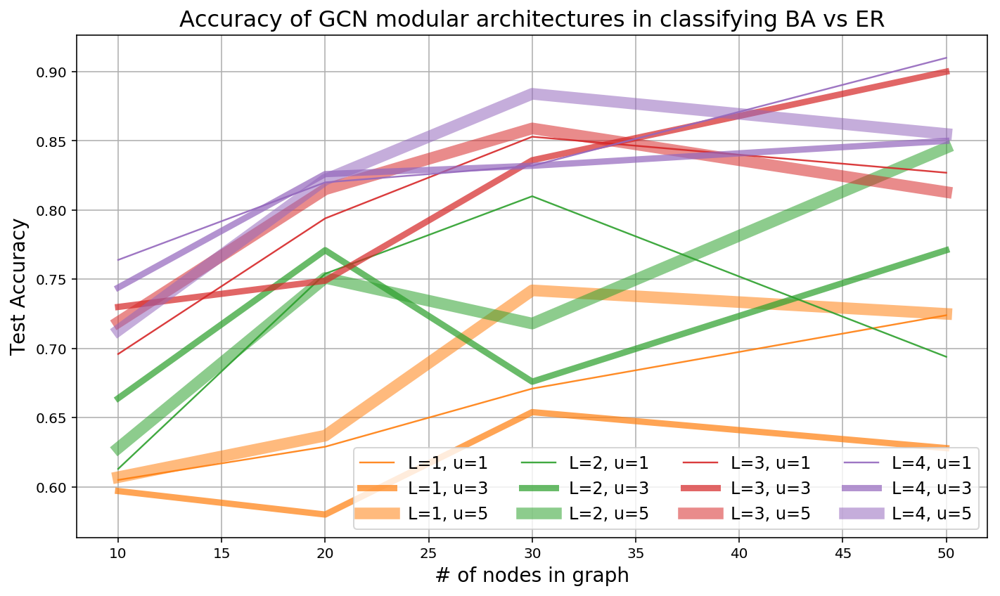

In [114]:
%pylab inline
%config InlineBackend.figure_format = 'retina'
cols = dict(enumerate(mpl.colors.TABLEAU_COLORS))

figure(figsize=(10,6))
for k in sorted(stats):
    print(k)
    a = array(stats[k])
    print(a)
    l,u = k
    if l==5: continue
    plot(*a[argsort(a[:,0])].T, label = 'L=%d, u=%d' %k, lw=1.2*u**1.2 , alpha= 1-tanh(u/10), c = cols[l])

legend(ncol = 4,fontsize=12)
# ylim(.8,1.01)
xlabel('# of nodes in graph', size = 14)    
ylabel('Test Accuracy',size = 14)

t = ('BA vs ER' )
title('Accuracy of GCN modular architectures in classifying %s'%(t),size=16 )
grid()
tight_layout()